In [1]:
import numpy as np 
import os 
from matplotlib.colors import LogNorm
import matplotlib.pyplot as plt
from matplotlib import colors 
from matplotlib.ticker import PercentFormatter 
from mpl_toolkits.mplot3d import Axes3D 
import potentials as pot

def triangular_plot(chains,save='None',fig_size=25):
    data=chains
    nsteps,ndim=chains.shape
    fig = plt.figure(figsize=(fig_size,fig_size))
    if save != 'None':
        fig.set(facecolor = "white")
    for i in range(ndim):
        ax = fig.add_subplot(ndim,ndim,i*ndim+i+1)
        ax.hist(data[:,i], 100, color="k", histtype="step")
        ax.set_title(f"x{i+1}")
    for i in range(ndim):
        for j in range(i):
            plt.subplot(ndim,ndim,ndim*i+j+1)
            counts,xbins,ybins,image = plt.hist2d(data[:,j],data[:,i],bins=100
                                      ,norm=LogNorm()
                                      , cmap = plt.cm.rainbow)
            plt.colorbar()
            plt.contour(counts.transpose(),extent=[xbins[0],xbins[-1],ybins[0],ybins[-1]],
            linewidths=0.5, cmap = plt.cm.rainbow, levels = [1,100,1000,10000])
    if save != 'None':
        plt.savefig(save,transparent=False)
        plt.show()
    else: 
        plt.show()

def triangular_plot_slopes(chains,save='None',fig_size=25,lim=10):
    data=chains
    nsteps,ndim=chains.shape
    fig = plt.figure(figsize=(fig_size,fig_size))
    fig.set(facecolor = "white")
    for i in range(ndim):
        for j in range(i):
            ax=fig.add_subplot(ndim,ndim,ndim*i+j+1)
            #those_slope0=np.extract(np.abs(data[:,0])>0.2,data[:,i]/data[:,j])
            those_slope0=data[:,i]/data[:,j]
            those_slope=np.extract(np.abs(those_slope0)<lim,those_slope0)
            ax.hist(those_slope,bins=100)
            ax.set_title(f"x{j+1}/x{i+1}")
            #ax.set_ylabel(f"x{i}")
    if save != 'None':
        plt.savefig(save,transparent=False)
        plt.show()
    else: 
        plt.show()

2024-11-12 11:25:48.190412: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
from sklearn.model_selection import train_test_split

In [3]:
import tensorflow as tf
import time

In [4]:
import keras
from keras import layers,models,regularizers
from tensorflow.keras.callbacks import ReduceLROnPlateau,LearningRateScheduler


In [5]:
class ReduceLROnPlateauPercentage(tf.keras.callbacks.Callback):
    def __init__(self, monitor='val_loss', factor=0.5, patience=5, min_lr=0.00001, percentage_delta=0.01):
        super(ReduceLROnPlateauPercentage, self).__init__()
        self.monitor = monitor
        self.factor = factor
        self.patience = patience
        self.min_lr = min_lr
        self.percentage_delta = percentage_delta
        self.best = None
        self.wait = 0
        self.lr_reduced = False

    def on_epoch_end(self, epoch, logs=None):
        current = logs.get(self.monitor)
        if current is None:
            print(f"Warning: Metric '{self.monitor}' is not available.")
            return

        if self.best is None:
            self.best = current

        improvement = (self.best - current) / abs(self.best) if self.best != 0 else 0

        if improvement < self.percentage_delta:
            self.wait += 1
            if self.wait >= self.patience:
                old_lr = float(tf.keras.backend.get_value(self.model.optimizer.learning_rate))
                if old_lr > self.min_lr:
                    new_lr = max(old_lr * self.factor, self.min_lr)
                    tf.keras.backend.set_value(self.model.optimizer.learning_rate, new_lr)
                    print(f"\nEpoch {epoch+1}: ReduceLROnPlateau reducing learning rate to {new_lr}.")
                    self.wait = 0
        else:
            self.best = current
            self.wait = 0


In [6]:
from scipy.optimize import curve_fit 

In [7]:
%matplotlib widget

In [7]:
# compute (||∇V||^2)
def grad_norm_squared(V, x ,factor=1):
    with tf.GradientTape() as tape:
        tape.watch(x)
        loss = V(x)  # compute V at each point
    gradients = tape.gradient(loss, x)  # compute ∇V at each point
    norm_squared = tf.reduce_sum(gradients**2, axis=1)  # ||∇V||^2 at each point
    return norm_squared * factor

def get_grad(V, x):
    with tf.GradientTape() as tape:
        tape.watch(x)
        loss = V(x)  # compute V at each point
    gradients = tape.gradient(loss, x)  # compute ∇V at each point
    return gradients

In [8]:
def VHiggs_6d(x):
    x1,x2,x3,x4,x5,x6=tf.split(x, 6, axis=1)
    return (x1**2+x2**2+x3**2-1)**2 * (x4+x5+x6)

def VHiggs_10d(x):
    x1,x2,x3,x4,x5,x6,x7,x8,x9,x10=tf.split(x, 10, axis=1)
    return (x1**2+x2**2+x3**2-1)**2 * (x4+x5) * x6 * x7 * x8 * x9  

In [6]:
##########    ##########
########## 6d ##########
##########    ##########

In [31]:
# randomly initialize the points
n_points = 100000
xHiggs_6d = tf.Variable(4*np.random.rand(n_points, 6)-2, dtype=tf.float32)

historyHiggs_6d = []

In [36]:
# Oprimizer for the gradient descent

init_alpha=10**(-2)
alpha = init_alpha

optimizer = tf.optimizers.Adam(learning_rate=alpha)
#optimizer = tf.optimizers.SGD(learning_rate=init_alpha,momentum=0.0)

# Learning loop 
loss_prev_step=10**8

#update_alpha = False
update_opt = True 
for step in range(600):  
    with tf.GradientTape() as tape:
        loss = tf.reduce_sum(grad_norm_squared(VHiggs_6d, xHiggs_6d)) # minimize ||∇V||^2 for all points
    
    # Compute ||∇V||^2 with respect to x
    gradients = tape.gradient(loss, [xHiggs_6d])
    
    if update_opt and step % 200 ==0 :
        print("Reinitializing the optimizer")
        optimizer = tf.optimizers.Adam(learning_rate=init_alpha)
    
    if step == 1201:
        update_opt = False 
        #optimizer.learning_rate.assign(0.001)
        
    # Apply gradient descent for all points
    optimizer.apply_gradients(zip(gradients, [xHiggs_6d]))
    
    historyHiggs_6d.append(loss)
    
    if step % 10 == 0:
        print(f"""Step {step}: ||∇V||^2 = {loss.numpy()} with learning rate {optimizer.get_config()["learning_rate"]}""")
        
    if np.log(loss.numpy())/np.log(10)<-10: 
        print("Converged enough") 
        print(f"Step {step}: ||∇V||^2 = {loss.numpy()}")
        break

Reinitializing the optimizer
Step 0: ||∇V||^2 = 18.000137329101562 with learning rate 0.009999999776482582
Step 10: ||∇V||^2 = 18.154577255249023 with learning rate 0.009999999776482582
Step 20: ||∇V||^2 = 17.788881301879883 with learning rate 0.009999999776482582
Step 30: ||∇V||^2 = 16.092369079589844 with learning rate 0.009999999776482582
Step 40: ||∇V||^2 = 13.545849800109863 with learning rate 0.009999999776482582
Step 50: ||∇V||^2 = 10.62934684753418 with learning rate 0.009999999776482582
Step 60: ||∇V||^2 = 7.2760491371154785 with learning rate 0.009999999776482582
Step 70: ||∇V||^2 = 4.694639205932617 with learning rate 0.009999999776482582
Step 80: ||∇V||^2 = 3.2154667377471924 with learning rate 0.009999999776482582
Step 90: ||∇V||^2 = 3.004476308822632 with learning rate 0.009999999776482582
Step 100: ||∇V||^2 = 3.0000803470611572 with learning rate 0.009999999776482582
Step 110: ||∇V||^2 = 3.000206470489502 with learning rate 0.009999999776482582
Step 120: ||∇V||^2 = 3.000

In [37]:
for i in range(15):
    print(f"Number of points with ||∇V||^2 > {10**(-i)} : {sum(tf.reduce_sum(get_grad(VHiggs_6d,xHiggs_6d)**2,axis=1).numpy()>10**(-i))}")
          

Number of points with ||∇V||^2 > 1 : 0
Number of points with ||∇V||^2 > 0.1 : 0
Number of points with ||∇V||^2 > 0.01 : 0
Number of points with ||∇V||^2 > 0.001 : 0
Number of points with ||∇V||^2 > 0.0001 : 0
Number of points with ||∇V||^2 > 1e-05 : 0
Number of points with ||∇V||^2 > 1e-06 : 0
Number of points with ||∇V||^2 > 1e-07 : 0
Number of points with ||∇V||^2 > 1e-08 : 3
Number of points with ||∇V||^2 > 1e-09 : 10
Number of points with ||∇V||^2 > 1e-10 : 15
Number of points with ||∇V||^2 > 1e-11 : 22
Number of points with ||∇V||^2 > 1e-12 : 41
Number of points with ||∇V||^2 > 1e-13 : 65
Number of points with ||∇V||^2 > 1e-14 : 115


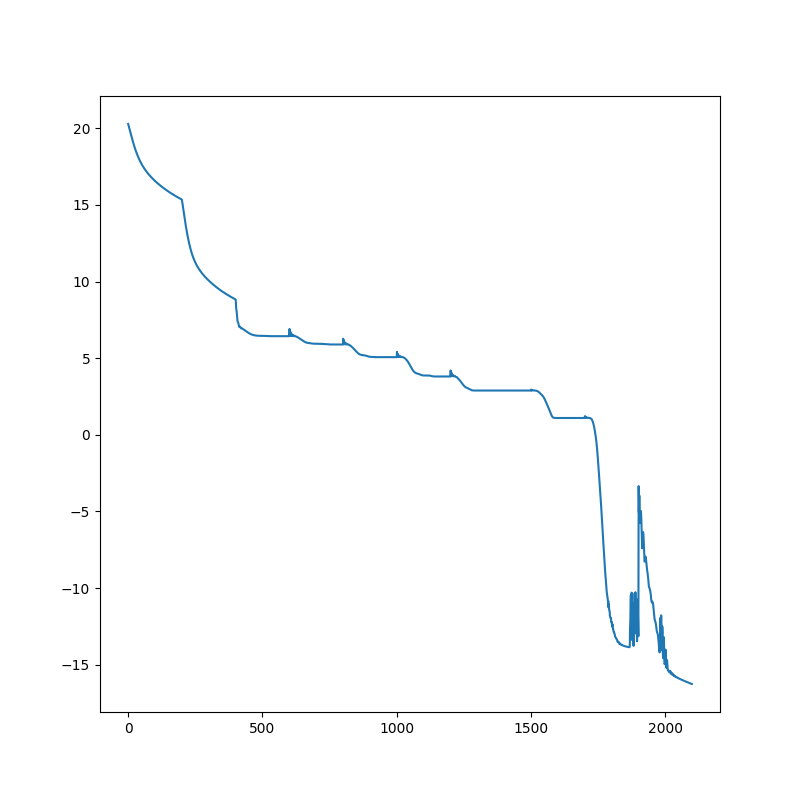

In [38]:
#all_steps = np.linspace(1,len(history),len(history))
plt.figure(figsize=(8,8))
plt.plot(np.log(historyHiggs_6d))
plt.show()

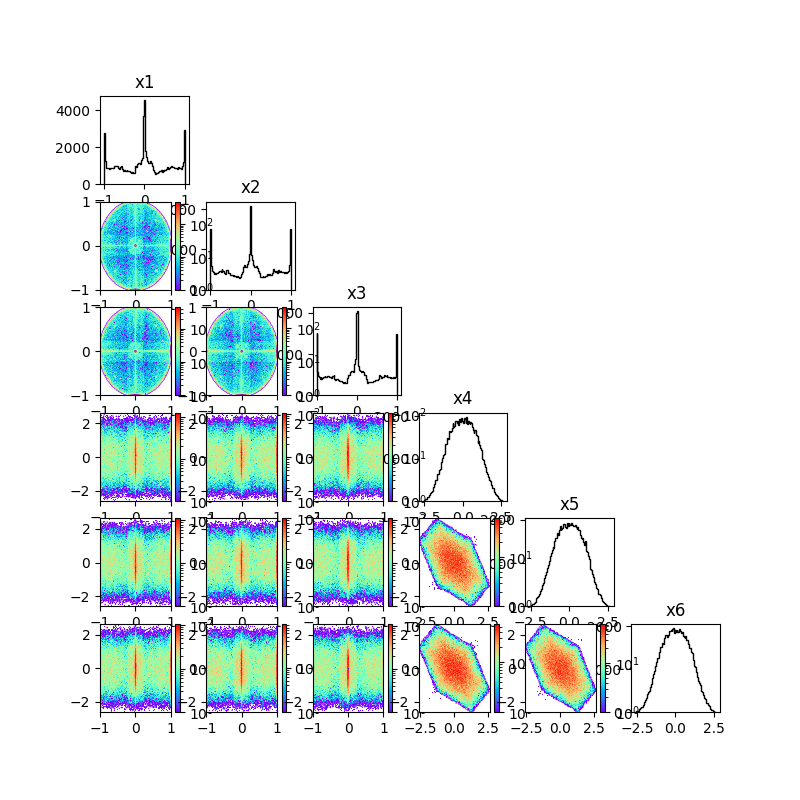

In [39]:
triangular_plot(xHiggs_6d.numpy(),fig_size=8)

In [40]:
#fig = plt.figure(figsize=(7,7))
#ax = Axes3D(fig) 
#
#ax.scatter(xHiggs_6d.numpy()[::10,0], xHiggs_6d.numpy()[::10,1], xHiggs_6d.numpy()[::10,2],color="green",s=1) 
#
#plt.show()


In [41]:
################ Auto encoder part ################
###################################################
###################################################

In [49]:
#

input_dim = 6
latent_dim = 6

# Encoder
inputs = layers.Input(shape=(input_dim,))
encoded = layers.Dense(8, activation='sigmoid')(inputs)
#encoded = layers.Dense(16, activation='sigmoid')(encoded)
#encoded = layers.Dense(16, activation='sigmoid')(encoded)
#encoded = layers.Dense(8, activation='sigmoid')(encoded)
encoded = layers.Dense(latent_dim)(encoded)  

# Decoder
decoded = layers.Dense(8, activation='sigmoid')(encoded)
#decoded = layers.Dense(16, activation='sigmoid')(decoded)
#decoded = layers.Dense(16, activation='sigmoid')(decoded)
#decoded = layers.Dense(8, activation='sigmoid')(decoded)
decoded = layers.Dense(input_dim)(decoded)  

# Modèle auto-encodeur
autoencoder = keras.Model(inputs, decoded)
autoencoder.compile(optimizer='adam', loss='mse')

In [50]:
autoencoder.summary()

Model: "functional_7"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_3 (InputLayer)      │ (None, 6)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 8)              │            56 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 6)              │            54 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 8)              │            56 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_15 (Dense)                │ (None, 6)              │            54 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 220 (880.00 B)

 Trainable params: 220 (880.00 B)

 Non-trainable params: 0 (0.00 B)

In [51]:
mask_train = np.array([np.random.rand()<0.9 for i in range(100000)])
set_train = np.array([np.extract(mask_train,xHiggs_6d.numpy()[:,i]) for i in range(6)]).T
set_test = np.array([np.extract(1-mask_train,xHiggs_6d.numpy()[:,i]) for i in range(6)]).T
print(set_train.shape)
print(set_test.shape)

(89926, 6)
(10074, 6)


In [52]:
history_autoencoder_Higgs = autoencoder.fit(set_train, set_train, epochs=100, batch_size=100, shuffle=True, validation_data=(set_test,set_test))


Epoch 1/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 0.5963 - val_loss: 0.1554
Epoch 2/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.1415 - val_loss: 0.1239
Epoch 3/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.1101 - val_loss: 0.0679
Epoch 4/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0655 - val_loss: 0.0188
Epoch 5/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0128 - val_loss: 0.0076
Epoch 6/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0072 - val_loss: 0.0056
Epoch 7/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0056 - val_loss: 0.0045
Epoch 8/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0047 - val_loss: 0.0039
Epoch 9/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0041 - val_loss: 0.0035
Epoch 10/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0037 - val_loss: 0.0032
Epoch 11/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0035 - val_loss: 0.0031
Epoch 12/100
900/900 ━━━━━━━━━━━━━━━━━━━━

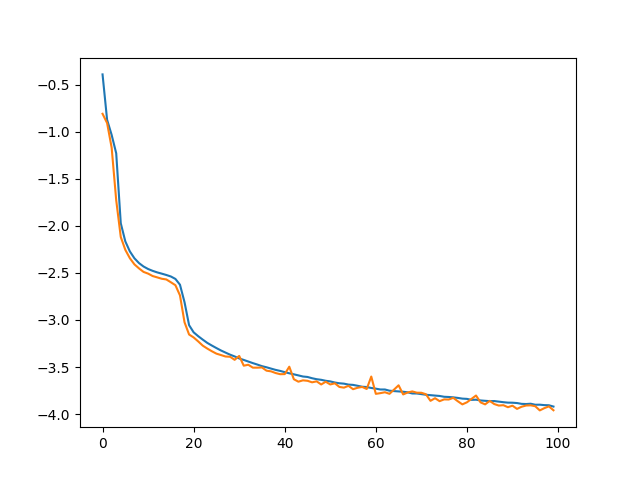

In [53]:
plt.figure()
plt.plot(np.log(history_autoencoder_Higgs.history["loss"])/np.log(10))
plt.plot(np.log(history_autoencoder_Higgs.history["val_loss"])/np.log(10))
plt.show()

In [57]:
encoder_Higgs = keras.Model(inputs, encoded)

In [58]:
encoded_points_Higgs = encoder_Higgs.predict(set_test)  
reconstructed_points = autoencoder.predict(set_test)  


315/315 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
315/315 ━━━━━━━━━━━━━━━━━━━━ 0s 772us/step


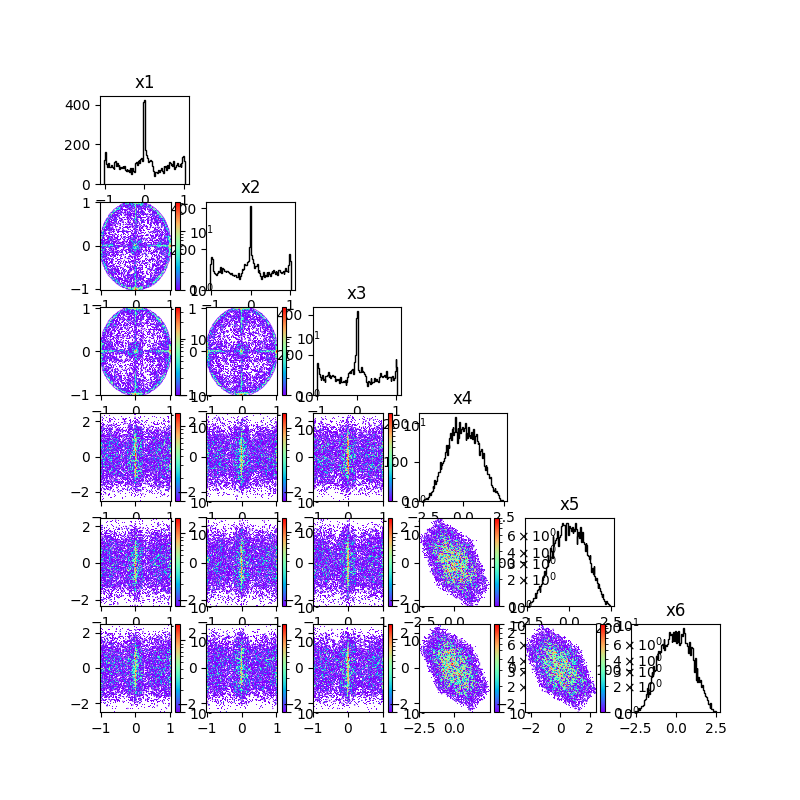

In [60]:
triangular_plot(reconstructed_points,fig_size = 8)

In [61]:
#fig = plt.figure(figsize=(7,7))
#ax = Axes3D(fig) 
#
#ax.scatter(reconstructed_points_deep[:,0],reconstructed_points_deep[:,1],reconstructed_points_deep[:,2],color="green",s=1) 
#ax.scatter(set_test[:,0],set_test[:,1],set_test[:,2],color="orange",s=1) 
#
#plt.show()


In [78]:
from joblib import Parallel, delayed
def process(i):
    return i * i
    
results = Parallel(n_jobs=2)(delayed(process)(i) for i in range(10))
print(results)  # prints [0, 1, 4, 9, 16, 25, 36, 49, 64, 81]

[0, 1, 4, 9, 16, 25, 36, 49, 64, 81]


In [81]:
history_all = []

def process(i):
    this_latent_dim = i + 1
    input_dim = 6
    
    print(this_latent_dim)

    inputs = layers.Input(shape=(input_dim,))
    encoded = layers.Dense(64, activation='sigmoid')(inputs)
    encoded = layers.Dense(64, activation='sigmoid')(encoded)
    encoded = layers.Dense(this_latent_dim)(encoded)  

    decoded = layers.Dense(64, activation='sigmoid')(encoded)
    decoded = layers.Dense(64, activation='sigmoid')(decoded)
    decoded = layers.Dense(input_dim)(decoded)  

    this_autoencoder = keras.Model(inputs, decoded)
    this_autoencoder.compile(optimizer='adam', loss='mse')
    
    history_all.append(this_autoencoder.fit(set_train, set_train, epochs=200, batch_size=100, shuffle=True, validation_data=(set_test,set_test)))

Parallel(n_jobs=4)(delayed(process)(i) for i in range(6))


2024-10-13 21:58:37.477588: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-10-13 21:58:37.477614: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-10-13 21:58:37.482066: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024

KeyboardInterrupt: 

In [82]:
history_all = []

for i in range(6):
    
    this_latent_dim = i + 1
    input_dim = 6
    
    print(this_latent_dim)

    inputs = layers.Input(shape=(input_dim,))
    encoded = layers.Dense(64, activation='sigmoid')(inputs)
    encoded = layers.Dense(64, activation='sigmoid')(encoded)
    encoded = layers.Dense(this_latent_dim)(encoded)  

    decoded = layers.Dense(64, activation='sigmoid')(encoded)
    decoded = layers.Dense(64, activation='sigmoid')(decoded)
    decoded = layers.Dense(input_dim)(decoded)  

    this_autoencoder = keras.Model(inputs, decoded)
    this_autoencoder.compile(optimizer='adam', loss='mse')
    
    history_all.append(this_autoencoder.fit(set_train, set_train, epochs=200, batch_size=100, shuffle=True, validation_data=(set_test,set_test)))


1
Epoch 1/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - loss: 0.5533 - val_loss: 0.3969
Epoch 2/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.3930 - val_loss: 0.3950
Epoch 3/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.3942 - val_loss: 0.3937
Epoch 4/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.3934 - val_loss: 0.3943
Epoch 5/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.3939 - val_loss: 0.3670
Epoch 6/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.3361 - val_loss: 0.2881
Epoch 7/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.2859 - val_loss: 0.2735
Epoch 8/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.2679 - val_loss: 0.2609
Epoch 9/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.2579 - val_loss: 0.2541
Epoch 10/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.2531 - val_loss: 0.2504
Epoch 11/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.2500 - val_loss: 0.2473
Epoch 12/200
900/900 ━━━━━━━━━━━━━━━━━━

Epoch 135/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.2137 - val_loss: 0.2144
Epoch 136/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.2126 - val_loss: 0.2149
Epoch 137/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.2128 - val_loss: 0.2126
Epoch 138/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.2118 - val_loss: 0.2129
Epoch 139/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.2112 - val_loss: 0.2130
Epoch 140/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.2122 - val_loss: 0.2139
Epoch 141/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.2130 - val_loss: 0.2168
Epoch 142/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.2133 - val_loss: 0.2140
Epoch 143/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.2129 - val_loss: 0.2119
Epoch 144/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.2115 - val_loss: 0.2125
Epoch 145/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.2122 - val_loss: 0.2165
Epoch 146/200
900/900

900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.1087 - val_loss: 0.1107
Epoch 69/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.1086 - val_loss: 0.1099
Epoch 70/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.1083 - val_loss: 0.1093
Epoch 71/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.1074 - val_loss: 0.1094
Epoch 72/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.1078 - val_loss: 0.1078
Epoch 73/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.1069 - val_loss: 0.1073
Epoch 74/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.1071 - val_loss: 0.1069
Epoch 75/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.1052 - val_loss: 0.1075
Epoch 76/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.1050 - val_loss: 0.1066
Epoch 77/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.1037 - val_loss: 0.1061
Epoch 78/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.1033 - val_loss: 0.1051
Epoch 79/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 

Epoch 135/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0834 - val_loss: 0.0839
Epoch 136/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0833 - val_loss: 0.0838
Epoch 137/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0829 - val_loss: 0.0840
Epoch 138/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0831 - val_loss: 0.0847
Epoch 139/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0826 - val_loss: 0.0832
Epoch 140/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0823 - val_loss: 0.0836
Epoch 141/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0821 - val_loss: 0.0834
Epoch 142/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0821 - val_loss: 0.0832
Epoch 143/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0828 - val_loss: 0.0812
Epoch 144/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0822 - val_loss: 0.0817
Epoch 145/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0813 - val_loss: 0.0814
Epoch 146/200
900/900

900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0352 - val_loss: 0.0365
Epoch 69/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0347 - val_loss: 0.0343
Epoch 70/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0345 - val_loss: 0.0347
Epoch 71/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0341 - val_loss: 0.0347
Epoch 72/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.0345 - val_loss: 0.0341
Epoch 73/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.0337 - val_loss: 0.0351
Epoch 74/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0339 - val_loss: 0.0346
Epoch 75/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.0340 - val_loss: 0.0337
Epoch 76/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.0335 - val_loss: 0.0344
Epoch 77/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.0332 - val_loss: 0.0333
Epoch 78/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0330 - val_loss: 0.0333
Epoch 79/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 

Epoch 135/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0277 - val_loss: 0.0272
Epoch 136/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0270 - val_loss: 0.0275
Epoch 137/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0271 - val_loss: 0.0279
Epoch 138/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0271 - val_loss: 0.0268
Epoch 139/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0269 - val_loss: 0.0262
Epoch 140/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0270 - val_loss: 0.0271
Epoch 141/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0268 - val_loss: 0.0263
Epoch 142/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 0.0268 - val_loss: 0.0268
Epoch 143/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0267 - val_loss: 0.0269
Epoch 144/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0268 - val_loss: 0.0280
Epoch 145/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0267 - val_loss: 0.0267
Epoch 146/200
900/900

900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0027 - val_loss: 0.0024
Epoch 69/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0027 - val_loss: 0.0023
Epoch 70/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0026 - val_loss: 0.0024
Epoch 71/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0028 - val_loss: 0.0026
Epoch 72/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0026 - val_loss: 0.0023
Epoch 73/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0026 - val_loss: 0.0023
Epoch 74/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0025 - val_loss: 0.0023
Epoch 75/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0025 - val_loss: 0.0023
Epoch 76/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0026 - val_loss: 0.0024
Epoch 77/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0026 - val_loss: 0.0024
Epoch 78/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0026 - val_loss: 0.0024
Epoch 79/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 

Epoch 135/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0026 - val_loss: 0.0022
Epoch 136/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0025 - val_loss: 0.0023
Epoch 137/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0024 - val_loss: 0.0022
Epoch 138/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0024 - val_loss: 0.0022
Epoch 139/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0024 - val_loss: 0.0022
Epoch 140/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0026 - val_loss: 0.0022
Epoch 141/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0024 - val_loss: 0.0022
Epoch 142/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0025 - val_loss: 0.0022
Epoch 143/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0026 - val_loss: 0.0022
Epoch 144/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0025 - val_loss: 0.0022
Epoch 145/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0025 - val_loss: 0.0022
Epoch 146/200
900/900

900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0024 - val_loss: 0.0021
Epoch 69/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0024 - val_loss: 0.0021
Epoch 70/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0023 - val_loss: 0.0021
Epoch 71/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0025 - val_loss: 0.0021
Epoch 72/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0025 - val_loss: 0.0022
Epoch 73/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0024 - val_loss: 0.0021
Epoch 74/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0025 - val_loss: 0.0021
Epoch 75/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0024 - val_loss: 0.0021
Epoch 76/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0023 - val_loss: 0.0021
Epoch 77/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0023 - val_loss: 0.0021
Epoch 78/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0024 - val_loss: 0.0021
Epoch 79/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 

Epoch 135/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0023 - val_loss: 0.0021
Epoch 136/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0024 - val_loss: 0.0021
Epoch 137/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0024 - val_loss: 0.0021
Epoch 138/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0024 - val_loss: 0.0021
Epoch 139/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0024 - val_loss: 0.0021
Epoch 140/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0024 - val_loss: 0.0021
Epoch 141/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0024 - val_loss: 0.0021
Epoch 142/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0023 - val_loss: 0.0021
Epoch 143/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0023 - val_loss: 0.0021
Epoch 144/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0026 - val_loss: 0.0021
Epoch 145/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0023 - val_loss: 0.0021
Epoch 146/200
900/900

Epoch 67/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 6.7982e-05 - val_loss: 4.1090e-05
Epoch 68/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 5.0817e-05 - val_loss: 7.8505e-05
Epoch 69/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 4.9442e-05 - val_loss: 9.1457e-05
Epoch 70/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 5.1957e-05 - val_loss: 5.0321e-05
Epoch 71/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 5.6125e-05 - val_loss: 3.3795e-05
Epoch 72/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 5.2198e-05 - val_loss: 6.4437e-05
Epoch 73/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 5.1655e-05 - val_loss: 7.9461e-05
Epoch 74/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 5.1750e-05 - val_loss: 4.3665e-05
Epoch 75/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 4.9126e-05 - val_loss: 6.1026e-05
Epoch 76/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 4.9512e-05 - val_loss: 7.6685e-05
Epoch 77/200
900/900 ━━━━━━━━━━━━━━━━━━━

900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 2.9790e-05 - val_loss: 6.3589e-05
Epoch 192/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 3.1921e-05 - val_loss: 1.5832e-05
Epoch 193/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 2.2632e-05 - val_loss: 3.2927e-05
Epoch 194/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 3.3469e-05 - val_loss: 2.8629e-05
Epoch 195/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 2.4284e-05 - val_loss: 1.7642e-05
Epoch 196/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 2.6075e-05 - val_loss: 5.1101e-05
Epoch 197/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 2.8730e-05 - val_loss: 1.7203e-05
Epoch 198/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 2.5727e-05 - val_loss: 2.0811e-05
Epoch 199/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.6957e-05 - val_loss: 1.3703e-05
Epoch 200/200
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.7610e-05 - val_loss: 2.1349e-05


In [83]:
history_min = []
for this_history in history_all: 
    this_min = np.min(this_history.history['val_loss'])
    history_min.append(this_min)

/var/folders/7f/2871v4nx3pn_dph55xj6sxq40000gn/T/ipykernel_7665/610947544.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


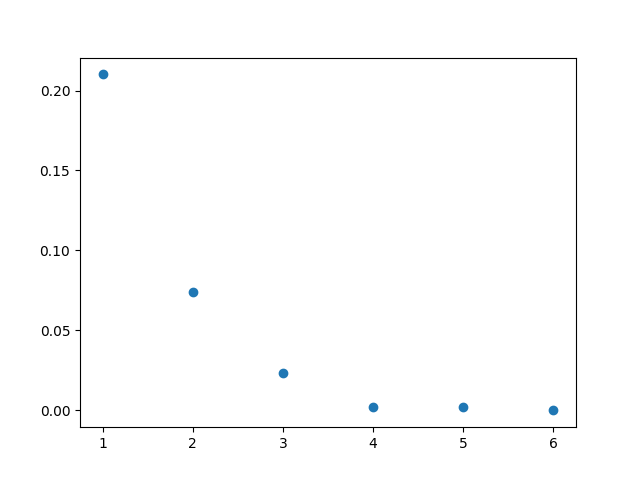

In [86]:
plt.figure()
plt.scatter(np.linspace(1,6,6),history_min)
plt.show()

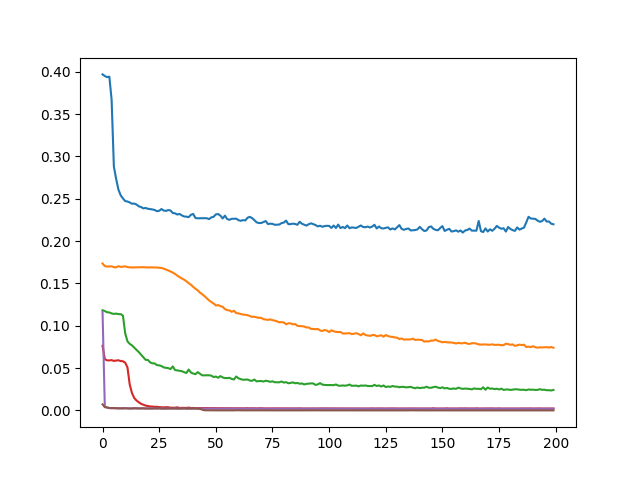

In [87]:
plt.figure()
for this_history in history_all:
    plt.plot(this_history.history['val_loss'])
plt.show()    

In [ ]:
##########     ##########
########## 10d ##########
##########     ##########

In [171]:
# randomly initialize the points
n_points = 100000
xHiggs_10d = tf.Variable(2*np.random.rand(n_points, 10)-1, dtype=tf.float32)

historyHiggs_10d = []

In [173]:
# Oprimizer for the gradient descent

init_alpha=10**(-2)
alpha = init_alpha

optimizer = tf.optimizers.Adam(learning_rate=alpha)
#optimizer = tf.optimizers.SGD(learning_rate=init_alpha,momentum=0.0)

# Learning loop 
loss_prev_step=10**8

#update_alpha = False
update_opt = True 
for step in range(1400):  
    with tf.GradientTape() as tape:
        loss = tf.reduce_sum(grad_norm_squared(VHiggs_10d, xHiggs_10d)) # minimize ||∇V||^2 for all points
    
    # Compute ||∇V||^2 with respect to x
    gradients = tape.gradient(loss, [xHiggs_10d])
    
    if update_opt and step % 200 ==0 :
        print("Reinitializing the optimizer")
        optimizer = tf.optimizers.Adam(learning_rate=init_alpha)
    
    if step == 1501:
        update_opt = False 
        #optimizer.learning_rate.assign(0.001)
        
    # Apply gradient descent for all points
    optimizer.apply_gradients(zip(gradients, [xHiggs_10d]))
    
    historyHiggs_10d.append(loss)
    
    if step % 10 == 0:
        print(f"""Step {step}: ||∇V||^2 = {loss.numpy()} with learning rate {optimizer.get_config()["learning_rate"]}""")
        
    if np.log(loss.numpy())/np.log(10)<-10: 
        print("Converged enough") 
        print(f"Step {step}: ||∇V||^2 = {loss.numpy()}")
        break

Reinitializing the optimizer
Step 0: ||∇V||^2 = 0.04170980304479599 with learning rate 0.009999999776482582
Step 10: ||∇V||^2 = 0.024053478613495827 with learning rate 0.009999999776482582
Step 20: ||∇V||^2 = 0.004544761031866074 with learning rate 0.009999999776482582
Step 30: ||∇V||^2 = 0.0008592294179834425 with learning rate 0.009999999776482582
Step 40: ||∇V||^2 = 0.000349969050148502 with learning rate 0.009999999776482582
Step 50: ||∇V||^2 = 0.00011958558752667159 with learning rate 0.009999999776482582
Step 60: ||∇V||^2 = 5.228185546002351e-05 with learning rate 0.009999999776482582
Step 70: ||∇V||^2 = 2.4384204152738675e-05 with learning rate 0.009999999776482582
Step 80: ||∇V||^2 = 1.3051840141997673e-05 with learning rate 0.009999999776482582
Step 90: ||∇V||^2 = 8.368111593881622e-06 with learning rate 0.009999999776482582
Step 100: ||∇V||^2 = 6.0273250710451975e-06 with learning rate 0.009999999776482582
Step 110: ||∇V||^2 = 4.685076419264078e-06 with learning rate 0.009999

KeyboardInterrupt: 

In [174]:
for i in range(15):
    print(f"Number of points with ||∇V||^2 > {10**(-i)} : {sum(tf.reduce_sum(get_grad(VHiggs_10d,xHiggs_10d)**2,axis=1).numpy()>10**(-i))}")
          

Number of points with ||∇V||^2 > 1 : 0
Number of points with ||∇V||^2 > 0.1 : 0
Number of points with ||∇V||^2 > 0.01 : 0
Number of points with ||∇V||^2 > 0.001 : 0
Number of points with ||∇V||^2 > 0.0001 : 0
Number of points with ||∇V||^2 > 1e-05 : 0
Number of points with ||∇V||^2 > 1e-06 : 0
Number of points with ||∇V||^2 > 1e-07 : 0
Number of points with ||∇V||^2 > 1e-08 : 0
Number of points with ||∇V||^2 > 1e-09 : 21
Number of points with ||∇V||^2 > 1e-10 : 544
Number of points with ||∇V||^2 > 1e-11 : 1872
Number of points with ||∇V||^2 > 1e-12 : 5195
Number of points with ||∇V||^2 > 1e-13 : 14334
Number of points with ||∇V||^2 > 1e-14 : 25014


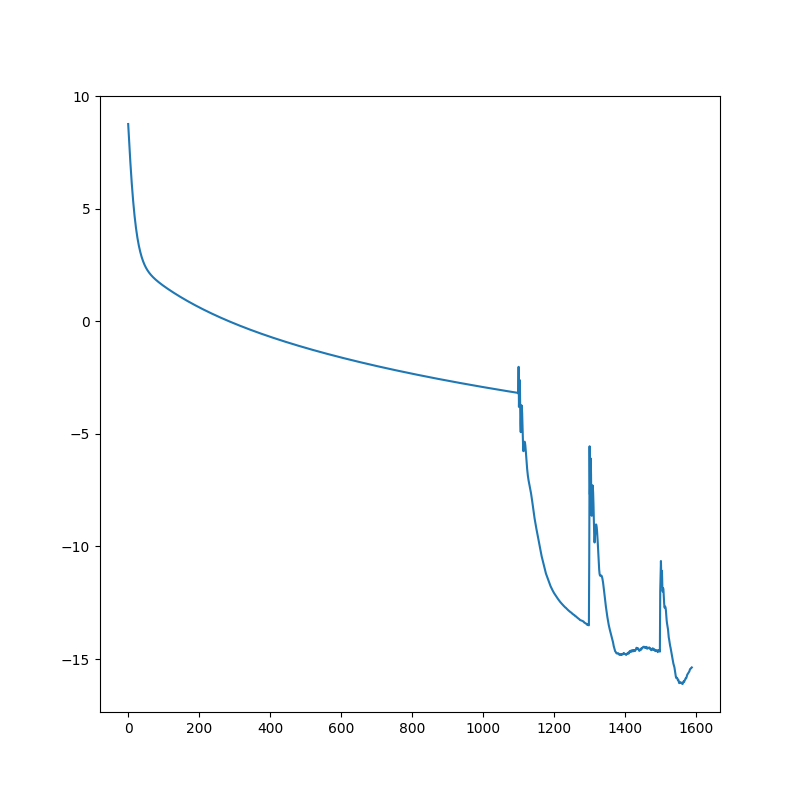

In [175]:
#all_steps = np.linspace(1,len(history),len(history))
plt.figure(figsize=(8,8))
plt.plot(np.log(historyHiggs_10d))
plt.show()

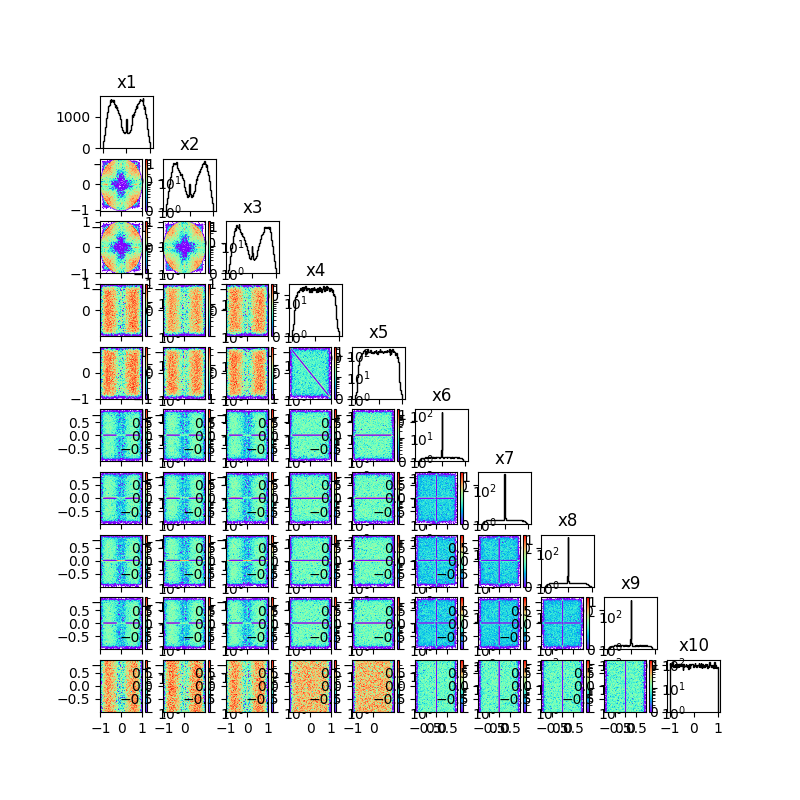

In [176]:
triangular_plot(xHiggs_10d.numpy(),fig_size=8)

In [177]:
mask_train = np.array([np.random.rand()<0.9 for i in range(100000)])
set_train = np.array([np.extract(mask_train,xHiggs_10d.numpy()[:,i]) for i in range(10)]).T
set_test = np.array([np.extract(1-mask_train,xHiggs_10d.numpy()[:,i]) for i in range(10)]).T
print(set_train.shape)
print(set_test.shape)

(90010, 10)
(9990, 10)


In [178]:
history_all_10d = []

for i in range(10):
    
    this_latent_dim = i + 1
    input_dim = 10
    
    print(this_latent_dim)

    inputs = layers.Input(shape=(input_dim,))
    encoded = layers.Dense(128, activation='sigmoid')(inputs)
    encoded = layers.Dense(128, activation='sigmoid')(encoded)
    encoded = layers.Dense(this_latent_dim)(encoded)  

    decoded = layers.Dense(128, activation='sigmoid')(encoded)
    decoded = layers.Dense(128, activation='sigmoid')(decoded)
    decoded = layers.Dense(input_dim)(decoded)  

    this_autoencoder = keras.Model(inputs, decoded)
    this_autoencoder.compile(optimizer='adam', loss='mse')
    
    history_all_10d.append(this_autoencoder.fit(set_train, set_train, epochs=200, batch_size=100, shuffle=True, validation_data=(set_test,set_test)))


1
Epoch 1/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - loss: 0.2862 - val_loss: 0.2374
Epoch 2/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.2365 - val_loss: 0.2367
Epoch 3/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.2365 - val_loss: 0.2367
Epoch 4/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.2358 - val_loss: 0.2359
Epoch 5/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.2337 - val_loss: 0.2239
Epoch 6/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.2223 - val_loss: 0.2166
Epoch 7/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.2154 - val_loss: 0.2118
Epoch 8/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.2115 - val_loss: 0.2097
Epoch 9/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.2096 - val_loss: 0.2086
Epoch 10/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.2081 - val_loss: 0.2059
Epoch 11/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - loss: 0.2050 - val_loss: 0.2054
Epoch 12/200
901/901 ━━━━━━━━━━━━━━━━━━

Epoch 135/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.1670 - val_loss: 0.1665
Epoch 136/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.1668 - val_loss: 0.1668
Epoch 137/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.1661 - val_loss: 0.1670
Epoch 138/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.1670 - val_loss: 0.1666
Epoch 139/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.1664 - val_loss: 0.1663
Epoch 140/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.1660 - val_loss: 0.1664
Epoch 141/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.1663 - val_loss: 0.1655
Epoch 142/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.1659 - val_loss: 0.1672
Epoch 143/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.1660 - val_loss: 0.1661
Epoch 144/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.1662 - val_loss: 0.1655
Epoch 145/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.1657 - val_loss: 0.1653
Epoch 146/200
901/901

901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.1220 - val_loss: 0.1220
Epoch 69/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.1218 - val_loss: 0.1214
Epoch 70/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.1212 - val_loss: 0.1209
Epoch 71/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - loss: 0.1203 - val_loss: 0.1203
Epoch 72/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.1202 - val_loss: 0.1195
Epoch 73/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.1194 - val_loss: 0.1189
Epoch 74/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.1190 - val_loss: 0.1189
Epoch 75/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.1183 - val_loss: 0.1180
Epoch 76/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.1179 - val_loss: 0.1177
Epoch 77/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.1176 - val_loss: 0.1172
Epoch 78/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.1174 - val_loss: 0.1171
Epoch 79/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 

Epoch 135/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0974 - val_loss: 0.0983
Epoch 136/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0969 - val_loss: 0.0977
Epoch 137/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0970 - val_loss: 0.0981
Epoch 138/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0968 - val_loss: 0.0977
Epoch 139/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.0965 - val_loss: 0.0976
Epoch 140/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0964 - val_loss: 0.0978
Epoch 141/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0964 - val_loss: 0.0982
Epoch 142/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0961 - val_loss: 0.0968
Epoch 143/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0960 - val_loss: 0.0966
Epoch 144/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0954 - val_loss: 0.0968
Epoch 145/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0957 - val_loss: 0.0964
Epoch 146/200
901/901

901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0882 - val_loss: 0.0889
Epoch 69/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0883 - val_loss: 0.0883
Epoch 70/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0879 - val_loss: 0.0884
Epoch 71/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.0882 - val_loss: 0.0886
Epoch 72/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - loss: 0.0876 - val_loss: 0.0878
Epoch 73/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.0869 - val_loss: 0.0877
Epoch 74/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.0873 - val_loss: 0.0867
Epoch 75/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.0870 - val_loss: 0.0870
Epoch 76/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0867 - val_loss: 0.0872
Epoch 77/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.0861 - val_loss: 0.0868
Epoch 78/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.0861 - val_loss: 0.0865
Epoch 79/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 4s 

Epoch 135/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - loss: 0.0615 - val_loss: 0.0625
Epoch 136/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - loss: 0.0613 - val_loss: 0.0621
Epoch 137/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - loss: 0.0613 - val_loss: 0.0624
Epoch 138/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0608 - val_loss: 0.0621
Epoch 139/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - loss: 0.0604 - val_loss: 0.0621
Epoch 140/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - loss: 0.0606 - val_loss: 0.0619
Epoch 141/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - loss: 0.0604 - val_loss: 0.0610
Epoch 142/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - loss: 0.0600 - val_loss: 0.0610
Epoch 143/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - loss: 0.0597 - val_loss: 0.0613
Epoch 144/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - loss: 0.0593 - val_loss: 0.0607
Epoch 145/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - loss: 0.0594 - val_loss: 0.0602
Epoch 146/200
901/901

901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0682 - val_loss: 0.0682
Epoch 69/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0673 - val_loss: 0.0687
Epoch 70/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0677 - val_loss: 0.0680
Epoch 71/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0667 - val_loss: 0.0686
Epoch 72/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0667 - val_loss: 0.0673
Epoch 73/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0666 - val_loss: 0.0691
Epoch 74/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0673 - val_loss: 0.0687
Epoch 75/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0675 - val_loss: 0.0691
Epoch 76/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0672 - val_loss: 0.0720
Epoch 77/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0696 - val_loss: 0.0695
Epoch 78/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0671 - val_loss: 0.0667
Epoch 79/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 

Epoch 135/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0484 - val_loss: 0.0493
Epoch 136/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0483 - val_loss: 0.0489
Epoch 137/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0481 - val_loss: 0.0486
Epoch 138/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0478 - val_loss: 0.0493
Epoch 139/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0478 - val_loss: 0.0478
Epoch 140/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0473 - val_loss: 0.0481
Epoch 141/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0473 - val_loss: 0.0490
Epoch 142/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0474 - val_loss: 0.0475
Epoch 143/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0468 - val_loss: 0.0494
Epoch 144/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0473 - val_loss: 0.0480
Epoch 145/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0469 - val_loss: 0.0468
Epoch 146/200
901/901

901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0314 - val_loss: 0.0314
Epoch 69/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0313 - val_loss: 0.0319
Epoch 70/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0311 - val_loss: 0.0319
Epoch 71/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0308 - val_loss: 0.0311
Epoch 72/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0306 - val_loss: 0.0312
Epoch 73/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0305 - val_loss: 0.0308
Epoch 74/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0303 - val_loss: 0.0306
Epoch 75/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0299 - val_loss: 0.0313
Epoch 76/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0302 - val_loss: 0.0305
Epoch 77/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0298 - val_loss: 0.0302
Epoch 78/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0297 - val_loss: 0.0301
Epoch 79/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 

Epoch 135/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0237 - val_loss: 0.0247
Epoch 136/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0233 - val_loss: 0.0244
Epoch 137/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0234 - val_loss: 0.0248
Epoch 138/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0231 - val_loss: 0.0246
Epoch 139/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0231 - val_loss: 0.0238
Epoch 140/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0230 - val_loss: 0.0240
Epoch 141/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0229 - val_loss: 0.0246
Epoch 142/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0227 - val_loss: 0.0238
Epoch 143/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0226 - val_loss: 0.0240
Epoch 144/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0228 - val_loss: 0.0239
Epoch 145/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0225 - val_loss: 0.0241
Epoch 146/200
901/901

901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0204 - val_loss: 0.0211
Epoch 69/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0203 - val_loss: 0.0209
Epoch 70/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0205 - val_loss: 0.0212
Epoch 71/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0203 - val_loss: 0.0215
Epoch 72/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0200 - val_loss: 0.0204
Epoch 73/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0198 - val_loss: 0.0206
Epoch 74/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0198 - val_loss: 0.0204
Epoch 75/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0196 - val_loss: 0.0204
Epoch 76/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0196 - val_loss: 0.0208
Epoch 77/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0194 - val_loss: 0.0200
Epoch 78/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0193 - val_loss: 0.0202
Epoch 79/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 

Epoch 135/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0157 - val_loss: 0.0165
Epoch 136/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0157 - val_loss: 0.0164
Epoch 137/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0156 - val_loss: 0.0163
Epoch 138/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0156 - val_loss: 0.0164
Epoch 139/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0153 - val_loss: 0.0167
Epoch 140/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0153 - val_loss: 0.0164
Epoch 141/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0154 - val_loss: 0.0163
Epoch 142/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0154 - val_loss: 0.0159
Epoch 143/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0153 - val_loss: 0.0162
Epoch 144/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0154 - val_loss: 0.0163
Epoch 145/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0152 - val_loss: 0.0160
Epoch 146/200
901/901

901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0134 - val_loss: 0.0140
Epoch 69/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0135 - val_loss: 0.0140
Epoch 70/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0133 - val_loss: 0.0148
Epoch 71/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0133 - val_loss: 0.0137
Epoch 72/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0132 - val_loss: 0.0134
Epoch 73/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0131 - val_loss: 0.0134
Epoch 74/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0130 - val_loss: 0.0135
Epoch 75/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0131 - val_loss: 0.0136
Epoch 76/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0132 - val_loss: 0.0135
Epoch 77/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0130 - val_loss: 0.0129
Epoch 78/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0128 - val_loss: 0.0130
Epoch 79/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 

Epoch 135/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0103 - val_loss: 0.0108
Epoch 136/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0102 - val_loss: 0.0109
Epoch 137/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0102 - val_loss: 0.0106
Epoch 138/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0102 - val_loss: 0.0103
Epoch 139/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0101 - val_loss: 0.0106
Epoch 140/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0101 - val_loss: 0.0103
Epoch 141/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0099 - val_loss: 0.0107
Epoch 142/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0100 - val_loss: 0.0106
Epoch 143/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0099 - val_loss: 0.0102
Epoch 144/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0099 - val_loss: 0.0102
Epoch 145/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0099 - val_loss: 0.0103
Epoch 146/200
901/901

901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0067 - val_loss: 0.0066
Epoch 69/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0066 - val_loss: 0.0068
Epoch 70/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0066 - val_loss: 0.0070
Epoch 71/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0067 - val_loss: 0.0068
Epoch 72/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0065 - val_loss: 0.0068
Epoch 73/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0065 - val_loss: 0.0067
Epoch 74/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0064 - val_loss: 0.0065
Epoch 75/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0064 - val_loss: 0.0065
Epoch 76/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0062 - val_loss: 0.0064
Epoch 77/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0063 - val_loss: 0.0064
Epoch 78/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0061 - val_loss: 0.0064
Epoch 79/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 

Epoch 135/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0048 - val_loss: 0.0049
Epoch 136/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0048 - val_loss: 0.0052
Epoch 137/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0051 - val_loss: 0.0055
Epoch 138/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0054 - val_loss: 0.0054
Epoch 139/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0049 - val_loss: 0.0049
Epoch 140/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0049 - val_loss: 0.0051
Epoch 141/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0048 - val_loss: 0.0049
Epoch 142/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0047 - val_loss: 0.0049
Epoch 143/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0047 - val_loss: 0.0049
Epoch 144/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0047 - val_loss: 0.0048
Epoch 145/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0047 - val_loss: 0.0050
Epoch 146/200
901/901

901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.6187e-04 - val_loss: 9.2934e-04
Epoch 68/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.3078e-04 - val_loss: 8.8493e-04
Epoch 69/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.6422e-04 - val_loss: 9.1756e-04
Epoch 70/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.4032e-04 - val_loss: 8.5057e-04
Epoch 71/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.3140e-04 - val_loss: 8.8064e-04
Epoch 72/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.2395e-04 - val_loss: 8.6085e-04
Epoch 73/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.4258e-04 - val_loss: 9.8676e-04
Epoch 74/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.2456e-04 - val_loss: 8.5387e-04
Epoch 75/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.1510e-04 - val_loss: 8.7704e-04
Epoch 76/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.0621e-04 - val_loss: 8.7638e-04
Epoch 77/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step

Epoch 130/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.6698e-04 - val_loss: 7.9564e-04
Epoch 131/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.5510e-04 - val_loss: 7.8270e-04
Epoch 132/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.4493e-04 - val_loss: 8.3128e-04
Epoch 133/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.6792e-04 - val_loss: 7.9392e-04
Epoch 134/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.6893e-04 - val_loss: 8.0002e-04
Epoch 135/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.5087e-04 - val_loss: 8.0470e-04
Epoch 136/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.5649e-04 - val_loss: 7.9489e-04
Epoch 137/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.5387e-04 - val_loss: 7.7846e-04
Epoch 138/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.5766e-04 - val_loss: 7.8734e-04
Epoch 139/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.4745e-04 - val_loss: 8.0466e-04
Epoch 140/200
901/901 ━━━━━━━━

901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 9.1276e-05 - val_loss: 1.2727e-04
Epoch 56/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.4628e-05 - val_loss: 7.3935e-05
Epoch 57/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.6954e-05 - val_loss: 9.0509e-05
Epoch 58/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.6361e-05 - val_loss: 1.4577e-04
Epoch 59/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.6970e-05 - val_loss: 9.3431e-05
Epoch 60/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.5703e-05 - val_loss: 9.4477e-05
Epoch 61/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.6854e-05 - val_loss: 1.1811e-04
Epoch 62/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.0124e-05 - val_loss: 1.1906e-04
Epoch 63/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.1180e-05 - val_loss: 7.6781e-05
Epoch 64/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 6.6807e-05 - val_loss: 9.9157e-05
Epoch 65/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step

Epoch 118/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.2738e-05 - val_loss: 4.4609e-05
Epoch 119/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.9428e-05 - val_loss: 2.4839e-05
Epoch 120/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.7862e-05 - val_loss: 6.5331e-05
Epoch 121/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.0474e-05 - val_loss: 4.2178e-05
Epoch 122/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.9388e-05 - val_loss: 4.8055e-05
Epoch 123/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.7743e-05 - val_loss: 2.8522e-05
Epoch 124/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.0379e-05 - val_loss: 3.2797e-05
Epoch 125/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.9568e-05 - val_loss: 7.4129e-05
Epoch 126/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.0766e-05 - val_loss: 3.6522e-05
Epoch 127/200
901/901 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.9080e-05 - val_loss: 4.0501e-05
Epoch 128/200
901/901 ━━━━━━━━

In [179]:
history_min = []
for this_history in history_all_10d: 
    this_min = np.min(this_history.history['val_loss'])
    history_min.append(this_min)

In [180]:
(history_min[-1]-history_min[-2])

-0.0007359417277257307

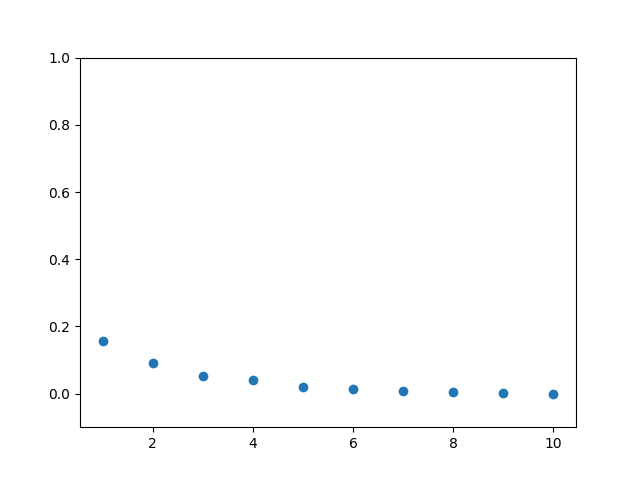

In [181]:
plt.figure()
#plt.plot(-0.2409968376159668*np.linspace(1,10,10)+1.23,c='orange')
#plt.plot(-0.0129408444481669*np.linspace(1,11,11)+0.14,c='orange')
plt.scatter(np.linspace(1,10,10),history_min)
plt.ylim((-0.1,1))
plt.show()

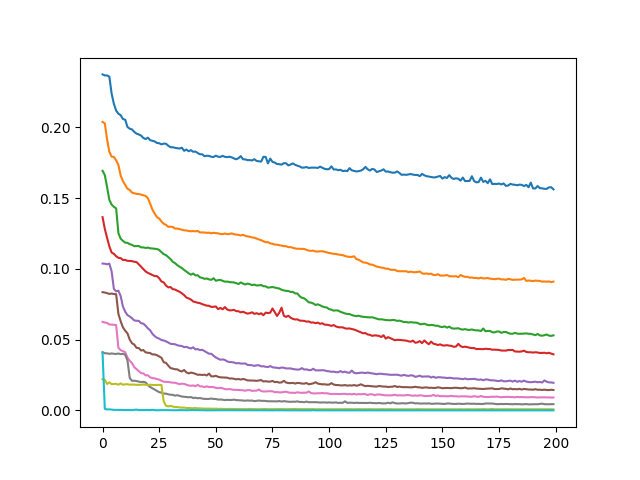

In [182]:
plt.figure()
for this_history in history_all_10d:
    plt.plot(this_history.history['val_loss'])
plt.show()    

In [183]:
##########       ##########
########## 5d 1  ##########
##########       ##########

In [212]:
def V_5d_1(x):
    x1,x2,x3,x4,x5 = tf.split(x,5,axis=1)
    return 29 * (x1 ** 2) + 41.66666666666667 * (x1 ** 3) + 81 * (x1 ** 4) -36 * x1 * x2 + 540 * (x1 ** 3) * x2 + 20 * (x2 ** 2) + 1350 * (x1 ** 2) * (x2 ** 2) + 1500 * x1 * (x2 ** 3) + 625 * (x2 ** 4) + 32 * x1 * x3 -50 * (x1 ** 2) * x3 + 324 * (x1 ** 3) * x3 + 1620 * (x1 ** 2) * x2 * x3 + 2700 * x1 * (x2 ** 2) * x3 + 1500 * (x2 ** 3) * x3 + 20 * (x3 ** 2) + 20 * x1 * (x3 ** 2) + 486 * (x1 ** 2) * (x3 ** 2) + 1620 * x1 * x2 * (x3 ** 2) + 1350 * (x2 ** 2) * (x3 ** 2) -2.666666666666667 * (x3 ** 3) + 324 * x1 * (x3 ** 3) + 540 * x2 * (x3 ** 3) + 81 * (x3 ** 4) -4 * x1 * x4 -25 * (x1 ** 2) * x4 -540 * (x1 ** 3) * x4 + 40 * x2 * x4 -2700 * (x1 ** 2) * x2 * x4 -4500 * x1 * (x2 ** 2) * x4 -2500 * (x2 ** 3) * x4 + 40 * x3 * x4 + 20 * x1 * x3 * x4 -1620 * (x1 ** 2) * x3 * x4 -5400 * x1 * x2 * x3 * x4 -4500 * (x2 ** 2) * x3 * x4 -4 * (x3 ** 2) * x4 -1620 * x1 * (x3 ** 2) * x4 -2700 * x2 * (x3 ** 2) * x4 -540 * (x3 ** 3) * x4 + 40 * (x4 ** 2) + 5 * x1 * (x4 ** 2) + 1350 * (x1 ** 2) * (x4 ** 2) + 4500 * x1 * x2 * (x4 ** 2) + 3750 * (x2 ** 2) * (x4 ** 2) -2 * x3 * (x4 ** 2) + 2700 * x1 * x3 * (x4 ** 2) + 4500 * x2 * x3 * (x4 ** 2) + 1350 * (x3 ** 2) * (x4 ** 2) -0.3333333333333333 * (x4 ** 3) -1500 * x1 * (x4 ** 3) -2500 * x2 * (x4 ** 3) -1500 * x3 * (x4 ** 3) + 625 * (x4 ** 4) + 8 * x1 * x5 + 200 * (x1 ** 2) * x5 + 216 * (x1 ** 3) * x5 -16 * x2 * x5 + 1080 * (x1 ** 2) * x2 * x5 + 1800 * x1 * (x2 ** 2) * x5 + 1000 * (x2 ** 3) * x5 -8 * x3 * x5 -160 * x1 * x3 * x5 + 648 * (x1 ** 2) * x3 * x5 + 2160 * x1 * x2 * x3 * x5 + 1800 * (x2 ** 2) * x3 * x5 + 32 * (x3 ** 2) * x5 + 648 * x1 * (x3 ** 2) * x5 + 1080 * x2 * (x3 ** 2) * x5 + 216 * (x3 ** 3) * x5 -24 * x4 * x5 -80 * x1 * x4 * x5 -1080 * (x1 ** 2) * x4 * x5 -3600 * x1 * x2 * x4 * x5 -3000 * (x2 ** 2) * x4 * x5 + 32 * x3 * x4 * x5 -2160 * x1 * x3 * x4 * x5 -3600 * x2 * x3 * x4 * x5 -1080 * (x3 ** 2) * x4 * x5 + 8 * (x4 ** 2) * x5 + 1800 * x1 * (x4 ** 2) * x5 + 3000 * x2 * (x4 ** 2) * x5 + 1800 * x3 * (x4 ** 2) * x5 -1000 * (x4 ** 3) * x5 + 4 * (x5 ** 2) + 320 * x1 * (x5 ** 2) + 216 * (x1 ** 2) * (x5 ** 2) + 720 * x1 * x2 * (x5 ** 2) + 600 * (x2 ** 2) * (x5 ** 2) -128 * x3 * (x5 ** 2) + 432 * x1 * x3 * (x5 ** 2) + 720 * x2 * x3 * (x5 ** 2) + 216 * (x3 ** 2) * (x5 ** 2) -64 * x4 * (x5 ** 2) -720 * x1 * x4 * (x5 ** 2) -1200 * x2 * x4 * (x5 ** 2) -720 * x3 * x4 * (x5 ** 2) + 600 * (x4 ** 2) * (x5 ** 2) + 170.6666666666667 * (x5 ** 3) + 96 * x1 * (x5 ** 3) + 160 * x2 * (x5 ** 3) + 96 * x3 * (x5 ** 3) -160 * x4 * (x5 ** 3) + 16 * (x5 ** 4)
    

In [213]:
# randomly initialize the points
n_points = 100000
xHiggs_5d_1 = tf.Variable(4*np.random.rand(n_points, 5)-2, dtype=tf.float32)

historyHiggs_5d_1 = []

In [220]:
# Oprimizer for the gradient descent

init_alpha=10**(-4)
alpha = init_alpha

optimizer = tf.optimizers.Adam(learning_rate=alpha)
#optimizer = tf.optimizers.SGD(learning_rate=init_alpha,momentum=0.0)

# Learning loop 
loss_prev_step=10**8

#update_alpha = False
update_opt = False 
for step in range(1600):  
    with tf.GradientTape() as tape:
        loss = tf.reduce_sum(grad_norm_squared(V_5d_1, xHiggs_5d_1)) # minimize ||∇V||^2 for all points
    
    # Compute ||∇V||^2 with respect to x
    gradients = tape.gradient(loss, [xHiggs_5d_1])
    
    if update_opt and step % 200 ==0 :
        print("Reinitializing the optimizer")
        optimizer = tf.optimizers.Adam(learning_rate=init_alpha)
    
    if step == 1401:
        update_opt = False 
        #optimizer.learning_rate.assign(0.001)
        
    # Apply gradient descent for all points
    optimizer.apply_gradients(zip(gradients, [xHiggs_5d_1]))
    
    historyHiggs_5d_1.append(loss)
    
    if step % 10 == 0:
        print(f"""Step {step}: ||∇V||^2 = {loss.numpy()} with learning rate {optimizer.get_config()["learning_rate"]}""")
        
    if np.log(loss.numpy())/np.log(10)<-10: 
        print("Converged enough") 
        print(f"Step {step}: ||∇V||^2 = {loss.numpy()}")
        break

Step 0: ||∇V||^2 = 0.27628928422927856 with learning rate 9.999999747378752e-05
Step 10: ||∇V||^2 = 10.805624961853027 with learning rate 9.999999747378752e-05
Step 20: ||∇V||^2 = 2.5189208984375 with learning rate 9.999999747378752e-05
Step 30: ||∇V||^2 = 0.4089205861091614 with learning rate 9.999999747378752e-05
Step 40: ||∇V||^2 = 0.4265826940536499 with learning rate 9.999999747378752e-05
Step 50: ||∇V||^2 = 0.3378164768218994 with learning rate 9.999999747378752e-05
Step 60: ||∇V||^2 = 0.26900598406791687 with learning rate 9.999999747378752e-05
Step 70: ||∇V||^2 = 0.23749952018260956 with learning rate 9.999999747378752e-05
Step 80: ||∇V||^2 = 0.2276814728975296 with learning rate 9.999999747378752e-05
Step 90: ||∇V||^2 = 0.2260069102048874 with learning rate 9.999999747378752e-05
Step 100: ||∇V||^2 = 0.22392848134040833 with learning rate 9.999999747378752e-05


KeyboardInterrupt: 

In [221]:
for i in range(15):
    print(f"Number of points with ||∇V||^2 > {10**(-i)} : {sum(tf.reduce_sum(get_grad(V_5d_1,xHiggs_5d_1)**2,axis=1).numpy()>10**(-i))}")
          

Number of points with ||∇V||^2 > 1 : 0
Number of points with ||∇V||^2 > 0.1 : 0
Number of points with ||∇V||^2 > 0.01 : 0
Number of points with ||∇V||^2 > 0.001 : 0
Number of points with ||∇V||^2 > 0.0001 : 27
Number of points with ||∇V||^2 > 1e-05 : 2763
Number of points with ||∇V||^2 > 1e-06 : 51057
Number of points with ||∇V||^2 > 1e-07 : 92519
Number of points with ||∇V||^2 > 1e-08 : 98182
Number of points with ||∇V||^2 > 1e-09 : 99866
Number of points with ||∇V||^2 > 1e-10 : 99995
Number of points with ||∇V||^2 > 1e-11 : 99998
Number of points with ||∇V||^2 > 1e-12 : 99998
Number of points with ||∇V||^2 > 1e-13 : 99998
Number of points with ||∇V||^2 > 1e-14 : 99998


In [252]:
mask_train = np.array([np.random.rand()<0.9 for i in range(100000)])
set_train_5d = np.array([np.extract(mask_train,xHiggs_5d_1.numpy()[:,i]) for i in range(5)]).T
set_test_5d = np.array([np.extract(1-mask_train,xHiggs_5d_1.numpy()[:,i]) for i in range(5)]).T
print(set_train_5d.shape)
print(set_test_5d.shape)

(90054, 10)
(9946, 10)


In [225]:
history_all_5d_1 = []

for i in range(5):
    
    this_latent_dim = i + 1
    input_dim = 5
    
    print(this_latent_dim)

    inputs = layers.Input(shape=(input_dim,))
    encoded = layers.Dense(128, activation='sigmoid')(inputs)
    encoded = layers.Dense(128, activation='sigmoid')(encoded)
    encoded = layers.Dense(this_latent_dim)(encoded)  

    decoded = layers.Dense(128, activation='sigmoid')(encoded)
    decoded = layers.Dense(128, activation='sigmoid')(decoded)
    decoded = layers.Dense(input_dim)(decoded)  

    this_autoencoder = keras.Model(inputs, decoded)
    this_autoencoder.compile(optimizer='adam', loss='mse')
    
    history_all_5d_1.append(this_autoencoder.fit(set_train_5d, set_train_5d, epochs=100, batch_size=100, shuffle=True, validation_data=(set_test_5d,set_test_5d)))


1
Epoch 1/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - loss: 0.1474 - val_loss: 4.7412e-04
Epoch 2/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.2208e-04 - val_loss: 1.1419e-04
Epoch 3/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.1346e-05 - val_loss: 4.9573e-05
Epoch 4/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 6.1970e-05 - val_loss: 2.9993e-05
Epoch 5/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 6.2343e-05 - val_loss: 1.2200e-04
Epoch 6/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 6.3760e-05 - val_loss: 1.8720e-05
Epoch 7/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 5.7011e-05 - val_loss: 6.8911e-05
Epoch 8/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 6.1152e-05 - val_loss: 1.8011e-04
Epoch 9/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 5.9989e-05 - val_loss: 4.5366e-05
Epoch 10/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 5.8006e-05 - val_loss: 2.4524e-05
Epoch 11/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/st

899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.3330e-05 - val_loss: 1.0156e-05
Epoch 28/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.0215e-05 - val_loss: 6.3089e-05
Epoch 29/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.6195e-05 - val_loss: 1.4923e-05
Epoch 30/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.0434e-05 - val_loss: 3.6875e-06
Epoch 31/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.6954e-05 - val_loss: 6.5487e-06
Epoch 32/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.9143e-05 - val_loss: 5.0530e-06
Epoch 33/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.3463e-05 - val_loss: 2.7901e-05
Epoch 34/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.8154e-05 - val_loss: 5.2288e-06
Epoch 35/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.8230e-05 - val_loss: 1.8219e-05
Epoch 36/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.0137e-05 - val_loss: 6.2981e-06
Epoch 37/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step

899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.1237e-05 - val_loss: 4.7031e-06
Epoch 54/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.0029e-05 - val_loss: 3.3722e-06
Epoch 55/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.0848e-05 - val_loss: 1.6364e-05
Epoch 56/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.6736e-05 - val_loss: 3.6150e-06
Epoch 57/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 9.4758e-06 - val_loss: 3.4526e-06
Epoch 58/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.5475e-05 - val_loss: 3.6027e-06
Epoch 59/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.9198e-06 - val_loss: 5.2750e-06
Epoch 60/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.3719e-05 - val_loss: 2.5820e-06
Epoch 61/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.2629e-06 - val_loss: 5.5516e-06
Epoch 62/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 1.7787e-05 - val_loss: 1.6812e-05
Epoch 63/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step

899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.1244e-05 - val_loss: 3.8633e-06
Epoch 80/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 7.4081e-06 - val_loss: 3.7533e-06
Epoch 81/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 1.0010e-05 - val_loss: 2.5965e-06
Epoch 82/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 5.8140e-06 - val_loss: 3.3856e-06
Epoch 83/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.0943e-05 - val_loss: 2.7580e-06
Epoch 84/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.1161e-05 - val_loss: 2.4565e-06
Epoch 85/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.0581e-06 - val_loss: 2.8628e-06
Epoch 86/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 6.0885e-06 - val_loss: 2.9273e-06
Epoch 87/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 6.9835e-06 - val_loss: 3.1087e-06
Epoch 88/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.2001e-06 - val_loss: 5.3161e-05
Epoch 89/100
899/899 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step

In [228]:
history_min = []
for this_history in history_all_5d_1: 
    this_min = np.min(this_history.history['val_loss'])
    history_min.append(this_min)


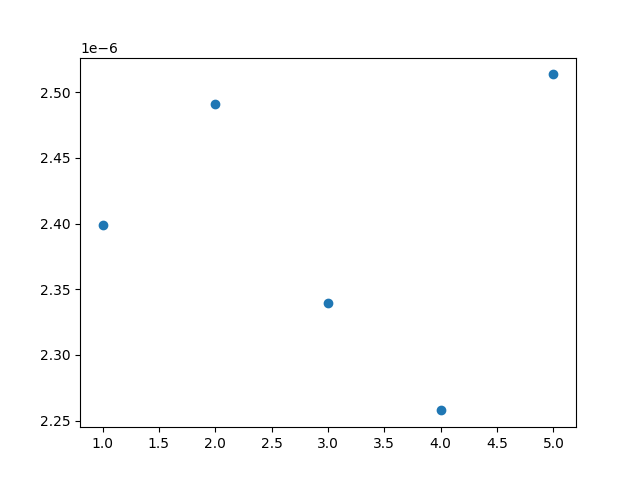

In [230]:
plt.figure()
plt.scatter(np.linspace(1,5,5),history_min)
#plt.ylim((-0.1,1))
plt.show()

In [302]:
for i in range(5):
    for j in range(i):
        this_slope_raw = xHiggs_5d_1.numpy()[:,i]/xHiggs_5d_1.numpy()[:,j]
        mask_this_slope = np.abs(this_slope_raw)<5
        this_slope = plt.hist(np.extract(mask_this_slope,this_slope_raw),bins=100)
        print(f"Slope between x{i+1} and x{j+1} : {this_slope[1][np.argmax(this_slope[0])]}")

Slope between x2 and x1 : 0.46029865741729736
Slope between x3 and x1 : -1.0710161924362183
Slope between x3 and x2 : -2.3084661960601807
Slope between x4 and x1 : 0.02834486961364746
Slope between x4 and x2 : 0.08939385414123535
Slope between x4 and x3 : -0.12943600118160248
Slope between x5 and x1 : -0.9299927353858948
Slope between x5 and x2 : -1.9003568887710571
Slope between x5 and x3 : 0.808512806892395
Slope between x5 and x4 : -4.897371768951416


In [ ]:
print(0.46047)
print(-1.)
print(0.08)
print(-0.88)

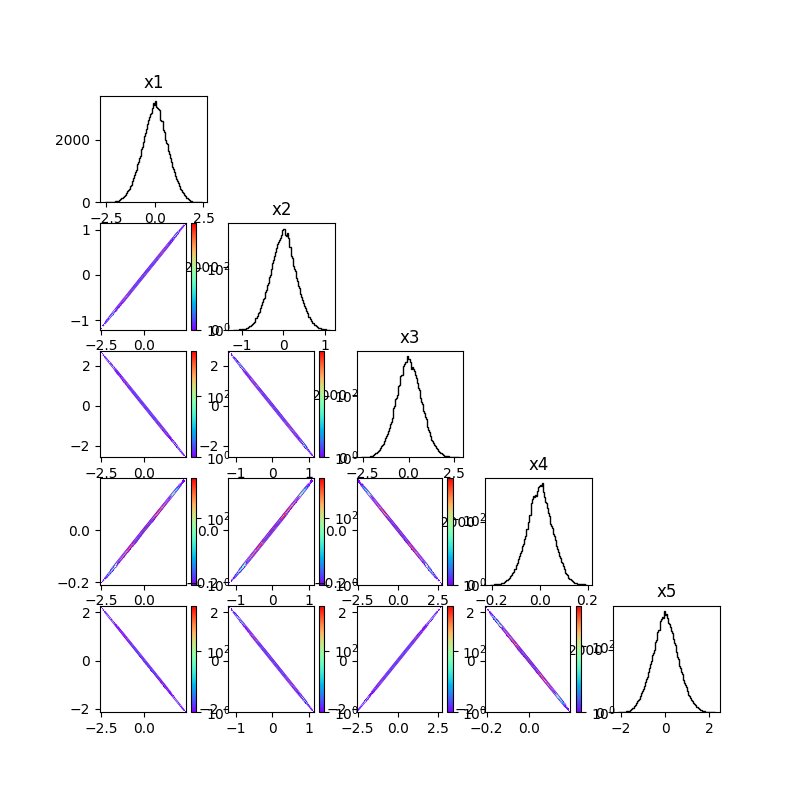

In [300]:
triangular_plot(xHiggs_5d_1.numpy(),fig_size=8)

In [247]:
# try to recover shape 

In [253]:
latent_dim = 1
input_dim = 5

inputs = layers.Input(shape=(input_dim,))
encoded = layers.Dense(128, activation='sigmoid')(inputs)
encoded = layers.Dense(128, activation='sigmoid')(encoded)
encoded = layers.Dense(latent_dim)(encoded)  

decoded = layers.Dense(128, activation='sigmoid')(encoded)
decoded = layers.Dense(128, activation='sigmoid')(decoded)
decoded = layers.Dense(input_dim)(decoded)  

autoencoder_5d_1 = keras.Model(inputs, decoded)
autoencoder_5d_1.compile(optimizer='adam', loss='mse')

In [254]:
autoencoder_5d_1.summary()

Model: "functional_167"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_81 (InputLayer)     │ (None, 5)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_526 (Dense)               │ (None, 128)            │           768 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_527 (Dense)               │ (None, 128)            │        16,512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_528 (Dense)               │ (None, 1)              │           129 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_529 (Dense)               │ (None, 128)            │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_530 (Dense)               │ (None, 128)            │        16,512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_531 (Dense)               │ (None, 5)              │           645 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 34,822 (136.02 KB)

 Trainable params: 34,822 (136.02 KB)

 Non-trainable params: 0 (0.00 B)

In [255]:
history_5d_1 = autoencoder_5d_1.fit(set_train_5d, set_train_5d, epochs=50, batch_size=100, shuffle=True, validation_data=(set_test_5d,set_test_5d))


Epoch 1/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - loss: 0.0959 - val_loss: 9.5842e-04
Epoch 2/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 7.7194e-04 - val_loss: 4.4040e-04
Epoch 3/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 5.0135e-04 - val_loss: 5.5523e-04
Epoch 4/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 3.0915e-04 - val_loss: 2.1035e-04
Epoch 5/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 1.5436e-04 - val_loss: 2.6287e-04
Epoch 6/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.5725e-04 - val_loss: 5.7244e-05
Epoch 7/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.3860e-04 - val_loss: 2.4035e-04
Epoch 8/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.4581e-04 - val_loss: 4.5357e-05
Epoch 9/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.2621e-04 - val_loss: 1.9751e-04
Epoch 10/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.3334e-04 - val_loss: 6.4497e-05
Epoch 11/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.

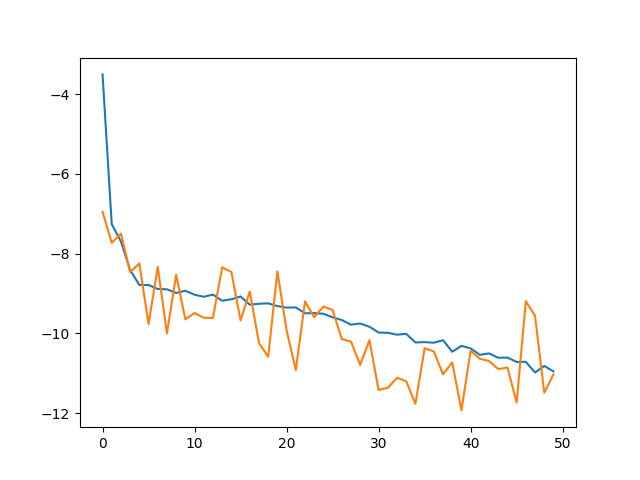

In [259]:
plt.figure()
plt.plot(np.log(history_5d_1.history["loss"]))
plt.plot(np.log(history_5d_1.history["val_loss"]))
plt.show()

In [ ]:
##########        ##########
########## 10d 1  ##########
##########        ##########

In [9]:
def V_10d_1(x):
    x1,x2,x3,x4,x5, x6, x7, x8, x9, x10 = tf.split(x,10,axis=1)
    return 0.5 * (x1 ** 3) + x10 ** 4 + 1.5 * (x1 ** 2) * x2 + 1.5 * x1 * (x2 ** 2) + 0.5 * (x2 ** 3) + 1.5 * (x1 ** 2) * (x3 ** 2) + 3 * x1 * x2 * (x3 ** 2) + 1.5 * (x2 ** 2) * (x3 ** 2) + 1.5 * x1 * (x3 ** 4) + 1.5 * x2 * (x3 ** 4) + 0.5 * (x3 ** 6) + 6 * (x1 ** 2) * (x4 ** 2) + 12 * x1 * x2 * (x4 ** 2) + 6 * (x2 ** 2) * (x4 ** 2) + 12 * x1 * (x3 ** 2) * (x4 ** 2) + 12 * x2 * (x3 ** 2) * (x4 ** 2) + 6 * (x3 ** 4) * (x4 ** 2) + 24 * x1 * (x4 ** 4) + 24 * x2 * (x4 ** 4) + 24 * (x3 ** 2) * (x4 ** 4) + 32 * (x4 ** 6) + x5 ** 4 + x6 ** 4 + x7 ** 4 + x8 ** 4 + x9 ** 4


In [10]:
# randomly initialize the points
n_points = 100000
xHiggs_10d_1 = tf.Variable(4*np.random.rand(n_points, 10)-2, dtype=tf.float32)

historyHiggs_10d_1 = []

In [1025]:
# Oprimizer for the gradient descent

init_alpha=10**(-7)
alpha = init_alpha

optimizer = tf.optimizers.Adam(learning_rate=alpha)
#optimizer = tf.optimizers.SGD(learning_rate=init_alpha,momentum=0.0)

# Learning loop 
loss_prev_step=10**8

#update_alpha = False
update_opt = False 
for step in range(1000):  
    with tf.GradientTape() as tape:
        loss = tf.reduce_sum(grad_norm_squared(V_10d_1, xHiggs_10d_1)) # minimize ||∇V||^2 for all points
    
    # Compute ||∇V||^2 with respect to x
    gradients = tape.gradient(loss, [xHiggs_10d_1])
    
    if update_opt and step % 200 ==0 :
        print("Reinitializing the optimizer")
        optimizer = tf.optimizers.Adam(learning_rate=init_alpha)
    
    if step == 1201:
        update_opt = False 
        #optimizer.learning_rate.assign(0.001)
        
    # Apply gradient descent for all points
    optimizer.apply_gradients(zip(gradients, [xHiggs_10d_1]))
    
    historyHiggs_10d_1.append(loss)
    
    if step % 10 == 0:
        print(f"""Step {step}: ||∇V||^2 = {loss.numpy()} with learning rate {optimizer.get_config()["learning_rate"]}""")
        
    if np.log(loss.numpy())/np.log(10)<-10: 
        print("Converged enough") 
        print(f"Step {step}: ||∇V||^2 = {loss.numpy()}")
        break

Step 0: ||∇V||^2 = 2.756305320872343e-06 with learning rate 1.0000000116860974e-07
Step 10: ||∇V||^2 = 2.3310244614549447e-06 with learning rate 1.0000000116860974e-07
Step 20: ||∇V||^2 = 2.155560878236429e-06 with learning rate 1.0000000116860974e-07
Step 30: ||∇V||^2 = 2.1090659174660686e-06 with learning rate 1.0000000116860974e-07
Step 40: ||∇V||^2 = 2.0433553800103255e-06 with learning rate 1.0000000116860974e-07
Step 50: ||∇V||^2 = 2.0450293050089385e-06 with learning rate 1.0000000116860974e-07
Step 60: ||∇V||^2 = 2.023222350544529e-06 with learning rate 1.0000000116860974e-07
Step 70: ||∇V||^2 = 1.9752349089685595e-06 with learning rate 1.0000000116860974e-07
Step 80: ||∇V||^2 = 1.98152952179953e-06 with learning rate 1.0000000116860974e-07
Step 90: ||∇V||^2 = 1.9563326532079373e-06 with learning rate 1.0000000116860974e-07
Step 100: ||∇V||^2 = 1.931528458953835e-06 with learning rate 1.0000000116860974e-07
Step 110: ||∇V||^2 = 1.9345075088494923e-06 with learning rate 1.000000

Step 960: ||∇V||^2 = 1.7834029222285608e-06 with learning rate 1.0000000116860974e-07
Step 970: ||∇V||^2 = 1.7704401216178667e-06 with learning rate 1.0000000116860974e-07
Step 980: ||∇V||^2 = 1.7661677702562883e-06 with learning rate 1.0000000116860974e-07
Step 990: ||∇V||^2 = 1.770780954757356e-06 with learning rate 1.0000000116860974e-07


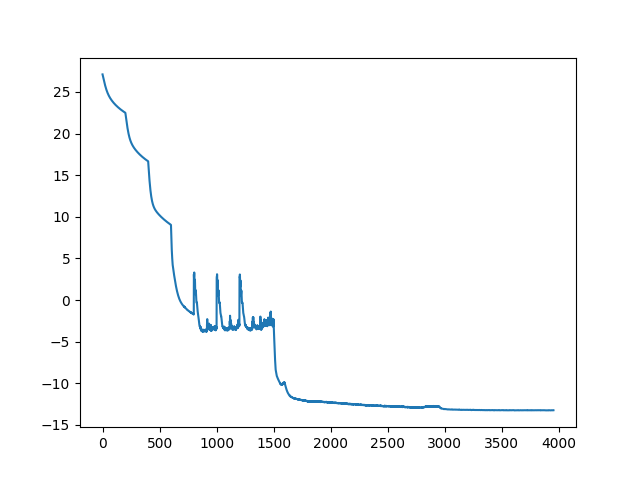

In [1031]:
plt.figure()
plt.plot(np.log(historyHiggs_10d_1))
plt.show()

In [1032]:
for i in range(15):
    print(f"Number of points with ||∇V||^2 > {10**(-i)} : {sum(tf.reduce_sum(get_grad(V_10d_1,xHiggs_10d_1)**2,axis=1).numpy()>10**(-i))}")
          

Number of points with ||∇V||^2 > 1 : 0
Number of points with ||∇V||^2 > 0.1 : 0
Number of points with ||∇V||^2 > 0.01 : 0
Number of points with ||∇V||^2 > 0.001 : 0
Number of points with ||∇V||^2 > 0.0001 : 0
Number of points with ||∇V||^2 > 1e-05 : 0
Number of points with ||∇V||^2 > 1e-06 : 0
Number of points with ||∇V||^2 > 1e-07 : 0
Number of points with ||∇V||^2 > 1e-08 : 1
Number of points with ||∇V||^2 > 1e-09 : 204
Number of points with ||∇V||^2 > 1e-10 : 2756
Number of points with ||∇V||^2 > 1e-11 : 13755
Number of points with ||∇V||^2 > 1e-12 : 34692
Number of points with ||∇V||^2 > 1e-13 : 66405
Number of points with ||∇V||^2 > 1e-14 : 100000


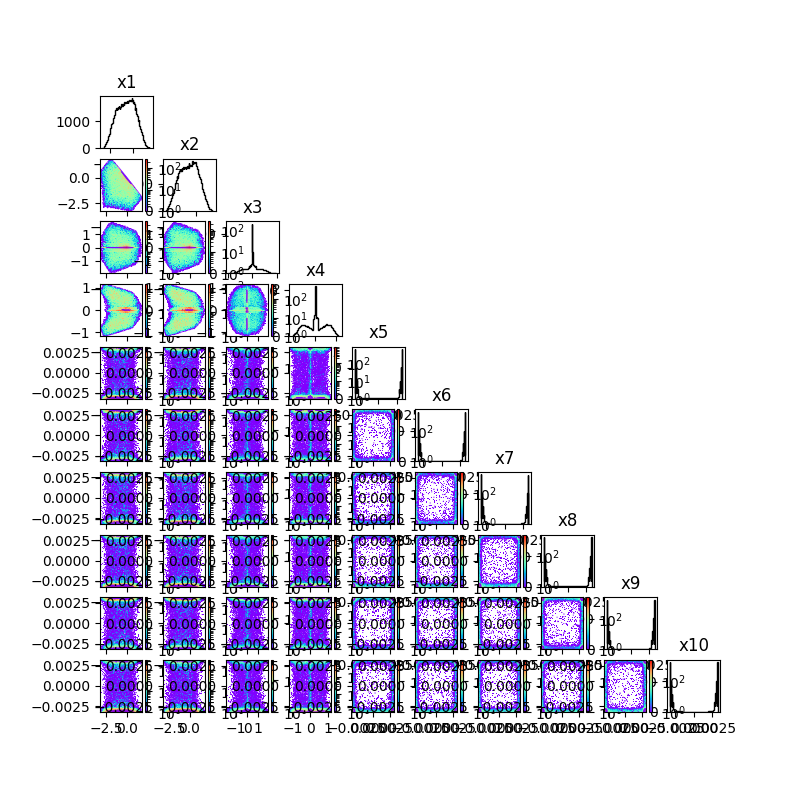

In [1033]:
triangular_plot(xHiggs_10d_1.numpy(),fig_size=8)

In [1034]:
x0grad = xHiggs_10d_1.numpy()[:,0]
x1grad = xHiggs_10d_1.numpy()[:,1]
x2grad = xHiggs_10d_1.numpy()[:,2]
x3grad = xHiggs_10d_1.numpy()[:,3]

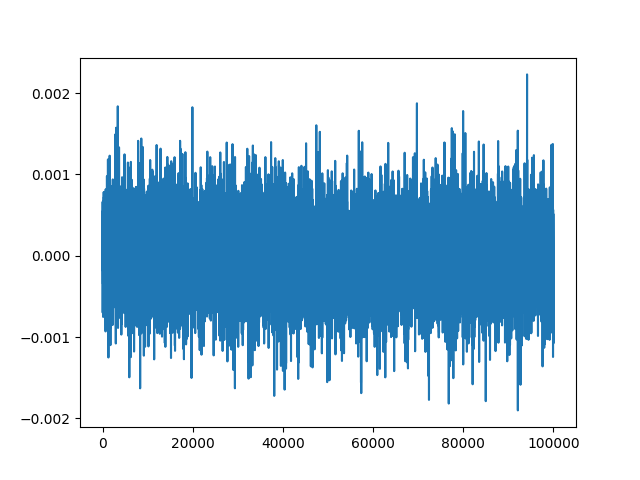

In [1035]:
plt.figure()
plt.plot(x0grad + x1grad + x2grad**2 + 4*x3grad**2)
plt.show()

In [16]:
set_train_10d_1, set_test_10d_1 = train_test_split(xHiggs_10d_1.numpy(), test_size=0.1, random_state=1)


In [18]:
history_all_10d_1 = []

for i in range(10):
    
    this_latent_dim = i + 1
    input_dim = 10
    
    print(this_latent_dim)

    inputs = layers.Input(shape=(input_dim,))
    encoded = layers.Dense(128, activation='sigmoid')(inputs)
    encoded = layers.Dense(128, activation='sigmoid')(encoded)
    encoded = layers.Dense(128, activation='sigmoid')(encoded)
    encoded = layers.Dense(this_latent_dim)(encoded)  

    decoded = layers.Dense(128, activation='sigmoid')(encoded)
    decoded = layers.Dense(128, activation='sigmoid')(decoded)
    encoded = layers.Dense(128, activation='sigmoid')(encoded)
    decoded = layers.Dense(input_dim)(decoded)  

    this_autoencoder = keras.Model(inputs, decoded)
    this_autoencoder.compile(optimizer='adam', loss='mse')
    
    history_all_10d_1.append(this_autoencoder.fit(set_train_10d_1, set_train_10d_1, epochs=100, batch_size=100, shuffle=True, validation_data=(set_test_10d_1,set_test_10d_1)))


1
Epoch 1/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - loss: 0.2185 - val_loss: 0.1360
Epoch 2/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.1363 - val_loss: 0.1358
Epoch 3/100
195/900 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.1367

KeyboardInterrupt: 

In [203]:
history_min = []
for this_history in history_all_10d_1: 
    this_min = np.min(this_history.history['val_loss'])
    history_min.append(this_min)

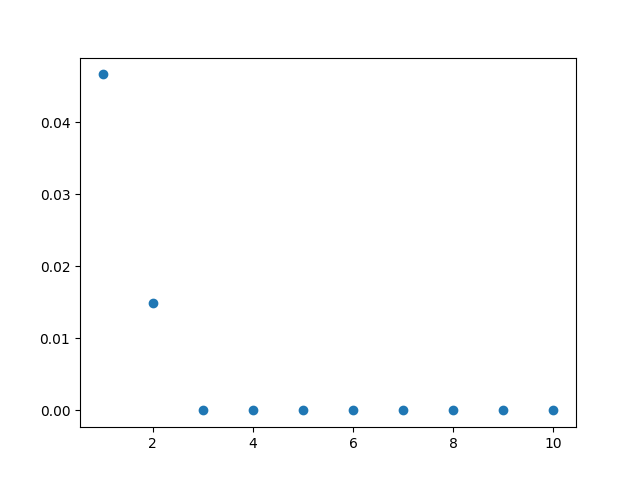

In [210]:
plt.figure()
plt.scatter(np.linspace(1,10,10),history_min)
#plt.ylim((-0.1,1))
plt.show()

In [ ]:
#Try to recover manifold

In [19]:
latent_dim = 3
input_dim = 10

inputs_10d_1 = layers.Input(shape=(input_dim,))
encoded_10d_1 = layers.Dense(256, activation='sigmoid')(inputs_10d_1)
encoded_10d_1 = layers.Dense(256, activation='sigmoid')(encoded_10d_1)
#encoded_10d_1 = layers.Dense(128, activation='sigmoid')(encoded_10d_1)
encoded_10d_1 = layers.Dense(latent_dim)(encoded_10d_1)  

decoded_10d_1 = layers.Dense(256, activation='sigmoid')(encoded_10d_1)
decoded_10d_1 = layers.Dense(256, activation='sigmoid')(decoded_10d_1)
#decoded_10d_1 = layers.Dense(128, activation='sigmoid')(decoded_10d_1)
decoded_10d_1 = layers.Dense(input_dim)(decoded_10d_1)  

autoencoder_10d_1 = keras.Model(inputs_10d_1, decoded_10d_1)
autoencoder_10d_1.compile(optimizer='adam', loss='mse')
autoencoder_10d_1.summary()

Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)      │ (None, 10)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_16 (Dense)                │ (None, 256)            │         2,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_17 (Dense)                │ (None, 256)            │        65,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_18 (Dense)                │ (None, 3)              │           771 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_19 (Dense)                │ (None, 256)            │         1,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_20 (Dense)                │ (None, 256)            │        65,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_21 (Dense)                │ (None, 10)             │         2,570 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 138,765 (542.05 KB)

 Trainable params: 138,765 (542.05 KB)

 Non-trainable params: 0 (0.00 B)

In [20]:
history_10d_1 = autoencoder_10d_1.fit(set_train_10d_1, set_train_10d_1, epochs=100, batch_size=100, shuffle=True, validation_data=(set_test_10d_1,set_test_10d_1))


Epoch 1/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 0.1555 - val_loss: 0.0274
Epoch 2/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.0275 - val_loss: 0.0290
Epoch 3/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.0270 - val_loss: 0.0266
Epoch 4/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0268 - val_loss: 0.0265
Epoch 5/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0267 - val_loss: 0.0257
Epoch 6/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - loss: 0.0244 - val_loss: 0.0143
Epoch 7/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0126 - val_loss: 0.0078
Epoch 8/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0074 - val_loss: 0.0132
Epoch 9/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0070 - val_loss: 0.0049
Epoch 10/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0043 - val_loss: 0.0036
Epoch 11/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0037 - val_loss: 0.0032
Epoch 12/100
900/900 ━━━━━━━━━━━━━━━━━━━━

In [21]:
history_loss = history_10d_1.history['loss']
history_val_loss = history_10d_1.history['val_loss']

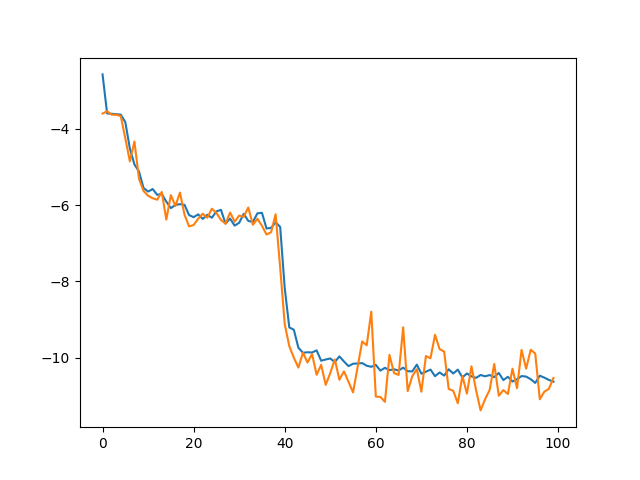

In [23]:
plt.figure()
plt.plot(np.log(history_10d_1.history['loss']))
plt.plot(np.log(history_10d_1.history['val_loss']))
plt.show()


In [24]:
encoder_10d_1 = models.Model(inputs_10d_1, encoded_10d_1)

latent_inputs_10d_1 = layers.Input(shape=(latent_dim,)) 
decoded_layer_10d_1 = autoencoder_10d_1.layers[-3](latent_inputs_10d_1)  
#decoded_layer_10d_1 = autoencoder_10d_1.layers[-3](decoded_layer_10d_1) 
decoded_layer_10d_1 = autoencoder_10d_1.layers[-2](decoded_layer_10d_1)  
decoded_output_10d_1 = autoencoder_10d_1.layers[-1](decoded_layer_10d_1) 

decoder_10d_1 = models.Model(latent_inputs_10d_1, decoded_output_10d_1)


In [25]:
encoded_points_10d_1 = encoder_10d_1.predict(set_test_10d_1)


313/313 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


In [26]:
decoded_points_10d_1 = decoder_10d_1.predict(encoded_points_10d_1)


313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step


In [27]:
decoded_points_10d_1_full_ae = autoencoder_10d_1.predict(set_test_10d_1)


313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step


In [901]:
n_points_excite = 10000
bound = 5
excite_y0_raw = np.linspace(-0,bound,n_points_excite)
excite_y0 = np.zeros((n_points_excite,3))
excite_y0[:,0] += excite_y0_raw

excite_y1_raw = np.linspace(-0,bound,n_points_excite)
excite_y1 = np.zeros((n_points_excite,3))
excite_y1[:,1] += excite_y1_raw

excite_y2_raw = np.linspace(-0,bound,n_points_excite)
excite_y2 = np.zeros((n_points_excite,3))
excite_y2[:,2] += excite_y2_raw

In [902]:
decoded_points_10d_1_y0 = decoder_10d_1.predict(excite_y0)
decoded_points_10d_1_y1 = decoder_10d_1.predict(excite_y1)
decoded_points_10d_1_y2 = decoder_10d_1.predict(excite_y2)

313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step


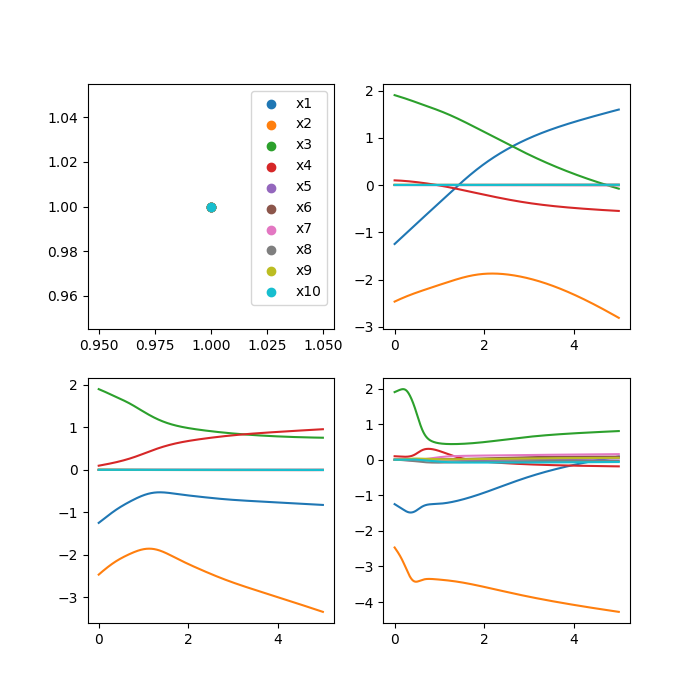

In [903]:
fig = plt.figure(figsize=(7,7))
ax1 = fig.add_subplot(2,2,1)
ax2 = fig.add_subplot(2,2,2)
ax3 = fig.add_subplot(2,2,3)
ax4 = fig.add_subplot(2,2,4)
for i in range(10):
    ax1.scatter(1,1,label = f"x{i+1}")
    ax2.plot(excite_y0_raw,decoded_points_10d_1_y0[:,i])
    ax3.plot(excite_y0_raw,decoded_points_10d_1_y1[:,i])
    ax4.plot(excite_y0_raw,decoded_points_10d_1_y2[:,i])

ax1.legend()
plt.show()

In [904]:
#### x1 + x2 + x3**2 + 4 x4**2 = 0 ####

In [905]:
###### Try to reconstruct with NN

In [906]:
x00 = decoded_points_10d_1_y0[:,0]
x10 = decoded_points_10d_1_y0[:,1]
x20 = decoded_points_10d_1_y0[:,2]
x30 = decoded_points_10d_1_y0[:,3]
#+decoded_points_10d_1_y0[:,4]+decoded_points_10d_1_y0[:,5]+decoded_points_10d_1_y0[:,6]+decoded_points_10d_1_y0[:,7]+decoded_points_10d_1_y0[:,8]+decoded_points_10d_1_y0[:,9]

x01 = decoded_points_10d_1_y1[:,0]
x11 = decoded_points_10d_1_y1[:,1]
x21 = decoded_points_10d_1_y1[:,2]
x31 = decoded_points_10d_1_y1[:,3]
x02 = decoded_points_10d_1_y2[:,0]
x12 = decoded_points_10d_1_y2[:,1]
x22 = decoded_points_10d_1_y2[:,2]
x32 = decoded_points_10d_1_y2[:,3]

x0 = np.concatenate((x00,x01,x02))
x1 = np.concatenate((x10,x11,x12))
x2 = np.concatenate((x20,x21,x22))
x3 = np.concatenate((x30,x31,x32))

In [907]:
all_x = [x01,x11,x21,x31]

In [908]:
import itertools

n = 4
sequence_4 = list(range(0, n))
permutations_4 = list(itertools.permutations(sequence_4))

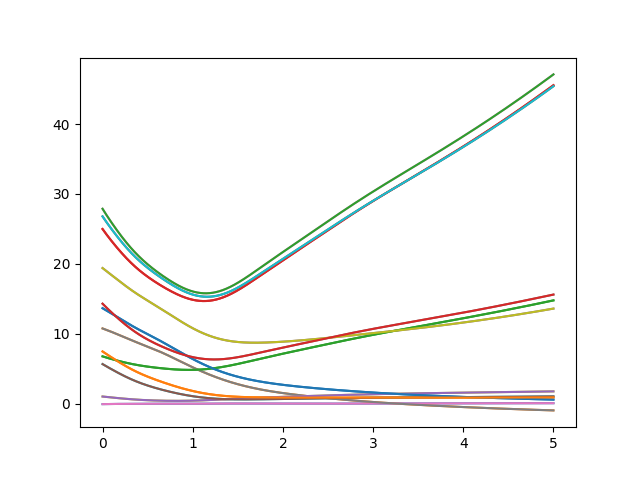

In [910]:
plt.figure()
sum_all=[]
for i in permutations_4:
    sum_all.append(np.sum(np.abs(all_x[i[0]]+all_x[i[1]]+all_x[i[2]]**2+4*all_x[i[3]]**2)))
    plt.plot(excite_y0_raw,all_x[i[0]]+all_x[i[1]]+all_x[i[2]]**2 + 4*all_x[i[3]]**2)
plt.show()

In [911]:
permutations_4[np.argmin(sum_all)]

(0, 1, 2, 3)

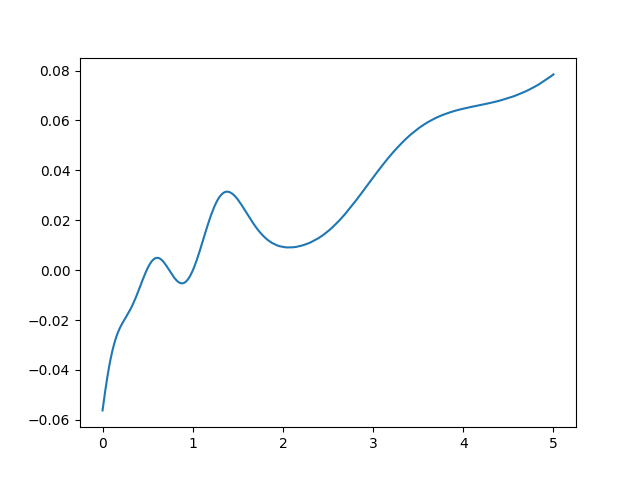

In [912]:
#this_perm = permutations_4[np.argmin(sum_all)]
this_perm = (0,1,2,3)
plt.figure()
plt.plot(excite_y0_raw,all_x[this_perm[0]]+all_x[this_perm[1]]+all_x[this_perm[2]]**2+4*all_x[this_perm[3]]**2)
plt.show()

In [1124]:
Y = np.array([x0grad]).T
X = np.array([x1grad,x2grad,x3grad]).T

#X = np.array([x1,x2,x3]).T
#Y = np.array(x0).T

lambda_reg = 0
#10**(-5)

n_neurons = 512

model_lin = tf.keras.Sequential([
    layers.Input(shape=(3,)),
    layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
    layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
    #layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
    layers.Dense(1, kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg))  
])
model_squared = tf.keras.Sequential([
    layers.Input(shape=(3,)),
    layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
    layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
    layers.Dense(1, kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg))  
])
model_cubed = tf.keras.Sequential([
    layers.Input(shape=(3,)),
    layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
    layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
    layers.Dense(1, kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg))  
])
model_4th = tf.keras.Sequential([
    layers.Input(shape=(3,)),
    layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
    layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
    layers.Dense(1, kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg))  
])

model_lin.compile(optimizer=keras.optimizers.Adam(learning_rate=10**(-3)), loss='mse')
model_squared.compile(optimizer='adam', loss='mse')
model_cubed.compile(optimizer='adam', loss='mse')
model_4th.compile(optimizer='adam', loss='mse')


In [1125]:
history_loss_lin = []
#history_loss_squared = []
#history_loss_cubed = []
#history_loss_4th = []

In [1143]:
model_lin.compile(optimizer=keras.optimizers.Adam(learning_rate=10**(-5)), loss='mse')

In [1159]:
t1 = time.time()

hist_loss_lin = model_lin.fit(X, Y, epochs=50, batch_size=100)
#hist_loss_squared = model_squared.fit(X, Y**2, epochs=50, batch_size=100)
#hist_loss_cubed = model_cubed.fit(X, Y**3, epochs=50, batch_size=100)
#hist_loss_4th = model_cubed.fit(X, Y**4, epochs=50, batch_size=100)

t2 = time.time()

Epoch 1/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - loss: 1.1280e-06
Epoch 2/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - loss: 1.1933e-06
Epoch 3/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 1.0998e-06
Epoch 4/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 1.1397e-06
Epoch 5/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 1.0963e-06
Epoch 6/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - loss: 1.1400e-06
Epoch 7/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - loss: 1.1758e-06
Epoch 8/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - loss: 1.1317e-06
Epoch 9/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 1.1209e-06
Epoch 10/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 10s 9ms/step - loss: 1.1014e-06
Epoch 11/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 1.0765e-06
Epoch 12/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 1.1314e-06
Epoch 13/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 1.0651e-06
Epoch 14/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 6s 

In [1160]:
print(t2-t1)

316.92823481559753


In [1161]:
history_loss_lin += hist_loss_lin.history["loss"]
#history_loss_squared += hist_loss_squared.history["loss"]
#history_loss_cubed += hist_loss_cubed.history["loss"]
#history_loss_4th += hist_loss_4th.history["loss"]

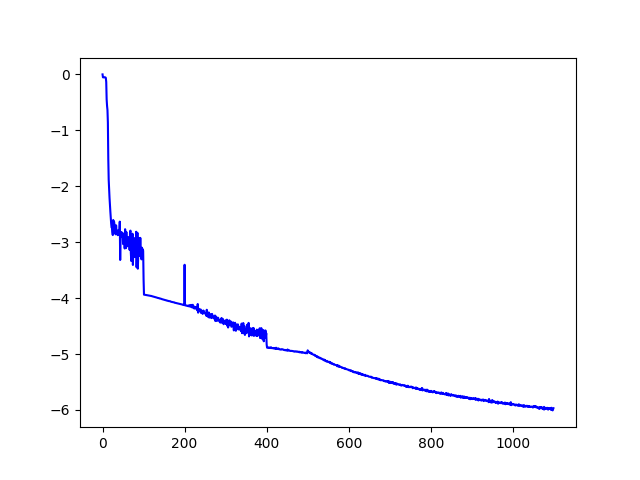

In [1162]:
plt.figure()
plt.plot(np.log(history_loss_lin)/np.log(10),c='b')
#plt.plot(np.log(history_loss_squared),c='orange')
#plt.plot(np.log(history_loss_cubed),c='r')
#plt.plot(np.log(history_loss_4th),c='yellow')
plt.show()

In [1163]:
x00_pred_lin = model_lin.predict(X)
#x00_pred_squared = model_squared.predict(X)
#x00_pred_cubed = model_cubed.predict(X)
#x00_pred_4th = model_4th.predict(X)

3125/3125 ━━━━━━━━━━━━━━━━━━━━ 7s 2ms/step


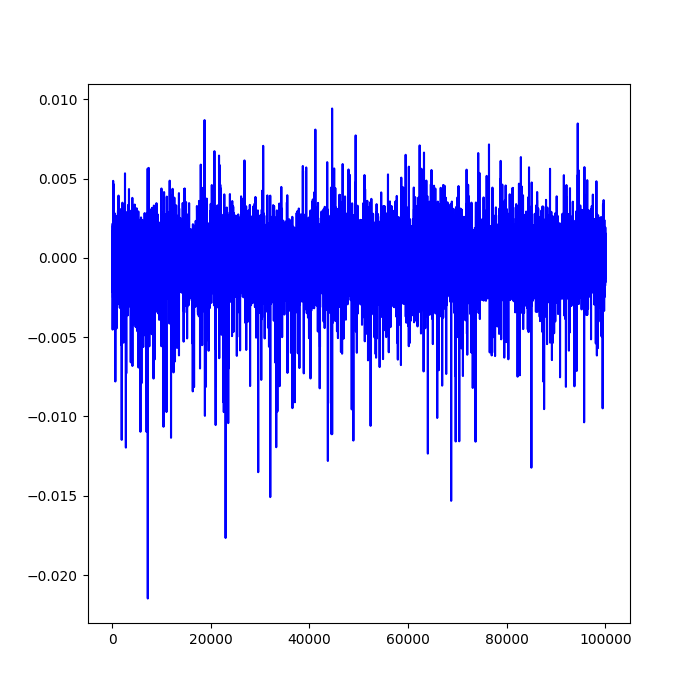

In [1164]:
plt.figure(figsize=(7,7))
plt.plot(x0grad[:]-x00_pred_lin[:,0],c='b')
#plt.plot(x00_pred_lin[:,0]+x1grad+x2grad**2+4*x3grad**2,c='orange')
#plt.plot(excite_y0_raw,,c='b',linestyle='dashed')
#plt.plot(excite_y0_raw,x01-x00_pred_lin[10000:20000],c='r')
#plt.plot(excite_y0_raw,,c='r',linestyle='dashed')
#plt.plot(excite_y0_raw,x02-x00_pred_lin[20000:30000],c='orange')
#plt.plot(excite_y0_raw,,c='orange',linestyle='dashed')
#plt.plot(excite_y0_raw,x00_pred_squared)
#plt.plot(excite_y0_raw,x00_pred_cubed**(1./3))
#plt.plot(excite_y0_raw,x00_pred_4th**(1./4))
plt.show()

In [1165]:
w0, b0 = model_lin.layers[0].get_weights()
w1, b1 = model_lin.layers[1].get_weights()
w2, b2 = model_lin.layers[2].get_weights()
#w3, b3 = model_lin.layers[3].get_weights()

In [1166]:
print(w0.shape,b0.shape)
print(w1.shape,b1.shape)
print(w2.shape,b2.shape)
#print(w3.shape,b3.shape)

(3, 512) (512,)
(512, 512) (512,)
(512, 1) (1,)


In [1167]:
np.savetxt("w0_model_10d_pot_3.csv", w0, delimiter=",",fmt="%.6f")
np.savetxt("w1_model_10d_pot_3.csv", w1, delimiter=",",fmt="%.6f")
np.savetxt("w2_model_10d_pot_3.csv", w2, delimiter=",",fmt="%.6f")
#np.savetxt("w3_model_10d_pot_2.csv", w2, delimiter=",",fmt="%.6f")
np.savetxt("b0_model_10d_pot_3.csv", b0, delimiter=",",fmt="%.6f")
np.savetxt("b1_model_10d_pot_3.csv", b1, delimiter=",",fmt="%.6f")
np.savetxt("b2_model_10d_pot_3.csv", b2, delimiter=",",fmt="%.6f")
#np.savetxt("b3_model_10d_pot_2.csv", b2, delimiter=",",fmt="%.6f")


In [1089]:
model_lin.summary()

Model: "sequential_100"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_333 (Dense)               │ (None, 1024)           │         4,096 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_334 (Dense)               │ (None, 1024)           │     1,049,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_335 (Dense)               │ (None, 1024)           │     1,049,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_336 (Dense)               │ (None, 1)              │         1,025 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,312,965 (24.08 MB)

 Trainable params: 2,104,321 (8.03 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 4,208,644 (16.05 MB)

In [ ]:
######

In [1172]:
import numpy as np
from itertools import combinations_with_replacement

def generate_polynomial_10(x, *coeffs):
    """
    Génère un polynôme de plusieurs variables à partir des données d'entrée et des coefficients.
    
    :param x: tableau de dimension (n_var, n_sample) où chaque ligne correspond à une variable et chaque colonne à un échantillon.
    :param deg: degré du polynôme.
    :param coeffs: coefficients du polynôme. Si None, les coefficients seront fixés à 1.
    :return: tableau (1, n_sample) du polynôme évalué sur chaque échantillon.
    """
    deg = 4
    n_var, n_sample = x.shape

    # Générer toutes les combinaisons des variables avec répétition jusqu'à un certain degré
    terms = []
    combs = []
    for d in range(deg+1):
        for comb in combinations_with_replacement(range(n_var), d):
            term = np.prod(x[comb, :], axis=0)
            terms.append(term)
            combs.append(comb)  

    polynomial_terms = np.array(terms)

    if coeffs is None:
        coeffs = np.ones(polynomial_terms.shape[0])
    #else:
    #    if len(coeffs) != polynomial_terms.shape[0]:
    #        raise ValueError(f"Le nombre de coefficients ({len(coeffs)}) ne correspond pas au nombre de termes générés ({polynomial_terms.shape[0]}).")

    # Multiplier chaque terme par le coefficient correspondant
    polynomial = np.dot(coeffs, polynomial_terms)

    return polynomial

In [1173]:
deg_x0 = 1
popt0, pcov0 = curve_fit(generate_polynomial_10,np.array([x1,x2,x3]),x0**deg_x0,p0=np.array([0,-1,0,0,0,0,1,0,0,-4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0]))


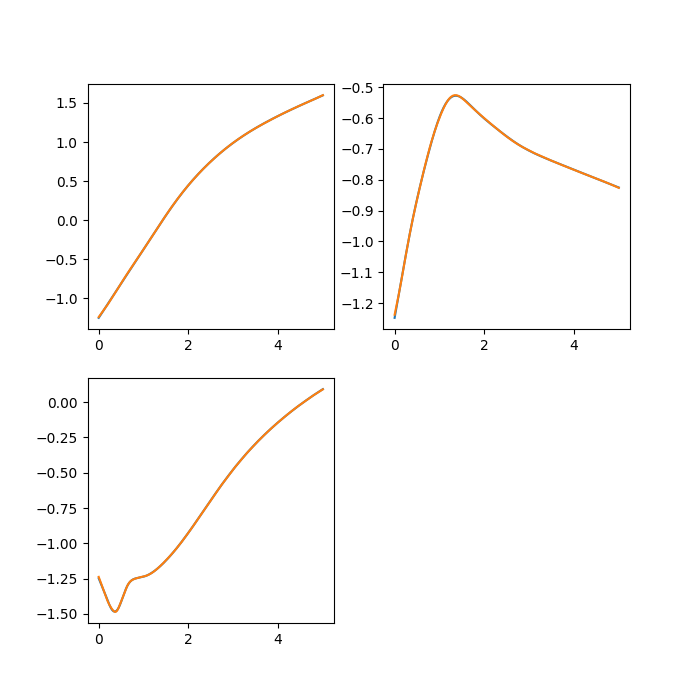

In [1175]:
fig = plt.figure(figsize=(7,7))
ax1 = fig.add_subplot(2,2,1)
ax1.plot(excite_y0_raw,x00**deg_x0)
ax1.plot(excite_y0_raw,generate_polynomial_10(np.array([x10,x20,x30]),popt0)[0,:])

ax2 = fig.add_subplot(2,2,2)
ax2.plot(excite_y0_raw,x01**deg_x0)
ax2.plot(excite_y0_raw,generate_polynomial_10(np.array([x11,x21,x31]),popt0)[0,:])

ax3 = fig.add_subplot(2,2,3)
ax3.plot(excite_y0_raw,x02**deg_x0)
ax3.plot(excite_y0_raw,generate_polynomial_10(np.array([x12,x22,x32]),popt0)[0,:])

In [1176]:
popt0

array([-5.33137575e+01, -3.84497505e+01,  6.59097097e+01, -3.55508698e+01,
       -1.03413237e+01,  5.11693050e+01, -2.89089611e+00, -1.01142739e+01,
        3.96603223e+01,  9.80532091e+01, -1.07138804e+00,  1.35902567e+01,
        5.34960120e+00, -9.72246141e+00,  7.30958566e+00,  4.54062578e+01,
       -3.92139562e+00, -1.92700294e+01, -2.81660835e+01, -1.76821207e+01,
       -5.78330790e-03,  1.35083304e+00,  9.19620259e-01, -1.22195447e+00,
       -4.73803508e-01,  4.63412713e+00,  2.89857324e-01,  6.91719457e-02,
       -7.54402602e+00, -7.46630872e+00,  6.84989053e-01,  6.49156411e+00,
       -1.70168477e+00,  7.43588670e+00, -6.44395528e+00])

In [ ]:
# Tend to overfit ! 

In [ ]:
#npoints_y0y1 = 50
#col1 = np.tile(np.linspace(0, 2, npoints_y0y1), npoints_y0y1)  
#col2 = np.repeat(np.linspace(0, 2, npoints_y0y1), npoints_y0y1) 
#col3 = np.zeros(npoints_y0y1 * npoints_y0y1)  

#excite_y0y1 = np.column_stack((col1, col2, col3))

#print(excite_y0y1.shape)  

In [1182]:
################################################################################################################################
################################################################################################################################
################################################################################################################################
################################################################################################################################

In [1183]:
##########        ##########
########## 10d 2  ##########
##########        ##########

In [16]:
def V_10d_2(x):
    x1,x2,x3,x4,x5, x6, x7, x8, x9, x10 = tf.split(x, 10, axis = 1)
    return (x3 + x5 + x7) ** 4 + (-x1 + x10 -x3 + x4 -x5 -x7 + x8) ** 4 + 0.5 * ((x10 -x2 + x5 -x6 -x8 + 4 * ((x1 + x2 -x4 -x6 -x7 + x8) ** 2) + (-x1 + x2 -x5 -x6 + x7 + x8 -x9) ** 2) ** 3) + (-x3 -x4 + x5 -x6 -x9) ** 4 + (-x1 + x2 + x3 + x4 + x5 -x6 -x7 -x8 -x9) ** 4 + (x1 + x10 -x2 -x6 + x8 -x9) ** 4 + (x1 + x3 + x4 + x5 + x6 + x8 + x9) ** 4


In [19]:
# randomly initialize the points
n_points = 100000
xHiggs_10d_2 = tf.Variable(4*np.random.rand(n_points, 10)-2, dtype=tf.float32)

historyHiggs_10d_2 = []

In [45]:
# Oprimizer for the gradient descent

init_alpha=10**(-4)
alpha = init_alpha

optimizer = tf.optimizers.Adam(learning_rate=alpha)
#optimizer = tf.optimizers.SGD(learning_rate=init_alpha,momentum=0.0)

# Learning loop 
loss_prev_step=10**8

update_opt = False

for step in range(5000):  
    with tf.GradientTape() as tape:
        loss = tf.reduce_sum(grad_norm_squared(V_10d_2, xHiggs_10d_2)) # minimize ||∇V||^2 for all points
    
    # Compute ||∇V||^2 with respect to x
    gradients = tape.gradient(loss, [xHiggs_10d_2])
    
    if update_opt and step % 200 ==0 :
        print("Reinitializing the optimizer")
        optimizer = tf.optimizers.Adam(learning_rate=init_alpha)
    
    if step == 1201:
        update_opt = False 
        #optimizer.learning_rate.assign(0.001)
        
    # Apply gradient descent for all points
    optimizer.apply_gradients(zip(gradients, [xHiggs_10d_2]))
    
    historyHiggs_10d_2.append(loss)
    
    if step % 10 == 0:
        print(f"""Step {step}: ||∇V||^2 = {loss.numpy()} with learning rate {optimizer.get_config()["learning_rate"]}""")
        
    if np.log(loss.numpy())/np.log(10)<-10: 
        print("Converged enough") 
        print(f"Step {step}: ||∇V||^2 = {loss.numpy()}")
        break

Step 0: ||∇V||^2 = 1.7432957974961028e-05 with learning rate 9.999999747378752e-05
Step 10: ||∇V||^2 = 2.220486567239277e-05 with learning rate 9.999999747378752e-05
Step 20: ||∇V||^2 = 1.939556204888504e-05 with learning rate 9.999999747378752e-05
Step 30: ||∇V||^2 = 1.8130145690520294e-05 with learning rate 9.999999747378752e-05
Step 40: ||∇V||^2 = 1.7615087926969863e-05 with learning rate 9.999999747378752e-05
Step 50: ||∇V||^2 = 1.739776780596003e-05 with learning rate 9.999999747378752e-05
Step 60: ||∇V||^2 = 1.7312533600488678e-05 with learning rate 9.999999747378752e-05
Step 70: ||∇V||^2 = 1.725613583403174e-05 with learning rate 9.999999747378752e-05
Step 80: ||∇V||^2 = 1.7217889762832783e-05 with learning rate 9.999999747378752e-05
Step 90: ||∇V||^2 = 1.7231654055649415e-05 with learning rate 9.999999747378752e-05
Step 100: ||∇V||^2 = 1.7189357095048763e-05 with learning rate 9.999999747378752e-05
Step 110: ||∇V||^2 = 1.7380632925778627e-05 with learning rate 9.999999747378752

Step 970: ||∇V||^2 = 1.209084894071566e-05 with learning rate 9.999999747378752e-05
Step 980: ||∇V||^2 = 1.191679166367976e-05 with learning rate 9.999999747378752e-05
Step 990: ||∇V||^2 = 1.1967268619628157e-05 with learning rate 9.999999747378752e-05
Step 1000: ||∇V||^2 = 1.1781127795984503e-05 with learning rate 9.999999747378752e-05
Step 1010: ||∇V||^2 = 1.1710188118740916e-05 with learning rate 9.999999747378752e-05
Step 1020: ||∇V||^2 = 1.164998593594646e-05 with learning rate 9.999999747378752e-05
Step 1030: ||∇V||^2 = 1.1590096619329415e-05 with learning rate 9.999999747378752e-05
Step 1040: ||∇V||^2 = 1.1529275980137754e-05 with learning rate 9.999999747378752e-05
Step 1050: ||∇V||^2 = 1.174779754364863e-05 with learning rate 9.999999747378752e-05
Step 1060: ||∇V||^2 = 1.1441325113992207e-05 with learning rate 9.999999747378752e-05
Step 1070: ||∇V||^2 = 1.1362610166543163e-05 with learning rate 9.999999747378752e-05
Step 1080: ||∇V||^2 = 1.1291607734165154e-05 with learning ra

Step 1940: ||∇V||^2 = 7.308721251320094e-06 with learning rate 9.999999747378752e-05
Step 1950: ||∇V||^2 = 7.766087037452962e-06 with learning rate 9.999999747378752e-05
Step 1960: ||∇V||^2 = 7.15754640623345e-06 with learning rate 9.999999747378752e-05
Step 1970: ||∇V||^2 = 7.05191132510663e-06 with learning rate 9.999999747378752e-05
Step 1980: ||∇V||^2 = 7.0040659920778126e-06 with learning rate 9.999999747378752e-05
Step 1990: ||∇V||^2 = 6.965790817048401e-06 with learning rate 9.999999747378752e-05
Step 2000: ||∇V||^2 = 6.9290827013901435e-06 with learning rate 9.999999747378752e-05
Step 2010: ||∇V||^2 = 9.016126568894833e-06 with learning rate 9.999999747378752e-05
Step 2020: ||∇V||^2 = 7.190837095549796e-06 with learning rate 9.999999747378752e-05
Step 2030: ||∇V||^2 = 7.01621229381999e-06 with learning rate 9.999999747378752e-05
Step 2040: ||∇V||^2 = 7.264454325195402e-06 with learning rate 9.999999747378752e-05
Step 2050: ||∇V||^2 = 6.866682724648854e-06 with learning rate 9.9

Step 2910: ||∇V||^2 = 4.449670996109489e-06 with learning rate 9.999999747378752e-05
Step 2920: ||∇V||^2 = 6.398555342457257e-06 with learning rate 9.999999747378752e-05
Step 2930: ||∇V||^2 = 4.5700621740252245e-06 with learning rate 9.999999747378752e-05
Step 2940: ||∇V||^2 = 4.3394202293711714e-06 with learning rate 9.999999747378752e-05
Step 2950: ||∇V||^2 = 4.345285560702905e-06 with learning rate 9.999999747378752e-05
Step 2960: ||∇V||^2 = 4.297861323721008e-06 with learning rate 9.999999747378752e-05
Step 2970: ||∇V||^2 = 4.277274911146378e-06 with learning rate 9.999999747378752e-05
Step 2980: ||∇V||^2 = 4.255395197105827e-06 with learning rate 9.999999747378752e-05
Step 2990: ||∇V||^2 = 4.235676897224039e-06 with learning rate 9.999999747378752e-05
Step 3000: ||∇V||^2 = 4.215207809465937e-06 with learning rate 9.999999747378752e-05
Step 3010: ||∇V||^2 = 4.226748387736734e-06 with learning rate 9.999999747378752e-05
Step 3020: ||∇V||^2 = 4.1769844756345265e-06 with learning rate

Step 3870: ||∇V||^2 = 2.984567345265532e-06 with learning rate 9.999999747378752e-05
Step 3880: ||∇V||^2 = 3.1122369819058804e-06 with learning rate 9.999999747378752e-05
Step 3890: ||∇V||^2 = 2.9356283448578324e-06 with learning rate 9.999999747378752e-05
Step 3900: ||∇V||^2 = 3.6943968098057667e-06 with learning rate 9.999999747378752e-05
Step 3910: ||∇V||^2 = 3.0693045118823647e-06 with learning rate 9.999999747378752e-05
Step 3920: ||∇V||^2 = 3.3631088172114687e-06 with learning rate 9.999999747378752e-05
Step 3930: ||∇V||^2 = 2.8650506465055514e-06 with learning rate 9.999999747378752e-05
Step 3940: ||∇V||^2 = 3.1629322165827034e-06 with learning rate 9.999999747378752e-05
Step 3950: ||∇V||^2 = 2.859159167201142e-06 with learning rate 9.999999747378752e-05
Step 3960: ||∇V||^2 = 3.1724666769150645e-06 with learning rate 9.999999747378752e-05
Step 3970: ||∇V||^2 = 2.845189101208234e-06 with learning rate 9.999999747378752e-05
Step 3980: ||∇V||^2 = 2.752754880930297e-06 with learning

Step 4830: ||∇V||^2 = 2.2549370441993233e-06 with learning rate 9.999999747378752e-05
Step 4840: ||∇V||^2 = 2.0254428818589076e-06 with learning rate 9.999999747378752e-05
Step 4850: ||∇V||^2 = 2.0168881746940315e-06 with learning rate 9.999999747378752e-05
Step 4860: ||∇V||^2 = 1.9606598016252974e-06 with learning rate 9.999999747378752e-05
Step 4870: ||∇V||^2 = 1.9521291960700182e-06 with learning rate 9.999999747378752e-05
Step 4880: ||∇V||^2 = 1.9442186385276727e-06 with learning rate 9.999999747378752e-05
Step 4890: ||∇V||^2 = 1.9362528291821945e-06 with learning rate 9.999999747378752e-05
Step 4900: ||∇V||^2 = 1.9285025700810365e-06 with learning rate 9.999999747378752e-05
Step 4910: ||∇V||^2 = 1.9248495846113656e-06 with learning rate 9.999999747378752e-05
Step 4920: ||∇V||^2 = 3.7949539546389133e-06 with learning rate 9.999999747378752e-05
Step 4930: ||∇V||^2 = 5.250891717878403e-06 with learning rate 9.999999747378752e-05
Step 4940: ||∇V||^2 = 2.307907834619982e-06 with learni

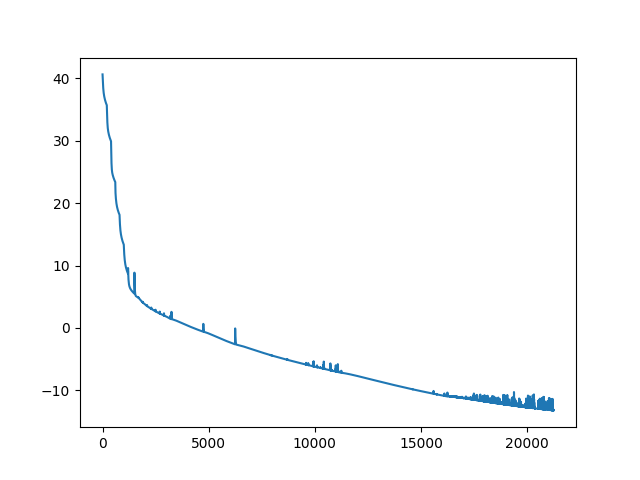

In [46]:
plt.figure()
plt.plot(np.log(historyHiggs_10d_2))
plt.show()

In [43]:
for i in range(15):
    print(f"Number of points with ||∇V||^2 > {10**(-i)} : {sum(tf.reduce_sum(get_grad(V_10d_2,xHiggs_10d_2)**2,axis=1).numpy()>10**(-i))}")
          

Number of points with ||∇V||^2 > 1 : 0
Number of points with ||∇V||^2 > 0.1 : 0
Number of points with ||∇V||^2 > 0.01 : 0
Number of points with ||∇V||^2 > 0.001 : 0
Number of points with ||∇V||^2 > 0.0001 : 0
Number of points with ||∇V||^2 > 1e-05 : 0
Number of points with ||∇V||^2 > 1e-06 : 0
Number of points with ||∇V||^2 > 1e-07 : 1
Number of points with ||∇V||^2 > 1e-08 : 316
Number of points with ||∇V||^2 > 1e-09 : 2874
Number of points with ||∇V||^2 > 1e-10 : 8782
Number of points with ||∇V||^2 > 1e-11 : 31759
Number of points with ||∇V||^2 > 1e-12 : 56932
Number of points with ||∇V||^2 > 1e-13 : 66951
Number of points with ||∇V||^2 > 1e-14 : 95806


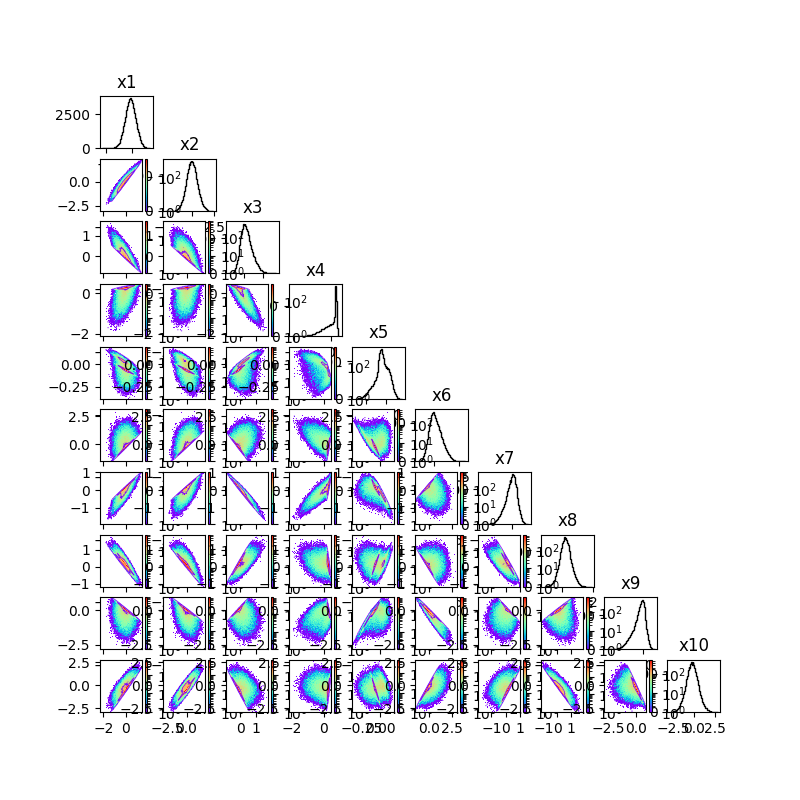

In [44]:
triangular_plot(xHiggs_10d_2.numpy(),fig_size=8)

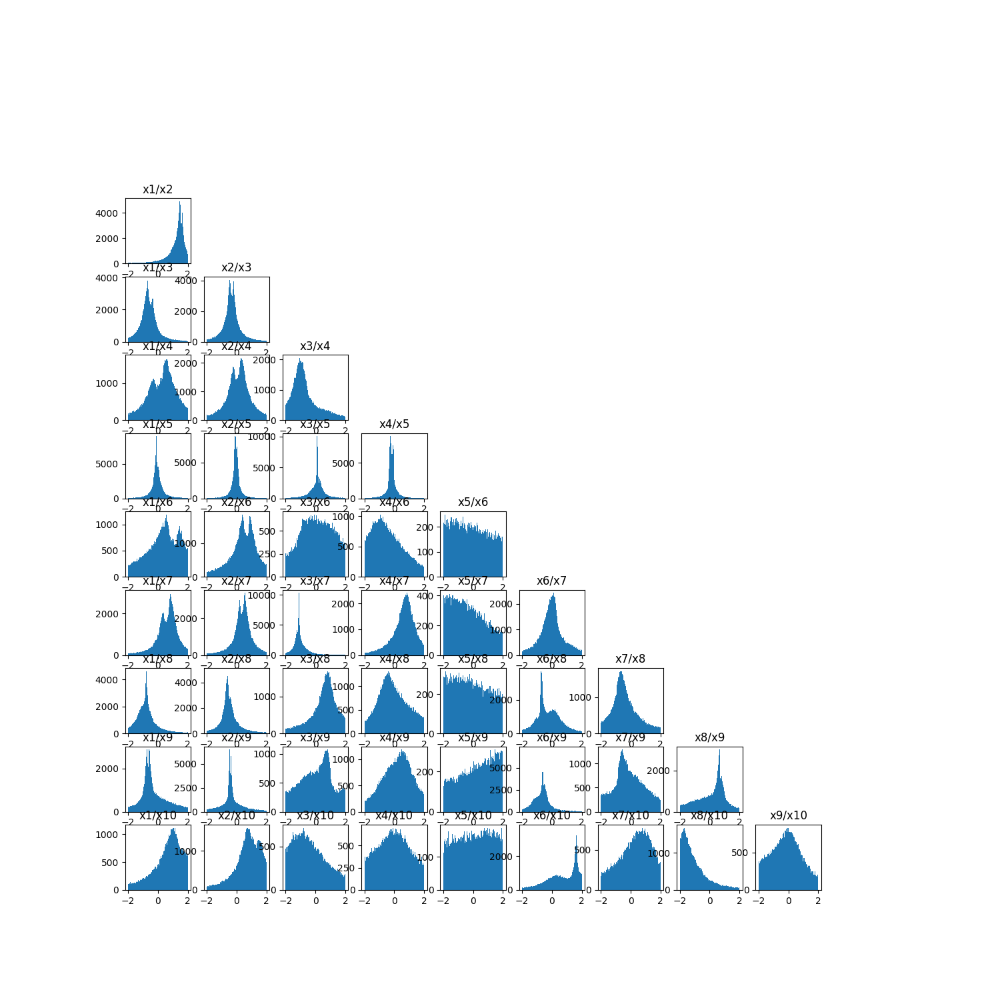

In [48]:
triangular_plot_slopes(xHiggs_10d_2,fig_size=15,lim=2)

In [49]:
mask_train = np.array([np.random.rand()<0.9 for i in range(100000)])
set_train = np.array([np.extract(mask_train,xHiggs_10d_2.numpy()[:,i]) for i in range(10)]).T
set_test = np.array([np.extract(1-mask_train,xHiggs_10d_2.numpy()[:,i]) for i in range(10)]).T
print(set_train.shape)
print(set_test.shape)

(90029, 10)
(9971, 10)


In [50]:
history_all_10d_2 = []

for i in range(10):
    
    this_latent_dim = i + 1
    input_dim = 10
    
    print(this_latent_dim)

    inputs = layers.Input(shape=(input_dim,))
    encoded = layers.Dense(128, activation='sigmoid')(inputs)
    encoded = layers.Dense(128, activation='sigmoid')(encoded)
    encoded = layers.Dense(128, activation='sigmoid')(encoded)
    encoded = layers.Dense(this_latent_dim)(encoded)  

    decoded = layers.Dense(128, activation='sigmoid')(encoded)
    decoded = layers.Dense(128, activation='sigmoid')(decoded)
    encoded = layers.Dense(128, activation='sigmoid')(encoded)
    decoded = layers.Dense(input_dim)(decoded)  

    this_autoencoder = keras.Model(inputs, decoded)
    this_autoencoder.compile(optimizer='adam', loss='mse')
    
    history_all_10d_2.append(this_autoencoder.fit(set_train, set_train, epochs=100, batch_size=100, shuffle=True, validation_data=(set_test,set_test)))


1
Epoch 1/100


KeyboardInterrupt: 

In [241]:
history_min = []
for this_history in history_all_10d_2: 
    this_min = np.min(this_history.history['val_loss'])
    history_min.append(this_min)

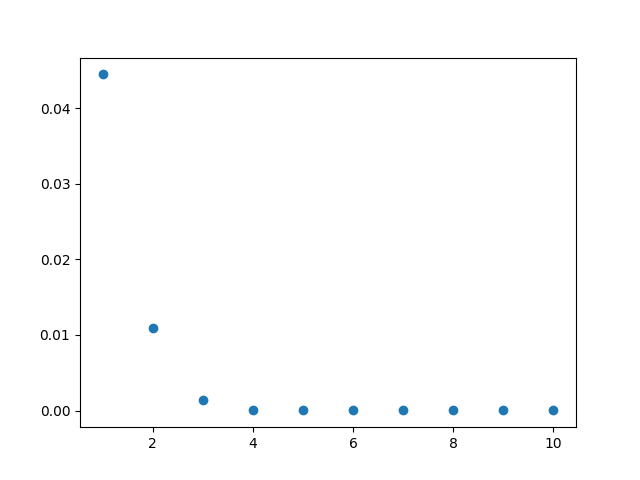

In [242]:
plt.figure()
plt.scatter(np.linspace(1,10,10),history_min)
#plt.ylim((-0.1,1))
plt.show()

In [51]:
mask_train_10d_2 = np.array([np.random.rand()<0.9 for i in range(100000)])
set_train_10d_2 = np.array([np.extract(mask_train_10d_2,xHiggs_10d_2.numpy()[:,i]) for i in range(10)]).T
set_test_10d_2 = np.array([np.extract(1-mask_train_10d_2,xHiggs_10d_2.numpy()[:,i]) for i in range(10)]).T
print(set_train_10d_2.shape)
print(set_test_10d_2.shape)

(89848, 10)
(10152, 10)


In [52]:
latent_dim = 3
input_dim = 10

n_neurons = 256

inputs = layers.Input(shape=(input_dim,))
encoded = layers.Dense(n_neurons, activation='sigmoid')(inputs)
encoded = layers.Dense(n_neurons, activation='sigmoid')(encoded)
#encoded = layers.Dense(128, activation='sigmoid')(encoded)
encoded = layers.Dense(latent_dim)(encoded)  

decoded = layers.Dense(n_neurons, activation='sigmoid')(encoded)
decoded = layers.Dense(n_neurons, activation='sigmoid')(decoded)
#decoded = layers.Dense(128, activation='sigmoid')(decoded)
decoded = layers.Dense(input_dim)(decoded)  

autoencoder_10d_2 = keras.Model(inputs, decoded)
autoencoder_10d_2.compile(optimizer='adam', loss='mse')
autoencoder_10d_2.summary()

Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 10)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 256)            │         2,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 256)            │        65,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ (None, 3)              │           771 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_11 (Dense)                │ (None, 256)            │         1,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 256)            │        65,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 10)             │         2,570 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 138,765 (542.05 KB)

 Trainable params: 138,765 (542.05 KB)

 Non-trainable params: 0 (0.00 B)

In [53]:
autoencoder_10d_2.compile(optimizer=keras.optimizers.Adam(learning_rate=10**(-5)), loss='mse')


In [54]:
history_10d_2 = autoencoder_10d_2.fit(set_train_10d_2, set_train_10d_2, epochs=50, batch_size=100, shuffle=True, validation_data=(set_test_10d_2,set_test_10d_2))


Epoch 1/50


AttributeError: module 'keras.src.backend' has no attribute 'convert_to_numpy'

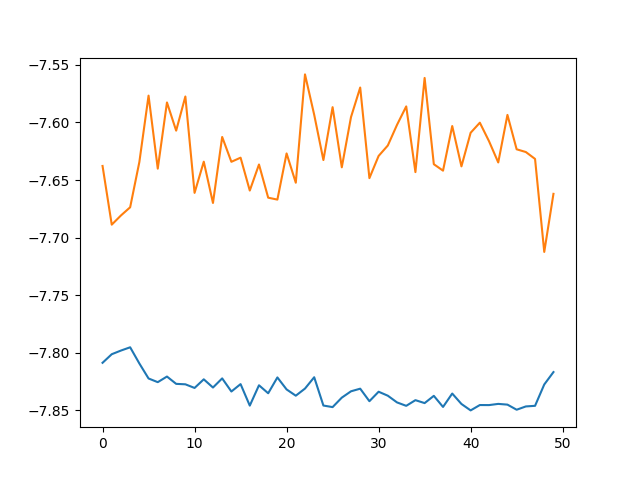

In [1226]:
plt.figure()
plt.plot(np.log(history_10d_2.history["loss"]))
plt.plot(np.log(history_10d_2.history["val_loss"]))
plt.show()


In [1228]:
encoder = models.Model(inputs, encoded)

latent_inputs = layers.Input(shape=(latent_dim,))  
#decoded_layer = autoencoder_10d_2.layers[-4](latent_inputs)
decoded_layer = autoencoder_10d_2.layers[-3](latent_inputs)
decoded_layer = autoencoder_10d_2.layers[-2](decoded_layer)
decoded_output = autoencoder_10d_2.layers[-1](decoded_layer)

decoder = models.Model(latent_inputs, decoded_output)

In [1229]:
decoded_points_10d_2_y0 = decoder.predict(excite_y0)
decoded_points_10d_2_y1 = decoder.predict(excite_y1)
decoded_points_10d_2_y2 = decoder.predict(excite_y2)

313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


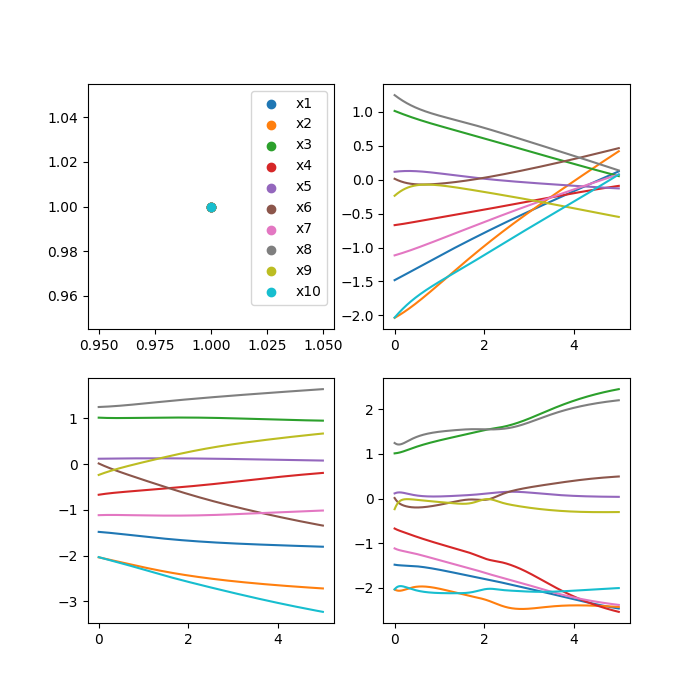

In [1230]:
fig = plt.figure(figsize=(7,7))
ax1 = fig.add_subplot(2,2,1)
ax2 = fig.add_subplot(2,2,2)
ax3 = fig.add_subplot(2,2,3)
ax4 = fig.add_subplot(2,2,4)
for i in range(10):
    ax1.scatter(1,1,label = f"x{i+1}")
    ax2.plot(excite_y0[:,0],decoded_points_10d_2_y0[:,i])
    ax3.plot(excite_y0[:,0],decoded_points_10d_2_y1[:,i])
    ax4.plot(excite_y0[:,0],decoded_points_10d_2_y2[:,i])

ax1.legend()
plt.show()

In [1389]:
x_1_0 = xHiggs_10d_2.numpy()[:,0]
x_1_1 = xHiggs_10d_2.numpy()[:,1]
x_1_2 = xHiggs_10d_2.numpy()[:,2]
x_1_3 = xHiggs_10d_2.numpy()[:,3]
x_1_4 = xHiggs_10d_2.numpy()[:,4]
x_1_5 = xHiggs_10d_2.numpy()[:,5]
x_1_6 = xHiggs_10d_2.numpy()[:,6]
x_1_7 = xHiggs_10d_2.numpy()[:,7]
x_1_8 = xHiggs_10d_2.numpy()[:,8]
x_1_9 = xHiggs_10d_2.numpy()[:,9]


In [1251]:
Y = np.array([x_1_0]).T
X = np.array([x_1_1,x_1_2,x_1_3,x_1_4,x_1_5,x_1_6,x_1_7,x_1_8,x_1_9]).T

#X = np.array([x1,x2,x3]).T
#Y = np.array(x0).T

lambda_reg = 0
#10**(-5)

n_neurons = 128
input_shape = 9

model_lin = tf.keras.Sequential([
    layers.Input(shape=(input_shape,)),
    layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
    layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
    layers.Dense(1, kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg))  
])
model_squared = tf.keras.Sequential([
    layers.Input(shape=(input_shape,)),
    layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
    layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
    layers.Dense(1, kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg))  
])
model_cubed = tf.keras.Sequential([
    layers.Input(shape=(input_shape,)),
    layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
    layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
    layers.Dense(1, kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg))  
])
model_4th = tf.keras.Sequential([
    layers.Input(shape=(input_shape,)),
    layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
    layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
    layers.Dense(1, kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg))  
])


In [1252]:
#model_lin.compile(optimizer=keras.optimizers.Adam(learning_rate=10**(-3)), loss='mse')
model_lin.compile(optimizer='adam', loss='mse')
model_squared.compile(optimizer='adam', loss='mse')
model_cubed.compile(optimizer='adam', loss='mse')
model_4th.compile(optimizer='adam', loss='mse')

In [1253]:
history_loss_lin = []
history_loss_squared = []
history_loss_cubed = []
history_loss_4th = []

In [1254]:
t1 = time.time()

hist_loss_lin = model_lin.fit(X, Y, epochs=50, batch_size=100)
hist_loss_squared = model_squared.fit(X, Y**2, epochs=50, batch_size=100)
#hist_loss_cubed = model_cubed.fit(X, Y**3, epochs=50, batch_size=100)
#hist_loss_4th = model_cubed.fit(X, Y**4, epochs=50, batch_size=100)

t2 = time.time()

Epoch 1/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - loss: 0.0343
Epoch 2/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.9340e-04
Epoch 3/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 5.6888e-04
Epoch 4/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.6221e-04
Epoch 5/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.1354e-04
Epoch 6/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 9.7609e-05
Epoch 7/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 9.0293e-05
Epoch 8/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.6166e-05
Epoch 9/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.5810e-05
Epoch 10/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.5147e-05
Epoch 11/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 6.4542e-05
Epoch 12/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 6.5159e-05
Epoch 13/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 6.3537e-05
Epoch 14/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/s

In [1255]:
history_loss_lin += hist_loss_lin.history["loss"]
history_loss_squared += hist_loss_squared.history["loss"]
history_loss_cubed += hist_loss_cubed.history["loss"]
history_loss_4th += hist_loss_4th.history["loss"]

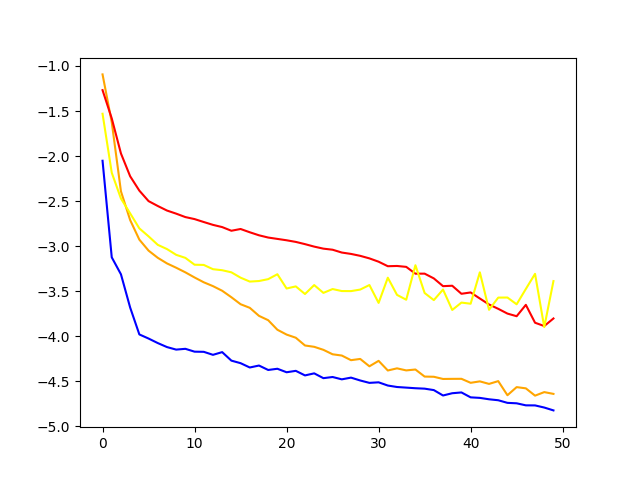

In [1256]:
plt.figure()
plt.plot(np.log(history_loss_lin)/np.log(10),c='b')
plt.plot(np.log(history_loss_squared)/np.log(10),c='orange')
plt.plot(np.log(history_loss_cubed)/np.log(10),c='r')
plt.plot(np.log(history_loss_4th)/np.log(10),c='yellow')
plt.show()

In [1329]:
Y = np.array([x_1_0]).T
X = np.array([x_1_1,x_1_2,x_1_3,x_1_4,x_1_5,x_1_6,x_1_7,x_1_8,x_1_9]).T

#X = np.array([x1,x2,x3]).T
#Y = np.array(x0).T

lambda_reg = 0
#10**(-5)

n_neurons = 256
input_shape = 9

model_lin_x_1_0 = tf.keras.Sequential([
    layers.Input(shape=(input_shape,)),
    layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
    layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
    layers.Dense(1, kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg))  
])


In [1330]:
history_loss_lin_x_1_0 = []

In [1348]:
reduce_lr = ReduceLROnPlateau(monitor='loss',
                                        factor=0.5,
                                        patience=10,
                                        min_lr=10**(-6),
                                        percentage_delta = 10**(-3))

#model_lin_x_1_0.compile(optimizer='adam', loss='mse')
model_lin_x_1_0.compile(optimizer=keras.optimizers.Adam(learning_rate=10**(-2)), loss='mse')


In [1347]:
hist_loss_lin_x_1_0 = model_lin_x_1_0.fit(X, Y, epochs=200, batch_size=100, callbacks=[reduce_lr])


Epoch 1/200
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - loss: 0.0035
Epoch 2/200
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 2.8601e-05
Epoch 3/200
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - loss: 1.7377e-04
Epoch 4/200
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.5791e-04
Epoch 5/200
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.7833e-04
Epoch 6/200
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.6139e-04
Epoch 7/200
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.4591e-04
Epoch 8/200
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 1.4977e-04
Epoch 9/200
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.3382e-04
Epoch 10/200
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.3690e-04
Epoch 11/200
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.3998e-04
Epoch 12/200
 989/1000 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 1.9989e-04

AttributeError: 'str' object has no attribute 'name'

In [1335]:
history_loss_lin_x_1_0 += hist_loss_lin_x_1_0.history["loss"]

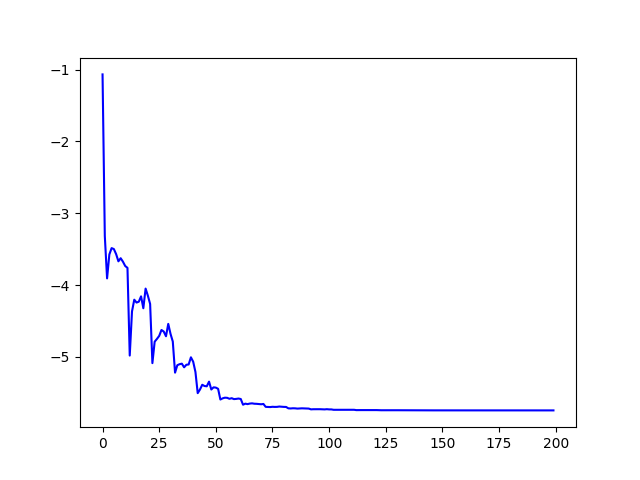

In [1336]:
plt.figure()
plt.plot(np.log(history_loss_lin_x_1_0)/np.log(10),c='b')
plt.show()

In [1306]:
w0, b0 = model_lin_x_1_0.layers[0].get_weights()
w1, b1 = model_lin_x_1_0.layers[1].get_weights()
w2, b2 = model_lin_x_1_0.layers[2].get_weights()
#w3, b3 = model_lin.layers[3].get_weights()


In [1307]:
w0, b0 = model_lin_x_1_0.layers[0].get_weights()
w1, b1 = model_lin_x_1_0.layers[1].get_weights()
w2, b2 = model_lin_x_1_0.layers[2].get_weights()
#w3, b3 = model_lin.layers[3].get_weights()
np.savetxt("w0_model_10d_pot_x_1_0.csv", w0, delimiter=",",fmt="%.6f")
np.savetxt("w1_model_10d_pot_x_1_0.csv", w1, delimiter=",",fmt="%.6f")
np.savetxt("w2_model_10d_pot_x_1_0.csv", w2, delimiter=",",fmt="%.6f")
#np.savetxt("w3_model_10d_pot_2.csv", w2, delimiter=",",fmt="%.6f")
np.savetxt("b0_model_10d_pot_x_1_0.csv", b0, delimiter=",",fmt="%.6f")
np.savetxt("b1_model_10d_pot_x_1_0.csv", b1, delimiter=",",fmt="%.6f")
np.savetxt("b2_model_10d_pot_x_1_0.csv", b2, delimiter=",",fmt="%.6f")
#np.savetxt("b3_model_10d_pot_2.csv", b2, delimiter=",",fmt="%.6f")


# Try to make the analysis systematic

In [1594]:
def find_order(X, Y, max_order = 4, n_epochs = 50, n_neurons = 128, input_shape = 9, batch_size = 100):
    
    """Function that seeks to what order a given coordinate probably appears in a polynomial. Learns Y**order in 
    terms of X, for orders in range(max_order). Then returns the losses, from which we can extract the probable
    best orders. 
        - X : x_data for the neural network. Should contain different x's which you are going to use to reconstruct
            Y. array of shape (n_var,n_samples)
        - Y : y_data. The variable we try to reconstruct with x's. array of shape (n_samples,)
        - max_order. Maximum order to analyse. int
        - n_epochs. Numbers of epoch to train the NN with. int 
        - n_neurons. The architecture is fixed to dense layers of shape (n_var,n_neurons,n_neurons,1). int
        - input_shape. Number of variables n_var. int
        - batch_size. batch_size for the training of the NN. int"""
    
    all_loss = []
    for i in range(1,max_order+1): 
        this_model = tf.keras.Sequential([
            layers.Input(shape=(input_shape,)),
            layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
            layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
            layers.Dense(1, kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg))  
])
        this_model.compile(optimizer='adam', loss='mse')
        hist_this_loss = this_model.fit(X, Y**i, epochs=n_epochs, batch_size=batch_size)
        all_loss.append([i,hist_this_loss.history["loss"]])
    return all_loss
        
def learn_one_x_from_the_others(X, Y, n_neurons = 256, order = 1, lambda_reg = 0, n_epochs = 200, batch_size = 100, factor_red_lr = 0.5):
    
    """Train a NN to learn Y**order in terms of X. The architecture is fixed to dense layers of 
    shape (n_var,n_neurons,n_neurons,1).
        - X : x_data for the neural network. Should contain different x's which you are going to use to reconstruct
            Y. array of shape (n_var,n_samples)
        - Y : y_data. The variable we try to reconstruct with x's. array of shape (n_samples,)
        - order : power to raise Y. int
        - lambda_reg : regularisation parameter for the NN. float
        - n_epochs : number of epochs for the training. int
        - batch_size : batch_size for the training. int"""
    
    X_train, X_test = train_test_split(X, test_size=0.1, random_state=1)
    Y_train, Y_test = train_test_split(Y, test_size=0.1, random_state=1)
    
    input_shape = 9
    this_model = tf.keras.Sequential([
        layers.Input(shape=(input_shape,)),
        layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
        layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
        layers.Dense(1, kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg))  
        ])
    
    this_model.compile(optimizer=keras.optimizers.Adam(learning_rate=10**(-2)), loss='mse')
    
    if factor_red_lr < 1: 
        #reduce_lr = ReduceLROnPlateau(monitor='loss',
        #                              factor=factor_red_lr,
        #                              patience=10,
        #                              min_lr=10**(-6),
        #                              min_delta = 10**(-3))
        def scheduler(epoch, lr):
            if epoch < 100:
                return 10**(-2)
            elif epoch < 200:
                return 10**(-3)
            elif epoch < 300:
                return 10**(-4)
            else:
                return 10**(-5)
            
        lr_schedule = LearningRateScheduler(scheduler)
        this_hist_loss = this_model.fit(X, Y**order, epochs=n_epochs, batch_size=batch_size, callbacks=[lr_schedule],validation_data=[X_test,Y_test])
    else:
        this_hist_loss = this_model.fit(X, Y**order, epochs=n_epochs, batch_size=batch_size,validation_data=[X_test,Y_test])

    return [this_model,this_hist_loss]

def save_nn(model_to_save, name):
    """Save the NN
        - model_to_save : which NN to save. 
        - name : name under which to save NN. str"""
    index = 0
    for layer in model_to_save.layers:
        this_weights, this_baises = layer.get_weights()
        np.savetxt("systematic_analysis/w"+str(index)+"_model_"+name+".csv", this_weights, delimiter=",",fmt="%.6f")
        np.savetxt("systematic_analysis/b"+str(index)+"_model_"+name+".csv", this_baises, delimiter=",",fmt="%.6f")
        index += 1

def select_order(list_losses, tol = 0.1):
    """Find the power for a given X, Y to which we should look a polynomial : Y**order = P(X). Look for minima in 
    loss histories. 
        - list_losses : list of losses of a NN trying to learn Y**order with X, previously obtained
        - tol : select which order got smallest loss, and retain all minima with tolerance in % tol"""
    index_min = 0
    best_min = 10**8
    list_min = []
    to_explore = []
    for i in list_losses:
        index_min = 0
        this_min = np.min(i[1])
        list_min.append([i[0],this_min])
        if this_min < best_min:
            best_min  = this_min
            index_min = i[0]
    to_explore.append(index_min)
    
    for i in range(len(list_losses)):
        if i == index_min:
            continue
            
        elif list_min[i][1] * (1 - tol) < best_min:
            to_explore.append(i)
    return(to_explore)
    
def get_NN_one_x(isolate, max_order = 4, n_epochs_for_orders = 50, n_epochs_for_model = 100, tol_order = 10**(-2), save = True, n_neurons = 256):
    """Apply the different routines to get the NN for a isolated X. 
        - isolate : index of which x to isolate. int
        - max_order : maximum power to include in the analysis, ie we are going to try to reproduce Y up to 
        Y**max_order. int
        - n_epochs_for_orders : numbers of epochs for training when looking what powers should be selected. int
        - n_epochs_for_model : numbers of epochs for training when trying to reproduce Y**orders_to_analyse
        - tol_order : tolerance (in %) in the selection of the different powers to analyse. float
        - save : whether or not to save the data, bool.
        - n_neurons : number of neurons in layers for the NN when learning one X, int."""
    X = np.array([all_X[i] for i in range(isolate)]+[all_X[i] for i in range(isolate+1,10)]).T
    Y = all_X[isolate].T
    all_model_this_x = []
    all_losses_this_x = []
    best_losses_this_X = find_order(X, Y, max_order = max_order, n_epochs = n_epochs_for_orders)
        
    orders_to_analyse = select_order(best_losses_this_X, tol = tol_order)
        
    print(f"For x{isolate}, the orders to analyse are {orders_to_analyse}.")  
    for this_order in orders_to_analyse:
        print(f"For x{isolate}, analysing {this_order}.")
        model_this_order,loss_this_order = learn_one_x_from_the_others(X, Y, order=this_order+1, n_epochs = n_epochs_for_model, n_neurons = n_neurons)
        all_model_this_x.append([this_order,model_this_order])
        all_losses_this_x.append([this_order,loss_this_order])
        
        if save == True: 
            save_nn(model_this_order,"10d_x"+str(isolate)+"_order"+str(this_order))
    return [all_model_this_x,all_losses_this_x]

def get_all_NN(all_X, max_order = 4, n_epochs_for_orders = 50, n_epochs_for_model = 100, tol_order = 10**(-2), save = True):
    
    all_models = []
    all_losses = []
    for isolate in range(len(all_X)):
        res = get_NN_one_x(isolate, max_order = max_order, n_epochs_for_orders = n_epochs_for_orders, n_epochs_for_model = n_epochs_for_model, tol_order = tol_order, save = save)
        for i in res: 
            all_models.append(i[0])
            all_losses.append(i[1])
    return all_models,all_losses


In [1587]:
np.save("all_X_10dpot_scr",all_X)

In [1581]:
X = np.array(all_X[1:]).T
Y = np.array(all_X[0]).T

In [1595]:
model_x0_lin,loss_x0_lin=learn_one_x_from_the_others(X, Y, n_neurons = 512, order = 1, n_epochs = 300, factor_red_lr = 0.1)


Epoch 1/300
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - loss: 2.6265 - val_loss: 9.6159e-04 - learning_rate: 0.0100
Epoch 2/300
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - loss: 8.1056e-04 - val_loss: 5.4840e-04 - learning_rate: 0.0100
Epoch 3/300
 517/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 6.0849e-04

KeyboardInterrupt: 

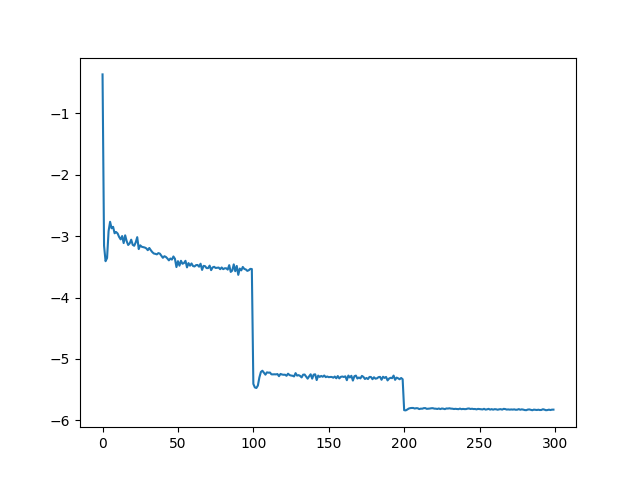

In [1583]:
plt.figure()
plt.plot(np.log(loss_x0_lin.history["loss"])/np.log(10))
plt.show()

In [1497]:
isolate = 1
X = np.array([all_X[i] for i in range(isolate)]+[all_X[i] for i in range(isolate+1,10)]).T
Y = all_X[isolate].T

In [1498]:
get_all_NN(all_X)


Epoch 1/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - loss: 0.0390
Epoch 2/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.1673e-04
Epoch 3/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 5.6388e-04
Epoch 4/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 2.9796e-04
Epoch 5/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.1945e-04
Epoch 6/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 9.3411e-05
Epoch 7/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.9633e-05
Epoch 8/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.4672e-05
Epoch 9/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 7.4831e-05
Epoch 10/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 6.2470e-05
Epoch 11/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.2293e-05
Epoch 12/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 6.5067e-05
Epoch 13/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 6.7297e-05
Epoch 14/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/s

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0120
Epoch 5/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0096
Epoch 6/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0062
Epoch 7/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0039
Epoch 8/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0031
Epoch 9/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0029
Epoch 10/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0021
Epoch 11/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0022
Epoch 12/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0022
Epoch 13/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0017
Epoch 14/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0023
Epoch 15/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0015
Epoch 16/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0016
Epoch 17/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0015
Epoch 18/50
1000/1000 ━━━━━━━━━━━━━━━

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.0767e-06 - learning_rate: 3.9062e-05
Epoch 85/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.0832e-06 - learning_rate: 3.9062e-05
Epoch 86/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.0286e-06 - learning_rate: 3.9062e-05
Epoch 87/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.0335e-06 - learning_rate: 3.9062e-05
Epoch 88/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.0763e-06 - learning_rate: 3.9062e-05
Epoch 89/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.0482e-06 - learning_rate: 3.9062e-05
Epoch 90/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.0943e-06 - learning_rate: 3.9062e-05
Epoch 91/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.0265e-06 - learning_rate: 3.9062e-05
Epoch 92/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.0391e-06 - learning_rate: 3.9062e-05
Epoch 93/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.0246e-06 - learning_

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 2.0210e-04
Epoch 7/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.7667e-04
Epoch 8/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.5570e-04
Epoch 9/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.3255e-04
Epoch 10/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.3700e-04
Epoch 11/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.6663e-04
Epoch 12/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.2500e-04
Epoch 13/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.3225e-04
Epoch 14/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.2340e-04
Epoch 15/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.1389e-04
Epoch 16/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.0889e-04
Epoch 17/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.1303e-04
Epoch 18/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.1918e-04
Epoch 19/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/ste

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0199
Epoch 10/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0175
Epoch 11/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 0.0163
Epoch 12/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0133
Epoch 13/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0094
Epoch 14/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 0.0168
Epoch 15/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0111
Epoch 16/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0111
Epoch 17/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0062
Epoch 18/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0070
Epoch 19/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0069
Epoch 20/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0058
Epoch 21/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0056
Epoch 22/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0082
Epoch 23/50
1000/1000 ━━━━━━━━━━

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 5.3603e-06 - learning_rate: 3.9062e-05
Epoch 90/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 5.1684e-06 - learning_rate: 3.9062e-05
Epoch 91/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 5.1430e-06 - learning_rate: 3.9062e-05
Epoch 92/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 5.0917e-06 - learning_rate: 3.9062e-05
Epoch 93/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 4.9201e-06 - learning_rate: 1.9531e-05
Epoch 94/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 4.9945e-06 - learning_rate: 1.9531e-05
Epoch 95/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 5.1024e-06 - learning_rate: 1.9531e-05
Epoch 96/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 4.9226e-06 - learning_rate: 1.9531e-05
Epoch 97/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 5.2244e-06 - learning_rate: 1.9531e-05
Epoch 98/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 4.9893e-06 - learning_

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 6.7372e-05
Epoch 13/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.1792e-05
Epoch 14/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 5.2341e-05
Epoch 15/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 5.3338e-05
Epoch 16/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 4.4203e-05
Epoch 17/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 4.5907e-05
Epoch 18/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 4.1134e-05
Epoch 19/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 4.0894e-05
Epoch 20/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 4.0997e-05
Epoch 21/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 3.8698e-05
Epoch 22/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 3.1639e-05
Epoch 23/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 3.8106e-05
Epoch 24/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.3228e-05
Epoch 25/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.1721e-04 - learning_rate: 0.0100
Epoch 12/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 1.8256e-04 - learning_rate: 0.0100
Epoch 13/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 1.5075e-05 - learning_rate: 0.0050
Epoch 14/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.6356e-05 - learning_rate: 0.0050
Epoch 15/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 5.3243e-05 - learning_rate: 0.0050
Epoch 16/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.8893e-05 - learning_rate: 0.0050
Epoch 17/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 5.6111e-05 - learning_rate: 0.0050
Epoch 18/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 4.1732e-05 - learning_rate: 0.0050
Epoch 19/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.9905e-05 - learning_rate: 0.0050
Epoch 20/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 6.1478e-05 - learning_rate: 0.0050
Epoch 21/100
1000/1000 

Epoch 72/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 8.7808e-07 - learning_rate: 1.5625e-04
Epoch 73/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 7.8829e-07 - learning_rate: 7.8125e-05
Epoch 74/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 8.2658e-07 - learning_rate: 7.8125e-05
Epoch 75/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 8.1846e-07 - learning_rate: 7.8125e-05
Epoch 76/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 7.8617e-07 - learning_rate: 7.8125e-05
Epoch 77/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 7.9536e-07 - learning_rate: 7.8125e-05
Epoch 78/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 8.1882e-07 - learning_rate: 7.8125e-05
Epoch 79/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 7.8892e-07 - learning_rate: 7.8125e-05
Epoch 80/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 7.9193e-07 - learning_rate: 7.8125e-05
Epoch 81/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 7.8818e-0

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.8088e-07 - learning_rate: 3.9062e-05
Epoch 93/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.4077e-07 - learning_rate: 3.9062e-05
Epoch 94/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.6612e-07 - learning_rate: 3.9062e-05
Epoch 95/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.2094e-07 - learning_rate: 1.9531e-05
Epoch 96/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.4019e-07 - learning_rate: 1.9531e-05
Epoch 97/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.8018e-07 - learning_rate: 1.9531e-05
Epoch 98/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.2005e-07 - learning_rate: 1.9531e-05
Epoch 99/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.6046e-07 - learning_rate: 1.9531e-05
Epoch 100/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.0568e-07 - learning_rate: 1.9531e-05
Epoch 1/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0438
Epoch 2/50
1000/

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 5.1085e-05
Epoch 42/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 5.2670e-05
Epoch 43/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 6.8099e-05
Epoch 44/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.4995e-04
Epoch 45/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 5.2804e-05
Epoch 46/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 3.1983e-05
Epoch 47/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 6.0403e-05
Epoch 48/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 4.6655e-05
Epoch 49/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 4.5178e-05
Epoch 50/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 5.1514e-05
Epoch 1/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.1980
Epoch 2/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.1433
Epoch 3/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0392
Epoch 4/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.1299e-05 - learning_rate: 0.0050
Epoch 15/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 5.1379e-05 - learning_rate: 0.0050
Epoch 16/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 5.1345e-05 - learning_rate: 0.0050
Epoch 17/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 5.2659e-05 - learning_rate: 0.0050
Epoch 18/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.7347e-05 - learning_rate: 0.0050
Epoch 19/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 4.9891e-05 - learning_rate: 0.0050
Epoch 20/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.7026e-05 - learning_rate: 0.0050
Epoch 21/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 4.8789e-05 - learning_rate: 0.0050
Epoch 22/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.9139e-05 - learning_rate: 0.0050
Epoch 23/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.5645e-06 - learning_rate: 0.0025
Epoch 24/100
1000/1000 

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.8277e-05
Epoch 43/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.4203e-05
Epoch 44/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.4400e-05
Epoch 45/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.3158e-05
Epoch 46/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.3140e-05
Epoch 47/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.2031e-05
Epoch 48/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 9.7329e-06
Epoch 49/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.2593e-05
Epoch 50/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.0818e-05
Epoch 1/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 0.0027
Epoch 2/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 6.3847e-05
Epoch 3/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.8965e-05
Epoch 4/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 1.1094e-04
Epoch 5/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - lo

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 7.2752e-06
Epoch 45/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 8.0854e-06
Epoch 46/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 5.5482e-06
Epoch 47/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 4.8645e-06
Epoch 48/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 5.5883e-06
Epoch 49/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 6.3489e-06
Epoch 50/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 7.0266e-06
For x4, the orders to analyse are [4, 3].
For x4, analysing 4.
Epoch 1/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - loss: 0.6898 - learning_rate: 0.0100
Epoch 2/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 6.6339e-07 - learning_rate: 0.0100
Epoch 3/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.0782e-07 - learning_rate: 0.0100
Epoch 4/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 2.3617e-07 - learning_rate: 0.0100
Epoch 5/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.9715e-05 - learning_rate: 0.0050
Epoch 17/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.2894e-05 - learning_rate: 0.0050
Epoch 18/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.2049e-05 - learning_rate: 0.0050
Epoch 19/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.7418e-05 - learning_rate: 0.0050
Epoch 20/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.0500e-05 - learning_rate: 0.0050
Epoch 21/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.1047e-05 - learning_rate: 0.0050
Epoch 22/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.7276e-05 - learning_rate: 0.0050
Epoch 23/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.8704e-06 - learning_rate: 0.0025
Epoch 24/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.1463e-06 - learning_rate: 0.0025
Epoch 25/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.3079e-06 - learning_rate: 0.0025
Epoch 26/100
1000/1000 

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.8383e-05
Epoch 46/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 2.2064e-05
Epoch 47/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 2.6967e-05
Epoch 48/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 2.4095e-05
Epoch 49/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 2.0842e-05
Epoch 50/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 2.3941e-05
Epoch 1/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - loss: 0.3596
Epoch 2/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0663
Epoch 3/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0099
Epoch 4/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0037
Epoch 5/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 0.0015
Epoch 6/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 8.3147e-04
Epoch 7/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 5.6538e-04
Epoch 8/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 3.1671e-04
Epoc

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0027
Epoch 49/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 0.0049
Epoch 50/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 0.0016
For x5, the orders to analyse are [0].
For x5, analysing 0.
Epoch 1/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - loss: 0.7386 - learning_rate: 0.0100
Epoch 2/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 4.9405e-04 - learning_rate: 0.0100
Epoch 3/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.5283e-04 - learning_rate: 0.0100
Epoch 4/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.2839e-04 - learning_rate: 0.0100
Epoch 5/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 3.9073e-04 - learning_rate: 0.0100
Epoch 6/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 4.4667e-04 - learning_rate: 0.0100
Epoch 7/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.6584e-04 - learning_rate: 0.0100
Epoch 8/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - los

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.6347e-05
Epoch 24/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 4.0333e-05
Epoch 25/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.7893e-05
Epoch 26/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.6641e-05
Epoch 27/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.8636e-05
Epoch 28/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.8885e-05
Epoch 29/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.6727e-05
Epoch 30/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.6513e-05
Epoch 31/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.7794e-05
Epoch 32/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.7524e-05
Epoch 33/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.6411e-05
Epoch 34/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.5755e-05
Epoch 35/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.0552e-05
Epoch 36/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 5.1791e-04
Epoch 26/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 5.2504e-04
Epoch 27/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.9372e-04
Epoch 28/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 4.2070e-04
Epoch 29/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 4.1768e-04
Epoch 30/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 4.7855e-04
Epoch 31/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.1210e-04
Epoch 32/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.6587e-04
Epoch 33/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.8314e-04
Epoch 34/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.8757e-04
Epoch 35/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.6061e-04
Epoch 36/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.6436e-04
Epoch 37/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.2444e-04
Epoch 38/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/

Epoch 1/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 0.0262
Epoch 2/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 9.6506e-05
Epoch 3/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.0323e-04
Epoch 4/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.0563e-04
Epoch 5/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 9.5093e-05
Epoch 6/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.7499e-05
Epoch 7/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 7.5488e-05
Epoch 8/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 7.7494e-05
Epoch 9/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 7.0185e-05
Epoch 10/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 6.2504e-05
Epoch 11/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 5.9339e-05
Epoch 12/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 5.7144e-05
Epoch 13/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 5.4958e-05
Epoch 14/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/s

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0120
Epoch 4/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0044
Epoch 5/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0026
Epoch 6/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0027
Epoch 7/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0022
Epoch 8/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0031
Epoch 9/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0020
Epoch 10/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0022
Epoch 11/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 8.2571e-04
Epoch 12/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.3638e-04
Epoch 13/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 6.4204e-04
Epoch 14/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 5.3055e-04
Epoch 15/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 7.6444e-04
Epoch 16/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 5.0306e-04
Epoch 17/50
10

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.3689e-06 - learning_rate: 3.9062e-05
Epoch 84/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.3967e-06 - learning_rate: 3.9062e-05
Epoch 85/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.3947e-06 - learning_rate: 3.9062e-05
Epoch 86/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.3527e-06 - learning_rate: 3.9062e-05
Epoch 87/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.3633e-06 - learning_rate: 3.9062e-05
Epoch 88/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.3771e-06 - learning_rate: 3.9062e-05
Epoch 89/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.3330e-06 - learning_rate: 3.9062e-05
Epoch 90/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.4037e-06 - learning_rate: 3.9062e-05
Epoch 91/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.3592e-06 - learning_rate: 3.9062e-05
Epoch 92/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.3802e-06 - learning_

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.2862e-04
Epoch 5/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 1.1380e-04
Epoch 6/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.0837e-04
Epoch 7/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 9.4729e-05
Epoch 8/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.0463e-04
Epoch 9/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 8.1527e-05
Epoch 10/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 9.6902e-05
Epoch 11/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 8.9223e-05
Epoch 12/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 9.1196e-05
Epoch 13/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 8.3067e-05
Epoch 14/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 8.8513e-05
Epoch 15/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 6.9530e-05
Epoch 16/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 7.6679e-05
Epoch 17/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step 

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0642
Epoch 7/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0330
Epoch 8/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0177
Epoch 9/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0506
Epoch 10/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0243
Epoch 11/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 0.0183
Epoch 12/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0212
Epoch 13/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0202
Epoch 14/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0045
Epoch 15/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0093
Epoch 16/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0096
Epoch 17/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0056
Epoch 18/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0089
Epoch 19/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0063
Epoch 20/50
1000/1000 ━━━━━━━━━━━━━

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.1899e-06 - learning_rate: 3.9062e-05
Epoch 88/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.2631e-06 - learning_rate: 3.9062e-05
Epoch 89/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.2376e-06 - learning_rate: 3.9062e-05
Epoch 90/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.2498e-06 - learning_rate: 3.9062e-05
Epoch 91/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.2262e-06 - learning_rate: 3.9062e-05
Epoch 92/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.2063e-06 - learning_rate: 3.9062e-05
Epoch 93/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.1577e-06 - learning_rate: 1.9531e-05
Epoch 94/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.1573e-06 - learning_rate: 1.9531e-05
Epoch 95/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 3.1182e-06 - learning_rate: 1.9531e-05
Epoch 96/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.1594e-06 - learning_

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 9.5520e-04
Epoch 37/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 7.6985e-04
Epoch 38/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 6.4943e-04
Epoch 39/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0011
Epoch 40/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 9.2110e-04
Epoch 41/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 9.5992e-04
Epoch 42/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 7.7945e-04
Epoch 43/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0013
Epoch 44/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 8.9194e-04
Epoch 45/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0012
Epoch 46/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 6.7652e-04
Epoch 47/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0016
Epoch 48/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 9.7752e-04
Epoch 49/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 9.3

Epoch 72/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.9709e-06 - learning_rate: 1.5625e-04
Epoch 73/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.6898e-06 - learning_rate: 7.8125e-05
Epoch 74/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.7120e-06 - learning_rate: 7.8125e-05
Epoch 75/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.6885e-06 - learning_rate: 7.8125e-05
Epoch 76/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.7574e-06 - learning_rate: 7.8125e-05
Epoch 77/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.7048e-06 - learning_rate: 7.8125e-05
Epoch 78/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.6291e-06 - learning_rate: 7.8125e-05
Epoch 79/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.7200e-06 - learning_rate: 7.8125e-05
Epoch 80/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.6594e-06 - learning_rate: 7.8125e-05
Epoch 81/100
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.6579e-0

In [ ]:
####

In [1500]:
X = np.array([all_X[i] for i in range(4)]+[all_X[i] for i in range(4+1,10)]).T
Y = all_X[4].T

In [1502]:
best_losses = find_order(X, Y, max_order = 4 ,n_epochs = 50)

Epoch 1/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - loss: 0.0131
Epoch 2/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 4.3912e-05
Epoch 3/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.8563e-05
Epoch 4/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 4.6534e-05
Epoch 5/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.9255e-05
Epoch 6/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 6.4963e-05
Epoch 7/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 6.0195e-05
Epoch 8/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 5.4544e-05
Epoch 9/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 6.4780e-05
Epoch 10/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 5.2810e-05
Epoch 11/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 5.4717e-05
Epoch 12/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 5.1811e-05
Epoch 13/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 4.4370e-05
Epoch 14/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/s

1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.7535e-05
Epoch 28/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.4071e-05
Epoch 29/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.5022e-05
Epoch 30/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.5481e-05
Epoch 31/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.5620e-05
Epoch 32/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.6358e-05
Epoch 33/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.2482e-05
Epoch 34/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.2482e-05
Epoch 35/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.2225e-05
Epoch 36/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.1445e-05
Epoch 37/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.0034e-05
Epoch 38/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 9.8124e-06
Epoch 39/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 1.1453e-05
Epoch 40/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/

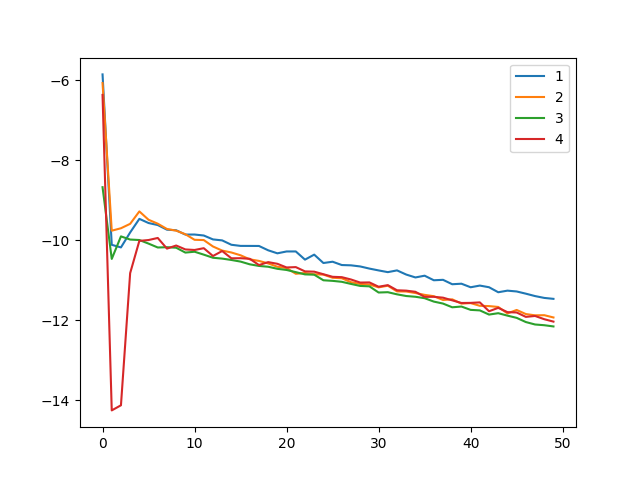

In [1503]:
plt.figure()
for i in best_losses:
    plt.plot(np.log(i[1]),label=i[0])
plt.legend()
plt.show()

In [1470]:
select_order(best_losses, tol = 10**(-2))


[0, 1]

In [1539]:
model_x1_squared,loss_x1_squared = learn_one_x_from_the_others(X, Y, order=2, n_epochs = 100)


Epoch 1/100


ValueError: Exception encountered when calling Sequential.call().

[1mInvalid input shape for input Tensor("data:0", shape=(100,), dtype=float32). Expected shape (None, 9), but input has incompatible shape (100,)[0m

Arguments received by Sequential.call():
  • inputs=tf.Tensor(shape=(100,), dtype=float32)
  • training=True
  • mask=None

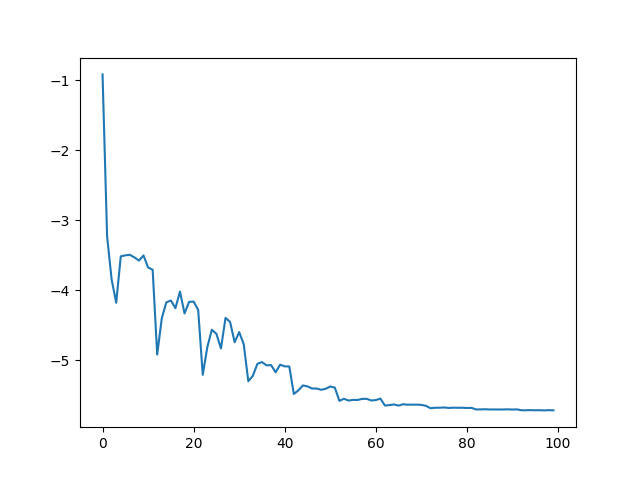

In [1450]:
plt.figure()
plt.plot(np.log(loss_x1_squared.history["loss"])/np.log(10))
plt.show()

In [1584]:
save_nn(model_x0_lin,"10d_x1_lin")


In [1]:
####################################################################################################################
##################################### 3 d potential with weird structures ##########################################
####################################################################################################################

In [9]:
x3d = np.load('V3param_points.npy')

In [10]:
set_train_3d, set_test_3d = train_test_split(x3d, test_size=0.1, random_state=1)


In [12]:
history_all_3d = []

start = time.time()

for i in range(3):
    
    this_latent_dim = i + 1
    input_dim = 3
    
    print(this_latent_dim)

    inputs = layers.Input(shape=(input_dim,))
    encoded = layers.Dense(128, activation='sigmoid')(inputs)
    encoded = layers.Dense(128, activation='sigmoid')(encoded)
    encoded = layers.Dense(this_latent_dim)(encoded)  

    decoded = layers.Dense(128, activation='sigmoid')(encoded)
    decoded = layers.Dense(128, activation='sigmoid')(decoded)
    decoded = layers.Dense(input_dim)(decoded)  

    this_autoencoder = keras.Model(inputs, decoded)
    this_autoencoder.compile(optimizer='adam', loss='mse')
    
    history_all_3d.append(this_autoencoder.fit(set_train_3d, set_train_3d, epochs=1000, batch_size=100, shuffle=True, validation_data=(set_test_3d,set_test_3d)))

end = time.time()

1
Epoch 1/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 1.4101 - val_loss: 0.2259
Epoch 2/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1876 - val_loss: 0.1641
Epoch 3/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1543 - val_loss: 0.1455
Epoch 4/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1362 - val_loss: 0.1442
Epoch 5/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1340 - val_loss: 0.1345
Epoch 6/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1313 - val_loss: 0.1326
Epoch 7/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1204 - val_loss: 0.1291
Epoch 8/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1260 - val_loss: 0.1322
Epoch 9/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1226 - val_loss: 0.1279
Epoch 10/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1205 - val_loss: 0.1268
Epoch 11/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1228 - val_loss: 0.1256
Epoch 12/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/st

90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.1145 - val_loss: 0.1216
Epoch 136/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.1128 - val_loss: 0.1216
Epoch 137/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.1121 - val_loss: 0.1217
Epoch 138/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.1164 - val_loss: 0.1221
Epoch 139/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1131 - val_loss: 0.1236
Epoch 140/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.1166 - val_loss: 0.1219
Epoch 141/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.1132 - val_loss: 0.1223
Epoch 142/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.1112 - val_loss: 0.1219
Epoch 143/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1150 - val_loss: 0.1225
Epoch 144/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.1161 - val_loss: 0.1218
Epoch 145/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.1167 - val_loss: 0.1223
Epoch 146/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4m

90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1170 - val_loss: 0.1226
Epoch 270/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.1144 - val_loss: 0.1221
Epoch 271/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1133 - val_loss: 0.1222
Epoch 272/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 0.1162 - val_loss: 0.1226
Epoch 273/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 0.1173 - val_loss: 0.1223
Epoch 274/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 0.1122 - val_loss: 0.1217
Epoch 275/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.1145 - val_loss: 0.1222
Epoch 276/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1187 - val_loss: 0.1225
Epoch 277/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1183 - val_loss: 0.1219
Epoch 278/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.1103 - val_loss: 0.1219
Epoch 279/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1156 - val_loss: 0.1224
Epoch 280/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3m

90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 0.1166 - val_loss: 0.1219
Epoch 404/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.1115 - val_loss: 0.1220
Epoch 405/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.1094 - val_loss: 0.1220
Epoch 406/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.1099 - val_loss: 0.1225
Epoch 407/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.1138 - val_loss: 0.1222
Epoch 408/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.1148 - val_loss: 0.1218
Epoch 409/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1133 - val_loss: 0.1221
Epoch 410/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1144 - val_loss: 0.1223
Epoch 411/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.1148 - val_loss: 0.1222
Epoch 412/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1151 - val_loss: 0.1222
Epoch 413/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.1148 - val_loss: 0.1218
Epoch 414/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4m

90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1139 - val_loss: 0.1226
Epoch 538/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1166 - val_loss: 0.1220
Epoch 539/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.1127 - val_loss: 0.1226
Epoch 540/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1145 - val_loss: 0.1219
Epoch 541/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1145 - val_loss: 0.1221
Epoch 542/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1109 - val_loss: 0.1223
Epoch 543/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1149 - val_loss: 0.1224
Epoch 544/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1132 - val_loss: 0.1224
Epoch 545/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1144 - val_loss: 0.1223
Epoch 546/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.1183 - val_loss: 0.1221
Epoch 547/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.1142 - val_loss: 0.1224
Epoch 548/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2m

90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0680 - val_loss: 0.0722
Epoch 672/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0697 - val_loss: 0.0733
Epoch 673/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0682 - val_loss: 0.0708
Epoch 674/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0687 - val_loss: 0.0719
Epoch 675/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0677 - val_loss: 0.0727
Epoch 676/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0671 - val_loss: 0.0711
Epoch 677/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0679 - val_loss: 0.0693
Epoch 678/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0671 - val_loss: 0.0718
Epoch 679/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0633 - val_loss: 0.0711
Epoch 680/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0662 - val_loss: 0.0678
Epoch 681/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0688 - val_loss: 0.0704
Epoch 682/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3m

90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0552 - val_loss: 0.0584
Epoch 806/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0534 - val_loss: 0.0550
Epoch 807/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0551 - val_loss: 0.0538
Epoch 808/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0538 - val_loss: 0.0626
Epoch 809/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0539 - val_loss: 0.0522
Epoch 810/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0528 - val_loss: 0.0527
Epoch 811/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0555 - val_loss: 0.0535
Epoch 812/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0529 - val_loss: 0.0570
Epoch 813/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0527 - val_loss: 0.0568
Epoch 814/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0524 - val_loss: 0.0531
Epoch 815/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0524 - val_loss: 0.0532
Epoch 816/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2m

90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0471 - val_loss: 0.0494
Epoch 940/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0466 - val_loss: 0.0540
Epoch 941/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0455 - val_loss: 0.0522
Epoch 942/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0462 - val_loss: 0.0471
Epoch 943/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0455 - val_loss: 0.0525
Epoch 944/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0458 - val_loss: 0.0500
Epoch 945/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0483 - val_loss: 0.0482
Epoch 946/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0466 - val_loss: 0.0509
Epoch 947/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0471 - val_loss: 0.0503
Epoch 948/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0444 - val_loss: 0.0518
Epoch 949/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0474 - val_loss: 0.0482
Epoch 950/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2m

90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0011 - val_loss: 8.9318e-04
Epoch 74/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0014
Epoch 75/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 8.9490e-04
Epoch 76/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 0.0013 - val_loss: 0.0024
Epoch 77/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 0.0017 - val_loss: 0.0010
Epoch 78/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0012 - val_loss: 0.0011
Epoch 79/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 0.0011 - val_loss: 0.0018
Epoch 80/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 0.0013 - val_loss: 9.8008e-04
Epoch 81/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 0.0011 - val_loss: 0.0010
Epoch 82/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0016 - val_loss: 0.0012
Epoch 83/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 8.4276e-04
Epoch 84/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 

Epoch 138/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1293e-04 - val_loss: 3.3605e-04
Epoch 139/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2066e-04 - val_loss: 0.0015
Epoch 140/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7174e-04 - val_loss: 1.5346e-04
Epoch 141/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0115e-04 - val_loss: 1.2210e-04
Epoch 142/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.7324e-04 - val_loss: 3.1707e-04
Epoch 143/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.2665e-04 - val_loss: 2.1378e-04
Epoch 144/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9515e-04 - val_loss: 2.0415e-04
Epoch 145/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8016e-04 - val_loss: 8.5392e-04
Epoch 146/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.6712e-04 - val_loss: 1.2370e-04
Epoch 147/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 4.2040e-04 - val_loss: 3.6579e-04
Epoch 148/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s

90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9632e-04 - val_loss: 7.6627e-05
Epoch 202/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.1704e-04 - val_loss: 1.8272e-04
Epoch 203/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.1394e-04 - val_loss: 1.7146e-04
Epoch 204/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 2.4604e-04 - val_loss: 2.7695e-04
Epoch 205/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.4500e-04 - val_loss: 6.5939e-05
Epoch 206/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4804e-04 - val_loss: 1.4265e-04
Epoch 207/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7062e-04 - val_loss: 1.1702e-04
Epoch 208/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.2243e-04 - val_loss: 2.2880e-04
Epoch 209/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.0290e-04 - val_loss: 2.1863e-04
Epoch 210/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.0121e-04 - val_loss: 8.7451e-04
Epoch 211/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step -

90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.8240e-05 - val_loss: 1.4088e-04
Epoch 328/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.3221e-05 - val_loss: 1.9188e-04
Epoch 329/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8150e-04 - val_loss: 3.4549e-05
Epoch 330/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.9665e-05 - val_loss: 5.0433e-05
Epoch 331/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.8229e-05 - val_loss: 1.4711e-04
Epoch 332/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.1827e-05 - val_loss: 8.2289e-05
Epoch 333/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4394e-04 - val_loss: 1.2511e-04
Epoch 334/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.8634e-05 - val_loss: 4.3976e-05
Epoch 335/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.8707e-05 - val_loss: 1.4444e-05
Epoch 336/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7336e-04 - val_loss: 1.2450e-04
Epoch 337/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step -

90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.4236e-05 - val_loss: 2.7188e-04
Epoch 454/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 2.0927e-04 - val_loss: 2.5430e-05
Epoch 455/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.7501e-05 - val_loss: 2.4608e-05
Epoch 456/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 4.8400e-05 - val_loss: 2.3585e-05
Epoch 457/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.3256e-05 - val_loss: 7.3757e-05
Epoch 458/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.9695e-05 - val_loss: 2.7667e-05
Epoch 459/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.8513e-05 - val_loss: 4.0266e-05
Epoch 460/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 5.4786e-05 - val_loss: 6.1712e-05
Epoch 461/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.2591e-04 - val_loss: 1.0121e-04
Epoch 462/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.5217e-05 - val_loss: 5.4467e-05
Epoch 463/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step -

90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.8041e-05 - val_loss: 2.8178e-05
Epoch 580/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.8137e-05 - val_loss: 1.2077e-04
Epoch 581/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.7701e-05 - val_loss: 3.0784e-05
Epoch 582/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.1634e-05 - val_loss: 2.2209e-05
Epoch 583/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.7093e-05 - val_loss: 1.1179e-05
Epoch 584/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.9927e-05 - val_loss: 1.1284e-05
Epoch 585/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.0765e-04 - val_loss: 3.6812e-04
Epoch 586/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.6682e-05 - val_loss: 2.3727e-05
Epoch 587/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5810e-05 - val_loss: 1.4726e-05
Epoch 588/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7851e-05 - val_loss: 1.5491e-05
Epoch 589/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step -

90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.4614e-05 - val_loss: 1.6553e-05
Epoch 706/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1621e-05 - val_loss: 3.5263e-06
Epoch 707/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.5539e-05 - val_loss: 3.9630e-05
Epoch 708/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.0392e-05 - val_loss: 8.4261e-06
Epoch 709/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 2.3414e-05 - val_loss: 8.3795e-06
Epoch 710/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6075e-05 - val_loss: 2.6039e-05
Epoch 711/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4411e-04 - val_loss: 5.1972e-05
Epoch 712/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.7367e-05 - val_loss: 5.7088e-05
Epoch 713/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.3470e-05 - val_loss: 1.0690e-05
Epoch 714/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.0276e-05 - val_loss: 9.8110e-06
Epoch 715/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step -

90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5919e-05 - val_loss: 2.1841e-05
Epoch 832/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.1518e-05 - val_loss: 4.9651e-06
Epoch 833/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.7127e-06 - val_loss: 8.4531e-06
Epoch 834/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.1599e-05 - val_loss: 2.5325e-05
Epoch 835/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.2765e-05 - val_loss: 2.1686e-04
Epoch 836/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0101e-04 - val_loss: 8.6583e-06
Epoch 837/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1029e-05 - val_loss: 1.5828e-05
Epoch 838/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8383e-05 - val_loss: 1.0753e-05
Epoch 839/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3534e-05 - val_loss: 1.7999e-05
Epoch 840/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6507e-05 - val_loss: 2.7413e-05
Epoch 841/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1625e-05 - val_loss: 1.6470e-05
Epoch 958/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.3982e-05 - val_loss: 1.7501e-05
Epoch 959/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.8485e-05 - val_loss: 1.0410e-05
Epoch 960/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.6936e-05 - val_loss: 2.0007e-04
Epoch 961/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4436e-04 - val_loss: 1.8354e-06
Epoch 962/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.2889e-06 - val_loss: 7.2931e-06
Epoch 963/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.1082e-05 - val_loss: 5.1419e-05
Epoch 964/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.0897e-05 - val_loss: 1.1219e-05
Epoch 965/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.0136e-05 - val_loss: 7.1844e-06
Epoch 966/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.3022e-06 - val_loss: 6.4211e-06
Epoch 967/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step -

90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.2057e-04 - val_loss: 0.0013
Epoch 86/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.1464e-04 - val_loss: 0.0010
Epoch 87/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.0968e-04 - val_loss: 0.0011
Epoch 88/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.7104e-04 - val_loss: 0.0022
Epoch 89/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.7828e-04 - val_loss: 2.6496e-04
Epoch 90/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.1558e-04 - val_loss: 1.2568e-04
Epoch 91/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.8898e-04 - val_loss: 3.0796e-04
Epoch 92/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.0412e-04 - val_loss: 2.0736e-04
Epoch 93/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.9746e-04 - val_loss: 1.2489e-04
Epoch 94/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.4660e-04 - val_loss: 5.8468e-04
Epoch 95/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.4539e-04 - val_lo

90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5984e-04 - val_loss: 4.3667e-04
Epoch 212/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.8913e-04 - val_loss: 1.0049e-04
Epoch 213/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4106e-04 - val_loss: 5.4208e-05
Epoch 214/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5374e-04 - val_loss: 9.0057e-05
Epoch 215/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6950e-04 - val_loss: 6.2034e-05
Epoch 216/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.3711e-04 - val_loss: 5.1489e-05
Epoch 217/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.2019e-05 - val_loss: 5.6674e-04
Epoch 218/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 2.3878e-04 - val_loss: 3.7696e-05
Epoch 219/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.3508e-04 - val_loss: 4.8758e-04
Epoch 220/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.3835e-04 - val_loss: 1.2947e-04
Epoch 221/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step -

90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.3382e-05 - val_loss: 4.3263e-05
Epoch 338/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.6782e-05 - val_loss: 5.1866e-05
Epoch 339/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.0054e-04 - val_loss: 5.1477e-04
Epoch 340/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1093e-04 - val_loss: 7.7526e-05
Epoch 341/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.2521e-05 - val_loss: 1.0250e-04
Epoch 342/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.0904e-04 - val_loss: 8.7937e-05
Epoch 343/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.0978e-05 - val_loss: 1.5542e-04
Epoch 344/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.4512e-05 - val_loss: 1.0567e-04
Epoch 345/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.8466e-05 - val_loss: 7.6210e-05
Epoch 346/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.3235e-05 - val_loss: 6.7618e-05
Epoch 347/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step -

90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.0073e-05 - val_loss: 1.5518e-05
Epoch 464/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6695e-05 - val_loss: 6.0604e-05
Epoch 465/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 1.0435e-04 - val_loss: 4.3593e-05
Epoch 466/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.3884e-05 - val_loss: 1.2087e-05
Epoch 467/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.5453e-05 - val_loss: 4.7198e-05
Epoch 468/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.0219e-04 - val_loss: 2.6679e-05
Epoch 469/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.1506e-05 - val_loss: 7.1093e-06
Epoch 470/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.0903e-05 - val_loss: 1.0281e-05
Epoch 471/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.8712e-05 - val_loss: 6.8219e-05
Epoch 472/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.3382e-05 - val_loss: 1.2848e-05
Epoch 473/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step -

90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1115e-05 - val_loss: 3.1074e-05
Epoch 590/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 3.8587e-05 - val_loss: 3.6013e-06
Epoch 591/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1980e-05 - val_loss: 2.1610e-05
Epoch 592/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.5545e-05 - val_loss: 4.2517e-05
Epoch 593/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.0394e-05 - val_loss: 1.9666e-05
Epoch 594/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.0111e-04 - val_loss: 3.9305e-05
Epoch 595/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1857e-05 - val_loss: 3.5385e-05
Epoch 596/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.2812e-04 - val_loss: 9.9224e-06
Epoch 597/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.1638e-05 - val_loss: 3.7866e-05
Epoch 598/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.9431e-05 - val_loss: 3.2753e-05
Epoch 599/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step -

90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.2637e-05 - val_loss: 5.5168e-05
Epoch 716/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.3671e-05 - val_loss: 1.1330e-05
Epoch 717/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.8604e-05 - val_loss: 1.3979e-05
Epoch 718/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 2.2745e-05 - val_loss: 4.4326e-05
Epoch 719/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.4088e-05 - val_loss: 3.5818e-05
Epoch 720/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1227e-05 - val_loss: 2.5030e-05
Epoch 721/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.3437e-05 - val_loss: 1.0026e-05
Epoch 722/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.9161e-05 - val_loss: 8.9472e-06
Epoch 723/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.8682e-05 - val_loss: 5.2621e-05
Epoch 724/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.7284e-05 - val_loss: 6.0253e-06
Epoch 725/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step -

90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.7592e-05 - val_loss: 9.4866e-06
Epoch 842/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.0329e-05 - val_loss: 3.0806e-05
Epoch 843/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.1065e-05 - val_loss: 9.0382e-06
Epoch 844/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.3579e-05 - val_loss: 1.8575e-05
Epoch 845/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.7363e-06 - val_loss: 4.2733e-05
Epoch 846/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.4735e-05 - val_loss: 2.6801e-05
Epoch 847/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7286e-05 - val_loss: 1.7470e-05
Epoch 848/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.0853e-05 - val_loss: 7.8700e-05
Epoch 849/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.6145e-05 - val_loss: 2.6278e-05
Epoch 850/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.1132e-05 - val_loss: 2.9783e-04
Epoch 851/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step -

90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.9193e-05 - val_loss: 1.2073e-05
Epoch 968/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.0646e-05 - val_loss: 9.4740e-06
Epoch 969/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.0193e-05 - val_loss: 8.2101e-06
Epoch 970/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.1717e-05 - val_loss: 5.3940e-05
Epoch 971/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.6024e-05 - val_loss: 7.6820e-06
Epoch 972/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5932e-05 - val_loss: 3.2369e-05
Epoch 973/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.1640e-05 - val_loss: 1.3312e-05
Epoch 974/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.7778e-05 - val_loss: 6.0392e-05
Epoch 975/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.7638e-05 - val_loss: 5.3750e-05
Epoch 976/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1339e-05 - val_loss: 8.2325e-06
Epoch 977/1000
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step -

In [23]:
history_min = []
history_min_val = []
for this_history in history_all_3d: 
    this_min_val = np.min(this_history.history['val_loss'])
    this_min = np.min(this_history.history['loss'])
    history_min_val.append(this_min_val)
    history_min.append(this_min)

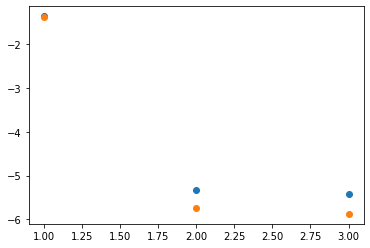

In [24]:
plt.figure()
plt.scatter(np.linspace(1,3,3),np.log(history_min)/np.log(10))
plt.scatter(np.linspace(1,3,3),np.log(history_min_val)/np.log(10))
#plt.ylim((-0.1,1))
plt.show()

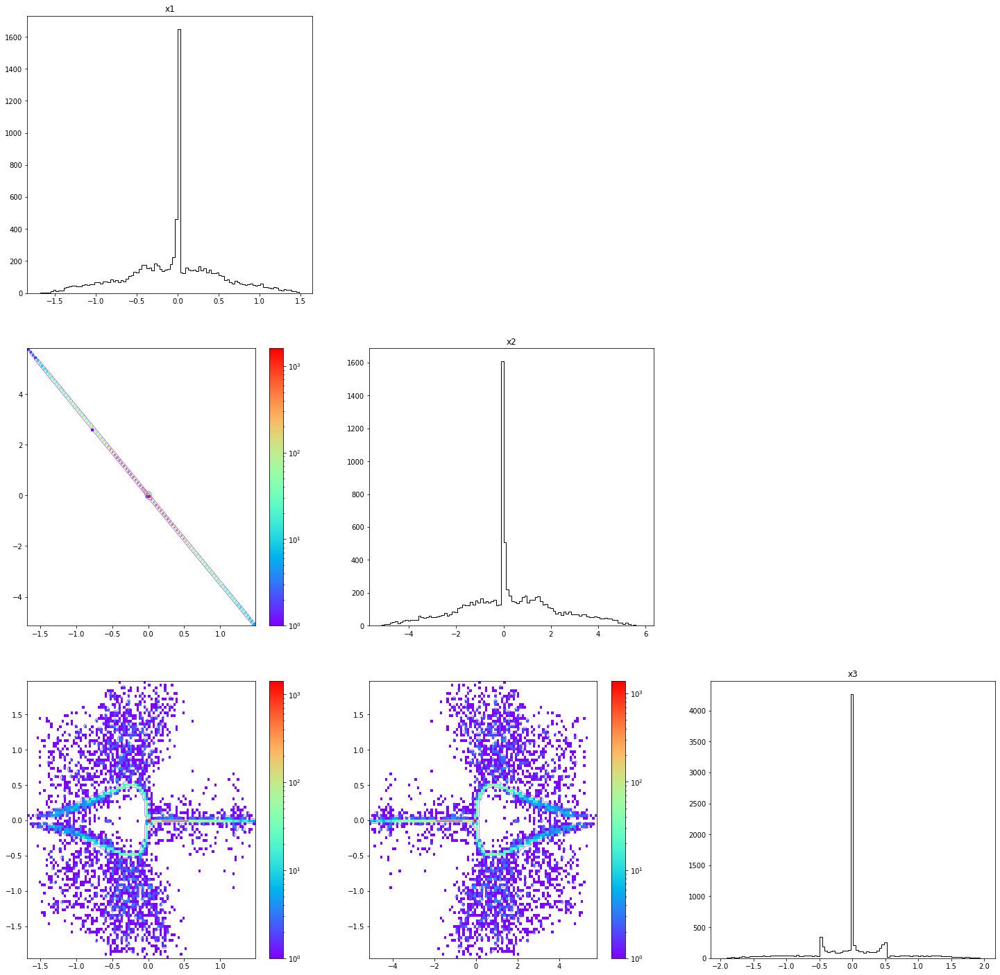

In [25]:
triangular_plot(x3d)

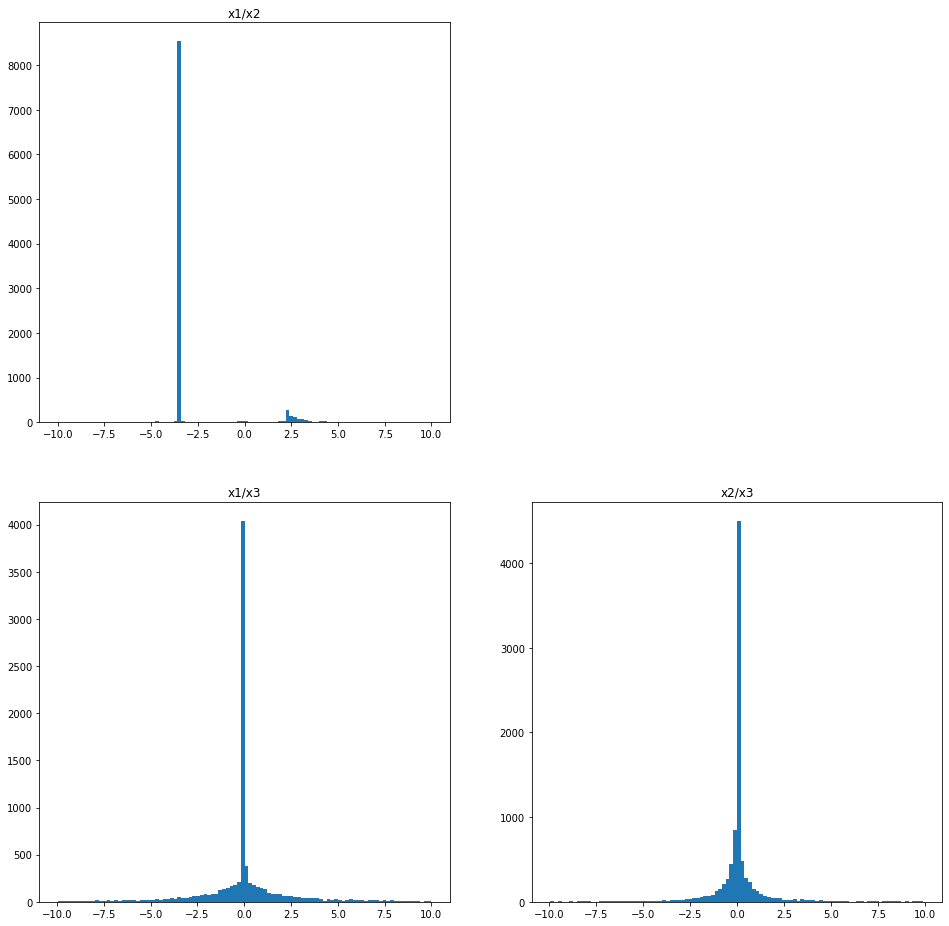

In [16]:
triangular_plot_slopes(x3d)

-0.28872573

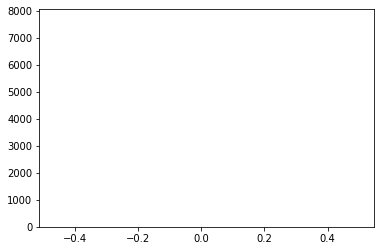

In [38]:
x1x0_slope0=x3d[:,0]/x3d[:,1]
x1x0_slope=np.extract(np.abs(x1x0_slope0)<0.5,x1x0_slope0)
histx1x0 = plt.hist(x1x0_slope,bins=10000)
histx1x0[1][np.argmax(histx1x0[0])]

In [39]:
-1/(2*3**.5)

-0.2886751345948129

In [40]:
# learn x0 in terms of x1 and x2

In [20]:
latent_dim = 2
input_dim = 3

inputs = layers.Input(shape=(input_dim,))
encoded = layers.Dense(128, activation='sigmoid')(inputs)
encoded = layers.Dense(128, activation='sigmoid')(encoded)
encoded = layers.Dense(latent_dim)(encoded)  

decoded = layers.Dense(128, activation='sigmoid')(encoded)
decoded = layers.Dense(128, activation='sigmoid')(decoded)
decoded = layers.Dense(input_dim)(decoded)  

autoencoder_3d = keras.Model(inputs, decoded)
autoencoder_3d.compile(optimizer='adam', loss='mse')

In [21]:
history_3d = autoencoder_3d.fit(set_train_3d, set_train_3d, epochs=100, batch_size=10, shuffle=True, validation_data=(set_test_3d,set_test_3d))


Epoch 1/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - loss: 0.6955 - val_loss: 0.1305
Epoch 2/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.1002 - val_loss: 0.0054
Epoch 3/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0043 - val_loss: 9.6256e-04
Epoch 4/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0012 - val_loss: 0.0011
Epoch 5/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0011 - val_loss: 6.7427e-04
Epoch 6/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 6.7654e-04 - val_loss: 3.7303e-04
Epoch 7/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 7.7741e-04 - val_loss: 2.3153e-04
Epoch 8/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0010 - val_loss: 4.3562e-04
Epoch 9/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 5.5174e-04 - val_loss: 9.9787e-05
Epoch 10/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 4.8435e-04 - val_loss: 4.0049e-04
Epoch 11/100
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 6.3326e-04 - val_loss: 

In [41]:
history_save_3d = history_3d.history["loss"]

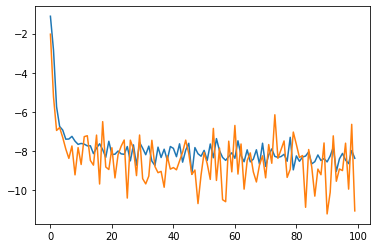

In [42]:
plt.figure()
plt.plot(np.log(history_3d.history["loss"]))
plt.plot(np.log(history_3d.history["val_loss"]))
plt.show()

In [43]:
encoder = models.Model(inputs, encoded)

latent_inputs = layers.Input(shape=(latent_dim,))  
decoded_layer = autoencoder_3d.layers[-3](latent_inputs)
decoded_layer = autoencoder_3d.layers[-2](decoded_layer)
decoded_output = autoencoder_3d.layers[-1](decoded_layer)

decoder = models.Model(latent_inputs, decoded_output)


In [44]:
n_points_excite = 10000
bound = 2
excite_y0_raw = np.linspace(-0,bound,n_points_excite)
excite_y0 = np.zeros((n_points_excite,2))
excite_y0[:,0] += excite_y0_raw

excite_y1_raw = np.linspace(-0,bound,n_points_excite)
excite_y1 = np.zeros((n_points_excite,2))
excite_y1[:,1] += excite_y1_raw


In [45]:
decoded_points_10d_2_y0 = decoder.predict(excite_y0)
decoded_points_10d_2_y1 = decoder.predict(excite_y1)


313/313 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 0s 841us/step


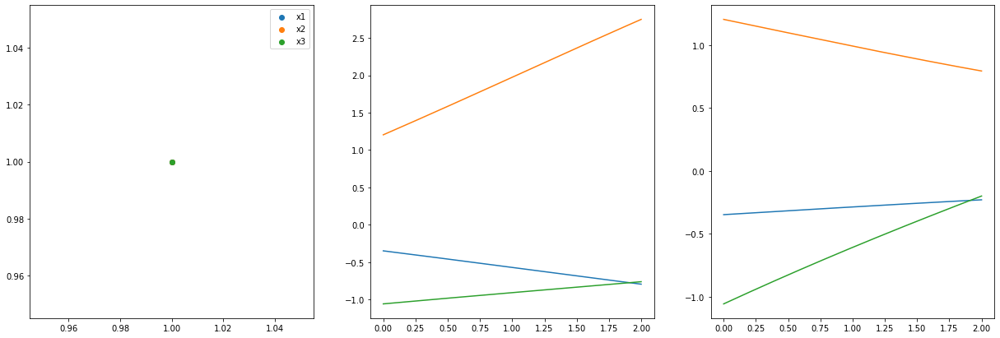

In [46]:
fig = plt.figure(figsize=(21,7))
ax1 = fig.add_subplot(1,3,1)
ax2 = fig.add_subplot(1,3,2)
ax3 = fig.add_subplot(1,3,3)
for i in range(3):
    ax1.scatter(1,1,label = f"x{i+1}")
    ax2.plot(excite_y0[:,0],decoded_points_10d_2_y0[:,i])
    ax3.plot(excite_y0[:,0],decoded_points_10d_2_y1[:,i])

ax1.legend()
plt.show()

In [63]:
rand_decoded = decoder.predict(2*np.random.rand(100000,2))

3125/3125 ━━━━━━━━━━━━━━━━━━━━ 3s 949us/step


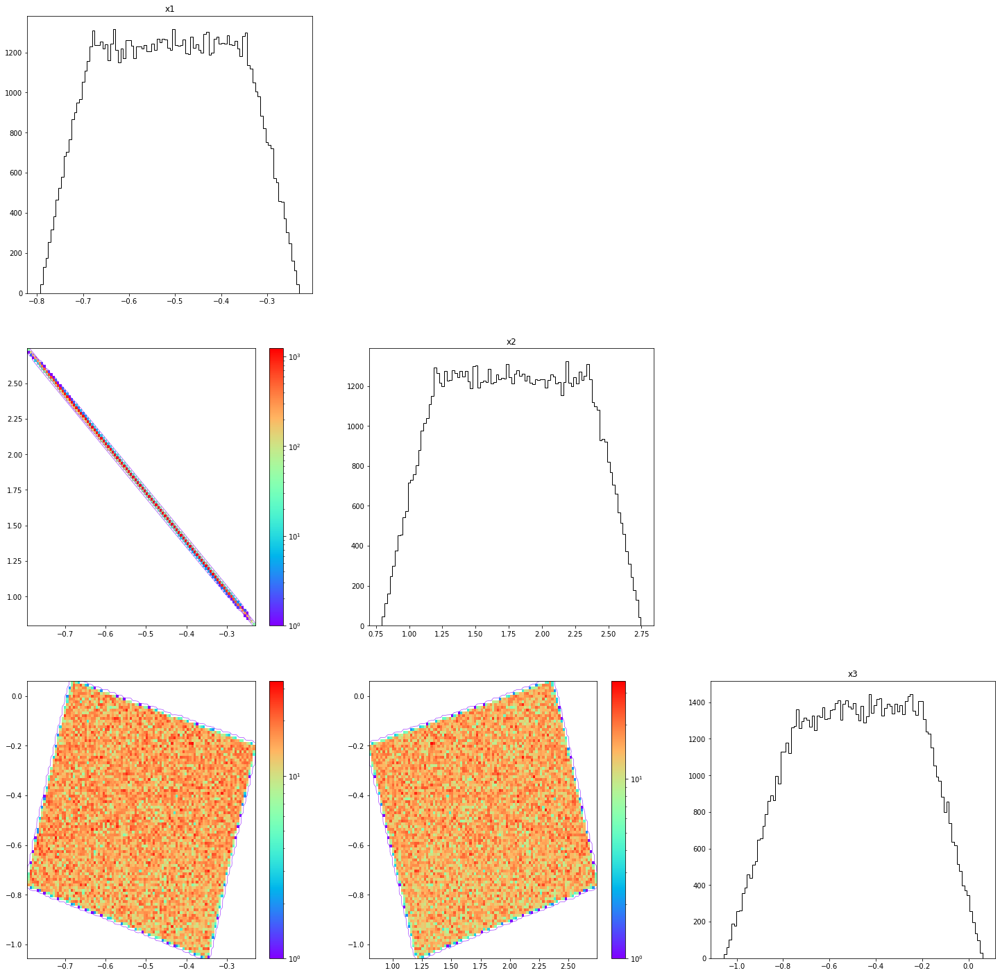

In [64]:
triangular_plot(rand_decoded)

In [ ]:
# learn x0 in terms of x1 and x2

In [61]:
Y = np.array([x3d[:,0]]).T
X = np.array([x3d[:,1],x3d[:,2]]).T

lambda_reg = 0

n_neurons = 128
input_shape = 2

model_lin = tf.keras.Sequential([
    layers.Input(shape=(input_shape,)),
    layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
    layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
    layers.Dense(1, kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg))  
])


In [62]:
model_lin.compile(optimizer='adam', loss='mse')

In [63]:
history_loss_lin = []

In [64]:
hist_loss_lin = model_lin.fit(X, Y, epochs=50, batch_size=10)

Epoch 1/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - loss: 0.0556
Epoch 2/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.5851e-04
Epoch 3/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.4598e-04
Epoch 4/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 3.5389e-04
Epoch 5/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.8688e-04
Epoch 6/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.8919e-04
Epoch 7/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.3529e-04
Epoch 8/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.0976e-04
Epoch 9/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 2.1704e-04
Epoch 10/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.5923e-04
Epoch 11/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.8811e-04
Epoch 12/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.9910e-04
Epoch 13/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - loss: 1.6146e-04
Epoch 14/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/s

In [65]:
w0, b0 = model_lin.layers[0].get_weights()
w1, b1 = model_lin.layers[1].get_weights()
w2, b2 = model_lin.layers[2].get_weights()
w0, b0 = model_lin.layers[0].get_weights()
w1, b1 = model_lin.layers[1].get_weights()
w2, b2 = model_lin.layers[2].get_weights()

np.savetxt("w0_model_3d_pot_x_0.csv", w0, delimiter=",",fmt="%.6f")
np.savetxt("w1_model_3d_pot_x_0.csv", w1, delimiter=",",fmt="%.6f")
np.savetxt("w2_model_3d_pot_x_0.csv", w2, delimiter=",",fmt="%.6f")

np.savetxt("b0_model_3d_pot_x_0.csv", b0, delimiter=",",fmt="%.6f")
np.savetxt("b1_model_3d_pot_x_0.csv", b1, delimiter=",",fmt="%.6f")
np.savetxt("b2_model_3d_pot_x_0.csv", b2, delimiter=",",fmt="%.6f")


In [ ]:
# learn x2 in terms of x1 and x0

In [45]:
Y = np.array([x3d[:,2]]).T
X = np.array([x3d[:,0],x3d[:,1]]).T

lambda_reg = 0

n_neurons = 128
input_shape = 2

model_lin = tf.keras.Sequential([
    layers.Input(shape=(input_shape,)),
    layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
    layers.Dense(n_neurons, activation='sigmoid', kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg)),
    layers.Dense(1, kernel_regularizer=regularizers.l2(lambda_reg), bias_regularizer=regularizers.l2(lambda_reg))  
])


In [46]:
model_lin.compile(optimizer='adam', loss='mse')

In [47]:
history_loss_lin_1 = []

In [48]:
hist_loss_lin_1 = model_lin.fit(X, Y, epochs=50, batch_size=10)

Epoch 1/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - loss: 0.3625
Epoch 2/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.3685
Epoch 3/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.3606
Epoch 4/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.3315
Epoch 5/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.3441
Epoch 6/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.3539
Epoch 7/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.3462
Epoch 8/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.3544
Epoch 9/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.3468
Epoch 10/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.3506
Epoch 11/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.3497
Epoch 12/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.3542
Epoch 13/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.3431
Epoch 14/50
1000/1000 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.3598
Epoch 15/50
1000/1000 ━━━━━━━

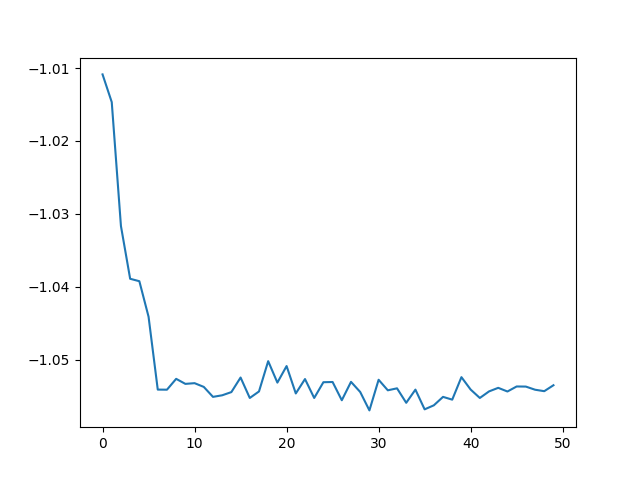

In [49]:
plt.figure()
plt.plot(np.log(hist_loss_lin_1.history["loss"]))
plt.show()

In [10]:
####################################################################################################################
############################################## 13 d potential ######################################################
####################################################################################################################

In [136]:
x13d = np.load('x_V13d_x13eq0.npy')

In [16]:
#val_pot = pot.V13d_sugra(x13d)

In [19]:
#mask_m2 = abs(val_pot + 2) < 10**(-1)
#x13d_m2 = np.array([list(np.extract(mask_m2,x13d[:,i])) for i in range(13)]).T

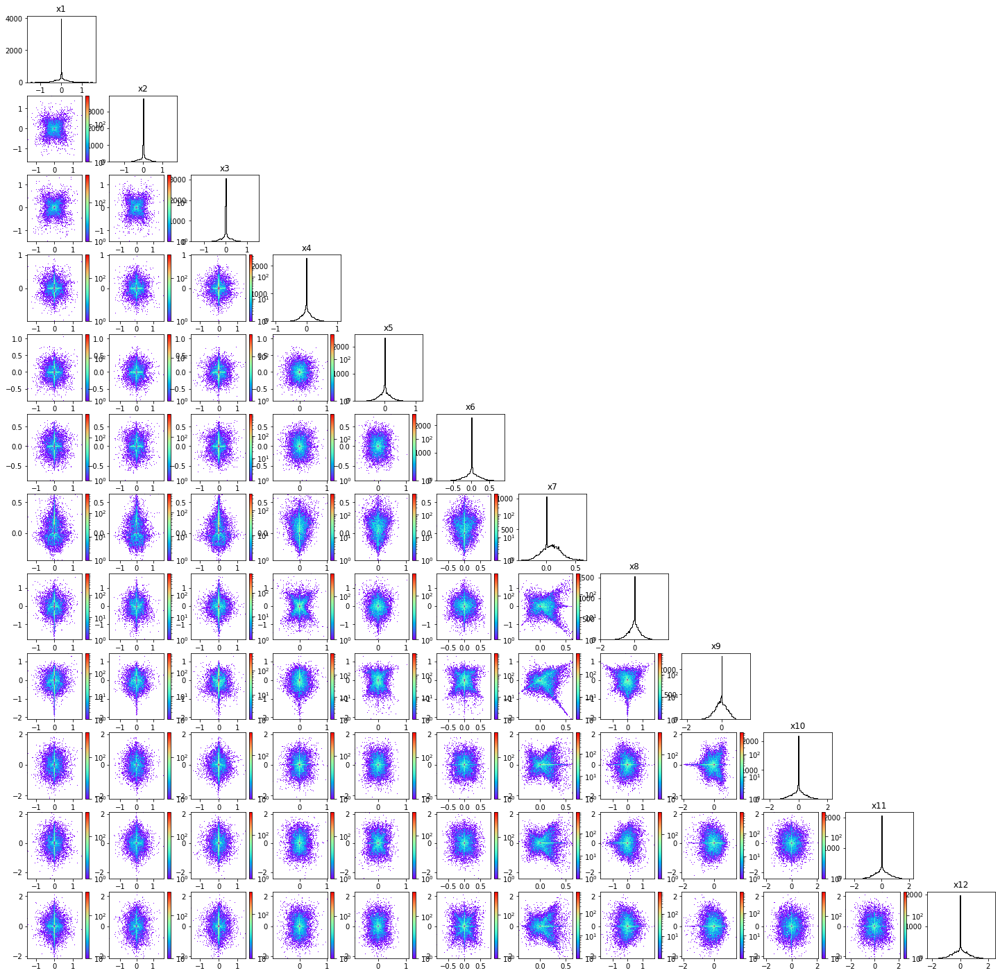

In [138]:
triangular_plot(x13d,fig_size=25)

In [147]:
mask = list(abs(x13d[:,0])<10**(-3)) * list(abs(x13d[:,1])<10**(-3))*list(abs(x13d[:,3])<10**(-3))*list(abs(x13d[:,4])<10**(-3))*list(abs(x13d[:,5])<10**(-3))*list(abs(x13d[:,7])<10**(-3))*list(abs(x13d[:,9])<10**(-3)*abs(x13d[:,10])<10**(-3)*abs(x13d[:,11])<10**(-3)


In [161]:
mask = list(abs(x13d[:,0])<10**(-3))
for i in [0,1,3,4,5,7,9,10,11]:
    mask = mask and list(abs(x13d[:,i])<10**(-3))
    

In [20]:
set_train_13d, set_test_13d = train_test_split(x13d_m2, test_size=0.1, random_state=1)


In [22]:
history_all_13d = []
all_autoencoder = []

start = time.time()

for i in range(13):
    
    this_latent_dim = i + 1
    input_dim = 13
    
    print(this_latent_dim)

    inputs = layers.Input(shape=(input_dim,))
    encoded = layers.Dense(256, activation='sigmoid')(inputs)
    encoded = layers.Dense(256, activation='sigmoid')(encoded)
    encoded = layers.Dense(this_latent_dim)(encoded)  

    decoded = layers.Dense(256, activation='sigmoid')(encoded)
    decoded = layers.Dense(256, activation='sigmoid')(decoded)
    decoded = layers.Dense(input_dim)(decoded)  

    this_autoencoder = keras.Model(inputs, decoded)
    this_autoencoder.compile(optimizer='adam', loss='mse')
    
    history_all_13d.append(this_autoencoder.fit(set_train_13d, set_train_13d, epochs=10000, batch_size=100, shuffle=True, validation_data=(set_test_13d,set_test_13d)))
    all_autoencoder.append(this_autoencoder)

end = time.time()
    

1
Epoch 1/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - loss: 0.2778 - val_loss: 0.1090
Epoch 2/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.1210 - val_loss: 0.1082
Epoch 3/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.1223 - val_loss: 0.1082
Epoch 4/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.1219 - val_loss: 0.1069
Epoch 5/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.1178 - val_loss: 0.0951
Epoch 6/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.1026 - val_loss: 0.0940
Epoch 7/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.1021 - val_loss: 0.0926
Epoch 8/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0994 - val_loss: 0.0950
Epoch 9/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0989 - val_loss: 0.0921
Epoch 10/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0988 - val_loss: 0.0921
Epoch 11/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0989 - val_loss: 0.0919
Epoch 12/10000
38/38 ━━━━━━━━━━━━━━━━━━

Epoch 135/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0823 - val_loss: 0.0752
Epoch 136/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0806 - val_loss: 0.0754
Epoch 137/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0798 - val_loss: 0.0754
Epoch 138/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0810 - val_loss: 0.0744
Epoch 139/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0812 - val_loss: 0.0744
Epoch 140/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0810 - val_loss: 0.0739
Epoch 141/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0809 - val_loss: 0.0742
Epoch 142/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0809 - val_loss: 0.0745
Epoch 143/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0800 - val_loss: 0.0742
Epoch 144/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0790 - val_loss: 0.0739
Epoch 145/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0816 - val_loss: 0.0742
Epoch 146/10000
38/38

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0745 - val_loss: 0.0720
Epoch 268/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0769 - val_loss: 0.0718
Epoch 269/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0765 - val_loss: 0.0719
Epoch 270/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0751 - val_loss: 0.0720
Epoch 271/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0768 - val_loss: 0.0725
Epoch 272/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0758 - val_loss: 0.0719
Epoch 273/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0763 - val_loss: 0.0717
Epoch 274/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0726 - val_loss: 0.0724
Epoch 275/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0744 - val_loss: 0.0730
Epoch 276/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0745 - val_loss: 0.0719
Epoch 277/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0748 - val_loss: 0.0725
Epoch 278/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0738 - val_loss: 0.0712
Epoch 400/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0740 - val_loss: 0.0716
Epoch 401/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0736 - val_loss: 0.0711
Epoch 402/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0735 - val_loss: 0.0708
Epoch 403/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0716 - val_loss: 0.0708
Epoch 404/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0737 - val_loss: 0.0717
Epoch 405/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0743 - val_loss: 0.0723
Epoch 406/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0769 - val_loss: 0.0714
Epoch 407/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0758 - val_loss: 0.0718
Epoch 408/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0779 - val_loss: 0.0731
Epoch 409/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0776 - val_loss: 0.0714
Epoch 410/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0746 - val_loss: 0.0694
Epoch 532/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0728 - val_loss: 0.0695
Epoch 533/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0735 - val_loss: 0.0697
Epoch 534/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0732 - val_loss: 0.0697
Epoch 535/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0719 - val_loss: 0.0703
Epoch 536/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0743 - val_loss: 0.0702
Epoch 537/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0732 - val_loss: 0.0697
Epoch 538/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0736 - val_loss: 0.0698
Epoch 539/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0712 - val_loss: 0.0699
Epoch 540/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0741 - val_loss: 0.0699
Epoch 541/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0746 - val_loss: 0.0699
Epoch 542/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0698 - val_loss: 0.0696
Epoch 664/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0721 - val_loss: 0.0689
Epoch 665/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0697 - val_loss: 0.0692
Epoch 666/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0715 - val_loss: 0.0696
Epoch 667/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0731 - val_loss: 0.0690
Epoch 668/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0695 - val_loss: 0.0689
Epoch 669/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0736 - val_loss: 0.0689
Epoch 670/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0719 - val_loss: 0.0695
Epoch 671/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0712 - val_loss: 0.0698
Epoch 672/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0726 - val_loss: 0.0703
Epoch 673/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0705 - val_loss: 0.0695
Epoch 674/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0704 - val_loss: 0.0688
Epoch 796/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0701 - val_loss: 0.0691
Epoch 797/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0692 - val_loss: 0.0700
Epoch 798/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0710 - val_loss: 0.0694
Epoch 799/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0686 - val_loss: 0.0694
Epoch 800/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0713 - val_loss: 0.0692
Epoch 801/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0692 - val_loss: 0.0707
Epoch 802/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0704 - val_loss: 0.0690
Epoch 803/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0683 - val_loss: 0.0693
Epoch 804/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0693 - val_loss: 0.0698
Epoch 805/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0698 - val_loss: 0.0695
Epoch 806/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0687 - val_loss: 0.0690
Epoch 928/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0663 - val_loss: 0.0686
Epoch 929/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0697 - val_loss: 0.0689
Epoch 930/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0688 - val_loss: 0.0680
Epoch 931/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0687 - val_loss: 0.0692
Epoch 932/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0688 - val_loss: 0.0684
Epoch 933/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0693 - val_loss: 0.0680
Epoch 934/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0686 - val_loss: 0.0681
Epoch 935/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0675 - val_loss: 0.0682
Epoch 936/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0685 - val_loss: 0.0677
Epoch 937/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0682 - val_loss: 0.0679
Epoch 938/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0671 - val_loss: 0.0679
Epoch 1060/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0671 - val_loss: 0.0676
Epoch 1061/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0663 - val_loss: 0.0673
Epoch 1062/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0676 - val_loss: 0.0674
Epoch 1063/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0654 - val_loss: 0.0675
Epoch 1064/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0678 - val_loss: 0.0677
Epoch 1065/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0670 - val_loss: 0.0673
Epoch 1066/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0682 - val_loss: 0.0679
Epoch 1067/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0654 - val_loss: 0.0680
Epoch 1068/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0668 - val_loss: 0.0680
Epoch 1069/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0671 - val_loss: 0.0678
Epoch 1070/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0653 - val_loss: 0.0679
Epoch 1192/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0660 - val_loss: 0.0670
Epoch 1193/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0661 - val_loss: 0.0679
Epoch 1194/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0661 - val_loss: 0.0679
Epoch 1195/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0678 - val_loss: 0.0678
Epoch 1196/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0669 - val_loss: 0.0676
Epoch 1197/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0665 - val_loss: 0.0667
Epoch 1198/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0667 - val_loss: 0.0675
Epoch 1199/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0655 - val_loss: 0.0670
Epoch 1200/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0663 - val_loss: 0.0678
Epoch 1201/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0661 - val_loss: 0.0680
Epoch 1202/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0669 - val_loss: 0.0671
Epoch 1324/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0672 - val_loss: 0.0680
Epoch 1325/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0647 - val_loss: 0.0665
Epoch 1326/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0644 - val_loss: 0.0671
Epoch 1327/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0663 - val_loss: 0.0668
Epoch 1328/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0656 - val_loss: 0.0675
Epoch 1329/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0666 - val_loss: 0.0674
Epoch 1330/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0671 - val_loss: 0.0669
Epoch 1331/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0657 - val_loss: 0.0673
Epoch 1332/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0660 - val_loss: 0.0669
Epoch 1333/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0670 - val_loss: 0.0677
Epoch 1334/10000
38/38 ━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0644 - val_loss: 0.0675
Epoch 1456/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0644 - val_loss: 0.0676
Epoch 1457/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0653 - val_loss: 0.0672
Epoch 1458/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0667 - val_loss: 0.0672
Epoch 1459/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0651 - val_loss: 0.0675
Epoch 1460/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0637 - val_loss: 0.0674
Epoch 1461/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0661 - val_loss: 0.0675
Epoch 1462/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0659 - val_loss: 0.0678
Epoch 1463/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0647 - val_loss: 0.0677
Epoch 1464/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0645 - val_loss: 0.0673
Epoch 1465/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0653 - val_loss: 0.0673
Epoch 1466/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0647 - val_loss: 0.0673
Epoch 1588/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0641 - val_loss: 0.0681
Epoch 1589/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0653 - val_loss: 0.0675
Epoch 1590/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0661 - val_loss: 0.0673
Epoch 1591/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0667 - val_loss: 0.0684
Epoch 1592/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0655 - val_loss: 0.0686
Epoch 1593/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0646 - val_loss: 0.0672
Epoch 1594/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0660 - val_loss: 0.0677
Epoch 1595/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0631 - val_loss: 0.0679
Epoch 1596/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0639 - val_loss: 0.0688
Epoch 1597/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0638 - val_loss: 0.0678
Epoch 1598/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0645 - val_loss: 0.0671
Epoch 1720/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0644 - val_loss: 0.0681
Epoch 1721/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0658 - val_loss: 0.0674
Epoch 1722/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0639 - val_loss: 0.0675
Epoch 1723/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0644 - val_loss: 0.0676
Epoch 1724/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0639 - val_loss: 0.0677
Epoch 1725/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0641 - val_loss: 0.0677
Epoch 1726/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0649 - val_loss: 0.0678
Epoch 1727/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0654 - val_loss: 0.0687
Epoch 1728/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0645 - val_loss: 0.0681
Epoch 1729/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0638 - val_loss: 0.0677
Epoch 1730/10000
38/38 ━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0620 - val_loss: 0.0680
Epoch 1786/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0655 - val_loss: 0.0682
Epoch 1787/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0633 - val_loss: 0.0681
Epoch 1788/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0646 - val_loss: 0.0670
Epoch 1789/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0634 - val_loss: 0.0676
Epoch 1790/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0631 - val_loss: 0.0680
Epoch 1791/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0642 - val_loss: 0.0678
Epoch 1792/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0644 - val_loss: 0.0682
Epoch 1793/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0633 - val_loss: 0.0682
Epoch 1794/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0646 - val_loss: 0.0681
Epoch 1795/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0631 - val_loss: 0.0677
Epoch 1796/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0627 - val_loss: 0.0681
Epoch 1918/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0623 - val_loss: 0.0673
Epoch 1919/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0640 - val_loss: 0.0678
Epoch 1920/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0627 - val_loss: 0.0677
Epoch 1921/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0643 - val_loss: 0.0684
Epoch 1922/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0640 - val_loss: 0.0679
Epoch 1923/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0651 - val_loss: 0.0680
Epoch 1924/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0622 - val_loss: 0.0682
Epoch 1925/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0628 - val_loss: 0.0679
Epoch 1926/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0622 - val_loss: 0.0668
Epoch 1927/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0650 - val_loss: 0.0687
Epoch 1928/10000
38/38 ━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0625 - val_loss: 0.0687
Epoch 2050/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0630 - val_loss: 0.0684
Epoch 2051/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0608 - val_loss: 0.0691
Epoch 2052/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0628 - val_loss: 0.0694
Epoch 2053/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0619 - val_loss: 0.0684
Epoch 2054/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0610 - val_loss: 0.0683
Epoch 2055/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0606 - val_loss: 0.0685
Epoch 2056/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0616 - val_loss: 0.0690
Epoch 2057/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0623 - val_loss: 0.0678
Epoch 2058/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0617 - val_loss: 0.0691
Epoch 2059/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0619 - val_loss: 0.0687
Epoch 2060/10000
38/38 ━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0614 - val_loss: 0.0690
Epoch 2182/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0621 - val_loss: 0.0689
Epoch 2183/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0617 - val_loss: 0.0685
Epoch 2184/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0618 - val_loss: 0.0695
Epoch 2185/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0610 - val_loss: 0.0689
Epoch 2186/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0620 - val_loss: 0.0699
Epoch 2187/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0616 - val_loss: 0.0685
Epoch 2188/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0635 - val_loss: 0.0697
Epoch 2189/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0600 - val_loss: 0.0696
Epoch 2190/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0620 - val_loss: 0.0715
Epoch 2191/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0624 - val_loss: 0.0693
Epoch 2192/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0603 - val_loss: 0.0695
Epoch 2314/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0621 - val_loss: 0.0693
Epoch 2315/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0600 - val_loss: 0.0712
Epoch 2316/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0607 - val_loss: 0.0698
Epoch 2317/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0610 - val_loss: 0.0689
Epoch 2318/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0597 - val_loss: 0.0693
Epoch 2319/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0601 - val_loss: 0.0693
Epoch 2320/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0609 - val_loss: 0.0688
Epoch 2321/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0615 - val_loss: 0.0685
Epoch 2322/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0603 - val_loss: 0.0698
Epoch 2323/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0613 - val_loss: 0.0696
Epoch 2324/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0588 - val_loss: 0.0690
Epoch 2446/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0607 - val_loss: 0.0697
Epoch 2447/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0596 - val_loss: 0.0694
Epoch 2448/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0602 - val_loss: 0.0686
Epoch 2449/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0598 - val_loss: 0.0688
Epoch 2450/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - loss: 0.0596 - val_loss: 0.0695
Epoch 2451/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0616 - val_loss: 0.0696
Epoch 2452/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0607 - val_loss: 0.0692
Epoch 2453/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0600 - val_loss: 0.0689
Epoch 2454/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0605 - val_loss: 0.0692
Epoch 2455/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0598 - val_loss: 0.0696
Epoch 2456/10000
38/38 

38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0611 - val_loss: 0.0704
Epoch 2512/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0606 - val_loss: 0.0700
Epoch 2513/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0614 - val_loss: 0.0690
Epoch 2514/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0601 - val_loss: 0.0699
Epoch 2515/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0611 - val_loss: 0.0700
Epoch 2516/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0617 - val_loss: 0.0696
Epoch 2517/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0616 - val_loss: 0.0693
Epoch 2518/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0612 - val_loss: 0.0706
Epoch 2519/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0604 - val_loss: 0.0704
Epoch 2520/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0600 - val_loss: 0.0700
Epoch 2521/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0617 - val_loss: 0.0701
Epoch 2522/10000
38/38 ━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0593 - val_loss: 0.0694
Epoch 2644/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0598 - val_loss: 0.0702
Epoch 2645/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0598 - val_loss: 0.0689
Epoch 2646/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0595 - val_loss: 0.0688
Epoch 2647/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0599 - val_loss: 0.0698
Epoch 2648/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0610 - val_loss: 0.0693
Epoch 2649/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0618 - val_loss: 0.0696
Epoch 2650/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0597 - val_loss: 0.0697
Epoch 2651/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0614 - val_loss: 0.0695
Epoch 2652/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0595 - val_loss: 0.0703
Epoch 2653/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0608 - val_loss: 0.0696
Epoch 2654/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0609 - val_loss: 0.0690
Epoch 2776/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0587 - val_loss: 0.0705
Epoch 2777/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0610 - val_loss: 0.0703
Epoch 2778/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0592 - val_loss: 0.0702
Epoch 2779/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0591 - val_loss: 0.0697
Epoch 2780/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0583 - val_loss: 0.0696
Epoch 2781/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0597 - val_loss: 0.0693
Epoch 2782/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0596 - val_loss: 0.0693
Epoch 2783/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0605 - val_loss: 0.0710
Epoch 2784/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0586 - val_loss: 0.0712
Epoch 2785/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0596 - val_loss: 0.0704
Epoch 2786/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0599 - val_loss: 0.0702
Epoch 2908/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0588 - val_loss: 0.0706
Epoch 2909/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0607 - val_loss: 0.0717
Epoch 2910/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0600 - val_loss: 0.0699
Epoch 2911/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0579 - val_loss: 0.0706
Epoch 2912/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0578 - val_loss: 0.0704
Epoch 2913/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0590 - val_loss: 0.0697
Epoch 2914/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0598 - val_loss: 0.0699
Epoch 2915/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0592 - val_loss: 0.0705
Epoch 2916/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0596 - val_loss: 0.0709
Epoch 2917/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0596 - val_loss: 0.0698
Epoch 2918/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0593 - val_loss: 0.0713
Epoch 3040/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0583 - val_loss: 0.0706
Epoch 3041/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0596 - val_loss: 0.0707
Epoch 3042/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0593 - val_loss: 0.0705
Epoch 3043/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0588 - val_loss: 0.0712
Epoch 3044/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0596 - val_loss: 0.0721
Epoch 3045/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0595 - val_loss: 0.0708
Epoch 3046/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0584 - val_loss: 0.0706
Epoch 3047/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0589 - val_loss: 0.0702
Epoch 3048/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0592 - val_loss: 0.0704
Epoch 3049/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0584 - val_loss: 0.0703
Epoch 3050/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0586 - val_loss: 0.0708
Epoch 3172/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0585 - val_loss: 0.0720
Epoch 3173/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0586 - val_loss: 0.0708
Epoch 3174/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0586 - val_loss: 0.0709
Epoch 3175/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0585 - val_loss: 0.0706
Epoch 3176/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0592 - val_loss: 0.0708
Epoch 3177/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0588 - val_loss: 0.0707
Epoch 3178/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0586 - val_loss: 0.0716
Epoch 3179/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0579 - val_loss: 0.0719
Epoch 3180/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0586 - val_loss: 0.0717
Epoch 3181/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0597 - val_loss: 0.0709
Epoch 3182/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0575 - val_loss: 0.0715
Epoch 3304/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0578 - val_loss: 0.0723
Epoch 3305/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0574 - val_loss: 0.0722
Epoch 3306/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0590 - val_loss: 0.0724
Epoch 3307/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0595 - val_loss: 0.0715
Epoch 3308/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0591 - val_loss: 0.0714
Epoch 3309/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0590 - val_loss: 0.0718
Epoch 3310/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0583 - val_loss: 0.0711
Epoch 3311/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0584 - val_loss: 0.0727
Epoch 3312/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0603 - val_loss: 0.0722
Epoch 3313/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0605 - val_loss: 0.0721
Epoch 3314/10000
38/38 ━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0581 - val_loss: 0.0724
Epoch 3436/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0596 - val_loss: 0.0723
Epoch 3437/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0587 - val_loss: 0.0723
Epoch 3438/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0593 - val_loss: 0.0725
Epoch 3439/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0584 - val_loss: 0.0734
Epoch 3440/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0581 - val_loss: 0.0725
Epoch 3441/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0575 - val_loss: 0.0727
Epoch 3442/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0593 - val_loss: 0.0724
Epoch 3443/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0590 - val_loss: 0.0730
Epoch 3444/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0572 - val_loss: 0.0727
Epoch 3445/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0580 - val_loss: 0.0714
Epoch 3446/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0574 - val_loss: 0.0724
Epoch 3568/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0588 - val_loss: 0.0722
Epoch 3569/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0592 - val_loss: 0.0720
Epoch 3570/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0584 - val_loss: 0.0736
Epoch 3571/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0573 - val_loss: 0.0725
Epoch 3572/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0585 - val_loss: 0.0732
Epoch 3573/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0580 - val_loss: 0.0727
Epoch 3574/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0570 - val_loss: 0.0729
Epoch 3575/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0565 - val_loss: 0.0721
Epoch 3576/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0583 - val_loss: 0.0725
Epoch 3577/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0582 - val_loss: 0.0726
Epoch 3578/10000
38/38 ━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0570 - val_loss: 0.0730
Epoch 3700/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0586 - val_loss: 0.0719
Epoch 3701/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0582 - val_loss: 0.0728
Epoch 3702/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0579 - val_loss: 0.0716
Epoch 3703/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0587 - val_loss: 0.0724
Epoch 3704/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0586 - val_loss: 0.0721
Epoch 3705/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0590 - val_loss: 0.0723
Epoch 3706/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0569 - val_loss: 0.0725
Epoch 3707/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0580 - val_loss: 0.0714
Epoch 3708/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0579 - val_loss: 0.0716
Epoch 3709/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0573 - val_loss: 0.0725
Epoch 3710/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0579 - val_loss: 0.0728
Epoch 3832/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0571 - val_loss: 0.0722
Epoch 3833/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0579 - val_loss: 0.0725
Epoch 3834/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0577 - val_loss: 0.0718
Epoch 3835/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0586 - val_loss: 0.0715
Epoch 3836/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0586 - val_loss: 0.0710
Epoch 3837/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0577 - val_loss: 0.0725
Epoch 3838/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0579 - val_loss: 0.0719
Epoch 3839/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0574 - val_loss: 0.0716
Epoch 3840/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0576 - val_loss: 0.0717
Epoch 3841/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0581 - val_loss: 0.0718
Epoch 3842/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0579 - val_loss: 0.0716
Epoch 3964/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0576 - val_loss: 0.0715
Epoch 3965/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0584 - val_loss: 0.0704
Epoch 3966/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0570 - val_loss: 0.0713
Epoch 3967/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0578 - val_loss: 0.0725
Epoch 3968/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0575 - val_loss: 0.0719
Epoch 3969/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0575 - val_loss: 0.0720
Epoch 3970/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0585 - val_loss: 0.0718
Epoch 3971/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0580 - val_loss: 0.0719
Epoch 3972/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0596 - val_loss: 0.0714
Epoch 3973/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0577 - val_loss: 0.0723
Epoch 3974/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0563 - val_loss: 0.0717
Epoch 4096/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0564 - val_loss: 0.0719
Epoch 4097/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0570 - val_loss: 0.0718
Epoch 4098/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0570 - val_loss: 0.0716
Epoch 4099/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0580 - val_loss: 0.0715
Epoch 4100/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0583 - val_loss: 0.0715
Epoch 4101/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0560 - val_loss: 0.0712
Epoch 4102/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0577 - val_loss: 0.0707
Epoch 4103/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0588 - val_loss: 0.0713
Epoch 4104/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0571 - val_loss: 0.0711
Epoch 4105/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0587 - val_loss: 0.0716
Epoch 4106/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0591 - val_loss: 0.0735
Epoch 4228/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0564 - val_loss: 0.0727
Epoch 4229/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0567 - val_loss: 0.0732
Epoch 4230/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0588 - val_loss: 0.0726
Epoch 4231/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0563 - val_loss: 0.0722
Epoch 4232/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0578 - val_loss: 0.0722
Epoch 4233/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0578 - val_loss: 0.0728
Epoch 4234/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0567 - val_loss: 0.0716
Epoch 4235/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0562 - val_loss: 0.0729
Epoch 4236/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0571 - val_loss: 0.0718
Epoch 4237/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0589 - val_loss: 0.0714
Epoch 4238/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0568 - val_loss: 0.0717
Epoch 4360/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0569 - val_loss: 0.0715
Epoch 4361/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0595 - val_loss: 0.0714
Epoch 4362/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0568 - val_loss: 0.0717
Epoch 4363/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0571 - val_loss: 0.0720
Epoch 4364/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0573 - val_loss: 0.0718
Epoch 4365/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0584 - val_loss: 0.0713
Epoch 4366/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0581 - val_loss: 0.0719
Epoch 4367/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0584 - val_loss: 0.0720
Epoch 4368/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0571 - val_loss: 0.0716
Epoch 4369/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0579 - val_loss: 0.0716
Epoch 4370/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0568 - val_loss: 0.0724
Epoch 4492/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0564 - val_loss: 0.0733
Epoch 4493/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0586 - val_loss: 0.0729
Epoch 4494/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0569 - val_loss: 0.0734
Epoch 4495/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0570 - val_loss: 0.0730
Epoch 4496/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0585 - val_loss: 0.0723
Epoch 4497/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0567 - val_loss: 0.0722
Epoch 4498/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0564 - val_loss: 0.0713
Epoch 4499/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0582 - val_loss: 0.0724
Epoch 4500/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0571 - val_loss: 0.0728
Epoch 4501/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0572 - val_loss: 0.0719
Epoch 4502/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0565 - val_loss: 0.0730
Epoch 4624/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0555 - val_loss: 0.0733
Epoch 4625/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0579 - val_loss: 0.0735
Epoch 4626/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0568 - val_loss: 0.0737
Epoch 4627/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0578 - val_loss: 0.0727
Epoch 4628/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0573 - val_loss: 0.0729
Epoch 4629/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0552 - val_loss: 0.0725
Epoch 4630/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0566 - val_loss: 0.0736
Epoch 4631/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0566 - val_loss: 0.0731
Epoch 4632/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0560 - val_loss: 0.0731
Epoch 4633/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0557 - val_loss: 0.0732
Epoch 4634/10000
38/38 ━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0567 - val_loss: 0.0713
Epoch 4756/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0571 - val_loss: 0.0724
Epoch 4757/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0575 - val_loss: 0.0728
Epoch 4758/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0557 - val_loss: 0.0728
Epoch 4759/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0582 - val_loss: 0.0729
Epoch 4760/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0566 - val_loss: 0.0727
Epoch 4761/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0589 - val_loss: 0.0731
Epoch 4762/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0580 - val_loss: 0.0732
Epoch 4763/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0578 - val_loss: 0.0728
Epoch 4764/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0565 - val_loss: 0.0730
Epoch 4765/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0573 - val_loss: 0.0728
Epoch 4766/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0584 - val_loss: 0.0734
Epoch 4888/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0588 - val_loss: 0.0738
Epoch 4889/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0550 - val_loss: 0.0728
Epoch 4890/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0566 - val_loss: 0.0730
Epoch 4891/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0561 - val_loss: 0.0730
Epoch 4892/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0567 - val_loss: 0.0728
Epoch 4893/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0574 - val_loss: 0.0737
Epoch 4894/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0570 - val_loss: 0.0730
Epoch 4895/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0575 - val_loss: 0.0735
Epoch 4896/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0554 - val_loss: 0.0731
Epoch 4897/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0565 - val_loss: 0.0740
Epoch 4898/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0562 - val_loss: 0.0734
Epoch 5020/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0580 - val_loss: 0.0739
Epoch 5021/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0561 - val_loss: 0.0735
Epoch 5022/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0564 - val_loss: 0.0736
Epoch 5023/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0570 - val_loss: 0.0733
Epoch 5024/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0574 - val_loss: 0.0740
Epoch 5025/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0566 - val_loss: 0.0727
Epoch 5026/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0576 - val_loss: 0.0739
Epoch 5027/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0567 - val_loss: 0.0728
Epoch 5028/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0558 - val_loss: 0.0737
Epoch 5029/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0582 - val_loss: 0.0733
Epoch 5030/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0547 - val_loss: 0.0737
Epoch 5152/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0566 - val_loss: 0.0732
Epoch 5153/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0574 - val_loss: 0.0745
Epoch 5154/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0571 - val_loss: 0.0734
Epoch 5155/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0560 - val_loss: 0.0735
Epoch 5156/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0567 - val_loss: 0.0734
Epoch 5157/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0566 - val_loss: 0.0748
Epoch 5158/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0566 - val_loss: 0.0725
Epoch 5159/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0586 - val_loss: 0.0742
Epoch 5160/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0557 - val_loss: 0.0739
Epoch 5161/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0571 - val_loss: 0.0736
Epoch 5162/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0572 - val_loss: 0.0738
Epoch 5284/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0574 - val_loss: 0.0740
Epoch 5285/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0576 - val_loss: 0.0742
Epoch 5286/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0561 - val_loss: 0.0737
Epoch 5287/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0574 - val_loss: 0.0735
Epoch 5288/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0562 - val_loss: 0.0739
Epoch 5289/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0572 - val_loss: 0.0735
Epoch 5290/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0566 - val_loss: 0.0731
Epoch 5291/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0571 - val_loss: 0.0742
Epoch 5292/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0562 - val_loss: 0.0734
Epoch 5293/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0566 - val_loss: 0.0727
Epoch 5294/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0563 - val_loss: 0.0738
Epoch 5416/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0564 - val_loss: 0.0731
Epoch 5417/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0577 - val_loss: 0.0732
Epoch 5418/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0553 - val_loss: 0.0742
Epoch 5419/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0560 - val_loss: 0.0734
Epoch 5420/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0555 - val_loss: 0.0734
Epoch 5421/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0562 - val_loss: 0.0740
Epoch 5422/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0552 - val_loss: 0.0744
Epoch 5423/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0573 - val_loss: 0.0738
Epoch 5424/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0563 - val_loss: 0.0738
Epoch 5425/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0562 - val_loss: 0.0745
Epoch 5426/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0569 - val_loss: 0.0731
Epoch 5548/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0563 - val_loss: 0.0738
Epoch 5549/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0552 - val_loss: 0.0734
Epoch 5550/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0562 - val_loss: 0.0732
Epoch 5551/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0554 - val_loss: 0.0737
Epoch 5552/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0565 - val_loss: 0.0738
Epoch 5553/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0572 - val_loss: 0.0750
Epoch 5554/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0564 - val_loss: 0.0733
Epoch 5555/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0567 - val_loss: 0.0736
Epoch 5556/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0565 - val_loss: 0.0736
Epoch 5557/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0562 - val_loss: 0.0741
Epoch 5558/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0551 - val_loss: 0.0739
Epoch 5680/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0552 - val_loss: 0.0735
Epoch 5681/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0554 - val_loss: 0.0746
Epoch 5682/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0560 - val_loss: 0.0741
Epoch 5683/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0563 - val_loss: 0.0745
Epoch 5684/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0559 - val_loss: 0.0746
Epoch 5685/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0568 - val_loss: 0.0743
Epoch 5686/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0573 - val_loss: 0.0735
Epoch 5687/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0574 - val_loss: 0.0737
Epoch 5688/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0562 - val_loss: 0.0738
Epoch 5689/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0573 - val_loss: 0.0733
Epoch 5690/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0574 - val_loss: 0.0742
Epoch 5812/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0556 - val_loss: 0.0748
Epoch 5813/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0561 - val_loss: 0.0741
Epoch 5814/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0557 - val_loss: 0.0748
Epoch 5815/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0564 - val_loss: 0.0753
Epoch 5816/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0557 - val_loss: 0.0739
Epoch 5817/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0565 - val_loss: 0.0751
Epoch 5818/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0565 - val_loss: 0.0744
Epoch 5819/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0575 - val_loss: 0.0748
Epoch 5820/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0568 - val_loss: 0.0743
Epoch 5821/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0589 - val_loss: 0.0749
Epoch 5822/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0559 - val_loss: 0.0756
Epoch 5944/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0568 - val_loss: 0.0747
Epoch 5945/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0560 - val_loss: 0.0749
Epoch 5946/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0571 - val_loss: 0.0751
Epoch 5947/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0550 - val_loss: 0.0753
Epoch 5948/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0562 - val_loss: 0.0750
Epoch 5949/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0541 - val_loss: 0.0761
Epoch 5950/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0556 - val_loss: 0.0759
Epoch 5951/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0558 - val_loss: 0.0757
Epoch 5952/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0567 - val_loss: 0.0759
Epoch 5953/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0555 - val_loss: 0.0759
Epoch 5954/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0550 - val_loss: 0.0754
Epoch 6076/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0556 - val_loss: 0.0748
Epoch 6077/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0557 - val_loss: 0.0754
Epoch 6078/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0559 - val_loss: 0.0759
Epoch 6079/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0557 - val_loss: 0.0755
Epoch 6080/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0572 - val_loss: 0.0760
Epoch 6081/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0551 - val_loss: 0.0754
Epoch 6082/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0566 - val_loss: 0.0759
Epoch 6083/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0555 - val_loss: 0.0749
Epoch 6084/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0561 - val_loss: 0.0761
Epoch 6085/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0553 - val_loss: 0.0759
Epoch 6086/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0567 - val_loss: 0.0757
Epoch 6208/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0556 - val_loss: 0.0753
Epoch 6209/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0562 - val_loss: 0.0765
Epoch 6210/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0570 - val_loss: 0.0757
Epoch 6211/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0546 - val_loss: 0.0752
Epoch 6212/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0559 - val_loss: 0.0765
Epoch 6213/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0569 - val_loss: 0.0770
Epoch 6214/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0572 - val_loss: 0.0740
Epoch 6215/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0564 - val_loss: 0.0754
Epoch 6216/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0564 - val_loss: 0.0757
Epoch 6217/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0563 - val_loss: 0.0771
Epoch 6218/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0551 - val_loss: 0.0764
Epoch 6340/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0566 - val_loss: 0.0763
Epoch 6341/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0555 - val_loss: 0.0757
Epoch 6342/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0565 - val_loss: 0.0761
Epoch 6343/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0559 - val_loss: 0.0755
Epoch 6344/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0566 - val_loss: 0.0759
Epoch 6345/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0573 - val_loss: 0.0764
Epoch 6346/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0555 - val_loss: 0.0759
Epoch 6347/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0557 - val_loss: 0.0771
Epoch 6348/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0554 - val_loss: 0.0770
Epoch 6349/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0565 - val_loss: 0.0760
Epoch 6350/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0540 - val_loss: 0.0766
Epoch 6472/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0557 - val_loss: 0.0757
Epoch 6473/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0559 - val_loss: 0.0766
Epoch 6474/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0561 - val_loss: 0.0771
Epoch 6475/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0567 - val_loss: 0.0763
Epoch 6476/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0572 - val_loss: 0.0768
Epoch 6477/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0568 - val_loss: 0.0767
Epoch 6478/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0553 - val_loss: 0.0771
Epoch 6479/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0561 - val_loss: 0.0769
Epoch 6480/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0551 - val_loss: 0.0773
Epoch 6481/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0572 - val_loss: 0.0768
Epoch 6482/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0563 - val_loss: 0.0764
Epoch 6604/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0550 - val_loss: 0.0757
Epoch 6605/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0553 - val_loss: 0.0759
Epoch 6606/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0554 - val_loss: 0.0766
Epoch 6607/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0550 - val_loss: 0.0768
Epoch 6608/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0564 - val_loss: 0.0757
Epoch 6609/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0578 - val_loss: 0.0760
Epoch 6610/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0569 - val_loss: 0.0771
Epoch 6611/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0564 - val_loss: 0.0761
Epoch 6612/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0540 - val_loss: 0.0754
Epoch 6613/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0561 - val_loss: 0.0768
Epoch 6614/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0555 - val_loss: 0.0766
Epoch 6736/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0552 - val_loss: 0.0771
Epoch 6737/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0554 - val_loss: 0.0766
Epoch 6738/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0557 - val_loss: 0.0773
Epoch 6739/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0564 - val_loss: 0.0763
Epoch 6740/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0549 - val_loss: 0.0762
Epoch 6741/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0556 - val_loss: 0.0771
Epoch 6742/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0553 - val_loss: 0.0762
Epoch 6743/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0575 - val_loss: 0.0762
Epoch 6744/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0551 - val_loss: 0.0780
Epoch 6745/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0556 - val_loss: 0.0770
Epoch 6746/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0556 - val_loss: 0.0753
Epoch 6868/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0554 - val_loss: 0.0758
Epoch 6869/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0543 - val_loss: 0.0769
Epoch 6870/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0557 - val_loss: 0.0760
Epoch 6871/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0539 - val_loss: 0.0763
Epoch 6872/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0553 - val_loss: 0.0759
Epoch 6873/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0557 - val_loss: 0.0756
Epoch 6874/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0555 - val_loss: 0.0754
Epoch 6875/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0559 - val_loss: 0.0759
Epoch 6876/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0556 - val_loss: 0.0763
Epoch 6877/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0553 - val_loss: 0.0768
Epoch 6878/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0560 - val_loss: 0.0760
Epoch 7000/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0552 - val_loss: 0.0763
Epoch 7001/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0556 - val_loss: 0.0752
Epoch 7002/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0550 - val_loss: 0.0760
Epoch 7003/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0570 - val_loss: 0.0760
Epoch 7004/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0550 - val_loss: 0.0754
Epoch 7005/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0559 - val_loss: 0.0751
Epoch 7006/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0552 - val_loss: 0.0754
Epoch 7007/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0558 - val_loss: 0.0763
Epoch 7008/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0558 - val_loss: 0.0758
Epoch 7009/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0551 - val_loss: 0.0759
Epoch 7010/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0560 - val_loss: 0.0758
Epoch 7132/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0555 - val_loss: 0.0748
Epoch 7133/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0537 - val_loss: 0.0747
Epoch 7134/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0546 - val_loss: 0.0753
Epoch 7135/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0549 - val_loss: 0.0755
Epoch 7136/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0545 - val_loss: 0.0751
Epoch 7137/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0557 - val_loss: 0.0760
Epoch 7138/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0555 - val_loss: 0.0756
Epoch 7139/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0561 - val_loss: 0.0757
Epoch 7140/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0543 - val_loss: 0.0755
Epoch 7141/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0555 - val_loss: 0.0746
Epoch 7142/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0558 - val_loss: 0.0759
Epoch 7264/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0551 - val_loss: 0.0761
Epoch 7265/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0554 - val_loss: 0.0760
Epoch 7266/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0562 - val_loss: 0.0752
Epoch 7267/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0555 - val_loss: 0.0751
Epoch 7268/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0559 - val_loss: 0.0754
Epoch 7269/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0544 - val_loss: 0.0759
Epoch 7270/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0536 - val_loss: 0.0755
Epoch 7271/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0555 - val_loss: 0.0764
Epoch 7272/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0562 - val_loss: 0.0752
Epoch 7273/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0564 - val_loss: 0.0748
Epoch 7274/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0565 - val_loss: 0.0764
Epoch 7396/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0550 - val_loss: 0.0753
Epoch 7397/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0549 - val_loss: 0.0767
Epoch 7398/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0552 - val_loss: 0.0755
Epoch 7399/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0553 - val_loss: 0.0763
Epoch 7400/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0562 - val_loss: 0.0757
Epoch 7401/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0553 - val_loss: 0.0753
Epoch 7402/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0552 - val_loss: 0.0759
Epoch 7403/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0533 - val_loss: 0.0756
Epoch 7404/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0552 - val_loss: 0.0751
Epoch 7405/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0551 - val_loss: 0.0760
Epoch 7406/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0555 - val_loss: 0.0752
Epoch 7528/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0549 - val_loss: 0.0750
Epoch 7529/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0562 - val_loss: 0.0757
Epoch 7530/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0555 - val_loss: 0.0750
Epoch 7531/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0547 - val_loss: 0.0749
Epoch 7532/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0542 - val_loss: 0.0753
Epoch 7533/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0553 - val_loss: 0.0757
Epoch 7534/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0550 - val_loss: 0.0755
Epoch 7535/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0553 - val_loss: 0.0759
Epoch 7536/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0560 - val_loss: 0.0752
Epoch 7537/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0556 - val_loss: 0.0751
Epoch 7538/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0556 - val_loss: 0.0759
Epoch 7660/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0555 - val_loss: 0.0761
Epoch 7661/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0560 - val_loss: 0.0750
Epoch 7662/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0549 - val_loss: 0.0759
Epoch 7663/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0559 - val_loss: 0.0758
Epoch 7664/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0549 - val_loss: 0.0756
Epoch 7665/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0551 - val_loss: 0.0747
Epoch 7666/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0552 - val_loss: 0.0755
Epoch 7667/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0566 - val_loss: 0.0748
Epoch 7668/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0551 - val_loss: 0.0749
Epoch 7669/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0542 - val_loss: 0.0751
Epoch 7670/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0538 - val_loss: 0.0761
Epoch 7792/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0565 - val_loss: 0.0754
Epoch 7793/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0552 - val_loss: 0.0756
Epoch 7794/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0538 - val_loss: 0.0759
Epoch 7795/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0550 - val_loss: 0.0752
Epoch 7796/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0565 - val_loss: 0.0759
Epoch 7797/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0542 - val_loss: 0.0754
Epoch 7798/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0569 - val_loss: 0.0755
Epoch 7799/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0546 - val_loss: 0.0767
Epoch 7800/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0553 - val_loss: 0.0757
Epoch 7801/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0549 - val_loss: 0.0756
Epoch 7802/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0557 - val_loss: 0.0771
Epoch 7924/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0557 - val_loss: 0.0763
Epoch 7925/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0553 - val_loss: 0.0758
Epoch 7926/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0559 - val_loss: 0.0758
Epoch 7927/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0560 - val_loss: 0.0754
Epoch 7928/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0549 - val_loss: 0.0760
Epoch 7929/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0536 - val_loss: 0.0753
Epoch 7930/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0541 - val_loss: 0.0754
Epoch 7931/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0547 - val_loss: 0.0758
Epoch 7932/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0539 - val_loss: 0.0763
Epoch 7933/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0549 - val_loss: 0.0756
Epoch 7934/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0544 - val_loss: 0.0753
Epoch 8056/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0542 - val_loss: 0.0761
Epoch 8057/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0560 - val_loss: 0.0763
Epoch 8058/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0556 - val_loss: 0.0759
Epoch 8059/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0534 - val_loss: 0.0758
Epoch 8060/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0544 - val_loss: 0.0754
Epoch 8061/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0538 - val_loss: 0.0761
Epoch 8062/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0544 - val_loss: 0.0756
Epoch 8063/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0552 - val_loss: 0.0756
Epoch 8064/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0545 - val_loss: 0.0761
Epoch 8065/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0540 - val_loss: 0.0757
Epoch 8066/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0550 - val_loss: 0.0767
Epoch 8188/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0546 - val_loss: 0.0761
Epoch 8189/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0554 - val_loss: 0.0758
Epoch 8190/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0545 - val_loss: 0.0762
Epoch 8191/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0545 - val_loss: 0.0767
Epoch 8192/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0554 - val_loss: 0.0766
Epoch 8193/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0548 - val_loss: 0.0765
Epoch 8194/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0534 - val_loss: 0.0759
Epoch 8195/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0547 - val_loss: 0.0768
Epoch 8196/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0532 - val_loss: 0.0763
Epoch 8197/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0551 - val_loss: 0.0760
Epoch 8198/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0544 - val_loss: 0.0764
Epoch 8320/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0561 - val_loss: 0.0761
Epoch 8321/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0543 - val_loss: 0.0764
Epoch 8322/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0547 - val_loss: 0.0760
Epoch 8323/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0556 - val_loss: 0.0771
Epoch 8324/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0571 - val_loss: 0.0766
Epoch 8325/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0544 - val_loss: 0.0760
Epoch 8326/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0560 - val_loss: 0.0776
Epoch 8327/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0549 - val_loss: 0.0765
Epoch 8328/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0559 - val_loss: 0.0770
Epoch 8329/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0554 - val_loss: 0.0770
Epoch 8330/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0562 - val_loss: 0.0768
Epoch 8452/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0546 - val_loss: 0.0773
Epoch 8453/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0553 - val_loss: 0.0782
Epoch 8454/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0540 - val_loss: 0.0769
Epoch 8455/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0552 - val_loss: 0.0768
Epoch 8456/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0550 - val_loss: 0.0773
Epoch 8457/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0532 - val_loss: 0.0771
Epoch 8458/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0554 - val_loss: 0.0758
Epoch 8459/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0559 - val_loss: 0.0767
Epoch 8460/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0542 - val_loss: 0.0768
Epoch 8461/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0545 - val_loss: 0.0776
Epoch 8462/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0540 - val_loss: 0.0771
Epoch 8584/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0544 - val_loss: 0.0771
Epoch 8585/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0554 - val_loss: 0.0772
Epoch 8586/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0564 - val_loss: 0.0771
Epoch 8587/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0541 - val_loss: 0.0778
Epoch 8588/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0564 - val_loss: 0.0773
Epoch 8589/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0543 - val_loss: 0.0772
Epoch 8590/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0549 - val_loss: 0.0768
Epoch 8591/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0547 - val_loss: 0.0765
Epoch 8592/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0546 - val_loss: 0.0769
Epoch 8593/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0546 - val_loss: 0.0774
Epoch 8594/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0546 - val_loss: 0.0773
Epoch 8716/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0536 - val_loss: 0.0783
Epoch 8717/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0537 - val_loss: 0.0774
Epoch 8718/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0553 - val_loss: 0.0778
Epoch 8719/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0546 - val_loss: 0.0774
Epoch 8720/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0544 - val_loss: 0.0773
Epoch 8721/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0559 - val_loss: 0.0771
Epoch 8722/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0547 - val_loss: 0.0777
Epoch 8723/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0557 - val_loss: 0.0772
Epoch 8724/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0535 - val_loss: 0.0775
Epoch 8725/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0547 - val_loss: 0.0772
Epoch 8726/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0546 - val_loss: 0.0776
Epoch 8848/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0535 - val_loss: 0.0770
Epoch 8849/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0555 - val_loss: 0.0782
Epoch 8850/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0548 - val_loss: 0.0778
Epoch 8851/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0533 - val_loss: 0.0785
Epoch 8852/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0540 - val_loss: 0.0770
Epoch 8853/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0548 - val_loss: 0.0780
Epoch 8854/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0547 - val_loss: 0.0775
Epoch 8855/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0541 - val_loss: 0.0767
Epoch 8856/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0552 - val_loss: 0.0775
Epoch 8857/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0534 - val_loss: 0.0773
Epoch 8858/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0554 - val_loss: 0.0791
Epoch 8980/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0545 - val_loss: 0.0778
Epoch 8981/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0547 - val_loss: 0.0778
Epoch 8982/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0541 - val_loss: 0.0775
Epoch 8983/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0555 - val_loss: 0.0782
Epoch 8984/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0544 - val_loss: 0.0774
Epoch 8985/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0543 - val_loss: 0.0777
Epoch 8986/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0546 - val_loss: 0.0779
Epoch 8987/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0545 - val_loss: 0.0777
Epoch 8988/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0542 - val_loss: 0.0774
Epoch 8989/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0542 - val_loss: 0.0777
Epoch 8990/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0548 - val_loss: 0.0777
Epoch 9112/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0543 - val_loss: 0.0778
Epoch 9113/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0550 - val_loss: 0.0786
Epoch 9114/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0542 - val_loss: 0.0792
Epoch 9115/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0558 - val_loss: 0.0786
Epoch 9116/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0539 - val_loss: 0.0780
Epoch 9117/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0545 - val_loss: 0.0790
Epoch 9118/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0547 - val_loss: 0.0786
Epoch 9119/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0537 - val_loss: 0.0782
Epoch 9120/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0527 - val_loss: 0.0792
Epoch 9121/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0528 - val_loss: 0.0785
Epoch 9122/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0538 - val_loss: 0.0773
Epoch 9244/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0539 - val_loss: 0.0777
Epoch 9245/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0546 - val_loss: 0.0782
Epoch 9246/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0555 - val_loss: 0.0784
Epoch 9247/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0545 - val_loss: 0.0791
Epoch 9248/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0552 - val_loss: 0.0788
Epoch 9249/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0558 - val_loss: 0.0790
Epoch 9250/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0546 - val_loss: 0.0788
Epoch 9251/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0537 - val_loss: 0.0783
Epoch 9252/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0541 - val_loss: 0.0778
Epoch 9253/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0557 - val_loss: 0.0784
Epoch 9254/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0548 - val_loss: 0.0786
Epoch 9376/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0546 - val_loss: 0.0793
Epoch 9377/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0548 - val_loss: 0.0785
Epoch 9378/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0544 - val_loss: 0.0786
Epoch 9379/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0546 - val_loss: 0.0800
Epoch 9380/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0545 - val_loss: 0.0782
Epoch 9381/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0548 - val_loss: 0.0804
Epoch 9382/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0553 - val_loss: 0.0787
Epoch 9383/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0544 - val_loss: 0.0787
Epoch 9384/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0553 - val_loss: 0.0786
Epoch 9385/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0537 - val_loss: 0.0778
Epoch 9386/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0528 - val_loss: 0.0797
Epoch 9508/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0550 - val_loss: 0.0794
Epoch 9509/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0547 - val_loss: 0.0785
Epoch 9510/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0532 - val_loss: 0.0785
Epoch 9511/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0543 - val_loss: 0.0784
Epoch 9512/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0540 - val_loss: 0.0789
Epoch 9513/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0539 - val_loss: 0.0790
Epoch 9514/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0541 - val_loss: 0.0794
Epoch 9515/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0530 - val_loss: 0.0794
Epoch 9516/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0545 - val_loss: 0.0783
Epoch 9517/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0551 - val_loss: 0.0786
Epoch 9518/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0553 - val_loss: 0.0790
Epoch 9640/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0541 - val_loss: 0.0797
Epoch 9641/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0553 - val_loss: 0.0793
Epoch 9642/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0537 - val_loss: 0.0781
Epoch 9643/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0544 - val_loss: 0.0785
Epoch 9644/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0550 - val_loss: 0.0793
Epoch 9645/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0540 - val_loss: 0.0794
Epoch 9646/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0553 - val_loss: 0.0787
Epoch 9647/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0534 - val_loss: 0.0795
Epoch 9648/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0552 - val_loss: 0.0794
Epoch 9649/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0533 - val_loss: 0.0792
Epoch 9650/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0537 - val_loss: 0.0793
Epoch 9772/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0553 - val_loss: 0.0796
Epoch 9773/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0545 - val_loss: 0.0799
Epoch 9774/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0536 - val_loss: 0.0792
Epoch 9775/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0549 - val_loss: 0.0786
Epoch 9776/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0524 - val_loss: 0.0782
Epoch 9777/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0549 - val_loss: 0.0795
Epoch 9778/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0536 - val_loss: 0.0793
Epoch 9779/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0548 - val_loss: 0.0803
Epoch 9780/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0541 - val_loss: 0.0792
Epoch 9781/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0538 - val_loss: 0.0803
Epoch 9782/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0553 - val_loss: 0.0808
Epoch 9904/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0536 - val_loss: 0.0798
Epoch 9905/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0549 - val_loss: 0.0800
Epoch 9906/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0545 - val_loss: 0.0801
Epoch 9907/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0542 - val_loss: 0.0800
Epoch 9908/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0553 - val_loss: 0.0802
Epoch 9909/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0539 - val_loss: 0.0805
Epoch 9910/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0546 - val_loss: 0.0795
Epoch 9911/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0539 - val_loss: 0.0802
Epoch 9912/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0543 - val_loss: 0.0793
Epoch 9913/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0540 - val_loss: 0.0789
Epoch 9914/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0681 - val_loss: 0.0641
Epoch 36/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0704 - val_loss: 0.0633
Epoch 37/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0694 - val_loss: 0.0648
Epoch 38/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0693 - val_loss: 0.0635
Epoch 39/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0698 - val_loss: 0.0621
Epoch 40/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0686 - val_loss: 0.0623
Epoch 41/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0671 - val_loss: 0.0627
Epoch 42/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0677 - val_loss: 0.0621
Epoch 43/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0679 - val_loss: 0.0622
Epoch 44/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0677 - val_loss: 0.0614
Epoch 45/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0676 - val_loss: 0.0618
Epoch 46/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4m

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0582 - val_loss: 0.0546
Epoch 169/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0580 - val_loss: 0.0544
Epoch 170/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0575 - val_loss: 0.0551
Epoch 171/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0578 - val_loss: 0.0543
Epoch 172/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0587 - val_loss: 0.0550
Epoch 173/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0591 - val_loss: 0.0543
Epoch 174/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0575 - val_loss: 0.0545
Epoch 175/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0576 - val_loss: 0.0545
Epoch 176/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0579 - val_loss: 0.0544
Epoch 177/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0585 - val_loss: 0.0544
Epoch 178/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0573 - val_loss: 0.0544
Epoch 179/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0528 - val_loss: 0.0534
Epoch 301/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0519 - val_loss: 0.0533
Epoch 302/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0530 - val_loss: 0.0537
Epoch 303/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0517 - val_loss: 0.0537
Epoch 304/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0529 - val_loss: 0.0533
Epoch 305/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0521 - val_loss: 0.0534
Epoch 306/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0519 - val_loss: 0.0532
Epoch 307/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0518 - val_loss: 0.0535
Epoch 308/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0524 - val_loss: 0.0540
Epoch 309/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0527 - val_loss: 0.0529
Epoch 310/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0512 - val_loss: 0.0533
Epoch 311/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0487 - val_loss: 0.0541
Epoch 433/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0467 - val_loss: 0.0544
Epoch 434/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0476 - val_loss: 0.0536
Epoch 435/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0474 - val_loss: 0.0538
Epoch 436/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0468 - val_loss: 0.0534
Epoch 437/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0479 - val_loss: 0.0540
Epoch 438/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0467 - val_loss: 0.0537
Epoch 439/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0473 - val_loss: 0.0540
Epoch 440/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0463 - val_loss: 0.0538
Epoch 441/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0476 - val_loss: 0.0537
Epoch 442/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0467 - val_loss: 0.0542
Epoch 443/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0436 - val_loss: 0.0541
Epoch 565/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0439 - val_loss: 0.0549
Epoch 566/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0429 - val_loss: 0.0551
Epoch 567/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0429 - val_loss: 0.0548
Epoch 568/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0440 - val_loss: 0.0544
Epoch 569/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0435 - val_loss: 0.0549
Epoch 570/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0432 - val_loss: 0.0550
Epoch 571/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0427 - val_loss: 0.0549
Epoch 572/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0429 - val_loss: 0.0548
Epoch 573/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0434 - val_loss: 0.0547
Epoch 574/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0430 - val_loss: 0.0543
Epoch 575/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0400 - val_loss: 0.0556
Epoch 697/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0397 - val_loss: 0.0557
Epoch 698/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0396 - val_loss: 0.0565
Epoch 699/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0411 - val_loss: 0.0556
Epoch 700/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0400 - val_loss: 0.0556
Epoch 701/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0409 - val_loss: 0.0558
Epoch 702/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0396 - val_loss: 0.0564
Epoch 703/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0405 - val_loss: 0.0557
Epoch 704/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0395 - val_loss: 0.0562
Epoch 705/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0407 - val_loss: 0.0562
Epoch 706/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0390 - val_loss: 0.0554
Epoch 707/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0372 - val_loss: 0.0568
Epoch 829/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0380 - val_loss: 0.0567
Epoch 830/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0380 - val_loss: 0.0572
Epoch 831/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0373 - val_loss: 0.0575
Epoch 832/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0378 - val_loss: 0.0573
Epoch 833/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0375 - val_loss: 0.0569
Epoch 834/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0379 - val_loss: 0.0576
Epoch 835/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0380 - val_loss: 0.0569
Epoch 836/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0371 - val_loss: 0.0565
Epoch 837/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0379 - val_loss: 0.0569
Epoch 838/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0373 - val_loss: 0.0572
Epoch 839/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0362 - val_loss: 0.0572
Epoch 961/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0355 - val_loss: 0.0575
Epoch 962/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0363 - val_loss: 0.0575
Epoch 963/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0361 - val_loss: 0.0581
Epoch 964/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0353 - val_loss: 0.0580
Epoch 965/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0366 - val_loss: 0.0577
Epoch 966/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0363 - val_loss: 0.0583
Epoch 967/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0356 - val_loss: 0.0573
Epoch 968/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0360 - val_loss: 0.0573
Epoch 969/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0363 - val_loss: 0.0583
Epoch 970/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0354 - val_loss: 0.0579
Epoch 971/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0345 - val_loss: 0.0581
Epoch 1093/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0351 - val_loss: 0.0583
Epoch 1094/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0344 - val_loss: 0.0585
Epoch 1095/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0349 - val_loss: 0.0592
Epoch 1096/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0353 - val_loss: 0.0587
Epoch 1097/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0345 - val_loss: 0.0591
Epoch 1098/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0348 - val_loss: 0.0586
Epoch 1099/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0344 - val_loss: 0.0591
Epoch 1100/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0354 - val_loss: 0.0596
Epoch 1101/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0345 - val_loss: 0.0589
Epoch 1102/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0353 - val_loss: 0.0593
Epoch 1103/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0332 - val_loss: 0.0588
Epoch 1225/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0327 - val_loss: 0.0588
Epoch 1226/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0329 - val_loss: 0.0597
Epoch 1227/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0334 - val_loss: 0.0592
Epoch 1228/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0335 - val_loss: 0.0592
Epoch 1229/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0336 - val_loss: 0.0594
Epoch 1230/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0329 - val_loss: 0.0592
Epoch 1231/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0326 - val_loss: 0.0591
Epoch 1232/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0340 - val_loss: 0.0600
Epoch 1233/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0338 - val_loss: 0.0593
Epoch 1234/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0332 - val_loss: 0.0593
Epoch 1235/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0320 - val_loss: 0.0598
Epoch 1357/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0318 - val_loss: 0.0593
Epoch 1358/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0320 - val_loss: 0.0596
Epoch 1359/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0321 - val_loss: 0.0595
Epoch 1360/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0326 - val_loss: 0.0602
Epoch 1361/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0324 - val_loss: 0.0596
Epoch 1362/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0321 - val_loss: 0.0600
Epoch 1363/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0320 - val_loss: 0.0602
Epoch 1364/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0325 - val_loss: 0.0592
Epoch 1365/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0325 - val_loss: 0.0597
Epoch 1366/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0321 - val_loss: 0.0594
Epoch 1367/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0304 - val_loss: 0.0608
Epoch 1489/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0314 - val_loss: 0.0609
Epoch 1490/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0308 - val_loss: 0.0615
Epoch 1491/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0312 - val_loss: 0.0615
Epoch 1492/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0311 - val_loss: 0.0602
Epoch 1493/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0320 - val_loss: 0.0610
Epoch 1494/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0316 - val_loss: 0.0608
Epoch 1495/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0308 - val_loss: 0.0611
Epoch 1496/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0315 - val_loss: 0.0605
Epoch 1497/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0310 - val_loss: 0.0609
Epoch 1498/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0310 - val_loss: 0.0598
Epoch 1499/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0303 - val_loss: 0.0616
Epoch 1621/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0305 - val_loss: 0.0617
Epoch 1622/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0311 - val_loss: 0.0610
Epoch 1623/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0311 - val_loss: 0.0610
Epoch 1624/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0310 - val_loss: 0.0621
Epoch 1625/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0302 - val_loss: 0.0619
Epoch 1626/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0312 - val_loss: 0.0616
Epoch 1627/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0301 - val_loss: 0.0626
Epoch 1628/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0317 - val_loss: 0.0616
Epoch 1629/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0304 - val_loss: 0.0620
Epoch 1630/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0306 - val_loss: 0.0620
Epoch 1631/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0298 - val_loss: 0.0632
Epoch 1753/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0298 - val_loss: 0.0633
Epoch 1754/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0299 - val_loss: 0.0631
Epoch 1755/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0301 - val_loss: 0.0629
Epoch 1756/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0297 - val_loss: 0.0629
Epoch 1757/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0298 - val_loss: 0.0626
Epoch 1758/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0293 - val_loss: 0.0624
Epoch 1759/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0295 - val_loss: 0.0625
Epoch 1760/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0291 - val_loss: 0.0638
Epoch 1761/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0295 - val_loss: 0.0627
Epoch 1762/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0297 - val_loss: 0.0624
Epoch 1763/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0300 - val_loss: 0.0640
Epoch 1885/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0287 - val_loss: 0.0639
Epoch 1886/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0295 - val_loss: 0.0642
Epoch 1887/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0293 - val_loss: 0.0634
Epoch 1888/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0284 - val_loss: 0.0633
Epoch 1889/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0292 - val_loss: 0.0640
Epoch 1890/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0286 - val_loss: 0.0652
Epoch 1891/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0296 - val_loss: 0.0638
Epoch 1892/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0298 - val_loss: 0.0637
Epoch 1893/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0289 - val_loss: 0.0640
Epoch 1894/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0290 - val_loss: 0.0637
Epoch 1895/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0277 - val_loss: 0.0651
Epoch 2017/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0280 - val_loss: 0.0657
Epoch 2018/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0283 - val_loss: 0.0655
Epoch 2019/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0284 - val_loss: 0.0645
Epoch 2020/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0274 - val_loss: 0.0652
Epoch 2021/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0285 - val_loss: 0.0648
Epoch 2022/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0291 - val_loss: 0.0648
Epoch 2023/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0278 - val_loss: 0.0655
Epoch 2024/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0283 - val_loss: 0.0648
Epoch 2025/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0277 - val_loss: 0.0657
Epoch 2026/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0278 - val_loss: 0.0659
Epoch 2027/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0274 - val_loss: 0.0661
Epoch 2149/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0284 - val_loss: 0.0664
Epoch 2150/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0277 - val_loss: 0.0661
Epoch 2151/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0277 - val_loss: 0.0657
Epoch 2152/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0280 - val_loss: 0.0660
Epoch 2153/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0273 - val_loss: 0.0666
Epoch 2154/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0273 - val_loss: 0.0665
Epoch 2155/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0272 - val_loss: 0.0661
Epoch 2156/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0275 - val_loss: 0.0662
Epoch 2157/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0284 - val_loss: 0.0664
Epoch 2158/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0276 - val_loss: 0.0653
Epoch 2159/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0269 - val_loss: 0.0676
Epoch 2281/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0270 - val_loss: 0.0678
Epoch 2282/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0262 - val_loss: 0.0672
Epoch 2283/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0276 - val_loss: 0.0672
Epoch 2284/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0267 - val_loss: 0.0677
Epoch 2285/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0276 - val_loss: 0.0670
Epoch 2286/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0268 - val_loss: 0.0667
Epoch 2287/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0267 - val_loss: 0.0665
Epoch 2288/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0273 - val_loss: 0.0675
Epoch 2289/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0272 - val_loss: 0.0664
Epoch 2290/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0269 - val_loss: 0.0671
Epoch 2291/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0260 - val_loss: 0.0680
Epoch 2413/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0259 - val_loss: 0.0687
Epoch 2414/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0265 - val_loss: 0.0677
Epoch 2415/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0263 - val_loss: 0.0681
Epoch 2416/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0267 - val_loss: 0.0683
Epoch 2417/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0268 - val_loss: 0.0685
Epoch 2418/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0268 - val_loss: 0.0680
Epoch 2419/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0259 - val_loss: 0.0686
Epoch 2420/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0268 - val_loss: 0.0682
Epoch 2421/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0266 - val_loss: 0.0685
Epoch 2422/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0268 - val_loss: 0.0693
Epoch 2423/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0259 - val_loss: 0.0693
Epoch 2545/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0265 - val_loss: 0.0693
Epoch 2546/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0262 - val_loss: 0.0694
Epoch 2547/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0258 - val_loss: 0.0704
Epoch 2548/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0262 - val_loss: 0.0691
Epoch 2549/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0261 - val_loss: 0.0692
Epoch 2550/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0255 - val_loss: 0.0694
Epoch 2551/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0258 - val_loss: 0.0690
Epoch 2552/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0257 - val_loss: 0.0693
Epoch 2553/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0257 - val_loss: 0.0691
Epoch 2554/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0256 - val_loss: 0.0695
Epoch 2555/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0252 - val_loss: 0.0705
Epoch 2677/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0250 - val_loss: 0.0708
Epoch 2678/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0253 - val_loss: 0.0701
Epoch 2679/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0244 - val_loss: 0.0709
Epoch 2680/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0258 - val_loss: 0.0701
Epoch 2681/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0251 - val_loss: 0.0697
Epoch 2682/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0258 - val_loss: 0.0712
Epoch 2683/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0252 - val_loss: 0.0711
Epoch 2684/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0252 - val_loss: 0.0706
Epoch 2685/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0253 - val_loss: 0.0708
Epoch 2686/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0259 - val_loss: 0.0701
Epoch 2687/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0250 - val_loss: 0.0705
Epoch 2809/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0251 - val_loss: 0.0713
Epoch 2810/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0244 - val_loss: 0.0719
Epoch 2811/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0244 - val_loss: 0.0712
Epoch 2812/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0252 - val_loss: 0.0717
Epoch 2813/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0250 - val_loss: 0.0720
Epoch 2814/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0239 - val_loss: 0.0718
Epoch 2815/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0249 - val_loss: 0.0712
Epoch 2816/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0248 - val_loss: 0.0713
Epoch 2817/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0240 - val_loss: 0.0716
Epoch 2818/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0247 - val_loss: 0.0711
Epoch 2819/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0242 - val_loss: 0.0712
Epoch 2941/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0246 - val_loss: 0.0726
Epoch 2942/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0247 - val_loss: 0.0715
Epoch 2943/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0252 - val_loss: 0.0716
Epoch 2944/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0248 - val_loss: 0.0718
Epoch 2945/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0242 - val_loss: 0.0719
Epoch 2946/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0248 - val_loss: 0.0718
Epoch 2947/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0240 - val_loss: 0.0720
Epoch 2948/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0247 - val_loss: 0.0711
Epoch 2949/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0247 - val_loss: 0.0715
Epoch 2950/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0244 - val_loss: 0.0721
Epoch 2951/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0233 - val_loss: 0.0725
Epoch 3073/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0239 - val_loss: 0.0712
Epoch 3074/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0238 - val_loss: 0.0722
Epoch 3075/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0238 - val_loss: 0.0724
Epoch 3076/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0239 - val_loss: 0.0723
Epoch 3077/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0236 - val_loss: 0.0721
Epoch 3078/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0239 - val_loss: 0.0724
Epoch 3079/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0234 - val_loss: 0.0728
Epoch 3080/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0235 - val_loss: 0.0722
Epoch 3081/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0242 - val_loss: 0.0718
Epoch 3082/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0236 - val_loss: 0.0724
Epoch 3083/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0240 - val_loss: 0.0721
Epoch 3205/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0233 - val_loss: 0.0729
Epoch 3206/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0232 - val_loss: 0.0722
Epoch 3207/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0239 - val_loss: 0.0722
Epoch 3208/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0243 - val_loss: 0.0731
Epoch 3209/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0238 - val_loss: 0.0724
Epoch 3210/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0241 - val_loss: 0.0722
Epoch 3211/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0240 - val_loss: 0.0727
Epoch 3212/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0233 - val_loss: 0.0734
Epoch 3213/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0239 - val_loss: 0.0727
Epoch 3214/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0239 - val_loss: 0.0720
Epoch 3215/10000
38/38 ━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0233 - val_loss: 0.0739
Epoch 3337/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0235 - val_loss: 0.0725
Epoch 3338/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0229 - val_loss: 0.0724
Epoch 3339/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0228 - val_loss: 0.0726
Epoch 3340/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0241 - val_loss: 0.0733
Epoch 3341/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0234 - val_loss: 0.0721
Epoch 3342/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0230 - val_loss: 0.0727
Epoch 3343/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0229 - val_loss: 0.0728
Epoch 3344/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0230 - val_loss: 0.0728
Epoch 3345/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0224 - val_loss: 0.0732
Epoch 3346/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0232 - val_loss: 0.0739
Epoch 3347/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0236 - val_loss: 0.0731
Epoch 3469/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0229 - val_loss: 0.0732
Epoch 3470/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0221 - val_loss: 0.0735
Epoch 3471/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0227 - val_loss: 0.0727
Epoch 3472/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0229 - val_loss: 0.0727
Epoch 3473/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0231 - val_loss: 0.0736
Epoch 3474/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0227 - val_loss: 0.0718
Epoch 3475/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0226 - val_loss: 0.0736
Epoch 3476/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0229 - val_loss: 0.0728
Epoch 3477/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0225 - val_loss: 0.0728
Epoch 3478/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0226 - val_loss: 0.0729
Epoch 3479/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0221 - val_loss: 0.0750
Epoch 3601/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0221 - val_loss: 0.0745
Epoch 3602/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0225 - val_loss: 0.0748
Epoch 3603/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0225 - val_loss: 0.0748
Epoch 3604/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0223 - val_loss: 0.0744
Epoch 3605/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0224 - val_loss: 0.0746
Epoch 3606/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0226 - val_loss: 0.0743
Epoch 3607/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0229 - val_loss: 0.0743
Epoch 3608/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0230 - val_loss: 0.0739
Epoch 3609/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0226 - val_loss: 0.0753
Epoch 3610/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0230 - val_loss: 0.0738
Epoch 3611/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0219 - val_loss: 0.0746
Epoch 3733/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0225 - val_loss: 0.0764
Epoch 3734/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0221 - val_loss: 0.0746
Epoch 3735/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0217 - val_loss: 0.0745
Epoch 3736/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0224 - val_loss: 0.0747
Epoch 3737/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0219 - val_loss: 0.0752
Epoch 3738/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0217 - val_loss: 0.0745
Epoch 3739/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0218 - val_loss: 0.0758
Epoch 3740/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0219 - val_loss: 0.0763
Epoch 3741/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0218 - val_loss: 0.0762
Epoch 3742/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0219 - val_loss: 0.0754
Epoch 3743/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0222 - val_loss: 0.0767
Epoch 3865/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0219 - val_loss: 0.0763
Epoch 3866/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0218 - val_loss: 0.0778
Epoch 3867/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0227 - val_loss: 0.0759
Epoch 3868/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0214 - val_loss: 0.0760
Epoch 3869/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0218 - val_loss: 0.0762
Epoch 3870/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0220 - val_loss: 0.0771
Epoch 3871/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0216 - val_loss: 0.0760
Epoch 3872/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0218 - val_loss: 0.0757
Epoch 3873/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0223 - val_loss: 0.0763
Epoch 3874/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0225 - val_loss: 0.0755
Epoch 3875/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0215 - val_loss: 0.0764
Epoch 3997/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0212 - val_loss: 0.0752
Epoch 3998/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0215 - val_loss: 0.0765
Epoch 3999/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0211 - val_loss: 0.0762
Epoch 4000/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0215 - val_loss: 0.0776
Epoch 4001/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0216 - val_loss: 0.0767
Epoch 4002/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0210 - val_loss: 0.0764
Epoch 4003/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0215 - val_loss: 0.0763
Epoch 4004/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0214 - val_loss: 0.0763
Epoch 4005/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0214 - val_loss: 0.0755
Epoch 4006/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0216 - val_loss: 0.0768
Epoch 4007/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0207 - val_loss: 0.0772
Epoch 4129/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0210 - val_loss: 0.0779
Epoch 4130/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0209 - val_loss: 0.0771
Epoch 4131/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0211 - val_loss: 0.0779
Epoch 4132/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0208 - val_loss: 0.0770
Epoch 4133/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0207 - val_loss: 0.0765
Epoch 4134/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0210 - val_loss: 0.0782
Epoch 4135/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0211 - val_loss: 0.0773
Epoch 4136/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0205 - val_loss: 0.0774
Epoch 4137/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0209 - val_loss: 0.0766
Epoch 4138/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0212 - val_loss: 0.0779
Epoch 4139/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0201 - val_loss: 0.0766
Epoch 4261/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0213 - val_loss: 0.0771
Epoch 4262/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0210 - val_loss: 0.0767
Epoch 4263/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0210 - val_loss: 0.0766
Epoch 4264/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0208 - val_loss: 0.0767
Epoch 4265/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0208 - val_loss: 0.0761
Epoch 4266/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0201 - val_loss: 0.0766
Epoch 4267/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0206 - val_loss: 0.0772
Epoch 4268/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0211 - val_loss: 0.0778
Epoch 4269/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0212 - val_loss: 0.0782
Epoch 4270/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0217 - val_loss: 0.0765
Epoch 4271/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0204 - val_loss: 0.0778
Epoch 4393/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0208 - val_loss: 0.0778
Epoch 4394/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0209 - val_loss: 0.0777
Epoch 4395/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0213 - val_loss: 0.0777
Epoch 4396/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0206 - val_loss: 0.0770
Epoch 4397/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0203 - val_loss: 0.0778
Epoch 4398/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0203 - val_loss: 0.0768
Epoch 4399/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0207 - val_loss: 0.0778
Epoch 4400/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0210 - val_loss: 0.0775
Epoch 4401/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0206 - val_loss: 0.0779
Epoch 4402/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0202 - val_loss: 0.0777
Epoch 4403/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0202 - val_loss: 0.0775
Epoch 4525/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0205 - val_loss: 0.0791
Epoch 4526/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0199 - val_loss: 0.0783
Epoch 4527/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0199 - val_loss: 0.0779
Epoch 4528/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0203 - val_loss: 0.0783
Epoch 4529/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0199 - val_loss: 0.0778
Epoch 4530/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0204 - val_loss: 0.0772
Epoch 4531/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0200 - val_loss: 0.0784
Epoch 4532/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0203 - val_loss: 0.0781
Epoch 4533/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0199 - val_loss: 0.0773
Epoch 4534/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0204 - val_loss: 0.0769
Epoch 4535/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0202 - val_loss: 0.0793
Epoch 4657/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0200 - val_loss: 0.0783
Epoch 4658/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0200 - val_loss: 0.0770
Epoch 4659/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0198 - val_loss: 0.0783
Epoch 4660/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0200 - val_loss: 0.0781
Epoch 4661/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0209 - val_loss: 0.0782
Epoch 4662/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0208 - val_loss: 0.0795
Epoch 4663/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0202 - val_loss: 0.0778
Epoch 4664/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0205 - val_loss: 0.0788
Epoch 4665/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0197 - val_loss: 0.0776
Epoch 4666/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0195 - val_loss: 0.0792
Epoch 4667/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0201 - val_loss: 0.0788
Epoch 4789/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0202 - val_loss: 0.0772
Epoch 4790/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0206 - val_loss: 0.0777
Epoch 4791/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0202 - val_loss: 0.0794
Epoch 4792/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0196 - val_loss: 0.0786
Epoch 4793/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0196 - val_loss: 0.0781
Epoch 4794/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0197 - val_loss: 0.0779
Epoch 4795/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0196 - val_loss: 0.0781
Epoch 4796/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0199 - val_loss: 0.0781
Epoch 4797/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0200 - val_loss: 0.0787
Epoch 4798/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0197 - val_loss: 0.0781
Epoch 4799/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0195 - val_loss: 0.0796
Epoch 4921/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0193 - val_loss: 0.0781
Epoch 4922/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0202 - val_loss: 0.0791
Epoch 4923/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0191 - val_loss: 0.0783
Epoch 4924/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0190 - val_loss: 0.0789
Epoch 4925/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0199 - val_loss: 0.0788
Epoch 4926/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0189 - val_loss: 0.0797
Epoch 4927/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0197 - val_loss: 0.0786
Epoch 4928/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0196 - val_loss: 0.0790
Epoch 4929/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0192 - val_loss: 0.0789
Epoch 4930/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0196 - val_loss: 0.0792
Epoch 4931/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0195 - val_loss: 0.0785
Epoch 5053/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0192 - val_loss: 0.0791
Epoch 5054/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0196 - val_loss: 0.0793
Epoch 5055/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0192 - val_loss: 0.0781
Epoch 5056/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0194 - val_loss: 0.0786
Epoch 5057/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0192 - val_loss: 0.0790
Epoch 5058/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0195 - val_loss: 0.0783
Epoch 5059/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0197 - val_loss: 0.0792
Epoch 5060/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0188 - val_loss: 0.0799
Epoch 5061/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0197 - val_loss: 0.0791
Epoch 5062/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0189 - val_loss: 0.0780
Epoch 5063/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0185 - val_loss: 0.0797
Epoch 5185/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0190 - val_loss: 0.0796
Epoch 5186/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0187 - val_loss: 0.0791
Epoch 5187/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0186 - val_loss: 0.0792
Epoch 5188/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0187 - val_loss: 0.0800
Epoch 5189/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0190 - val_loss: 0.0796
Epoch 5190/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0186 - val_loss: 0.0800
Epoch 5191/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0191 - val_loss: 0.0793
Epoch 5192/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0197 - val_loss: 0.0805
Epoch 5193/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0194 - val_loss: 0.0783
Epoch 5194/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0189 - val_loss: 0.0789
Epoch 5195/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0188 - val_loss: 0.0812
Epoch 5317/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0187 - val_loss: 0.0801
Epoch 5318/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0181 - val_loss: 0.0804
Epoch 5319/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0190 - val_loss: 0.0805
Epoch 5320/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0184 - val_loss: 0.0810
Epoch 5321/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0184 - val_loss: 0.0798
Epoch 5322/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0187 - val_loss: 0.0806
Epoch 5323/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0188 - val_loss: 0.0800
Epoch 5324/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0190 - val_loss: 0.0795
Epoch 5325/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0189 - val_loss: 0.0804
Epoch 5326/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0190 - val_loss: 0.0809
Epoch 5327/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0190 - val_loss: 0.0810
Epoch 5449/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0194 - val_loss: 0.0798
Epoch 5450/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0187 - val_loss: 0.0807
Epoch 5451/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0187 - val_loss: 0.0808
Epoch 5452/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0186 - val_loss: 0.0813
Epoch 5453/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0183 - val_loss: 0.0799
Epoch 5454/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0190 - val_loss: 0.0806
Epoch 5455/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0186 - val_loss: 0.0810
Epoch 5456/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0186 - val_loss: 0.0813
Epoch 5457/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0191 - val_loss: 0.0793
Epoch 5458/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0191 - val_loss: 0.0802
Epoch 5459/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0181 - val_loss: 0.0815
Epoch 5581/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0184 - val_loss: 0.0807
Epoch 5582/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0181 - val_loss: 0.0807
Epoch 5583/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0185 - val_loss: 0.0807
Epoch 5584/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0178 - val_loss: 0.0798
Epoch 5585/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0185 - val_loss: 0.0800
Epoch 5586/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0190 - val_loss: 0.0821
Epoch 5587/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0187 - val_loss: 0.0816
Epoch 5588/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0192 - val_loss: 0.0814
Epoch 5589/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0184 - val_loss: 0.0800
Epoch 5590/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0185 - val_loss: 0.0813
Epoch 5591/10000
38/38 ━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0188 - val_loss: 0.0808
Epoch 5647/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0177 - val_loss: 0.0811
Epoch 5648/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0185 - val_loss: 0.0807
Epoch 5649/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0181 - val_loss: 0.0806
Epoch 5650/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0179 - val_loss: 0.0799
Epoch 5651/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0183 - val_loss: 0.0819
Epoch 5652/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0184 - val_loss: 0.0807
Epoch 5653/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0186 - val_loss: 0.0813
Epoch 5654/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0188 - val_loss: 0.0793
Epoch 5655/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0189 - val_loss: 0.0809
Epoch 5656/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0187 - val_loss: 0.0818
Epoch 5657/10000
38/38 ━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0180 - val_loss: 0.0803
Epoch 5779/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0177 - val_loss: 0.0811
Epoch 5780/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0177 - val_loss: 0.0811
Epoch 5781/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0176 - val_loss: 0.0813
Epoch 5782/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0181 - val_loss: 0.0817
Epoch 5783/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0180 - val_loss: 0.0823
Epoch 5784/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0184 - val_loss: 0.0811
Epoch 5785/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0181 - val_loss: 0.0790
Epoch 5786/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0183 - val_loss: 0.0819
Epoch 5787/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0184 - val_loss: 0.0825
Epoch 5788/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0184 - val_loss: 0.0810
Epoch 5789/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0177 - val_loss: 0.0814
Epoch 5911/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0178 - val_loss: 0.0813
Epoch 5912/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0181 - val_loss: 0.0816
Epoch 5913/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0181 - val_loss: 0.0815
Epoch 5914/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0173 - val_loss: 0.0806
Epoch 5915/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0176 - val_loss: 0.0803
Epoch 5916/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0180 - val_loss: 0.0817
Epoch 5917/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0174 - val_loss: 0.0820
Epoch 5918/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0178 - val_loss: 0.0807
Epoch 5919/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0179 - val_loss: 0.0819
Epoch 5920/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0180 - val_loss: 0.0822
Epoch 5921/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0180 - val_loss: 0.0819
Epoch 6043/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0178 - val_loss: 0.0821
Epoch 6044/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0175 - val_loss: 0.0828
Epoch 6045/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0176 - val_loss: 0.0829
Epoch 6046/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0178 - val_loss: 0.0834
Epoch 6047/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0178 - val_loss: 0.0828
Epoch 6048/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0180 - val_loss: 0.0814
Epoch 6049/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0177 - val_loss: 0.0822
Epoch 6050/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0179 - val_loss: 0.0809
Epoch 6051/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0175 - val_loss: 0.0819
Epoch 6052/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0178 - val_loss: 0.0810
Epoch 6053/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0178 - val_loss: 0.0804
Epoch 6175/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0176 - val_loss: 0.0830
Epoch 6176/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0180 - val_loss: 0.0824
Epoch 6177/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0177 - val_loss: 0.0829
Epoch 6178/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0176 - val_loss: 0.0826
Epoch 6179/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0173 - val_loss: 0.0819
Epoch 6180/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0171 - val_loss: 0.0825
Epoch 6181/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0174 - val_loss: 0.0818
Epoch 6182/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0173 - val_loss: 0.0820
Epoch 6183/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0179 - val_loss: 0.0808
Epoch 6184/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0176 - val_loss: 0.0810
Epoch 6185/10000
38/38 ━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0170 - val_loss: 0.0825
Epoch 6307/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0175 - val_loss: 0.0828
Epoch 6308/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0176 - val_loss: 0.0821
Epoch 6309/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0171 - val_loss: 0.0827
Epoch 6310/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0172 - val_loss: 0.0824
Epoch 6311/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0172 - val_loss: 0.0821
Epoch 6312/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0175 - val_loss: 0.0812
Epoch 6313/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0179 - val_loss: 0.0824
Epoch 6314/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0170 - val_loss: 0.0826
Epoch 6315/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0175 - val_loss: 0.0821
Epoch 6316/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0169 - val_loss: 0.0821
Epoch 6317/10000
38/38 ━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0174 - val_loss: 0.0830
Epoch 6439/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0175 - val_loss: 0.0820
Epoch 6440/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0170 - val_loss: 0.0822
Epoch 6441/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0167 - val_loss: 0.0838
Epoch 6442/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0167 - val_loss: 0.0831
Epoch 6443/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0175 - val_loss: 0.0815
Epoch 6444/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0173 - val_loss: 0.0811
Epoch 6445/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0173 - val_loss: 0.0822
Epoch 6446/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0175 - val_loss: 0.0827
Epoch 6447/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0180 - val_loss: 0.0829
Epoch 6448/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0178 - val_loss: 0.0824
Epoch 6449/10000
38/38 ━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0171 - val_loss: 0.0822
Epoch 6571/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0170 - val_loss: 0.0818
Epoch 6572/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0173 - val_loss: 0.0833
Epoch 6573/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0168 - val_loss: 0.0822
Epoch 6574/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0171 - val_loss: 0.0827
Epoch 6575/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0171 - val_loss: 0.0838
Epoch 6576/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0170 - val_loss: 0.0833
Epoch 6577/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0165 - val_loss: 0.0823
Epoch 6578/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0170 - val_loss: 0.0813
Epoch 6579/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0168 - val_loss: 0.0828
Epoch 6580/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0169 - val_loss: 0.0817
Epoch 6581/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0168 - val_loss: 0.0829
Epoch 6703/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0165 - val_loss: 0.0827
Epoch 6704/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0168 - val_loss: 0.0833
Epoch 6705/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0166 - val_loss: 0.0830
Epoch 6706/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0165 - val_loss: 0.0824
Epoch 6707/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0163 - val_loss: 0.0831
Epoch 6708/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0167 - val_loss: 0.0824
Epoch 6709/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0171 - val_loss: 0.0824
Epoch 6710/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0170 - val_loss: 0.0833
Epoch 6711/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0171 - val_loss: 0.0818
Epoch 6712/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0168 - val_loss: 0.0825
Epoch 6713/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0165 - val_loss: 0.0837
Epoch 6835/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0163 - val_loss: 0.0837
Epoch 6836/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - loss: 0.0163 - val_loss: 0.0840
Epoch 6837/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0167 - val_loss: 0.0833
Epoch 6838/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0170 - val_loss: 0.0836
Epoch 6839/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0167 - val_loss: 0.0821
Epoch 6840/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0160 - val_loss: 0.0826
Epoch 6841/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0165 - val_loss: 0.0837
Epoch 6842/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0171 - val_loss: 0.0834
Epoch 6843/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0171 - val_loss: 0.0841
Epoch 6844/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0168 - val_loss: 0.0823
Epoch 6845/10000
38/3

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0166 - val_loss: 0.0836
Epoch 6967/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0164 - val_loss: 0.0831
Epoch 6968/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0165 - val_loss: 0.0837
Epoch 6969/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0168 - val_loss: 0.0851
Epoch 6970/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 0.0166 - val_loss: 0.0834
Epoch 6971/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0165 - val_loss: 0.0844
Epoch 6972/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0169 - val_loss: 0.0826
Epoch 6973/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0163 - val_loss: 0.0839
Epoch 6974/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0169 - val_loss: 0.0831
Epoch 6975/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0163 - val_loss: 0.0840
Epoch 6976/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0164 - val_loss: 0.0835
Epoch 6977/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0162 - val_loss: 0.0839
Epoch 7033/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0164 - val_loss: 0.0847
Epoch 7034/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0165 - val_loss: 0.0843
Epoch 7035/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0157 - val_loss: 0.0839
Epoch 7036/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0164 - val_loss: 0.0833
Epoch 7037/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0166 - val_loss: 0.0837
Epoch 7038/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0162 - val_loss: 0.0839
Epoch 7039/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0164 - val_loss: 0.0848
Epoch 7040/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0162 - val_loss: 0.0838
Epoch 7041/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0163 - val_loss: 0.0840
Epoch 7042/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0164 - val_loss: 0.0838
Epoch 7043/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0160 - val_loss: 0.0854
Epoch 7165/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0162 - val_loss: 0.0843
Epoch 7166/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0161 - val_loss: 0.0846
Epoch 7167/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0161 - val_loss: 0.0845
Epoch 7168/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0159 - val_loss: 0.0839
Epoch 7169/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0160 - val_loss: 0.0841
Epoch 7170/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0161 - val_loss: 0.0845
Epoch 7171/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0165 - val_loss: 0.0835
Epoch 7172/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0166 - val_loss: 0.0840
Epoch 7173/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0155 - val_loss: 0.0844
Epoch 7174/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0164 - val_loss: 0.0844
Epoch 7175/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0160 - val_loss: 0.0856
Epoch 7297/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0163 - val_loss: 0.0849
Epoch 7298/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0161 - val_loss: 0.0836
Epoch 7299/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0159 - val_loss: 0.0845
Epoch 7300/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0164 - val_loss: 0.0832
Epoch 7301/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0164 - val_loss: 0.0839
Epoch 7302/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0158 - val_loss: 0.0850
Epoch 7303/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0156 - val_loss: 0.0846
Epoch 7304/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0153 - val_loss: 0.0858
Epoch 7305/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0162 - val_loss: 0.0842
Epoch 7306/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0165 - val_loss: 0.0833
Epoch 7307/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0164 - val_loss: 0.0846
Epoch 7429/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0157 - val_loss: 0.0840
Epoch 7430/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0160 - val_loss: 0.0842
Epoch 7431/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0155 - val_loss: 0.0842
Epoch 7432/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0153 - val_loss: 0.0843
Epoch 7433/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0154 - val_loss: 0.0843
Epoch 7434/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0155 - val_loss: 0.0849
Epoch 7435/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0160 - val_loss: 0.0843
Epoch 7436/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0157 - val_loss: 0.0851
Epoch 7437/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0160 - val_loss: 0.0857
Epoch 7438/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0158 - val_loss: 0.0838
Epoch 7439/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0162 - val_loss: 0.0857
Epoch 7495/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0158 - val_loss: 0.0843
Epoch 7496/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0159 - val_loss: 0.0847
Epoch 7497/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0156 - val_loss: 0.0855
Epoch 7498/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - loss: 0.0158 - val_loss: 0.0851
Epoch 7499/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0160 - val_loss: 0.0840
Epoch 7500/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0161 - val_loss: 0.0839
Epoch 7501/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0158 - val_loss: 0.0845
Epoch 7502/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0157 - val_loss: 0.0840
Epoch 7503/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0158 - val_loss: 0.0837
Epoch 7504/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0159 - val_loss: 0.0842
Epoch 7505/10000
38/38 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0157 - val_loss: 0.0847
Epoch 7627/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0151 - val_loss: 0.0848
Epoch 7628/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0153 - val_loss: 0.0848
Epoch 7629/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0157 - val_loss: 0.0846
Epoch 7630/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0159 - val_loss: 0.0839
Epoch 7631/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0154 - val_loss: 0.0849
Epoch 7632/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0155 - val_loss: 0.0838
Epoch 7633/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0165 - val_loss: 0.0853
Epoch 7634/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0159 - val_loss: 0.0841
Epoch 7635/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0156 - val_loss: 0.0841
Epoch 7636/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0152 - val_loss: 0.0852
Epoch 7637/10000
38/38 ━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0159 - val_loss: 0.0868
Epoch 7759/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0157 - val_loss: 0.0856
Epoch 7760/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0165 - val_loss: 0.0852
Epoch 7761/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0156 - val_loss: 0.0849
Epoch 7762/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0162 - val_loss: 0.0842
Epoch 7763/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0157 - val_loss: 0.0853
Epoch 7764/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0152 - val_loss: 0.0852
Epoch 7765/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0154 - val_loss: 0.0847
Epoch 7766/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0152 - val_loss: 0.0857
Epoch 7767/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0159 - val_loss: 0.0841
Epoch 7768/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0154 - val_loss: 0.0842
Epoch 7769/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0156 - val_loss: 0.0850
Epoch 7891/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0158 - val_loss: 0.0843
Epoch 7892/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0155 - val_loss: 0.0846
Epoch 7893/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0156 - val_loss: 0.0844
Epoch 7894/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0159 - val_loss: 0.0844
Epoch 7895/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0162 - val_loss: 0.0850
Epoch 7896/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0157 - val_loss: 0.0852
Epoch 7897/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0155 - val_loss: 0.0847
Epoch 7898/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0148 - val_loss: 0.0843
Epoch 7899/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0148 - val_loss: 0.0863
Epoch 7900/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0149 - val_loss: 0.0849
Epoch 7901/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0152 - val_loss: 0.0853
Epoch 8023/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0156 - val_loss: 0.0851
Epoch 8024/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0152 - val_loss: 0.0858
Epoch 8025/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 0.0159 - val_loss: 0.0857
Epoch 8026/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0156 - val_loss: 0.0850
Epoch 8027/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0154 - val_loss: 0.0849
Epoch 8028/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0151 - val_loss: 0.0862
Epoch 8029/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0147 - val_loss: 0.0855
Epoch 8030/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0150 - val_loss: 0.0859
Epoch 8031/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0149 - val_loss: 0.0850
Epoch 8032/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0155 - val_loss: 0.0859
Epoch 8033/10000
38/38 ━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0150 - val_loss: 0.0855
Epoch 8155/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0149 - val_loss: 0.0859
Epoch 8156/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0148 - val_loss: 0.0859
Epoch 8157/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0152 - val_loss: 0.0862
Epoch 8158/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0157 - val_loss: 0.0856
Epoch 8159/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0153 - val_loss: 0.0851
Epoch 8160/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0152 - val_loss: 0.0859
Epoch 8161/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0153 - val_loss: 0.0856
Epoch 8162/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0154 - val_loss: 0.0857
Epoch 8163/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0151 - val_loss: 0.0856
Epoch 8164/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0148 - val_loss: 0.0851
Epoch 8165/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0151 - val_loss: 0.0860
Epoch 8287/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0149 - val_loss: 0.0849
Epoch 8288/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0153 - val_loss: 0.0855
Epoch 8289/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0149 - val_loss: 0.0859
Epoch 8290/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0149 - val_loss: 0.0869
Epoch 8291/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0148 - val_loss: 0.0866
Epoch 8292/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0145 - val_loss: 0.0866
Epoch 8293/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0150 - val_loss: 0.0855
Epoch 8294/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0149 - val_loss: 0.0867
Epoch 8295/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0144 - val_loss: 0.0860
Epoch 8296/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0148 - val_loss: 0.0861
Epoch 8297/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0149 - val_loss: 0.0851
Epoch 8419/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0147 - val_loss: 0.0859
Epoch 8420/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0150 - val_loss: 0.0857
Epoch 8421/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0145 - val_loss: 0.0860
Epoch 8422/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0149 - val_loss: 0.0860
Epoch 8423/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0147 - val_loss: 0.0862
Epoch 8424/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0150 - val_loss: 0.0865
Epoch 8425/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0148 - val_loss: 0.0858
Epoch 8426/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0148 - val_loss: 0.0860
Epoch 8427/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0149 - val_loss: 0.0863
Epoch 8428/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0150 - val_loss: 0.0862
Epoch 8429/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0147 - val_loss: 0.0861
Epoch 8551/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0155 - val_loss: 0.0869
Epoch 8552/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0153 - val_loss: 0.0862
Epoch 8553/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0147 - val_loss: 0.0850
Epoch 8554/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0147 - val_loss: 0.0857
Epoch 8555/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0144 - val_loss: 0.0854
Epoch 8556/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0146 - val_loss: 0.0850
Epoch 8557/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0147 - val_loss: 0.0855
Epoch 8558/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0147 - val_loss: 0.0863
Epoch 8559/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0148 - val_loss: 0.0859
Epoch 8560/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0148 - val_loss: 0.0855
Epoch 8561/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0142 - val_loss: 0.0862
Epoch 8617/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0145 - val_loss: 0.0858
Epoch 8618/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0147 - val_loss: 0.0864
Epoch 8619/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0147 - val_loss: 0.0854
Epoch 8620/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0147 - val_loss: 0.0856
Epoch 8621/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0147 - val_loss: 0.0861
Epoch 8622/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0144 - val_loss: 0.0878
Epoch 8623/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0144 - val_loss: 0.0858
Epoch 8624/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0144 - val_loss: 0.0849
Epoch 8625/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0140 - val_loss: 0.0860
Epoch 8626/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0148 - val_loss: 0.0848
Epoch 8627/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0149 - val_loss: 0.0867
Epoch 8683/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0146 - val_loss: 0.0866
Epoch 8684/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0142 - val_loss: 0.0850
Epoch 8685/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0146 - val_loss: 0.0855
Epoch 8686/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0144 - val_loss: 0.0868
Epoch 8687/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0141 - val_loss: 0.0870
Epoch 8688/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0141 - val_loss: 0.0864
Epoch 8689/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0151 - val_loss: 0.0862
Epoch 8690/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0144 - val_loss: 0.0856
Epoch 8691/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0153 - val_loss: 0.0853
Epoch 8692/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0148 - val_loss: 0.0848
Epoch 8693/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0141 - val_loss: 0.0870
Epoch 8815/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0142 - val_loss: 0.0863
Epoch 8816/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0143 - val_loss: 0.0865
Epoch 8817/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0143 - val_loss: 0.0867
Epoch 8818/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0138 - val_loss: 0.0870
Epoch 8819/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0148 - val_loss: 0.0867
Epoch 8820/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0143 - val_loss: 0.0863
Epoch 8821/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0143 - val_loss: 0.0861
Epoch 8822/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0144 - val_loss: 0.0869
Epoch 8823/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0143 - val_loss: 0.0871
Epoch 8824/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0147 - val_loss: 0.0860
Epoch 8825/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0143 - val_loss: 0.0865
Epoch 8947/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0146 - val_loss: 0.0861
Epoch 8948/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0139 - val_loss: 0.0870
Epoch 8949/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0144 - val_loss: 0.0861
Epoch 8950/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0141 - val_loss: 0.0866
Epoch 8951/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0144 - val_loss: 0.0869
Epoch 8952/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0142 - val_loss: 0.0872
Epoch 8953/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0149 - val_loss: 0.0864
Epoch 8954/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0146 - val_loss: 0.0860
Epoch 8955/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0144 - val_loss: 0.0858
Epoch 8956/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0146 - val_loss: 0.0866
Epoch 8957/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0143 - val_loss: 0.0866
Epoch 9079/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0144 - val_loss: 0.0865
Epoch 9080/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0142 - val_loss: 0.0868
Epoch 9081/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0142 - val_loss: 0.0856
Epoch 9082/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0142 - val_loss: 0.0867
Epoch 9083/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0135 - val_loss: 0.0849
Epoch 9084/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0144 - val_loss: 0.0868
Epoch 9085/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0142 - val_loss: 0.0860
Epoch 9086/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0140 - val_loss: 0.0860
Epoch 9087/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0144 - val_loss: 0.0863
Epoch 9088/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0139 - val_loss: 0.0862
Epoch 9089/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0142 - val_loss: 0.0875
Epoch 9211/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0145 - val_loss: 0.0868
Epoch 9212/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0142 - val_loss: 0.0862
Epoch 9213/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0141 - val_loss: 0.0866
Epoch 9214/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0146 - val_loss: 0.0871
Epoch 9215/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0141 - val_loss: 0.0867
Epoch 9216/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0146 - val_loss: 0.0867
Epoch 9217/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0138 - val_loss: 0.0871
Epoch 9218/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0140 - val_loss: 0.0874
Epoch 9219/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0137 - val_loss: 0.0864
Epoch 9220/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0141 - val_loss: 0.0872
Epoch 9221/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0137 - val_loss: 0.0869
Epoch 9343/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0138 - val_loss: 0.0868
Epoch 9344/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0141 - val_loss: 0.0874
Epoch 9345/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0142 - val_loss: 0.0875
Epoch 9346/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0145 - val_loss: 0.0875
Epoch 9347/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0142 - val_loss: 0.0872
Epoch 9348/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0142 - val_loss: 0.0868
Epoch 9349/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0140 - val_loss: 0.0870
Epoch 9350/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0138 - val_loss: 0.0876
Epoch 9351/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0139 - val_loss: 0.0872
Epoch 9352/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0142 - val_loss: 0.0869
Epoch 9353/10000
38/38 ━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0136 - val_loss: 0.0877
Epoch 9409/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0140 - val_loss: 0.0868
Epoch 9410/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0144 - val_loss: 0.0872
Epoch 9411/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0144 - val_loss: 0.0869
Epoch 9412/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0140 - val_loss: 0.0865
Epoch 9413/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0146 - val_loss: 0.0876
Epoch 9414/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0139 - val_loss: 0.0880
Epoch 9415/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0141 - val_loss: 0.0871
Epoch 9416/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0141 - val_loss: 0.0868
Epoch 9417/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0149 - val_loss: 0.0870
Epoch 9418/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0145 - val_loss: 0.0859
Epoch 9419/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0135 - val_loss: 0.0875
Epoch 9541/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0138 - val_loss: 0.0869
Epoch 9542/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0136 - val_loss: 0.0868
Epoch 9543/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0144 - val_loss: 0.0870
Epoch 9544/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0138 - val_loss: 0.0865
Epoch 9545/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0138 - val_loss: 0.0865
Epoch 9546/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0136 - val_loss: 0.0877
Epoch 9547/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0135 - val_loss: 0.0870
Epoch 9548/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0136 - val_loss: 0.0867
Epoch 9549/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0135 - val_loss: 0.0862
Epoch 9550/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0138 - val_loss: 0.0868
Epoch 9551/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0137 - val_loss: 0.0881
Epoch 9673/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0142 - val_loss: 0.0871
Epoch 9674/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0135 - val_loss: 0.0878
Epoch 9675/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0138 - val_loss: 0.0885
Epoch 9676/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0137 - val_loss: 0.0870
Epoch 9677/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0140 - val_loss: 0.0864
Epoch 9678/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0134 - val_loss: 0.0875
Epoch 9679/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0141 - val_loss: 0.0879
Epoch 9680/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0140 - val_loss: 0.0862
Epoch 9681/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0136 - val_loss: 0.0881
Epoch 9682/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0136 - val_loss: 0.0869
Epoch 9683/10000
38/38 ━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0134 - val_loss: 0.0871
Epoch 9805/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0133 - val_loss: 0.0871
Epoch 9806/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0135 - val_loss: 0.0872
Epoch 9807/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0134 - val_loss: 0.0870
Epoch 9808/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0134 - val_loss: 0.0887
Epoch 9809/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0135 - val_loss: 0.0866
Epoch 9810/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0132 - val_loss: 0.0876
Epoch 9811/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0143 - val_loss: 0.0872
Epoch 9812/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0140 - val_loss: 0.0876
Epoch 9813/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0140 - val_loss: 0.0876
Epoch 9814/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0135 - val_loss: 0.0883
Epoch 9815/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0130 - val_loss: 0.0874
Epoch 9871/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0131 - val_loss: 0.0872
Epoch 9872/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0134 - val_loss: 0.0867
Epoch 9873/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0133 - val_loss: 0.0878
Epoch 9874/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0139 - val_loss: 0.0876
Epoch 9875/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0134 - val_loss: 0.0878
Epoch 9876/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0133 - val_loss: 0.0863
Epoch 9877/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0136 - val_loss: 0.0875
Epoch 9878/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0136 - val_loss: 0.0875
Epoch 9879/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0135 - val_loss: 0.0884
Epoch 9880/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0137 - val_loss: 0.0883
Epoch 9881/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1221 - val_loss: 0.1083
Epoch 3/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1213 - val_loss: 0.1080
Epoch 4/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1194 - val_loss: 0.1093
Epoch 5/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.1184 - val_loss: 0.1046
Epoch 6/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1102 - val_loss: 0.0895
Epoch 7/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0942 - val_loss: 0.0758
Epoch 8/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0827 - val_loss: 0.0721
Epoch 9/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0790 - val_loss: 0.0693
Epoch 10/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0779 - val_loss: 0.0677
Epoch 11/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0739 - val_loss: 0.0617
Epoch 12/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0663 - val_loss: 0.0593
Epoch 13/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 

Epoch 136/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0450 - val_loss: 0.0423
Epoch 137/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0437 - val_loss: 0.0416
Epoch 138/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0434 - val_loss: 0.0421
Epoch 139/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0440 - val_loss: 0.0419
Epoch 140/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0446 - val_loss: 0.0415
Epoch 141/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0443 - val_loss: 0.0418
Epoch 142/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0438 - val_loss: 0.0415
Epoch 143/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0437 - val_loss: 0.0413
Epoch 144/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0433 - val_loss: 0.0418
Epoch 145/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0438 - val_loss: 0.0417
Epoch 146/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0429 - val_loss: 0.0415
Epoch 147/10000
38/38

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0345 - val_loss: 0.0392
Epoch 269/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0340 - val_loss: 0.0388
Epoch 270/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0351 - val_loss: 0.0397
Epoch 271/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0337 - val_loss: 0.0396
Epoch 272/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0341 - val_loss: 0.0394
Epoch 273/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0343 - val_loss: 0.0396
Epoch 274/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0347 - val_loss: 0.0395
Epoch 275/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0333 - val_loss: 0.0390
Epoch 276/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0343 - val_loss: 0.0388
Epoch 277/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0333 - val_loss: 0.0393
Epoch 278/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0345 - val_loss: 0.0397
Epoch 279/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0277 - val_loss: 0.0395
Epoch 401/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0288 - val_loss: 0.0398
Epoch 402/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0286 - val_loss: 0.0395
Epoch 403/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0275 - val_loss: 0.0392
Epoch 404/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0279 - val_loss: 0.0397
Epoch 405/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0277 - val_loss: 0.0400
Epoch 406/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0273 - val_loss: 0.0389
Epoch 407/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0283 - val_loss: 0.0390
Epoch 408/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0279 - val_loss: 0.0395
Epoch 409/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0286 - val_loss: 0.0392
Epoch 410/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 0.0276 - val_loss: 0.0395
Epoch 411/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0244 - val_loss: 0.0389
Epoch 533/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0233 - val_loss: 0.0396
Epoch 534/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0240 - val_loss: 0.0393
Epoch 535/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0232 - val_loss: 0.0389
Epoch 536/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0238 - val_loss: 0.0394
Epoch 537/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0231 - val_loss: 0.0389
Epoch 538/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0232 - val_loss: 0.0393
Epoch 539/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0240 - val_loss: 0.0395
Epoch 540/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0230 - val_loss: 0.0394
Epoch 541/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0242 - val_loss: 0.0393
Epoch 542/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0232 - val_loss: 0.0389
Epoch 543/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0212 - val_loss: 0.0405
Epoch 665/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0203 - val_loss: 0.0405
Epoch 666/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0204 - val_loss: 0.0402
Epoch 667/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0207 - val_loss: 0.0406
Epoch 668/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0205 - val_loss: 0.0402
Epoch 669/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0205 - val_loss: 0.0401
Epoch 670/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0206 - val_loss: 0.0403
Epoch 671/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0202 - val_loss: 0.0401
Epoch 672/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0205 - val_loss: 0.0409
Epoch 673/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0202 - val_loss: 0.0404
Epoch 674/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0206 - val_loss: 0.0400
Epoch 675/10000
38/38 ━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0185 - val_loss: 0.0421
Epoch 797/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0179 - val_loss: 0.0419
Epoch 798/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0171 - val_loss: 0.0426
Epoch 799/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0179 - val_loss: 0.0424
Epoch 800/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0173 - val_loss: 0.0416
Epoch 801/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0180 - val_loss: 0.0419
Epoch 802/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0183 - val_loss: 0.0421
Epoch 803/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0182 - val_loss: 0.0425
Epoch 804/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0179 - val_loss: 0.0421
Epoch 805/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0181 - val_loss: 0.0425
Epoch 806/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0175 - val_loss: 0.0421
Epoch 807/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0159 - val_loss: 0.0441
Epoch 929/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0160 - val_loss: 0.0442
Epoch 930/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0163 - val_loss: 0.0441
Epoch 931/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0157 - val_loss: 0.0439
Epoch 932/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0158 - val_loss: 0.0443
Epoch 933/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0157 - val_loss: 0.0442
Epoch 934/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0159 - val_loss: 0.0437
Epoch 935/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0156 - val_loss: 0.0438
Epoch 936/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0156 - val_loss: 0.0439
Epoch 937/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0157 - val_loss: 0.0446
Epoch 938/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0157 - val_loss: 0.0446
Epoch 939/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0146 - val_loss: 0.0456
Epoch 1061/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0145 - val_loss: 0.0455
Epoch 1062/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0146 - val_loss: 0.0460
Epoch 1063/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0146 - val_loss: 0.0458
Epoch 1064/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0146 - val_loss: 0.0459
Epoch 1065/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0145 - val_loss: 0.0457
Epoch 1066/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0142 - val_loss: 0.0456
Epoch 1067/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0142 - val_loss: 0.0454
Epoch 1068/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0143 - val_loss: 0.0458
Epoch 1069/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0144 - val_loss: 0.0461
Epoch 1070/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0146 - val_loss: 0.0453
Epoch 1071/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0129 - val_loss: 0.0471
Epoch 1193/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0131 - val_loss: 0.0469
Epoch 1194/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0132 - val_loss: 0.0472
Epoch 1195/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0128 - val_loss: 0.0473
Epoch 1196/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0129 - val_loss: 0.0468
Epoch 1197/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0132 - val_loss: 0.0478
Epoch 1198/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0125 - val_loss: 0.0475
Epoch 1199/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0132 - val_loss: 0.0473
Epoch 1200/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0130 - val_loss: 0.0472
Epoch 1201/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0132 - val_loss: 0.0473
Epoch 1202/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0130 - val_loss: 0.0476
Epoch 1203/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0124 - val_loss: 0.0485
Epoch 1259/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0127 - val_loss: 0.0483
Epoch 1260/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0123 - val_loss: 0.0487
Epoch 1261/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0124 - val_loss: 0.0483
Epoch 1262/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0124 - val_loss: 0.0485
Epoch 1263/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0123 - val_loss: 0.0482
Epoch 1264/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0123 - val_loss: 0.0482
Epoch 1265/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0123 - val_loss: 0.0486
Epoch 1266/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0122 - val_loss: 0.0485
Epoch 1267/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0125 - val_loss: 0.0481
Epoch 1268/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0124 - val_loss: 0.0482
Epoch 1269/10000
38/38 ━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0115 - val_loss: 0.0500
Epoch 1391/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0114 - val_loss: 0.0496
Epoch 1392/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0113 - val_loss: 0.0496
Epoch 1393/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0112 - val_loss: 0.0496
Epoch 1394/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0114 - val_loss: 0.0500
Epoch 1395/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0115 - val_loss: 0.0497
Epoch 1396/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0117 - val_loss: 0.0499
Epoch 1397/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0117 - val_loss: 0.0495
Epoch 1398/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0111 - val_loss: 0.0495
Epoch 1399/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0114 - val_loss: 0.0493
Epoch 1400/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0117 - val_loss: 0.0495
Epoch 1401/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0105 - val_loss: 0.0506
Epoch 1523/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0104 - val_loss: 0.0508
Epoch 1524/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0105 - val_loss: 0.0508
Epoch 1525/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0106 - val_loss: 0.0513
Epoch 1526/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0103 - val_loss: 0.0507
Epoch 1527/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0108 - val_loss: 0.0502
Epoch 1528/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0102 - val_loss: 0.0513
Epoch 1529/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0107 - val_loss: 0.0512
Epoch 1530/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0104 - val_loss: 0.0508
Epoch 1531/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0106 - val_loss: 0.0517
Epoch 1532/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0103 - val_loss: 0.0510
Epoch 1533/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0097 - val_loss: 0.0514
Epoch 1655/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0097 - val_loss: 0.0519
Epoch 1656/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0099 - val_loss: 0.0517
Epoch 1657/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0096 - val_loss: 0.0517
Epoch 1658/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0098 - val_loss: 0.0517
Epoch 1659/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0098 - val_loss: 0.0513
Epoch 1660/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0100 - val_loss: 0.0512
Epoch 1661/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0097 - val_loss: 0.0518
Epoch 1662/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0095 - val_loss: 0.0516
Epoch 1663/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0095 - val_loss: 0.0514
Epoch 1664/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0095 - val_loss: 0.0518
Epoch 1665/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0093 - val_loss: 0.0527
Epoch 1787/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0089 - val_loss: 0.0524
Epoch 1788/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0089 - val_loss: 0.0528
Epoch 1789/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0092 - val_loss: 0.0524
Epoch 1790/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0091 - val_loss: 0.0529
Epoch 1791/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0090 - val_loss: 0.0523
Epoch 1792/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0093 - val_loss: 0.0530
Epoch 1793/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0091 - val_loss: 0.0534
Epoch 1794/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0092 - val_loss: 0.0528
Epoch 1795/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0090 - val_loss: 0.0532
Epoch 1796/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0091 - val_loss: 0.0528
Epoch 1797/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0087 - val_loss: 0.0536
Epoch 1919/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0085 - val_loss: 0.0529
Epoch 1920/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0087 - val_loss: 0.0532
Epoch 1921/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0084 - val_loss: 0.0534
Epoch 1922/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0083 - val_loss: 0.0543
Epoch 1923/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0082 - val_loss: 0.0532
Epoch 1924/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0085 - val_loss: 0.0532
Epoch 1925/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0085 - val_loss: 0.0533
Epoch 1926/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0085 - val_loss: 0.0534
Epoch 1927/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0087 - val_loss: 0.0533
Epoch 1928/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0081 - val_loss: 0.0530
Epoch 1929/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0083 - val_loss: 0.0534
Epoch 1985/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0082 - val_loss: 0.0539
Epoch 1986/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0083 - val_loss: 0.0536
Epoch 1987/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0082 - val_loss: 0.0541
Epoch 1988/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0082 - val_loss: 0.0537
Epoch 1989/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0082 - val_loss: 0.0536
Epoch 1990/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0080 - val_loss: 0.0540
Epoch 1991/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0084 - val_loss: 0.0541
Epoch 1992/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0082 - val_loss: 0.0537
Epoch 1993/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0082 - val_loss: 0.0533
Epoch 1994/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0081 - val_loss: 0.0542
Epoch 1995/10000
38/38 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0078 - val_loss: 0.0536
Epoch 2051/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0076 - val_loss: 0.0538
Epoch 2052/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0076 - val_loss: 0.0537
Epoch 2053/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0078 - val_loss: 0.0537
Epoch 2054/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0079 - val_loss: 0.0540
Epoch 2055/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0079 - val_loss: 0.0540
Epoch 2056/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0078 - val_loss: 0.0545
Epoch 2057/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0078 - val_loss: 0.0532
Epoch 2058/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0079 - val_loss: 0.0543
Epoch 2059/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0080 - val_loss: 0.0536
Epoch 2060/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0080 - val_loss: 0.0539
Epoch 2061/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0076 - val_loss: 0.0550
Epoch 2183/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0077 - val_loss: 0.0545
Epoch 2184/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0072 - val_loss: 0.0545
Epoch 2185/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0073 - val_loss: 0.0542
Epoch 2186/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0071 - val_loss: 0.0544
Epoch 2187/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0072 - val_loss: 0.0549
Epoch 2188/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0073 - val_loss: 0.0534
Epoch 2189/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0074 - val_loss: 0.0546
Epoch 2190/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0072 - val_loss: 0.0544
Epoch 2191/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0075 - val_loss: 0.0540
Epoch 2192/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0075 - val_loss: 0.0541
Epoch 2193/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0069 - val_loss: 0.0549
Epoch 2315/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0072 - val_loss: 0.0547
Epoch 2316/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0071 - val_loss: 0.0549
Epoch 2317/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0069 - val_loss: 0.0545
Epoch 2318/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0068 - val_loss: 0.0550
Epoch 2319/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0070 - val_loss: 0.0552
Epoch 2320/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0070 - val_loss: 0.0547
Epoch 2321/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0071 - val_loss: 0.0545
Epoch 2322/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0069 - val_loss: 0.0552
Epoch 2323/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0071 - val_loss: 0.0550
Epoch 2324/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0068 - val_loss: 0.0550
Epoch 2325/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0065 - val_loss: 0.0552
Epoch 2447/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0065 - val_loss: 0.0551
Epoch 2448/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0068 - val_loss: 0.0550
Epoch 2449/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0067 - val_loss: 0.0556
Epoch 2450/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0067 - val_loss: 0.0552
Epoch 2451/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0066 - val_loss: 0.0551
Epoch 2452/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0067 - val_loss: 0.0558
Epoch 2453/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0066 - val_loss: 0.0554
Epoch 2454/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0068 - val_loss: 0.0553
Epoch 2455/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - loss: 0.0068 - val_loss: 0.0554
Epoch 2456/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - loss: 0.0067 - val_loss: 0.0557
Epoch 2457/10000
38/38 ━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0061 - val_loss: 0.0560
Epoch 2579/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0066 - val_loss: 0.0559
Epoch 2580/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0062 - val_loss: 0.0554
Epoch 2581/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0061 - val_loss: 0.0563
Epoch 2582/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0063 - val_loss: 0.0559
Epoch 2583/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0063 - val_loss: 0.0557
Epoch 2584/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0062 - val_loss: 0.0566
Epoch 2585/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0065 - val_loss: 0.0562
Epoch 2586/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0065 - val_loss: 0.0562
Epoch 2587/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0062 - val_loss: 0.0565
Epoch 2588/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0064 - val_loss: 0.0557
Epoch 2589/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0058 - val_loss: 0.0567
Epoch 2711/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0059 - val_loss: 0.0564
Epoch 2712/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0058 - val_loss: 0.0574
Epoch 2713/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0059 - val_loss: 0.0566
Epoch 2714/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0060 - val_loss: 0.0568
Epoch 2715/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0059 - val_loss: 0.0562
Epoch 2716/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0059 - val_loss: 0.0565
Epoch 2717/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0059 - val_loss: 0.0563
Epoch 2718/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0059 - val_loss: 0.0571
Epoch 2719/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0058 - val_loss: 0.0569
Epoch 2720/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0059 - val_loss: 0.0570
Epoch 2721/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0059 - val_loss: 0.0572
Epoch 2843/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0058 - val_loss: 0.0574
Epoch 2844/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0060 - val_loss: 0.0569
Epoch 2845/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0053 - val_loss: 0.0572
Epoch 2846/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0057 - val_loss: 0.0569
Epoch 2847/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0056 - val_loss: 0.0570
Epoch 2848/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0057 - val_loss: 0.0580
Epoch 2849/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0054 - val_loss: 0.0571
Epoch 2850/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0056 - val_loss: 0.0567
Epoch 2851/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0056 - val_loss: 0.0576
Epoch 2852/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0058 - val_loss: 0.0568
Epoch 2853/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0053 - val_loss: 0.0580
Epoch 2975/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0056 - val_loss: 0.0575
Epoch 2976/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0055 - val_loss: 0.0572
Epoch 2977/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0053 - val_loss: 0.0577
Epoch 2978/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0053 - val_loss: 0.0577
Epoch 2979/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0052 - val_loss: 0.0576
Epoch 2980/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0054 - val_loss: 0.0576
Epoch 2981/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0053 - val_loss: 0.0570
Epoch 2982/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0054 - val_loss: 0.0569
Epoch 2983/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0054 - val_loss: 0.0574
Epoch 2984/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0056 - val_loss: 0.0578
Epoch 2985/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0052 - val_loss: 0.0576
Epoch 3107/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0053 - val_loss: 0.0581
Epoch 3108/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0052 - val_loss: 0.0583
Epoch 3109/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0053 - val_loss: 0.0581
Epoch 3110/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0052 - val_loss: 0.0585
Epoch 3111/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0053 - val_loss: 0.0584
Epoch 3112/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0052 - val_loss: 0.0578
Epoch 3113/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0053 - val_loss: 0.0586
Epoch 3114/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0051 - val_loss: 0.0579
Epoch 3115/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0051 - val_loss: 0.0579
Epoch 3116/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0052 - val_loss: 0.0581
Epoch 3117/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0050 - val_loss: 0.0583
Epoch 3239/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0047 - val_loss: 0.0581
Epoch 3240/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0049 - val_loss: 0.0580
Epoch 3241/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0050 - val_loss: 0.0585
Epoch 3242/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0049 - val_loss: 0.0581
Epoch 3243/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0050 - val_loss: 0.0578
Epoch 3244/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0048 - val_loss: 0.0586
Epoch 3245/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0050 - val_loss: 0.0584
Epoch 3246/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0050 - val_loss: 0.0574
Epoch 3247/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0051 - val_loss: 0.0582
Epoch 3248/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0050 - val_loss: 0.0584
Epoch 3249/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0048 - val_loss: 0.0578
Epoch 3371/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0048 - val_loss: 0.0584
Epoch 3372/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0046 - val_loss: 0.0590
Epoch 3373/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0047 - val_loss: 0.0592
Epoch 3374/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0048 - val_loss: 0.0587
Epoch 3375/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0048 - val_loss: 0.0587
Epoch 3376/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0048 - val_loss: 0.0590
Epoch 3377/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0047 - val_loss: 0.0582
Epoch 3378/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0045 - val_loss: 0.0582
Epoch 3379/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0045 - val_loss: 0.0583
Epoch 3380/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0047 - val_loss: 0.0576
Epoch 3381/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0044 - val_loss: 0.0584
Epoch 3503/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0046 - val_loss: 0.0590
Epoch 3504/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0046 - val_loss: 0.0588
Epoch 3505/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0045 - val_loss: 0.0585
Epoch 3506/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0046 - val_loss: 0.0587
Epoch 3507/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - loss: 0.0045 - val_loss: 0.0586
Epoch 3508/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0046 - val_loss: 0.0594
Epoch 3509/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0047 - val_loss: 0.0590
Epoch 3510/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0046 - val_loss: 0.0590
Epoch 3511/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - loss: 0.0044 - val_loss: 0.0585
Epoch 3512/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0046 - val_loss: 0.0585
Epoch 3513/10000
38/38 ━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0044 - val_loss: 0.0603
Epoch 3635/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0046 - val_loss: 0.0594
Epoch 3636/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0043 - val_loss: 0.0591
Epoch 3637/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0043 - val_loss: 0.0590
Epoch 3638/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0042 - val_loss: 0.0585
Epoch 3639/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0042 - val_loss: 0.0591
Epoch 3640/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0044 - val_loss: 0.0593
Epoch 3641/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0044 - val_loss: 0.0589
Epoch 3642/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0044 - val_loss: 0.0588
Epoch 3643/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0044 - val_loss: 0.0591
Epoch 3644/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0042 - val_loss: 0.0585
Epoch 3645/10000
38/38 ━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0041 - val_loss: 0.0601
Epoch 3767/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0041 - val_loss: 0.0600
Epoch 3768/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0042 - val_loss: 0.0595
Epoch 3769/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0041 - val_loss: 0.0598
Epoch 3770/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0041 - val_loss: 0.0598
Epoch 3771/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0042 - val_loss: 0.0596
Epoch 3772/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0041 - val_loss: 0.0599
Epoch 3773/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0042 - val_loss: 0.0598
Epoch 3774/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0042 - val_loss: 0.0598
Epoch 3775/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0042 - val_loss: 0.0591
Epoch 3776/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0044 - val_loss: 0.0599
Epoch 3777/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0041 - val_loss: 0.0607
Epoch 3899/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0042 - val_loss: 0.0599
Epoch 3900/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0041 - val_loss: 0.0604
Epoch 3901/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0039 - val_loss: 0.0600
Epoch 3902/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0039 - val_loss: 0.0597
Epoch 3903/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0041 - val_loss: 0.0600
Epoch 3904/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0042 - val_loss: 0.0607
Epoch 3905/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0043 - val_loss: 0.0606
Epoch 3906/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0041 - val_loss: 0.0604
Epoch 3907/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0043 - val_loss: 0.0599
Epoch 3908/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0040 - val_loss: 0.0598
Epoch 3909/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0038 - val_loss: 0.0607
Epoch 4031/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0038 - val_loss: 0.0600
Epoch 4032/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0038 - val_loss: 0.0603
Epoch 4033/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0039 - val_loss: 0.0603
Epoch 4034/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.0039 - val_loss: 0.0604
Epoch 4035/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0038 - val_loss: 0.0599
Epoch 4036/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0039 - val_loss: 0.0606
Epoch 4037/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0039 - val_loss: 0.0603
Epoch 4038/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0039 - val_loss: 0.0604
Epoch 4039/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0039 - val_loss: 0.0599
Epoch 4040/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0042 - val_loss: 0.0599
Epoch 4041/10000
38/38 ━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0037 - val_loss: 0.0611
Epoch 4163/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0036 - val_loss: 0.0606
Epoch 4164/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0037 - val_loss: 0.0607
Epoch 4165/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0037 - val_loss: 0.0618
Epoch 4166/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0038 - val_loss: 0.0610
Epoch 4167/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0038 - val_loss: 0.0605
Epoch 4168/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0038 - val_loss: 0.0607
Epoch 4169/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0038 - val_loss: 0.0605
Epoch 4170/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0037 - val_loss: 0.0619
Epoch 4171/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0039 - val_loss: 0.0618
Epoch 4172/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0038 - val_loss: 0.0600
Epoch 4173/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0037 - val_loss: 0.0617
Epoch 4295/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0035 - val_loss: 0.0612
Epoch 4296/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0034 - val_loss: 0.0613
Epoch 4297/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0037 - val_loss: 0.0613
Epoch 4298/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0035 - val_loss: 0.0606
Epoch 4299/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0035 - val_loss: 0.0612
Epoch 4300/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0035 - val_loss: 0.0617
Epoch 4301/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0034 - val_loss: 0.0620
Epoch 4302/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0035 - val_loss: 0.0619
Epoch 4303/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0038 - val_loss: 0.0610
Epoch 4304/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0039 - val_loss: 0.0615
Epoch 4305/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0036 - val_loss: 0.0615
Epoch 4427/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0034 - val_loss: 0.0615
Epoch 4428/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0034 - val_loss: 0.0610
Epoch 4429/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0034 - val_loss: 0.0621
Epoch 4430/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0033 - val_loss: 0.0612
Epoch 4431/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0033 - val_loss: 0.0612
Epoch 4432/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0033 - val_loss: 0.0615
Epoch 4433/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0034 - val_loss: 0.0614
Epoch 4434/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0035 - val_loss: 0.0622
Epoch 4435/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0035 - val_loss: 0.0622
Epoch 4436/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0036 - val_loss: 0.0611
Epoch 4437/10000
38/38 ━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0032 - val_loss: 0.0622
Epoch 4559/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0033 - val_loss: 0.0618
Epoch 4560/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0033 - val_loss: 0.0619
Epoch 4561/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0032 - val_loss: 0.0617
Epoch 4562/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0033 - val_loss: 0.0611
Epoch 4563/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0033 - val_loss: 0.0617
Epoch 4564/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0032 - val_loss: 0.0623
Epoch 4565/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0033 - val_loss: 0.0616
Epoch 4566/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0034 - val_loss: 0.0613
Epoch 4567/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0034 - val_loss: 0.0619
Epoch 4568/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0033 - val_loss: 0.0617
Epoch 4569/10000
38/38 ━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0031 - val_loss: 0.0626
Epoch 4691/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0033 - val_loss: 0.0616
Epoch 4692/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0032 - val_loss: 0.0616
Epoch 4693/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0031 - val_loss: 0.0614
Epoch 4694/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0032 - val_loss: 0.0624
Epoch 4695/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0032 - val_loss: 0.0619
Epoch 4696/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0031 - val_loss: 0.0619
Epoch 4697/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0031 - val_loss: 0.0621
Epoch 4698/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0031 - val_loss: 0.0618
Epoch 4699/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0032 - val_loss: 0.0619
Epoch 4700/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0032 - val_loss: 0.0621
Epoch 4701/10000
38/38 ━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0030 - val_loss: 0.0623
Epoch 4823/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0031 - val_loss: 0.0624
Epoch 4824/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0031 - val_loss: 0.0620
Epoch 4825/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0033 - val_loss: 0.0620
Epoch 4826/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0031 - val_loss: 0.0615
Epoch 4827/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0032 - val_loss: 0.0615
Epoch 4828/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0032 - val_loss: 0.0616
Epoch 4829/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0031 - val_loss: 0.0621
Epoch 4830/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0031 - val_loss: 0.0618
Epoch 4831/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0031 - val_loss: 0.0624
Epoch 4832/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0031 - val_loss: 0.0627
Epoch 4833/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0029 - val_loss: 0.0622
Epoch 4955/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0031 - val_loss: 0.0630
Epoch 4956/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0036 - val_loss: 0.0623
Epoch 4957/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0033 - val_loss: 0.0610
Epoch 4958/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0033 - val_loss: 0.0621
Epoch 4959/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0032 - val_loss: 0.0616
Epoch 4960/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0029 - val_loss: 0.0620
Epoch 4961/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0029 - val_loss: 0.0620
Epoch 4962/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0029 - val_loss: 0.0621
Epoch 4963/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0029 - val_loss: 0.0621
Epoch 4964/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0029 - val_loss: 0.0618
Epoch 4965/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0032 - val_loss: 0.0623
Epoch 5087/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0030 - val_loss: 0.0622
Epoch 5088/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0029 - val_loss: 0.0616
Epoch 5089/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0028 - val_loss: 0.0618
Epoch 5090/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0028 - val_loss: 0.0618
Epoch 5091/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0029 - val_loss: 0.0621
Epoch 5092/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0029 - val_loss: 0.0624
Epoch 5093/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0029 - val_loss: 0.0626
Epoch 5094/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0031 - val_loss: 0.0622
Epoch 5095/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0031 - val_loss: 0.0627
Epoch 5096/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0030 - val_loss: 0.0616
Epoch 5097/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0030 - val_loss: 0.0626
Epoch 5219/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0028 - val_loss: 0.0628
Epoch 5220/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0029 - val_loss: 0.0627
Epoch 5221/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0028 - val_loss: 0.0629
Epoch 5222/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0028 - val_loss: 0.0621
Epoch 5223/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0027 - val_loss: 0.0623
Epoch 5224/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0027 - val_loss: 0.0623
Epoch 5225/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0027 - val_loss: 0.0625
Epoch 5226/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0027 - val_loss: 0.0627
Epoch 5227/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0030 - val_loss: 0.0626
Epoch 5228/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0031 - val_loss: 0.0619
Epoch 5229/10000
38/38 ━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0028 - val_loss: 0.0622
Epoch 5351/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0028 - val_loss: 0.0632
Epoch 5352/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0029 - val_loss: 0.0621
Epoch 5353/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0028 - val_loss: 0.0630
Epoch 5354/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0028 - val_loss: 0.0630
Epoch 5355/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0026 - val_loss: 0.0622
Epoch 5356/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0027 - val_loss: 0.0629
Epoch 5357/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0027 - val_loss: 0.0629
Epoch 5358/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0028 - val_loss: 0.0617
Epoch 5359/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0026 - val_loss: 0.0625
Epoch 5360/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0026 - val_loss: 0.0632
Epoch 5361/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0025 - val_loss: 0.0622
Epoch 5483/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0026 - val_loss: 0.0630
Epoch 5484/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0025 - val_loss: 0.0622
Epoch 5485/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0026 - val_loss: 0.0626
Epoch 5486/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0026 - val_loss: 0.0625
Epoch 5487/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0025 - val_loss: 0.0626
Epoch 5488/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0025 - val_loss: 0.0619
Epoch 5489/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0025 - val_loss: 0.0631
Epoch 5490/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0028 - val_loss: 0.0622
Epoch 5491/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0028 - val_loss: 0.0625
Epoch 5492/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0028 - val_loss: 0.0628
Epoch 5493/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0024 - val_loss: 0.0626
Epoch 5615/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0025 - val_loss: 0.0638
Epoch 5616/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0026 - val_loss: 0.0626
Epoch 5617/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0026 - val_loss: 0.0635
Epoch 5618/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0025 - val_loss: 0.0622
Epoch 5619/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0025 - val_loss: 0.0625
Epoch 5620/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0026 - val_loss: 0.0631
Epoch 5621/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0027 - val_loss: 0.0624
Epoch 5622/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0027 - val_loss: 0.0622
Epoch 5623/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0026 - val_loss: 0.0626
Epoch 5624/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0026 - val_loss: 0.0629
Epoch 5625/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0025 - val_loss: 0.0633
Epoch 5747/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0026 - val_loss: 0.0620
Epoch 5748/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0025 - val_loss: 0.0635
Epoch 5749/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0026 - val_loss: 0.0626
Epoch 5750/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0025 - val_loss: 0.0629
Epoch 5751/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0026 - val_loss: 0.0629
Epoch 5752/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0028 - val_loss: 0.0623
Epoch 5753/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0030 - val_loss: 0.0629
Epoch 5754/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0028 - val_loss: 0.0626
Epoch 5755/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0026 - val_loss: 0.0621
Epoch 5756/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0026 - val_loss: 0.0632
Epoch 5757/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0023 - val_loss: 0.0626
Epoch 5879/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0024 - val_loss: 0.0631
Epoch 5880/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0025 - val_loss: 0.0626
Epoch 5881/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0026 - val_loss: 0.0630
Epoch 5882/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0025 - val_loss: 0.0624
Epoch 5883/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0025 - val_loss: 0.0629
Epoch 5884/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0026 - val_loss: 0.0630
Epoch 5885/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0025 - val_loss: 0.0632
Epoch 5886/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0024 - val_loss: 0.0637
Epoch 5887/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0025 - val_loss: 0.0631
Epoch 5888/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0024 - val_loss: 0.0633
Epoch 5889/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0025 - val_loss: 0.0634
Epoch 6011/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0024 - val_loss: 0.0633
Epoch 6012/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0024 - val_loss: 0.0632
Epoch 6013/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0024 - val_loss: 0.0635
Epoch 6014/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0023 - val_loss: 0.0632
Epoch 6015/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0023 - val_loss: 0.0633
Epoch 6016/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0626
Epoch 6017/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0629
Epoch 6018/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0024 - val_loss: 0.0631
Epoch 6019/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0023 - val_loss: 0.0634
Epoch 6020/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0023 - val_loss: 0.0622
Epoch 6021/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0023 - val_loss: 0.0631
Epoch 6143/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0024 - val_loss: 0.0634
Epoch 6144/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0024 - val_loss: 0.0628
Epoch 6145/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0024 - val_loss: 0.0635
Epoch 6146/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0023 - val_loss: 0.0630
Epoch 6147/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0023 - val_loss: 0.0638
Epoch 6148/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0023 - val_loss: 0.0629
Epoch 6149/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0024 - val_loss: 0.0633
Epoch 6150/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0024 - val_loss: 0.0634
Epoch 6151/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0024 - val_loss: 0.0638
Epoch 6152/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0023 - val_loss: 0.0627
Epoch 6153/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0024 - val_loss: 0.0634
Epoch 6275/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0024 - val_loss: 0.0635
Epoch 6276/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0640
Epoch 6277/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0023 - val_loss: 0.0628
Epoch 6278/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0633
Epoch 6279/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0641
Epoch 6280/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0630
Epoch 6281/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0634
Epoch 6282/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0023 - val_loss: 0.0632
Epoch 6283/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0023 - val_loss: 0.0634
Epoch 6284/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0023 - val_loss: 0.0634
Epoch 6285/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0640
Epoch 6407/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0633
Epoch 6408/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0637
Epoch 6409/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0643
Epoch 6410/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0634
Epoch 6411/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0627
Epoch 6412/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0635
Epoch 6413/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0631
Epoch 6414/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0633
Epoch 6415/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0022 - val_loss: 0.0638
Epoch 6416/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0021 - val_loss: 0.0636
Epoch 6417/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0023 - val_loss: 0.0634
Epoch 6539/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0635
Epoch 6540/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0636
Epoch 6541/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0631
Epoch 6542/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0639
Epoch 6543/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0638
Epoch 6544/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0642
Epoch 6545/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0635
Epoch 6546/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0642
Epoch 6547/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0637
Epoch 6548/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0021 - val_loss: 0.0642
Epoch 6549/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0632
Epoch 6671/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0640
Epoch 6672/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0645
Epoch 6673/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0642
Epoch 6674/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0642
Epoch 6675/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0637
Epoch 6676/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0643
Epoch 6677/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0643
Epoch 6678/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0634
Epoch 6679/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0640
Epoch 6680/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0021 - val_loss: 0.0636
Epoch 6681/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0641
Epoch 6803/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0643
Epoch 6804/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0640
Epoch 6805/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0637
Epoch 6806/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0634
Epoch 6807/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0639
Epoch 6808/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0639
Epoch 6809/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0643
Epoch 6810/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0636
Epoch 6811/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0640
Epoch 6812/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0021 - val_loss: 0.0640
Epoch 6813/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0636
Epoch 6935/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0634
Epoch 6936/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0645
Epoch 6937/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0637
Epoch 6938/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0637
Epoch 6939/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0020 - val_loss: 0.0642
Epoch 6940/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0021 - val_loss: 0.0642
Epoch 6941/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0020 - val_loss: 0.0638
Epoch 6942/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0637
Epoch 6943/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0020 - val_loss: 0.0640
Epoch 6944/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0021 - val_loss: 0.0641
Epoch 6945/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0020 - val_loss: 0.0641
Epoch 7067/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0019 - val_loss: 0.0635
Epoch 7068/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0019 - val_loss: 0.0636
Epoch 7069/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0019 - val_loss: 0.0638
Epoch 7070/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0018 - val_loss: 0.0642
Epoch 7071/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0018 - val_loss: 0.0644
Epoch 7072/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0019 - val_loss: 0.0632
Epoch 7073/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0019 - val_loss: 0.0642
Epoch 7074/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0020 - val_loss: 0.0637
Epoch 7075/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0021 - val_loss: 0.0643
Epoch 7076/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0020 - val_loss: 0.0641
Epoch 7077/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0643
Epoch 7199/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0640
Epoch 7200/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0642
Epoch 7201/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0641
Epoch 7202/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0638
Epoch 7203/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0641
Epoch 7204/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0637
Epoch 7205/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0643
Epoch 7206/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0642
Epoch 7207/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0642
Epoch 7208/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0641
Epoch 7209/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0641
Epoch 7331/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0641
Epoch 7332/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0640
Epoch 7333/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0638
Epoch 7334/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0642
Epoch 7335/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0648
Epoch 7336/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0642
Epoch 7337/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0638
Epoch 7338/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0646
Epoch 7339/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0642
Epoch 7340/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0641
Epoch 7341/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0635
Epoch 7463/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0635
Epoch 7464/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0636
Epoch 7465/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0640
Epoch 7466/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0641
Epoch 7467/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0638
Epoch 7468/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0634
Epoch 7469/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0634
Epoch 7470/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0637
Epoch 7471/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0638
Epoch 7472/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0641
Epoch 7473/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0641
Epoch 7595/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0651
Epoch 7596/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0647
Epoch 7597/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0636
Epoch 7598/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0646
Epoch 7599/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0642
Epoch 7600/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0640
Epoch 7601/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0639
Epoch 7602/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0645
Epoch 7603/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0639
Epoch 7604/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0018 - val_loss: 0.0643
Epoch 7605/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0641
Epoch 7727/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0637
Epoch 7728/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0642
Epoch 7729/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0639
Epoch 7730/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0639
Epoch 7731/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0641
Epoch 7732/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0636
Epoch 7733/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0636
Epoch 7734/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0018 - val_loss: 0.0644
Epoch 7735/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0647
Epoch 7736/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0644
Epoch 7737/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0644
Epoch 7859/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0640
Epoch 7860/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0638
Epoch 7861/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0636
Epoch 7862/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0642
Epoch 7863/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0643
Epoch 7864/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0019 - val_loss: 0.0643
Epoch 7865/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0018 - val_loss: 0.0644
Epoch 7866/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0017 - val_loss: 0.0633
Epoch 7867/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0637
Epoch 7868/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0636
Epoch 7869/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0644
Epoch 7991/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0639
Epoch 7992/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0636
Epoch 7993/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0639
Epoch 7994/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0642
Epoch 7995/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0638
Epoch 7996/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0639
Epoch 7997/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0642
Epoch 7998/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0642
Epoch 7999/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0641
Epoch 8000/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0018 - val_loss: 0.0643
Epoch 8001/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0642
Epoch 8123/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0637
Epoch 8124/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0641
Epoch 8125/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0642
Epoch 8126/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0638
Epoch 8127/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0642
Epoch 8128/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0642
Epoch 8129/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0643
Epoch 8130/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0639
Epoch 8131/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0636
Epoch 8132/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0646
Epoch 8133/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0641
Epoch 8255/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0642
Epoch 8256/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0642
Epoch 8257/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0635
Epoch 8258/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0641
Epoch 8259/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0636
Epoch 8260/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0637
Epoch 8261/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0639
Epoch 8262/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0634
Epoch 8263/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0634
Epoch 8264/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0626
Epoch 8265/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0635
Epoch 8387/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0640
Epoch 8388/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0641
Epoch 8389/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0638
Epoch 8390/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0646
Epoch 8391/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0639
Epoch 8392/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0647
Epoch 8393/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0637
Epoch 8394/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0643
Epoch 8395/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0644
Epoch 8396/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0017 - val_loss: 0.0642
Epoch 8397/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0636
Epoch 8519/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0642
Epoch 8520/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0637
Epoch 8521/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0636
Epoch 8522/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0639
Epoch 8523/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0637
Epoch 8524/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0638
Epoch 8525/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0642
Epoch 8526/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0635
Epoch 8527/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0015 - val_loss: 0.0641
Epoch 8528/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0016 - val_loss: 0.0639
Epoch 8529/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0638
Epoch 8651/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0641
Epoch 8652/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0642
Epoch 8653/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0631
Epoch 8654/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0630
Epoch 8655/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0638
Epoch 8656/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0634
Epoch 8657/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0635
Epoch 8658/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0639
Epoch 8659/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0639
Epoch 8660/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0637
Epoch 8661/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0639
Epoch 8783/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0636
Epoch 8784/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0643
Epoch 8785/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0638
Epoch 8786/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0638
Epoch 8787/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0632
Epoch 8788/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0632
Epoch 8789/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0638
Epoch 8790/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0634
Epoch 8791/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0636
Epoch 8792/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0639
Epoch 8793/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0638
Epoch 8915/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0630
Epoch 8916/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0015 - val_loss: 0.0638
Epoch 8917/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0015 - val_loss: 0.0638
Epoch 8918/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0015 - val_loss: 0.0636
Epoch 8919/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0015 - val_loss: 0.0641
Epoch 8920/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0015 - val_loss: 0.0638
Epoch 8921/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0637
Epoch 8922/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0015 - val_loss: 0.0636
Epoch 8923/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0634
Epoch 8924/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0634
Epoch 8925/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0016 - val_loss: 0.0635
Epoch 9047/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0634
Epoch 9048/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0633
Epoch 9049/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0631
Epoch 9050/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0631
Epoch 9051/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0632
Epoch 9052/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0640
Epoch 9053/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0634
Epoch 9054/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0635
Epoch 9055/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0631
Epoch 9056/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0641
Epoch 9057/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0642
Epoch 9179/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0635
Epoch 9180/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0637
Epoch 9181/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0633
Epoch 9182/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0638
Epoch 9183/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0641
Epoch 9184/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0635
Epoch 9185/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0632
Epoch 9186/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0634
Epoch 9187/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0634
Epoch 9188/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0629
Epoch 9189/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0634
Epoch 9311/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0639
Epoch 9312/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0640
Epoch 9313/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0636
Epoch 9314/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0635
Epoch 9315/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0631
Epoch 9316/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0635
Epoch 9317/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0644
Epoch 9318/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0637
Epoch 9319/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0630
Epoch 9320/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0636
Epoch 9321/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0630
Epoch 9443/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0017 - val_loss: 0.0641
Epoch 9444/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0632
Epoch 9445/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0639
Epoch 9446/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0637
Epoch 9447/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0632
Epoch 9448/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0632
Epoch 9449/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0632
Epoch 9450/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0634
Epoch 9451/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0634
Epoch 9452/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0636
Epoch 9453/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0013 - val_loss: 0.0633
Epoch 9575/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0632
Epoch 9576/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0629
Epoch 9577/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0014 - val_loss: 0.0636
Epoch 9578/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0632
Epoch 9579/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0633
Epoch 9580/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0633
Epoch 9581/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0632
Epoch 9582/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0013 - val_loss: 0.0633
Epoch 9583/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0632
Epoch 9584/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0013 - val_loss: 0.0631
Epoch 9585/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0634
Epoch 9707/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0636
Epoch 9708/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0638
Epoch 9709/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0635
Epoch 9710/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0640
Epoch 9711/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0632
Epoch 9712/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0628
Epoch 9713/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0631
Epoch 9714/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0633
Epoch 9715/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0630
Epoch 9716/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0638
Epoch 9717/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0632
Epoch 9839/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0635
Epoch 9840/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0632
Epoch 9841/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0635
Epoch 9842/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0628
Epoch 9843/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0634
Epoch 9844/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0634
Epoch 9845/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0634
Epoch 9846/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0634
Epoch 9847/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0015 - val_loss: 0.0630
Epoch 9848/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0626
Epoch 9849/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0632
Epoch 9971/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0634
Epoch 9972/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0638
Epoch 9973/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0632
Epoch 9974/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0632
Epoch 9975/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0012 - val_loss: 0.0630
Epoch 9976/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0012 - val_loss: 0.0633
Epoch 9977/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0012 - val_loss: 0.0637
Epoch 9978/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0630
Epoch 9979/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0635
Epoch 9980/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0628
Epoch 9981/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0394 - val_loss: 0.0368
Epoch 104/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0399 - val_loss: 0.0365
Epoch 105/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0381 - val_loss: 0.0363
Epoch 106/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0387 - val_loss: 0.0369
Epoch 107/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0388 - val_loss: 0.0360
Epoch 108/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0386 - val_loss: 0.0369
Epoch 109/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0393 - val_loss: 0.0363
Epoch 110/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0381 - val_loss: 0.0360
Epoch 111/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0385 - val_loss: 0.0364
Epoch 112/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0393 - val_loss: 0.0361
Epoch 113/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0394 - val_loss: 0.0361
Epoch 114/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0249 - val_loss: 0.0291
Epoch 236/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0249 - val_loss: 0.0288
Epoch 237/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0251 - val_loss: 0.0286
Epoch 238/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0254 - val_loss: 0.0288
Epoch 239/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0248 - val_loss: 0.0290
Epoch 240/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0248 - val_loss: 0.0284
Epoch 241/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0251 - val_loss: 0.0282
Epoch 242/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0245 - val_loss: 0.0289
Epoch 243/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0244 - val_loss: 0.0282
Epoch 244/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0241 - val_loss: 0.0289
Epoch 245/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0235 - val_loss: 0.0286
Epoch 246/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0180 - val_loss: 0.0279
Epoch 368/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0178 - val_loss: 0.0279
Epoch 369/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0179 - val_loss: 0.0279
Epoch 370/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0178 - val_loss: 0.0277
Epoch 371/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0170 - val_loss: 0.0277
Epoch 372/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0177 - val_loss: 0.0279
Epoch 373/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0172 - val_loss: 0.0277
Epoch 374/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0178 - val_loss: 0.0281
Epoch 375/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0176 - val_loss: 0.0281
Epoch 376/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0175 - val_loss: 0.0278
Epoch 377/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0177 - val_loss: 0.0278
Epoch 378/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0134 - val_loss: 0.0285
Epoch 500/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0123 - val_loss: 0.0287
Epoch 501/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0125 - val_loss: 0.0285
Epoch 502/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0123 - val_loss: 0.0286
Epoch 503/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0127 - val_loss: 0.0291
Epoch 504/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0125 - val_loss: 0.0287
Epoch 505/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0125 - val_loss: 0.0287
Epoch 506/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0127 - val_loss: 0.0285
Epoch 507/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0125 - val_loss: 0.0287
Epoch 508/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0125 - val_loss: 0.0288
Epoch 509/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0130 - val_loss: 0.0289
Epoch 510/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0093 - val_loss: 0.0297
Epoch 632/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0093 - val_loss: 0.0296
Epoch 633/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0092 - val_loss: 0.0304
Epoch 634/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0092 - val_loss: 0.0305
Epoch 635/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0095 - val_loss: 0.0308
Epoch 636/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0096 - val_loss: 0.0305
Epoch 637/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0095 - val_loss: 0.0305
Epoch 638/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0095 - val_loss: 0.0301
Epoch 639/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0092 - val_loss: 0.0304
Epoch 640/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0096 - val_loss: 0.0302
Epoch 641/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0094 - val_loss: 0.0300
Epoch 642/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0072 - val_loss: 0.0323
Epoch 764/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0071 - val_loss: 0.0323
Epoch 765/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0074 - val_loss: 0.0326
Epoch 766/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0072 - val_loss: 0.0326
Epoch 767/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0071 - val_loss: 0.0325
Epoch 768/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0072 - val_loss: 0.0322
Epoch 769/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0071 - val_loss: 0.0323
Epoch 770/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0072 - val_loss: 0.0327
Epoch 771/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0072 - val_loss: 0.0325
Epoch 772/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0071 - val_loss: 0.0327
Epoch 773/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0071 - val_loss: 0.0326
Epoch 774/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0058 - val_loss: 0.0341
Epoch 896/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0058 - val_loss: 0.0345
Epoch 897/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0059 - val_loss: 0.0342
Epoch 898/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0057 - val_loss: 0.0346
Epoch 899/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0054 - val_loss: 0.0342
Epoch 900/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0057 - val_loss: 0.0337
Epoch 901/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0055 - val_loss: 0.0342
Epoch 902/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0058 - val_loss: 0.0346
Epoch 903/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0057 - val_loss: 0.0347
Epoch 904/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0056 - val_loss: 0.0346
Epoch 905/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0056 - val_loss: 0.0344
Epoch 906/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0047 - val_loss: 0.0356
Epoch 1028/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0046 - val_loss: 0.0364
Epoch 1029/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0048 - val_loss: 0.0357
Epoch 1030/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0047 - val_loss: 0.0360
Epoch 1031/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0047 - val_loss: 0.0361
Epoch 1032/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0045 - val_loss: 0.0364
Epoch 1033/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0047 - val_loss: 0.0360
Epoch 1034/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0047 - val_loss: 0.0360
Epoch 1035/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0045 - val_loss: 0.0362
Epoch 1036/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0045 - val_loss: 0.0357
Epoch 1037/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0045 - val_loss: 0.0360
Epoch 1038/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0038 - val_loss: 0.0375
Epoch 1160/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0039 - val_loss: 0.0374
Epoch 1161/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0038 - val_loss: 0.0377
Epoch 1162/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0039 - val_loss: 0.0376
Epoch 1163/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0038 - val_loss: 0.0378
Epoch 1164/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0038 - val_loss: 0.0372
Epoch 1165/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0038 - val_loss: 0.0375
Epoch 1166/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0038 - val_loss: 0.0376
Epoch 1167/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0038 - val_loss: 0.0373
Epoch 1168/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0038 - val_loss: 0.0376
Epoch 1169/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0038 - val_loss: 0.0376
Epoch 1170/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0034 - val_loss: 0.0384
Epoch 1292/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0033 - val_loss: 0.0391
Epoch 1293/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0033 - val_loss: 0.0383
Epoch 1294/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0033 - val_loss: 0.0380
Epoch 1295/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0034 - val_loss: 0.0384
Epoch 1296/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0033 - val_loss: 0.0386
Epoch 1297/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0034 - val_loss: 0.0383
Epoch 1298/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0033 - val_loss: 0.0388
Epoch 1299/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0033 - val_loss: 0.0384
Epoch 1300/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0032 - val_loss: 0.0389
Epoch 1301/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0031 - val_loss: 0.0386
Epoch 1302/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0028 - val_loss: 0.0400
Epoch 1424/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0029 - val_loss: 0.0395
Epoch 1425/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 0.0029 - val_loss: 0.0397
Epoch 1426/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0029 - val_loss: 0.0395
Epoch 1427/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0028 - val_loss: 0.0394
Epoch 1428/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0029 - val_loss: 0.0390
Epoch 1429/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0030 - val_loss: 0.0391
Epoch 1430/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0029 - val_loss: 0.0394
Epoch 1431/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0028 - val_loss: 0.0396
Epoch 1432/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0028 - val_loss: 0.0393
Epoch 1433/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0029 - val_loss: 0.0394
Epoch 1434/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0025 - val_loss: 0.0399
Epoch 1556/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0024 - val_loss: 0.0400
Epoch 1557/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0025 - val_loss: 0.0402
Epoch 1558/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0025 - val_loss: 0.0397
Epoch 1559/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0025 - val_loss: 0.0401
Epoch 1560/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0025 - val_loss: 0.0403
Epoch 1561/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0026 - val_loss: 0.0398
Epoch 1562/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0025 - val_loss: 0.0399
Epoch 1563/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0024 - val_loss: 0.0399
Epoch 1564/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0024 - val_loss: 0.0401
Epoch 1565/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0025 - val_loss: 0.0404
Epoch 1566/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0022 - val_loss: 0.0409
Epoch 1688/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0023 - val_loss: 0.0402
Epoch 1689/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0022 - val_loss: 0.0406
Epoch 1690/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0022 - val_loss: 0.0406
Epoch 1691/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0021 - val_loss: 0.0407
Epoch 1692/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0023 - val_loss: 0.0406
Epoch 1693/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0024 - val_loss: 0.0407
Epoch 1694/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0023 - val_loss: 0.0406
Epoch 1695/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0023 - val_loss: 0.0402
Epoch 1696/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0021 - val_loss: 0.0405
Epoch 1697/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0022 - val_loss: 0.0404
Epoch 1698/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0020 - val_loss: 0.0410
Epoch 1820/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0020 - val_loss: 0.0410
Epoch 1821/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0019 - val_loss: 0.0411
Epoch 1822/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0408
Epoch 1823/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0020 - val_loss: 0.0409
Epoch 1824/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 0.0020 - val_loss: 0.0408
Epoch 1825/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0021 - val_loss: 0.0410
Epoch 1826/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0021 - val_loss: 0.0408
Epoch 1827/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0021 - val_loss: 0.0406
Epoch 1828/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0021 - val_loss: 0.0415
Epoch 1829/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0022 - val_loss: 0.0410
Epoch 1830/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0019 - val_loss: 0.0413
Epoch 1952/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0018 - val_loss: 0.0414
Epoch 1953/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0019 - val_loss: 0.0413
Epoch 1954/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0410
Epoch 1955/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0018 - val_loss: 0.0415
Epoch 1956/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0412
Epoch 1957/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0018 - val_loss: 0.0415
Epoch 1958/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0019 - val_loss: 0.0415
Epoch 1959/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0018 - val_loss: 0.0411
Epoch 1960/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0412
Epoch 1961/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0410
Epoch 1962/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0016 - val_loss: 0.0420
Epoch 2084/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0017 - val_loss: 0.0414
Epoch 2085/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0016 - val_loss: 0.0417
Epoch 2086/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0016 - val_loss: 0.0417
Epoch 2087/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0016 - val_loss: 0.0413
Epoch 2088/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0017 - val_loss: 0.0418
Epoch 2089/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0017 - val_loss: 0.0417
Epoch 2090/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0017 - val_loss: 0.0420
Epoch 2091/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0017 - val_loss: 0.0417
Epoch 2092/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0017 - val_loss: 0.0418
Epoch 2093/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0017 - val_loss: 0.0418
Epoch 2094/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0016 - val_loss: 0.0417
Epoch 2216/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0015 - val_loss: 0.0416
Epoch 2217/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0016 - val_loss: 0.0415
Epoch 2218/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0015 - val_loss: 0.0415
Epoch 2219/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0015 - val_loss: 0.0417
Epoch 2220/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0419
Epoch 2221/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0015 - val_loss: 0.0418
Epoch 2222/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0015 - val_loss: 0.0418
Epoch 2223/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0015 - val_loss: 0.0420
Epoch 2224/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0015 - val_loss: 0.0420
Epoch 2225/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0015 - val_loss: 0.0418
Epoch 2226/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0418
Epoch 2348/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0420
Epoch 2349/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0420
Epoch 2350/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0014 - val_loss: 0.0419
Epoch 2351/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0014 - val_loss: 0.0420
Epoch 2352/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0014 - val_loss: 0.0418
Epoch 2353/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0419
Epoch 2354/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0014 - val_loss: 0.0419
Epoch 2355/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0418
Epoch 2356/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0420
Epoch 2357/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0015 - val_loss: 0.0419
Epoch 2358/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0421
Epoch 2480/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0013 - val_loss: 0.0419
Epoch 2481/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0013 - val_loss: 0.0419
Epoch 2482/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0013 - val_loss: 0.0418
Epoch 2483/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0418
Epoch 2484/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0420
Epoch 2485/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0419
Epoch 2486/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0013 - val_loss: 0.0419
Epoch 2487/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0013 - val_loss: 0.0421
Epoch 2488/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0013 - val_loss: 0.0422
Epoch 2489/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0013 - val_loss: 0.0423
Epoch 2490/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0012 - val_loss: 0.0421
Epoch 2612/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0012 - val_loss: 0.0421
Epoch 2613/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0012 - val_loss: 0.0420
Epoch 2614/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0013 - val_loss: 0.0420
Epoch 2615/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0012 - val_loss: 0.0415
Epoch 2616/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0423
Epoch 2617/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0421
Epoch 2618/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0419
Epoch 2619/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0013 - val_loss: 0.0420
Epoch 2620/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0013 - val_loss: 0.0420
Epoch 2621/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0012 - val_loss: 0.0421
Epoch 2622/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0012 - val_loss: 0.0424
Epoch 2744/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0422
Epoch 2745/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0422
Epoch 2746/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0012 - val_loss: 0.0419
Epoch 2747/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0422
Epoch 2748/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0425
Epoch 2749/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0421
Epoch 2750/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0420
Epoch 2751/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0011 - val_loss: 0.0426
Epoch 2752/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0012 - val_loss: 0.0421
Epoch 2753/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0012 - val_loss: 0.0420
Epoch 2754/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0010 - val_loss: 0.0420
Epoch 2876/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0421
Epoch 2877/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0420
Epoch 2878/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0421
Epoch 2879/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0012 - val_loss: 0.0422
Epoch 2880/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0012 - val_loss: 0.0421
Epoch 2881/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0418
Epoch 2882/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0423
Epoch 2883/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0010 - val_loss: 0.0419
Epoch 2884/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0010 - val_loss: 0.0423
Epoch 2885/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0011 - val_loss: 0.0424
Epoch 2886/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0420
Epoch 2942/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0416
Epoch 2943/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0010 - val_loss: 0.0419
Epoch 2944/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0421
Epoch 2945/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0417
Epoch 2946/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0420
Epoch 2947/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0420
Epoch 2948/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0420
Epoch 2949/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0010 - val_loss: 0.0419
Epoch 2950/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0010 - val_loss: 0.0418
Epoch 2951/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0010 - val_loss: 0.0422
Epoch 2952/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0010 - val_loss: 0.0424
Epoch 3008/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0010 - val_loss: 0.0420
Epoch 3009/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0010 - val_loss: 0.0421
Epoch 3010/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0010 - val_loss: 0.0422
Epoch 3011/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.9730e-04 - val_loss: 0.0422
Epoch 3012/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0010 - val_loss: 0.0417
Epoch 3013/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0010 - val_loss: 0.0423
Epoch 3014/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0423
Epoch 3015/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0422
Epoch 3016/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0010 - val_loss: 0.0421
Epoch 3017/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0010 - val_loss: 0.0417
Epoch 3018/10000
38/38 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 9.4537e-04 - val_loss: 0.0421
Epoch 3137/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 9.9237e-04 - val_loss: 0.0419
Epoch 3138/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 9.2093e-04 - val_loss: 0.0422
Epoch 3139/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.9610e-04 - val_loss: 0.0421
Epoch 3140/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.4706e-04 - val_loss: 0.0419
Epoch 3141/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.6633e-04 - val_loss: 0.0419
Epoch 3142/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 9.2525e-04 - val_loss: 0.0422
Epoch 3143/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.3101e-04 - val_loss: 0.0417
Epoch 3144/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 9.1921e-04 - val_loss: 0.0419
Epoch 3145/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.6439e-04 - val_loss: 0.0420
Epoch 3146/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 9.7843e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.2584e-04 - val_loss: 0.0419
Epoch 3265/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.8916e-04 - val_loss: 0.0421
Epoch 3266/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.1492e-04 - val_loss: 0.0419
Epoch 3267/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.4467e-04 - val_loss: 0.0419
Epoch 3268/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.5207e-04 - val_loss: 0.0420
Epoch 3269/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.9377e-04 - val_loss: 0.0418
Epoch 3270/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 9.3321e-04 - val_loss: 0.0422
Epoch 3271/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.1849e-04 - val_loss: 0.0420
Epoch 3272/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 9.2699e-04 - val_loss: 0.0420
Epoch 3273/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.4100e-04 - val_loss: 0.0420
Epoch 3274/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.3505e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.9519e-04 - val_loss: 0.0420
Epoch 3393/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.8912e-04 - val_loss: 0.0424
Epoch 3394/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 8.8620e-04 - val_loss: 0.0419
Epoch 3395/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.5940e-04 - val_loss: 0.0420
Epoch 3396/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 8.7243e-04 - val_loss: 0.0420
Epoch 3397/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.7280e-04 - val_loss: 0.0422
Epoch 3398/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 8.9188e-04 - val_loss: 0.0419
Epoch 3399/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.1727e-04 - val_loss: 0.0420
Epoch 3400/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.9265e-04 - val_loss: 0.0420
Epoch 3401/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 8.8758e-04 - val_loss: 0.0422
Epoch 3402/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.0613e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.6679e-04 - val_loss: 0.0418
Epoch 3457/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.3737e-04 - val_loss: 0.0420
Epoch 3458/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 8.2741e-04 - val_loss: 0.0418
Epoch 3459/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 8.6575e-04 - val_loss: 0.0421
Epoch 3460/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.4677e-04 - val_loss: 0.0421
Epoch 3461/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.3221e-04 - val_loss: 0.0414
Epoch 3462/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.1844e-04 - val_loss: 0.0420
Epoch 3463/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.2570e-04 - val_loss: 0.0421
Epoch 3464/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.0915e-04 - val_loss: 0.0420
Epoch 3465/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 7.9144e-04 - val_loss: 0.0419
Epoch 3466/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.9384e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.4923e-04 - val_loss: 0.0418
Epoch 3521/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.0205e-04 - val_loss: 0.0419
Epoch 3522/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.5679e-04 - val_loss: 0.0420
Epoch 3523/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.5247e-04 - val_loss: 0.0420
Epoch 3524/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.4767e-04 - val_loss: 0.0420
Epoch 3525/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.8190e-04 - val_loss: 0.0417
Epoch 3526/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.7382e-04 - val_loss: 0.0421
Epoch 3527/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.9192e-04 - val_loss: 0.0419
Epoch 3528/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.0992e-04 - val_loss: 0.0420
Epoch 3529/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.0637e-04 - val_loss: 0.0423
Epoch 3530/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.0733e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.2814e-04 - val_loss: 0.0420
Epoch 3585/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.7043e-04 - val_loss: 0.0419
Epoch 3586/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.6567e-04 - val_loss: 0.0422
Epoch 3587/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.2041e-04 - val_loss: 0.0420
Epoch 3588/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.2066e-04 - val_loss: 0.0419
Epoch 3589/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.4000e-04 - val_loss: 0.0421
Epoch 3590/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 8.4975e-04 - val_loss: 0.0421
Epoch 3591/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.0334e-04 - val_loss: 0.0421
Epoch 3592/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.4210e-04 - val_loss: 0.0418
Epoch 3593/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.4908e-04 - val_loss: 0.0421
Epoch 3594/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.1336e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7.6590e-04 - val_loss: 0.0420
Epoch 3649/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7.5134e-04 - val_loss: 0.0421
Epoch 3650/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7.6023e-04 - val_loss: 0.0423
Epoch 3651/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7.7635e-04 - val_loss: 0.0419
Epoch 3652/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7.5380e-04 - val_loss: 0.0420
Epoch 3653/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 7.8349e-04 - val_loss: 0.0419
Epoch 3654/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7.8280e-04 - val_loss: 0.0423
Epoch 3655/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 8.2636e-04 - val_loss: 0.0422
Epoch 3656/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 8.3613e-04 - val_loss: 0.0418
Epoch 3657/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7.9159e-04 - val_loss: 0.0420
Epoch 3658/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 8.1341e-04 -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.0252e-04 - val_loss: 0.0419
Epoch 3713/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.8125e-04 - val_loss: 0.0421
Epoch 3714/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.8428e-04 - val_loss: 0.0421
Epoch 3715/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.8030e-04 - val_loss: 0.0420
Epoch 3716/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.1392e-04 - val_loss: 0.0422
Epoch 3717/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.1320e-04 - val_loss: 0.0419
Epoch 3718/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.4284e-04 - val_loss: 0.0419
Epoch 3719/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.6574e-04 - val_loss: 0.0419
Epoch 3720/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.4336e-04 - val_loss: 0.0423
Epoch 3721/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.1822e-04 - val_loss: 0.0418
Epoch 3722/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.6044e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 7.1960e-04 - val_loss: 0.0418
Epoch 3777/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 7.5435e-04 - val_loss: 0.0419
Epoch 3778/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 7.7825e-04 - val_loss: 0.0420
Epoch 3779/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 7.9263e-04 - val_loss: 0.0418
Epoch 3780/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - loss: 7.8453e-04 - val_loss: 0.0420
Epoch 3781/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 8.3442e-04 - val_loss: 0.0422
Epoch 3782/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7.8157e-04 - val_loss: 0.0419
Epoch 3783/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 7.9452e-04 - val_loss: 0.0422
Epoch 3784/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7.6311e-04 - val_loss: 0.0419
Epoch 3785/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.4346e-04 - val_loss: 0.0421
Epoch 3786/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 8.0787e-04

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7.1365e-04 - val_loss: 0.0418
Epoch 3841/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 7.1859e-04 - val_loss: 0.0419
Epoch 3842/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 7.0072e-04 - val_loss: 0.0417
Epoch 3843/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.8648e-04 - val_loss: 0.0415
Epoch 3844/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.6119e-04 - val_loss: 0.0418
Epoch 3845/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 7.2608e-04 - val_loss: 0.0418
Epoch 3846/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 7.1412e-04 - val_loss: 0.0418
Epoch 3847/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.8379e-04 - val_loss: 0.0419
Epoch 3848/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.0483e-04 - val_loss: 0.0417
Epoch 3849/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.0388e-04 - val_loss: 0.0419
Epoch 3850/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.1085e-04 -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.0672e-04 - val_loss: 0.0419
Epoch 3905/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7.9492e-04 - val_loss: 0.0420
Epoch 3906/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.4269e-04 - val_loss: 0.0419
Epoch 3907/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.3639e-04 - val_loss: 0.0417
Epoch 3908/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.3683e-04 - val_loss: 0.0419
Epoch 3909/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7.0921e-04 - val_loss: 0.0418
Epoch 3910/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.8716e-04 - val_loss: 0.0420
Epoch 3911/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.1325e-04 - val_loss: 0.0419
Epoch 3912/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.4476e-04 - val_loss: 0.0417
Epoch 3913/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.1502e-04 - val_loss: 0.0420
Epoch 3914/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.2952e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.5963e-04 - val_loss: 0.0420
Epoch 4033/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.2619e-04 - val_loss: 0.0420
Epoch 4034/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7.2283e-04 - val_loss: 0.0420
Epoch 4035/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7.6093e-04 - val_loss: 0.0421
Epoch 4036/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7.4443e-04 - val_loss: 0.0421
Epoch 4037/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7.9960e-04 - val_loss: 0.0420
Epoch 4038/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7.2051e-04 - val_loss: 0.0421
Epoch 4039/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7.2090e-04 - val_loss: 0.0420
Epoch 4040/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.2073e-04 - val_loss: 0.0418
Epoch 4041/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.9923e-04 - val_loss: 0.0418
Epoch 4042/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.8637e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.4824e-04 - val_loss: 0.0417
Epoch 4097/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.8663e-04 - val_loss: 0.0418
Epoch 4098/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.5368e-04 - val_loss: 0.0418
Epoch 4099/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.4747e-04 - val_loss: 0.0419
Epoch 4100/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.4695e-04 - val_loss: 0.0421
Epoch 4101/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.8163e-04 - val_loss: 0.0422
Epoch 4102/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.6735e-04 - val_loss: 0.0421
Epoch 4103/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.3580e-04 - val_loss: 0.0416
Epoch 4104/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.7099e-04 - val_loss: 0.0419
Epoch 4105/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.7789e-04 - val_loss: 0.0418
Epoch 4106/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.8327e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6.7503e-04 - val_loss: 0.0420
Epoch 4161/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.9929e-04 - val_loss: 0.0418
Epoch 4162/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2620e-04 - val_loss: 0.0421
Epoch 4163/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2580e-04 - val_loss: 0.0418
Epoch 4164/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6545e-04 - val_loss: 0.0417
Epoch 4165/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1754e-04 - val_loss: 0.0419
Epoch 4166/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2028e-04 - val_loss: 0.0419
Epoch 4167/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4917e-04 - val_loss: 0.0419
Epoch 4168/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3326e-04 - val_loss: 0.0420
Epoch 4169/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1087e-04 - val_loss: 0.0417
Epoch 4170/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2577e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.1354e-04 - val_loss: 0.0416
Epoch 4289/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.8733e-04 - val_loss: 0.0418
Epoch 4290/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.0992e-04 - val_loss: 0.0419
Epoch 4291/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.0949e-04 - val_loss: 0.0421
Epoch 4292/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.1364e-04 - val_loss: 0.0417
Epoch 4293/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.6794e-04 - val_loss: 0.0421
Epoch 4294/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.7626e-04 - val_loss: 0.0418
Epoch 4295/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.6037e-04 - val_loss: 0.0420
Epoch 4296/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.3981e-04 - val_loss: 0.0422
Epoch 4297/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.7494e-04 - val_loss: 0.0416
Epoch 4298/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.9458e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6.6524e-04 - val_loss: 0.0417
Epoch 4417/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.3855e-04 - val_loss: 0.0418
Epoch 4418/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.1980e-04 - val_loss: 0.0421
Epoch 4419/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6.6320e-04 - val_loss: 0.0418
Epoch 4420/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6.4172e-04 - val_loss: 0.0419
Epoch 4421/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6.5056e-04 - val_loss: 0.0420
Epoch 4422/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.2125e-04 - val_loss: 0.0421
Epoch 4423/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6.1670e-04 - val_loss: 0.0422
Epoch 4424/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.9668e-04 - val_loss: 0.0420
Epoch 4425/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6.0145e-04 - val_loss: 0.0422
Epoch 4426/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6.0958e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.6417e-04 - val_loss: 0.0420
Epoch 4481/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6.3023e-04 - val_loss: 0.0418
Epoch 4482/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6.4870e-04 - val_loss: 0.0422
Epoch 4483/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6.3161e-04 - val_loss: 0.0422
Epoch 4484/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.5262e-04 - val_loss: 0.0419
Epoch 4485/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 6.1606e-04 - val_loss: 0.0420
Epoch 4486/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.8151e-04 - val_loss: 0.0420
Epoch 4487/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.9988e-04 - val_loss: 0.0418
Epoch 4488/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.9077e-04 - val_loss: 0.0421
Epoch 4489/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 5.9435e-04 - val_loss: 0.0419
Epoch 4490/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.7234e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.9027e-04 - val_loss: 0.0422
Epoch 4545/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6.3231e-04 - val_loss: 0.0420
Epoch 4546/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.7938e-04 - val_loss: 0.0419
Epoch 4547/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.7191e-04 - val_loss: 0.0421
Epoch 4548/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.5097e-04 - val_loss: 0.0422
Epoch 4549/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.4402e-04 - val_loss: 0.0420
Epoch 4550/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.2433e-04 - val_loss: 0.0420
Epoch 4551/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.4358e-04 - val_loss: 0.0421
Epoch 4552/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.9791e-04 - val_loss: 0.0420
Epoch 4553/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6.5881e-04 - val_loss: 0.0415
Epoch 4554/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6.5300e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.6759e-04 - val_loss: 0.0420
Epoch 4609/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.7380e-04 - val_loss: 0.0419
Epoch 4610/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.5687e-04 - val_loss: 0.0419
Epoch 4611/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6.0446e-04 - val_loss: 0.0421
Epoch 4612/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.7700e-04 - val_loss: 0.0419
Epoch 4613/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.7594e-04 - val_loss: 0.0419
Epoch 4614/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.4631e-04 - val_loss: 0.0422
Epoch 4615/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.8007e-04 - val_loss: 0.0422
Epoch 4616/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.2535e-04 - val_loss: 0.0420
Epoch 4617/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.3340e-04 - val_loss: 0.0419
Epoch 4618/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.6581e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.6251e-04 - val_loss: 0.0421
Epoch 4673/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.7262e-04 - val_loss: 0.0420
Epoch 4674/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 5.9768e-04 - val_loss: 0.0419
Epoch 4675/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6.1472e-04 - val_loss: 0.0422
Epoch 4676/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.4593e-04 - val_loss: 0.0421
Epoch 4677/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.0387e-04 - val_loss: 0.0421
Epoch 4678/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6.1850e-04 - val_loss: 0.0422
Epoch 4679/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.9957e-04 - val_loss: 0.0419
Epoch 4680/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6.3200e-04 - val_loss: 0.0421
Epoch 4681/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6.1214e-04 - val_loss: 0.0420
Epoch 4682/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.8046e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 5.6336e-04 - val_loss: 0.0424
Epoch 4737/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.9933e-04 - val_loss: 0.0420
Epoch 4738/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.1353e-04 - val_loss: 0.0419
Epoch 4739/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 5.4070e-04 - val_loss: 0.0419
Epoch 4740/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 5.9040e-04 - val_loss: 0.0424
Epoch 4741/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 5.7482e-04 - val_loss: 0.0422
Epoch 4742/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 6.0966e-04 - val_loss: 0.0419
Epoch 4743/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 5.9067e-04 - val_loss: 0.0420
Epoch 4744/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 5.4698e-04 - val_loss: 0.0421
Epoch 4745/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 5.2070e-04 - val_loss: 0.0421
Epoch 4746/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 5.2180e-04 -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6.0858e-04 - val_loss: 0.0416
Epoch 4801/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.9367e-04 - val_loss: 0.0423
Epoch 4802/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.8970e-04 - val_loss: 0.0421
Epoch 4803/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.7650e-04 - val_loss: 0.0421
Epoch 4804/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.5644e-04 - val_loss: 0.0420
Epoch 4805/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.1619e-04 - val_loss: 0.0418
Epoch 4806/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.1823e-04 - val_loss: 0.0420
Epoch 4807/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.5055e-04 - val_loss: 0.0421
Epoch 4808/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.4133e-04 - val_loss: 0.0420
Epoch 4809/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.4643e-04 - val_loss: 0.0421
Epoch 4810/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.7212e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.0770e-04 - val_loss: 0.0420
Epoch 4865/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.1481e-04 - val_loss: 0.0422
Epoch 4866/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.1946e-04 - val_loss: 0.0420
Epoch 4867/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.4103e-04 - val_loss: 0.0421
Epoch 4868/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.6038e-04 - val_loss: 0.0420
Epoch 4869/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.7034e-04 - val_loss: 0.0422
Epoch 4870/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.4206e-04 - val_loss: 0.0422
Epoch 4871/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.7577e-04 - val_loss: 0.0420
Epoch 4872/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.7030e-04 - val_loss: 0.0420
Epoch 4873/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.3944e-04 - val_loss: 0.0419
Epoch 4874/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.3649e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 4.6426e-04 - val_loss: 0.0421
Epoch 4929/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.2314e-04 - val_loss: 0.0422
Epoch 4930/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.3398e-04 - val_loss: 0.0420
Epoch 4931/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.0978e-04 - val_loss: 0.0417
Epoch 4932/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.4647e-04 - val_loss: 0.0421
Epoch 4933/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.7896e-04 - val_loss: 0.0424
Epoch 4934/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.8408e-04 - val_loss: 0.0417
Epoch 4935/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.5583e-04 - val_loss: 0.0421
Epoch 4936/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 5.5215e-04 - val_loss: 0.0422
Epoch 4937/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.5222e-04 - val_loss: 0.0421
Epoch 4938/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.7427e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.7283e-04 - val_loss: 0.0421
Epoch 4993/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.3701e-04 - val_loss: 0.0420
Epoch 4994/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.9619e-04 - val_loss: 0.0420
Epoch 4995/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.0205e-04 - val_loss: 0.0420
Epoch 4996/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.4988e-04 - val_loss: 0.0421
Epoch 4997/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.8661e-04 - val_loss: 0.0421
Epoch 4998/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.9746e-04 - val_loss: 0.0419
Epoch 4999/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.9638e-04 - val_loss: 0.0421
Epoch 5000/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.6923e-04 - val_loss: 0.0420
Epoch 5001/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.7767e-04 - val_loss: 0.0422
Epoch 5002/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.4765e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4522e-04 - val_loss: 0.0421
Epoch 5121/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4570e-04 - val_loss: 0.0421
Epoch 5122/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1089e-04 - val_loss: 0.0421
Epoch 5123/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9782e-04 - val_loss: 0.0421
Epoch 5124/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7587e-04 - val_loss: 0.0419
Epoch 5125/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5795e-04 - val_loss: 0.0421
Epoch 5126/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8397e-04 - val_loss: 0.0422
Epoch 5127/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7991e-04 - val_loss: 0.0420
Epoch 5128/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6832e-04 - val_loss: 0.0421
Epoch 5129/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7212e-04 - val_loss: 0.0421
Epoch 5130/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7796e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3682e-04 - val_loss: 0.0420
Epoch 5249/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1133e-04 - val_loss: 0.0421
Epoch 5250/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0705e-04 - val_loss: 0.0420
Epoch 5251/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6750e-04 - val_loss: 0.0423
Epoch 5252/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5301e-04 - val_loss: 0.0423
Epoch 5253/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4894e-04 - val_loss: 0.0424
Epoch 5254/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6078e-04 - val_loss: 0.0422
Epoch 5255/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7015e-04 - val_loss: 0.0420
Epoch 5256/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8002e-04 - val_loss: 0.0423
Epoch 5257/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0166e-04 - val_loss: 0.0423
Epoch 5258/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1417e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2807e-04 - val_loss: 0.0421
Epoch 5377/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5056e-04 - val_loss: 0.0421
Epoch 5378/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8029e-04 - val_loss: 0.0422
Epoch 5379/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8661e-04 - val_loss: 0.0425
Epoch 5380/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7657e-04 - val_loss: 0.0423
Epoch 5381/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4274e-04 - val_loss: 0.0424
Epoch 5382/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6732e-04 - val_loss: 0.0422
Epoch 5383/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6163e-04 - val_loss: 0.0425
Epoch 5384/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7002e-04 - val_loss: 0.0423
Epoch 5385/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8764e-04 - val_loss: 0.0422
Epoch 5386/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6063e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0019e-04 - val_loss: 0.0422
Epoch 5505/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2024e-04 - val_loss: 0.0424
Epoch 5506/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0110e-04 - val_loss: 0.0424
Epoch 5507/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7773e-04 - val_loss: 0.0423
Epoch 5508/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5602e-04 - val_loss: 0.0422
Epoch 5509/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9284e-04 - val_loss: 0.0424
Epoch 5510/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5887e-04 - val_loss: 0.0422
Epoch 5511/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4569e-04 - val_loss: 0.0421
Epoch 5512/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6310e-04 - val_loss: 0.0419
Epoch 5513/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4605e-04 - val_loss: 0.0423
Epoch 5514/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4730e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9018e-04 - val_loss: 0.0424
Epoch 5633/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8300e-04 - val_loss: 0.0427
Epoch 5634/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8655e-04 - val_loss: 0.0424
Epoch 5635/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7025e-04 - val_loss: 0.0424
Epoch 5636/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4772e-04 - val_loss: 0.0424
Epoch 5637/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1820e-04 - val_loss: 0.0424
Epoch 5638/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3648e-04 - val_loss: 0.0424
Epoch 5639/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.4043e-04 - val_loss: 0.0424
Epoch 5640/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5798e-04 - val_loss: 0.0426
Epoch 5641/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.8195e-04 - val_loss: 0.0425
Epoch 5642/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8910e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6987e-04 - val_loss: 0.0424
Epoch 5761/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5552e-04 - val_loss: 0.0425
Epoch 5762/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4549e-04 - val_loss: 0.0422
Epoch 5763/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2648e-04 - val_loss: 0.0423
Epoch 5764/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1258e-04 - val_loss: 0.0425
Epoch 5765/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2392e-04 - val_loss: 0.0426
Epoch 5766/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5541e-04 - val_loss: 0.0425
Epoch 5767/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1956e-04 - val_loss: 0.0424
Epoch 5768/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3907e-04 - val_loss: 0.0423
Epoch 5769/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2656e-04 - val_loss: 0.0423
Epoch 5770/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3985e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8781e-04 - val_loss: 0.0424
Epoch 5889/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8932e-04 - val_loss: 0.0426
Epoch 5890/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0644e-04 - val_loss: 0.0425
Epoch 5891/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2929e-04 - val_loss: 0.0425
Epoch 5892/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3895e-04 - val_loss: 0.0426
Epoch 5893/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6825e-04 - val_loss: 0.0425
Epoch 5894/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2919e-04 - val_loss: 0.0421
Epoch 5895/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5625e-04 - val_loss: 0.0424
Epoch 5896/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2610e-04 - val_loss: 0.0422
Epoch 5897/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.1490e-04 - val_loss: 0.0425
Epoch 5898/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.9018e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8326e-04 - val_loss: 0.0425
Epoch 6017/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7226e-04 - val_loss: 0.0423
Epoch 6018/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7914e-04 - val_loss: 0.0423
Epoch 6019/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9300e-04 - val_loss: 0.0423
Epoch 6020/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1177e-04 - val_loss: 0.0427
Epoch 6021/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5139e-04 - val_loss: 0.0425
Epoch 6022/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7127e-04 - val_loss: 0.0425
Epoch 6023/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5842e-04 - val_loss: 0.0424
Epoch 6024/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.3160e-04 - val_loss: 0.0424
Epoch 6025/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0206e-04 - val_loss: 0.0421
Epoch 6026/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0643e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.2828e-04 - val_loss: 0.0428
Epoch 6145/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4154e-04 - val_loss: 0.0427
Epoch 6146/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3472e-04 - val_loss: 0.0421
Epoch 6147/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4120e-04 - val_loss: 0.0424
Epoch 6148/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1251e-04 - val_loss: 0.0423
Epoch 6149/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3821e-04 - val_loss: 0.0425
Epoch 6150/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3525e-04 - val_loss: 0.0423
Epoch 6151/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7684e-04 - val_loss: 0.0423
Epoch 6152/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8946e-04 - val_loss: 0.0424
Epoch 6153/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.8432e-04 - val_loss: 0.0421
Epoch 6154/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9624e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0890e-04 - val_loss: 0.0426
Epoch 6273/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1505e-04 - val_loss: 0.0424
Epoch 6274/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1063e-04 - val_loss: 0.0425
Epoch 6275/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7652e-04 - val_loss: 0.0424
Epoch 6276/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7654e-04 - val_loss: 0.0424
Epoch 6277/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6712e-04 - val_loss: 0.0426
Epoch 6278/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7814e-04 - val_loss: 0.0425
Epoch 6279/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9407e-04 - val_loss: 0.0426
Epoch 6280/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0011e-04 - val_loss: 0.0425
Epoch 6281/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9669e-04 - val_loss: 0.0427
Epoch 6282/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3804e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0898e-04 - val_loss: 0.0426
Epoch 6401/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6747e-04 - val_loss: 0.0426
Epoch 6402/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5836e-04 - val_loss: 0.0425
Epoch 6403/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8040e-04 - val_loss: 0.0425
Epoch 6404/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7861e-04 - val_loss: 0.0427
Epoch 6405/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6966e-04 - val_loss: 0.0422
Epoch 6406/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7778e-04 - val_loss: 0.0429
Epoch 6407/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6791e-04 - val_loss: 0.0427
Epoch 6408/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1737e-04 - val_loss: 0.0427
Epoch 6409/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1831e-04 - val_loss: 0.0426
Epoch 6410/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.1766e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0090e-04 - val_loss: 0.0424
Epoch 6529/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8157e-04 - val_loss: 0.0428
Epoch 6530/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8956e-04 - val_loss: 0.0427
Epoch 6531/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7019e-04 - val_loss: 0.0424
Epoch 6532/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8006e-04 - val_loss: 0.0428
Epoch 6533/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.8719e-04 - val_loss: 0.0427
Epoch 6534/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5473e-04 - val_loss: 0.0427
Epoch 6535/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8604e-04 - val_loss: 0.0423
Epoch 6536/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5533e-04 - val_loss: 0.0425
Epoch 6537/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5032e-04 - val_loss: 0.0424
Epoch 6538/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4490e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2187e-04 - val_loss: 0.0427
Epoch 6657/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9240e-04 - val_loss: 0.0424
Epoch 6658/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9790e-04 - val_loss: 0.0424
Epoch 6659/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8525e-04 - val_loss: 0.0427
Epoch 6660/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7659e-04 - val_loss: 0.0425
Epoch 6661/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7643e-04 - val_loss: 0.0423
Epoch 6662/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9069e-04 - val_loss: 0.0426
Epoch 6663/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9163e-04 - val_loss: 0.0426
Epoch 6664/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8867e-04 - val_loss: 0.0425
Epoch 6665/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9114e-04 - val_loss: 0.0428
Epoch 6666/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7886e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2897e-04 - val_loss: 0.0428
Epoch 6785/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4710e-04 - val_loss: 0.0425
Epoch 6786/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6156e-04 - val_loss: 0.0424
Epoch 6787/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6255e-04 - val_loss: 0.0428
Epoch 6788/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6579e-04 - val_loss: 0.0426
Epoch 6789/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6304e-04 - val_loss: 0.0424
Epoch 6790/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7910e-04 - val_loss: 0.0426
Epoch 6791/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4112e-04 - val_loss: 0.0425
Epoch 6792/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2496e-04 - val_loss: 0.0427
Epoch 6793/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.3874e-04 - val_loss: 0.0423
Epoch 6794/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5814e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1683e-04 - val_loss: 0.0424
Epoch 6913/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.3007e-04 - val_loss: 0.0424
Epoch 6914/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.0393e-04 - val_loss: 0.0429
Epoch 6915/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 4.3263e-04 - val_loss: 0.0429
Epoch 6916/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0458e-04 - val_loss: 0.0425
Epoch 6917/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8139e-04 - val_loss: 0.0426
Epoch 6918/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6108e-04 - val_loss: 0.0426
Epoch 6919/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2971e-04 - val_loss: 0.0426
Epoch 6920/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3097e-04 - val_loss: 0.0426
Epoch 6921/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0507e-04 - val_loss: 0.0427
Epoch 6922/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2556e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9030e-04 - val_loss: 0.0423
Epoch 7041/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6716e-04 - val_loss: 0.0424
Epoch 7042/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4883e-04 - val_loss: 0.0427
Epoch 7043/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3108e-04 - val_loss: 0.0428
Epoch 7044/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1724e-04 - val_loss: 0.0424
Epoch 7045/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1093e-04 - val_loss: 0.0426
Epoch 7046/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2653e-04 - val_loss: 0.0428
Epoch 7047/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1849e-04 - val_loss: 0.0425
Epoch 7048/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0070e-04 - val_loss: 0.0425
Epoch 7049/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0032e-04 - val_loss: 0.0427
Epoch 7050/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9986e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8712e-04 - val_loss: 0.0426
Epoch 7169/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3114e-04 - val_loss: 0.0426
Epoch 7170/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3491e-04 - val_loss: 0.0424
Epoch 7171/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2586e-04 - val_loss: 0.0424
Epoch 7172/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2092e-04 - val_loss: 0.0428
Epoch 7173/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3447e-04 - val_loss: 0.0426
Epoch 7174/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0003e-04 - val_loss: 0.0424
Epoch 7175/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1176e-04 - val_loss: 0.0427
Epoch 7176/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0105e-04 - val_loss: 0.0427
Epoch 7177/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0068e-04 - val_loss: 0.0424
Epoch 7178/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1141e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4398e-04 - val_loss: 0.0425
Epoch 7297/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7633e-04 - val_loss: 0.0424
Epoch 7298/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7367e-04 - val_loss: 0.0428
Epoch 7299/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5158e-04 - val_loss: 0.0424
Epoch 7300/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5230e-04 - val_loss: 0.0425
Epoch 7301/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6655e-04 - val_loss: 0.0424
Epoch 7302/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5430e-04 - val_loss: 0.0428
Epoch 7303/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6158e-04 - val_loss: 0.0429
Epoch 7304/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7879e-04 - val_loss: 0.0426
Epoch 7305/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4281e-04 - val_loss: 0.0428
Epoch 7306/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5916e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3976e-04 - val_loss: 0.0427
Epoch 7425/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2971e-04 - val_loss: 0.0426
Epoch 7426/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1970e-04 - val_loss: 0.0426
Epoch 7427/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2401e-04 - val_loss: 0.0423
Epoch 7428/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2798e-04 - val_loss: 0.0425
Epoch 7429/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5343e-04 - val_loss: 0.0426
Epoch 7430/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3371e-04 - val_loss: 0.0428
Epoch 7431/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9684e-04 - val_loss: 0.0426
Epoch 7432/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0163e-04 - val_loss: 0.0425
Epoch 7433/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8469e-04 - val_loss: 0.0426
Epoch 7434/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2198e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1026e-04 - val_loss: 0.0426
Epoch 7553/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8466e-04 - val_loss: 0.0427
Epoch 7554/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7256e-04 - val_loss: 0.0425
Epoch 7555/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7591e-04 - val_loss: 0.0427
Epoch 7556/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9141e-04 - val_loss: 0.0427
Epoch 7557/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8776e-04 - val_loss: 0.0424
Epoch 7558/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2567e-04 - val_loss: 0.0425
Epoch 7559/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1464e-04 - val_loss: 0.0425
Epoch 7560/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0207e-04 - val_loss: 0.0429
Epoch 7561/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.0962e-04 - val_loss: 0.0425
Epoch 7562/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3395e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0526e-04 - val_loss: 0.0424
Epoch 7681/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5039e-04 - val_loss: 0.0429
Epoch 7682/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9027e-04 - val_loss: 0.0423
Epoch 7683/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7372e-04 - val_loss: 0.0425
Epoch 7684/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4904e-04 - val_loss: 0.0425
Epoch 7685/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2531e-04 - val_loss: 0.0423
Epoch 7686/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2354e-04 - val_loss: 0.0425
Epoch 7687/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9741e-04 - val_loss: 0.0427
Epoch 7688/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6334e-04 - val_loss: 0.0425
Epoch 7689/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6645e-04 - val_loss: 0.0425
Epoch 7690/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7255e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9514e-04 - val_loss: 0.0426
Epoch 7809/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9465e-04 - val_loss: 0.0425
Epoch 7810/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9450e-04 - val_loss: 0.0425
Epoch 7811/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7554e-04 - val_loss: 0.0426
Epoch 7812/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9214e-04 - val_loss: 0.0427
Epoch 7813/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9959e-04 - val_loss: 0.0425
Epoch 7814/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3482e-04 - val_loss: 0.0426
Epoch 7815/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2417e-04 - val_loss: 0.0428
Epoch 7816/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2295e-04 - val_loss: 0.0425
Epoch 7817/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0619e-04 - val_loss: 0.0426
Epoch 7818/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9961e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2767e-04 - val_loss: 0.0426
Epoch 7937/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2229e-04 - val_loss: 0.0426
Epoch 7938/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1812e-04 - val_loss: 0.0426
Epoch 7939/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8953e-04 - val_loss: 0.0425
Epoch 7940/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8963e-04 - val_loss: 0.0423
Epoch 7941/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7838e-04 - val_loss: 0.0428
Epoch 7942/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9974e-04 - val_loss: 0.0425
Epoch 7943/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8404e-04 - val_loss: 0.0428
Epoch 7944/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0408e-04 - val_loss: 0.0426
Epoch 7945/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8506e-04 - val_loss: 0.0426
Epoch 7946/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8613e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8484e-04 - val_loss: 0.0423
Epoch 8065/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8457e-04 - val_loss: 0.0425
Epoch 8066/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7372e-04 - val_loss: 0.0428
Epoch 8067/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8434e-04 - val_loss: 0.0425
Epoch 8068/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7901e-04 - val_loss: 0.0423
Epoch 8069/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8567e-04 - val_loss: 0.0426
Epoch 8070/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1224e-04 - val_loss: 0.0428
Epoch 8071/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.0211e-04 - val_loss: 0.0425
Epoch 8072/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7686e-04 - val_loss: 0.0427
Epoch 8073/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6113e-04 - val_loss: 0.0424
Epoch 8074/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7043e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9456e-04 - val_loss: 0.0425
Epoch 8193/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8694e-04 - val_loss: 0.0425
Epoch 8194/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.0239e-04 - val_loss: 0.0427
Epoch 8195/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.4305e-04 - val_loss: 0.0426
Epoch 8196/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4467e-04 - val_loss: 0.0426
Epoch 8197/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6967e-04 - val_loss: 0.0424
Epoch 8198/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5866e-04 - val_loss: 0.0425
Epoch 8199/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4883e-04 - val_loss: 0.0425
Epoch 8200/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1263e-04 - val_loss: 0.0426
Epoch 8201/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8340e-04 - val_loss: 0.0424
Epoch 8202/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6031e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3709e-04 - val_loss: 0.0426
Epoch 8321/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7712e-04 - val_loss: 0.0427
Epoch 8322/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4556e-04 - val_loss: 0.0427
Epoch 8323/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2785e-04 - val_loss: 0.0425
Epoch 8324/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2628e-04 - val_loss: 0.0425
Epoch 8325/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0119e-04 - val_loss: 0.0425
Epoch 8326/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.7021e-04 - val_loss: 0.0426
Epoch 8327/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8161e-04 - val_loss: 0.0426
Epoch 8328/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8012e-04 - val_loss: 0.0426
Epoch 8329/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.6794e-04 - val_loss: 0.0427
Epoch 8330/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6249e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9691e-04 - val_loss: 0.0427
Epoch 8449/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3044e-04 - val_loss: 0.0424
Epoch 8450/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7252e-04 - val_loss: 0.0423
Epoch 8451/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.4545e-04 - val_loss: 0.0426
Epoch 8452/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1831e-04 - val_loss: 0.0425
Epoch 8453/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4415e-04 - val_loss: 0.0424
Epoch 8454/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1630e-04 - val_loss: 0.0424
Epoch 8455/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0524e-04 - val_loss: 0.0426
Epoch 8456/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3788e-04 - val_loss: 0.0424
Epoch 8457/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2242e-04 - val_loss: 0.0427
Epoch 8458/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.1083e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5226e-04 - val_loss: 0.0425
Epoch 8577/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5203e-04 - val_loss: 0.0425
Epoch 8578/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3925e-04 - val_loss: 0.0426
Epoch 8579/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9537e-04 - val_loss: 0.0424
Epoch 8580/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9633e-04 - val_loss: 0.0427
Epoch 8581/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8432e-04 - val_loss: 0.0424
Epoch 8582/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6354e-04 - val_loss: 0.0425
Epoch 8583/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4018e-04 - val_loss: 0.0423
Epoch 8584/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3265e-04 - val_loss: 0.0427
Epoch 8585/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5101e-04 - val_loss: 0.0425
Epoch 8586/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4954e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.5207e-04 - val_loss: 0.0425
Epoch 8705/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7901e-04 - val_loss: 0.0425
Epoch 8706/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5613e-04 - val_loss: 0.0426
Epoch 8707/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7443e-04 - val_loss: 0.0426
Epoch 8708/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8389e-04 - val_loss: 0.0426
Epoch 8709/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8009e-04 - val_loss: 0.0427
Epoch 8710/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6603e-04 - val_loss: 0.0425
Epoch 8711/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7440e-04 - val_loss: 0.0425
Epoch 8712/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9264e-04 - val_loss: 0.0425
Epoch 8713/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8320e-04 - val_loss: 0.0425
Epoch 8714/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9419e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8793e-04 - val_loss: 0.0425
Epoch 8833/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6660e-04 - val_loss: 0.0425
Epoch 8834/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7837e-04 - val_loss: 0.0425
Epoch 8835/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9033e-04 - val_loss: 0.0426
Epoch 8836/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9532e-04 - val_loss: 0.0425
Epoch 8837/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8876e-04 - val_loss: 0.0425
Epoch 8838/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7145e-04 - val_loss: 0.0424
Epoch 8839/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6525e-04 - val_loss: 0.0425
Epoch 8840/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4585e-04 - val_loss: 0.0424
Epoch 8841/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5157e-04 - val_loss: 0.0426
Epoch 8842/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2702e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4310e-04 - val_loss: 0.0426
Epoch 8961/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5978e-04 - val_loss: 0.0426
Epoch 8962/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5864e-04 - val_loss: 0.0424
Epoch 8963/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4913e-04 - val_loss: 0.0425
Epoch 8964/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5899e-04 - val_loss: 0.0427
Epoch 8965/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8045e-04 - val_loss: 0.0427
Epoch 8966/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8849e-04 - val_loss: 0.0426
Epoch 8967/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6870e-04 - val_loss: 0.0424
Epoch 8968/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7956e-04 - val_loss: 0.0425
Epoch 8969/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5877e-04 - val_loss: 0.0425
Epoch 8970/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4870e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.4168e-04 - val_loss: 0.0425
Epoch 9089/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3272e-04 - val_loss: 0.0425
Epoch 9090/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2574e-04 - val_loss: 0.0423
Epoch 9091/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2545e-04 - val_loss: 0.0424
Epoch 9092/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2289e-04 - val_loss: 0.0424
Epoch 9093/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3163e-04 - val_loss: 0.0427
Epoch 9094/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3152e-04 - val_loss: 0.0424
Epoch 9095/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3309e-04 - val_loss: 0.0425
Epoch 9096/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3996e-04 - val_loss: 0.0424
Epoch 9097/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7121e-04 - val_loss: 0.0425
Epoch 9098/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8183e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3978e-04 - val_loss: 0.0424
Epoch 9217/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1533e-04 - val_loss: 0.0421
Epoch 9218/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4194e-04 - val_loss: 0.0427
Epoch 9219/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.5066e-04 - val_loss: 0.0426
Epoch 9220/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6814e-04 - val_loss: 0.0427
Epoch 9221/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8801e-04 - val_loss: 0.0423
Epoch 9222/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8295e-04 - val_loss: 0.0426
Epoch 9223/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6940e-04 - val_loss: 0.0425
Epoch 9224/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6124e-04 - val_loss: 0.0424
Epoch 9225/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5706e-04 - val_loss: 0.0425
Epoch 9226/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.6174e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.5801e-04 - val_loss: 0.0424
Epoch 9345/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6023e-04 - val_loss: 0.0424
Epoch 9346/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8121e-04 - val_loss: 0.0424
Epoch 9347/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9381e-04 - val_loss: 0.0428
Epoch 9348/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8600e-04 - val_loss: 0.0424
Epoch 9349/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6683e-04 - val_loss: 0.0424
Epoch 9350/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2454e-04 - val_loss: 0.0425
Epoch 9351/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2409e-04 - val_loss: 0.0426
Epoch 9352/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1829e-04 - val_loss: 0.0426
Epoch 9353/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 2.2375e-04 - val_loss: 0.0424
Epoch 9354/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3555e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.1825e-04 - val_loss: 0.0423
Epoch 9473/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3341e-04 - val_loss: 0.0425
Epoch 9474/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2768e-04 - val_loss: 0.0424
Epoch 9475/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8543e-04 - val_loss: 0.0425
Epoch 9476/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9892e-04 - val_loss: 0.0424
Epoch 9477/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0166e-04 - val_loss: 0.0427
Epoch 9478/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6034e-04 - val_loss: 0.0425
Epoch 9479/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7758e-04 - val_loss: 0.0425
Epoch 9480/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5925e-04 - val_loss: 0.0424
Epoch 9481/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6685e-04 - val_loss: 0.0423
Epoch 9482/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3330e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4450e-04 - val_loss: 0.0425
Epoch 9601/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4260e-04 - val_loss: 0.0423
Epoch 9602/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3431e-04 - val_loss: 0.0424
Epoch 9603/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5476e-04 - val_loss: 0.0425
Epoch 9604/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3786e-04 - val_loss: 0.0426
Epoch 9605/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4985e-04 - val_loss: 0.0425
Epoch 9606/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5749e-04 - val_loss: 0.0426
Epoch 9607/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.6535e-04 - val_loss: 0.0423
Epoch 9608/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6384e-04 - val_loss: 0.0426
Epoch 9609/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3859e-04 - val_loss: 0.0424
Epoch 9610/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4056e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4086e-04 - val_loss: 0.0426
Epoch 9729/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4431e-04 - val_loss: 0.0425
Epoch 9730/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2453e-04 - val_loss: 0.0425
Epoch 9731/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1069e-04 - val_loss: 0.0425
Epoch 9732/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1862e-04 - val_loss: 0.0423
Epoch 9733/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.3514e-04 - val_loss: 0.0423
Epoch 9734/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2914e-04 - val_loss: 0.0424
Epoch 9735/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2567e-04 - val_loss: 0.0425
Epoch 9736/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1844e-04 - val_loss: 0.0422
Epoch 9737/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.0783e-04 - val_loss: 0.0426
Epoch 9738/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1054e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6413e-04 - val_loss: 0.0424
Epoch 9857/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4884e-04 - val_loss: 0.0424
Epoch 9858/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4638e-04 - val_loss: 0.0424
Epoch 9859/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3967e-04 - val_loss: 0.0424
Epoch 9860/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2520e-04 - val_loss: 0.0425
Epoch 9861/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3046e-04 - val_loss: 0.0426
Epoch 9862/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2489e-04 - val_loss: 0.0425
Epoch 9863/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3427e-04 - val_loss: 0.0425
Epoch 9864/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3265e-04 - val_loss: 0.0426
Epoch 9865/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5062e-04 - val_loss: 0.0425
Epoch 9866/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2761e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1298e-04 - val_loss: 0.0425
Epoch 9985/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9829e-04 - val_loss: 0.0424
Epoch 9986/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9932e-04 - val_loss: 0.0424
Epoch 9987/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.0058e-04 - val_loss: 0.0424
Epoch 9988/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.9249e-04 - val_loss: 0.0423
Epoch 9989/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1002e-04 - val_loss: 0.0426
Epoch 9990/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1567e-04 - val_loss: 0.0424
Epoch 9991/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1491e-04 - val_loss: 0.0424
Epoch 9992/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2319e-04 - val_loss: 0.0424
Epoch 9993/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5284e-04 - val_loss: 0.0424
Epoch 9994/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5015e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0247 - val_loss: 0.0249
Epoch 118/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0251 - val_loss: 0.0250
Epoch 119/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0240 - val_loss: 0.0250
Epoch 120/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0237 - val_loss: 0.0249
Epoch 121/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0242 - val_loss: 0.0252
Epoch 122/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0243 - val_loss: 0.0251
Epoch 123/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0243 - val_loss: 0.0247
Epoch 124/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0239 - val_loss: 0.0244
Epoch 125/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0242 - val_loss: 0.0249
Epoch 126/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0246 - val_loss: 0.0243
Epoch 127/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0242 - val_loss: 0.0238
Epoch 128/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0140 - val_loss: 0.0181
Epoch 250/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0140 - val_loss: 0.0182
Epoch 251/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0141 - val_loss: 0.0181
Epoch 252/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0143 - val_loss: 0.0179
Epoch 253/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0141 - val_loss: 0.0182
Epoch 254/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0137 - val_loss: 0.0183
Epoch 255/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0137 - val_loss: 0.0181
Epoch 256/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0135 - val_loss: 0.0181
Epoch 257/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0136 - val_loss: 0.0176
Epoch 258/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0137 - val_loss: 0.0183
Epoch 259/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0141 - val_loss: 0.0175
Epoch 260/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0091 - val_loss: 0.0163
Epoch 382/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0086 - val_loss: 0.0163
Epoch 383/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0088 - val_loss: 0.0165
Epoch 384/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0087 - val_loss: 0.0165
Epoch 385/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0085 - val_loss: 0.0166
Epoch 386/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0090 - val_loss: 0.0162
Epoch 387/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0085 - val_loss: 0.0164
Epoch 388/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0088 - val_loss: 0.0165
Epoch 389/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0084 - val_loss: 0.0168
Epoch 390/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0088 - val_loss: 0.0167
Epoch 391/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0085 - val_loss: 0.0168
Epoch 392/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0057 - val_loss: 0.0166
Epoch 514/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0059 - val_loss: 0.0167
Epoch 515/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0058 - val_loss: 0.0165
Epoch 516/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0055 - val_loss: 0.0167
Epoch 517/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0055 - val_loss: 0.0165
Epoch 518/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0057 - val_loss: 0.0168
Epoch 519/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0055 - val_loss: 0.0164
Epoch 520/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0057 - val_loss: 0.0169
Epoch 521/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0056 - val_loss: 0.0169
Epoch 522/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0058 - val_loss: 0.0168
Epoch 523/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0057 - val_loss: 0.0166
Epoch 524/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0040 - val_loss: 0.0174
Epoch 646/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0038 - val_loss: 0.0174
Epoch 647/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0038 - val_loss: 0.0176
Epoch 648/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0039 - val_loss: 0.0177
Epoch 649/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0038 - val_loss: 0.0175
Epoch 650/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0040 - val_loss: 0.0175
Epoch 651/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0037 - val_loss: 0.0175
Epoch 652/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0038 - val_loss: 0.0176
Epoch 653/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0038 - val_loss: 0.0178
Epoch 654/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0037 - val_loss: 0.0175
Epoch 655/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0037 - val_loss: 0.0181
Epoch 656/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0027 - val_loss: 0.0188
Epoch 778/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0026 - val_loss: 0.0189
Epoch 779/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0028 - val_loss: 0.0193
Epoch 780/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0027 - val_loss: 0.0191
Epoch 781/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0027 - val_loss: 0.0192
Epoch 782/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0027 - val_loss: 0.0191
Epoch 783/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0027 - val_loss: 0.0192
Epoch 784/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0028 - val_loss: 0.0188
Epoch 785/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0026 - val_loss: 0.0190
Epoch 786/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0026 - val_loss: 0.0190
Epoch 787/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0027 - val_loss: 0.0191
Epoch 788/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0203
Epoch 910/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0201
Epoch 911/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0203
Epoch 912/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0200
Epoch 913/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0201
Epoch 914/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0201
Epoch 915/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0203
Epoch 916/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0201
Epoch 917/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0202
Epoch 918/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0202
Epoch 919/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0203
Epoch 920/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0212
Epoch 1042/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0017 - val_loss: 0.0212
Epoch 1043/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0016 - val_loss: 0.0212
Epoch 1044/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0016 - val_loss: 0.0211
Epoch 1045/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0211
Epoch 1046/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0213
Epoch 1047/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0212
Epoch 1048/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0209
Epoch 1049/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0210
Epoch 1050/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0016 - val_loss: 0.0212
Epoch 1051/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0016 - val_loss: 0.0211
Epoch 1052/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0220
Epoch 1174/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0012 - val_loss: 0.0220
Epoch 1175/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0220
Epoch 1176/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0219
Epoch 1177/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0012 - val_loss: 0.0219
Epoch 1178/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0219
Epoch 1179/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0012 - val_loss: 0.0220
Epoch 1180/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0220
Epoch 1181/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0218
Epoch 1182/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0013 - val_loss: 0.0220
Epoch 1183/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0219
Epoch 1184/10000
38/38 ━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0224
Epoch 1306/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0224
Epoch 1307/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0225
Epoch 1308/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0224
Epoch 1309/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0224
Epoch 1310/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0225
Epoch 1311/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0225
Epoch 1312/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0224
Epoch 1313/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0223
Epoch 1314/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0224
Epoch 1315/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0224
Epoch 1316/10000
38/38 ━━━━

Epoch 1371/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0226
Epoch 1372/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0010 - val_loss: 0.0227
Epoch 1373/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6712e-04 - val_loss: 0.0226
Epoch 1374/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6535e-04 - val_loss: 0.0226
Epoch 1375/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7970e-04 - val_loss: 0.0229
Epoch 1376/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7795e-04 - val_loss: 0.0227
Epoch 1377/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5453e-04 - val_loss: 0.0226
Epoch 1378/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7790e-04 - val_loss: 0.0226
Epoch 1379/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.8519e-04 - val_loss: 0.0227
Epoch 1380/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.6457e-04 - val_loss: 0.0226
Epoch 1381/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.00

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7456e-04 - val_loss: 0.0229
Epoch 1500/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8968e-04 - val_loss: 0.0231
Epoch 1501/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6413e-04 - val_loss: 0.0229
Epoch 1502/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7902e-04 - val_loss: 0.0230
Epoch 1503/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4668e-04 - val_loss: 0.0227
Epoch 1504/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4091e-04 - val_loss: 0.0231
Epoch 1505/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0594e-04 - val_loss: 0.0230
Epoch 1506/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8629e-04 - val_loss: 0.0229
Epoch 1507/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7241e-04 - val_loss: 0.0229
Epoch 1508/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5612e-04 - val_loss: 0.0231
Epoch 1509/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2655e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2956e-04 - val_loss: 0.0230
Epoch 1628/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6238e-04 - val_loss: 0.0231
Epoch 1629/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4929e-04 - val_loss: 0.0231
Epoch 1630/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9017e-04 - val_loss: 0.0233
Epoch 1631/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9554e-04 - val_loss: 0.0230
Epoch 1632/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6847e-04 - val_loss: 0.0232
Epoch 1633/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4396e-04 - val_loss: 0.0232
Epoch 1634/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7767e-04 - val_loss: 0.0231
Epoch 1635/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5290e-04 - val_loss: 0.0232
Epoch 1636/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5134e-04 - val_loss: 0.0233
Epoch 1637/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2082e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6828e-04 - val_loss: 0.0232
Epoch 1756/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9669e-04 - val_loss: 0.0233
Epoch 1757/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9633e-04 - val_loss: 0.0234
Epoch 1758/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7297e-04 - val_loss: 0.0233
Epoch 1759/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8344e-04 - val_loss: 0.0231
Epoch 1760/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2688e-04 - val_loss: 0.0234
Epoch 1761/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7390e-04 - val_loss: 0.0233
Epoch 1762/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7557e-04 - val_loss: 0.0232
Epoch 1763/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3682e-04 - val_loss: 0.0232
Epoch 1764/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0915e-04 - val_loss: 0.0232
Epoch 1765/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7540e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.9801e-04 - val_loss: 0.0237
Epoch 1884/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0878e-04 - val_loss: 0.0235
Epoch 1885/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9212e-04 - val_loss: 0.0236
Epoch 1886/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8796e-04 - val_loss: 0.0232
Epoch 1887/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9764e-04 - val_loss: 0.0234
Epoch 1888/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8768e-04 - val_loss: 0.0234
Epoch 1889/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.5175e-04 - val_loss: 0.0232
Epoch 1890/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2968e-04 - val_loss: 0.0234
Epoch 1891/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9447e-04 - val_loss: 0.0233
Epoch 1892/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.8493e-04 - val_loss: 0.0234
Epoch 1893/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7974e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9955e-04 - val_loss: 0.0235
Epoch 2012/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.9159e-04 - val_loss: 0.0234
Epoch 2013/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.6484e-04 - val_loss: 0.0234
Epoch 2014/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5591e-04 - val_loss: 0.0233
Epoch 2015/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2825e-04 - val_loss: 0.0234
Epoch 2016/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5969e-04 - val_loss: 0.0233
Epoch 2017/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3826e-04 - val_loss: 0.0235
Epoch 2018/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8292e-04 - val_loss: 0.0234
Epoch 2019/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7711e-04 - val_loss: 0.0234
Epoch 2020/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8617e-04 - val_loss: 0.0235
Epoch 2021/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8986e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.9335e-04 - val_loss: 0.0237
Epoch 2140/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0378e-04 - val_loss: 0.0234
Epoch 2141/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0169e-04 - val_loss: 0.0237
Epoch 2142/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0546e-04 - val_loss: 0.0233
Epoch 2143/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8976e-04 - val_loss: 0.0235
Epoch 2144/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8882e-04 - val_loss: 0.0234
Epoch 2145/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9155e-04 - val_loss: 0.0235
Epoch 2146/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9594e-04 - val_loss: 0.0235
Epoch 2147/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7857e-04 - val_loss: 0.0237
Epoch 2148/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8136e-04 - val_loss: 0.0235
Epoch 2149/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9545e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0998e-04 - val_loss: 0.0233
Epoch 2268/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8278e-04 - val_loss: 0.0236
Epoch 2269/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0287e-04 - val_loss: 0.0235
Epoch 2270/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7919e-04 - val_loss: 0.0235
Epoch 2271/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6518e-04 - val_loss: 0.0235
Epoch 2272/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5780e-04 - val_loss: 0.0236
Epoch 2273/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8253e-04 - val_loss: 0.0237
Epoch 2274/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2537e-04 - val_loss: 0.0237
Epoch 2275/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2808e-04 - val_loss: 0.0236
Epoch 2276/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5940e-04 - val_loss: 0.0237
Epoch 2277/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8507e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5340e-04 - val_loss: 0.0236
Epoch 2396/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8004e-04 - val_loss: 0.0236
Epoch 2397/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3243e-04 - val_loss: 0.0235
Epoch 2398/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2645e-04 - val_loss: 0.0236
Epoch 2399/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2762e-04 - val_loss: 0.0236
Epoch 2400/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2082e-04 - val_loss: 0.0236
Epoch 2401/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0271e-04 - val_loss: 0.0236
Epoch 2402/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3899e-04 - val_loss: 0.0236
Epoch 2403/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0956e-04 - val_loss: 0.0236
Epoch 2404/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1171e-04 - val_loss: 0.0234
Epoch 2405/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3565e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2024e-04 - val_loss: 0.0237
Epoch 2524/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0595e-04 - val_loss: 0.0238
Epoch 2525/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0006e-04 - val_loss: 0.0236
Epoch 2526/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0983e-04 - val_loss: 0.0237
Epoch 2527/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3139e-04 - val_loss: 0.0237
Epoch 2528/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0156e-04 - val_loss: 0.0237
Epoch 2529/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0072e-04 - val_loss: 0.0237
Epoch 2530/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8749e-04 - val_loss: 0.0235
Epoch 2531/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9682e-04 - val_loss: 0.0237
Epoch 2532/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8375e-04 - val_loss: 0.0238
Epoch 2533/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4265e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9050e-04 - val_loss: 0.0237
Epoch 2652/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7925e-04 - val_loss: 0.0235
Epoch 2653/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8186e-04 - val_loss: 0.0238
Epoch 2654/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.9844e-04 - val_loss: 0.0237
Epoch 2655/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.3428e-04 - val_loss: 0.0238
Epoch 2656/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2339e-04 - val_loss: 0.0238
Epoch 2657/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0480e-04 - val_loss: 0.0237
Epoch 2658/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9371e-04 - val_loss: 0.0238
Epoch 2659/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9281e-04 - val_loss: 0.0237
Epoch 2660/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4927e-04 - val_loss: 0.0235
Epoch 2661/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3187e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4759e-04 - val_loss: 0.0237
Epoch 2780/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3351e-04 - val_loss: 0.0236
Epoch 2781/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.3604e-04 - val_loss: 0.0235
Epoch 2782/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4883e-04 - val_loss: 0.0236
Epoch 2783/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8400e-04 - val_loss: 0.0237
Epoch 2784/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7963e-04 - val_loss: 0.0237
Epoch 2785/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5713e-04 - val_loss: 0.0239
Epoch 2786/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4052e-04 - val_loss: 0.0236
Epoch 2787/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.2547e-04 - val_loss: 0.0237
Epoch 2788/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5416e-04 - val_loss: 0.0238
Epoch 2789/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6029e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3981e-04 - val_loss: 0.0238
Epoch 2908/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4733e-04 - val_loss: 0.0236
Epoch 2909/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6075e-04 - val_loss: 0.0237
Epoch 2910/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7028e-04 - val_loss: 0.0237
Epoch 2911/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7300e-04 - val_loss: 0.0236
Epoch 2912/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5467e-04 - val_loss: 0.0238
Epoch 2913/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4033e-04 - val_loss: 0.0235
Epoch 2914/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2838e-04 - val_loss: 0.0237
Epoch 2915/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3775e-04 - val_loss: 0.0236
Epoch 2916/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 3.2172e-04 - val_loss: 0.0236
Epoch 2917/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 3.4496e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.3771e-04 - val_loss: 0.0236
Epoch 3036/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7229e-04 - val_loss: 0.0236
Epoch 3037/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4905e-04 - val_loss: 0.0236
Epoch 3038/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3708e-04 - val_loss: 0.0236
Epoch 3039/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5681e-04 - val_loss: 0.0237
Epoch 3040/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2552e-04 - val_loss: 0.0236
Epoch 3041/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3983e-04 - val_loss: 0.0237
Epoch 3042/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2627e-04 - val_loss: 0.0236
Epoch 3043/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2464e-04 - val_loss: 0.0237
Epoch 3044/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1994e-04 - val_loss: 0.0235
Epoch 3045/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0454e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0864e-04 - val_loss: 0.0237
Epoch 3164/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4823e-04 - val_loss: 0.0235
Epoch 3165/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3924e-04 - val_loss: 0.0237
Epoch 3166/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1561e-04 - val_loss: 0.0237
Epoch 3167/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0884e-04 - val_loss: 0.0235
Epoch 3168/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9379e-04 - val_loss: 0.0235
Epoch 3169/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1526e-04 - val_loss: 0.0234
Epoch 3170/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.2616e-04 - val_loss: 0.0237
Epoch 3171/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2055e-04 - val_loss: 0.0238
Epoch 3172/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4596e-04 - val_loss: 0.0237
Epoch 3173/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9324e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8451e-04 - val_loss: 0.0234
Epoch 3292/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 2.7143e-04 - val_loss: 0.0236
Epoch 3293/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9215e-04 - val_loss: 0.0235
Epoch 3294/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8655e-04 - val_loss: 0.0237
Epoch 3295/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7733e-04 - val_loss: 0.0236
Epoch 3296/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7701e-04 - val_loss: 0.0236
Epoch 3297/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8756e-04 - val_loss: 0.0236
Epoch 3298/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0028e-04 - val_loss: 0.0236
Epoch 3299/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1332e-04 - val_loss: 0.0235
Epoch 3300/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0093e-04 - val_loss: 0.0236
Epoch 3301/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8569e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7583e-04 - val_loss: 0.0235
Epoch 3420/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6558e-04 - val_loss: 0.0236
Epoch 3421/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5384e-04 - val_loss: 0.0234
Epoch 3422/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7267e-04 - val_loss: 0.0235
Epoch 3423/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6800e-04 - val_loss: 0.0236
Epoch 3424/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.9993e-04 - val_loss: 0.0234
Epoch 3425/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0222e-04 - val_loss: 0.0237
Epoch 3426/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8884e-04 - val_loss: 0.0237
Epoch 3427/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0435e-04 - val_loss: 0.0234
Epoch 3428/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8831e-04 - val_loss: 0.0237
Epoch 3429/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9279e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1282e-04 - val_loss: 0.0234
Epoch 3548/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8476e-04 - val_loss: 0.0236
Epoch 3549/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9566e-04 - val_loss: 0.0234
Epoch 3550/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7523e-04 - val_loss: 0.0235
Epoch 3551/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 2.6608e-04 - val_loss: 0.0235
Epoch 3552/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5975e-04 - val_loss: 0.0236
Epoch 3553/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4549e-04 - val_loss: 0.0236
Epoch 3554/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.4862e-04 - val_loss: 0.0236
Epoch 3555/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6036e-04 - val_loss: 0.0236
Epoch 3556/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5762e-04 - val_loss: 0.0236
Epoch 3557/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6167e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7230e-04 - val_loss: 0.0234
Epoch 3676/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6782e-04 - val_loss: 0.0234
Epoch 3677/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6506e-04 - val_loss: 0.0235
Epoch 3678/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7582e-04 - val_loss: 0.0234
Epoch 3679/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6186e-04 - val_loss: 0.0235
Epoch 3680/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6029e-04 - val_loss: 0.0235
Epoch 3681/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6832e-04 - val_loss: 0.0236
Epoch 3682/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5239e-04 - val_loss: 0.0235
Epoch 3683/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4523e-04 - val_loss: 0.0235
Epoch 3684/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3582e-04 - val_loss: 0.0234
Epoch 3685/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.3874e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3088e-04 - val_loss: 0.0235
Epoch 3804/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2259e-04 - val_loss: 0.0235
Epoch 3805/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.2661e-04 - val_loss: 0.0235
Epoch 3806/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4825e-04 - val_loss: 0.0236
Epoch 3807/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4261e-04 - val_loss: 0.0236
Epoch 3808/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2885e-04 - val_loss: 0.0235
Epoch 3809/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3960e-04 - val_loss: 0.0234
Epoch 3810/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3876e-04 - val_loss: 0.0235
Epoch 3811/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3786e-04 - val_loss: 0.0234
Epoch 3812/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9211e-04 - val_loss: 0.0234
Epoch 3813/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8219e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1863e-04 - val_loss: 0.0235
Epoch 3932/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4151e-04 - val_loss: 0.0233
Epoch 3933/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1966e-04 - val_loss: 0.0233
Epoch 3934/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.3246e-04 - val_loss: 0.0234
Epoch 3935/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0746e-04 - val_loss: 0.0234
Epoch 3936/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1777e-04 - val_loss: 0.0235
Epoch 3937/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4916e-04 - val_loss: 0.0234
Epoch 3938/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6038e-04 - val_loss: 0.0236
Epoch 3939/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7056e-04 - val_loss: 0.0234
Epoch 3940/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5643e-04 - val_loss: 0.0233
Epoch 3941/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3596e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.3619e-04 - val_loss: 0.0234
Epoch 4060/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1986e-04 - val_loss: 0.0234
Epoch 4061/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3120e-04 - val_loss: 0.0233
Epoch 4062/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7755e-04 - val_loss: 0.0232
Epoch 4063/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.0157e-04 - val_loss: 0.0235
Epoch 4064/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9005e-04 - val_loss: 0.0234
Epoch 4065/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8690e-04 - val_loss: 0.0235
Epoch 4066/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7216e-04 - val_loss: 0.0234
Epoch 4067/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5793e-04 - val_loss: 0.0233
Epoch 4068/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3811e-04 - val_loss: 0.0233
Epoch 4069/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3809e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.4033e-04 - val_loss: 0.0233
Epoch 4188/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2609e-04 - val_loss: 0.0234
Epoch 4189/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3024e-04 - val_loss: 0.0235
Epoch 4190/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2607e-04 - val_loss: 0.0233
Epoch 4191/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2923e-04 - val_loss: 0.0233
Epoch 4192/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4577e-04 - val_loss: 0.0234
Epoch 4193/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.5004e-04 - val_loss: 0.0233
Epoch 4194/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3023e-04 - val_loss: 0.0233
Epoch 4195/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2596e-04 - val_loss: 0.0234
Epoch 4196/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4373e-04 - val_loss: 0.0234
Epoch 4197/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2485e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9396e-04 - val_loss: 0.0233
Epoch 4316/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.7603e-04 - val_loss: 0.0234
Epoch 4317/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.8507e-04 - val_loss: 0.0234
Epoch 4318/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.8865e-04 - val_loss: 0.0232
Epoch 4319/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9237e-04 - val_loss: 0.0233
Epoch 4320/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8836e-04 - val_loss: 0.0234
Epoch 4321/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9166e-04 - val_loss: 0.0232
Epoch 4322/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0983e-04 - val_loss: 0.0233
Epoch 4323/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0210e-04 - val_loss: 0.0235
Epoch 4324/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9450e-04 - val_loss: 0.0234
Epoch 4325/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.9179e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9537e-04 - val_loss: 0.0234
Epoch 4444/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1465e-04 - val_loss: 0.0234
Epoch 4445/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9216e-04 - val_loss: 0.0234
Epoch 4446/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.1091e-04 - val_loss: 0.0234
Epoch 4447/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1379e-04 - val_loss: 0.0233
Epoch 4448/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2054e-04 - val_loss: 0.0233
Epoch 4449/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9705e-04 - val_loss: 0.0233
Epoch 4450/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9368e-04 - val_loss: 0.0232
Epoch 4451/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8755e-04 - val_loss: 0.0232
Epoch 4452/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0293e-04 - val_loss: 0.0233
Epoch 4453/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0079e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0130e-04 - val_loss: 0.0233
Epoch 4572/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9107e-04 - val_loss: 0.0233
Epoch 4573/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9470e-04 - val_loss: 0.0234
Epoch 4574/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9072e-04 - val_loss: 0.0233
Epoch 4575/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9915e-04 - val_loss: 0.0233
Epoch 4576/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0956e-04 - val_loss: 0.0234
Epoch 4577/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0731e-04 - val_loss: 0.0232
Epoch 4578/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9400e-04 - val_loss: 0.0233
Epoch 4579/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1157e-04 - val_loss: 0.0232
Epoch 4580/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8933e-04 - val_loss: 0.0232
Epoch 4581/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0572e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1.9247e-04 - val_loss: 0.0232
Epoch 4700/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8319e-04 - val_loss: 0.0234
Epoch 4701/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7712e-04 - val_loss: 0.0234
Epoch 4702/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7631e-04 - val_loss: 0.0232
Epoch 4703/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.7318e-04 - val_loss: 0.0233
Epoch 4704/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7310e-04 - val_loss: 0.0233
Epoch 4705/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.8711e-04 - val_loss: 0.0233
Epoch 4706/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1345e-04 - val_loss: 0.0232
Epoch 4707/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1279e-04 - val_loss: 0.0232
Epoch 4708/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1576e-04 - val_loss: 0.0232
Epoch 4709/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1285e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9889e-04 - val_loss: 0.0231
Epoch 4828/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.7695e-04 - val_loss: 0.0233
Epoch 4829/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6529e-04 - val_loss: 0.0232
Epoch 4830/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7486e-04 - val_loss: 0.0233
Epoch 4831/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6705e-04 - val_loss: 0.0233
Epoch 4832/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7246e-04 - val_loss: 0.0233
Epoch 4833/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.8164e-04 - val_loss: 0.0233
Epoch 4834/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8849e-04 - val_loss: 0.0233
Epoch 4835/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9390e-04 - val_loss: 0.0234
Epoch 4836/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1592e-04 - val_loss: 0.0233
Epoch 4837/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1703e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9618e-04 - val_loss: 0.0233
Epoch 4956/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7555e-04 - val_loss: 0.0232
Epoch 4957/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7063e-04 - val_loss: 0.0233
Epoch 4958/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6556e-04 - val_loss: 0.0234
Epoch 4959/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7007e-04 - val_loss: 0.0234
Epoch 4960/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8693e-04 - val_loss: 0.0233
Epoch 4961/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8698e-04 - val_loss: 0.0233
Epoch 4962/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7256e-04 - val_loss: 0.0234
Epoch 4963/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.7786e-04 - val_loss: 0.0233
Epoch 4964/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8088e-04 - val_loss: 0.0232
Epoch 4965/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7637e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7484e-04 - val_loss: 0.0233
Epoch 5084/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0377e-04 - val_loss: 0.0235
Epoch 5085/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9918e-04 - val_loss: 0.0233
Epoch 5086/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9864e-04 - val_loss: 0.0234
Epoch 5087/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9250e-04 - val_loss: 0.0233
Epoch 5088/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0840e-04 - val_loss: 0.0232
Epoch 5089/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1456e-04 - val_loss: 0.0234
Epoch 5090/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0230e-04 - val_loss: 0.0233
Epoch 5091/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0181e-04 - val_loss: 0.0234
Epoch 5092/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9718e-04 - val_loss: 0.0232
Epoch 5093/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9811e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7429e-04 - val_loss: 0.0233
Epoch 5212/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6621e-04 - val_loss: 0.0233
Epoch 5213/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.8224e-04 - val_loss: 0.0232
Epoch 5214/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.8063e-04 - val_loss: 0.0233
Epoch 5215/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0141e-04 - val_loss: 0.0233
Epoch 5216/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0431e-04 - val_loss: 0.0233
Epoch 5217/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 2.1545e-04 - val_loss: 0.0232
Epoch 5218/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0102e-04 - val_loss: 0.0233
Epoch 5219/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9130e-04 - val_loss: 0.0233
Epoch 5220/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8866e-04 - val_loss: 0.0234
Epoch 5221/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9231e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0722e-04 - val_loss: 0.0233
Epoch 5340/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9413e-04 - val_loss: 0.0233
Epoch 5341/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8142e-04 - val_loss: 0.0231
Epoch 5342/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9536e-04 - val_loss: 0.0233
Epoch 5343/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9094e-04 - val_loss: 0.0233
Epoch 5344/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8249e-04 - val_loss: 0.0232
Epoch 5345/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7141e-04 - val_loss: 0.0233
Epoch 5346/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6472e-04 - val_loss: 0.0232
Epoch 5347/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5894e-04 - val_loss: 0.0232
Epoch 5348/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5453e-04 - val_loss: 0.0234
Epoch 5349/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.7518e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5373e-04 - val_loss: 0.0233
Epoch 5468/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4203e-04 - val_loss: 0.0233
Epoch 5469/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5693e-04 - val_loss: 0.0233
Epoch 5470/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6411e-04 - val_loss: 0.0233
Epoch 5471/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8013e-04 - val_loss: 0.0232
Epoch 5472/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8372e-04 - val_loss: 0.0232
Epoch 5473/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8188e-04 - val_loss: 0.0232
Epoch 5474/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7293e-04 - val_loss: 0.0230
Epoch 5475/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0574e-04 - val_loss: 0.0233
Epoch 5476/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3607e-04 - val_loss: 0.0234
Epoch 5477/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3026e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8843e-04 - val_loss: 0.0233
Epoch 5596/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6666e-04 - val_loss: 0.0232
Epoch 5597/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5388e-04 - val_loss: 0.0233
Epoch 5598/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6831e-04 - val_loss: 0.0233
Epoch 5599/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6938e-04 - val_loss: 0.0232
Epoch 5600/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5886e-04 - val_loss: 0.0234
Epoch 5601/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.6464e-04 - val_loss: 0.0233
Epoch 5602/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5429e-04 - val_loss: 0.0232
Epoch 5603/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6168e-04 - val_loss: 0.0233
Epoch 5604/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6532e-04 - val_loss: 0.0233
Epoch 5605/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5612e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5598e-04 - val_loss: 0.0232
Epoch 5724/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5368e-04 - val_loss: 0.0234
Epoch 5725/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.6909e-04 - val_loss: 0.0234
Epoch 5726/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6776e-04 - val_loss: 0.0233
Epoch 5727/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7551e-04 - val_loss: 0.0232
Epoch 5728/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6579e-04 - val_loss: 0.0235
Epoch 5729/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8115e-04 - val_loss: 0.0232
Epoch 5730/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7517e-04 - val_loss: 0.0232
Epoch 5731/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7698e-04 - val_loss: 0.0232
Epoch 5732/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7226e-04 - val_loss: 0.0232
Epoch 5733/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6391e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0449e-04 - val_loss: 0.0234
Epoch 5852/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1718e-04 - val_loss: 0.0233
Epoch 5853/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1223e-04 - val_loss: 0.0233
Epoch 5854/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8702e-04 - val_loss: 0.0231
Epoch 5855/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8933e-04 - val_loss: 0.0231
Epoch 5856/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6021e-04 - val_loss: 0.0232
Epoch 5857/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5728e-04 - val_loss: 0.0233
Epoch 5858/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5121e-04 - val_loss: 0.0231
Epoch 5859/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4748e-04 - val_loss: 0.0233
Epoch 5860/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4690e-04 - val_loss: 0.0231
Epoch 5861/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2121e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5674e-04 - val_loss: 0.0233
Epoch 5980/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.5525e-04 - val_loss: 0.0233
Epoch 5981/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4589e-04 - val_loss: 0.0232
Epoch 5982/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3328e-04 - val_loss: 0.0235
Epoch 5983/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2892e-04 - val_loss: 0.0232
Epoch 5984/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3279e-04 - val_loss: 0.0232
Epoch 5985/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5533e-04 - val_loss: 0.0233
Epoch 5986/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5027e-04 - val_loss: 0.0234
Epoch 5987/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4694e-04 - val_loss: 0.0231
Epoch 5988/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5871e-04 - val_loss: 0.0232
Epoch 5989/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4563e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3821e-04 - val_loss: 0.0232
Epoch 6108/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5214e-04 - val_loss: 0.0233
Epoch 6109/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5758e-04 - val_loss: 0.0231
Epoch 6110/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6768e-04 - val_loss: 0.0233
Epoch 6111/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7096e-04 - val_loss: 0.0232
Epoch 6112/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6734e-04 - val_loss: 0.0232
Epoch 6113/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3901e-04 - val_loss: 0.0232
Epoch 6114/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3253e-04 - val_loss: 0.0231
Epoch 6115/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4469e-04 - val_loss: 0.0232
Epoch 6116/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3765e-04 - val_loss: 0.0232
Epoch 6117/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5730e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3906e-04 - val_loss: 0.0231
Epoch 6236/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3044e-04 - val_loss: 0.0231
Epoch 6237/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3421e-04 - val_loss: 0.0233
Epoch 6238/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2983e-04 - val_loss: 0.0232
Epoch 6239/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3264e-04 - val_loss: 0.0231
Epoch 6240/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4295e-04 - val_loss: 0.0232
Epoch 6241/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5680e-04 - val_loss: 0.0231
Epoch 6242/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4182e-04 - val_loss: 0.0232
Epoch 6243/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4836e-04 - val_loss: 0.0232
Epoch 6244/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4674e-04 - val_loss: 0.0232
Epoch 6245/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5203e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6344e-04 - val_loss: 0.0232
Epoch 6364/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4366e-04 - val_loss: 0.0231
Epoch 6365/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2892e-04 - val_loss: 0.0231
Epoch 6366/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1677e-04 - val_loss: 0.0232
Epoch 6367/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2712e-04 - val_loss: 0.0232
Epoch 6368/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3673e-04 - val_loss: 0.0232
Epoch 6369/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5084e-04 - val_loss: 0.0232
Epoch 6370/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4169e-04 - val_loss: 0.0233
Epoch 6371/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1697e-04 - val_loss: 0.0233
Epoch 6372/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2390e-04 - val_loss: 0.0232
Epoch 6373/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2458e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5574e-04 - val_loss: 0.0232
Epoch 6492/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5031e-04 - val_loss: 0.0232
Epoch 6493/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4303e-04 - val_loss: 0.0231
Epoch 6494/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3766e-04 - val_loss: 0.0232
Epoch 6495/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3881e-04 - val_loss: 0.0233
Epoch 6496/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4231e-04 - val_loss: 0.0231
Epoch 6497/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3918e-04 - val_loss: 0.0231
Epoch 6498/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2425e-04 - val_loss: 0.0232
Epoch 6499/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2634e-04 - val_loss: 0.0231
Epoch 6500/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1182e-04 - val_loss: 0.0233
Epoch 6501/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.2744e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4876e-04 - val_loss: 0.0231
Epoch 6620/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6884e-04 - val_loss: 0.0231
Epoch 6621/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6037e-04 - val_loss: 0.0231
Epoch 6622/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6065e-04 - val_loss: 0.0232
Epoch 6623/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5295e-04 - val_loss: 0.0231
Epoch 6624/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4331e-04 - val_loss: 0.0230
Epoch 6625/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2605e-04 - val_loss: 0.0231
Epoch 6626/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2647e-04 - val_loss: 0.0232
Epoch 6627/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3378e-04 - val_loss: 0.0232
Epoch 6628/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3289e-04 - val_loss: 0.0230
Epoch 6629/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2787e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1.4514e-04 - val_loss: 0.0231
Epoch 6748/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3736e-04 - val_loss: 0.0232
Epoch 6749/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3551e-04 - val_loss: 0.0230
Epoch 6750/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2864e-04 - val_loss: 0.0231
Epoch 6751/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3350e-04 - val_loss: 0.0232
Epoch 6752/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2936e-04 - val_loss: 0.0231
Epoch 6753/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2851e-04 - val_loss: 0.0233
Epoch 6754/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4529e-04 - val_loss: 0.0233
Epoch 6755/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4302e-04 - val_loss: 0.0231
Epoch 6756/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3492e-04 - val_loss: 0.0232
Epoch 6757/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3477e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3591e-04 - val_loss: 0.0230
Epoch 6876/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6237e-04 - val_loss: 0.0232
Epoch 6877/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8200e-04 - val_loss: 0.0230
Epoch 6878/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7646e-04 - val_loss: 0.0232
Epoch 6879/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5733e-04 - val_loss: 0.0230
Epoch 6880/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5492e-04 - val_loss: 0.0232
Epoch 6881/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4401e-04 - val_loss: 0.0232
Epoch 6882/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4751e-04 - val_loss: 0.0232
Epoch 6883/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3567e-04 - val_loss: 0.0232
Epoch 6884/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2810e-04 - val_loss: 0.0231
Epoch 6885/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1832e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5341e-04 - val_loss: 0.0231
Epoch 7004/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2664e-04 - val_loss: 0.0231
Epoch 7005/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3423e-04 - val_loss: 0.0231
Epoch 7006/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2796e-04 - val_loss: 0.0231
Epoch 7007/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3160e-04 - val_loss: 0.0231
Epoch 7008/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4601e-04 - val_loss: 0.0232
Epoch 7009/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5423e-04 - val_loss: 0.0231
Epoch 7010/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4794e-04 - val_loss: 0.0231
Epoch 7011/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2118e-04 - val_loss: 0.0233
Epoch 7012/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1947e-04 - val_loss: 0.0232
Epoch 7013/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1576e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1273e-04 - val_loss: 0.0232
Epoch 7132/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1406e-04 - val_loss: 0.0232
Epoch 7133/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.1731e-04 - val_loss: 0.0232
Epoch 7134/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1593e-04 - val_loss: 0.0231
Epoch 7135/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2487e-04 - val_loss: 0.0232
Epoch 7136/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3679e-04 - val_loss: 0.0231
Epoch 7137/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3347e-04 - val_loss: 0.0232
Epoch 7138/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4353e-04 - val_loss: 0.0232
Epoch 7139/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1.3046e-04 - val_loss: 0.0231
Epoch 7140/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4356e-04 - val_loss: 0.0232
Epoch 7141/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3792e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6317e-04 - val_loss: 0.0231
Epoch 7260/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5439e-04 - val_loss: 0.0230
Epoch 7261/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4851e-04 - val_loss: 0.0232
Epoch 7262/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4941e-04 - val_loss: 0.0231
Epoch 7263/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.2231e-04 - val_loss: 0.0231
Epoch 7264/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2042e-04 - val_loss: 0.0230
Epoch 7265/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1538e-04 - val_loss: 0.0231
Epoch 7266/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1724e-04 - val_loss: 0.0230
Epoch 7267/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3236e-04 - val_loss: 0.0231
Epoch 7268/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3683e-04 - val_loss: 0.0231
Epoch 7269/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5450e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4911e-04 - val_loss: 0.0232
Epoch 7388/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4347e-04 - val_loss: 0.0231
Epoch 7389/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3544e-04 - val_loss: 0.0231
Epoch 7390/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5332e-04 - val_loss: 0.0231
Epoch 7391/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6763e-04 - val_loss: 0.0232
Epoch 7392/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5926e-04 - val_loss: 0.0230
Epoch 7393/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4506e-04 - val_loss: 0.0229
Epoch 7394/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2715e-04 - val_loss: 0.0230
Epoch 7395/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1626e-04 - val_loss: 0.0230
Epoch 7396/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0933e-04 - val_loss: 0.0231
Epoch 7397/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.9137e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0697e-04 - val_loss: 0.0231
Epoch 7516/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0440e-04 - val_loss: 0.0231
Epoch 7517/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1536e-04 - val_loss: 0.0232
Epoch 7518/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1878e-04 - val_loss: 0.0231
Epoch 7519/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3115e-04 - val_loss: 0.0231
Epoch 7520/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5533e-04 - val_loss: 0.0231
Epoch 7521/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4990e-04 - val_loss: 0.0230
Epoch 7522/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7640e-04 - val_loss: 0.0230
Epoch 7523/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7969e-04 - val_loss: 0.0231
Epoch 7524/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8661e-04 - val_loss: 0.0232
Epoch 7525/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4595e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2916e-04 - val_loss: 0.0231
Epoch 7644/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1.3252e-04 - val_loss: 0.0231
Epoch 7645/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.2789e-04 - val_loss: 0.0230
Epoch 7646/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3877e-04 - val_loss: 0.0231
Epoch 7647/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.4304e-04 - val_loss: 0.0231
Epoch 7648/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.3719e-04 - val_loss: 0.0230
Epoch 7649/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1719e-04 - val_loss: 0.0231
Epoch 7650/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1.2037e-04 - val_loss: 0.0230
Epoch 7651/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.2008e-04 - val_loss: 0.0230
Epoch 7652/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2568e-04 - val_loss: 0.0231
Epoch 7653/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1929e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.2392e-04 - val_loss: 0.0230
Epoch 7772/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.2520e-04 - val_loss: 0.0231
Epoch 7773/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1043e-04 - val_loss: 0.0231
Epoch 7774/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0398e-04 - val_loss: 0.0230
Epoch 7775/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0713e-04 - val_loss: 0.0231
Epoch 7776/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1414e-04 - val_loss: 0.0231
Epoch 7777/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1024e-04 - val_loss: 0.0230
Epoch 7778/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1109e-04 - val_loss: 0.0230
Epoch 7779/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0944e-04 - val_loss: 0.0232
Epoch 7780/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0716e-04 - val_loss: 0.0231
Epoch 7781/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.0649e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4758e-04 - val_loss: 0.0230
Epoch 7900/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4680e-04 - val_loss: 0.0231
Epoch 7901/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2694e-04 - val_loss: 0.0229
Epoch 7902/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1592e-04 - val_loss: 0.0231
Epoch 7903/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.0627e-04 - val_loss: 0.0231
Epoch 7904/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.0780e-04 - val_loss: 0.0231
Epoch 7905/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0629e-04 - val_loss: 0.0231
Epoch 7906/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0044e-04 - val_loss: 0.0230
Epoch 7907/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0177e-04 - val_loss: 0.0230
Epoch 7908/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1087e-04 - val_loss: 0.0231
Epoch 7909/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6854e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1506e-04 - val_loss: 0.0231
Epoch 8028/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2389e-04 - val_loss: 0.0232
Epoch 8029/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3189e-04 - val_loss: 0.0232
Epoch 8030/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3609e-04 - val_loss: 0.0231
Epoch 8031/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3908e-04 - val_loss: 0.0230
Epoch 8032/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4873e-04 - val_loss: 0.0231
Epoch 8033/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4603e-04 - val_loss: 0.0230
Epoch 8034/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5418e-04 - val_loss: 0.0229
Epoch 8035/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5727e-04 - val_loss: 0.0233
Epoch 8036/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4455e-04 - val_loss: 0.0231
Epoch 8037/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3694e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0994e-04 - val_loss: 0.0230
Epoch 8156/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2160e-04 - val_loss: 0.0231
Epoch 8157/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2496e-04 - val_loss: 0.0231
Epoch 8158/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1943e-04 - val_loss: 0.0231
Epoch 8159/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3543e-04 - val_loss: 0.0230
Epoch 8160/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.2883e-04 - val_loss: 0.0232
Epoch 8161/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3677e-04 - val_loss: 0.0232
Epoch 8162/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3396e-04 - val_loss: 0.0232
Epoch 8163/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.1734e-04 - val_loss: 0.0229
Epoch 8164/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0134e-04 - val_loss: 0.0231
Epoch 8165/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.7710e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0713e-04 - val_loss: 0.0230
Epoch 8284/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2071e-04 - val_loss: 0.0230
Epoch 8285/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.2587e-04 - val_loss: 0.0232
Epoch 8286/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4238e-04 - val_loss: 0.0230
Epoch 8287/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3564e-04 - val_loss: 0.0231
Epoch 8288/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2740e-04 - val_loss: 0.0231
Epoch 8289/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4664e-04 - val_loss: 0.0230
Epoch 8290/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3391e-04 - val_loss: 0.0231
Epoch 8291/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2871e-04 - val_loss: 0.0231
Epoch 8292/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1888e-04 - val_loss: 0.0229
Epoch 8293/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1776e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7224e-05 - val_loss: 0.0231
Epoch 8412/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4794e-05 - val_loss: 0.0231
Epoch 8413/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4810e-05 - val_loss: 0.0230
Epoch 8414/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0461e-04 - val_loss: 0.0230
Epoch 8415/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1902e-04 - val_loss: 0.0229
Epoch 8416/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.2784e-04 - val_loss: 0.0232
Epoch 8417/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4548e-04 - val_loss: 0.0231
Epoch 8418/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3363e-04 - val_loss: 0.0230
Epoch 8419/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3737e-04 - val_loss: 0.0232
Epoch 8420/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3116e-04 - val_loss: 0.0232
Epoch 8421/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4871e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5039e-05 - val_loss: 0.0231
Epoch 8540/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1541e-05 - val_loss: 0.0230
Epoch 8541/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6904e-05 - val_loss: 0.0230
Epoch 8542/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5437e-05 - val_loss: 0.0230
Epoch 8543/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.1685e-05 - val_loss: 0.0229
Epoch 8544/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7718e-05 - val_loss: 0.0229
Epoch 8545/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5214e-05 - val_loss: 0.0230
Epoch 8546/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.3509e-05 - val_loss: 0.0230
Epoch 8547/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1624e-04 - val_loss: 0.0230
Epoch 8548/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2888e-04 - val_loss: 0.0233
Epoch 8549/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3736e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0509e-04 - val_loss: 0.0231
Epoch 8668/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4896e-05 - val_loss: 0.0231
Epoch 8669/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5760e-05 - val_loss: 0.0231
Epoch 8670/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5060e-05 - val_loss: 0.0230
Epoch 8671/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0084e-04 - val_loss: 0.0231
Epoch 8672/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5907e-05 - val_loss: 0.0230
Epoch 8673/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8697e-05 - val_loss: 0.0230
Epoch 8674/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3039e-05 - val_loss: 0.0230
Epoch 8675/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8350e-05 - val_loss: 0.0230
Epoch 8676/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8390e-05 - val_loss: 0.0229
Epoch 8677/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0678e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0280e-04 - val_loss: 0.0231
Epoch 8796/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6083e-05 - val_loss: 0.0229
Epoch 8797/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0006e-04 - val_loss: 0.0230
Epoch 8798/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.6882e-05 - val_loss: 0.0230
Epoch 8799/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5042e-05 - val_loss: 0.0231
Epoch 8800/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0150e-04 - val_loss: 0.0230
Epoch 8801/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.1760e-04 - val_loss: 0.0230
Epoch 8802/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2316e-04 - val_loss: 0.0233
Epoch 8803/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3876e-04 - val_loss: 0.0231
Epoch 8804/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1.2404e-04 - val_loss: 0.0229
Epoch 8805/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.1753e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0665e-04 - val_loss: 0.0232
Epoch 8924/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.0367e-04 - val_loss: 0.0230
Epoch 8925/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2027e-04 - val_loss: 0.0231
Epoch 8926/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2268e-04 - val_loss: 0.0230
Epoch 8927/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1671e-04 - val_loss: 0.0230
Epoch 8928/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0780e-04 - val_loss: 0.0230
Epoch 8929/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0527e-04 - val_loss: 0.0230
Epoch 8930/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6198e-05 - val_loss: 0.0230
Epoch 8931/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4027e-05 - val_loss: 0.0229
Epoch 8932/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5199e-05 - val_loss: 0.0230
Epoch 8933/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.0039e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.0253e-04 - val_loss: 0.0231
Epoch 9052/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0368e-04 - val_loss: 0.0230
Epoch 9053/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8000e-05 - val_loss: 0.0230
Epoch 9054/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.3124e-05 - val_loss: 0.0230
Epoch 9055/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0223e-04 - val_loss: 0.0230
Epoch 9056/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0906e-04 - val_loss: 0.0231
Epoch 9057/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.0941e-04 - val_loss: 0.0230
Epoch 9058/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1164e-04 - val_loss: 0.0232
Epoch 9059/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3613e-04 - val_loss: 0.0229
Epoch 9060/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1351e-04 - val_loss: 0.0230
Epoch 9061/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0540e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0617e-04 - val_loss: 0.0231
Epoch 9180/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.9723e-05 - val_loss: 0.0230
Epoch 9181/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.1053e-04 - val_loss: 0.0231
Epoch 9182/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7665e-05 - val_loss: 0.0230
Epoch 9183/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.3876e-05 - val_loss: 0.0230
Epoch 9184/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0072e-04 - val_loss: 0.0231
Epoch 9185/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4119e-05 - val_loss: 0.0232
Epoch 9186/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7830e-05 - val_loss: 0.0230
Epoch 9187/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7087e-05 - val_loss: 0.0230
Epoch 9188/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0683e-04 - val_loss: 0.0231
Epoch 9189/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.1143e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8665e-05 - val_loss: 0.0229
Epoch 9308/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3774e-05 - val_loss: 0.0230
Epoch 9309/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4567e-05 - val_loss: 0.0230
Epoch 9310/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6674e-05 - val_loss: 0.0230
Epoch 9311/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4653e-05 - val_loss: 0.0230
Epoch 9312/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4454e-05 - val_loss: 0.0232
Epoch 9313/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1696e-05 - val_loss: 0.0230
Epoch 9314/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7055e-05 - val_loss: 0.0231
Epoch 9315/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0692e-04 - val_loss: 0.0229
Epoch 9316/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1829e-04 - val_loss: 0.0230
Epoch 9317/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2378e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4382e-05 - val_loss: 0.0230
Epoch 9436/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0327e-04 - val_loss: 0.0230
Epoch 9437/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1825e-04 - val_loss: 0.0230
Epoch 9438/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1151e-04 - val_loss: 0.0230
Epoch 9439/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0907e-04 - val_loss: 0.0230
Epoch 9440/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5363e-05 - val_loss: 0.0229
Epoch 9441/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8781e-05 - val_loss: 0.0230
Epoch 9442/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3938e-05 - val_loss: 0.0231
Epoch 9443/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4227e-05 - val_loss: 0.0231
Epoch 9444/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1344e-04 - val_loss: 0.0230
Epoch 9445/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2616e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3502e-05 - val_loss: 0.0230
Epoch 9564/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3905e-05 - val_loss: 0.0230
Epoch 9565/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5430e-05 - val_loss: 0.0230
Epoch 9566/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7122e-05 - val_loss: 0.0229
Epoch 9567/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3124e-05 - val_loss: 0.0230
Epoch 9568/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9643e-05 - val_loss: 0.0230
Epoch 9569/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3768e-05 - val_loss: 0.0229
Epoch 9570/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5999e-05 - val_loss: 0.0229
Epoch 9571/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1186e-05 - val_loss: 0.0231
Epoch 9572/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.1530e-05 - val_loss: 0.0230
Epoch 9573/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9318e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0212e-04 - val_loss: 0.0230
Epoch 9692/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5336e-05 - val_loss: 0.0230
Epoch 9693/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0556e-05 - val_loss: 0.0230
Epoch 9694/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8977e-05 - val_loss: 0.0230
Epoch 9695/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9342e-05 - val_loss: 0.0230
Epoch 9696/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7126e-05 - val_loss: 0.0230
Epoch 9697/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1198e-05 - val_loss: 0.0231
Epoch 9698/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2264e-05 - val_loss: 0.0231
Epoch 9699/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1935e-05 - val_loss: 0.0230
Epoch 9700/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9552e-05 - val_loss: 0.0231
Epoch 9701/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4336e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0001e-04 - val_loss: 0.0228
Epoch 9820/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2969e-05 - val_loss: 0.0229
Epoch 9821/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7100e-05 - val_loss: 0.0230
Epoch 9822/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7.3456e-05 - val_loss: 0.0229
Epoch 9823/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.9734e-05 - val_loss: 0.0229
Epoch 9824/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.6191e-05 - val_loss: 0.0229
Epoch 9825/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7630e-05 - val_loss: 0.0230
Epoch 9826/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9282e-05 - val_loss: 0.0231
Epoch 9827/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0100e-05 - val_loss: 0.0229
Epoch 9828/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2149e-05 - val_loss: 0.0231
Epoch 9829/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0593e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0555e-04 - val_loss: 0.0229
Epoch 9948/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1227e-04 - val_loss: 0.0229
Epoch 9949/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3001e-04 - val_loss: 0.0229
Epoch 9950/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3147e-04 - val_loss: 0.0229
Epoch 9951/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1685e-04 - val_loss: 0.0229
Epoch 9952/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5058e-05 - val_loss: 0.0229
Epoch 9953/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8625e-05 - val_loss: 0.0229
Epoch 9954/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6829e-05 - val_loss: 0.0230
Epoch 9955/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3403e-05 - val_loss: 0.0229
Epoch 9956/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2386e-05 - val_loss: 0.0230
Epoch 9957/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9371e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0230 - val_loss: 0.0218
Epoch 79/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0246 - val_loss: 0.0215
Epoch 80/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0229 - val_loss: 0.0214
Epoch 81/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0230 - val_loss: 0.0215
Epoch 82/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0237 - val_loss: 0.0216
Epoch 83/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0229 - val_loss: 0.0214
Epoch 84/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0224 - val_loss: 0.0215
Epoch 85/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0219 - val_loss: 0.0219
Epoch 86/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0219 - val_loss: 0.0215
Epoch 87/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0218 - val_loss: 0.0210
Epoch 88/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0218 - val_loss: 0.0205
Epoch 89/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4m

Epoch 145/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0165 - val_loss: 0.0170
Epoch 146/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0166 - val_loss: 0.0165
Epoch 147/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0155 - val_loss: 0.0171
Epoch 148/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0155 - val_loss: 0.0166
Epoch 149/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0151 - val_loss: 0.0171
Epoch 150/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0157 - val_loss: 0.0169
Epoch 151/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0161 - val_loss: 0.0165
Epoch 152/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0158 - val_loss: 0.0162
Epoch 153/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0151 - val_loss: 0.0164
Epoch 154/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0151 - val_loss: 0.0166
Epoch 155/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0156 - val_loss: 0.0162
Epoch 156/10000
38/38

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0081 - val_loss: 0.0113
Epoch 278/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0078 - val_loss: 0.0109
Epoch 279/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0075 - val_loss: 0.0111
Epoch 280/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0077 - val_loss: 0.0112
Epoch 281/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0077 - val_loss: 0.0111
Epoch 282/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0078 - val_loss: 0.0112
Epoch 283/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0077 - val_loss: 0.0110
Epoch 284/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0074 - val_loss: 0.0109
Epoch 285/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0072 - val_loss: 0.0115
Epoch 286/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0074 - val_loss: 0.0112
Epoch 287/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0073 - val_loss: 0.0109
Epoch 288/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0040 - val_loss: 0.0099
Epoch 410/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0039 - val_loss: 0.0102
Epoch 411/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0040 - val_loss: 0.0099
Epoch 412/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0039 - val_loss: 0.0102
Epoch 413/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0042 - val_loss: 0.0098
Epoch 414/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0038 - val_loss: 0.0099
Epoch 415/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0040 - val_loss: 0.0099
Epoch 416/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0041 - val_loss: 0.0098
Epoch 417/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0038 - val_loss: 0.0098
Epoch 418/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0037 - val_loss: 0.0100
Epoch 419/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0039 - val_loss: 0.0097
Epoch 420/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0022 - val_loss: 0.0096
Epoch 542/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0024 - val_loss: 0.0097
Epoch 543/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0022 - val_loss: 0.0097
Epoch 544/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0023 - val_loss: 0.0097
Epoch 545/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0097
Epoch 546/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0023 - val_loss: 0.0098
Epoch 547/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0099
Epoch 548/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0023 - val_loss: 0.0096
Epoch 549/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0023 - val_loss: 0.0098
Epoch 550/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0096
Epoch 551/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0097
Epoch 552/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0098
Epoch 674/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0097
Epoch 675/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0100
Epoch 676/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0098
Epoch 677/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0099
Epoch 678/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0098
Epoch 679/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0098
Epoch 680/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0100
Epoch 681/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0097
Epoch 682/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0100
Epoch 683/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0014 - val_loss: 0.0099
Epoch 684/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7323e-04 - val_loss: 0.0100
Epoch 806/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1959e-04 - val_loss: 0.0100
Epoch 807/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5951e-04 - val_loss: 0.0101
Epoch 808/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4743e-04 - val_loss: 0.0100
Epoch 809/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7610e-04 - val_loss: 0.0101
Epoch 810/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5793e-04 - val_loss: 0.0100
Epoch 811/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4679e-04 - val_loss: 0.0100
Epoch 812/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8529e-04 - val_loss: 0.0101
Epoch 813/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8628e-04 - val_loss: 0.0100
Epoch 814/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4667e-04 - val_loss: 0.0101
Epoch 815/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3217e-04 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0376e-04 - val_loss: 0.0102
Epoch 934/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0470e-04 - val_loss: 0.0102
Epoch 935/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4262e-04 - val_loss: 0.0101
Epoch 936/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.3747e-04 - val_loss: 0.0103
Epoch 937/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0041e-04 - val_loss: 0.0103
Epoch 938/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.0409e-04 - val_loss: 0.0104
Epoch 939/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.7942e-04 - val_loss: 0.0103
Epoch 940/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7969e-04 - val_loss: 0.0103
Epoch 941/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0253e-04 - val_loss: 0.0103
Epoch 942/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.8427e-04 - val_loss: 0.0103
Epoch 943/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9967e-04 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2720e-04 - val_loss: 0.0105
Epoch 1062/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4344e-04 - val_loss: 0.0104
Epoch 1063/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2848e-04 - val_loss: 0.0104
Epoch 1064/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4015e-04 - val_loss: 0.0106
Epoch 1065/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5515e-04 - val_loss: 0.0104
Epoch 1066/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5113e-04 - val_loss: 0.0105
Epoch 1067/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8038e-04 - val_loss: 0.0105
Epoch 1068/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0921e-04 - val_loss: 0.0107
Epoch 1069/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8098e-04 - val_loss: 0.0105
Epoch 1070/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8528e-04 - val_loss: 0.0104
Epoch 1071/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3732e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3831e-04 - val_loss: 0.0108
Epoch 1190/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2636e-04 - val_loss: 0.0107
Epoch 1191/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6466e-04 - val_loss: 0.0107
Epoch 1192/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7501e-04 - val_loss: 0.0108
Epoch 1193/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6856e-04 - val_loss: 0.0108
Epoch 1194/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6812e-04 - val_loss: 0.0107
Epoch 1195/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6006e-04 - val_loss: 0.0106
Epoch 1196/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2398e-04 - val_loss: 0.0105
Epoch 1197/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.6014e-04 - val_loss: 0.0107
Epoch 1198/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2984e-04 - val_loss: 0.0107
Epoch 1199/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4150e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9281e-04 - val_loss: 0.0108
Epoch 1318/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8297e-04 - val_loss: 0.0109
Epoch 1319/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9363e-04 - val_loss: 0.0109
Epoch 1320/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9154e-04 - val_loss: 0.0109
Epoch 1321/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9373e-04 - val_loss: 0.0108
Epoch 1322/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.1599e-04 - val_loss: 0.0108
Epoch 1323/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.8622e-04 - val_loss: 0.0109
Epoch 1324/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6435e-04 - val_loss: 0.0108
Epoch 1325/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6816e-04 - val_loss: 0.0109
Epoch 1326/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.7801e-04 - val_loss: 0.0110
Epoch 1327/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.8719e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4999e-04 - val_loss: 0.0110
Epoch 1446/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5471e-04 - val_loss: 0.0109
Epoch 1447/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5703e-04 - val_loss: 0.0110
Epoch 1448/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2278e-04 - val_loss: 0.0109
Epoch 1449/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.1186e-04 - val_loss: 0.0110
Epoch 1450/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2884e-04 - val_loss: 0.0109
Epoch 1451/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4439e-04 - val_loss: 0.0109
Epoch 1452/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3734e-04 - val_loss: 0.0112
Epoch 1453/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4966e-04 - val_loss: 0.0110
Epoch 1454/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4142e-04 - val_loss: 0.0111
Epoch 1455/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4813e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8307e-04 - val_loss: 0.0110
Epoch 1574/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.0605e-04 - val_loss: 0.0110
Epoch 1575/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8688e-04 - val_loss: 0.0110
Epoch 1576/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9387e-04 - val_loss: 0.0110
Epoch 1577/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8886e-04 - val_loss: 0.0111
Epoch 1578/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.9474e-04 - val_loss: 0.0111
Epoch 1579/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.8723e-04 - val_loss: 0.0112
Epoch 1580/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7631e-04 - val_loss: 0.0111
Epoch 1581/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0159e-04 - val_loss: 0.0110
Epoch 1582/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.9372e-04 - val_loss: 0.0111
Epoch 1583/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.0798e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3814e-04 - val_loss: 0.0112
Epoch 1702/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3931e-04 - val_loss: 0.0111
Epoch 1703/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5702e-04 - val_loss: 0.0112
Epoch 1704/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6660e-04 - val_loss: 0.0112
Epoch 1705/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 2.8831e-04 - val_loss: 0.0111
Epoch 1706/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.8853e-04 - val_loss: 0.0112
Epoch 1707/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.5305e-04 - val_loss: 0.0111
Epoch 1708/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6284e-04 - val_loss: 0.0112
Epoch 1709/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6494e-04 - val_loss: 0.0112
Epoch 1710/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.7079e-04 - val_loss: 0.0112
Epoch 1711/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.8008e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3809e-04 - val_loss: 0.0111
Epoch 1830/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3399e-04 - val_loss: 0.0113
Epoch 1831/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3701e-04 - val_loss: 0.0112
Epoch 1832/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4570e-04 - val_loss: 0.0111
Epoch 1833/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4067e-04 - val_loss: 0.0110
Epoch 1834/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4119e-04 - val_loss: 0.0111
Epoch 1835/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6228e-04 - val_loss: 0.0112
Epoch 1836/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3936e-04 - val_loss: 0.0112
Epoch 1837/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6931e-04 - val_loss: 0.0113
Epoch 1838/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5482e-04 - val_loss: 0.0112
Epoch 1839/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4969e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1706e-04 - val_loss: 0.0112
Epoch 1958/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.0757e-04 - val_loss: 0.0111
Epoch 1959/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0631e-04 - val_loss: 0.0112
Epoch 1960/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2423e-04 - val_loss: 0.0112
Epoch 1961/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3291e-04 - val_loss: 0.0113
Epoch 1962/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2388e-04 - val_loss: 0.0112
Epoch 1963/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3575e-04 - val_loss: 0.0111
Epoch 1964/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0867e-04 - val_loss: 0.0111
Epoch 1965/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0605e-04 - val_loss: 0.0111
Epoch 1966/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1950e-04 - val_loss: 0.0112
Epoch 1967/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2135e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1833e-04 - val_loss: 0.0112
Epoch 2086/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9529e-04 - val_loss: 0.0112
Epoch 2087/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.0160e-04 - val_loss: 0.0112
Epoch 2088/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1438e-04 - val_loss: 0.0112
Epoch 2089/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1294e-04 - val_loss: 0.0113
Epoch 2090/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2511e-04 - val_loss: 0.0114
Epoch 2091/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9855e-04 - val_loss: 0.0112
Epoch 2092/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0283e-04 - val_loss: 0.0112
Epoch 2093/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8762e-04 - val_loss: 0.0112
Epoch 2094/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9024e-04 - val_loss: 0.0113
Epoch 2095/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8465e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1193e-04 - val_loss: 0.0113
Epoch 2214/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.0134e-04 - val_loss: 0.0113
Epoch 2215/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8368e-04 - val_loss: 0.0113
Epoch 2216/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9503e-04 - val_loss: 0.0112
Epoch 2217/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8287e-04 - val_loss: 0.0112
Epoch 2218/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.7914e-04 - val_loss: 0.0113
Epoch 2219/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7968e-04 - val_loss: 0.0113
Epoch 2220/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.8587e-04 - val_loss: 0.0113
Epoch 2221/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9006e-04 - val_loss: 0.0113
Epoch 2222/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9855e-04 - val_loss: 0.0113
Epoch 2223/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9360e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8737e-04 - val_loss: 0.0114
Epoch 2342/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9689e-04 - val_loss: 0.0114
Epoch 2343/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8508e-04 - val_loss: 0.0112
Epoch 2344/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9313e-04 - val_loss: 0.0113
Epoch 2345/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5695e-04 - val_loss: 0.0112
Epoch 2346/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6574e-04 - val_loss: 0.0112
Epoch 2347/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6846e-04 - val_loss: 0.0113
Epoch 2348/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8030e-04 - val_loss: 0.0113
Epoch 2349/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8049e-04 - val_loss: 0.0113
Epoch 2350/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7998e-04 - val_loss: 0.0113
Epoch 2351/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7002e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5722e-04 - val_loss: 0.0113
Epoch 2470/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6034e-04 - val_loss: 0.0114
Epoch 2471/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5788e-04 - val_loss: 0.0113
Epoch 2472/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7579e-04 - val_loss: 0.0113
Epoch 2473/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9046e-04 - val_loss: 0.0112
Epoch 2474/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7246e-04 - val_loss: 0.0113
Epoch 2475/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8919e-04 - val_loss: 0.0113
Epoch 2476/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.9258e-04 - val_loss: 0.0113
Epoch 2477/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.7648e-04 - val_loss: 0.0111
Epoch 2478/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7155e-04 - val_loss: 0.0113
Epoch 2479/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6284e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6575e-04 - val_loss: 0.0113
Epoch 2598/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6092e-04 - val_loss: 0.0113
Epoch 2599/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8412e-04 - val_loss: 0.0113
Epoch 2600/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5444e-04 - val_loss: 0.0112
Epoch 2601/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4721e-04 - val_loss: 0.0113
Epoch 2602/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5060e-04 - val_loss: 0.0112
Epoch 2603/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6717e-04 - val_loss: 0.0112
Epoch 2604/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7780e-04 - val_loss: 0.0113
Epoch 2605/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6291e-04 - val_loss: 0.0113
Epoch 2606/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5635e-04 - val_loss: 0.0112
Epoch 2607/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8145e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5583e-04 - val_loss: 0.0112
Epoch 2726/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6616e-04 - val_loss: 0.0112
Epoch 2727/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5728e-04 - val_loss: 0.0112
Epoch 2728/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5507e-04 - val_loss: 0.0112
Epoch 2729/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5178e-04 - val_loss: 0.0112
Epoch 2730/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5800e-04 - val_loss: 0.0113
Epoch 2731/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5054e-04 - val_loss: 0.0112
Epoch 2732/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4982e-04 - val_loss: 0.0113
Epoch 2733/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6716e-04 - val_loss: 0.0112
Epoch 2734/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6525e-04 - val_loss: 0.0113
Epoch 2735/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5707e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5800e-04 - val_loss: 0.0112
Epoch 2854/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4421e-04 - val_loss: 0.0113
Epoch 2855/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4995e-04 - val_loss: 0.0113
Epoch 2856/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.6402e-04 - val_loss: 0.0113
Epoch 2857/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4020e-04 - val_loss: 0.0113
Epoch 2858/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7696e-04 - val_loss: 0.0113
Epoch 2859/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7461e-04 - val_loss: 0.0113
Epoch 2860/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5622e-04 - val_loss: 0.0113
Epoch 2861/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4819e-04 - val_loss: 0.0112
Epoch 2862/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8135e-04 - val_loss: 0.0113
Epoch 2863/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6741e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4182e-04 - val_loss: 0.0112
Epoch 2982/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2355e-04 - val_loss: 0.0113
Epoch 2983/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4056e-04 - val_loss: 0.0113
Epoch 2984/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6539e-04 - val_loss: 0.0114
Epoch 2985/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6219e-04 - val_loss: 0.0112
Epoch 2986/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3259e-04 - val_loss: 0.0112
Epoch 2987/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2777e-04 - val_loss: 0.0113
Epoch 2988/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3954e-04 - val_loss: 0.0113
Epoch 2989/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4012e-04 - val_loss: 0.0113
Epoch 2990/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5301e-04 - val_loss: 0.0114
Epoch 2991/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4148e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1055e-04 - val_loss: 0.0113
Epoch 3110/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2203e-04 - val_loss: 0.0112
Epoch 3111/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2586e-04 - val_loss: 0.0112
Epoch 3112/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5365e-04 - val_loss: 0.0114
Epoch 3113/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4735e-04 - val_loss: 0.0114
Epoch 3114/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4110e-04 - val_loss: 0.0113
Epoch 3115/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4070e-04 - val_loss: 0.0112
Epoch 3116/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3846e-04 - val_loss: 0.0112
Epoch 3117/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2819e-04 - val_loss: 0.0113
Epoch 3118/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2459e-04 - val_loss: 0.0113
Epoch 3119/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3623e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2513e-04 - val_loss: 0.0113
Epoch 3238/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2532e-04 - val_loss: 0.0113
Epoch 3239/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1438e-04 - val_loss: 0.0113
Epoch 3240/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1980e-04 - val_loss: 0.0113
Epoch 3241/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1729e-04 - val_loss: 0.0113
Epoch 3242/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1249e-04 - val_loss: 0.0114
Epoch 3243/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2131e-04 - val_loss: 0.0114
Epoch 3244/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3558e-04 - val_loss: 0.0112
Epoch 3245/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5210e-04 - val_loss: 0.0113
Epoch 3246/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4076e-04 - val_loss: 0.0113
Epoch 3247/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4413e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2308e-04 - val_loss: 0.0113
Epoch 3366/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3115e-04 - val_loss: 0.0113
Epoch 3367/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3117e-04 - val_loss: 0.0113
Epoch 3368/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3176e-04 - val_loss: 0.0113
Epoch 3369/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1775e-04 - val_loss: 0.0114
Epoch 3370/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1036e-04 - val_loss: 0.0113
Epoch 3371/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.1439e-04 - val_loss: 0.0113
Epoch 3372/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1614e-04 - val_loss: 0.0113
Epoch 3373/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2423e-04 - val_loss: 0.0113
Epoch 3374/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3986e-04 - val_loss: 0.0114
Epoch 3375/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3299e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.5373e-04 - val_loss: 0.0113
Epoch 3494/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 1.5658e-04 - val_loss: 0.0113
Epoch 3495/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4276e-04 - val_loss: 0.0113
Epoch 3496/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3760e-04 - val_loss: 0.0113
Epoch 3497/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3227e-04 - val_loss: 0.0113
Epoch 3498/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3805e-04 - val_loss: 0.0113
Epoch 3499/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.2620e-04 - val_loss: 0.0113
Epoch 3500/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.1189e-04 - val_loss: 0.0113
Epoch 3501/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.9497e-05 - val_loss: 0.0113
Epoch 3502/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.0207e-04 - val_loss: 0.0113
Epoch 3503/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.1837e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.2786e-04 - val_loss: 0.0113
Epoch 3622/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.2743e-04 - val_loss: 0.0113
Epoch 3623/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3371e-04 - val_loss: 0.0112
Epoch 3624/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.0855e-04 - val_loss: 0.0113
Epoch 3625/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.0553e-04 - val_loss: 0.0113
Epoch 3626/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.0479e-04 - val_loss: 0.0114
Epoch 3627/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.1758e-04 - val_loss: 0.0112
Epoch 3628/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3346e-04 - val_loss: 0.0114
Epoch 3629/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3607e-04 - val_loss: 0.0114
Epoch 3630/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.2796e-04 - val_loss: 0.0113
Epoch 3631/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1685e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1284e-04 - val_loss: 0.0113
Epoch 3750/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1807e-04 - val_loss: 0.0114
Epoch 3751/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2373e-04 - val_loss: 0.0113
Epoch 3752/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0810e-04 - val_loss: 0.0113
Epoch 3753/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0487e-04 - val_loss: 0.0112
Epoch 3754/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0350e-04 - val_loss: 0.0113
Epoch 3755/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2773e-04 - val_loss: 0.0114
Epoch 3756/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2204e-04 - val_loss: 0.0114
Epoch 3757/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1520e-04 - val_loss: 0.0113
Epoch 3758/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2748e-04 - val_loss: 0.0114
Epoch 3759/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2322e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.9438e-05 - val_loss: 0.0113
Epoch 3878/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1633e-04 - val_loss: 0.0113
Epoch 3879/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0640e-04 - val_loss: 0.0113
Epoch 3880/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2067e-04 - val_loss: 0.0113
Epoch 3881/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.1004e-04 - val_loss: 0.0112
Epoch 3882/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2642e-04 - val_loss: 0.0113
Epoch 3883/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0788e-04 - val_loss: 0.0113
Epoch 3884/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0183e-04 - val_loss: 0.0113
Epoch 3885/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8323e-05 - val_loss: 0.0113
Epoch 3886/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8794e-05 - val_loss: 0.0113
Epoch 3887/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7830e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7388e-05 - val_loss: 0.0113
Epoch 4006/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9920e-05 - val_loss: 0.0114
Epoch 4007/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2506e-05 - val_loss: 0.0113
Epoch 4008/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.4420e-05 - val_loss: 0.0113
Epoch 4009/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2387e-05 - val_loss: 0.0113
Epoch 4010/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8362e-05 - val_loss: 0.0113
Epoch 4011/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0079e-04 - val_loss: 0.0112
Epoch 4012/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0939e-04 - val_loss: 0.0114
Epoch 4013/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1536e-04 - val_loss: 0.0113
Epoch 4014/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2420e-04 - val_loss: 0.0113
Epoch 4015/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4793e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3951e-04 - val_loss: 0.0114
Epoch 4134/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2784e-04 - val_loss: 0.0114
Epoch 4135/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3751e-04 - val_loss: 0.0114
Epoch 4136/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0968e-04 - val_loss: 0.0113
Epoch 4137/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8342e-05 - val_loss: 0.0113
Epoch 4138/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0293e-04 - val_loss: 0.0113
Epoch 4139/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4196e-05 - val_loss: 0.0113
Epoch 4140/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6001e-05 - val_loss: 0.0113
Epoch 4141/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5962e-05 - val_loss: 0.0114
Epoch 4142/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.0963e-05 - val_loss: 0.0113
Epoch 4143/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3553e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6497e-05 - val_loss: 0.0113
Epoch 4262/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.3538e-05 - val_loss: 0.0113
Epoch 4263/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4427e-05 - val_loss: 0.0114
Epoch 4264/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8307e-05 - val_loss: 0.0113
Epoch 4265/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0170e-04 - val_loss: 0.0113
Epoch 4266/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.8441e-05 - val_loss: 0.0114
Epoch 4267/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 9.7981e-05 - val_loss: 0.0114
Epoch 4268/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.1178e-04 - val_loss: 0.0113
Epoch 4269/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3267e-04 - val_loss: 0.0114
Epoch 4270/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.2971e-04 - val_loss: 0.0114
Epoch 4271/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.1740e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.9302e-05 - val_loss: 0.0113
Epoch 4390/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5737e-05 - val_loss: 0.0113
Epoch 4391/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8511e-05 - val_loss: 0.0114
Epoch 4392/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7234e-05 - val_loss: 0.0113
Epoch 4393/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1892e-05 - val_loss: 0.0113
Epoch 4394/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5220e-05 - val_loss: 0.0114
Epoch 4395/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2609e-05 - val_loss: 0.0113
Epoch 4396/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7821e-05 - val_loss: 0.0113
Epoch 4397/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5061e-05 - val_loss: 0.0113
Epoch 4398/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6376e-05 - val_loss: 0.0114
Epoch 4399/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9424e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0356e-04 - val_loss: 0.0113
Epoch 4518/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.9280e-05 - val_loss: 0.0114
Epoch 4519/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0618e-04 - val_loss: 0.0113
Epoch 4520/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0932e-04 - val_loss: 0.0114
Epoch 4521/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4544e-05 - val_loss: 0.0113
Epoch 4522/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3413e-05 - val_loss: 0.0113
Epoch 4523/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2037e-05 - val_loss: 0.0114
Epoch 4524/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1835e-05 - val_loss: 0.0113
Epoch 4525/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0191e-05 - val_loss: 0.0114
Epoch 4526/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6543e-05 - val_loss: 0.0113
Epoch 4527/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5975e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5490e-05 - val_loss: 0.0114
Epoch 4646/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1593e-05 - val_loss: 0.0113
Epoch 4647/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7404e-05 - val_loss: 0.0114
Epoch 4648/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5127e-05 - val_loss: 0.0114
Epoch 4649/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0298e-04 - val_loss: 0.0114
Epoch 4650/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0983e-04 - val_loss: 0.0113
Epoch 4651/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0518e-04 - val_loss: 0.0114
Epoch 4652/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5595e-05 - val_loss: 0.0114
Epoch 4653/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5711e-05 - val_loss: 0.0113
Epoch 4654/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1934e-04 - val_loss: 0.0113
Epoch 4655/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2050e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3996e-04 - val_loss: 0.0115
Epoch 4774/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3912e-04 - val_loss: 0.0112
Epoch 4775/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3762e-04 - val_loss: 0.0113
Epoch 4776/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2975e-04 - val_loss: 0.0114
Epoch 4777/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2970e-04 - val_loss: 0.0114
Epoch 4778/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2035e-04 - val_loss: 0.0115
Epoch 4779/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0497e-04 - val_loss: 0.0115
Epoch 4780/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0354e-04 - val_loss: 0.0113
Epoch 4781/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7477e-05 - val_loss: 0.0114
Epoch 4782/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6287e-05 - val_loss: 0.0114
Epoch 4783/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.5388e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7031e-05 - val_loss: 0.0113
Epoch 4902/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8991e-05 - val_loss: 0.0114
Epoch 4903/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0935e-05 - val_loss: 0.0113
Epoch 4904/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.0064e-04 - val_loss: 0.0114
Epoch 4905/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.0240e-05 - val_loss: 0.0114
Epoch 4906/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4396e-05 - val_loss: 0.0114
Epoch 4907/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6998e-05 - val_loss: 0.0114
Epoch 4908/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7331e-05 - val_loss: 0.0114
Epoch 4909/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0304e-05 - val_loss: 0.0114
Epoch 4910/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2246e-05 - val_loss: 0.0113
Epoch 4911/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1723e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0999e-04 - val_loss: 0.0113
Epoch 5030/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0136e-04 - val_loss: 0.0114
Epoch 5031/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2511e-05 - val_loss: 0.0113
Epoch 5032/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5379e-05 - val_loss: 0.0114
Epoch 5033/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5987e-05 - val_loss: 0.0114
Epoch 5034/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0260e-05 - val_loss: 0.0114
Epoch 5035/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1251e-05 - val_loss: 0.0114
Epoch 5036/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2646e-05 - val_loss: 0.0113
Epoch 5037/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0886e-05 - val_loss: 0.0113
Epoch 5038/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7734e-05 - val_loss: 0.0114
Epoch 5039/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9172e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9159e-05 - val_loss: 0.0113
Epoch 5158/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2231e-05 - val_loss: 0.0114
Epoch 5159/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2790e-05 - val_loss: 0.0113
Epoch 5160/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8643e-05 - val_loss: 0.0113
Epoch 5161/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1619e-05 - val_loss: 0.0114
Epoch 5162/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0153e-05 - val_loss: 0.0113
Epoch 5163/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2342e-05 - val_loss: 0.0114
Epoch 5164/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5659e-05 - val_loss: 0.0114
Epoch 5165/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5588e-05 - val_loss: 0.0114
Epoch 5166/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2360e-05 - val_loss: 0.0114
Epoch 5167/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8960e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2686e-05 - val_loss: 0.0114
Epoch 5286/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0907e-05 - val_loss: 0.0114
Epoch 5287/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2677e-05 - val_loss: 0.0114
Epoch 5288/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8214e-05 - val_loss: 0.0113
Epoch 5289/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0830e-05 - val_loss: 0.0113
Epoch 5290/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6819e-05 - val_loss: 0.0114
Epoch 5291/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7594e-05 - val_loss: 0.0113
Epoch 5292/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7806e-05 - val_loss: 0.0114
Epoch 5293/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8541e-05 - val_loss: 0.0113
Epoch 5294/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4295e-05 - val_loss: 0.0113
Epoch 5295/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7715e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4090e-05 - val_loss: 0.0113
Epoch 5414/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1570e-05 - val_loss: 0.0113
Epoch 5415/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4226e-05 - val_loss: 0.0113
Epoch 5416/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1456e-05 - val_loss: 0.0114
Epoch 5417/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6078e-05 - val_loss: 0.0114
Epoch 5418/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7035e-05 - val_loss: 0.0114
Epoch 5419/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4853e-05 - val_loss: 0.0113
Epoch 5420/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8291e-05 - val_loss: 0.0113
Epoch 5421/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9943e-05 - val_loss: 0.0114
Epoch 5422/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3055e-05 - val_loss: 0.0113
Epoch 5423/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8329e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6084e-05 - val_loss: 0.0113
Epoch 5542/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8726e-05 - val_loss: 0.0114
Epoch 5543/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0504e-04 - val_loss: 0.0113
Epoch 5544/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0148e-04 - val_loss: 0.0115
Epoch 5545/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0010e-04 - val_loss: 0.0114
Epoch 5546/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3161e-05 - val_loss: 0.0114
Epoch 5547/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.2059e-05 - val_loss: 0.0114
Epoch 5548/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9186e-05 - val_loss: 0.0114
Epoch 5549/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0896e-05 - val_loss: 0.0114
Epoch 5550/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8385e-05 - val_loss: 0.0114
Epoch 5551/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8718e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7172e-05 - val_loss: 0.0114
Epoch 5670/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4378e-05 - val_loss: 0.0114
Epoch 5671/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1520e-05 - val_loss: 0.0113
Epoch 5672/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5838e-05 - val_loss: 0.0113
Epoch 5673/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5321e-05 - val_loss: 0.0113
Epoch 5674/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2145e-05 - val_loss: 0.0114
Epoch 5675/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7691e-05 - val_loss: 0.0114
Epoch 5676/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8093e-05 - val_loss: 0.0114
Epoch 5677/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2529e-05 - val_loss: 0.0113
Epoch 5678/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0809e-05 - val_loss: 0.0113
Epoch 5679/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5813e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8921e-05 - val_loss: 0.0114
Epoch 5798/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0817e-05 - val_loss: 0.0113
Epoch 5799/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0310e-05 - val_loss: 0.0114
Epoch 5800/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0110e-05 - val_loss: 0.0113
Epoch 5801/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3518e-05 - val_loss: 0.0114
Epoch 5802/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0076e-05 - val_loss: 0.0113
Epoch 5803/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2489e-05 - val_loss: 0.0113
Epoch 5804/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0627e-05 - val_loss: 0.0113
Epoch 5805/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5942e-05 - val_loss: 0.0114
Epoch 5806/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6738e-05 - val_loss: 0.0113
Epoch 5807/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3457e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2580e-05 - val_loss: 0.0113
Epoch 5926/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1332e-05 - val_loss: 0.0114
Epoch 5927/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4704e-05 - val_loss: 0.0114
Epoch 5928/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3208e-05 - val_loss: 0.0114
Epoch 5929/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4139e-05 - val_loss: 0.0115
Epoch 5930/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0344e-04 - val_loss: 0.0114
Epoch 5931/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1453e-04 - val_loss: 0.0114
Epoch 5932/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0510e-04 - val_loss: 0.0114
Epoch 5933/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4980e-05 - val_loss: 0.0114
Epoch 5934/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6896e-05 - val_loss: 0.0114
Epoch 5935/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0759e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9336e-05 - val_loss: 0.0113
Epoch 6054/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1702e-05 - val_loss: 0.0114
Epoch 6055/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3391e-05 - val_loss: 0.0114
Epoch 6056/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 6.5140e-05 - val_loss: 0.0114
Epoch 6057/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8843e-05 - val_loss: 0.0114
Epoch 6058/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8212e-05 - val_loss: 0.0113
Epoch 6059/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9439e-05 - val_loss: 0.0114
Epoch 6060/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6065e-05 - val_loss: 0.0114
Epoch 6061/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0572e-05 - val_loss: 0.0114
Epoch 6062/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8732e-05 - val_loss: 0.0113
Epoch 6063/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4624e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3645e-05 - val_loss: 0.0114
Epoch 6182/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2844e-05 - val_loss: 0.0114
Epoch 6183/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1221e-05 - val_loss: 0.0113
Epoch 6184/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9662e-05 - val_loss: 0.0113
Epoch 6185/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1998e-05 - val_loss: 0.0113
Epoch 6186/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4766e-05 - val_loss: 0.0113
Epoch 6187/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1935e-05 - val_loss: 0.0114
Epoch 6188/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1787e-05 - val_loss: 0.0114
Epoch 6189/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1303e-05 - val_loss: 0.0114
Epoch 6190/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0128e-05 - val_loss: 0.0113
Epoch 6191/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1451e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7693e-05 - val_loss: 0.0113
Epoch 6310/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8438e-05 - val_loss: 0.0113
Epoch 6311/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8227e-05 - val_loss: 0.0114
Epoch 6312/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2489e-05 - val_loss: 0.0114
Epoch 6313/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7534e-05 - val_loss: 0.0115
Epoch 6314/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0171e-04 - val_loss: 0.0113
Epoch 6315/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0337e-04 - val_loss: 0.0113
Epoch 6316/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8614e-05 - val_loss: 0.0113
Epoch 6317/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4453e-05 - val_loss: 0.0113
Epoch 6318/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.2854e-05 - val_loss: 0.0113
Epoch 6319/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9931e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6054e-05 - val_loss: 0.0114
Epoch 6438/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6854e-05 - val_loss: 0.0114
Epoch 6439/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.6266e-05 - val_loss: 0.0113
Epoch 6440/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0392e-05 - val_loss: 0.0113
Epoch 6441/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6402e-05 - val_loss: 0.0113
Epoch 6442/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3762e-05 - val_loss: 0.0113
Epoch 6443/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4081e-05 - val_loss: 0.0113
Epoch 6444/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8821e-05 - val_loss: 0.0114
Epoch 6445/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2453e-05 - val_loss: 0.0114
Epoch 6446/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5712e-05 - val_loss: 0.0113
Epoch 6447/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 8.0177e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7883e-05 - val_loss: 0.0114
Epoch 6566/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3556e-05 - val_loss: 0.0114
Epoch 6567/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3069e-05 - val_loss: 0.0113
Epoch 6568/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4802e-05 - val_loss: 0.0114
Epoch 6569/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8154e-05 - val_loss: 0.0114
Epoch 6570/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9443e-05 - val_loss: 0.0114
Epoch 6571/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1923e-05 - val_loss: 0.0113
Epoch 6572/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3015e-05 - val_loss: 0.0113
Epoch 6573/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8190e-05 - val_loss: 0.0114
Epoch 6574/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9586e-05 - val_loss: 0.0113
Epoch 6575/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1824e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.0845e-05 - val_loss: 0.0114
Epoch 6694/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.2131e-05 - val_loss: 0.0114
Epoch 6695/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7.9287e-05 - val_loss: 0.0113
Epoch 6696/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.5788e-05 - val_loss: 0.0114
Epoch 6697/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.0212e-05 - val_loss: 0.0114
Epoch 6698/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3612e-05 - val_loss: 0.0114
Epoch 6699/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8019e-05 - val_loss: 0.0113
Epoch 6700/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0683e-05 - val_loss: 0.0113
Epoch 6701/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7765e-05 - val_loss: 0.0114
Epoch 6702/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4360e-05 - val_loss: 0.0115
Epoch 6703/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8646e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2943e-05 - val_loss: 0.0113
Epoch 6822/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9459e-05 - val_loss: 0.0114
Epoch 6823/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9593e-05 - val_loss: 0.0113
Epoch 6824/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5643e-05 - val_loss: 0.0113
Epoch 6825/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4912e-05 - val_loss: 0.0112
Epoch 6826/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0041e-04 - val_loss: 0.0114
Epoch 6827/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7268e-05 - val_loss: 0.0114
Epoch 6828/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5860e-05 - val_loss: 0.0114
Epoch 6829/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0496e-05 - val_loss: 0.0114
Epoch 6830/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4307e-05 - val_loss: 0.0113
Epoch 6831/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2309e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1661e-05 - val_loss: 0.0114
Epoch 6950/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2189e-05 - val_loss: 0.0113
Epoch 6951/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0276e-05 - val_loss: 0.0114
Epoch 6952/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2595e-05 - val_loss: 0.0113
Epoch 6953/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8727e-05 - val_loss: 0.0114
Epoch 6954/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0740e-05 - val_loss: 0.0113
Epoch 6955/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0192e-05 - val_loss: 0.0114
Epoch 6956/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2177e-05 - val_loss: 0.0114
Epoch 6957/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4183e-05 - val_loss: 0.0113
Epoch 6958/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6778e-05 - val_loss: 0.0113
Epoch 6959/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6721e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.9666e-05 - val_loss: 0.0113
Epoch 7078/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2337e-05 - val_loss: 0.0114
Epoch 7079/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9213e-05 - val_loss: 0.0113
Epoch 7080/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3555e-05 - val_loss: 0.0113
Epoch 7081/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3773e-05 - val_loss: 0.0114
Epoch 7082/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5363e-05 - val_loss: 0.0114
Epoch 7083/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3753e-05 - val_loss: 0.0113
Epoch 7084/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6644e-05 - val_loss: 0.0113
Epoch 7085/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0550e-05 - val_loss: 0.0113
Epoch 7086/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8997e-05 - val_loss: 0.0113
Epoch 7087/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3871e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3845e-05 - val_loss: 0.0113
Epoch 7206/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7934e-05 - val_loss: 0.0113
Epoch 7207/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7588e-05 - val_loss: 0.0113
Epoch 7208/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0261e-05 - val_loss: 0.0113
Epoch 7209/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2701e-05 - val_loss: 0.0113
Epoch 7210/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8382e-05 - val_loss: 0.0114
Epoch 7211/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8591e-05 - val_loss: 0.0113
Epoch 7212/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2804e-05 - val_loss: 0.0113
Epoch 7213/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6637e-05 - val_loss: 0.0114
Epoch 7214/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5974e-05 - val_loss: 0.0113
Epoch 7215/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.1834e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1774e-05 - val_loss: 0.0113
Epoch 7334/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4979e-05 - val_loss: 0.0113
Epoch 7335/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.0156e-05 - val_loss: 0.0113
Epoch 7336/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.7198e-05 - val_loss: 0.0114
Epoch 7337/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2238e-05 - val_loss: 0.0113
Epoch 7338/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0157e-05 - val_loss: 0.0114
Epoch 7339/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3201e-05 - val_loss: 0.0113
Epoch 7340/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0428e-05 - val_loss: 0.0113
Epoch 7341/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8707e-05 - val_loss: 0.0113
Epoch 7342/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2900e-05 - val_loss: 0.0113
Epoch 7343/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8719e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5022e-05 - val_loss: 0.0113
Epoch 7462/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0096e-05 - val_loss: 0.0113
Epoch 7463/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3954e-05 - val_loss: 0.0113
Epoch 7464/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4701e-05 - val_loss: 0.0113
Epoch 7465/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6669e-05 - val_loss: 0.0115
Epoch 7466/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.6204e-05 - val_loss: 0.0113
Epoch 7467/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.9497e-05 - val_loss: 0.0113
Epoch 7468/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 4.4841e-05 - val_loss: 0.0113
Epoch 7469/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 4.5068e-05 - val_loss: 0.0114
Epoch 7470/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.6737e-05 - val_loss: 0.0114
Epoch 7471/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 4.9813e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1699e-05 - val_loss: 0.0113
Epoch 7590/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9820e-05 - val_loss: 0.0113
Epoch 7591/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.0512e-05 - val_loss: 0.0112
Epoch 7592/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5139e-05 - val_loss: 0.0113
Epoch 7593/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2330e-05 - val_loss: 0.0113
Epoch 7594/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6902e-05 - val_loss: 0.0113
Epoch 7595/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1529e-05 - val_loss: 0.0113
Epoch 7596/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3388e-05 - val_loss: 0.0113
Epoch 7597/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8891e-05 - val_loss: 0.0113
Epoch 7598/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.9996e-05 - val_loss: 0.0113
Epoch 7599/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7652e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4706e-05 - val_loss: 0.0114
Epoch 7718/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4267e-05 - val_loss: 0.0113
Epoch 7719/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.6958e-05 - val_loss: 0.0113
Epoch 7720/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8957e-05 - val_loss: 0.0113
Epoch 7721/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6855e-05 - val_loss: 0.0113
Epoch 7722/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0467e-05 - val_loss: 0.0113
Epoch 7723/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.0456e-05 - val_loss: 0.0113
Epoch 7724/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2989e-05 - val_loss: 0.0112
Epoch 7725/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2110e-05 - val_loss: 0.0113
Epoch 7726/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.9444e-05 - val_loss: 0.0113
Epoch 7727/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0928e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1464e-05 - val_loss: 0.0114
Epoch 7846/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5946e-05 - val_loss: 0.0114
Epoch 7847/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7212e-05 - val_loss: 0.0114
Epoch 7848/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.9744e-05 - val_loss: 0.0113
Epoch 7849/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3733e-05 - val_loss: 0.0113
Epoch 7850/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8133e-05 - val_loss: 0.0113
Epoch 7851/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5407e-05 - val_loss: 0.0113
Epoch 7852/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2436e-05 - val_loss: 0.0114
Epoch 7853/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.2505e-05 - val_loss: 0.0113
Epoch 7854/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0809e-05 - val_loss: 0.0113
Epoch 7855/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5998e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2111e-05 - val_loss: 0.0113
Epoch 7974/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5819e-05 - val_loss: 0.0113
Epoch 7975/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5432e-05 - val_loss: 0.0113
Epoch 7976/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2385e-05 - val_loss: 0.0113
Epoch 7977/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.4912e-05 - val_loss: 0.0112
Epoch 7978/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3739e-05 - val_loss: 0.0113
Epoch 7979/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5840e-05 - val_loss: 0.0113
Epoch 7980/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0111e-05 - val_loss: 0.0113
Epoch 7981/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1311e-05 - val_loss: 0.0113
Epoch 7982/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2377e-05 - val_loss: 0.0112
Epoch 7983/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7736e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9279e-05 - val_loss: 0.0113
Epoch 8102/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0829e-05 - val_loss: 0.0112
Epoch 8103/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9928e-05 - val_loss: 0.0113
Epoch 8104/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8270e-05 - val_loss: 0.0113
Epoch 8105/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6128e-05 - val_loss: 0.0113
Epoch 8106/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4114e-05 - val_loss: 0.0113
Epoch 8107/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9449e-05 - val_loss: 0.0113
Epoch 8108/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1983e-05 - val_loss: 0.0113
Epoch 8109/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9559e-05 - val_loss: 0.0113
Epoch 8110/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2181e-05 - val_loss: 0.0113
Epoch 8111/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1353e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3255e-05 - val_loss: 0.0112
Epoch 8230/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3504e-05 - val_loss: 0.0113
Epoch 8231/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5970e-05 - val_loss: 0.0113
Epoch 8232/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0920e-05 - val_loss: 0.0113
Epoch 8233/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5362e-05 - val_loss: 0.0113
Epoch 8234/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8058e-05 - val_loss: 0.0114
Epoch 8235/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6677e-05 - val_loss: 0.0113
Epoch 8236/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2484e-05 - val_loss: 0.0113
Epoch 8237/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3900e-05 - val_loss: 0.0113
Epoch 8238/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6706e-05 - val_loss: 0.0112
Epoch 8239/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3008e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.6173e-05 - val_loss: 0.0113
Epoch 8358/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.2353e-05 - val_loss: 0.0113
Epoch 8359/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9111e-05 - val_loss: 0.0112
Epoch 8360/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4652e-05 - val_loss: 0.0114
Epoch 8361/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6121e-05 - val_loss: 0.0113
Epoch 8362/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0717e-04 - val_loss: 0.0113
Epoch 8363/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1370e-04 - val_loss: 0.0113
Epoch 8364/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0988e-05 - val_loss: 0.0113
Epoch 8365/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3423e-05 - val_loss: 0.0114
Epoch 8366/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.5847e-05 - val_loss: 0.0113
Epoch 8367/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.8489e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2934e-05 - val_loss: 0.0113
Epoch 8486/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6487e-05 - val_loss: 0.0112
Epoch 8487/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4013e-05 - val_loss: 0.0113
Epoch 8488/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5925e-05 - val_loss: 0.0113
Epoch 8489/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6282e-05 - val_loss: 0.0113
Epoch 8490/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4640e-05 - val_loss: 0.0112
Epoch 8491/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8822e-05 - val_loss: 0.0113
Epoch 8492/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4144e-05 - val_loss: 0.0112
Epoch 8493/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7557e-05 - val_loss: 0.0112
Epoch 8494/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1676e-05 - val_loss: 0.0112
Epoch 8495/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9233e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6459e-05 - val_loss: 0.0112
Epoch 8614/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0091e-05 - val_loss: 0.0113
Epoch 8615/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0170e-05 - val_loss: 0.0114
Epoch 8616/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2396e-05 - val_loss: 0.0113
Epoch 8617/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5283e-05 - val_loss: 0.0113
Epoch 8618/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.0902e-05 - val_loss: 0.0113
Epoch 8619/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4919e-05 - val_loss: 0.0113
Epoch 8620/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4885e-05 - val_loss: 0.0112
Epoch 8621/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4972e-05 - val_loss: 0.0113
Epoch 8622/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2892e-05 - val_loss: 0.0113
Epoch 8623/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8574e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9388e-05 - val_loss: 0.0113
Epoch 8742/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9834e-05 - val_loss: 0.0112
Epoch 8743/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2710e-05 - val_loss: 0.0113
Epoch 8744/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0718e-05 - val_loss: 0.0113
Epoch 8745/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8621e-05 - val_loss: 0.0113
Epoch 8746/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.2416e-05 - val_loss: 0.0113
Epoch 8747/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8659e-05 - val_loss: 0.0112
Epoch 8748/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7431e-05 - val_loss: 0.0113
Epoch 8749/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9161e-05 - val_loss: 0.0112
Epoch 8750/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9789e-05 - val_loss: 0.0113
Epoch 8751/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2549e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6262e-05 - val_loss: 0.0113
Epoch 8870/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9832e-05 - val_loss: 0.0113
Epoch 8871/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0574e-05 - val_loss: 0.0113
Epoch 8872/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6377e-05 - val_loss: 0.0113
Epoch 8873/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1973e-05 - val_loss: 0.0112
Epoch 8874/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8378e-05 - val_loss: 0.0113
Epoch 8875/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8174e-05 - val_loss: 0.0112
Epoch 8876/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6046e-05 - val_loss: 0.0112
Epoch 8877/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3239e-05 - val_loss: 0.0113
Epoch 8878/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0287e-05 - val_loss: 0.0112
Epoch 8879/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1198e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2802e-05 - val_loss: 0.0112
Epoch 8998/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.8974e-05 - val_loss: 0.0113
Epoch 8999/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0049e-05 - val_loss: 0.0113
Epoch 9000/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2310e-05 - val_loss: 0.0113
Epoch 9001/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0805e-05 - val_loss: 0.0113
Epoch 9002/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8455e-05 - val_loss: 0.0112
Epoch 9003/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3996e-05 - val_loss: 0.0113
Epoch 9004/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.3598e-05 - val_loss: 0.0112
Epoch 9005/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4540e-05 - val_loss: 0.0113
Epoch 9006/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2305e-05 - val_loss: 0.0113
Epoch 9007/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2126e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2831e-05 - val_loss: 0.0113
Epoch 9126/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4035e-05 - val_loss: 0.0113
Epoch 9127/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3454e-05 - val_loss: 0.0112
Epoch 9128/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7859e-05 - val_loss: 0.0112
Epoch 9129/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1443e-05 - val_loss: 0.0112
Epoch 9130/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8847e-05 - val_loss: 0.0113
Epoch 9131/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5589e-05 - val_loss: 0.0113
Epoch 9132/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3526e-05 - val_loss: 0.0112
Epoch 9133/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1527e-05 - val_loss: 0.0113
Epoch 9134/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5261e-05 - val_loss: 0.0113
Epoch 9135/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7156e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3331e-05 - val_loss: 0.0113
Epoch 9254/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9690e-05 - val_loss: 0.0113
Epoch 9255/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8378e-05 - val_loss: 0.0112
Epoch 9256/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.6750e-05 - val_loss: 0.0112
Epoch 9257/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4790e-05 - val_loss: 0.0112
Epoch 9258/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5206e-05 - val_loss: 0.0113
Epoch 9259/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2865e-05 - val_loss: 0.0112
Epoch 9260/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7041e-05 - val_loss: 0.0113
Epoch 9261/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1498e-05 - val_loss: 0.0113
Epoch 9262/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8099e-05 - val_loss: 0.0113
Epoch 9263/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8998e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2867e-05 - val_loss: 0.0112
Epoch 9382/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1662e-05 - val_loss: 0.0113
Epoch 9383/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7042e-05 - val_loss: 0.0113
Epoch 9384/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6756e-05 - val_loss: 0.0112
Epoch 9385/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0882e-05 - val_loss: 0.0112
Epoch 9386/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2811e-05 - val_loss: 0.0112
Epoch 9387/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0634e-05 - val_loss: 0.0112
Epoch 9388/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3473e-05 - val_loss: 0.0112
Epoch 9389/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9612e-05 - val_loss: 0.0112
Epoch 9390/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4464e-05 - val_loss: 0.0112
Epoch 9391/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1224e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0343e-05 - val_loss: 0.0113
Epoch 9510/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0267e-05 - val_loss: 0.0112
Epoch 9511/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5983e-05 - val_loss: 0.0112
Epoch 9512/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7297e-05 - val_loss: 0.0112
Epoch 9513/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2987e-05 - val_loss: 0.0112
Epoch 9514/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6834e-05 - val_loss: 0.0113
Epoch 9515/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5890e-05 - val_loss: 0.0112
Epoch 9516/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8034e-05 - val_loss: 0.0112
Epoch 9517/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4849e-05 - val_loss: 0.0112
Epoch 9518/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.7066e-05 - val_loss: 0.0112
Epoch 9519/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3558e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.2956e-05 - val_loss: 0.0113
Epoch 9638/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2745e-05 - val_loss: 0.0112
Epoch 9639/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6970e-05 - val_loss: 0.0113
Epoch 9640/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.1001e-05 - val_loss: 0.0113
Epoch 9641/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0659e-05 - val_loss: 0.0113
Epoch 9642/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6596e-05 - val_loss: 0.0112
Epoch 9643/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4074e-05 - val_loss: 0.0113
Epoch 9644/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1680e-05 - val_loss: 0.0112
Epoch 9645/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3112e-05 - val_loss: 0.0112
Epoch 9646/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4867e-05 - val_loss: 0.0113
Epoch 9647/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0293e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.6419e-05 - val_loss: 0.0112
Epoch 9766/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.7859e-05 - val_loss: 0.0113
Epoch 9767/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.3115e-05 - val_loss: 0.0112
Epoch 9768/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0185e-05 - val_loss: 0.0112
Epoch 9769/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.9460e-05 - val_loss: 0.0113
Epoch 9770/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5885e-05 - val_loss: 0.0112
Epoch 9771/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9410e-05 - val_loss: 0.0112
Epoch 9772/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4871e-05 - val_loss: 0.0112
Epoch 9773/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.2308e-05 - val_loss: 0.0113
Epoch 9774/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9497e-05 - val_loss: 0.0112
Epoch 9775/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.1537e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4322e-05 - val_loss: 0.0112
Epoch 9894/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2558e-05 - val_loss: 0.0112
Epoch 9895/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8858e-05 - val_loss: 0.0112
Epoch 9896/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2949e-05 - val_loss: 0.0112
Epoch 9897/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8209e-05 - val_loss: 0.0112
Epoch 9898/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0139e-05 - val_loss: 0.0112
Epoch 9899/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0905e-05 - val_loss: 0.0113
Epoch 9900/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.0009e-05 - val_loss: 0.0112
Epoch 9901/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.3935e-05 - val_loss: 0.0112
Epoch 9902/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9424e-05 - val_loss: 0.0113
Epoch 9903/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.9270e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0254 - val_loss: 0.0211
Epoch 23/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0228 - val_loss: 0.0185
Epoch 24/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0193 - val_loss: 0.0170
Epoch 25/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0189 - val_loss: 0.0167
Epoch 26/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0193 - val_loss: 0.0181
Epoch 27/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0193 - val_loss: 0.0167
Epoch 28/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0192 - val_loss: 0.0167
Epoch 29/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0187 - val_loss: 0.0167
Epoch 30/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0189 - val_loss: 0.0165
Epoch 31/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0189 - val_loss: 0.0163
Epoch 32/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0186 - val_loss: 0.0164
Epoch 33/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4m

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0100 - val_loss: 0.0104
Epoch 156/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0102 - val_loss: 0.0107
Epoch 157/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0097 - val_loss: 0.0107
Epoch 158/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0101 - val_loss: 0.0106
Epoch 159/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0098 - val_loss: 0.0108
Epoch 160/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0097 - val_loss: 0.0106
Epoch 161/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0096 - val_loss: 0.0106
Epoch 162/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0098 - val_loss: 0.0100
Epoch 163/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0094 - val_loss: 0.0101
Epoch 164/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0092 - val_loss: 0.0099
Epoch 165/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0092 - val_loss: 0.0107
Epoch 166/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0039 - val_loss: 0.0059
Epoch 288/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0038 - val_loss: 0.0059
Epoch 289/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0038 - val_loss: 0.0059
Epoch 290/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0038 - val_loss: 0.0063
Epoch 291/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0039 - val_loss: 0.0057
Epoch 292/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0040 - val_loss: 0.0059
Epoch 293/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0037 - val_loss: 0.0058
Epoch 294/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0038 - val_loss: 0.0057
Epoch 295/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0037 - val_loss: 0.0060
Epoch 296/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0037 - val_loss: 0.0059
Epoch 297/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0037 - val_loss: 0.0057
Epoch 298/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0021 - val_loss: 0.0048
Epoch 420/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0021 - val_loss: 0.0049
Epoch 421/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0021 - val_loss: 0.0048
Epoch 422/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0049
Epoch 423/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0049
Epoch 424/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0048
Epoch 425/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0049
Epoch 426/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0049
Epoch 427/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0049
Epoch 428/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0021 - val_loss: 0.0049
Epoch 429/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0048
Epoch 430/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0045
Epoch 552/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0012 - val_loss: 0.0045
Epoch 553/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0012 - val_loss: 0.0045
Epoch 554/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0012 - val_loss: 0.0044
Epoch 555/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0044
Epoch 556/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0012 - val_loss: 0.0045
Epoch 557/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0012 - val_loss: 0.0044
Epoch 558/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0012 - val_loss: 0.0045
Epoch 559/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0012 - val_loss: 0.0045
Epoch 560/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0012 - val_loss: 0.0045
Epoch 561/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0012 - val_loss: 0.0044
Epoch 562/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9208e-04 - val_loss: 0.0042
Epoch 682/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5816e-04 - val_loss: 0.0044
Epoch 683/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9400e-04 - val_loss: 0.0044
Epoch 684/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2295e-04 - val_loss: 0.0043
Epoch 685/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8444e-04 - val_loss: 0.0043
Epoch 686/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.5460e-04 - val_loss: 0.0043
Epoch 687/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7632e-04 - val_loss: 0.0044
Epoch 688/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8440e-04 - val_loss: 0.0043
Epoch 689/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.3273e-04 - val_loss: 0.0042
Epoch 690/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6906e-04 - val_loss: 0.0044
Epoch 691/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4865e-04 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5701e-04 - val_loss: 0.0043
Epoch 810/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4921e-04 - val_loss: 0.0042
Epoch 811/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2972e-04 - val_loss: 0.0043
Epoch 812/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5097e-04 - val_loss: 0.0042
Epoch 813/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0776e-04 - val_loss: 0.0043
Epoch 814/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6366e-04 - val_loss: 0.0043
Epoch 815/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.3607e-04 - val_loss: 0.0042
Epoch 816/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5099e-04 - val_loss: 0.0042
Epoch 817/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6448e-04 - val_loss: 0.0042
Epoch 818/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1589e-04 - val_loss: 0.0042
Epoch 819/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3100e-04 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3130e-04 - val_loss: 0.0043
Epoch 938/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1851e-04 - val_loss: 0.0043
Epoch 939/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1173e-04 - val_loss: 0.0042
Epoch 940/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9192e-04 - val_loss: 0.0042
Epoch 941/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8618e-04 - val_loss: 0.0042
Epoch 942/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8857e-04 - val_loss: 0.0043
Epoch 943/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8439e-04 - val_loss: 0.0042
Epoch 944/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8114e-04 - val_loss: 0.0043
Epoch 945/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8884e-04 - val_loss: 0.0043
Epoch 946/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9130e-04 - val_loss: 0.0043
Epoch 947/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.8505e-04 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0535e-04 - val_loss: 0.0042
Epoch 1066/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3547e-04 - val_loss: 0.0043
Epoch 1067/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1601e-04 - val_loss: 0.0042
Epoch 1068/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.9864e-04 - val_loss: 0.0043
Epoch 1069/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2125e-04 - val_loss: 0.0043
Epoch 1070/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0080e-04 - val_loss: 0.0043
Epoch 1071/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7851e-04 - val_loss: 0.0043
Epoch 1072/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8719e-04 - val_loss: 0.0042
Epoch 1073/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9447e-04 - val_loss: 0.0043
Epoch 1074/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0348e-04 - val_loss: 0.0044
Epoch 1075/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1087e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8248e-04 - val_loss: 0.0043
Epoch 1194/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5603e-04 - val_loss: 0.0042
Epoch 1195/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4163e-04 - val_loss: 0.0042
Epoch 1196/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6195e-04 - val_loss: 0.0044
Epoch 1197/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5977e-04 - val_loss: 0.0044
Epoch 1198/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.5578e-04 - val_loss: 0.0043
Epoch 1199/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.6927e-04 - val_loss: 0.0043
Epoch 1200/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4640e-04 - val_loss: 0.0043
Epoch 1201/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3223e-04 - val_loss: 0.0044
Epoch 1202/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4283e-04 - val_loss: 0.0044
Epoch 1203/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6385e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9594e-04 - val_loss: 0.0043
Epoch 1322/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0152e-04 - val_loss: 0.0043
Epoch 1323/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2317e-04 - val_loss: 0.0043
Epoch 1324/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2227e-04 - val_loss: 0.0043
Epoch 1325/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2799e-04 - val_loss: 0.0043
Epoch 1326/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2235e-04 - val_loss: 0.0043
Epoch 1327/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1205e-04 - val_loss: 0.0043
Epoch 1328/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.1515e-04 - val_loss: 0.0044
Epoch 1329/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.0929e-04 - val_loss: 0.0043
Epoch 1330/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0955e-04 - val_loss: 0.0043
Epoch 1331/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0628e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0086e-04 - val_loss: 0.0043
Epoch 1450/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9176e-04 - val_loss: 0.0044
Epoch 1451/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.0213e-04 - val_loss: 0.0044
Epoch 1452/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8512e-04 - val_loss: 0.0044
Epoch 1453/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8743e-04 - val_loss: 0.0044
Epoch 1454/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0036e-04 - val_loss: 0.0044
Epoch 1455/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1932e-04 - val_loss: 0.0044
Epoch 1456/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0388e-04 - val_loss: 0.0043
Epoch 1457/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8399e-04 - val_loss: 0.0044
Epoch 1458/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9002e-04 - val_loss: 0.0043
Epoch 1459/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7773e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7300e-04 - val_loss: 0.0044
Epoch 1578/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7457e-04 - val_loss: 0.0043
Epoch 1579/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6513e-04 - val_loss: 0.0044
Epoch 1580/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6230e-04 - val_loss: 0.0043
Epoch 1581/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5234e-04 - val_loss: 0.0044
Epoch 1582/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6092e-04 - val_loss: 0.0044
Epoch 1583/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7399e-04 - val_loss: 0.0044
Epoch 1584/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8240e-04 - val_loss: 0.0044
Epoch 1585/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7736e-04 - val_loss: 0.0043
Epoch 1586/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6213e-04 - val_loss: 0.0044
Epoch 1587/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.5782e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5274e-04 - val_loss: 0.0044
Epoch 1706/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5407e-04 - val_loss: 0.0044
Epoch 1707/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5567e-04 - val_loss: 0.0044
Epoch 1708/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4171e-04 - val_loss: 0.0045
Epoch 1709/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4173e-04 - val_loss: 0.0044
Epoch 1710/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5991e-04 - val_loss: 0.0044
Epoch 1711/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4914e-04 - val_loss: 0.0043
Epoch 1712/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3942e-04 - val_loss: 0.0044
Epoch 1713/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5774e-04 - val_loss: 0.0044
Epoch 1714/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5552e-04 - val_loss: 0.0043
Epoch 1715/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4157e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4070e-04 - val_loss: 0.0044
Epoch 1834/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5054e-04 - val_loss: 0.0044
Epoch 1835/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4342e-04 - val_loss: 0.0044
Epoch 1836/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3583e-04 - val_loss: 0.0044
Epoch 1837/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3281e-04 - val_loss: 0.0044
Epoch 1838/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2812e-04 - val_loss: 0.0044
Epoch 1839/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.1900e-04 - val_loss: 0.0044
Epoch 1840/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2590e-04 - val_loss: 0.0044
Epoch 1841/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3832e-04 - val_loss: 0.0044
Epoch 1842/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3690e-04 - val_loss: 0.0044
Epoch 1843/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2986e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5168e-04 - val_loss: 0.0044
Epoch 1962/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5427e-04 - val_loss: 0.0044
Epoch 1963/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3310e-04 - val_loss: 0.0044
Epoch 1964/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6085e-04 - val_loss: 0.0044
Epoch 1965/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4151e-04 - val_loss: 0.0045
Epoch 1966/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4374e-04 - val_loss: 0.0044
Epoch 1967/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3463e-04 - val_loss: 0.0044
Epoch 1968/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1634e-04 - val_loss: 0.0044
Epoch 1969/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1382e-04 - val_loss: 0.0044
Epoch 1970/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0976e-04 - val_loss: 0.0044
Epoch 1971/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1764e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4871e-04 - val_loss: 0.0045
Epoch 2090/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2966e-04 - val_loss: 0.0045
Epoch 2091/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1552e-04 - val_loss: 0.0044
Epoch 2092/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0508e-04 - val_loss: 0.0044
Epoch 2093/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1019e-04 - val_loss: 0.0044
Epoch 2094/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1055e-04 - val_loss: 0.0044
Epoch 2095/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1527e-04 - val_loss: 0.0044
Epoch 2096/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8860e-05 - val_loss: 0.0044
Epoch 2097/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2121e-04 - val_loss: 0.0044
Epoch 2098/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1263e-04 - val_loss: 0.0044
Epoch 2099/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0570e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1.0522e-04 - val_loss: 0.0045
Epoch 2218/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.1266e-04 - val_loss: 0.0045
Epoch 2219/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0621e-04 - val_loss: 0.0045
Epoch 2220/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1304e-04 - val_loss: 0.0045
Epoch 2221/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1575e-04 - val_loss: 0.0045
Epoch 2222/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1683e-04 - val_loss: 0.0045
Epoch 2223/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1602e-04 - val_loss: 0.0044
Epoch 2224/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0874e-04 - val_loss: 0.0044
Epoch 2225/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0518e-04 - val_loss: 0.0045
Epoch 2226/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0345e-04 - val_loss: 0.0045
Epoch 2227/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0436e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0331e-04 - val_loss: 0.0044
Epoch 2346/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0928e-04 - val_loss: 0.0045
Epoch 2347/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0094e-04 - val_loss: 0.0045
Epoch 2348/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5420e-05 - val_loss: 0.0044
Epoch 2349/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0232e-04 - val_loss: 0.0044
Epoch 2350/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0022e-04 - val_loss: 0.0045
Epoch 2351/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1016e-04 - val_loss: 0.0045
Epoch 2352/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0665e-04 - val_loss: 0.0045
Epoch 2353/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1048e-04 - val_loss: 0.0045
Epoch 2354/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1240e-04 - val_loss: 0.0044
Epoch 2355/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2031e-04 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4372e-05 - val_loss: 0.0045
Epoch 2474/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8387e-05 - val_loss: 0.0045
Epoch 2475/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0598e-04 - val_loss: 0.0045
Epoch 2476/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0706e-04 - val_loss: 0.0045
Epoch 2477/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.0695e-04 - val_loss: 0.0044
Epoch 2478/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7403e-05 - val_loss: 0.0044
Epoch 2479/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3206e-05 - val_loss: 0.0045
Epoch 2480/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8407e-05 - val_loss: 0.0045
Epoch 2481/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9060e-05 - val_loss: 0.0045
Epoch 2482/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7964e-05 - val_loss: 0.0045
Epoch 2483/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9942e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1372e-04 - val_loss: 0.0045
Epoch 2602/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2308e-04 - val_loss: 0.0046
Epoch 2603/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1454e-04 - val_loss: 0.0045
Epoch 2604/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0244e-04 - val_loss: 0.0045
Epoch 2605/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7118e-05 - val_loss: 0.0045
Epoch 2606/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0400e-05 - val_loss: 0.0044
Epoch 2607/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.5762e-05 - val_loss: 0.0045
Epoch 2608/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2730e-05 - val_loss: 0.0045
Epoch 2609/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9959e-05 - val_loss: 0.0045
Epoch 2610/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8317e-05 - val_loss: 0.0045
Epoch 2611/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6651e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9453e-05 - val_loss: 0.0045
Epoch 2730/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0453e-04 - val_loss: 0.0045
Epoch 2731/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1278e-05 - val_loss: 0.0045
Epoch 2732/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9842e-05 - val_loss: 0.0045
Epoch 2733/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4859e-05 - val_loss: 0.0045
Epoch 2734/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4052e-05 - val_loss: 0.0045
Epoch 2735/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0897e-04 - val_loss: 0.0046
Epoch 2736/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2993e-04 - val_loss: 0.0046
Epoch 2737/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0163e-04 - val_loss: 0.0045
Epoch 2738/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4997e-05 - val_loss: 0.0044
Epoch 2739/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5237e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0427e-04 - val_loss: 0.0045
Epoch 2858/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3681e-05 - val_loss: 0.0045
Epoch 2859/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6196e-05 - val_loss: 0.0045
Epoch 2860/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6360e-05 - val_loss: 0.0045
Epoch 2861/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2513e-05 - val_loss: 0.0045
Epoch 2862/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2346e-05 - val_loss: 0.0045
Epoch 2863/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.9947e-05 - val_loss: 0.0045
Epoch 2864/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9543e-05 - val_loss: 0.0045
Epoch 2865/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0742e-05 - val_loss: 0.0045
Epoch 2866/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8508e-05 - val_loss: 0.0045
Epoch 2867/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3035e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1943e-05 - val_loss: 0.0045
Epoch 2986/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7600e-05 - val_loss: 0.0046
Epoch 2987/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.2768e-05 - val_loss: 0.0045
Epoch 2988/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9448e-05 - val_loss: 0.0045
Epoch 2989/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.2218e-05 - val_loss: 0.0045
Epoch 2990/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.6334e-05 - val_loss: 0.0045
Epoch 2991/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5943e-05 - val_loss: 0.0045
Epoch 2992/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0474e-05 - val_loss: 0.0045
Epoch 2993/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7557e-05 - val_loss: 0.0045
Epoch 2994/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0874e-05 - val_loss: 0.0045
Epoch 2995/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0600e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9369e-05 - val_loss: 0.0045
Epoch 3114/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6406e-05 - val_loss: 0.0045
Epoch 3115/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7666e-05 - val_loss: 0.0045
Epoch 3116/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7926e-05 - val_loss: 0.0045
Epoch 3117/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7192e-05 - val_loss: 0.0045
Epoch 3118/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0238e-05 - val_loss: 0.0045
Epoch 3119/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7193e-05 - val_loss: 0.0046
Epoch 3120/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2718e-05 - val_loss: 0.0045
Epoch 3121/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6863e-05 - val_loss: 0.0045
Epoch 3122/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5602e-05 - val_loss: 0.0045
Epoch 3123/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0829e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5586e-05 - val_loss: 0.0045
Epoch 3242/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8483e-05 - val_loss: 0.0046
Epoch 3243/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5526e-05 - val_loss: 0.0045
Epoch 3244/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5903e-05 - val_loss: 0.0045
Epoch 3245/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7143e-05 - val_loss: 0.0045
Epoch 3246/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8978e-05 - val_loss: 0.0045
Epoch 3247/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0856e-05 - val_loss: 0.0045
Epoch 3248/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1824e-05 - val_loss: 0.0045
Epoch 3249/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.4667e-05 - val_loss: 0.0045
Epoch 3250/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1759e-05 - val_loss: 0.0045
Epoch 3251/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6577e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6250e-05 - val_loss: 0.0045
Epoch 3370/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3410e-05 - val_loss: 0.0045
Epoch 3371/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4438e-05 - val_loss: 0.0046
Epoch 3372/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3051e-05 - val_loss: 0.0045
Epoch 3373/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5756e-05 - val_loss: 0.0045
Epoch 3374/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7317e-05 - val_loss: 0.0045
Epoch 3375/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8895e-05 - val_loss: 0.0045
Epoch 3376/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3819e-05 - val_loss: 0.0045
Epoch 3377/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9773e-05 - val_loss: 0.0045
Epoch 3378/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5435e-05 - val_loss: 0.0045
Epoch 3379/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3516e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6.4030e-05 - val_loss: 0.0045
Epoch 3498/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5227e-05 - val_loss: 0.0046
Epoch 3499/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4931e-05 - val_loss: 0.0045
Epoch 3500/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4917e-05 - val_loss: 0.0046
Epoch 3501/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8031e-05 - val_loss: 0.0045
Epoch 3502/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9933e-05 - val_loss: 0.0045
Epoch 3503/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9416e-05 - val_loss: 0.0045
Epoch 3504/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4669e-05 - val_loss: 0.0045
Epoch 3505/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5202e-05 - val_loss: 0.0046
Epoch 3506/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9999e-05 - val_loss: 0.0045
Epoch 3507/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4424e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2630e-05 - val_loss: 0.0045
Epoch 3626/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.2262e-05 - val_loss: 0.0045
Epoch 3627/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6414e-05 - val_loss: 0.0045
Epoch 3628/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2012e-05 - val_loss: 0.0045
Epoch 3629/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3182e-05 - val_loss: 0.0046
Epoch 3630/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0037e-05 - val_loss: 0.0045
Epoch 3631/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2394e-05 - val_loss: 0.0045
Epoch 3632/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0127e-05 - val_loss: 0.0045
Epoch 3633/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2295e-05 - val_loss: 0.0045
Epoch 3634/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5660e-05 - val_loss: 0.0046
Epoch 3635/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1561e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0959e-05 - val_loss: 0.0045
Epoch 3754/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2275e-05 - val_loss: 0.0045
Epoch 3755/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0874e-05 - val_loss: 0.0045
Epoch 3756/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8792e-05 - val_loss: 0.0045
Epoch 3757/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5632e-05 - val_loss: 0.0046
Epoch 3758/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.8797e-05 - val_loss: 0.0046
Epoch 3759/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4184e-05 - val_loss: 0.0046
Epoch 3760/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.3755e-05 - val_loss: 0.0045
Epoch 3761/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9795e-05 - val_loss: 0.0046
Epoch 3762/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5160e-05 - val_loss: 0.0045
Epoch 3763/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6394e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7868e-05 - val_loss: 0.0046
Epoch 3882/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1722e-05 - val_loss: 0.0046
Epoch 3883/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4482e-05 - val_loss: 0.0046
Epoch 3884/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4945e-05 - val_loss: 0.0045
Epoch 3885/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3639e-05 - val_loss: 0.0045
Epoch 3886/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7959e-05 - val_loss: 0.0045
Epoch 3887/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9300e-05 - val_loss: 0.0045
Epoch 3888/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2340e-05 - val_loss: 0.0046
Epoch 3889/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9758e-05 - val_loss: 0.0045
Epoch 3890/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6277e-05 - val_loss: 0.0046
Epoch 3891/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9077e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5673e-05 - val_loss: 0.0045
Epoch 4010/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5798e-05 - val_loss: 0.0046
Epoch 4011/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1822e-05 - val_loss: 0.0046
Epoch 4012/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3668e-05 - val_loss: 0.0045
Epoch 4013/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9258e-05 - val_loss: 0.0046
Epoch 4014/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8249e-05 - val_loss: 0.0045
Epoch 4015/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0290e-05 - val_loss: 0.0045
Epoch 4016/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8218e-05 - val_loss: 0.0045
Epoch 4017/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9005e-05 - val_loss: 0.0046
Epoch 4018/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7276e-05 - val_loss: 0.0046
Epoch 4019/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4836e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0286e-05 - val_loss: 0.0046
Epoch 4138/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1517e-05 - val_loss: 0.0045
Epoch 4139/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9268e-05 - val_loss: 0.0045
Epoch 4140/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.1076e-05 - val_loss: 0.0046
Epoch 4141/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7292e-05 - val_loss: 0.0045
Epoch 4142/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1833e-05 - val_loss: 0.0046
Epoch 4143/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0835e-05 - val_loss: 0.0045
Epoch 4144/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3443e-05 - val_loss: 0.0045
Epoch 4145/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1201e-05 - val_loss: 0.0045
Epoch 4146/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0809e-05 - val_loss: 0.0045
Epoch 4147/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.3304e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6995e-05 - val_loss: 0.0045
Epoch 4266/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3131e-05 - val_loss: 0.0045
Epoch 4267/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5849e-05 - val_loss: 0.0045
Epoch 4268/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5545e-05 - val_loss: 0.0045
Epoch 4269/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4375e-05 - val_loss: 0.0046
Epoch 4270/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6835e-05 - val_loss: 0.0045
Epoch 4271/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6517e-05 - val_loss: 0.0046
Epoch 4272/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.4688e-05 - val_loss: 0.0046
Epoch 4273/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4801e-05 - val_loss: 0.0046
Epoch 4274/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6213e-05 - val_loss: 0.0046
Epoch 4275/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6074e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7074e-05 - val_loss: 0.0046
Epoch 4394/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8468e-05 - val_loss: 0.0045
Epoch 4395/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8106e-05 - val_loss: 0.0045
Epoch 4396/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0852e-05 - val_loss: 0.0045
Epoch 4397/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8030e-05 - val_loss: 0.0045
Epoch 4398/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6565e-05 - val_loss: 0.0046
Epoch 4399/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8252e-05 - val_loss: 0.0046
Epoch 4400/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3458e-05 - val_loss: 0.0046
Epoch 4401/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1424e-05 - val_loss: 0.0045
Epoch 4402/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.0038e-05 - val_loss: 0.0045
Epoch 4403/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8337e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.9048e-05 - val_loss: 0.0046
Epoch 4522/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.2399e-05 - val_loss: 0.0046
Epoch 4523/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5.6233e-05 - val_loss: 0.0046
Epoch 4524/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.5245e-05 - val_loss: 0.0045
Epoch 4525/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.0663e-05 - val_loss: 0.0046
Epoch 4526/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6738e-05 - val_loss: 0.0046
Epoch 4527/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8119e-05 - val_loss: 0.0046
Epoch 4528/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7684e-05 - val_loss: 0.0046
Epoch 4529/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6100e-05 - val_loss: 0.0046
Epoch 4530/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8797e-05 - val_loss: 0.0046
Epoch 4531/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4740e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3327e-05 - val_loss: 0.0046
Epoch 4650/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9638e-05 - val_loss: 0.0046
Epoch 4651/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0085e-05 - val_loss: 0.0046
Epoch 4652/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3524e-05 - val_loss: 0.0046
Epoch 4653/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4034e-05 - val_loss: 0.0046
Epoch 4654/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8506e-05 - val_loss: 0.0046
Epoch 4655/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6296e-05 - val_loss: 0.0046
Epoch 4656/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2695e-05 - val_loss: 0.0045
Epoch 4657/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5915e-05 - val_loss: 0.0046
Epoch 4658/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9575e-05 - val_loss: 0.0046
Epoch 4659/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9776e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9195e-05 - val_loss: 0.0046
Epoch 4778/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8867e-05 - val_loss: 0.0046
Epoch 4779/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5011e-05 - val_loss: 0.0046
Epoch 4780/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2391e-05 - val_loss: 0.0046
Epoch 4781/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0398e-05 - val_loss: 0.0046
Epoch 4782/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6289e-05 - val_loss: 0.0046
Epoch 4783/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2095e-05 - val_loss: 0.0045
Epoch 4784/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0783e-05 - val_loss: 0.0046
Epoch 4785/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3837e-05 - val_loss: 0.0046
Epoch 4786/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9789e-05 - val_loss: 0.0046
Epoch 4787/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4846e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3671e-05 - val_loss: 0.0046
Epoch 4906/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1306e-05 - val_loss: 0.0046
Epoch 4907/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6568e-05 - val_loss: 0.0046
Epoch 4908/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7083e-05 - val_loss: 0.0046
Epoch 4909/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7852e-05 - val_loss: 0.0046
Epoch 4910/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2006e-05 - val_loss: 0.0046
Epoch 4911/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6679e-05 - val_loss: 0.0046
Epoch 4912/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4320e-05 - val_loss: 0.0046
Epoch 4913/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2122e-05 - val_loss: 0.0046
Epoch 4914/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3746e-05 - val_loss: 0.0045
Epoch 4915/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4111e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9512e-05 - val_loss: 0.0046
Epoch 5034/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7744e-05 - val_loss: 0.0046
Epoch 5035/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9457e-05 - val_loss: 0.0046
Epoch 5036/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7466e-05 - val_loss: 0.0046
Epoch 5037/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6698e-05 - val_loss: 0.0046
Epoch 5038/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2421e-05 - val_loss: 0.0046
Epoch 5039/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1525e-05 - val_loss: 0.0046
Epoch 5040/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2860e-05 - val_loss: 0.0047
Epoch 5041/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2964e-05 - val_loss: 0.0046
Epoch 5042/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1452e-05 - val_loss: 0.0046
Epoch 5043/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6450e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6828e-05 - val_loss: 0.0046
Epoch 5162/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8027e-05 - val_loss: 0.0046
Epoch 5163/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7170e-05 - val_loss: 0.0046
Epoch 5164/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5813e-05 - val_loss: 0.0046
Epoch 5165/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5034e-05 - val_loss: 0.0046
Epoch 5166/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7468e-05 - val_loss: 0.0046
Epoch 5167/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9608e-05 - val_loss: 0.0046
Epoch 5168/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5600e-05 - val_loss: 0.0046
Epoch 5169/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2717e-05 - val_loss: 0.0046
Epoch 5170/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4784e-05 - val_loss: 0.0046
Epoch 5171/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8242e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3068e-05 - val_loss: 0.0046
Epoch 5290/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3504e-05 - val_loss: 0.0046
Epoch 5291/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0660e-05 - val_loss: 0.0046
Epoch 5292/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2037e-05 - val_loss: 0.0046
Epoch 5293/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7669e-05 - val_loss: 0.0046
Epoch 5294/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3368e-05 - val_loss: 0.0046
Epoch 5295/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7037e-05 - val_loss: 0.0046
Epoch 5296/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3861e-05 - val_loss: 0.0046
Epoch 5297/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0096e-05 - val_loss: 0.0046
Epoch 5298/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6944e-05 - val_loss: 0.0046
Epoch 5299/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5207e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8296e-05 - val_loss: 0.0046
Epoch 5418/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6533e-05 - val_loss: 0.0046
Epoch 5419/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9479e-05 - val_loss: 0.0046
Epoch 5420/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0971e-05 - val_loss: 0.0046
Epoch 5421/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5243e-05 - val_loss: 0.0046
Epoch 5422/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0980e-05 - val_loss: 0.0046
Epoch 5423/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9611e-05 - val_loss: 0.0046
Epoch 5424/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0132e-05 - val_loss: 0.0046
Epoch 5425/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5364e-05 - val_loss: 0.0046
Epoch 5426/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9484e-05 - val_loss: 0.0046
Epoch 5427/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9012e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8089e-05 - val_loss: 0.0046
Epoch 5546/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9365e-05 - val_loss: 0.0046
Epoch 5547/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4630e-05 - val_loss: 0.0046
Epoch 5548/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.6605e-05 - val_loss: 0.0046
Epoch 5549/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.2997e-05 - val_loss: 0.0046
Epoch 5550/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6905e-05 - val_loss: 0.0047
Epoch 5551/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3748e-05 - val_loss: 0.0047
Epoch 5552/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5870e-05 - val_loss: 0.0046
Epoch 5553/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5276e-05 - val_loss: 0.0046
Epoch 5554/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0157e-05 - val_loss: 0.0046
Epoch 5555/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6468e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3831e-05 - val_loss: 0.0046
Epoch 5674/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1207e-05 - val_loss: 0.0046
Epoch 5675/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9084e-05 - val_loss: 0.0046
Epoch 5676/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8545e-05 - val_loss: 0.0046
Epoch 5677/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1986e-05 - val_loss: 0.0046
Epoch 5678/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0914e-05 - val_loss: 0.0046
Epoch 5679/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2214e-05 - val_loss: 0.0046
Epoch 5680/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3431e-05 - val_loss: 0.0046
Epoch 5681/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7859e-05 - val_loss: 0.0046
Epoch 5682/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3476e-05 - val_loss: 0.0046
Epoch 5683/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2272e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7732e-05 - val_loss: 0.0046
Epoch 5802/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7179e-05 - val_loss: 0.0046
Epoch 5803/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0391e-05 - val_loss: 0.0046
Epoch 5804/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8830e-05 - val_loss: 0.0046
Epoch 5805/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9541e-05 - val_loss: 0.0046
Epoch 5806/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.5661e-05 - val_loss: 0.0046
Epoch 5807/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1776e-05 - val_loss: 0.0046
Epoch 5808/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4198e-05 - val_loss: 0.0046
Epoch 5809/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6173e-05 - val_loss: 0.0046
Epoch 5810/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1064e-05 - val_loss: 0.0047
Epoch 5811/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1823e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3453e-05 - val_loss: 0.0047
Epoch 5930/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1163e-05 - val_loss: 0.0046
Epoch 5931/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6710e-05 - val_loss: 0.0046
Epoch 5932/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9686e-05 - val_loss: 0.0046
Epoch 5933/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8008e-05 - val_loss: 0.0046
Epoch 5934/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3209e-05 - val_loss: 0.0046
Epoch 5935/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1888e-05 - val_loss: 0.0046
Epoch 5936/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8889e-05 - val_loss: 0.0046
Epoch 5937/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4638e-05 - val_loss: 0.0046
Epoch 5938/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5476e-05 - val_loss: 0.0046
Epoch 5939/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6284e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8582e-05 - val_loss: 0.0046
Epoch 6058/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 3.8673e-05 - val_loss: 0.0046
Epoch 6059/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1689e-05 - val_loss: 0.0046
Epoch 6060/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1993e-05 - val_loss: 0.0046
Epoch 6061/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4539e-05 - val_loss: 0.0046
Epoch 6062/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0553e-05 - val_loss: 0.0046
Epoch 6063/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9535e-05 - val_loss: 0.0046
Epoch 6064/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3771e-05 - val_loss: 0.0047
Epoch 6065/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9014e-05 - val_loss: 0.0046
Epoch 6066/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4284e-05 - val_loss: 0.0046
Epoch 6067/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7414e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.1476e-05 - val_loss: 0.0046
Epoch 6186/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9506e-05 - val_loss: 0.0047
Epoch 6187/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7347e-05 - val_loss: 0.0046
Epoch 6188/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5391e-05 - val_loss: 0.0046
Epoch 6189/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.0897e-05 - val_loss: 0.0046
Epoch 6190/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5957e-05 - val_loss: 0.0047
Epoch 6191/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8985e-05 - val_loss: 0.0047
Epoch 6192/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2466e-05 - val_loss: 0.0047
Epoch 6193/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5822e-05 - val_loss: 0.0046
Epoch 6194/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7954e-05 - val_loss: 0.0046
Epoch 6195/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5384e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9246e-05 - val_loss: 0.0046
Epoch 6314/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2035e-05 - val_loss: 0.0046
Epoch 6315/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8469e-05 - val_loss: 0.0046
Epoch 6316/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3942e-05 - val_loss: 0.0047
Epoch 6317/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9497e-05 - val_loss: 0.0046
Epoch 6318/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9829e-05 - val_loss: 0.0046
Epoch 6319/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2561e-05 - val_loss: 0.0046
Epoch 6320/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2355e-05 - val_loss: 0.0046
Epoch 6321/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4917e-05 - val_loss: 0.0047
Epoch 6322/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6275e-05 - val_loss: 0.0046
Epoch 6323/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9956e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9922e-05 - val_loss: 0.0047
Epoch 6442/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3232e-05 - val_loss: 0.0046
Epoch 6443/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1907e-05 - val_loss: 0.0046
Epoch 6444/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6459e-05 - val_loss: 0.0047
Epoch 6445/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9401e-05 - val_loss: 0.0047
Epoch 6446/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0651e-05 - val_loss: 0.0047
Epoch 6447/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.2818e-05 - val_loss: 0.0047
Epoch 6448/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0754e-05 - val_loss: 0.0047
Epoch 6449/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8756e-05 - val_loss: 0.0047
Epoch 6450/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8826e-05 - val_loss: 0.0046
Epoch 6451/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.2587e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4957e-05 - val_loss: 0.0046
Epoch 6570/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9524e-05 - val_loss: 0.0047
Epoch 6571/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9630e-05 - val_loss: 0.0046
Epoch 6572/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3022e-05 - val_loss: 0.0046
Epoch 6573/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.0108e-05 - val_loss: 0.0046
Epoch 6574/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5099e-05 - val_loss: 0.0047
Epoch 6575/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7514e-05 - val_loss: 0.0046
Epoch 6576/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.6591e-05 - val_loss: 0.0046
Epoch 6577/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7631e-05 - val_loss: 0.0046
Epoch 6578/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4986e-05 - val_loss: 0.0046
Epoch 6579/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3368e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1132e-05 - val_loss: 0.0047
Epoch 6698/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5019e-05 - val_loss: 0.0047
Epoch 6699/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7155e-05 - val_loss: 0.0046
Epoch 6700/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0130e-05 - val_loss: 0.0047
Epoch 6701/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8001e-05 - val_loss: 0.0047
Epoch 6702/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8209e-05 - val_loss: 0.0047
Epoch 6703/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5052e-05 - val_loss: 0.0046
Epoch 6704/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5363e-05 - val_loss: 0.0047
Epoch 6705/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0745e-05 - val_loss: 0.0047
Epoch 6706/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4102e-05 - val_loss: 0.0046
Epoch 6707/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1634e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7000e-05 - val_loss: 0.0047
Epoch 6826/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2323e-05 - val_loss: 0.0047
Epoch 6827/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7112e-05 - val_loss: 0.0047
Epoch 6828/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9340e-05 - val_loss: 0.0047
Epoch 6829/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7180e-05 - val_loss: 0.0047
Epoch 6830/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.7114e-05 - val_loss: 0.0046
Epoch 6831/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6291e-05 - val_loss: 0.0046
Epoch 6832/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0008e-05 - val_loss: 0.0046
Epoch 6833/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9312e-05 - val_loss: 0.0047
Epoch 6834/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7492e-05 - val_loss: 0.0046
Epoch 6835/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3455e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1962e-05 - val_loss: 0.0046
Epoch 6954/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4539e-05 - val_loss: 0.0047
Epoch 6955/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3143e-05 - val_loss: 0.0046
Epoch 6956/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7762e-05 - val_loss: 0.0047
Epoch 6957/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.6747e-05 - val_loss: 0.0047
Epoch 6958/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2078e-05 - val_loss: 0.0047
Epoch 6959/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7163e-05 - val_loss: 0.0046
Epoch 6960/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0254e-05 - val_loss: 0.0046
Epoch 6961/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0204e-05 - val_loss: 0.0046
Epoch 6962/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0440e-05 - val_loss: 0.0047
Epoch 6963/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6250e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1486e-05 - val_loss: 0.0047
Epoch 7082/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7739e-05 - val_loss: 0.0047
Epoch 7083/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1582e-05 - val_loss: 0.0047
Epoch 7084/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9449e-05 - val_loss: 0.0047
Epoch 7085/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4023e-05 - val_loss: 0.0047
Epoch 7086/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.1378e-05 - val_loss: 0.0046
Epoch 7087/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.4946e-05 - val_loss: 0.0046
Epoch 7088/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.7942e-05 - val_loss: 0.0046
Epoch 7089/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9257e-05 - val_loss: 0.0047
Epoch 7090/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7485e-05 - val_loss: 0.0046
Epoch 7091/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6608e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4445e-05 - val_loss: 0.0047
Epoch 7210/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9174e-05 - val_loss: 0.0047
Epoch 7211/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0783e-05 - val_loss: 0.0047
Epoch 7212/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9514e-05 - val_loss: 0.0046
Epoch 7213/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2701e-05 - val_loss: 0.0047
Epoch 7214/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9747e-05 - val_loss: 0.0046
Epoch 7215/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1466e-05 - val_loss: 0.0046
Epoch 7216/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9692e-05 - val_loss: 0.0046
Epoch 7217/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9394e-05 - val_loss: 0.0046
Epoch 7218/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6431e-05 - val_loss: 0.0046
Epoch 7219/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8399e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8928e-05 - val_loss: 0.0047
Epoch 7338/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4849e-05 - val_loss: 0.0047
Epoch 7339/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5172e-05 - val_loss: 0.0047
Epoch 7340/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7208e-05 - val_loss: 0.0047
Epoch 7341/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5094e-05 - val_loss: 0.0047
Epoch 7342/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.8787e-05 - val_loss: 0.0047
Epoch 7343/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9883e-05 - val_loss: 0.0047
Epoch 7344/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.4704e-05 - val_loss: 0.0046
Epoch 7345/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0499e-05 - val_loss: 0.0047
Epoch 7346/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8187e-05 - val_loss: 0.0047
Epoch 7347/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0199e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7975e-05 - val_loss: 0.0047
Epoch 7466/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2389e-05 - val_loss: 0.0047
Epoch 7467/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3396e-05 - val_loss: 0.0047
Epoch 7468/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3198e-05 - val_loss: 0.0046
Epoch 7469/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2466e-05 - val_loss: 0.0047
Epoch 7470/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0840e-05 - val_loss: 0.0047
Epoch 7471/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9392e-05 - val_loss: 0.0047
Epoch 7472/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4483e-05 - val_loss: 0.0047
Epoch 7473/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0334e-05 - val_loss: 0.0047
Epoch 7474/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.4008e-05 - val_loss: 0.0047
Epoch 7475/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8527e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6412e-05 - val_loss: 0.0046
Epoch 7594/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0399e-05 - val_loss: 0.0047
Epoch 7595/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0761e-05 - val_loss: 0.0047
Epoch 7596/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2632e-05 - val_loss: 0.0046
Epoch 7597/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5547e-05 - val_loss: 0.0047
Epoch 7598/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1130e-05 - val_loss: 0.0047
Epoch 7599/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7974e-05 - val_loss: 0.0047
Epoch 7600/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2874e-05 - val_loss: 0.0047
Epoch 7601/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4928e-05 - val_loss: 0.0047
Epoch 7602/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7401e-05 - val_loss: 0.0047
Epoch 7603/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0143e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7115e-05 - val_loss: 0.0047
Epoch 7722/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5237e-05 - val_loss: 0.0047
Epoch 7723/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0332e-05 - val_loss: 0.0047
Epoch 7724/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1487e-05 - val_loss: 0.0047
Epoch 7725/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1609e-05 - val_loss: 0.0047
Epoch 7726/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.3504e-05 - val_loss: 0.0047
Epoch 7727/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0389e-05 - val_loss: 0.0047
Epoch 7728/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2559e-05 - val_loss: 0.0047
Epoch 7729/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1906e-05 - val_loss: 0.0046
Epoch 7730/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.3044e-05 - val_loss: 0.0047
Epoch 7731/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9924e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0387e-05 - val_loss: 0.0047
Epoch 7850/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0052e-05 - val_loss: 0.0047
Epoch 7851/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8238e-05 - val_loss: 0.0047
Epoch 7852/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4443e-05 - val_loss: 0.0047
Epoch 7853/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3927e-05 - val_loss: 0.0047
Epoch 7854/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4002e-05 - val_loss: 0.0047
Epoch 7855/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.8298e-05 - val_loss: 0.0047
Epoch 7856/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7369e-05 - val_loss: 0.0047
Epoch 7857/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5084e-05 - val_loss: 0.0047
Epoch 7858/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4702e-05 - val_loss: 0.0047
Epoch 7859/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7285e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4174e-05 - val_loss: 0.0047
Epoch 7978/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7442e-05 - val_loss: 0.0047
Epoch 7979/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2248e-05 - val_loss: 0.0047
Epoch 7980/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5640e-05 - val_loss: 0.0047
Epoch 7981/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9061e-05 - val_loss: 0.0047
Epoch 7982/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7744e-05 - val_loss: 0.0047
Epoch 7983/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9972e-05 - val_loss: 0.0047
Epoch 7984/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0919e-05 - val_loss: 0.0047
Epoch 7985/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0878e-05 - val_loss: 0.0047
Epoch 7986/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8250e-05 - val_loss: 0.0047
Epoch 7987/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.3980e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3460e-05 - val_loss: 0.0047
Epoch 8042/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0579e-05 - val_loss: 0.0046
Epoch 8043/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7676e-05 - val_loss: 0.0047
Epoch 8044/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9408e-05 - val_loss: 0.0047
Epoch 8045/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9456e-05 - val_loss: 0.0047
Epoch 8046/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2707e-05 - val_loss: 0.0047
Epoch 8047/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2226e-05 - val_loss: 0.0047
Epoch 8048/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3249e-05 - val_loss: 0.0047
Epoch 8049/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4803e-05 - val_loss: 0.0047
Epoch 8050/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7320e-05 - val_loss: 0.0047
Epoch 8051/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.9738e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6993e-05 - val_loss: 0.0047
Epoch 8170/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3300e-05 - val_loss: 0.0047
Epoch 8171/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6872e-05 - val_loss: 0.0047
Epoch 8172/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3991e-05 - val_loss: 0.0047
Epoch 8173/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2004e-05 - val_loss: 0.0047
Epoch 8174/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0511e-05 - val_loss: 0.0047
Epoch 8175/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0245e-05 - val_loss: 0.0047
Epoch 8176/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6444e-05 - val_loss: 0.0047
Epoch 8177/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6297e-05 - val_loss: 0.0047
Epoch 8178/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8167e-05 - val_loss: 0.0047
Epoch 8179/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.8266e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6320e-05 - val_loss: 0.0047
Epoch 8298/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7912e-05 - val_loss: 0.0047
Epoch 8299/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7431e-05 - val_loss: 0.0047
Epoch 8300/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2252e-05 - val_loss: 0.0047
Epoch 8301/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1220e-05 - val_loss: 0.0047
Epoch 8302/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8400e-05 - val_loss: 0.0047
Epoch 8303/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0280e-05 - val_loss: 0.0047
Epoch 8304/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9747e-05 - val_loss: 0.0047
Epoch 8305/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.8344e-05 - val_loss: 0.0046
Epoch 8306/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0042e-05 - val_loss: 0.0047
Epoch 8307/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.0751e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4011e-05 - val_loss: 0.0047
Epoch 8426/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6883e-05 - val_loss: 0.0047
Epoch 8427/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7785e-05 - val_loss: 0.0047
Epoch 8428/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9050e-05 - val_loss: 0.0047
Epoch 8429/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1881e-05 - val_loss: 0.0047
Epoch 8430/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3877e-05 - val_loss: 0.0047
Epoch 8431/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4575e-05 - val_loss: 0.0047
Epoch 8432/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6204e-05 - val_loss: 0.0047
Epoch 8433/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9149e-05 - val_loss: 0.0047
Epoch 8434/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8309e-05 - val_loss: 0.0047
Epoch 8435/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5238e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4246e-05 - val_loss: 0.0047
Epoch 8554/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.3971e-05 - val_loss: 0.0047
Epoch 8555/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.3736e-05 - val_loss: 0.0047
Epoch 8556/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7053e-05 - val_loss: 0.0047
Epoch 8557/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3400e-05 - val_loss: 0.0047
Epoch 8558/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4327e-05 - val_loss: 0.0047
Epoch 8559/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3754e-05 - val_loss: 0.0047
Epoch 8560/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6469e-05 - val_loss: 0.0047
Epoch 8561/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6358e-05 - val_loss: 0.0047
Epoch 8562/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1224e-05 - val_loss: 0.0047
Epoch 8563/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2102e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9906e-05 - val_loss: 0.0047
Epoch 8682/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8955e-05 - val_loss: 0.0047
Epoch 8683/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6095e-05 - val_loss: 0.0047
Epoch 8684/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3935e-05 - val_loss: 0.0047
Epoch 8685/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2318e-05 - val_loss: 0.0047
Epoch 8686/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0568e-05 - val_loss: 0.0047
Epoch 8687/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.1943e-05 - val_loss: 0.0047
Epoch 8688/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.4803e-05 - val_loss: 0.0047
Epoch 8689/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1603e-05 - val_loss: 0.0047
Epoch 8690/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1656e-05 - val_loss: 0.0047
Epoch 8691/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5216e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7015e-05 - val_loss: 0.0047
Epoch 8810/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5728e-05 - val_loss: 0.0047
Epoch 8811/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5176e-05 - val_loss: 0.0047
Epoch 8812/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6419e-05 - val_loss: 0.0047
Epoch 8813/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7498e-05 - val_loss: 0.0047
Epoch 8814/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5741e-05 - val_loss: 0.0047
Epoch 8815/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2191e-05 - val_loss: 0.0047
Epoch 8816/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8642e-05 - val_loss: 0.0047
Epoch 8817/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3243e-05 - val_loss: 0.0047
Epoch 8818/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3056e-05 - val_loss: 0.0047
Epoch 8819/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1502e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9779e-05 - val_loss: 0.0048
Epoch 8938/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6832e-05 - val_loss: 0.0047
Epoch 8939/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9729e-05 - val_loss: 0.0047
Epoch 8940/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4738e-05 - val_loss: 0.0047
Epoch 8941/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1542e-05 - val_loss: 0.0047
Epoch 8942/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7046e-05 - val_loss: 0.0047
Epoch 8943/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4488e-05 - val_loss: 0.0047
Epoch 8944/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1331e-05 - val_loss: 0.0047
Epoch 8945/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3587e-05 - val_loss: 0.0047
Epoch 8946/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5751e-05 - val_loss: 0.0047
Epoch 8947/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0393e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2699e-05 - val_loss: 0.0047
Epoch 9066/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.3436e-05 - val_loss: 0.0048
Epoch 9067/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1512e-05 - val_loss: 0.0047
Epoch 9068/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1664e-05 - val_loss: 0.0047
Epoch 9069/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3481e-05 - val_loss: 0.0047
Epoch 9070/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1473e-05 - val_loss: 0.0047
Epoch 9071/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4114e-05 - val_loss: 0.0047
Epoch 9072/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6723e-05 - val_loss: 0.0047
Epoch 9073/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7112e-05 - val_loss: 0.0047
Epoch 9074/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3133e-05 - val_loss: 0.0047
Epoch 9075/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3651e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.1388e-05 - val_loss: 0.0047
Epoch 9194/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0737e-05 - val_loss: 0.0048
Epoch 9195/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6398e-05 - val_loss: 0.0047
Epoch 9196/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5097e-05 - val_loss: 0.0047
Epoch 9197/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2566e-05 - val_loss: 0.0047
Epoch 9198/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4379e-05 - val_loss: 0.0047
Epoch 9199/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0961e-05 - val_loss: 0.0047
Epoch 9200/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2866e-05 - val_loss: 0.0047
Epoch 9201/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7950e-05 - val_loss: 0.0047
Epoch 9202/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4655e-05 - val_loss: 0.0047
Epoch 9203/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6077e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7517e-05 - val_loss: 0.0047
Epoch 9322/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8466e-05 - val_loss: 0.0048
Epoch 9323/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.2576e-05 - val_loss: 0.0047
Epoch 9324/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8577e-05 - val_loss: 0.0048
Epoch 9325/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6331e-05 - val_loss: 0.0048
Epoch 9326/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7264e-05 - val_loss: 0.0047
Epoch 9327/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9206e-05 - val_loss: 0.0047
Epoch 9328/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.8385e-05 - val_loss: 0.0047
Epoch 9329/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5719e-05 - val_loss: 0.0047
Epoch 9330/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.4567e-05 - val_loss: 0.0047
Epoch 9331/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7155e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1102e-05 - val_loss: 0.0047
Epoch 9450/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5413e-05 - val_loss: 0.0047
Epoch 9451/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7025e-05 - val_loss: 0.0047
Epoch 9452/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5386e-05 - val_loss: 0.0047
Epoch 9453/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3450e-05 - val_loss: 0.0048
Epoch 9454/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8434e-05 - val_loss: 0.0047
Epoch 9455/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7416e-05 - val_loss: 0.0047
Epoch 9456/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9236e-05 - val_loss: 0.0048
Epoch 9457/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5518e-05 - val_loss: 0.0048
Epoch 9458/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8915e-05 - val_loss: 0.0047
Epoch 9459/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8212e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1198e-05 - val_loss: 0.0048
Epoch 9578/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6421e-05 - val_loss: 0.0047
Epoch 9579/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6801e-05 - val_loss: 0.0048
Epoch 9580/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3114e-05 - val_loss: 0.0047
Epoch 9581/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0634e-05 - val_loss: 0.0047
Epoch 9582/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5173e-05 - val_loss: 0.0047
Epoch 9583/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.2593e-05 - val_loss: 0.0048
Epoch 9584/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4546e-05 - val_loss: 0.0047
Epoch 9585/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0601e-05 - val_loss: 0.0047
Epoch 9586/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3007e-05 - val_loss: 0.0047
Epoch 9587/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1018e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2374e-05 - val_loss: 0.0047
Epoch 9706/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0861e-05 - val_loss: 0.0047
Epoch 9707/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3084e-05 - val_loss: 0.0047
Epoch 9708/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2049e-05 - val_loss: 0.0047
Epoch 9709/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6067e-05 - val_loss: 0.0048
Epoch 9710/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6670e-05 - val_loss: 0.0047
Epoch 9711/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5700e-05 - val_loss: 0.0048
Epoch 9712/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0934e-05 - val_loss: 0.0047
Epoch 9713/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6850e-05 - val_loss: 0.0047
Epoch 9714/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6310e-05 - val_loss: 0.0048
Epoch 9715/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4110e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.9149e-05 - val_loss: 0.0048
Epoch 9834/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7148e-05 - val_loss: 0.0048
Epoch 9835/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9828e-05 - val_loss: 0.0047
Epoch 9836/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5528e-05 - val_loss: 0.0048
Epoch 9837/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2349e-05 - val_loss: 0.0048
Epoch 9838/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7051e-05 - val_loss: 0.0047
Epoch 9839/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5087e-05 - val_loss: 0.0048
Epoch 9840/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2217e-05 - val_loss: 0.0048
Epoch 9841/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7816e-05 - val_loss: 0.0047
Epoch 9842/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6667e-05 - val_loss: 0.0048
Epoch 9843/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6019e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6906e-05 - val_loss: 0.0048
Epoch 9962/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2751e-05 - val_loss: 0.0048
Epoch 9963/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6672e-05 - val_loss: 0.0047
Epoch 9964/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2583e-05 - val_loss: 0.0047
Epoch 9965/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6286e-05 - val_loss: 0.0047
Epoch 9966/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0805e-05 - val_loss: 0.0047
Epoch 9967/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7446e-05 - val_loss: 0.0048
Epoch 9968/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5601e-05 - val_loss: 0.0047
Epoch 9969/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1391e-05 - val_loss: 0.0047
Epoch 9970/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1700e-05 - val_loss: 0.0048
Epoch 9971/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5450e-05 - 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0104 - val_loss: 0.0097
Epoch 94/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0100 - val_loss: 0.0098
Epoch 95/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0098 - val_loss: 0.0095
Epoch 96/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0095 - val_loss: 0.0096
Epoch 97/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0101 - val_loss: 0.0093
Epoch 98/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0100 - val_loss: 0.0094
Epoch 99/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0095 - val_loss: 0.0093
Epoch 100/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0097 - val_loss: 0.0103
Epoch 101/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0098 - val_loss: 0.0093
Epoch 102/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0099 - val_loss: 0.0092
Epoch 103/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0094 - val_loss: 0.0097
Epoch 104/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0012 - val_loss: 0.0015
Epoch 226/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0014
Epoch 227/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0013
Epoch 228/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0014
Epoch 229/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0014
Epoch 230/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0013
Epoch 231/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0013
Epoch 232/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0014
Epoch 233/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0015
Epoch 234/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0012
Epoch 235/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7708e-04 - val_loss: 0.0013
Epoch 236/10000
38/38 ━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8077e-04 - val_loss: 8.0459e-04
Epoch 352/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3758e-04 - val_loss: 7.3964e-04
Epoch 353/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.7359e-04 - val_loss: 7.4199e-04
Epoch 354/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9483e-04 - val_loss: 7.8132e-04
Epoch 355/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5986e-04 - val_loss: 7.6848e-04
Epoch 356/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7856e-04 - val_loss: 8.0167e-04
Epoch 357/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1688e-04 - val_loss: 8.5100e-04
Epoch 358/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7425e-04 - val_loss: 7.2399e-04
Epoch 359/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6459e-04 - val_loss: 7.4524e-04
Epoch 360/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2617e-04 - val_loss: 7.4917e-04
Epoch 361/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9972e-04 - val_loss: 5.8623e-04
Epoch 476/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9532e-04 - val_loss: 5.9807e-04
Epoch 477/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8853e-04 - val_loss: 6.1424e-04
Epoch 478/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0782e-04 - val_loss: 5.6149e-04
Epoch 479/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8252e-04 - val_loss: 5.4434e-04
Epoch 480/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7677e-04 - val_loss: 6.1564e-04
Epoch 481/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9818e-04 - val_loss: 5.7183e-04
Epoch 482/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8901e-04 - val_loss: 6.1885e-04
Epoch 483/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1828e-04 - val_loss: 5.8627e-04
Epoch 484/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9690e-04 - val_loss: 5.6297e-04
Epoch 485/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2213e-04 - val_loss: 5.4787e-04
Epoch 600/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3022e-04 - val_loss: 4.8035e-04
Epoch 601/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0195e-04 - val_loss: 5.1368e-04
Epoch 602/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0747e-04 - val_loss: 5.0338e-04
Epoch 603/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3175e-04 - val_loss: 5.1635e-04
Epoch 604/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2258e-04 - val_loss: 5.2564e-04
Epoch 605/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2472e-04 - val_loss: 4.8250e-04
Epoch 606/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9921e-04 - val_loss: 5.0256e-04
Epoch 607/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1784e-04 - val_loss: 4.9820e-04
Epoch 608/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2057e-04 - val_loss: 4.7336e-04
Epoch 609/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8060e-04 - val_loss: 4.5890e-04
Epoch 724/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6158e-04 - val_loss: 4.4188e-04
Epoch 725/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5768e-04 - val_loss: 4.6104e-04
Epoch 726/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6052e-04 - val_loss: 4.8282e-04
Epoch 727/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8139e-04 - val_loss: 4.8116e-04
Epoch 728/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9388e-04 - val_loss: 4.4293e-04
Epoch 729/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6519e-04 - val_loss: 4.4952e-04
Epoch 730/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5249e-04 - val_loss: 4.2261e-04
Epoch 731/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4594e-04 - val_loss: 4.5569e-04
Epoch 732/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5954e-04 - val_loss: 4.4822e-04
Epoch 733/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4658e-04 - val_loss: 4.5214e-04
Epoch 848/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5475e-04 - val_loss: 4.1277e-04
Epoch 849/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5372e-04 - val_loss: 4.2951e-04
Epoch 850/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5545e-04 - val_loss: 4.5500e-04
Epoch 851/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3736e-04 - val_loss: 4.1717e-04
Epoch 852/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2780e-04 - val_loss: 3.9229e-04
Epoch 853/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2005e-04 - val_loss: 4.2300e-04
Epoch 854/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3216e-04 - val_loss: 4.3039e-04
Epoch 855/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4033e-04 - val_loss: 3.9848e-04
Epoch 856/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3120e-04 - val_loss: 4.1071e-04
Epoch 857/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1909e-04 - val_loss: 4.1351e-04
Epoch 972/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2764e-04 - val_loss: 4.2076e-04
Epoch 973/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0990e-04 - val_loss: 3.9405e-04
Epoch 974/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1127e-04 - val_loss: 4.0800e-04
Epoch 975/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1865e-04 - val_loss: 4.0188e-04
Epoch 976/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1857e-04 - val_loss: 4.0249e-04
Epoch 977/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1244e-04 - val_loss: 3.8429e-04
Epoch 978/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0658e-04 - val_loss: 3.9350e-04
Epoch 979/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1064e-04 - val_loss: 4.2441e-04
Epoch 980/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2041e-04 - val_loss: 3.9018e-04
Epoch 981/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8576e-05 - val_loss: 3.8708e-04
Epoch 1096/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7461e-05 - val_loss: 3.7102e-04
Epoch 1097/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1135e-05 - val_loss: 3.9541e-04
Epoch 1098/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6545e-05 - val_loss: 3.7516e-04
Epoch 1099/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0068e-04 - val_loss: 3.7310e-04
Epoch 1100/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3585e-05 - val_loss: 3.8110e-04
Epoch 1101/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1344e-05 - val_loss: 3.8947e-04
Epoch 1102/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5300e-05 - val_loss: 3.7273e-04
Epoch 1103/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6230e-05 - val_loss: 3.9370e-04
Epoch 1104/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0599e-04 - val_loss: 3.7426e-04
Epoch 1105/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2741e-05 - val_loss: 3.6233e-04
Epoch 1220/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4740e-05 - val_loss: 3.6100e-04
Epoch 1221/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.3305e-05 - val_loss: 3.8424e-04
Epoch 1222/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0685e-04 - val_loss: 3.6812e-04
Epoch 1223/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7723e-05 - val_loss: 3.6053e-04
Epoch 1224/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3948e-05 - val_loss: 3.4964e-04
Epoch 1225/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7283e-05 - val_loss: 3.6230e-04
Epoch 1226/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.9064e-05 - val_loss: 3.9867e-04
Epoch 1227/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6588e-05 - val_loss: 3.6532e-04
Epoch 1228/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9643e-05 - val_loss: 3.6175e-04
Epoch 1229/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3327e-05 - val_loss: 3.5116e-04
Epoch 1344/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4951e-05 - val_loss: 3.7304e-04
Epoch 1345/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7566e-05 - val_loss: 3.6466e-04
Epoch 1346/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6228e-05 - val_loss: 3.5492e-04
Epoch 1347/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7910e-05 - val_loss: 3.5653e-04
Epoch 1348/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9471e-05 - val_loss: 3.5850e-04
Epoch 1349/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7617e-05 - val_loss: 3.5267e-04
Epoch 1350/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9586e-05 - val_loss: 3.3961e-04
Epoch 1351/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5104e-05 - val_loss: 3.8589e-04
Epoch 1352/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4611e-05 - val_loss: 3.6341e-04
Epoch 1353/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1028e-05 - val_loss: 3.5291e-04
Epoch 1468/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1216e-05 - val_loss: 3.4829e-04
Epoch 1469/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3759e-05 - val_loss: 3.7310e-04
Epoch 1470/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7415e-05 - val_loss: 3.3973e-04
Epoch 1471/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1615e-05 - val_loss: 3.6006e-04
Epoch 1472/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5777e-05 - val_loss: 3.4241e-04
Epoch 1473/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6777e-05 - val_loss: 3.6634e-04
Epoch 1474/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6898e-05 - val_loss: 3.6192e-04
Epoch 1475/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0573e-05 - val_loss: 3.3839e-04
Epoch 1476/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2588e-05 - val_loss: 3.7795e-04
Epoch 1477/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8258e-05 - val_loss: 3.3849e-04
Epoch 1592/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.3008e-05 - val_loss: 3.6937e-04
Epoch 1593/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0304e-05 - val_loss: 3.4399e-04
Epoch 1594/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6886e-05 - val_loss: 3.4324e-04
Epoch 1595/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5075e-05 - val_loss: 3.5081e-04
Epoch 1596/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9159e-05 - val_loss: 3.4191e-04
Epoch 1597/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2759e-05 - val_loss: 3.4035e-04
Epoch 1598/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.0166e-05 - val_loss: 3.4149e-04
Epoch 1599/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.5151e-05 - val_loss: 3.4911e-04
Epoch 1600/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5795e-05 - val_loss: 3.4775e-04
Epoch 1601/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3449e-05 - val_loss: 3.5184e-04
Epoch 1716/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0520e-05 - val_loss: 3.5846e-04
Epoch 1717/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3087e-05 - val_loss: 3.4535e-04
Epoch 1718/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0346e-05 - val_loss: 3.4503e-04
Epoch 1719/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9413e-05 - val_loss: 3.3321e-04
Epoch 1720/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1627e-05 - val_loss: 3.6062e-04
Epoch 1721/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8406e-05 - val_loss: 3.4547e-04
Epoch 1722/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8482e-05 - val_loss: 3.3895e-04
Epoch 1723/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2304e-05 - val_loss: 3.4235e-04
Epoch 1724/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1874e-05 - val_loss: 3.3592e-04
Epoch 1725/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 5.1333e-05 - val_loss: 3.4279e-04
Epoch 1840/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3038e-05 - val_loss: 3.2975e-04
Epoch 1841/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6132e-05 - val_loss: 3.3619e-04
Epoch 1842/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9518e-05 - val_loss: 3.3574e-04
Epoch 1843/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3420e-05 - val_loss: 3.6035e-04
Epoch 1844/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8682e-05 - val_loss: 3.5756e-04
Epoch 1845/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0741e-05 - val_loss: 3.3920e-04
Epoch 1846/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2002e-05 - val_loss: 3.4478e-04
Epoch 1847/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5802e-05 - val_loss: 3.4769e-04
Epoch 1848/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8955e-05 - val_loss: 3.5163e-04
Epoch 1849/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0481e-05 - val_loss: 3.4933e-04
Epoch 1964/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0900e-05 - val_loss: 3.4576e-04
Epoch 1965/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7301e-05 - val_loss: 3.3965e-04
Epoch 1966/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7823e-05 - val_loss: 3.5216e-04
Epoch 1967/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7859e-05 - val_loss: 3.5881e-04
Epoch 1968/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4235e-05 - val_loss: 3.4589e-04
Epoch 1969/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7209e-05 - val_loss: 3.4271e-04
Epoch 1970/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8224e-05 - val_loss: 3.5582e-04
Epoch 1971/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2402e-05 - val_loss: 3.3308e-04
Epoch 1972/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3899e-05 - val_loss: 3.4326e-04
Epoch 1973/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6439e-05 - val_loss: 3.5379e-04
Epoch 2088/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5795e-05 - val_loss: 3.5872e-04
Epoch 2089/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2926e-05 - val_loss: 3.4073e-04
Epoch 2090/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9018e-05 - val_loss: 3.5217e-04
Epoch 2091/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7682e-05 - val_loss: 3.5802e-04
Epoch 2092/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5635e-05 - val_loss: 3.4482e-04
Epoch 2093/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2002e-05 - val_loss: 3.5029e-04
Epoch 2094/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3627e-05 - val_loss: 3.5479e-04
Epoch 2095/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8185e-05 - val_loss: 3.4188e-04
Epoch 2096/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6280e-05 - val_loss: 3.3973e-04
Epoch 2097/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8363e-05 - val_loss: 3.4919e-04
Epoch 2212/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5495e-05 - val_loss: 3.3477e-04
Epoch 2213/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5306e-05 - val_loss: 3.6475e-04
Epoch 2214/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4610e-05 - val_loss: 3.4750e-04
Epoch 2215/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7696e-05 - val_loss: 3.3485e-04
Epoch 2216/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8962e-05 - val_loss: 3.4532e-04
Epoch 2217/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7121e-05 - val_loss: 3.5343e-04
Epoch 2218/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4158e-05 - val_loss: 3.4084e-04
Epoch 2219/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0626e-05 - val_loss: 3.3985e-04
Epoch 2220/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1533e-05 - val_loss: 3.3781e-04
Epoch 2221/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.4294e-05 - val_loss: 3.4427e-04
Epoch 2336/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6133e-05 - val_loss: 3.5361e-04
Epoch 2337/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4206e-05 - val_loss: 3.6111e-04
Epoch 2338/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4027e-05 - val_loss: 3.4584e-04
Epoch 2339/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8246e-05 - val_loss: 3.4582e-04
Epoch 2340/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7846e-05 - val_loss: 3.5109e-04
Epoch 2341/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5080e-05 - val_loss: 3.4897e-04
Epoch 2342/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6465e-05 - val_loss: 3.4021e-04
Epoch 2343/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2887e-05 - val_loss: 3.5815e-04
Epoch 2344/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.0717e-05 - val_loss: 3.6306e-04
Epoch 2345/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8221e-05 - val_loss: 3.4333e-04
Epoch 2460/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6878e-05 - val_loss: 3.3076e-04
Epoch 2461/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1181e-05 - val_loss: 3.3378e-04
Epoch 2462/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8472e-05 - val_loss: 3.3975e-04
Epoch 2463/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5620e-05 - val_loss: 3.3273e-04
Epoch 2464/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4830e-05 - val_loss: 3.4367e-04
Epoch 2465/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5486e-05 - val_loss: 3.4750e-04
Epoch 2466/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.5167e-05 - val_loss: 3.4125e-04
Epoch 2467/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4819e-05 - val_loss: 3.4519e-04
Epoch 2468/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0020e-05 - val_loss: 3.5842e-04
Epoch 2469/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 4.3963e-05 - val_loss: 3.3390e-04
Epoch 2584/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3213e-05 - val_loss: 3.4858e-04
Epoch 2585/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9301e-05 - val_loss: 3.4005e-04
Epoch 2586/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1367e-05 - val_loss: 3.4926e-04
Epoch 2587/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0197e-05 - val_loss: 3.3565e-04
Epoch 2588/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6254e-05 - val_loss: 3.3203e-04
Epoch 2589/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1210e-05 - val_loss: 3.4005e-04
Epoch 2590/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0742e-05 - val_loss: 3.5210e-04
Epoch 2591/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 4.1560e-05 - val_loss: 3.4715e-04
Epoch 2592/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5193e-05 - val_loss: 3.4398e-04
Epoch 2593/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6870e-05 - val_loss: 3.3867e-04
Epoch 2708/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4377e-05 - val_loss: 3.5218e-04
Epoch 2709/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4178e-05 - val_loss: 3.5248e-04
Epoch 2710/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1220e-05 - val_loss: 3.6298e-04
Epoch 2711/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3087e-05 - val_loss: 3.7420e-04
Epoch 2712/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9026e-05 - val_loss: 3.5377e-04
Epoch 2713/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0648e-05 - val_loss: 3.4770e-04
Epoch 2714/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7799e-05 - val_loss: 3.5587e-04
Epoch 2715/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4350e-05 - val_loss: 3.6122e-04
Epoch 2716/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9723e-05 - val_loss: 3.3977e-04
Epoch 2717/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8385e-05 - val_loss: 3.5629e-04
Epoch 2832/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0869e-05 - val_loss: 3.5459e-04
Epoch 2833/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8768e-05 - val_loss: 3.4227e-04
Epoch 2834/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8228e-05 - val_loss: 3.4110e-04
Epoch 2835/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6190e-05 - val_loss: 3.3752e-04
Epoch 2836/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9539e-05 - val_loss: 3.9164e-04
Epoch 2837/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8637e-05 - val_loss: 3.5450e-04
Epoch 2838/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3091e-05 - val_loss: 3.4169e-04
Epoch 2839/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5754e-05 - val_loss: 3.4018e-04
Epoch 2840/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7985e-05 - val_loss: 3.3922e-04
Epoch 2841/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8326e-05 - val_loss: 3.3978e-04
Epoch 2956/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1171e-05 - val_loss: 3.4279e-04
Epoch 2957/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5731e-05 - val_loss: 3.4710e-04
Epoch 2958/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9956e-05 - val_loss: 3.4422e-04
Epoch 2959/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4874e-05 - val_loss: 3.6151e-04
Epoch 2960/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1078e-05 - val_loss: 3.6363e-04
Epoch 2961/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9403e-05 - val_loss: 3.5699e-04
Epoch 2962/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8492e-05 - val_loss: 3.4010e-04
Epoch 2963/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6153e-05 - val_loss: 3.5294e-04
Epoch 2964/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6439e-05 - val_loss: 3.4951e-04
Epoch 2965/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9083e-05 - val_loss: 3.4875e-04
Epoch 3080/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8399e-05 - val_loss: 3.5127e-04
Epoch 3081/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9173e-05 - val_loss: 3.5103e-04
Epoch 3082/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3836e-05 - val_loss: 3.6034e-04
Epoch 3083/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1847e-05 - val_loss: 3.5107e-04
Epoch 3084/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7538e-05 - val_loss: 3.6125e-04
Epoch 3085/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3359e-05 - val_loss: 3.5691e-04
Epoch 3086/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0336e-05 - val_loss: 3.6018e-04
Epoch 3087/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3469e-05 - val_loss: 3.4301e-04
Epoch 3088/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6195e-05 - val_loss: 3.5481e-04
Epoch 3089/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1843e-05 - val_loss: 3.5109e-04
Epoch 3204/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6941e-05 - val_loss: 3.5371e-04
Epoch 3205/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7809e-05 - val_loss: 3.4805e-04
Epoch 3206/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0219e-05 - val_loss: 3.6632e-04
Epoch 3207/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7325e-05 - val_loss: 3.6757e-04
Epoch 3208/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5607e-05 - val_loss: 3.5103e-04
Epoch 3209/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3120e-05 - val_loss: 3.6277e-04
Epoch 3210/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3778e-05 - val_loss: 3.4035e-04
Epoch 3211/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4497e-05 - val_loss: 3.5332e-04
Epoch 3212/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2697e-05 - val_loss: 3.5143e-04
Epoch 3213/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2681e-05 - val_loss: 3.5754e-04
Epoch 3328/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7372e-05 - val_loss: 3.6232e-04
Epoch 3329/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0203e-05 - val_loss: 3.5299e-04
Epoch 3330/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6094e-05 - val_loss: 3.5971e-04
Epoch 3331/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5142e-05 - val_loss: 3.4976e-04
Epoch 3332/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7169e-05 - val_loss: 3.6300e-04
Epoch 3333/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4756e-05 - val_loss: 3.5426e-04
Epoch 3334/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6947e-05 - val_loss: 3.4474e-04
Epoch 3335/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0494e-05 - val_loss: 3.4892e-04
Epoch 3336/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0903e-05 - val_loss: 3.5429e-04
Epoch 3337/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7555e-05 - val_loss: 3.5418e-04
Epoch 3452/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2596e-05 - val_loss: 3.5036e-04
Epoch 3453/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8930e-05 - val_loss: 3.5776e-04
Epoch 3454/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2251e-05 - val_loss: 3.5479e-04
Epoch 3455/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1672e-05 - val_loss: 3.4479e-04
Epoch 3456/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2751e-05 - val_loss: 3.5500e-04
Epoch 3457/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9436e-05 - val_loss: 3.5233e-04
Epoch 3458/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8494e-05 - val_loss: 3.4906e-04
Epoch 3459/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3373e-05 - val_loss: 3.4715e-04
Epoch 3460/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5598e-05 - val_loss: 3.6962e-04
Epoch 3461/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4553e-05 - val_loss: 3.5223e-04
Epoch 3576/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.3550e-05 - val_loss: 3.5471e-04
Epoch 3577/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6910e-05 - val_loss: 3.5971e-04
Epoch 3578/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4412e-05 - val_loss: 3.6422e-04
Epoch 3579/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6205e-05 - val_loss: 3.7748e-04
Epoch 3580/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6243e-05 - val_loss: 3.6612e-04
Epoch 3581/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4236e-05 - val_loss: 3.7963e-04
Epoch 3582/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2973e-05 - val_loss: 3.6402e-04
Epoch 3583/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7662e-05 - val_loss: 3.7129e-04
Epoch 3584/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8230e-05 - val_loss: 3.5071e-04
Epoch 3585/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9556e-05 - val_loss: 3.5870e-04
Epoch 3700/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6138e-05 - val_loss: 3.6143e-04
Epoch 3701/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2064e-05 - val_loss: 3.6429e-04
Epoch 3702/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9150e-05 - val_loss: 3.6008e-04
Epoch 3703/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7037e-05 - val_loss: 3.7636e-04
Epoch 3704/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8546e-05 - val_loss: 3.6691e-04
Epoch 3705/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 3.7015e-05 - val_loss: 3.5217e-04
Epoch 3706/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.3078e-05 - val_loss: 3.6538e-04
Epoch 3707/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4233e-05 - val_loss: 3.4785e-04
Epoch 3708/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4815e-05 - val_loss: 3.5918e-04
Epoch 3709/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1366e-05 - val_loss: 3.7135e-04
Epoch 3824/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6197e-05 - val_loss: 3.6343e-04
Epoch 3825/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7307e-05 - val_loss: 3.5461e-04
Epoch 3826/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4561e-05 - val_loss: 3.5881e-04
Epoch 3827/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1076e-05 - val_loss: 3.5915e-04
Epoch 3828/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4737e-05 - val_loss: 3.5611e-04
Epoch 3829/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8168e-05 - val_loss: 3.5506e-04
Epoch 3830/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9630e-05 - val_loss: 3.5361e-04
Epoch 3831/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1740e-05 - val_loss: 3.6397e-04
Epoch 3832/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9741e-05 - val_loss: 3.6471e-04
Epoch 3833/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5125e-05 - val_loss: 3.6004e-04
Epoch 3948/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7547e-05 - val_loss: 3.6585e-04
Epoch 3949/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9344e-05 - val_loss: 3.7215e-04
Epoch 3950/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9341e-05 - val_loss: 3.5570e-04
Epoch 3951/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1431e-05 - val_loss: 3.7330e-04
Epoch 3952/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9721e-05 - val_loss: 3.6367e-04
Epoch 3953/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1939e-05 - val_loss: 3.7989e-04
Epoch 3954/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8544e-05 - val_loss: 3.6866e-04
Epoch 3955/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1684e-05 - val_loss: 3.6723e-04
Epoch 3956/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4826e-05 - val_loss: 3.7215e-04
Epoch 3957/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6869e-05 - val_loss: 3.5701e-04
Epoch 4072/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7398e-05 - val_loss: 3.6747e-04
Epoch 4073/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.9019e-05 - val_loss: 3.5916e-04
Epoch 4074/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4375e-05 - val_loss: 3.6724e-04
Epoch 4075/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7339e-05 - val_loss: 3.6741e-04
Epoch 4076/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2176e-05 - val_loss: 3.6472e-04
Epoch 4077/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8305e-05 - val_loss: 3.7086e-04
Epoch 4078/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7543e-05 - val_loss: 3.6085e-04
Epoch 4079/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9390e-05 - val_loss: 3.7776e-04
Epoch 4080/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6923e-05 - val_loss: 3.7087e-04
Epoch 4081/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9657e-05 - val_loss: 3.7391e-04
Epoch 4196/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9290e-05 - val_loss: 3.7203e-04
Epoch 4197/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0473e-05 - val_loss: 3.7610e-04
Epoch 4198/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3489e-05 - val_loss: 3.6996e-04
Epoch 4199/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3873e-05 - val_loss: 3.6286e-04
Epoch 4200/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7055e-05 - val_loss: 3.7389e-04
Epoch 4201/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8456e-05 - val_loss: 3.7213e-04
Epoch 4202/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9402e-05 - val_loss: 3.6749e-04
Epoch 4203/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4301e-05 - val_loss: 3.9701e-04
Epoch 4204/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7270e-05 - val_loss: 3.6746e-04
Epoch 4205/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1001e-05 - val_loss: 3.8049e-04
Epoch 4320/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0110e-05 - val_loss: 3.8785e-04
Epoch 4321/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3902e-05 - val_loss: 3.7699e-04
Epoch 4322/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1335e-05 - val_loss: 3.8150e-04
Epoch 4323/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9058e-05 - val_loss: 3.7632e-04
Epoch 4324/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2788e-05 - val_loss: 3.7324e-04
Epoch 4325/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5712e-05 - val_loss: 3.8162e-04
Epoch 4326/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9296e-05 - val_loss: 3.7065e-04
Epoch 4327/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0821e-05 - val_loss: 3.7554e-04
Epoch 4328/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1849e-05 - val_loss: 3.7354e-04
Epoch 4329/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.6577e-05 - val_loss: 3.6202e-04
Epoch 4444/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7757e-05 - val_loss: 3.7303e-04
Epoch 4445/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1754e-05 - val_loss: 3.9309e-04
Epoch 4446/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3439e-05 - val_loss: 3.8001e-04
Epoch 4447/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3765e-05 - val_loss: 4.0515e-04
Epoch 4448/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0035e-05 - val_loss: 3.7827e-04
Epoch 4449/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2623e-05 - val_loss: 3.7532e-04
Epoch 4450/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8501e-05 - val_loss: 3.7352e-04
Epoch 4451/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7182e-05 - val_loss: 3.7117e-04
Epoch 4452/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9995e-05 - val_loss: 3.8016e-04
Epoch 4453/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6001e-05 - val_loss: 3.6851e-04
Epoch 4568/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1887e-05 - val_loss: 3.7376e-04
Epoch 4569/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6295e-05 - val_loss: 3.8836e-04
Epoch 4570/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2221e-05 - val_loss: 3.8090e-04
Epoch 4571/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.5683e-05 - val_loss: 3.7074e-04
Epoch 4572/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1871e-05 - val_loss: 3.6803e-04
Epoch 4573/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2961e-05 - val_loss: 3.7835e-04
Epoch 4574/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6485e-05 - val_loss: 3.8062e-04
Epoch 4575/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1544e-05 - val_loss: 3.8119e-04
Epoch 4576/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1669e-05 - val_loss: 3.6424e-04
Epoch 4577/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3921e-05 - val_loss: 3.9465e-04
Epoch 4692/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9000e-05 - val_loss: 3.6906e-04
Epoch 4693/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4035e-05 - val_loss: 3.8797e-04
Epoch 4694/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0275e-05 - val_loss: 3.8817e-04
Epoch 4695/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9896e-05 - val_loss: 4.0073e-04
Epoch 4696/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1555e-05 - val_loss: 3.7408e-04
Epoch 4697/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7735e-05 - val_loss: 3.8097e-04
Epoch 4698/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8758e-05 - val_loss: 3.7796e-04
Epoch 4699/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4116e-05 - val_loss: 3.8321e-04
Epoch 4700/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8738e-05 - val_loss: 3.7780e-04
Epoch 4701/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 2.8778e-05 - val_loss: 3.8613e-04
Epoch 4816/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6269e-05 - val_loss: 3.9775e-04
Epoch 4817/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.4795e-05 - val_loss: 3.7707e-04
Epoch 4818/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9623e-05 - val_loss: 3.8137e-04
Epoch 4819/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7667e-05 - val_loss: 3.7403e-04
Epoch 4820/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5446e-05 - val_loss: 3.8734e-04
Epoch 4821/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5144e-05 - val_loss: 3.7751e-04
Epoch 4822/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5466e-05 - val_loss: 3.7737e-04
Epoch 4823/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2960e-05 - val_loss: 3.7361e-04
Epoch 4824/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2731e-05 - val_loss: 3.8711e-04
Epoch 4825/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4078e-05 - val_loss: 3.9317e-04
Epoch 4940/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1597e-05 - val_loss: 3.9663e-04
Epoch 4941/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6148e-05 - val_loss: 4.0479e-04
Epoch 4942/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3531e-05 - val_loss: 3.9394e-04
Epoch 4943/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0385e-05 - val_loss: 3.8742e-04
Epoch 4944/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2498e-05 - val_loss: 3.7439e-04
Epoch 4945/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3584e-05 - val_loss: 3.8047e-04
Epoch 4946/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8382e-05 - val_loss: 3.8306e-04
Epoch 4947/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6779e-05 - val_loss: 3.9103e-04
Epoch 4948/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7235e-05 - val_loss: 3.8300e-04
Epoch 4949/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3259e-05 - val_loss: 4.0721e-04
Epoch 5064/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9853e-05 - val_loss: 3.9097e-04
Epoch 5065/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6835e-05 - val_loss: 4.0202e-04
Epoch 5066/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4335e-05 - val_loss: 4.1800e-04
Epoch 5067/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8141e-05 - val_loss: 3.7704e-04
Epoch 5068/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2326e-05 - val_loss: 3.8434e-04
Epoch 5069/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9433e-05 - val_loss: 3.8929e-04
Epoch 5070/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8587e-05 - val_loss: 3.9653e-04
Epoch 5071/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6218e-05 - val_loss: 3.8406e-04
Epoch 5072/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3321e-05 - val_loss: 3.8753e-04
Epoch 5073/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7327e-05 - val_loss: 4.0519e-04
Epoch 5188/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4984e-05 - val_loss: 3.8729e-04
Epoch 5189/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0471e-05 - val_loss: 3.9441e-04
Epoch 5190/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1535e-05 - val_loss: 3.9976e-04
Epoch 5191/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0288e-05 - val_loss: 3.9023e-04
Epoch 5192/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8476e-05 - val_loss: 3.8930e-04
Epoch 5193/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5848e-05 - val_loss: 3.7598e-04
Epoch 5194/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3528e-05 - val_loss: 3.8893e-04
Epoch 5195/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1578e-05 - val_loss: 3.8235e-04
Epoch 5196/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2963e-05 - val_loss: 3.9479e-04
Epoch 5197/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3500e-05 - val_loss: 3.9023e-04
Epoch 5312/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5630e-05 - val_loss: 4.0635e-04
Epoch 5313/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2825e-05 - val_loss: 4.3203e-04
Epoch 5314/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9395e-05 - val_loss: 3.9168e-04
Epoch 5315/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3405e-05 - val_loss: 4.0675e-04
Epoch 5316/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6964e-05 - val_loss: 4.0639e-04
Epoch 5317/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7036e-05 - val_loss: 4.0733e-04
Epoch 5318/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6614e-05 - val_loss: 4.0371e-04
Epoch 5319/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9675e-05 - val_loss: 3.9012e-04
Epoch 5320/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1532e-05 - val_loss: 4.0225e-04
Epoch 5321/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0290e-05 - val_loss: 3.9582e-04
Epoch 5436/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0755e-05 - val_loss: 3.8548e-04
Epoch 5437/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4511e-05 - val_loss: 3.9601e-04
Epoch 5438/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2123e-05 - val_loss: 3.7747e-04
Epoch 5439/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9831e-05 - val_loss: 3.8298e-04
Epoch 5440/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0074e-05 - val_loss: 3.8428e-04
Epoch 5441/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8847e-05 - val_loss: 3.8797e-04
Epoch 5442/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0872e-05 - val_loss: 4.0275e-04
Epoch 5443/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6520e-05 - val_loss: 3.9266e-04
Epoch 5444/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6656e-05 - val_loss: 4.0292e-04
Epoch 5445/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3620e-05 - val_loss: 3.9775e-04
Epoch 5560/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6019e-05 - val_loss: 4.0681e-04
Epoch 5561/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6314e-05 - val_loss: 3.9528e-04
Epoch 5562/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7750e-05 - val_loss: 3.9969e-04
Epoch 5563/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9508e-05 - val_loss: 4.0163e-04
Epoch 5564/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5434e-05 - val_loss: 3.9938e-04
Epoch 5565/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4677e-05 - val_loss: 3.9321e-04
Epoch 5566/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3309e-05 - val_loss: 4.1628e-04
Epoch 5567/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8933e-05 - val_loss: 4.1356e-04
Epoch 5568/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8050e-05 - val_loss: 4.0503e-04
Epoch 5569/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2362e-05 - val_loss: 4.0042e-04
Epoch 5684/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0175e-05 - val_loss: 3.9441e-04
Epoch 5685/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9233e-05 - val_loss: 3.9391e-04
Epoch 5686/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4935e-05 - val_loss: 4.0086e-04
Epoch 5687/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2525e-05 - val_loss: 4.0723e-04
Epoch 5688/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8531e-05 - val_loss: 3.9777e-04
Epoch 5689/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7908e-05 - val_loss: 3.9858e-04
Epoch 5690/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 2.2805e-05 - val_loss: 3.9498e-04
Epoch 5691/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6761e-05 - val_loss: 4.2044e-04
Epoch 5692/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9902e-05 - val_loss: 4.1884e-04
Epoch 5693/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4747e-05 - val_loss: 4.1010e-04
Epoch 5808/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9254e-05 - val_loss: 3.9918e-04
Epoch 5809/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8758e-05 - val_loss: 4.5023e-04
Epoch 5810/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7217e-05 - val_loss: 4.2291e-04
Epoch 5811/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7793e-05 - val_loss: 4.2916e-04
Epoch 5812/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0212e-05 - val_loss: 4.2297e-04
Epoch 5813/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9516e-05 - val_loss: 4.2277e-04
Epoch 5814/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5420e-05 - val_loss: 4.2024e-04
Epoch 5815/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2855e-05 - val_loss: 4.0878e-04
Epoch 5816/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1956e-05 - val_loss: 3.9831e-04
Epoch 5817/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1618e-05 - val_loss: 4.1586e-04
Epoch 5932/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2390e-05 - val_loss: 4.0220e-04
Epoch 5933/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0453e-05 - val_loss: 4.0029e-04
Epoch 5934/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0102e-05 - val_loss: 4.0247e-04
Epoch 5935/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8754e-05 - val_loss: 4.0739e-04
Epoch 5936/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8480e-05 - val_loss: 3.9887e-04
Epoch 5937/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0466e-05 - val_loss: 4.1438e-04
Epoch 5938/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4468e-05 - val_loss: 4.0257e-04
Epoch 5939/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0092e-05 - val_loss: 4.0565e-04
Epoch 5940/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2785e-05 - val_loss: 4.0540e-04
Epoch 5941/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4313e-05 - val_loss: 4.1469e-04
Epoch 6056/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9014e-05 - val_loss: 4.1591e-04
Epoch 6057/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0865e-05 - val_loss: 3.9871e-04
Epoch 6058/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2324e-05 - val_loss: 4.1877e-04
Epoch 6059/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2769e-05 - val_loss: 4.0601e-04
Epoch 6060/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8403e-05 - val_loss: 4.0918e-04
Epoch 6061/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7104e-05 - val_loss: 4.0532e-04
Epoch 6062/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5321e-05 - val_loss: 4.0219e-04
Epoch 6063/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4691e-05 - val_loss: 4.0189e-04
Epoch 6064/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3728e-05 - val_loss: 4.0804e-04
Epoch 6065/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4310e-05 - val_loss: 4.2612e-04
Epoch 6180/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3346e-05 - val_loss: 4.1315e-04
Epoch 6181/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6930e-05 - val_loss: 4.0936e-04
Epoch 6182/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4264e-05 - val_loss: 4.1496e-04
Epoch 6183/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0539e-05 - val_loss: 4.1327e-04
Epoch 6184/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4921e-05 - val_loss: 4.1856e-04
Epoch 6185/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0400e-05 - val_loss: 4.1129e-04
Epoch 6186/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4891e-05 - val_loss: 4.1884e-04
Epoch 6187/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9821e-05 - val_loss: 4.4122e-04
Epoch 6188/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1027e-05 - val_loss: 4.2953e-04
Epoch 6189/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.8649e-05 - val_loss: 4.0950e-04
Epoch 6304/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7269e-05 - val_loss: 4.1860e-04
Epoch 6305/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1677e-05 - val_loss: 4.1910e-04
Epoch 6306/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.0701e-05 - val_loss: 4.3767e-04
Epoch 6307/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1978e-05 - val_loss: 4.1312e-04
Epoch 6308/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2680e-05 - val_loss: 4.0709e-04
Epoch 6309/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7306e-05 - val_loss: 4.1941e-04
Epoch 6310/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8889e-05 - val_loss: 4.1466e-04
Epoch 6311/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0125e-05 - val_loss: 3.9685e-04
Epoch 6312/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6257e-05 - val_loss: 4.0388e-04
Epoch 6313/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9130e-05 - val_loss: 4.2290e-04
Epoch 6428/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6907e-05 - val_loss: 4.1418e-04
Epoch 6429/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8184e-05 - val_loss: 4.1532e-04
Epoch 6430/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8133e-05 - val_loss: 4.1136e-04
Epoch 6431/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1492e-05 - val_loss: 4.2692e-04
Epoch 6432/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1827e-05 - val_loss: 4.3343e-04
Epoch 6433/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2556e-05 - val_loss: 4.3086e-04
Epoch 6434/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0201e-05 - val_loss: 4.3209e-04
Epoch 6435/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2882e-05 - val_loss: 4.2654e-04
Epoch 6436/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4509e-05 - val_loss: 4.2731e-04
Epoch 6437/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0778e-05 - val_loss: 4.2788e-04
Epoch 6552/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4866e-05 - val_loss: 4.1496e-04
Epoch 6553/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.6839e-05 - val_loss: 4.2636e-04
Epoch 6554/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4610e-05 - val_loss: 4.2331e-04
Epoch 6555/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0055e-05 - val_loss: 4.2830e-04
Epoch 6556/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7550e-05 - val_loss: 4.2416e-04
Epoch 6557/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4743e-05 - val_loss: 4.3352e-04
Epoch 6558/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9186e-05 - val_loss: 4.2034e-04
Epoch 6559/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7450e-05 - val_loss: 4.3195e-04
Epoch 6560/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6426e-05 - val_loss: 4.1953e-04
Epoch 6561/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5326e-05 - val_loss: 4.1546e-04
Epoch 6676/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3773e-05 - val_loss: 4.1777e-04
Epoch 6677/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8133e-05 - val_loss: 4.1733e-04
Epoch 6678/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4827e-05 - val_loss: 4.1618e-04
Epoch 6679/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5310e-05 - val_loss: 4.1876e-04
Epoch 6680/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5801e-05 - val_loss: 4.2266e-04
Epoch 6681/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4567e-05 - val_loss: 4.1574e-04
Epoch 6682/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4117e-05 - val_loss: 4.2498e-04
Epoch 6683/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1540e-05 - val_loss: 4.2020e-04
Epoch 6684/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6145e-05 - val_loss: 4.2852e-04
Epoch 6685/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7790e-05 - val_loss: 4.3006e-04
Epoch 6800/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3594e-05 - val_loss: 4.2744e-04
Epoch 6801/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3949e-05 - val_loss: 4.2071e-04
Epoch 6802/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5035e-05 - val_loss: 4.4266e-04
Epoch 6803/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6272e-05 - val_loss: 4.2780e-04
Epoch 6804/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1105e-05 - val_loss: 4.1690e-04
Epoch 6805/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0813e-05 - val_loss: 4.1503e-04
Epoch 6806/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1278e-05 - val_loss: 4.1131e-04
Epoch 6807/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7842e-05 - val_loss: 4.2242e-04
Epoch 6808/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7396e-05 - val_loss: 4.2814e-04
Epoch 6809/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7282e-05 - val_loss: 4.3692e-04
Epoch 6924/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5245e-05 - val_loss: 4.3815e-04
Epoch 6925/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0784e-05 - val_loss: 4.2987e-04
Epoch 6926/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5517e-05 - val_loss: 4.2462e-04
Epoch 6927/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4985e-05 - val_loss: 4.2643e-04
Epoch 6928/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5771e-05 - val_loss: 4.2879e-04
Epoch 6929/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9802e-05 - val_loss: 4.2469e-04
Epoch 6930/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2731e-05 - val_loss: 4.2188e-04
Epoch 6931/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6988e-05 - val_loss: 4.1929e-04
Epoch 6932/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7580e-05 - val_loss: 4.2846e-04
Epoch 6933/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0782e-05 - val_loss: 4.3548e-04
Epoch 7048/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5004e-05 - val_loss: 4.2534e-04
Epoch 7049/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4678e-05 - val_loss: 4.3747e-04
Epoch 7050/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4407e-05 - val_loss: 4.2898e-04
Epoch 7051/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.0923e-05 - val_loss: 4.3597e-04
Epoch 7052/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8844e-05 - val_loss: 4.5017e-04
Epoch 7053/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5143e-05 - val_loss: 4.3149e-04
Epoch 7054/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5591e-05 - val_loss: 4.5287e-04
Epoch 7055/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0511e-05 - val_loss: 4.7192e-04
Epoch 7056/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3996e-05 - val_loss: 4.4225e-04
Epoch 7057/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1896e-05 - val_loss: 4.3220e-04
Epoch 7172/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1143e-05 - val_loss: 4.2487e-04
Epoch 7173/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6590e-05 - val_loss: 4.3282e-04
Epoch 7174/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2123e-05 - val_loss: 4.4210e-04
Epoch 7175/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7381e-05 - val_loss: 4.3197e-04
Epoch 7176/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2999e-05 - val_loss: 4.2604e-04
Epoch 7177/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6096e-05 - val_loss: 4.4126e-04
Epoch 7178/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7923e-05 - val_loss: 4.3419e-04
Epoch 7179/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1432e-05 - val_loss: 4.2778e-04
Epoch 7180/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0864e-05 - val_loss: 4.3525e-04
Epoch 7181/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1.7471e-05 - val_loss: 4.2166e-04
Epoch 7296/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7201e-05 - val_loss: 4.2762e-04
Epoch 7297/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5820e-05 - val_loss: 4.3072e-04
Epoch 7298/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.0671e-05 - val_loss: 4.2381e-04
Epoch 7299/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5266e-05 - val_loss: 4.2748e-04
Epoch 7300/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0236e-05 - val_loss: 4.4513e-04
Epoch 7301/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8840e-05 - val_loss: 4.4513e-04
Epoch 7302/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3375e-05 - val_loss: 4.5655e-04
Epoch 7303/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8813e-05 - val_loss: 4.3131e-04
Epoch 7304/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5840e-05 - val_loss: 4.5123e-04
Epoch 7305/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7549e-05 - val_loss: 4.2933e-04
Epoch 7420/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0979e-05 - val_loss: 4.3276e-04
Epoch 7421/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5327e-05 - val_loss: 4.3390e-04
Epoch 7422/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2597e-05 - val_loss: 4.4195e-04
Epoch 7423/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2789e-05 - val_loss: 4.6635e-04
Epoch 7424/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4140e-05 - val_loss: 4.6165e-04
Epoch 7425/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.3196e-05 - val_loss: 4.4075e-04
Epoch 7426/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9535e-05 - val_loss: 4.4904e-04
Epoch 7427/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0009e-05 - val_loss: 4.4459e-04
Epoch 7428/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9757e-05 - val_loss: 4.4140e-04
Epoch 7429/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7854e-05 - val_loss: 4.4855e-04
Epoch 7544/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4694e-05 - val_loss: 4.4439e-04
Epoch 7545/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1507e-05 - val_loss: 4.4337e-04
Epoch 7546/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9100e-05 - val_loss: 4.4845e-04
Epoch 7547/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4866e-05 - val_loss: 4.3834e-04
Epoch 7548/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2422e-05 - val_loss: 4.4685e-04
Epoch 7549/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1150e-05 - val_loss: 4.2363e-04
Epoch 7550/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9458e-05 - val_loss: 4.3146e-04
Epoch 7551/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7883e-05 - val_loss: 4.3636e-04
Epoch 7552/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8963e-05 - val_loss: 4.3877e-04
Epoch 7553/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3232e-05 - val_loss: 4.4413e-04
Epoch 7668/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3288e-05 - val_loss: 4.3147e-04
Epoch 7669/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5048e-05 - val_loss: 4.4232e-04
Epoch 7670/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7409e-05 - val_loss: 4.4061e-04
Epoch 7671/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8277e-05 - val_loss: 4.6037e-04
Epoch 7672/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9527e-05 - val_loss: 4.4227e-04
Epoch 7673/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3194e-05 - val_loss: 4.4911e-04
Epoch 7674/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3377e-05 - val_loss: 4.5926e-04
Epoch 7675/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4312e-05 - val_loss: 4.8404e-04
Epoch 7676/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 3.9789e-05 - val_loss: 4.5136e-04
Epoch 7677/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5905e-05 - val_loss: 4.5835e-04
Epoch 7792/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1129e-05 - val_loss: 4.4957e-04
Epoch 7793/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2205e-05 - val_loss: 4.5340e-04
Epoch 7794/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9351e-05 - val_loss: 4.5698e-04
Epoch 7795/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0933e-05 - val_loss: 4.6871e-04
Epoch 7796/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7498e-05 - val_loss: 4.5684e-04
Epoch 7797/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4146e-05 - val_loss: 4.5397e-04
Epoch 7798/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5522e-05 - val_loss: 4.7342e-04
Epoch 7799/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3603e-05 - val_loss: 4.5585e-04
Epoch 7800/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8681e-05 - val_loss: 4.3990e-04
Epoch 7801/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6158e-05 - val_loss: 4.4689e-04
Epoch 7916/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4063e-05 - val_loss: 4.5129e-04
Epoch 7917/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6177e-05 - val_loss: 4.4697e-04
Epoch 7918/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.7727e-05 - val_loss: 4.3946e-04
Epoch 7919/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6152e-05 - val_loss: 4.4587e-04
Epoch 7920/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6861e-05 - val_loss: 4.3710e-04
Epoch 7921/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1.4555e-05 - val_loss: 4.3416e-04
Epoch 7922/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4390e-05 - val_loss: 4.4467e-04
Epoch 7923/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7476e-05 - val_loss: 4.4690e-04
Epoch 7924/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6252e-05 - val_loss: 4.5026e-04
Epoch 7925/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8913e-05 - val_loss: 4.4728e-04
Epoch 8040/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9796e-05 - val_loss: 4.4047e-04
Epoch 8041/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9088e-05 - val_loss: 4.4441e-04
Epoch 8042/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0190e-05 - val_loss: 4.4356e-04
Epoch 8043/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1473e-05 - val_loss: 4.5184e-04
Epoch 8044/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6248e-05 - val_loss: 4.5737e-04
Epoch 8045/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3057e-05 - val_loss: 4.4387e-04
Epoch 8046/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1058e-05 - val_loss: 4.5933e-04
Epoch 8047/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0372e-05 - val_loss: 4.6632e-04
Epoch 8048/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3174e-05 - val_loss: 4.5614e-04
Epoch 8049/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2724e-05 - val_loss: 4.4971e-04
Epoch 8164/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5355e-05 - val_loss: 4.4637e-04
Epoch 8165/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9858e-05 - val_loss: 4.5258e-04
Epoch 8166/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6391e-05 - val_loss: 4.5110e-04
Epoch 8167/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0367e-05 - val_loss: 4.6266e-04
Epoch 8168/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8648e-05 - val_loss: 4.4979e-04
Epoch 8169/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2979e-05 - val_loss: 4.4613e-04
Epoch 8170/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8732e-05 - val_loss: 4.5435e-04
Epoch 8171/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0396e-05 - val_loss: 4.5750e-04
Epoch 8172/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0569e-05 - val_loss: 4.6394e-04
Epoch 8173/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6726e-05 - val_loss: 4.5144e-04
Epoch 8288/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1581e-05 - val_loss: 4.5522e-04
Epoch 8289/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7107e-05 - val_loss: 4.6560e-04
Epoch 8290/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1481e-05 - val_loss: 4.5982e-04
Epoch 8291/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8819e-05 - val_loss: 4.7087e-04
Epoch 8292/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0727e-05 - val_loss: 4.6179e-04
Epoch 8293/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3115e-05 - val_loss: 4.7131e-04
Epoch 8294/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1418e-05 - val_loss: 4.6220e-04
Epoch 8295/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8248e-05 - val_loss: 4.5936e-04
Epoch 8296/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.2272e-05 - val_loss: 4.7608e-04
Epoch 8297/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0750e-05 - val_loss: 4.5581e-04
Epoch 8412/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0338e-05 - val_loss: 4.5479e-04
Epoch 8413/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5117e-05 - val_loss: 4.5258e-04
Epoch 8414/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9213e-05 - val_loss: 4.5802e-04
Epoch 8415/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2568e-05 - val_loss: 4.5642e-04
Epoch 8416/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6935e-05 - val_loss: 4.6922e-04
Epoch 8417/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4189e-05 - val_loss: 4.5748e-04
Epoch 8418/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7589e-05 - val_loss: 4.4861e-04
Epoch 8419/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7101e-05 - val_loss: 4.4877e-04
Epoch 8420/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0939e-05 - val_loss: 4.6207e-04
Epoch 8421/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7146e-05 - val_loss: 4.5123e-04
Epoch 8536/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7434e-05 - val_loss: 4.5813e-04
Epoch 8537/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4585e-05 - val_loss: 4.5060e-04
Epoch 8538/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3250e-05 - val_loss: 4.5223e-04
Epoch 8539/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0991e-05 - val_loss: 4.5826e-04
Epoch 8540/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7518e-05 - val_loss: 4.6448e-04
Epoch 8541/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4319e-05 - val_loss: 4.6200e-04
Epoch 8542/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8375e-05 - val_loss: 4.5769e-04
Epoch 8543/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3631e-05 - val_loss: 4.6181e-04
Epoch 8544/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3944e-05 - val_loss: 4.5809e-04
Epoch 8545/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5358e-05 - val_loss: 4.7326e-04
Epoch 8660/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2947e-05 - val_loss: 4.6538e-04
Epoch 8661/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2185e-05 - val_loss: 4.7812e-04
Epoch 8662/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7975e-05 - val_loss: 4.6279e-04
Epoch 8663/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4608e-05 - val_loss: 4.6903e-04
Epoch 8664/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3979e-05 - val_loss: 4.7431e-04
Epoch 8665/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3721e-05 - val_loss: 4.6091e-04
Epoch 8666/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4877e-05 - val_loss: 4.5603e-04
Epoch 8667/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2140e-05 - val_loss: 4.6319e-04
Epoch 8668/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6616e-05 - val_loss: 4.7064e-04
Epoch 8669/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9293e-05 - val_loss: 4.6386e-04
Epoch 8784/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2681e-05 - val_loss: 4.6414e-04
Epoch 8785/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9680e-05 - val_loss: 4.8313e-04
Epoch 8786/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2352e-05 - val_loss: 4.6365e-04
Epoch 8787/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4827e-05 - val_loss: 4.7082e-04
Epoch 8788/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0206e-05 - val_loss: 4.6722e-04
Epoch 8789/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4764e-05 - val_loss: 4.5902e-04
Epoch 8790/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1295e-05 - val_loss: 4.6715e-04
Epoch 8791/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8784e-05 - val_loss: 4.5994e-04
Epoch 8792/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7620e-05 - val_loss: 4.5213e-04
Epoch 8793/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4928e-05 - val_loss: 4.7049e-04
Epoch 8908/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6475e-05 - val_loss: 4.7619e-04
Epoch 8909/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2222e-05 - val_loss: 4.9880e-04
Epoch 8910/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9729e-05 - val_loss: 4.9689e-04
Epoch 8911/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2312e-05 - val_loss: 4.7542e-04
Epoch 8912/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7659e-05 - val_loss: 4.7802e-04
Epoch 8913/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3811e-05 - val_loss: 4.7229e-04
Epoch 8914/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7185e-05 - val_loss: 4.7537e-04
Epoch 8915/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7897e-05 - val_loss: 4.6368e-04
Epoch 8916/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3474e-05 - val_loss: 4.5831e-04
Epoch 8917/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0565e-05 - val_loss: 4.6259e-04
Epoch 9032/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2529e-05 - val_loss: 4.6674e-04
Epoch 9033/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4369e-05 - val_loss: 4.6375e-04
Epoch 9034/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6027e-05 - val_loss: 4.6965e-04
Epoch 9035/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9045e-05 - val_loss: 4.8284e-04
Epoch 9036/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2500e-05 - val_loss: 4.7527e-04
Epoch 9037/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.5876e-05 - val_loss: 4.6225e-04
Epoch 9038/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7790e-05 - val_loss: 4.8576e-04
Epoch 9039/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1403e-05 - val_loss: 4.8366e-04
Epoch 9040/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.7492e-05 - val_loss: 4.6897e-04
Epoch 9041/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5706e-05 - val_loss: 4.5799e-04
Epoch 9156/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4954e-05 - val_loss: 4.6342e-04
Epoch 9157/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9128e-05 - val_loss: 4.7026e-04
Epoch 9158/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2999e-05 - val_loss: 4.7121e-04
Epoch 9159/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4325e-05 - val_loss: 4.7416e-04
Epoch 9160/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9680e-05 - val_loss: 4.6468e-04
Epoch 9161/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9271e-05 - val_loss: 4.7783e-04
Epoch 9162/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3328e-05 - val_loss: 4.7003e-04
Epoch 9163/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0951e-05 - val_loss: 4.6706e-04
Epoch 9164/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3399e-05 - val_loss: 4.6509e-04
Epoch 9165/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6913e-05 - val_loss: 4.8946e-04
Epoch 9280/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0098e-05 - val_loss: 5.0017e-04
Epoch 9281/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0826e-05 - val_loss: 4.8667e-04
Epoch 9282/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.0649e-05 - val_loss: 4.7809e-04
Epoch 9283/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7709e-05 - val_loss: 4.8578e-04
Epoch 9284/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8082e-05 - val_loss: 4.8473e-04
Epoch 9285/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2352e-05 - val_loss: 4.7669e-04
Epoch 9286/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6034e-05 - val_loss: 4.9007e-04
Epoch 9287/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0561e-05 - val_loss: 4.7856e-04
Epoch 9288/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7888e-05 - val_loss: 4.8029e-04
Epoch 9289/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2427e-05 - val_loss: 4.7006e-04
Epoch 9404/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4051e-05 - val_loss: 4.6862e-04
Epoch 9405/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5089e-05 - val_loss: 4.9372e-04
Epoch 9406/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2786e-05 - val_loss: 4.7174e-04
Epoch 9407/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2882e-05 - val_loss: 4.7318e-04
Epoch 9408/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3972e-05 - val_loss: 4.8075e-04
Epoch 9409/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4990e-05 - val_loss: 4.8449e-04
Epoch 9410/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8604e-05 - val_loss: 4.8681e-04
Epoch 9411/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2305e-05 - val_loss: 4.9955e-04
Epoch 9412/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7827e-05 - val_loss: 4.9258e-04
Epoch 9413/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5983e-05 - val_loss: 4.8560e-04
Epoch 9528/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9793e-05 - val_loss: 4.9383e-04
Epoch 9529/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6836e-05 - val_loss: 5.0260e-04
Epoch 9530/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3867e-05 - val_loss: 4.9714e-04
Epoch 9531/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1532e-05 - val_loss: 4.9233e-04
Epoch 9532/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6755e-05 - val_loss: 4.7856e-04
Epoch 9533/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1950e-05 - val_loss: 4.7908e-04
Epoch 9534/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6155e-05 - val_loss: 4.6859e-04
Epoch 9535/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1084e-05 - val_loss: 4.7282e-04
Epoch 9536/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4990e-05 - val_loss: 4.6762e-04
Epoch 9537/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7968e-05 - val_loss: 4.8343e-04
Epoch 9652/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5941e-05 - val_loss: 5.0054e-04
Epoch 9653/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6405e-05 - val_loss: 5.0882e-04
Epoch 9654/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7836e-05 - val_loss: 4.8815e-04
Epoch 9655/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3261e-05 - val_loss: 4.8319e-04
Epoch 9656/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7337e-05 - val_loss: 4.7572e-04
Epoch 9657/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0306e-05 - val_loss: 4.8493e-04
Epoch 9658/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1284e-05 - val_loss: 4.7941e-04
Epoch 9659/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0600e-05 - val_loss: 4.9880e-04
Epoch 9660/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8044e-05 - val_loss: 4.9216e-04
Epoch 9661/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1109e-05 - val_loss: 4.7049e-04
Epoch 9776/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2340e-05 - val_loss: 4.7247e-04
Epoch 9777/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1250e-05 - val_loss: 4.7389e-04
Epoch 9778/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5172e-06 - val_loss: 4.7272e-04
Epoch 9779/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0013e-05 - val_loss: 4.7206e-04
Epoch 9780/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7329e-06 - val_loss: 4.7516e-04
Epoch 9781/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0943e-05 - val_loss: 4.7464e-04
Epoch 9782/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1358e-05 - val_loss: 4.8086e-04
Epoch 9783/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7626e-05 - val_loss: 4.8262e-04
Epoch 9784/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7822e-05 - val_loss: 4.8352e-04
Epoch 9785/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4690e-05 - val_loss: 4.8998e-04
Epoch 9900/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7002e-05 - val_loss: 4.8664e-04
Epoch 9901/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2808e-05 - val_loss: 4.8987e-04
Epoch 9902/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7792e-05 - val_loss: 4.8874e-04
Epoch 9903/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5092e-05 - val_loss: 4.9626e-04
Epoch 9904/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3415e-05 - val_loss: 4.7345e-04
Epoch 9905/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2916e-05 - val_loss: 4.7407e-04
Epoch 9906/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8860e-05 - val_loss: 4.7467e-04
Epoch 9907/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5450e-05 - val_loss: 4.8145e-04
Epoch 9908/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4542e-05 - val_loss: 4.8386e-04
Epoch 9909/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0120 - val_loss: 0.0114
Epoch 26/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0117 - val_loss: 0.0110
Epoch 27/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0114 - val_loss: 0.0111
Epoch 28/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0117 - val_loss: 0.0109
Epoch 29/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0117 - val_loss: 0.0112
Epoch 30/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0118 - val_loss: 0.0109
Epoch 31/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0115 - val_loss: 0.0108
Epoch 32/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0113 - val_loss: 0.0106
Epoch 33/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0116 - val_loss: 0.0107
Epoch 34/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0116 - val_loss: 0.0109
Epoch 35/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0116 - val_loss: 0.0104
Epoch 36/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4m

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0036 - val_loss: 0.0034
Epoch 159/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0035 - val_loss: 0.0034
Epoch 160/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0035 - val_loss: 0.0034
Epoch 161/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0034 - val_loss: 0.0037
Epoch 162/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0033 - val_loss: 0.0033
Epoch 163/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0034 - val_loss: 0.0034
Epoch 164/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0034 - val_loss: 0.0034
Epoch 165/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0033 - val_loss: 0.0032
Epoch 166/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0034 - val_loss: 0.0032
Epoch 167/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0031 - val_loss: 0.0032
Epoch 168/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0032 - val_loss: 0.0032
Epoch 169/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0018
Epoch 291/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0018
Epoch 292/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0018
Epoch 293/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0019
Epoch 294/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0017
Epoch 295/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0014 - val_loss: 0.0018
Epoch 296/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0017
Epoch 297/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0017
Epoch 298/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0017
Epoch 299/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0016
Epoch 300/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0012 - val_loss: 0.0018
Epoch 301/10000
38/38 ━━━━━━━━━━━━━━━

Epoch 356/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9754e-04 - val_loss: 0.0012
Epoch 357/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0619e-04 - val_loss: 0.0011
Epoch 358/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8715e-04 - val_loss: 0.0011
Epoch 359/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3970e-04 - val_loss: 0.0011
Epoch 360/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4963e-04 - val_loss: 0.0011
Epoch 361/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7351e-04 - val_loss: 0.0011
Epoch 362/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9408e-04 - val_loss: 0.0012
Epoch 363/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5354e-04 - val_loss: 0.0010
Epoch 364/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2935e-04 - val_loss: 0.0011
Epoch 365/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3421e-04 - val_loss: 0.0012
Epoch 366/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7299e

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4611e-04 - val_loss: 5.7937e-04
Epoch 482/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3445e-04 - val_loss: 6.3120e-04
Epoch 483/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 3.5540e-04 - val_loss: 5.9145e-04
Epoch 484/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5868e-04 - val_loss: 5.7222e-04
Epoch 485/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 3.3416e-04 - val_loss: 5.6708e-04
Epoch 486/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.6185e-04 - val_loss: 5.7287e-04
Epoch 487/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4537e-04 - val_loss: 5.9545e-04
Epoch 488/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6241e-04 - val_loss: 5.5805e-04
Epoch 489/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1459e-04 - val_loss: 5.8178e-04
Epoch 490/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3141e-04 - val_loss: 5.5130e-04
Epoch 491/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2472e-04 - val_loss: 4.9538e-04
Epoch 606/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.2898e-04 - val_loss: 4.0859e-04
Epoch 607/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9408e-04 - val_loss: 4.4060e-04
Epoch 608/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.1049e-04 - val_loss: 4.6401e-04
Epoch 609/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0285e-04 - val_loss: 4.2024e-04
Epoch 610/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1780e-04 - val_loss: 4.2532e-04
Epoch 611/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1546e-04 - val_loss: 4.0366e-04
Epoch 612/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8890e-04 - val_loss: 4.0691e-04
Epoch 613/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0635e-04 - val_loss: 3.9322e-04
Epoch 614/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9265e-04 - val_loss: 3.9189e-04
Epoch 615/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4354e-04 - val_loss: 3.6738e-04
Epoch 730/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4773e-04 - val_loss: 3.5314e-04
Epoch 731/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4390e-04 - val_loss: 3.6137e-04
Epoch 732/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4839e-04 - val_loss: 3.7779e-04
Epoch 733/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4161e-04 - val_loss: 3.6150e-04
Epoch 734/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3879e-04 - val_loss: 3.5166e-04
Epoch 735/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3575e-04 - val_loss: 3.4731e-04
Epoch 736/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4054e-04 - val_loss: 3.3817e-04
Epoch 737/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3210e-04 - val_loss: 3.6433e-04
Epoch 738/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4121e-04 - val_loss: 3.9257e-04
Epoch 739/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1184e-04 - val_loss: 3.1772e-04
Epoch 854/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2390e-04 - val_loss: 3.5328e-04
Epoch 855/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1282e-04 - val_loss: 2.9776e-04
Epoch 856/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0162e-04 - val_loss: 3.0110e-04
Epoch 857/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0876e-04 - val_loss: 3.2115e-04
Epoch 858/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1475e-04 - val_loss: 3.1251e-04
Epoch 859/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1179e-04 - val_loss: 3.0855e-04
Epoch 860/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0754e-04 - val_loss: 2.9950e-04
Epoch 861/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0842e-04 - val_loss: 3.0810e-04
Epoch 862/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1275e-04 - val_loss: 3.0891e-04
Epoch 863/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0118e-04 - val_loss: 2.8933e-04
Epoch 978/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2921e-05 - val_loss: 2.8574e-04
Epoch 979/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6964e-05 - val_loss: 2.9421e-04
Epoch 980/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2691e-05 - val_loss: 2.8952e-04
Epoch 981/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1802e-05 - val_loss: 2.9729e-04
Epoch 982/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0095e-04 - val_loss: 2.9502e-04
Epoch 983/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7340e-05 - val_loss: 2.8783e-04
Epoch 984/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6514e-05 - val_loss: 2.7245e-04
Epoch 985/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9661e-05 - val_loss: 2.9431e-04
Epoch 986/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8295e-05 - val_loss: 2.9564e-04
Epoch 987/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4666e-05 - val_loss: 2.8177e-04
Epoch 1102/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1953e-05 - val_loss: 2.6484e-04
Epoch 1103/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.7659e-05 - val_loss: 2.7393e-04
Epoch 1104/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.8765e-05 - val_loss: 2.6965e-04
Epoch 1105/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3637e-05 - val_loss: 2.7793e-04
Epoch 1106/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7084e-05 - val_loss: 2.6295e-04
Epoch 1107/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1184e-05 - val_loss: 2.6657e-04
Epoch 1108/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6431e-05 - val_loss: 2.7820e-04
Epoch 1109/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3477e-05 - val_loss: 2.5100e-04
Epoch 1110/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1763e-05 - val_loss: 2.7652e-04
Epoch 1111/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5378e-05 - val_loss: 2.5275e-04
Epoch 1226/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8929e-05 - val_loss: 2.6323e-04
Epoch 1227/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7837e-05 - val_loss: 2.6978e-04
Epoch 1228/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9948e-05 - val_loss: 2.4577e-04
Epoch 1229/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8353e-05 - val_loss: 2.5758e-04
Epoch 1230/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6364e-05 - val_loss: 2.7377e-04
Epoch 1231/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7100e-05 - val_loss: 2.7020e-04
Epoch 1232/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2108e-05 - val_loss: 2.8061e-04
Epoch 1233/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5015e-05 - val_loss: 2.6989e-04
Epoch 1234/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7245e-05 - val_loss: 2.5444e-04
Epoch 1235/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3467e-05 - val_loss: 2.4846e-04
Epoch 1350/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9601e-05 - val_loss: 2.7989e-04
Epoch 1351/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6264e-05 - val_loss: 2.6424e-04
Epoch 1352/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6476e-05 - val_loss: 2.5687e-04
Epoch 1353/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9597e-05 - val_loss: 2.4537e-04
Epoch 1354/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4763e-05 - val_loss: 2.7305e-04
Epoch 1355/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0591e-05 - val_loss: 2.6288e-04
Epoch 1356/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.2177e-05 - val_loss: 2.6629e-04
Epoch 1357/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5245e-05 - val_loss: 2.6860e-04
Epoch 1358/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1366e-05 - val_loss: 2.5966e-04
Epoch 1359/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0911e-05 - val_loss: 2.4256e-04
Epoch 1474/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8807e-05 - val_loss: 2.4947e-04
Epoch 1475/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9440e-05 - val_loss: 2.5204e-04
Epoch 1476/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2332e-05 - val_loss: 2.5460e-04
Epoch 1477/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9133e-05 - val_loss: 2.4318e-04
Epoch 1478/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9132e-05 - val_loss: 2.5813e-04
Epoch 1479/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7942e-05 - val_loss: 2.4918e-04
Epoch 1480/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0216e-05 - val_loss: 2.5516e-04
Epoch 1481/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0799e-05 - val_loss: 2.3892e-04
Epoch 1482/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7859e-05 - val_loss: 2.4506e-04
Epoch 1483/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6835e-05 - val_loss: 2.4453e-04
Epoch 1598/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8408e-05 - val_loss: 2.4404e-04
Epoch 1599/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6395e-05 - val_loss: 2.3841e-04
Epoch 1600/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4882e-05 - val_loss: 2.4746e-04
Epoch 1601/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8074e-05 - val_loss: 2.5749e-04
Epoch 1602/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1198e-05 - val_loss: 2.3947e-04
Epoch 1603/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5971e-05 - val_loss: 2.5575e-04
Epoch 1604/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0731e-05 - val_loss: 2.4246e-04
Epoch 1605/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9338e-05 - val_loss: 2.5364e-04
Epoch 1606/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7260e-05 - val_loss: 2.8771e-04
Epoch 1607/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2830e-05 - val_loss: 2.4935e-04
Epoch 1722/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3129e-05 - val_loss: 2.7805e-04
Epoch 1723/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5846e-05 - val_loss: 2.8262e-04
Epoch 1724/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9461e-05 - val_loss: 2.7493e-04
Epoch 1725/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1488e-05 - val_loss: 2.4388e-04
Epoch 1726/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3244e-05 - val_loss: 2.3564e-04
Epoch 1727/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9790e-05 - val_loss: 2.4102e-04
Epoch 1728/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3261e-05 - val_loss: 2.5344e-04
Epoch 1729/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6027e-05 - val_loss: 2.4796e-04
Epoch 1730/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5106e-05 - val_loss: 2.4906e-04
Epoch 1731/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6757e-05 - val_loss: 2.5579e-04
Epoch 1846/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9896e-05 - val_loss: 2.4564e-04
Epoch 1847/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8892e-05 - val_loss: 2.4770e-04
Epoch 1848/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4176e-05 - val_loss: 2.3886e-04
Epoch 1849/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6029e-05 - val_loss: 2.4940e-04
Epoch 1850/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.3790e-05 - val_loss: 2.4662e-04
Epoch 1851/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0876e-05 - val_loss: 2.4759e-04
Epoch 1852/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1483e-05 - val_loss: 2.3744e-04
Epoch 1853/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5318e-05 - val_loss: 2.4094e-04
Epoch 1854/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5535e-05 - val_loss: 2.5448e-04
Epoch 1855/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6406e-05 - val_loss: 2.5206e-04
Epoch 1970/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5166e-05 - val_loss: 2.4852e-04
Epoch 1971/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5688e-05 - val_loss: 2.5203e-04
Epoch 1972/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0106e-05 - val_loss: 2.4813e-04
Epoch 1973/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7378e-05 - val_loss: 2.6942e-04
Epoch 1974/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8267e-05 - val_loss: 2.6851e-04
Epoch 1975/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8127e-05 - val_loss: 2.5475e-04
Epoch 1976/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3841e-05 - val_loss: 2.4830e-04
Epoch 1977/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0244e-05 - val_loss: 2.5189e-04
Epoch 1978/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5058e-05 - val_loss: 2.5098e-04
Epoch 1979/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6427e-05 - val_loss: 2.4431e-04
Epoch 2094/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3814e-05 - val_loss: 2.4280e-04
Epoch 2095/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6212e-05 - val_loss: 2.4733e-04
Epoch 2096/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8246e-05 - val_loss: 2.5992e-04
Epoch 2097/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4618e-05 - val_loss: 2.6516e-04
Epoch 2098/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8464e-05 - val_loss: 2.6409e-04
Epoch 2099/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1173e-05 - val_loss: 2.7697e-04
Epoch 2100/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8463e-05 - val_loss: 2.5863e-04
Epoch 2101/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0104e-05 - val_loss: 2.5526e-04
Epoch 2102/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7809e-05 - val_loss: 2.5370e-04
Epoch 2103/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6304e-05 - val_loss: 2.4848e-04
Epoch 2218/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6578e-05 - val_loss: 2.4658e-04
Epoch 2219/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4504e-05 - val_loss: 2.4431e-04
Epoch 2220/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2187e-05 - val_loss: 2.3525e-04
Epoch 2221/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.9072e-05 - val_loss: 2.5953e-04
Epoch 2222/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.4412e-05 - val_loss: 2.5104e-04
Epoch 2223/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3850e-05 - val_loss: 2.6954e-04
Epoch 2224/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3308e-05 - val_loss: 2.4918e-04
Epoch 2225/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5337e-05 - val_loss: 2.5988e-04
Epoch 2226/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0974e-05 - val_loss: 2.4498e-04
Epoch 2227/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1847e-05 - val_loss: 2.5984e-04
Epoch 2342/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0321e-05 - val_loss: 2.4976e-04
Epoch 2343/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8814e-05 - val_loss: 2.5691e-04
Epoch 2344/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4711e-05 - val_loss: 2.5536e-04
Epoch 2345/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6554e-05 - val_loss: 2.6942e-04
Epoch 2346/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5787e-05 - val_loss: 2.4954e-04
Epoch 2347/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4184e-05 - val_loss: 2.6706e-04
Epoch 2348/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8285e-05 - val_loss: 2.5956e-04
Epoch 2349/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6240e-05 - val_loss: 2.5161e-04
Epoch 2350/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3732e-05 - val_loss: 2.5386e-04
Epoch 2351/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8123e-05 - val_loss: 2.6007e-04
Epoch 2466/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0963e-05 - val_loss: 2.5690e-04
Epoch 2467/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8322e-05 - val_loss: 2.5895e-04
Epoch 2468/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0586e-05 - val_loss: 2.5306e-04
Epoch 2469/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0183e-05 - val_loss: 2.5441e-04
Epoch 2470/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4214e-05 - val_loss: 2.6680e-04
Epoch 2471/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5138e-05 - val_loss: 2.7181e-04
Epoch 2472/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3106e-05 - val_loss: 2.5083e-04
Epoch 2473/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6859e-05 - val_loss: 2.6018e-04
Epoch 2474/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4885e-05 - val_loss: 2.6278e-04
Epoch 2475/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6235e-05 - val_loss: 2.9265e-04
Epoch 2590/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7831e-05 - val_loss: 2.7874e-04
Epoch 2591/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1066e-05 - val_loss: 2.7274e-04
Epoch 2592/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3608e-05 - val_loss: 2.8442e-04
Epoch 2593/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 4.8487e-05 - val_loss: 2.7386e-04
Epoch 2594/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3902e-05 - val_loss: 2.5360e-04
Epoch 2595/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4380e-05 - val_loss: 2.5879e-04
Epoch 2596/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1513e-05 - val_loss: 2.5356e-04
Epoch 2597/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8880e-05 - val_loss: 2.6648e-04
Epoch 2598/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9391e-05 - val_loss: 2.6667e-04
Epoch 2599/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8073e-05 - val_loss: 2.5999e-04
Epoch 2714/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4611e-05 - val_loss: 2.7561e-04
Epoch 2715/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3600e-05 - val_loss: 2.6275e-04
Epoch 2716/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4292e-05 - val_loss: 2.7816e-04
Epoch 2717/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5539e-05 - val_loss: 2.5839e-04
Epoch 2718/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2804e-05 - val_loss: 2.5875e-04
Epoch 2719/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7160e-05 - val_loss: 2.6828e-04
Epoch 2720/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1633e-05 - val_loss: 2.6082e-04
Epoch 2721/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3400e-05 - val_loss: 2.7682e-04
Epoch 2722/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2057e-05 - val_loss: 2.6998e-04
Epoch 2723/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8783e-05 - val_loss: 2.6732e-04
Epoch 2838/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2181e-05 - val_loss: 2.6883e-04
Epoch 2839/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7810e-05 - val_loss: 2.6528e-04
Epoch 2840/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6065e-05 - val_loss: 2.6171e-04
Epoch 2841/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.0662e-05 - val_loss: 2.6165e-04
Epoch 2842/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0330e-05 - val_loss: 2.8841e-04
Epoch 2843/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2352e-05 - val_loss: 2.8745e-04
Epoch 2844/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.4090e-05 - val_loss: 2.9644e-04
Epoch 2845/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5756e-05 - val_loss: 3.4041e-04
Epoch 2846/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.0522e-05 - val_loss: 3.0153e-04
Epoch 2847/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7082e-05 - val_loss: 2.6878e-04
Epoch 2962/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2879e-05 - val_loss: 2.7799e-04
Epoch 2963/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4664e-05 - val_loss: 2.8441e-04
Epoch 2964/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4003e-05 - val_loss: 2.6683e-04
Epoch 2965/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0514e-05 - val_loss: 2.7240e-04
Epoch 2966/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5797e-05 - val_loss: 2.8090e-04
Epoch 2967/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0272e-05 - val_loss: 2.7579e-04
Epoch 2968/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7674e-05 - val_loss: 2.7637e-04
Epoch 2969/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8287e-05 - val_loss: 2.7863e-04
Epoch 2970/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9462e-05 - val_loss: 2.9172e-04
Epoch 2971/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1387e-05 - val_loss: 2.7823e-04
Epoch 3086/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4240e-05 - val_loss: 2.7107e-04
Epoch 3087/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1979e-05 - val_loss: 2.8900e-04
Epoch 3088/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4034e-05 - val_loss: 2.6548e-04
Epoch 3089/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.2206e-05 - val_loss: 2.6827e-04
Epoch 3090/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.3387e-05 - val_loss: 2.7093e-04
Epoch 3091/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.9054e-05 - val_loss: 2.6572e-04
Epoch 3092/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7089e-05 - val_loss: 2.7502e-04
Epoch 3093/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7015e-05 - val_loss: 2.9007e-04
Epoch 3094/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0920e-05 - val_loss: 2.8287e-04
Epoch 3095/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7996e-05 - val_loss: 2.8247e-04
Epoch 3210/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7489e-05 - val_loss: 2.7792e-04
Epoch 3211/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9080e-05 - val_loss: 2.8180e-04
Epoch 3212/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1604e-05 - val_loss: 2.8021e-04
Epoch 3213/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7265e-05 - val_loss: 2.7562e-04
Epoch 3214/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1430e-05 - val_loss: 2.8430e-04
Epoch 3215/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4526e-05 - val_loss: 2.9229e-04
Epoch 3216/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8053e-05 - val_loss: 2.9003e-04
Epoch 3217/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3092e-05 - val_loss: 2.7274e-04
Epoch 3218/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2548e-05 - val_loss: 2.7329e-04
Epoch 3219/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4377e-05 - val_loss: 2.9858e-04
Epoch 3334/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8253e-05 - val_loss: 2.8567e-04
Epoch 3335/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9972e-05 - val_loss: 2.8317e-04
Epoch 3336/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8897e-05 - val_loss: 2.8532e-04
Epoch 3337/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4403e-05 - val_loss: 2.7960e-04
Epoch 3338/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2030e-05 - val_loss: 2.7446e-04
Epoch 3339/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4898e-05 - val_loss: 2.7422e-04
Epoch 3340/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5767e-05 - val_loss: 2.9832e-04
Epoch 3341/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1491e-05 - val_loss: 2.9229e-04
Epoch 3342/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6026e-05 - val_loss: 2.7624e-04
Epoch 3343/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0628e-05 - val_loss: 3.0271e-04
Epoch 3458/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4481e-05 - val_loss: 2.7871e-04
Epoch 3459/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5900e-05 - val_loss: 2.7773e-04
Epoch 3460/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.6527e-05 - val_loss: 2.9167e-04
Epoch 3461/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.2117e-05 - val_loss: 2.8291e-04
Epoch 3462/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6772e-05 - val_loss: 2.8598e-04
Epoch 3463/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9002e-05 - val_loss: 2.8488e-04
Epoch 3464/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8878e-05 - val_loss: 2.9176e-04
Epoch 3465/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.3915e-05 - val_loss: 2.8626e-04
Epoch 3466/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7213e-05 - val_loss: 2.9557e-04
Epoch 3467/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1356e-05 - val_loss: 2.8927e-04
Epoch 3582/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5186e-05 - val_loss: 3.0394e-04
Epoch 3583/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3779e-05 - val_loss: 2.9695e-04
Epoch 3584/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0674e-05 - val_loss: 2.9003e-04
Epoch 3585/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1065e-05 - val_loss: 3.1053e-04
Epoch 3586/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9378e-05 - val_loss: 2.9758e-04
Epoch 3587/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3961e-05 - val_loss: 2.8507e-04
Epoch 3588/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5118e-05 - val_loss: 2.7874e-04
Epoch 3589/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3675e-05 - val_loss: 2.9414e-04
Epoch 3590/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3769e-05 - val_loss: 2.8143e-04
Epoch 3591/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2432e-05 - val_loss: 3.0224e-04
Epoch 3706/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5235e-05 - val_loss: 3.0532e-04
Epoch 3707/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7258e-05 - val_loss: 2.9941e-04
Epoch 3708/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8051e-05 - val_loss: 2.9785e-04
Epoch 3709/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2657e-05 - val_loss: 2.9086e-04
Epoch 3710/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3630e-05 - val_loss: 2.9367e-04
Epoch 3711/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1146e-05 - val_loss: 2.8703e-04
Epoch 3712/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8056e-05 - val_loss: 2.8719e-04
Epoch 3713/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2564e-05 - val_loss: 3.1366e-04
Epoch 3714/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2118e-05 - val_loss: 2.7993e-04
Epoch 3715/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0160e-05 - val_loss: 3.0181e-04
Epoch 3830/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2275e-05 - val_loss: 2.9019e-04
Epoch 3831/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5348e-05 - val_loss: 3.0000e-04
Epoch 3832/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0959e-05 - val_loss: 2.9457e-04
Epoch 3833/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4147e-05 - val_loss: 3.0257e-04
Epoch 3834/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8612e-05 - val_loss: 3.2210e-04
Epoch 3835/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3251e-05 - val_loss: 3.1946e-04
Epoch 3836/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.9220e-05 - val_loss: 3.1352e-04
Epoch 3837/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7554e-05 - val_loss: 3.1905e-04
Epoch 3838/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5598e-05 - val_loss: 3.0645e-04
Epoch 3839/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0053e-05 - val_loss: 3.0269e-04
Epoch 3954/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5691e-05 - val_loss: 3.1636e-04
Epoch 3955/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0801e-05 - val_loss: 3.1143e-04
Epoch 3956/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6492e-05 - val_loss: 2.9976e-04
Epoch 3957/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5174e-05 - val_loss: 2.9803e-04
Epoch 3958/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0397e-05 - val_loss: 2.9270e-04
Epoch 3959/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7649e-05 - val_loss: 3.1557e-04
Epoch 3960/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2860e-05 - val_loss: 2.9893e-04
Epoch 3961/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8484e-05 - val_loss: 3.2071e-04
Epoch 3962/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.3937e-05 - val_loss: 3.0117e-04
Epoch 3963/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7027e-05 - val_loss: 3.0698e-04
Epoch 4078/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8681e-05 - val_loss: 3.2351e-04
Epoch 4079/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4370e-05 - val_loss: 3.1198e-04
Epoch 4080/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9539e-05 - val_loss: 3.2086e-04
Epoch 4081/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2320e-05 - val_loss: 2.9744e-04
Epoch 4082/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1489e-05 - val_loss: 3.0681e-04
Epoch 4083/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5624e-05 - val_loss: 2.9572e-04
Epoch 4084/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3619e-05 - val_loss: 3.0940e-04
Epoch 4085/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4470e-05 - val_loss: 2.9418e-04
Epoch 4086/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8455e-05 - val_loss: 3.0716e-04
Epoch 4087/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2105e-05 - val_loss: 3.2272e-04
Epoch 4202/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0990e-05 - val_loss: 3.1617e-04
Epoch 4203/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1890e-05 - val_loss: 3.1571e-04
Epoch 4204/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1558e-05 - val_loss: 3.0840e-04
Epoch 4205/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1616e-05 - val_loss: 3.1725e-04
Epoch 4206/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9599e-05 - val_loss: 3.2408e-04
Epoch 4207/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3392e-05 - val_loss: 3.1862e-04
Epoch 4208/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5851e-05 - val_loss: 3.2906e-04
Epoch 4209/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3150e-05 - val_loss: 3.2585e-04
Epoch 4210/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.4548e-05 - val_loss: 3.0914e-04
Epoch 4211/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4294e-05 - val_loss: 3.2836e-04
Epoch 4326/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1425e-05 - val_loss: 3.3393e-04
Epoch 4327/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5340e-05 - val_loss: 3.3473e-04
Epoch 4328/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0332e-05 - val_loss: 3.1006e-04
Epoch 4329/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1824e-05 - val_loss: 3.1594e-04
Epoch 4330/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 2.6535e-05 - val_loss: 3.1791e-04
Epoch 4331/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3719e-05 - val_loss: 3.1872e-04
Epoch 4332/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5446e-05 - val_loss: 3.0222e-04
Epoch 4333/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5582e-05 - val_loss: 3.1821e-04
Epoch 4334/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5782e-05 - val_loss: 3.2512e-04
Epoch 4335/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6451e-05 - val_loss: 3.1707e-04
Epoch 4450/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4719e-05 - val_loss: 3.3008e-04
Epoch 4451/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8646e-05 - val_loss: 3.2343e-04
Epoch 4452/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8696e-05 - val_loss: 3.2093e-04
Epoch 4453/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3702e-05 - val_loss: 3.1932e-04
Epoch 4454/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6701e-05 - val_loss: 3.2429e-04
Epoch 4455/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0649e-05 - val_loss: 3.3232e-04
Epoch 4456/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4181e-05 - val_loss: 3.2400e-04
Epoch 4457/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3998e-05 - val_loss: 3.2587e-04
Epoch 4458/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2537e-05 - val_loss: 3.1732e-04
Epoch 4459/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4479e-05 - val_loss: 3.2748e-04
Epoch 4574/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1930e-05 - val_loss: 3.0713e-04
Epoch 4575/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.9491e-05 - val_loss: 3.1704e-04
Epoch 4576/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8760e-05 - val_loss: 3.4051e-04
Epoch 4577/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9737e-05 - val_loss: 3.1874e-04
Epoch 4578/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0531e-05 - val_loss: 3.3238e-04
Epoch 4579/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8391e-05 - val_loss: 3.3128e-04
Epoch 4580/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7171e-05 - val_loss: 3.2538e-04
Epoch 4581/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3670e-05 - val_loss: 3.1445e-04
Epoch 4582/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4352e-05 - val_loss: 3.2479e-04
Epoch 4583/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6900e-05 - val_loss: 3.2688e-04
Epoch 4698/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1690e-05 - val_loss: 3.3256e-04
Epoch 4699/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1785e-05 - val_loss: 3.2380e-04
Epoch 4700/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3052e-05 - val_loss: 3.1869e-04
Epoch 4701/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0610e-05 - val_loss: 3.2255e-04
Epoch 4702/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4400e-05 - val_loss: 3.2995e-04
Epoch 4703/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0166e-05 - val_loss: 3.2292e-04
Epoch 4704/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4231e-05 - val_loss: 3.2147e-04
Epoch 4705/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3281e-05 - val_loss: 3.1519e-04
Epoch 4706/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 2.0257e-05 - val_loss: 3.2628e-04
Epoch 4707/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0789e-05 - val_loss: 3.2398e-04
Epoch 4822/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9720e-05 - val_loss: 3.2063e-04
Epoch 4823/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1319e-05 - val_loss: 3.2025e-04
Epoch 4824/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2110e-05 - val_loss: 3.2719e-04
Epoch 4825/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7881e-05 - val_loss: 3.2781e-04
Epoch 4826/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8149e-05 - val_loss: 3.3113e-04
Epoch 4827/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2625e-05 - val_loss: 3.3625e-04
Epoch 4828/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3527e-05 - val_loss: 3.5249e-04
Epoch 4829/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0945e-05 - val_loss: 3.3489e-04
Epoch 4830/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2206e-05 - val_loss: 3.1989e-04
Epoch 4831/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1007e-05 - val_loss: 3.5529e-04
Epoch 4946/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1721e-05 - val_loss: 3.5824e-04
Epoch 4947/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3084e-05 - val_loss: 3.2428e-04
Epoch 4948/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6647e-05 - val_loss: 3.5026e-04
Epoch 4949/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8626e-05 - val_loss: 3.2415e-04
Epoch 4950/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0147e-05 - val_loss: 3.3384e-04
Epoch 4951/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9193e-05 - val_loss: 3.2304e-04
Epoch 4952/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8396e-05 - val_loss: 3.1636e-04
Epoch 4953/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7886e-05 - val_loss: 3.2626e-04
Epoch 4954/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8258e-05 - val_loss: 3.3014e-04
Epoch 4955/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4936e-05 - val_loss: 3.3732e-04
Epoch 5070/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2617e-05 - val_loss: 3.2943e-04
Epoch 5071/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9680e-05 - val_loss: 3.3563e-04
Epoch 5072/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5088e-05 - val_loss: 3.4680e-04
Epoch 5073/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0088e-05 - val_loss: 3.6450e-04
Epoch 5074/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5194e-05 - val_loss: 3.8006e-04
Epoch 5075/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3256e-05 - val_loss: 3.5864e-04
Epoch 5076/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1735e-05 - val_loss: 3.3489e-04
Epoch 5077/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0479e-05 - val_loss: 3.3868e-04
Epoch 5078/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6358e-05 - val_loss: 3.4179e-04
Epoch 5079/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7215e-05 - val_loss: 3.3249e-04
Epoch 5194/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4487e-05 - val_loss: 3.4555e-04
Epoch 5195/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2780e-05 - val_loss: 3.3532e-04
Epoch 5196/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9986e-05 - val_loss: 3.4985e-04
Epoch 5197/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6712e-05 - val_loss: 3.3266e-04
Epoch 5198/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6827e-05 - val_loss: 3.5957e-04
Epoch 5199/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9487e-05 - val_loss: 3.5290e-04
Epoch 5200/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2262e-05 - val_loss: 3.4474e-04
Epoch 5201/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6807e-05 - val_loss: 3.3959e-04
Epoch 5202/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2926e-05 - val_loss: 3.4254e-04
Epoch 5203/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7013e-05 - val_loss: 3.8284e-04
Epoch 5318/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.8599e-05 - val_loss: 3.4516e-04
Epoch 5319/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8110e-05 - val_loss: 3.4329e-04
Epoch 5320/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5556e-05 - val_loss: 3.3357e-04
Epoch 5321/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6420e-05 - val_loss: 3.2847e-04
Epoch 5322/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2940e-05 - val_loss: 3.2963e-04
Epoch 5323/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3442e-05 - val_loss: 3.3319e-04
Epoch 5324/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1237e-05 - val_loss: 3.3143e-04
Epoch 5325/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2298e-05 - val_loss: 3.4165e-04
Epoch 5326/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8080e-05 - val_loss: 3.4752e-04
Epoch 5327/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9086e-05 - val_loss: 3.4235e-04
Epoch 5442/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6680e-05 - val_loss: 3.4194e-04
Epoch 5443/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.3152e-05 - val_loss: 3.4768e-04
Epoch 5444/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1954e-05 - val_loss: 3.3897e-04
Epoch 5445/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9588e-05 - val_loss: 3.5424e-04
Epoch 5446/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.3241e-05 - val_loss: 3.2956e-04
Epoch 5447/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.4128e-05 - val_loss: 3.5323e-04
Epoch 5448/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4336e-05 - val_loss: 3.4533e-04
Epoch 5449/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1857e-05 - val_loss: 3.4465e-04
Epoch 5450/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7065e-05 - val_loss: 3.3873e-04
Epoch 5451/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3722e-05 - val_loss: 3.5792e-04
Epoch 5566/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2186e-05 - val_loss: 3.6374e-04
Epoch 5567/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0978e-05 - val_loss: 3.4511e-04
Epoch 5568/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3188e-05 - val_loss: 3.5894e-04
Epoch 5569/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1702e-05 - val_loss: 3.5518e-04
Epoch 5570/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6931e-05 - val_loss: 3.4737e-04
Epoch 5571/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1778e-05 - val_loss: 3.4644e-04
Epoch 5572/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9313e-05 - val_loss: 3.5267e-04
Epoch 5573/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8921e-05 - val_loss: 3.4545e-04
Epoch 5574/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2736e-05 - val_loss: 3.6461e-04
Epoch 5575/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3257e-05 - val_loss: 3.4260e-04
Epoch 5690/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0253e-05 - val_loss: 3.5149e-04
Epoch 5691/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4254e-05 - val_loss: 3.5648e-04
Epoch 5692/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2587e-05 - val_loss: 3.3692e-04
Epoch 5693/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9219e-05 - val_loss: 3.5425e-04
Epoch 5694/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4517e-05 - val_loss: 3.4202e-04
Epoch 5695/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7414e-05 - val_loss: 3.5461e-04
Epoch 5696/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4038e-05 - val_loss: 3.5023e-04
Epoch 5697/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2145e-05 - val_loss: 3.4984e-04
Epoch 5698/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8401e-05 - val_loss: 3.6127e-04
Epoch 5699/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1256e-05 - val_loss: 3.5417e-04
Epoch 5814/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9761e-05 - val_loss: 3.6027e-04
Epoch 5815/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4494e-05 - val_loss: 3.5598e-04
Epoch 5816/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1394e-05 - val_loss: 3.4376e-04
Epoch 5817/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8859e-05 - val_loss: 3.4416e-04
Epoch 5818/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0968e-05 - val_loss: 3.7216e-04
Epoch 5819/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6138e-05 - val_loss: 3.5770e-04
Epoch 5820/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6678e-05 - val_loss: 3.4339e-04
Epoch 5821/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5658e-05 - val_loss: 3.5289e-04
Epoch 5822/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4826e-05 - val_loss: 3.5134e-04
Epoch 5823/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1.4470e-05 - val_loss: 3.4431e-04
Epoch 5938/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5969e-05 - val_loss: 3.4910e-04
Epoch 5939/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6424e-05 - val_loss: 3.4153e-04
Epoch 5940/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2642e-05 - val_loss: 3.5501e-04
Epoch 5941/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5117e-05 - val_loss: 3.5051e-04
Epoch 5942/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6311e-05 - val_loss: 3.5149e-04
Epoch 5943/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7199e-05 - val_loss: 3.5185e-04
Epoch 5944/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7479e-05 - val_loss: 3.5733e-04
Epoch 5945/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1192e-05 - val_loss: 3.5877e-04
Epoch 5946/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1845e-05 - val_loss: 3.6264e-04
Epoch 5947/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.7632e-05 - val_loss: 3.5137e-04
Epoch 6062/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1.5311e-05 - val_loss: 3.5002e-04
Epoch 6063/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.7921e-05 - val_loss: 3.6662e-04
Epoch 6064/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6277e-05 - val_loss: 3.5910e-04
Epoch 6065/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6024e-05 - val_loss: 3.6081e-04
Epoch 6066/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9539e-05 - val_loss: 3.5413e-04
Epoch 6067/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1935e-05 - val_loss: 3.5501e-04
Epoch 6068/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5333e-05 - val_loss: 3.7133e-04
Epoch 6069/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8041e-05 - val_loss: 3.6260e-04
Epoch 6070/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0951e-05 - val_loss: 3.7542e-04
Epoch 6071/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4016e-05 - val_loss: 3.7504e-04
Epoch 6186/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9909e-05 - val_loss: 3.5906e-04
Epoch 6187/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5430e-05 - val_loss: 3.6579e-04
Epoch 6188/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0668e-05 - val_loss: 3.5658e-04
Epoch 6189/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7572e-05 - val_loss: 3.4973e-04
Epoch 6190/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5288e-05 - val_loss: 3.5214e-04
Epoch 6191/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3947e-05 - val_loss: 3.5275e-04
Epoch 6192/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6619e-05 - val_loss: 3.6061e-04
Epoch 6193/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3733e-05 - val_loss: 3.8803e-04
Epoch 6194/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1525e-05 - val_loss: 3.5991e-04
Epoch 6195/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2299e-05 - val_loss: 3.6192e-04
Epoch 6310/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.8315e-05 - val_loss: 3.6616e-04
Epoch 6311/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9082e-05 - val_loss: 3.6530e-04
Epoch 6312/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9066e-05 - val_loss: 3.6231e-04
Epoch 6313/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9191e-05 - val_loss: 3.6194e-04
Epoch 6314/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8297e-05 - val_loss: 3.5722e-04
Epoch 6315/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0522e-05 - val_loss: 3.6265e-04
Epoch 6316/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8685e-05 - val_loss: 3.5886e-04
Epoch 6317/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1539e-05 - val_loss: 3.6406e-04
Epoch 6318/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5718e-05 - val_loss: 3.6997e-04
Epoch 6319/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3259e-05 - val_loss: 3.7543e-04
Epoch 6434/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3667e-05 - val_loss: 3.7239e-04
Epoch 6435/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5552e-05 - val_loss: 3.7307e-04
Epoch 6436/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9405e-05 - val_loss: 3.8477e-04
Epoch 6437/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6078e-05 - val_loss: 3.7086e-04
Epoch 6438/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1251e-05 - val_loss: 3.7806e-04
Epoch 6439/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0274e-05 - val_loss: 3.6374e-04
Epoch 6440/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8489e-05 - val_loss: 3.6594e-04
Epoch 6441/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3477e-05 - val_loss: 3.7926e-04
Epoch 6442/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3616e-05 - val_loss: 3.7936e-04
Epoch 6443/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4073e-05 - val_loss: 3.7239e-04
Epoch 6558/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0598e-05 - val_loss: 3.8579e-04
Epoch 6559/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8526e-05 - val_loss: 3.7049e-04
Epoch 6560/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0870e-05 - val_loss: 3.9522e-04
Epoch 6561/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6019e-05 - val_loss: 3.8156e-04
Epoch 6562/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4020e-05 - val_loss: 3.7888e-04
Epoch 6563/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4827e-05 - val_loss: 3.7200e-04
Epoch 6564/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3643e-05 - val_loss: 3.7067e-04
Epoch 6565/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4261e-05 - val_loss: 3.6272e-04
Epoch 6566/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1343e-05 - val_loss: 3.6073e-04
Epoch 6567/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.6508e-05 - val_loss: 3.8255e-04
Epoch 6682/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1591e-05 - val_loss: 3.6753e-04
Epoch 6683/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0106e-05 - val_loss: 3.8035e-04
Epoch 6684/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6798e-05 - val_loss: 3.7373e-04
Epoch 6685/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2332e-05 - val_loss: 3.7631e-04
Epoch 6686/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2507e-05 - val_loss: 3.8768e-04
Epoch 6687/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1542e-05 - val_loss: 3.7475e-04
Epoch 6688/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0911e-05 - val_loss: 3.6686e-04
Epoch 6689/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4205e-05 - val_loss: 3.8686e-04
Epoch 6690/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3178e-05 - val_loss: 3.8243e-04
Epoch 6691/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9690e-05 - val_loss: 3.7262e-04
Epoch 6806/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0375e-05 - val_loss: 3.8316e-04
Epoch 6807/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0543e-05 - val_loss: 3.8229e-04
Epoch 6808/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7112e-05 - val_loss: 3.7826e-04
Epoch 6809/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3389e-05 - val_loss: 3.7890e-04
Epoch 6810/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4999e-05 - val_loss: 3.6991e-04
Epoch 6811/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9594e-05 - val_loss: 4.0663e-04
Epoch 6812/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5954e-05 - val_loss: 3.8716e-04
Epoch 6813/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 3.5535e-05 - val_loss: 3.9159e-04
Epoch 6814/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8894e-05 - val_loss: 3.7792e-04
Epoch 6815/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5416e-05 - val_loss: 3.6817e-04
Epoch 6930/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6427e-05 - val_loss: 3.7856e-04
Epoch 6931/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2898e-05 - val_loss: 3.7892e-04
Epoch 6932/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1880e-05 - val_loss: 3.8479e-04
Epoch 6933/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2669e-05 - val_loss: 3.8579e-04
Epoch 6934/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2571e-05 - val_loss: 3.9283e-04
Epoch 6935/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6094e-05 - val_loss: 3.7598e-04
Epoch 6936/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5264e-05 - val_loss: 3.8455e-04
Epoch 6937/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1971e-05 - val_loss: 3.8051e-04
Epoch 6938/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8505e-05 - val_loss: 3.7470e-04
Epoch 6939/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0653e-05 - val_loss: 3.8478e-04
Epoch 7054/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4937e-05 - val_loss: 3.8364e-04
Epoch 7055/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9155e-05 - val_loss: 3.7954e-04
Epoch 7056/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7379e-05 - val_loss: 3.8389e-04
Epoch 7057/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5440e-05 - val_loss: 3.8459e-04
Epoch 7058/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3538e-05 - val_loss: 4.0382e-04
Epoch 7059/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8333e-05 - val_loss: 3.9353e-04
Epoch 7060/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6955e-05 - val_loss: 3.8184e-04
Epoch 7061/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8272e-05 - val_loss: 3.8926e-04
Epoch 7062/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9782e-05 - val_loss: 3.7701e-04
Epoch 7063/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7250e-05 - val_loss: 3.7487e-04
Epoch 7178/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5960e-05 - val_loss: 3.8100e-04
Epoch 7179/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4574e-05 - val_loss: 3.8155e-04
Epoch 7180/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6321e-05 - val_loss: 3.7399e-04
Epoch 7181/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5455e-05 - val_loss: 3.7916e-04
Epoch 7182/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7083e-05 - val_loss: 3.7813e-04
Epoch 7183/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8163e-05 - val_loss: 3.8003e-04
Epoch 7184/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8240e-05 - val_loss: 3.7584e-04
Epoch 7185/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3957e-05 - val_loss: 3.8550e-04
Epoch 7186/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1844e-05 - val_loss: 3.9462e-04
Epoch 7187/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1158e-05 - val_loss: 4.2030e-04
Epoch 7302/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1266e-05 - val_loss: 3.9359e-04
Epoch 7303/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9074e-05 - val_loss: 3.8286e-04
Epoch 7304/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4578e-05 - val_loss: 3.8151e-04
Epoch 7305/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3736e-05 - val_loss: 3.8632e-04
Epoch 7306/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3451e-05 - val_loss: 3.8069e-04
Epoch 7307/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2629e-05 - val_loss: 3.7396e-04
Epoch 7308/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3111e-05 - val_loss: 3.8016e-04
Epoch 7309/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4766e-05 - val_loss: 3.8493e-04
Epoch 7310/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5655e-05 - val_loss: 3.8877e-04
Epoch 7311/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7629e-05 - val_loss: 3.8572e-04
Epoch 7426/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8449e-05 - val_loss: 3.8094e-04
Epoch 7427/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6795e-05 - val_loss: 3.9486e-04
Epoch 7428/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7755e-05 - val_loss: 3.8795e-04
Epoch 7429/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7214e-05 - val_loss: 3.7814e-04
Epoch 7430/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6757e-05 - val_loss: 3.8496e-04
Epoch 7431/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3038e-05 - val_loss: 3.7643e-04
Epoch 7432/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3951e-05 - val_loss: 3.8015e-04
Epoch 7433/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6448e-05 - val_loss: 3.8076e-04
Epoch 7434/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4098e-05 - val_loss: 3.9584e-04
Epoch 7435/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0040e-05 - val_loss: 3.9182e-04
Epoch 7550/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2289e-05 - val_loss: 4.0738e-04
Epoch 7551/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7892e-05 - val_loss: 3.9715e-04
Epoch 7552/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6622e-05 - val_loss: 4.2075e-04
Epoch 7553/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7891e-05 - val_loss: 3.9426e-04
Epoch 7554/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8758e-05 - val_loss: 4.0506e-04
Epoch 7555/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7194e-05 - val_loss: 3.9754e-04
Epoch 7556/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.4347e-05 - val_loss: 3.9473e-04
Epoch 7557/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.8734e-05 - val_loss: 3.8614e-04
Epoch 7558/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.3409e-05 - val_loss: 3.8564e-04
Epoch 7559/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7151e-05 - val_loss: 4.0866e-04
Epoch 7674/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6903e-05 - val_loss: 3.9430e-04
Epoch 7675/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5110e-05 - val_loss: 4.1279e-04
Epoch 7676/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6590e-05 - val_loss: 3.9824e-04
Epoch 7677/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8132e-05 - val_loss: 4.1603e-04
Epoch 7678/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6466e-05 - val_loss: 4.0683e-04
Epoch 7679/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7501e-05 - val_loss: 3.8549e-04
Epoch 7680/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8856e-05 - val_loss: 3.9247e-04
Epoch 7681/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4341e-05 - val_loss: 3.9807e-04
Epoch 7682/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5179e-05 - val_loss: 3.9822e-04
Epoch 7683/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1625e-05 - val_loss: 3.9222e-04
Epoch 7798/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8542e-05 - val_loss: 3.9584e-04
Epoch 7799/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8650e-05 - val_loss: 3.9340e-04
Epoch 7800/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3138e-05 - val_loss: 3.9616e-04
Epoch 7801/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7269e-05 - val_loss: 3.9950e-04
Epoch 7802/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4825e-05 - val_loss: 3.9224e-04
Epoch 7803/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9413e-05 - val_loss: 3.9114e-04
Epoch 7804/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2416e-05 - val_loss: 4.0260e-04
Epoch 7805/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5503e-05 - val_loss: 4.0129e-04
Epoch 7806/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4177e-05 - val_loss: 4.1034e-04
Epoch 7807/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3348e-05 - val_loss: 4.1144e-04
Epoch 7922/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2882e-05 - val_loss: 3.9774e-04
Epoch 7923/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6680e-05 - val_loss: 3.9261e-04
Epoch 7924/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5712e-05 - val_loss: 3.9404e-04
Epoch 7925/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4291e-05 - val_loss: 3.8948e-04
Epoch 7926/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4974e-05 - val_loss: 3.8462e-04
Epoch 7927/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2575e-05 - val_loss: 3.8376e-04
Epoch 7928/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.5249e-05 - val_loss: 4.0164e-04
Epoch 7929/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.1008e-05 - val_loss: 4.1644e-04
Epoch 7930/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8631e-05 - val_loss: 4.2544e-04
Epoch 7931/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.9719e-05 - val_loss: 3.9751e-04
Epoch 8046/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 2.2488e-05 - val_loss: 4.1492e-04
Epoch 8047/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9211e-05 - val_loss: 4.2573e-04
Epoch 8048/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6091e-05 - val_loss: 4.0863e-04
Epoch 8049/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2292e-05 - val_loss: 4.2763e-04
Epoch 8050/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7243e-05 - val_loss: 3.9792e-04
Epoch 8051/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4091e-05 - val_loss: 4.0475e-04
Epoch 8052/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6519e-05 - val_loss: 4.0675e-04
Epoch 8053/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2298e-05 - val_loss: 4.1200e-04
Epoch 8054/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5411e-05 - val_loss: 4.0521e-04
Epoch 8055/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6158e-05 - val_loss: 4.0859e-04
Epoch 8170/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1034e-05 - val_loss: 4.1677e-04
Epoch 8171/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3536e-05 - val_loss: 4.1515e-04
Epoch 8172/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4363e-05 - val_loss: 4.2494e-04
Epoch 8173/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1152e-05 - val_loss: 4.1857e-04
Epoch 8174/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2979e-05 - val_loss: 4.0041e-04
Epoch 8175/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2894e-05 - val_loss: 4.0172e-04
Epoch 8176/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1137e-05 - val_loss: 4.0345e-04
Epoch 8177/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6313e-05 - val_loss: 3.9861e-04
Epoch 8178/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1807e-05 - val_loss: 4.0419e-04
Epoch 8179/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7654e-05 - val_loss: 4.0981e-04
Epoch 8294/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9254e-05 - val_loss: 4.1774e-04
Epoch 8295/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6016e-05 - val_loss: 4.1386e-04
Epoch 8296/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4100e-05 - val_loss: 4.0673e-04
Epoch 8297/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9669e-05 - val_loss: 4.1679e-04
Epoch 8298/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0503e-05 - val_loss: 4.1047e-04
Epoch 8299/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2375e-05 - val_loss: 4.0585e-04
Epoch 8300/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6624e-05 - val_loss: 3.9947e-04
Epoch 8301/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3920e-05 - val_loss: 3.8958e-04
Epoch 8302/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3146e-05 - val_loss: 3.9498e-04
Epoch 8303/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9765e-05 - val_loss: 4.1336e-04
Epoch 8418/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2489e-05 - val_loss: 4.0435e-04
Epoch 8419/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2357e-05 - val_loss: 4.2217e-04
Epoch 8420/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8120e-05 - val_loss: 4.1900e-04
Epoch 8421/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4786e-05 - val_loss: 4.0903e-04
Epoch 8422/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4625e-05 - val_loss: 4.1358e-04
Epoch 8423/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7202e-05 - val_loss: 4.0452e-04
Epoch 8424/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9865e-05 - val_loss: 4.1542e-04
Epoch 8425/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8909e-05 - val_loss: 4.1295e-04
Epoch 8426/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4879e-05 - val_loss: 4.0056e-04
Epoch 8427/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7071e-05 - val_loss: 4.0418e-04
Epoch 8542/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8860e-05 - val_loss: 3.9737e-04
Epoch 8543/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8886e-05 - val_loss: 4.2247e-04
Epoch 8544/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2374e-05 - val_loss: 4.2966e-04
Epoch 8545/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9783e-05 - val_loss: 4.0741e-04
Epoch 8546/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4977e-05 - val_loss: 4.0945e-04
Epoch 8547/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4721e-05 - val_loss: 4.2691e-04
Epoch 8548/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4400e-05 - val_loss: 4.1575e-04
Epoch 8549/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3586e-05 - val_loss: 4.1300e-04
Epoch 8550/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9017e-05 - val_loss: 4.0678e-04
Epoch 8551/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9049e-05 - val_loss: 4.0750e-04
Epoch 8666/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1337e-05 - val_loss: 4.2083e-04
Epoch 8667/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7200e-05 - val_loss: 4.3970e-04
Epoch 8668/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.1520e-05 - val_loss: 4.2664e-04
Epoch 8669/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1655e-05 - val_loss: 4.1051e-04
Epoch 8670/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.9775e-05 - val_loss: 4.2554e-04
Epoch 8671/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2742e-05 - val_loss: 4.0999e-04
Epoch 8672/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7782e-05 - val_loss: 4.1270e-04
Epoch 8673/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9772e-05 - val_loss: 4.1093e-04
Epoch 8674/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8470e-05 - val_loss: 4.0941e-04
Epoch 8675/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3844e-05 - val_loss: 4.2322e-04
Epoch 8790/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1598e-05 - val_loss: 4.0868e-04
Epoch 8791/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6835e-05 - val_loss: 4.1652e-04
Epoch 8792/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.6931e-05 - val_loss: 4.1363e-04
Epoch 8793/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4171e-05 - val_loss: 4.0973e-04
Epoch 8794/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1653e-05 - val_loss: 4.0372e-04
Epoch 8795/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6385e-05 - val_loss: 4.1538e-04
Epoch 8796/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6044e-05 - val_loss: 4.1474e-04
Epoch 8797/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0344e-05 - val_loss: 4.1527e-04
Epoch 8798/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0489e-05 - val_loss: 4.3243e-04
Epoch 8799/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0138e-05 - val_loss: 4.3667e-04
Epoch 8914/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4535e-05 - val_loss: 4.2497e-04
Epoch 8915/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5767e-05 - val_loss: 4.2891e-04
Epoch 8916/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1125e-05 - val_loss: 4.2720e-04
Epoch 8917/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7192e-05 - val_loss: 4.2443e-04
Epoch 8918/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7880e-05 - val_loss: 4.1615e-04
Epoch 8919/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1765e-05 - val_loss: 4.1609e-04
Epoch 8920/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1327e-05 - val_loss: 4.3006e-04
Epoch 8921/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1220e-05 - val_loss: 4.0404e-04
Epoch 8922/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9186e-05 - val_loss: 4.1640e-04
Epoch 8923/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3638e-05 - val_loss: 4.2182e-04
Epoch 9038/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0968e-05 - val_loss: 4.1340e-04
Epoch 9039/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8202e-05 - val_loss: 4.1884e-04
Epoch 9040/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6344e-05 - val_loss: 4.2194e-04
Epoch 9041/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6575e-05 - val_loss: 4.2816e-04
Epoch 9042/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0170e-05 - val_loss: 4.2807e-04
Epoch 9043/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4833e-05 - val_loss: 4.2900e-04
Epoch 9044/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2102e-05 - val_loss: 4.2450e-04
Epoch 9045/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7451e-05 - val_loss: 4.4203e-04
Epoch 9046/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5718e-05 - val_loss: 4.1177e-04
Epoch 9047/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7515e-05 - val_loss: 4.2815e-04
Epoch 9162/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7160e-05 - val_loss: 4.3170e-04
Epoch 9163/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8248e-05 - val_loss: 4.2871e-04
Epoch 9164/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5620e-05 - val_loss: 4.1947e-04
Epoch 9165/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6295e-05 - val_loss: 4.2341e-04
Epoch 9166/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3582e-05 - val_loss: 4.2406e-04
Epoch 9167/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5498e-05 - val_loss: 4.4201e-04
Epoch 9168/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7343e-05 - val_loss: 4.2411e-04
Epoch 9169/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1213e-05 - val_loss: 4.2599e-04
Epoch 9170/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3993e-05 - val_loss: 4.2084e-04
Epoch 9171/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9201e-05 - val_loss: 4.2005e-04
Epoch 9286/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8735e-05 - val_loss: 4.1687e-04
Epoch 9287/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4792e-05 - val_loss: 4.2418e-04
Epoch 9288/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9188e-05 - val_loss: 4.0971e-04
Epoch 9289/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0232e-05 - val_loss: 4.2228e-04
Epoch 9290/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1905e-05 - val_loss: 4.3423e-04
Epoch 9291/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3802e-05 - val_loss: 4.2534e-04
Epoch 9292/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5788e-05 - val_loss: 4.3150e-04
Epoch 9293/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.5793e-05 - val_loss: 4.2418e-04
Epoch 9294/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1927e-05 - val_loss: 4.1725e-04
Epoch 9295/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3094e-05 - val_loss: 4.2979e-04
Epoch 9410/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2007e-05 - val_loss: 4.3057e-04
Epoch 9411/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8772e-05 - val_loss: 4.2097e-04
Epoch 9412/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2087e-05 - val_loss: 4.2798e-04
Epoch 9413/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8998e-05 - val_loss: 4.2079e-04
Epoch 9414/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6643e-05 - val_loss: 4.1806e-04
Epoch 9415/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8348e-05 - val_loss: 4.2742e-04
Epoch 9416/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9443e-05 - val_loss: 4.2340e-04
Epoch 9417/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8389e-05 - val_loss: 4.2614e-04
Epoch 9418/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3447e-05 - val_loss: 4.3740e-04
Epoch 9419/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.2214e-05 - val_loss: 4.1555e-04
Epoch 9534/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.0197e-05 - val_loss: 4.2143e-04
Epoch 9535/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1.4644e-05 - val_loss: 4.2370e-04
Epoch 9536/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.1682e-05 - val_loss: 4.3891e-04
Epoch 9537/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4491e-05 - val_loss: 4.3137e-04
Epoch 9538/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5820e-05 - val_loss: 4.2251e-04
Epoch 9539/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2873e-05 - val_loss: 4.2016e-04
Epoch 9540/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7774e-05 - val_loss: 4.5569e-04
Epoch 9541/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 4.3141e-05 - val_loss: 4.3589e-04
Epoch 9542/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.1073e-05 - val_loss: 4.2890e-04
Epoch 9543/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1389e-05 - val_loss: 4.2274e-04
Epoch 9658/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1894e-05 - val_loss: 4.1999e-04
Epoch 9659/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.2159e-05 - val_loss: 4.3252e-04
Epoch 9660/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2685e-05 - val_loss: 4.2627e-04
Epoch 9661/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4579e-05 - val_loss: 4.2538e-04
Epoch 9662/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4199e-05 - val_loss: 4.2729e-04
Epoch 9663/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0433e-05 - val_loss: 4.3015e-04
Epoch 9664/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3335e-05 - val_loss: 4.4628e-04
Epoch 9665/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8878e-05 - val_loss: 4.2943e-04
Epoch 9666/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7063e-05 - val_loss: 4.3458e-04
Epoch 9667/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3997e-05 - val_loss: 4.3262e-04
Epoch 9782/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3517e-05 - val_loss: 4.2869e-04
Epoch 9783/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.6559e-05 - val_loss: 4.2970e-04
Epoch 9784/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0783e-05 - val_loss: 4.3380e-04
Epoch 9785/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0233e-05 - val_loss: 4.3808e-04
Epoch 9786/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6260e-05 - val_loss: 4.2602e-04
Epoch 9787/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4250e-05 - val_loss: 4.2537e-04
Epoch 9788/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4966e-05 - val_loss: 4.2178e-04
Epoch 9789/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3720e-05 - val_loss: 4.3068e-04
Epoch 9790/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7244e-05 - val_loss: 4.3543e-04
Epoch 9791/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9763e-05 - val_loss: 4.3681e-04
Epoch 9906/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6966e-05 - val_loss: 4.3550e-04
Epoch 9907/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2814e-05 - val_loss: 4.3442e-04
Epoch 9908/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8653e-05 - val_loss: 4.3261e-04
Epoch 9909/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6583e-05 - val_loss: 4.2911e-04
Epoch 9910/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5578e-05 - val_loss: 4.3501e-04
Epoch 9911/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7218e-05 - val_loss: 4.2750e-04
Epoch 9912/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5629e-05 - val_loss: 4.3398e-04
Epoch 9913/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6589e-05 - val_loss: 4.2227e-04
Epoch 9914/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4876e-05 - val_loss: 4.2913e-04
Epoch 9915/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0114 - val_loss: 0.0101
Epoch 32/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0103 - val_loss: 0.0093
Epoch 33/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0096 - val_loss: 0.0085
Epoch 34/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0089 - val_loss: 0.0079
Epoch 35/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0084 - val_loss: 0.0076
Epoch 36/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0084 - val_loss: 0.0075
Epoch 37/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0079 - val_loss: 0.0082
Epoch 38/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0084 - val_loss: 0.0077
Epoch 39/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0081 - val_loss: 0.0074
Epoch 40/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0080 - val_loss: 0.0073
Epoch 41/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0078 - val_loss: 0.0072
Epoch 42/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4m

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0020
Epoch 165/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0025
Epoch 166/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0022 - val_loss: 0.0021
Epoch 167/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0020 - val_loss: 0.0021
Epoch 168/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0021
Epoch 169/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0019
Epoch 170/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0021
Epoch 171/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0020 - val_loss: 0.0024
Epoch 172/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0021 - val_loss: 0.0020
Epoch 173/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - val_loss: 0.0019
Epoch 174/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0025 - val_loss: 0.0021
Epoch 175/10000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9951e-04 - val_loss: 0.0010
Epoch 296/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8665e-04 - val_loss: 9.4374e-04
Epoch 297/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3672e-04 - val_loss: 9.8393e-04
Epoch 298/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1561e-04 - val_loss: 0.0011
Epoch 299/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8674e-04 - val_loss: 9.3989e-04
Epoch 300/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7968e-04 - val_loss: 9.2131e-04
Epoch 301/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5574e-04 - val_loss: 9.4666e-04
Epoch 302/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2190e-04 - val_loss: 0.0011
Epoch 303/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6095e-04 - val_loss: 9.3334e-04
Epoch 304/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4766e-04 - val_loss: 0.0012
Epoch 305/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss:

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1455e-04 - val_loss: 7.8992e-04
Epoch 359/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9129e-04 - val_loss: 7.9274e-04
Epoch 360/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8013e-04 - val_loss: 8.0162e-04
Epoch 361/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8481e-04 - val_loss: 8.2253e-04
Epoch 362/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8556e-04 - val_loss: 8.0456e-04
Epoch 363/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9557e-04 - val_loss: 8.0830e-04
Epoch 364/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0598e-04 - val_loss: 7.7017e-04
Epoch 365/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7916e-04 - val_loss: 8.2511e-04
Epoch 366/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7521e-04 - val_loss: 0.0010
Epoch 367/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2865e-04 - val_loss: 8.0230e-04
Epoch 368/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6510e-04 - val_loss: 6.3514e-04
Epoch 483/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9466e-04 - val_loss: 6.2282e-04
Epoch 484/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6934e-04 - val_loss: 5.3989e-04
Epoch 485/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5252e-04 - val_loss: 5.0665e-04
Epoch 486/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4086e-04 - val_loss: 5.5950e-04
Epoch 487/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6428e-04 - val_loss: 5.9371e-04
Epoch 488/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7478e-04 - val_loss: 5.1373e-04
Epoch 489/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5841e-04 - val_loss: 5.3533e-04
Epoch 490/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2480e-04 - val_loss: 5.6861e-04
Epoch 491/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6047e-04 - val_loss: 5.6274e-04
Epoch 492/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2905e-04 - val_loss: 4.2128e-04
Epoch 607/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2021e-04 - val_loss: 4.1904e-04
Epoch 608/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1496e-04 - val_loss: 4.3736e-04
Epoch 609/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4642e-04 - val_loss: 4.0097e-04
Epoch 610/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0886e-04 - val_loss: 4.0872e-04
Epoch 611/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.0672e-04 - val_loss: 5.3167e-04
Epoch 612/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4964e-04 - val_loss: 4.1818e-04
Epoch 613/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4546e-04 - val_loss: 4.2618e-04
Epoch 614/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1676e-04 - val_loss: 4.4524e-04
Epoch 615/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5370e-04 - val_loss: 4.5238e-04
Epoch 616/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6622e-04 - val_loss: 3.4744e-04
Epoch 731/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5295e-04 - val_loss: 3.7515e-04
Epoch 732/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6744e-04 - val_loss: 3.6760e-04
Epoch 733/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8214e-04 - val_loss: 3.4056e-04
Epoch 734/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5636e-04 - val_loss: 3.4669e-04
Epoch 735/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4855e-04 - val_loss: 3.3496e-04
Epoch 736/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5165e-04 - val_loss: 3.5798e-04
Epoch 737/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6384e-04 - val_loss: 3.5582e-04
Epoch 738/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5998e-04 - val_loss: 3.7556e-04
Epoch 739/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7673e-04 - val_loss: 3.3363e-04
Epoch 740/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0609e-04 - val_loss: 3.3397e-04
Epoch 855/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2369e-04 - val_loss: 3.3484e-04
Epoch 856/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3408e-04 - val_loss: 3.0683e-04
Epoch 857/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1698e-04 - val_loss: 3.2368e-04
Epoch 858/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2067e-04 - val_loss: 3.2075e-04
Epoch 859/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1998e-04 - val_loss: 3.0679e-04
Epoch 860/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0642e-04 - val_loss: 2.8400e-04
Epoch 861/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1528e-04 - val_loss: 2.9657e-04
Epoch 862/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1427e-04 - val_loss: 2.9075e-04
Epoch 863/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0742e-04 - val_loss: 2.9466e-04
Epoch 864/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2856e-05 - val_loss: 2.6375e-04
Epoch 979/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9928e-05 - val_loss: 2.8764e-04
Epoch 980/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3629e-05 - val_loss: 2.7491e-04
Epoch 981/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8780e-05 - val_loss: 2.7377e-04
Epoch 982/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3869e-05 - val_loss: 2.7364e-04
Epoch 983/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7521e-05 - val_loss: 2.7468e-04
Epoch 984/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7567e-05 - val_loss: 2.7922e-04
Epoch 985/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7845e-05 - val_loss: 2.9631e-04
Epoch 986/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6551e-05 - val_loss: 2.7036e-04
Epoch 987/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.4835e-05 - val_loss: 2.8245e-04
Epoch 988/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7255e-05 - val_loss: 2.3591e-04
Epoch 1103/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0804e-05 - val_loss: 2.5457e-04
Epoch 1104/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2941e-05 - val_loss: 2.5354e-04
Epoch 1105/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2621e-05 - val_loss: 2.9040e-04
Epoch 1106/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4660e-05 - val_loss: 2.5843e-04
Epoch 1107/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6526e-05 - val_loss: 2.5097e-04
Epoch 1108/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7355e-05 - val_loss: 2.5669e-04
Epoch 1109/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8183e-05 - val_loss: 2.5676e-04
Epoch 1110/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3930e-05 - val_loss: 2.3699e-04
Epoch 1111/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7224e-05 - val_loss: 2.8200e-04
Epoch 1112/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4843e-05 - val_loss: 2.2605e-04
Epoch 1227/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9008e-05 - val_loss: 2.3802e-04
Epoch 1228/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2701e-05 - val_loss: 2.2885e-04
Epoch 1229/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4306e-05 - val_loss: 2.3527e-04
Epoch 1230/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7630e-05 - val_loss: 2.2833e-04
Epoch 1231/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1932e-05 - val_loss: 2.3163e-04
Epoch 1232/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4620e-05 - val_loss: 2.5116e-04
Epoch 1233/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7958e-05 - val_loss: 2.3881e-04
Epoch 1234/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2433e-05 - val_loss: 2.6414e-04
Epoch 1235/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1012e-05 - val_loss: 2.2644e-04
Epoch 1236/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0897e-05 - val_loss: 2.2179e-04
Epoch 1351/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3045e-05 - val_loss: 2.3454e-04
Epoch 1352/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3604e-05 - val_loss: 2.6327e-04
Epoch 1353/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1024e-05 - val_loss: 2.3356e-04
Epoch 1354/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8917e-05 - val_loss: 2.2376e-04
Epoch 1355/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1229e-05 - val_loss: 2.2967e-04
Epoch 1356/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8244e-05 - val_loss: 2.2603e-04
Epoch 1357/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6829e-05 - val_loss: 2.3016e-04
Epoch 1358/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3697e-05 - val_loss: 2.1594e-04
Epoch 1359/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4561e-05 - val_loss: 2.1359e-04
Epoch 1360/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4617e-05 - val_loss: 2.1158e-04
Epoch 1475/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2975e-05 - val_loss: 2.1930e-04
Epoch 1476/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4104e-05 - val_loss: 2.1914e-04
Epoch 1477/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3630e-05 - val_loss: 2.0710e-04
Epoch 1478/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2831e-05 - val_loss: 2.2072e-04
Epoch 1479/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2962e-05 - val_loss: 2.2778e-04
Epoch 1480/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6823e-05 - val_loss: 2.2129e-04
Epoch 1481/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4061e-05 - val_loss: 2.0837e-04
Epoch 1482/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9829e-05 - val_loss: 2.1201e-04
Epoch 1483/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7060e-05 - val_loss: 2.2314e-04
Epoch 1484/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6015e-05 - val_loss: 2.0107e-04
Epoch 1599/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4899e-05 - val_loss: 2.0224e-04
Epoch 1600/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4533e-05 - val_loss: 2.2223e-04
Epoch 1601/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7126e-05 - val_loss: 2.0805e-04
Epoch 1602/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1605e-05 - val_loss: 2.1574e-04
Epoch 1603/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3903e-05 - val_loss: 2.3111e-04
Epoch 1604/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4724e-05 - val_loss: 2.4431e-04
Epoch 1605/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7927e-05 - val_loss: 2.0244e-04
Epoch 1606/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4566e-05 - val_loss: 2.1981e-04
Epoch 1607/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4921e-05 - val_loss: 2.0827e-04
Epoch 1608/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7905e-05 - val_loss: 1.9925e-04
Epoch 1723/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9114e-05 - val_loss: 2.0051e-04
Epoch 1724/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1813e-05 - val_loss: 2.1456e-04
Epoch 1725/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8956e-05 - val_loss: 2.5114e-04
Epoch 1726/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5472e-05 - val_loss: 2.0256e-04
Epoch 1727/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1182e-05 - val_loss: 2.1769e-04
Epoch 1728/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7376e-05 - val_loss: 2.0941e-04
Epoch 1729/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5746e-05 - val_loss: 1.9655e-04
Epoch 1730/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8813e-05 - val_loss: 1.9872e-04
Epoch 1731/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7508e-05 - val_loss: 2.0572e-04
Epoch 1732/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8546e-05 - val_loss: 2.0638e-04
Epoch 1847/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0046e-05 - val_loss: 1.9152e-04
Epoch 1848/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0773e-05 - val_loss: 1.8894e-04
Epoch 1849/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6696e-05 - val_loss: 2.1127e-04
Epoch 1850/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8291e-05 - val_loss: 2.2367e-04
Epoch 1851/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.4810e-05 - val_loss: 2.0671e-04
Epoch 1852/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9129e-05 - val_loss: 2.1481e-04
Epoch 1853/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2413e-05 - val_loss: 2.1456e-04
Epoch 1854/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6536e-05 - val_loss: 1.8920e-04
Epoch 1855/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1269e-05 - val_loss: 1.9909e-04
Epoch 1856/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8210e-05 - val_loss: 1.9807e-04
Epoch 1971/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3725e-05 - val_loss: 1.9642e-04
Epoch 1972/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3958e-05 - val_loss: 2.0053e-04
Epoch 1973/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4942e-05 - val_loss: 2.1527e-04
Epoch 1974/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0499e-05 - val_loss: 1.9599e-04
Epoch 1975/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9007e-05 - val_loss: 1.9015e-04
Epoch 1976/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0214e-05 - val_loss: 1.9755e-04
Epoch 1977/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6688e-05 - val_loss: 1.9759e-04
Epoch 1978/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3393e-05 - val_loss: 2.0332e-04
Epoch 1979/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5076e-05 - val_loss: 2.0111e-04
Epoch 1980/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6912e-05 - val_loss: 1.9070e-04
Epoch 2095/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0341e-05 - val_loss: 1.8827e-04
Epoch 2096/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.0199e-05 - val_loss: 1.8638e-04
Epoch 2097/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8817e-05 - val_loss: 1.9443e-04
Epoch 2098/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0826e-05 - val_loss: 1.8969e-04
Epoch 2099/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6996e-05 - val_loss: 1.8496e-04
Epoch 2100/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1876e-05 - val_loss: 1.9339e-04
Epoch 2101/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1050e-05 - val_loss: 1.9137e-04
Epoch 2102/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0389e-05 - val_loss: 1.9404e-04
Epoch 2103/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0433e-05 - val_loss: 1.8910e-04
Epoch 2104/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3166e-05 - val_loss: 1.8766e-04
Epoch 2219/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3749e-05 - val_loss: 2.0095e-04
Epoch 2220/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7116e-05 - val_loss: 1.9362e-04
Epoch 2221/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1738e-05 - val_loss: 1.9115e-04
Epoch 2222/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9772e-05 - val_loss: 2.0381e-04
Epoch 2223/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5459e-05 - val_loss: 2.0502e-04
Epoch 2224/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7312e-05 - val_loss: 2.0543e-04
Epoch 2225/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5227e-05 - val_loss: 2.1598e-04
Epoch 2226/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6566e-05 - val_loss: 1.9245e-04
Epoch 2227/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5785e-05 - val_loss: 2.0242e-04
Epoch 2228/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7083e-05 - val_loss: 1.8816e-04
Epoch 2343/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2628e-05 - val_loss: 1.8187e-04
Epoch 2344/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4380e-05 - val_loss: 1.9221e-04
Epoch 2345/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6266e-05 - val_loss: 1.8948e-04
Epoch 2346/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9721e-05 - val_loss: 2.3428e-04
Epoch 2347/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5111e-05 - val_loss: 1.9974e-04
Epoch 2348/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2285e-05 - val_loss: 1.9251e-04
Epoch 2349/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4361e-05 - val_loss: 2.0036e-04
Epoch 2350/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4369e-05 - val_loss: 2.1780e-04
Epoch 2351/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1061e-05 - val_loss: 1.9589e-04
Epoch 2352/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4602e-05 - val_loss: 1.9557e-04
Epoch 2467/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3186e-05 - val_loss: 2.0208e-04
Epoch 2468/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8948e-05 - val_loss: 2.0987e-04
Epoch 2469/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9946e-05 - val_loss: 1.9303e-04
Epoch 2470/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1426e-05 - val_loss: 1.9453e-04
Epoch 2471/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7367e-05 - val_loss: 1.9236e-04
Epoch 2472/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8105e-05 - val_loss: 1.9356e-04
Epoch 2473/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7364e-05 - val_loss: 1.9125e-04
Epoch 2474/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3749e-05 - val_loss: 2.0506e-04
Epoch 2475/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1256e-05 - val_loss: 1.8785e-04
Epoch 2476/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2019e-05 - val_loss: 1.9109e-04
Epoch 2591/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5399e-05 - val_loss: 1.8977e-04
Epoch 2592/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3045e-05 - val_loss: 1.9163e-04
Epoch 2593/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5473e-05 - val_loss: 1.9071e-04
Epoch 2594/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8650e-05 - val_loss: 1.8917e-04
Epoch 2595/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9534e-05 - val_loss: 2.0473e-04
Epoch 2596/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2198e-05 - val_loss: 1.9955e-04
Epoch 2597/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3395e-05 - val_loss: 1.9850e-04
Epoch 2598/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9825e-05 - val_loss: 2.0178e-04
Epoch 2599/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3691e-05 - val_loss: 1.9127e-04
Epoch 2600/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2896e-05 - val_loss: 2.1608e-04
Epoch 2715/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8870e-05 - val_loss: 2.0882e-04
Epoch 2716/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6706e-05 - val_loss: 1.9401e-04
Epoch 2717/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5107e-05 - val_loss: 1.9430e-04
Epoch 2718/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3735e-05 - val_loss: 1.8965e-04
Epoch 2719/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4528e-05 - val_loss: 1.9281e-04
Epoch 2720/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3395e-05 - val_loss: 1.9046e-04
Epoch 2721/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5077e-05 - val_loss: 1.8527e-04
Epoch 2722/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3099e-05 - val_loss: 1.9347e-04
Epoch 2723/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3738e-05 - val_loss: 2.0958e-04
Epoch 2724/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9907e-05 - val_loss: 1.9958e-04
Epoch 2839/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3191e-05 - val_loss: 1.8906e-04
Epoch 2840/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5274e-05 - val_loss: 2.0468e-04
Epoch 2841/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2448e-05 - val_loss: 1.9543e-04
Epoch 2842/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3306e-05 - val_loss: 1.9765e-04
Epoch 2843/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5946e-05 - val_loss: 2.0115e-04
Epoch 2844/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9410e-05 - val_loss: 1.9199e-04
Epoch 2845/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4878e-05 - val_loss: 1.8805e-04
Epoch 2846/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.6547e-05 - val_loss: 2.0938e-04
Epoch 2847/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0843e-05 - val_loss: 1.9762e-04
Epoch 2848/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7714e-05 - val_loss: 1.9129e-04
Epoch 2963/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9543e-05 - val_loss: 1.9547e-04
Epoch 2964/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3173e-05 - val_loss: 1.9084e-04
Epoch 2965/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3418e-05 - val_loss: 2.1244e-04
Epoch 2966/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1846e-05 - val_loss: 2.0005e-04
Epoch 2967/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.9253e-05 - val_loss: 1.9630e-04
Epoch 2968/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7102e-05 - val_loss: 2.0289e-04
Epoch 2969/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9380e-05 - val_loss: 1.9629e-04
Epoch 2970/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4294e-05 - val_loss: 1.9152e-04
Epoch 2971/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8967e-05 - val_loss: 1.9474e-04
Epoch 2972/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0714e-05 - val_loss: 1.9764e-04
Epoch 3087/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4451e-05 - val_loss: 2.1051e-04
Epoch 3088/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4487e-05 - val_loss: 2.0559e-04
Epoch 3089/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0041e-05 - val_loss: 1.9787e-04
Epoch 3090/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2505e-05 - val_loss: 1.9355e-04
Epoch 3091/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8271e-05 - val_loss: 1.9195e-04
Epoch 3092/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1009e-05 - val_loss: 1.9580e-04
Epoch 3093/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0707e-05 - val_loss: 1.9562e-04
Epoch 3094/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9353e-05 - val_loss: 2.0525e-04
Epoch 3095/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1212e-05 - val_loss: 2.1427e-04
Epoch 3096/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3814e-05 - val_loss: 1.8916e-04
Epoch 3211/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3745e-05 - val_loss: 2.0141e-04
Epoch 3212/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4795e-05 - val_loss: 2.0941e-04
Epoch 3213/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7094e-05 - val_loss: 2.1538e-04
Epoch 3214/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3048e-05 - val_loss: 2.0879e-04
Epoch 3215/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3052e-05 - val_loss: 2.0222e-04
Epoch 3216/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9974e-05 - val_loss: 1.9904e-04
Epoch 3217/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2906e-05 - val_loss: 1.9138e-04
Epoch 3218/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1820e-05 - val_loss: 1.9573e-04
Epoch 3219/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5022e-05 - val_loss: 2.0096e-04
Epoch 3220/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9006e-05 - val_loss: 2.0285e-04
Epoch 3335/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8260e-05 - val_loss: 1.9381e-04
Epoch 3336/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2222e-05 - val_loss: 2.0596e-04
Epoch 3337/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8770e-05 - val_loss: 2.1437e-04
Epoch 3338/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6884e-05 - val_loss: 2.1608e-04
Epoch 3339/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7692e-05 - val_loss: 2.1070e-04
Epoch 3340/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2935e-05 - val_loss: 2.0232e-04
Epoch 3341/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8438e-05 - val_loss: 2.1143e-04
Epoch 3342/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1970e-05 - val_loss: 2.1564e-04
Epoch 3343/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3326e-05 - val_loss: 2.0651e-04
Epoch 3344/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5769e-05 - val_loss: 2.0776e-04
Epoch 3459/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3761e-05 - val_loss: 2.0146e-04
Epoch 3460/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.8540e-05 - val_loss: 1.9895e-04
Epoch 3461/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0864e-05 - val_loss: 2.0006e-04
Epoch 3462/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4996e-05 - val_loss: 2.0826e-04
Epoch 3463/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5671e-05 - val_loss: 1.9739e-04
Epoch 3464/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3090e-05 - val_loss: 2.1712e-04
Epoch 3465/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8778e-05 - val_loss: 2.1089e-04
Epoch 3466/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1443e-05 - val_loss: 2.0524e-04
Epoch 3467/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3854e-05 - val_loss: 1.9547e-04
Epoch 3468/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9036e-05 - val_loss: 2.1204e-04
Epoch 3583/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9725e-05 - val_loss: 2.1404e-04
Epoch 3584/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0298e-05 - val_loss: 2.2713e-04
Epoch 3585/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2566e-05 - val_loss: 2.2878e-04
Epoch 3586/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3512e-05 - val_loss: 2.0908e-04
Epoch 3587/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4951e-05 - val_loss: 2.1170e-04
Epoch 3588/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0977e-05 - val_loss: 2.1212e-04
Epoch 3589/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5221e-05 - val_loss: 2.0671e-04
Epoch 3590/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8382e-05 - val_loss: 2.1303e-04
Epoch 3591/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0587e-05 - val_loss: 2.1021e-04
Epoch 3592/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3060e-05 - val_loss: 2.1539e-04
Epoch 3707/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6076e-05 - val_loss: 2.0484e-04
Epoch 3708/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5724e-05 - val_loss: 2.0962e-04
Epoch 3709/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0654e-05 - val_loss: 1.9994e-04
Epoch 3710/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1185e-05 - val_loss: 2.0400e-04
Epoch 3711/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2066e-05 - val_loss: 1.9911e-04
Epoch 3712/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5875e-05 - val_loss: 2.0143e-04
Epoch 3713/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7473e-05 - val_loss: 2.0718e-04
Epoch 3714/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5104e-05 - val_loss: 2.0137e-04
Epoch 3715/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2026e-05 - val_loss: 2.0252e-04
Epoch 3716/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.2931e-05 - val_loss: 2.1481e-04
Epoch 3831/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0766e-05 - val_loss: 2.0290e-04
Epoch 3832/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5611e-05 - val_loss: 2.2405e-04
Epoch 3833/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5052e-05 - val_loss: 2.0528e-04
Epoch 3834/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5202e-05 - val_loss: 2.1552e-04
Epoch 3835/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8777e-05 - val_loss: 2.1650e-04
Epoch 3836/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2015e-05 - val_loss: 2.1291e-04
Epoch 3837/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0737e-05 - val_loss: 2.1422e-04
Epoch 3838/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8516e-05 - val_loss: 2.0762e-04
Epoch 3839/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6780e-05 - val_loss: 2.3213e-04
Epoch 3840/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6831e-05 - val_loss: 2.1965e-04
Epoch 3955/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2334e-05 - val_loss: 2.0954e-04
Epoch 3956/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0030e-05 - val_loss: 2.0268e-04
Epoch 3957/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.9430e-05 - val_loss: 2.0915e-04
Epoch 3958/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4107e-05 - val_loss: 2.0781e-04
Epoch 3959/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9653e-05 - val_loss: 2.1147e-04
Epoch 3960/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9753e-05 - val_loss: 2.2211e-04
Epoch 3961/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3923e-05 - val_loss: 2.1280e-04
Epoch 3962/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0743e-05 - val_loss: 2.1009e-04
Epoch 3963/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3458e-05 - val_loss: 1.9954e-04
Epoch 3964/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6108e-05 - val_loss: 2.0934e-04
Epoch 4079/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8169e-05 - val_loss: 2.2108e-04
Epoch 4080/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4119e-05 - val_loss: 2.1470e-04
Epoch 4081/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7243e-05 - val_loss: 2.0374e-04
Epoch 4082/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7719e-05 - val_loss: 2.2196e-04
Epoch 4083/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3222e-05 - val_loss: 2.1239e-04
Epoch 4084/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9150e-05 - val_loss: 2.1611e-04
Epoch 4085/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6681e-05 - val_loss: 2.1097e-04
Epoch 4086/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1117e-05 - val_loss: 2.2475e-04
Epoch 4087/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7839e-05 - val_loss: 2.2003e-04
Epoch 4088/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8506e-05 - val_loss: 2.2436e-04
Epoch 4203/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7541e-05 - val_loss: 2.3609e-04
Epoch 4204/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1175e-05 - val_loss: 2.2151e-04
Epoch 4205/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3351e-05 - val_loss: 2.1084e-04
Epoch 4206/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1276e-05 - val_loss: 2.1686e-04
Epoch 4207/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7454e-05 - val_loss: 2.0746e-04
Epoch 4208/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8412e-05 - val_loss: 2.0422e-04
Epoch 4209/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6849e-05 - val_loss: 2.1861e-04
Epoch 4210/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5185e-05 - val_loss: 2.1871e-04
Epoch 4211/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1192e-05 - val_loss: 2.1179e-04
Epoch 4212/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0710e-05 - val_loss: 2.3519e-04
Epoch 4327/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5940e-05 - val_loss: 2.4077e-04
Epoch 4328/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5881e-05 - val_loss: 2.2245e-04
Epoch 4329/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2794e-05 - val_loss: 2.1652e-04
Epoch 4330/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2708e-05 - val_loss: 2.1939e-04
Epoch 4331/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5156e-05 - val_loss: 2.1060e-04
Epoch 4332/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6853e-05 - val_loss: 2.3581e-04
Epoch 4333/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9409e-05 - val_loss: 2.1448e-04
Epoch 4334/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2623e-05 - val_loss: 2.1844e-04
Epoch 4335/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0314e-05 - val_loss: 2.0927e-04
Epoch 4336/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3952e-05 - val_loss: 2.1232e-04
Epoch 4451/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7779e-05 - val_loss: 2.1553e-04
Epoch 4452/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9770e-05 - val_loss: 2.1599e-04
Epoch 4453/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3032e-05 - val_loss: 2.2940e-04
Epoch 4454/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3503e-05 - val_loss: 2.2582e-04
Epoch 4455/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5520e-05 - val_loss: 2.3689e-04
Epoch 4456/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3163e-05 - val_loss: 2.4123e-04
Epoch 4457/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5062e-05 - val_loss: 2.4866e-04
Epoch 4458/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0448e-05 - val_loss: 2.5738e-04
Epoch 4459/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6639e-05 - val_loss: 2.2550e-04
Epoch 4460/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7712e-05 - val_loss: 2.3182e-04
Epoch 4575/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8105e-05 - val_loss: 2.2865e-04
Epoch 4576/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4573e-05 - val_loss: 2.2640e-04
Epoch 4577/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8828e-05 - val_loss: 2.3009e-04
Epoch 4578/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6949e-05 - val_loss: 2.1643e-04
Epoch 4579/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8139e-05 - val_loss: 2.1484e-04
Epoch 4580/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5119e-05 - val_loss: 2.2050e-04
Epoch 4581/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.2976e-05 - val_loss: 2.3505e-04
Epoch 4582/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.4685e-05 - val_loss: 2.2070e-04
Epoch 4583/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3263e-05 - val_loss: 2.0681e-04
Epoch 4584/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7048e-05 - val_loss: 2.3976e-04
Epoch 4699/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2892e-05 - val_loss: 2.2295e-04
Epoch 4700/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7236e-05 - val_loss: 2.2213e-04
Epoch 4701/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4576e-05 - val_loss: 2.2432e-04
Epoch 4702/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4201e-05 - val_loss: 2.2752e-04
Epoch 4703/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4044e-05 - val_loss: 2.3522e-04
Epoch 4704/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1125e-05 - val_loss: 2.4332e-04
Epoch 4705/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5243e-05 - val_loss: 2.2090e-04
Epoch 4706/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9802e-05 - val_loss: 2.2805e-04
Epoch 4707/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1710e-05 - val_loss: 2.3253e-04
Epoch 4708/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4156e-05 - val_loss: 2.2396e-04
Epoch 4823/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5256e-05 - val_loss: 2.2373e-04
Epoch 4824/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2617e-05 - val_loss: 2.3438e-04
Epoch 4825/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2751e-05 - val_loss: 2.3628e-04
Epoch 4826/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4035e-05 - val_loss: 2.1491e-04
Epoch 4827/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2493e-05 - val_loss: 2.1926e-04
Epoch 4828/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3215e-05 - val_loss: 2.2910e-04
Epoch 4829/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0438e-05 - val_loss: 2.3008e-04
Epoch 4830/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4008e-05 - val_loss: 2.1369e-04
Epoch 4831/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0306e-05 - val_loss: 2.2570e-04
Epoch 4832/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7259e-05 - val_loss: 2.3398e-04
Epoch 4947/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3601e-05 - val_loss: 2.3570e-04
Epoch 4948/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3690e-05 - val_loss: 2.2803e-04
Epoch 4949/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2629e-05 - val_loss: 2.2772e-04
Epoch 4950/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1592e-05 - val_loss: 2.2256e-04
Epoch 4951/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7402e-05 - val_loss: 2.2381e-04
Epoch 4952/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9904e-05 - val_loss: 2.2089e-04
Epoch 4953/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8525e-05 - val_loss: 2.4125e-04
Epoch 4954/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3767e-05 - val_loss: 2.2693e-04
Epoch 4955/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5313e-05 - val_loss: 2.4391e-04
Epoch 4956/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0660e-05 - val_loss: 2.3743e-04
Epoch 5071/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7864e-05 - val_loss: 2.9587e-04
Epoch 5072/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0274e-04 - val_loss: 2.6956e-04
Epoch 5073/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1216e-05 - val_loss: 2.3847e-04
Epoch 5074/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4311e-05 - val_loss: 2.6542e-04
Epoch 5075/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5496e-05 - val_loss: 2.3571e-04
Epoch 5076/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6009e-05 - val_loss: 2.2149e-04
Epoch 5077/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5970e-05 - val_loss: 2.2020e-04
Epoch 5078/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4429e-05 - val_loss: 2.2162e-04
Epoch 5079/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2516e-05 - val_loss: 2.1469e-04
Epoch 5080/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4240e-05 - val_loss: 2.2913e-04
Epoch 5195/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8927e-05 - val_loss: 2.2933e-04
Epoch 5196/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8235e-05 - val_loss: 2.2092e-04
Epoch 5197/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2254e-05 - val_loss: 2.3660e-04
Epoch 5198/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0889e-05 - val_loss: 2.4402e-04
Epoch 5199/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9108e-05 - val_loss: 2.4411e-04
Epoch 5200/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7608e-05 - val_loss: 2.3444e-04
Epoch 5201/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6981e-05 - val_loss: 2.4047e-04
Epoch 5202/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1096e-05 - val_loss: 2.4069e-04
Epoch 5203/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3544e-05 - val_loss: 2.4695e-04
Epoch 5204/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7298e-05 - val_loss: 2.3183e-04
Epoch 5319/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2856e-05 - val_loss: 2.2649e-04
Epoch 5320/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4211e-05 - val_loss: 2.2527e-04
Epoch 5321/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5420e-05 - val_loss: 2.3021e-04
Epoch 5322/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1507e-05 - val_loss: 2.2753e-04
Epoch 5323/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8289e-05 - val_loss: 2.2966e-04
Epoch 5324/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8405e-05 - val_loss: 2.2422e-04
Epoch 5325/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5254e-05 - val_loss: 2.2880e-04
Epoch 5326/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5457e-05 - val_loss: 2.4491e-04
Epoch 5327/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9836e-05 - val_loss: 2.2287e-04
Epoch 5328/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1636e-05 - val_loss: 2.3127e-04
Epoch 5443/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2134e-05 - val_loss: 2.4392e-04
Epoch 5444/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6181e-05 - val_loss: 2.4920e-04
Epoch 5445/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1312e-05 - val_loss: 2.3613e-04
Epoch 5446/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4220e-05 - val_loss: 2.3636e-04
Epoch 5447/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0958e-05 - val_loss: 2.2396e-04
Epoch 5448/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8928e-05 - val_loss: 2.3059e-04
Epoch 5449/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1065e-05 - val_loss: 2.3645e-04
Epoch 5450/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4263e-05 - val_loss: 2.3716e-04
Epoch 5451/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3667e-05 - val_loss: 2.5075e-04
Epoch 5452/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5808e-05 - val_loss: 2.4287e-04
Epoch 5567/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9137e-05 - val_loss: 2.4428e-04
Epoch 5568/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0453e-05 - val_loss: 2.4875e-04
Epoch 5569/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2417e-05 - val_loss: 2.3341e-04
Epoch 5570/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9794e-05 - val_loss: 2.4551e-04
Epoch 5571/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5971e-05 - val_loss: 2.2864e-04
Epoch 5572/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9344e-05 - val_loss: 2.3931e-04
Epoch 5573/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6336e-05 - val_loss: 2.3375e-04
Epoch 5574/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8215e-05 - val_loss: 2.4536e-04
Epoch 5575/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6471e-05 - val_loss: 2.4873e-04
Epoch 5576/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7386e-05 - val_loss: 2.5738e-04
Epoch 5691/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4409e-05 - val_loss: 2.4228e-04
Epoch 5692/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3973e-05 - val_loss: 2.6110e-04
Epoch 5693/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8157e-05 - val_loss: 2.5296e-04
Epoch 5694/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8849e-05 - val_loss: 2.4661e-04
Epoch 5695/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3976e-05 - val_loss: 2.3907e-04
Epoch 5696/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9193e-05 - val_loss: 2.3396e-04
Epoch 5697/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2684e-05 - val_loss: 2.6021e-04
Epoch 5698/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0946e-05 - val_loss: 2.5325e-04
Epoch 5699/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4568e-05 - val_loss: 2.4649e-04
Epoch 5700/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4394e-05 - val_loss: 2.4014e-04
Epoch 5815/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9422e-05 - val_loss: 2.5513e-04
Epoch 5816/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.4171e-05 - val_loss: 2.3951e-04
Epoch 5817/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1324e-05 - val_loss: 2.3992e-04
Epoch 5818/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7804e-05 - val_loss: 2.4148e-04
Epoch 5819/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0349e-05 - val_loss: 2.4018e-04
Epoch 5820/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7969e-05 - val_loss: 2.6496e-04
Epoch 5821/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.5371e-05 - val_loss: 2.4282e-04
Epoch 5822/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1239e-05 - val_loss: 2.5331e-04
Epoch 5823/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2574e-05 - val_loss: 2.5896e-04
Epoch 5824/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2082e-05 - val_loss: 2.4185e-04
Epoch 5939/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7275e-05 - val_loss: 2.4030e-04
Epoch 5940/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8755e-05 - val_loss: 2.5077e-04
Epoch 5941/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9420e-05 - val_loss: 2.5217e-04
Epoch 5942/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1784e-05 - val_loss: 2.4991e-04
Epoch 5943/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1136e-05 - val_loss: 2.4394e-04
Epoch 5944/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9905e-05 - val_loss: 2.5952e-04
Epoch 5945/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6281e-05 - val_loss: 2.5320e-04
Epoch 5946/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7313e-05 - val_loss: 2.5163e-04
Epoch 5947/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1756e-05 - val_loss: 2.6129e-04
Epoch 5948/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4665e-05 - val_loss: 2.5938e-04
Epoch 6063/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4523e-05 - val_loss: 2.6053e-04
Epoch 6064/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8669e-05 - val_loss: 2.6568e-04
Epoch 6065/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7181e-05 - val_loss: 2.8119e-04
Epoch 6066/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0422e-05 - val_loss: 2.4646e-04
Epoch 6067/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2672e-05 - val_loss: 2.4770e-04
Epoch 6068/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9561e-05 - val_loss: 2.4847e-04
Epoch 6069/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8362e-05 - val_loss: 2.4290e-04
Epoch 6070/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0243e-05 - val_loss: 2.4453e-04
Epoch 6071/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8450e-05 - val_loss: 2.5812e-04
Epoch 6072/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5264e-05 - val_loss: 2.3410e-04
Epoch 6187/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.5691e-05 - val_loss: 2.5492e-04
Epoch 6188/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9199e-05 - val_loss: 2.6109e-04
Epoch 6189/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9865e-05 - val_loss: 2.6895e-04
Epoch 6190/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1802e-05 - val_loss: 2.6738e-04
Epoch 6191/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7211e-05 - val_loss: 2.5428e-04
Epoch 6192/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2713e-05 - val_loss: 2.4163e-04
Epoch 6193/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1441e-05 - val_loss: 2.4567e-04
Epoch 6194/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7651e-05 - val_loss: 2.5643e-04
Epoch 6195/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9614e-05 - val_loss: 2.4616e-04
Epoch 6196/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6964e-05 - val_loss: 2.5212e-04
Epoch 6311/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6816e-05 - val_loss: 2.8207e-04
Epoch 6312/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1949e-05 - val_loss: 2.7276e-04
Epoch 6313/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4327e-05 - val_loss: 2.5378e-04
Epoch 6314/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2839e-05 - val_loss: 2.5009e-04
Epoch 6315/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0087e-05 - val_loss: 2.6387e-04
Epoch 6316/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2364e-05 - val_loss: 2.5040e-04
Epoch 6317/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7102e-05 - val_loss: 2.4762e-04
Epoch 6318/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4697e-05 - val_loss: 2.5453e-04
Epoch 6319/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2964e-05 - val_loss: 2.5306e-04
Epoch 6320/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2736e-05 - val_loss: 2.5726e-04
Epoch 6435/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9450e-05 - val_loss: 2.5809e-04
Epoch 6436/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5214e-05 - val_loss: 2.6055e-04
Epoch 6437/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8398e-05 - val_loss: 2.6161e-04
Epoch 6438/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6372e-05 - val_loss: 2.5290e-04
Epoch 6439/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2783e-05 - val_loss: 2.5972e-04
Epoch 6440/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9011e-05 - val_loss: 2.4923e-04
Epoch 6441/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7309e-05 - val_loss: 2.5784e-04
Epoch 6442/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6043e-05 - val_loss: 2.3855e-04
Epoch 6443/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4678e-05 - val_loss: 2.4336e-04
Epoch 6444/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3279e-05 - val_loss: 2.6748e-04
Epoch 6559/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2805e-05 - val_loss: 2.6489e-04
Epoch 6560/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0268e-05 - val_loss: 2.5299e-04
Epoch 6561/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1589e-05 - val_loss: 2.6670e-04
Epoch 6562/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0709e-05 - val_loss: 2.5848e-04
Epoch 6563/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6184e-05 - val_loss: 2.6337e-04
Epoch 6564/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1740e-05 - val_loss: 2.5314e-04
Epoch 6565/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8842e-05 - val_loss: 2.4562e-04
Epoch 6566/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9964e-05 - val_loss: 2.4550e-04
Epoch 6567/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2340e-05 - val_loss: 2.5450e-04
Epoch 6568/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4813e-05 - val_loss: 2.5407e-04
Epoch 6683/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7623e-05 - val_loss: 2.5667e-04
Epoch 6684/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2813e-05 - val_loss: 2.7383e-04
Epoch 6685/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6759e-05 - val_loss: 2.5760e-04
Epoch 6686/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9664e-05 - val_loss: 2.6219e-04
Epoch 6687/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7694e-05 - val_loss: 2.5465e-04
Epoch 6688/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0714e-05 - val_loss: 2.5895e-04
Epoch 6689/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4927e-05 - val_loss: 2.6648e-04
Epoch 6690/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3417e-05 - val_loss: 2.6679e-04
Epoch 6691/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1884e-05 - val_loss: 2.5505e-04
Epoch 6692/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5286e-05 - val_loss: 2.4918e-04
Epoch 6807/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4295e-05 - val_loss: 2.5224e-04
Epoch 6808/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7000e-05 - val_loss: 2.6091e-04
Epoch 6809/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6083e-05 - val_loss: 2.5278e-04
Epoch 6810/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9378e-05 - val_loss: 2.5974e-04
Epoch 6811/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6746e-05 - val_loss: 2.5754e-04
Epoch 6812/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3829e-05 - val_loss: 2.4923e-04
Epoch 6813/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3285e-05 - val_loss: 2.5624e-04
Epoch 6814/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6627e-05 - val_loss: 2.5925e-04
Epoch 6815/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0362e-05 - val_loss: 2.5880e-04
Epoch 6816/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2768e-05 - val_loss: 2.6592e-04
Epoch 6931/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8780e-05 - val_loss: 2.6631e-04
Epoch 6932/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8612e-05 - val_loss: 2.6604e-04
Epoch 6933/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3651e-05 - val_loss: 2.6561e-04
Epoch 6934/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0969e-05 - val_loss: 2.6188e-04
Epoch 6935/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4093e-05 - val_loss: 2.8299e-04
Epoch 6936/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9030e-05 - val_loss: 2.7843e-04
Epoch 6937/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6033e-05 - val_loss: 2.6888e-04
Epoch 6938/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1873e-05 - val_loss: 2.6102e-04
Epoch 6939/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7595e-05 - val_loss: 2.6554e-04
Epoch 6940/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5950e-05 - val_loss: 2.8447e-04
Epoch 7055/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1096e-05 - val_loss: 2.6361e-04
Epoch 7056/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8339e-05 - val_loss: 2.5639e-04
Epoch 7057/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4153e-05 - val_loss: 2.5496e-04
Epoch 7058/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3739e-05 - val_loss: 2.5129e-04
Epoch 7059/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1101e-05 - val_loss: 2.6436e-04
Epoch 7060/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3813e-05 - val_loss: 2.6483e-04
Epoch 7061/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5199e-05 - val_loss: 2.5312e-04
Epoch 7062/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2305e-05 - val_loss: 2.5911e-04
Epoch 7063/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3449e-05 - val_loss: 2.6120e-04
Epoch 7064/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8674e-05 - val_loss: 2.6948e-04
Epoch 7179/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3454e-05 - val_loss: 2.6535e-04
Epoch 7180/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6365e-05 - val_loss: 2.5992e-04
Epoch 7181/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4597e-05 - val_loss: 2.5471e-04
Epoch 7182/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.3900e-05 - val_loss: 2.5640e-04
Epoch 7183/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5770e-05 - val_loss: 2.6229e-04
Epoch 7184/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9407e-05 - val_loss: 2.6182e-04
Epoch 7185/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6084e-05 - val_loss: 2.6529e-04
Epoch 7186/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7418e-05 - val_loss: 2.7545e-04
Epoch 7187/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2694e-05 - val_loss: 2.7791e-04
Epoch 7188/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4540e-05 - val_loss: 2.6609e-04
Epoch 7303/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2993e-05 - val_loss: 2.8576e-04
Epoch 7304/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5603e-05 - val_loss: 2.7541e-04
Epoch 7305/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1899e-05 - val_loss: 2.7739e-04
Epoch 7306/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1627e-05 - val_loss: 2.6662e-04
Epoch 7307/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0646e-05 - val_loss: 2.6067e-04
Epoch 7308/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0705e-05 - val_loss: 2.7289e-04
Epoch 7309/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1893e-05 - val_loss: 2.7065e-04
Epoch 7310/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8072e-05 - val_loss: 2.6996e-04
Epoch 7311/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4763e-05 - val_loss: 2.5419e-04
Epoch 7312/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3028e-05 - val_loss: 2.5246e-04
Epoch 7427/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1407e-05 - val_loss: 2.6208e-04
Epoch 7428/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4771e-05 - val_loss: 2.6474e-04
Epoch 7429/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2124e-05 - val_loss: 2.8482e-04
Epoch 7430/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5652e-05 - val_loss: 2.7123e-04
Epoch 7431/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5748e-05 - val_loss: 2.9380e-04
Epoch 7432/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5135e-05 - val_loss: 2.7833e-04
Epoch 7433/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5430e-05 - val_loss: 2.6710e-04
Epoch 7434/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3104e-05 - val_loss: 2.8610e-04
Epoch 7435/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0927e-05 - val_loss: 2.7537e-04
Epoch 7436/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4042e-05 - val_loss: 2.7950e-04
Epoch 7551/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3582e-05 - val_loss: 2.7246e-04
Epoch 7552/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7809e-05 - val_loss: 2.6547e-04
Epoch 7553/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6491e-05 - val_loss: 2.6847e-04
Epoch 7554/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6583e-05 - val_loss: 2.6590e-04
Epoch 7555/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8585e-05 - val_loss: 2.6549e-04
Epoch 7556/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0115e-05 - val_loss: 2.6705e-04
Epoch 7557/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1689e-05 - val_loss: 2.6991e-04
Epoch 7558/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2328e-05 - val_loss: 2.6311e-04
Epoch 7559/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3750e-05 - val_loss: 2.6502e-04
Epoch 7560/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3040e-05 - val_loss: 2.6831e-04
Epoch 7675/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1454e-05 - val_loss: 2.5768e-04
Epoch 7676/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2014e-05 - val_loss: 2.7854e-04
Epoch 7677/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5616e-05 - val_loss: 2.6626e-04
Epoch 7678/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2275e-05 - val_loss: 2.6546e-04
Epoch 7679/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6596e-05 - val_loss: 2.6757e-04
Epoch 7680/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 1.8198e-05 - val_loss: 2.7027e-04
Epoch 7681/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6459e-05 - val_loss: 2.8340e-04
Epoch 7682/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2189e-05 - val_loss: 2.8805e-04
Epoch 7683/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4113e-05 - val_loss: 2.9235e-04
Epoch 7684/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.1440e-05 - val_loss: 2.7918e-04
Epoch 7799/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8440e-05 - val_loss: 2.7258e-04
Epoch 7800/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6239e-05 - val_loss: 2.6137e-04
Epoch 7801/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4910e-05 - val_loss: 2.7100e-04
Epoch 7802/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.3230e-05 - val_loss: 2.6990e-04
Epoch 7803/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6602e-05 - val_loss: 2.6528e-04
Epoch 7804/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6405e-05 - val_loss: 2.8324e-04
Epoch 7805/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3883e-05 - val_loss: 2.7567e-04
Epoch 7806/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5181e-05 - val_loss: 2.8360e-04
Epoch 7807/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1636e-05 - val_loss: 2.7149e-04
Epoch 7808/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0447e-05 - val_loss: 2.6547e-04
Epoch 7923/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6716e-05 - val_loss: 2.7985e-04
Epoch 7924/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2447e-05 - val_loss: 2.8421e-04
Epoch 7925/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4001e-05 - val_loss: 2.8850e-04
Epoch 7926/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0434e-05 - val_loss: 2.8543e-04
Epoch 7927/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1111e-05 - val_loss: 3.0494e-04
Epoch 7928/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7951e-05 - val_loss: 2.8346e-04
Epoch 7929/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0181e-05 - val_loss: 2.8877e-04
Epoch 7930/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5846e-05 - val_loss: 2.7856e-04
Epoch 7931/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4473e-05 - val_loss: 2.7394e-04
Epoch 7932/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7323e-05 - val_loss: 2.7423e-04
Epoch 8047/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7295e-05 - val_loss: 2.7164e-04
Epoch 8048/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5644e-05 - val_loss: 2.7131e-04
Epoch 8049/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4025e-05 - val_loss: 2.7182e-04
Epoch 8050/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5190e-05 - val_loss: 2.7564e-04
Epoch 8051/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4752e-05 - val_loss: 2.7745e-04
Epoch 8052/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5687e-05 - val_loss: 3.1198e-04
Epoch 8053/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9161e-05 - val_loss: 2.7622e-04
Epoch 8054/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2355e-05 - val_loss: 2.9246e-04
Epoch 8055/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6889e-05 - val_loss: 2.9529e-04
Epoch 8056/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8048e-05 - val_loss: 2.7427e-04
Epoch 8171/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3478e-05 - val_loss: 2.8383e-04
Epoch 8172/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2697e-05 - val_loss: 2.7192e-04
Epoch 8173/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8665e-05 - val_loss: 2.8391e-04
Epoch 8174/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0830e-05 - val_loss: 2.8191e-04
Epoch 8175/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3891e-05 - val_loss: 2.7937e-04
Epoch 8176/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7151e-05 - val_loss: 2.7255e-04
Epoch 8177/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6297e-05 - val_loss: 2.8036e-04
Epoch 8178/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6992e-05 - val_loss: 2.8048e-04
Epoch 8179/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9454e-05 - val_loss: 2.7359e-04
Epoch 8180/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9505e-05 - val_loss: 2.7294e-04
Epoch 8295/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4378e-05 - val_loss: 2.7379e-04
Epoch 8296/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5050e-05 - val_loss: 2.9630e-04
Epoch 8297/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2656e-05 - val_loss: 2.7596e-04
Epoch 8298/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6460e-05 - val_loss: 2.7498e-04
Epoch 8299/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0617e-05 - val_loss: 2.8314e-04
Epoch 8300/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5981e-05 - val_loss: 2.7398e-04
Epoch 8301/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3865e-05 - val_loss: 2.8108e-04
Epoch 8302/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1753e-05 - val_loss: 2.9419e-04
Epoch 8303/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7163e-05 - val_loss: 2.9002e-04
Epoch 8304/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2629e-05 - val_loss: 2.8421e-04
Epoch 8419/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7326e-05 - val_loss: 2.7618e-04
Epoch 8420/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2198e-05 - val_loss: 2.8524e-04
Epoch 8421/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9980e-05 - val_loss: 2.8393e-04
Epoch 8422/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5963e-05 - val_loss: 2.8800e-04
Epoch 8423/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4397e-05 - val_loss: 3.3248e-04
Epoch 8424/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0127e-05 - val_loss: 2.8309e-04
Epoch 8425/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9550e-05 - val_loss: 2.9708e-04
Epoch 8426/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7990e-05 - val_loss: 2.8347e-04
Epoch 8427/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0382e-05 - val_loss: 2.8238e-04
Epoch 8428/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3687e-05 - val_loss: 2.7904e-04
Epoch 8543/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1320e-05 - val_loss: 2.8259e-04
Epoch 8544/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4276e-05 - val_loss: 2.8310e-04
Epoch 8545/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0379e-05 - val_loss: 2.8810e-04
Epoch 8546/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0988e-05 - val_loss: 2.9418e-04
Epoch 8547/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6089e-05 - val_loss: 2.7795e-04
Epoch 8548/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2061e-05 - val_loss: 2.9354e-04
Epoch 8549/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7949e-05 - val_loss: 3.0370e-04
Epoch 8550/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7052e-05 - val_loss: 2.8687e-04
Epoch 8551/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4284e-05 - val_loss: 3.0185e-04
Epoch 8552/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9455e-05 - val_loss: 3.0403e-04
Epoch 8667/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4169e-05 - val_loss: 2.9405e-04
Epoch 8668/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2085e-05 - val_loss: 2.8573e-04
Epoch 8669/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0570e-05 - val_loss: 2.9176e-04
Epoch 8670/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5432e-05 - val_loss: 2.8031e-04
Epoch 8671/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6801e-05 - val_loss: 2.8051e-04
Epoch 8672/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6975e-05 - val_loss: 2.8260e-04
Epoch 8673/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5088e-05 - val_loss: 2.8410e-04
Epoch 8674/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1.6601e-05 - val_loss: 2.9306e-04
Epoch 8675/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1523e-05 - val_loss: 2.7981e-04
Epoch 8676/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0467e-05 - val_loss: 2.8626e-04
Epoch 8791/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1717e-05 - val_loss: 2.7472e-04
Epoch 8792/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5016e-06 - val_loss: 2.7653e-04
Epoch 8793/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1015e-06 - val_loss: 2.7281e-04
Epoch 8794/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5707e-06 - val_loss: 2.7654e-04
Epoch 8795/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0314e-05 - val_loss: 2.7753e-04
Epoch 8796/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5730e-05 - val_loss: 2.9227e-04
Epoch 8797/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0748e-05 - val_loss: 2.9141e-04
Epoch 8798/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9993e-05 - val_loss: 2.8999e-04
Epoch 8799/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9527e-05 - val_loss: 2.8698e-04
Epoch 8800/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 2.2406e-05 - val_loss: 3.0279e-04
Epoch 8915/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9841e-05 - val_loss: 2.9506e-04
Epoch 8916/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0336e-05 - val_loss: 2.9699e-04
Epoch 8917/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7439e-05 - val_loss: 2.8605e-04
Epoch 8918/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4253e-05 - val_loss: 2.8501e-04
Epoch 8919/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2001e-05 - val_loss: 2.7810e-04
Epoch 8920/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.9074e-06 - val_loss: 2.7952e-04
Epoch 8921/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3727e-05 - val_loss: 2.9325e-04
Epoch 8922/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9293e-05 - val_loss: 2.9683e-04
Epoch 8923/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5469e-05 - val_loss: 2.9726e-04
Epoch 8924/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6434e-05 - val_loss: 2.9849e-04
Epoch 9039/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3602e-05 - val_loss: 3.0427e-04
Epoch 9040/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1471e-05 - val_loss: 2.9427e-04
Epoch 9041/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2618e-05 - val_loss: 3.1075e-04
Epoch 9042/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7991e-05 - val_loss: 2.8533e-04
Epoch 9043/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4608e-05 - val_loss: 2.8616e-04
Epoch 9044/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0566e-05 - val_loss: 2.7689e-04
Epoch 9045/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1853e-05 - val_loss: 2.9478e-04
Epoch 9046/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2620e-05 - val_loss: 2.8490e-04
Epoch 9047/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1200e-05 - val_loss: 2.8273e-04
Epoch 9048/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3530e-05 - val_loss: 3.0059e-04
Epoch 9163/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8122e-05 - val_loss: 2.8990e-04
Epoch 9164/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7383e-05 - val_loss: 2.9227e-04
Epoch 9165/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1221e-05 - val_loss: 3.0540e-04
Epoch 9166/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1190e-05 - val_loss: 2.9320e-04
Epoch 9167/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6713e-05 - val_loss: 3.1480e-04
Epoch 9168/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3939e-05 - val_loss: 3.1803e-04
Epoch 9169/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.0384e-05 - val_loss: 2.9961e-04
Epoch 9170/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4685e-05 - val_loss: 3.0727e-04
Epoch 9171/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9834e-05 - val_loss: 3.0432e-04
Epoch 9172/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7280e-05 - val_loss: 2.9030e-04
Epoch 9287/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1278e-05 - val_loss: 2.8111e-04
Epoch 9288/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2455e-05 - val_loss: 2.7938e-04
Epoch 9289/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6702e-05 - val_loss: 2.9230e-04
Epoch 9290/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4098e-05 - val_loss: 2.9680e-04
Epoch 9291/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9046e-05 - val_loss: 2.9441e-04
Epoch 9292/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9018e-05 - val_loss: 2.8854e-04
Epoch 9293/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9547e-05 - val_loss: 2.9575e-04
Epoch 9294/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5461e-05 - val_loss: 2.8262e-04
Epoch 9295/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1864e-06 - val_loss: 2.8685e-04
Epoch 9296/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4018e-05 - val_loss: 2.9316e-04
Epoch 9411/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5754e-05 - val_loss: 3.0198e-04
Epoch 9412/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3684e-05 - val_loss: 3.0556e-04
Epoch 9413/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8927e-05 - val_loss: 3.3119e-04
Epoch 9414/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4461e-05 - val_loss: 3.1352e-04
Epoch 9415/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8547e-05 - val_loss: 2.9964e-04
Epoch 9416/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9525e-05 - val_loss: 3.0931e-04
Epoch 9417/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2094e-05 - val_loss: 2.9787e-04
Epoch 9418/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2269e-05 - val_loss: 2.9896e-04
Epoch 9419/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1139e-05 - val_loss: 2.9893e-04
Epoch 9420/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3627e-05 - val_loss: 3.0537e-04
Epoch 9535/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7213e-05 - val_loss: 3.0466e-04
Epoch 9536/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2831e-05 - val_loss: 3.0024e-04
Epoch 9537/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0181e-05 - val_loss: 3.0255e-04
Epoch 9538/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7140e-05 - val_loss: 2.9287e-04
Epoch 9539/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5106e-05 - val_loss: 2.9880e-04
Epoch 9540/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5052e-05 - val_loss: 3.0731e-04
Epoch 9541/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3457e-05 - val_loss: 2.8698e-04
Epoch 9542/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1325e-05 - val_loss: 2.8606e-04
Epoch 9543/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4887e-05 - val_loss: 2.9114e-04
Epoch 9544/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0340e-05 - val_loss: 2.9154e-04
Epoch 9659/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0369e-05 - val_loss: 3.1507e-04
Epoch 9660/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7841e-05 - val_loss: 3.1355e-04
Epoch 9661/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0389e-05 - val_loss: 3.2197e-04
Epoch 9662/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9635e-05 - val_loss: 2.9956e-04
Epoch 9663/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9120e-05 - val_loss: 3.0064e-04
Epoch 9664/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2457e-05 - val_loss: 2.9766e-04
Epoch 9665/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4994e-05 - val_loss: 2.9909e-04
Epoch 9666/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2325e-05 - val_loss: 2.8914e-04
Epoch 9667/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0292e-05 - val_loss: 2.9021e-04
Epoch 9668/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6875e-05 - val_loss: 2.9467e-04
Epoch 9783/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4592e-05 - val_loss: 3.0190e-04
Epoch 9784/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0832e-05 - val_loss: 2.8738e-04
Epoch 9785/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9694e-05 - val_loss: 3.1362e-04
Epoch 9786/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9947e-05 - val_loss: 3.2350e-04
Epoch 9787/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2884e-05 - val_loss: 3.0368e-04
Epoch 9788/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8308e-05 - val_loss: 3.0093e-04
Epoch 9789/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3421e-05 - val_loss: 2.9771e-04
Epoch 9790/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1348e-05 - val_loss: 3.0394e-04
Epoch 9791/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5972e-05 - val_loss: 2.9271e-04
Epoch 9792/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3928e-05 - val_loss: 3.0109e-04
Epoch 9907/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0729e-05 - val_loss: 2.9682e-04
Epoch 9908/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4691e-05 - val_loss: 3.0232e-04
Epoch 9909/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4064e-05 - val_loss: 3.0227e-04
Epoch 9910/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7613e-05 - val_loss: 2.9927e-04
Epoch 9911/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5660e-05 - val_loss: 2.9909e-04
Epoch 9912/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7726e-05 - val_loss: 3.0321e-04
Epoch 9913/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6825e-05 - val_loss: 3.0153e-04
Epoch 9914/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6239e-05 - val_loss: 3.0574e-04
Epoch 9915/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5855e-05 - val_loss: 3.0807e-04
Epoch 9916/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0084 - val_loss: 0.0081
Epoch 33/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0083 - val_loss: 0.0076
Epoch 34/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0080 - val_loss: 0.0081
Epoch 35/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0083 - val_loss: 0.0079
Epoch 36/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0088 - val_loss: 0.0075
Epoch 37/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0082 - val_loss: 0.0076
Epoch 38/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0082 - val_loss: 0.0075
Epoch 39/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0076 - val_loss: 0.0075
Epoch 40/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0077 - val_loss: 0.0070
Epoch 41/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0073 - val_loss: 0.0064
Epoch 42/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0070 - val_loss: 0.0060
Epoch 43/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4m

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7338e-04 - val_loss: 7.8340e-04
Epoch 166/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8937e-04 - val_loss: 9.8324e-04
Epoch 167/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9127e-04 - val_loss: 8.3823e-04
Epoch 168/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3640e-04 - val_loss: 7.7205e-04
Epoch 169/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5790e-04 - val_loss: 7.4915e-04
Epoch 170/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1248e-04 - val_loss: 8.6005e-04
Epoch 171/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6498e-04 - val_loss: 8.8288e-04
Epoch 172/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0836e-04 - val_loss: 8.8706e-04
Epoch 173/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9614e-04 - val_loss: 7.9382e-04
Epoch 174/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5076e-04 - val_loss: 8.3943e-04
Epoch 175/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7013e-04 - val_loss: 3.3378e-04
Epoch 290/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0477e-04 - val_loss: 3.2340e-04
Epoch 291/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8825e-04 - val_loss: 3.1497e-04
Epoch 292/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6003e-04 - val_loss: 3.3458e-04
Epoch 293/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6722e-04 - val_loss: 2.8107e-04
Epoch 294/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4427e-04 - val_loss: 3.8996e-04
Epoch 295/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.7431e-04 - val_loss: 3.1768e-04
Epoch 296/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8987e-04 - val_loss: 3.2148e-04
Epoch 297/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6278e-04 - val_loss: 3.0858e-04
Epoch 298/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9339e-04 - val_loss: 2.5800e-04
Epoch 299/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2105e-04 - val_loss: 2.4821e-04
Epoch 414/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9725e-04 - val_loss: 1.8909e-04
Epoch 415/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7311e-04 - val_loss: 1.8823e-04
Epoch 416/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8305e-04 - val_loss: 2.1982e-04
Epoch 417/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8871e-04 - val_loss: 2.8109e-04
Epoch 418/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0717e-04 - val_loss: 2.3845e-04
Epoch 419/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0492e-04 - val_loss: 2.1543e-04
Epoch 420/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8132e-04 - val_loss: 2.3781e-04
Epoch 421/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6793e-04 - val_loss: 2.4598e-04
Epoch 422/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7377e-04 - val_loss: 2.1743e-04
Epoch 423/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4036e-04 - val_loss: 1.9090e-04
Epoch 538/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4009e-04 - val_loss: 1.6619e-04
Epoch 539/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3056e-04 - val_loss: 1.9315e-04
Epoch 540/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4427e-04 - val_loss: 1.6926e-04
Epoch 541/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4260e-04 - val_loss: 1.8050e-04
Epoch 542/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4610e-04 - val_loss: 1.7582e-04
Epoch 543/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2299e-04 - val_loss: 1.7970e-04
Epoch 544/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3728e-04 - val_loss: 1.6691e-04
Epoch 545/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4677e-04 - val_loss: 2.1811e-04
Epoch 546/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5578e-04 - val_loss: 1.6953e-04
Epoch 547/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0609e-04 - val_loss: 1.3631e-04
Epoch 662/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0074e-04 - val_loss: 1.5238e-04
Epoch 663/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1885e-04 - val_loss: 1.6520e-04
Epoch 664/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1825e-04 - val_loss: 1.3522e-04
Epoch 665/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1813e-04 - val_loss: 1.4466e-04
Epoch 666/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0977e-04 - val_loss: 1.5462e-04
Epoch 667/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0716e-04 - val_loss: 1.7057e-04
Epoch 668/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1461e-04 - val_loss: 1.4824e-04
Epoch 669/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1527e-04 - val_loss: 1.5620e-04
Epoch 670/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2458e-04 - val_loss: 1.8719e-04
Epoch 671/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1247e-04 - val_loss: 1.4719e-04
Epoch 786/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8907e-05 - val_loss: 1.3645e-04
Epoch 787/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8513e-05 - val_loss: 1.6149e-04
Epoch 788/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6133e-05 - val_loss: 1.4344e-04
Epoch 789/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4180e-05 - val_loss: 1.4625e-04
Epoch 790/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4927e-05 - val_loss: 1.2068e-04
Epoch 791/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9014e-05 - val_loss: 1.3084e-04
Epoch 792/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1334e-05 - val_loss: 1.4506e-04
Epoch 793/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0945e-04 - val_loss: 1.4272e-04
Epoch 794/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4703e-05 - val_loss: 1.4516e-04
Epoch 795/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4424e-05 - val_loss: 1.1093e-04
Epoch 910/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0900e-05 - val_loss: 1.4602e-04
Epoch 911/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6754e-05 - val_loss: 1.4722e-04
Epoch 912/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3084e-05 - val_loss: 1.3207e-04
Epoch 913/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4675e-05 - val_loss: 1.4920e-04
Epoch 914/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9162e-05 - val_loss: 1.3521e-04
Epoch 915/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6407e-05 - val_loss: 1.1196e-04
Epoch 916/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7386e-05 - val_loss: 1.2383e-04
Epoch 917/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1569e-05 - val_loss: 1.4000e-04
Epoch 918/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9780e-05 - val_loss: 1.4706e-04
Epoch 919/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2389e-05 - val_loss: 1.0600e-04
Epoch 1034/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9819e-05 - val_loss: 1.1775e-04
Epoch 1035/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6440e-05 - val_loss: 1.3883e-04
Epoch 1036/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0395e-05 - val_loss: 1.3751e-04
Epoch 1037/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0077e-04 - val_loss: 1.3039e-04
Epoch 1038/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1867e-05 - val_loss: 1.2573e-04
Epoch 1039/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0573e-05 - val_loss: 1.1905e-04
Epoch 1040/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5818e-05 - val_loss: 1.0822e-04
Epoch 1041/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7664e-05 - val_loss: 1.0938e-04
Epoch 1042/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0505e-05 - val_loss: 1.1684e-04
Epoch 1043/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3286e-05 - val_loss: 9.9569e-05
Epoch 1158/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3701e-05 - val_loss: 1.0435e-04
Epoch 1159/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5201e-05 - val_loss: 1.0056e-04
Epoch 1160/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3779e-05 - val_loss: 1.0426e-04
Epoch 1161/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1183e-05 - val_loss: 9.6704e-05
Epoch 1162/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6083e-05 - val_loss: 1.0545e-04
Epoch 1163/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9800e-05 - val_loss: 9.9559e-05
Epoch 1164/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7492e-05 - val_loss: 1.0700e-04
Epoch 1165/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0025e-05 - val_loss: 1.4839e-04
Epoch 1166/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1476e-05 - val_loss: 1.2819e-04
Epoch 1167/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3859e-05 - val_loss: 1.0032e-04
Epoch 1282/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1524e-05 - val_loss: 1.2114e-04
Epoch 1283/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8336e-05 - val_loss: 1.3816e-04
Epoch 1284/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9866e-05 - val_loss: 1.3630e-04
Epoch 1285/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3983e-05 - val_loss: 1.0082e-04
Epoch 1286/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9123e-05 - val_loss: 1.0162e-04
Epoch 1287/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8658e-05 - val_loss: 9.5712e-05
Epoch 1288/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4149e-05 - val_loss: 9.1978e-05
Epoch 1289/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7909e-05 - val_loss: 1.1243e-04
Epoch 1290/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1954e-05 - val_loss: 1.0140e-04
Epoch 1291/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7445e-05 - val_loss: 9.9445e-05
Epoch 1406/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0142e-05 - val_loss: 9.9425e-05
Epoch 1407/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9318e-05 - val_loss: 1.0004e-04
Epoch 1408/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5796e-05 - val_loss: 9.4944e-05
Epoch 1409/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3321e-05 - val_loss: 1.0038e-04
Epoch 1410/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3207e-05 - val_loss: 9.1907e-05
Epoch 1411/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0125e-05 - val_loss: 9.5623e-05
Epoch 1412/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0392e-05 - val_loss: 9.4632e-05
Epoch 1413/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2833e-05 - val_loss: 8.9259e-05
Epoch 1414/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2871e-05 - val_loss: 1.0648e-04
Epoch 1415/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6236e-05 - val_loss: 8.7589e-05
Epoch 1530/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6961e-05 - val_loss: 9.2331e-05
Epoch 1531/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9553e-05 - val_loss: 9.7113e-05
Epoch 1532/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8145e-05 - val_loss: 9.2877e-05
Epoch 1533/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0987e-05 - val_loss: 1.0035e-04
Epoch 1534/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1887e-05 - val_loss: 9.8547e-05
Epoch 1535/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8436e-05 - val_loss: 8.9081e-05
Epoch 1536/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3658e-05 - val_loss: 8.8948e-05
Epoch 1537/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9103e-05 - val_loss: 9.8475e-05
Epoch 1538/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1129e-05 - val_loss: 1.1443e-04
Epoch 1539/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3864e-05 - val_loss: 8.5270e-05
Epoch 1654/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2934e-05 - val_loss: 8.9585e-05
Epoch 1655/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9352e-05 - val_loss: 1.0149e-04
Epoch 1656/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2627e-05 - val_loss: 8.8168e-05
Epoch 1657/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0398e-05 - val_loss: 8.0502e-05
Epoch 1658/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7558e-05 - val_loss: 9.3977e-05
Epoch 1659/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4743e-05 - val_loss: 9.5196e-05
Epoch 1660/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0735e-05 - val_loss: 9.4686e-05
Epoch 1661/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9522e-05 - val_loss: 8.8401e-05
Epoch 1662/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3848e-05 - val_loss: 1.1265e-04
Epoch 1663/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6589e-05 - val_loss: 8.8588e-05
Epoch 1778/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5670e-05 - val_loss: 8.8860e-05
Epoch 1779/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3657e-05 - val_loss: 8.0749e-05
Epoch 1780/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3749e-05 - val_loss: 7.6069e-05
Epoch 1781/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7588e-05 - val_loss: 8.3993e-05
Epoch 1782/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8167e-05 - val_loss: 1.1960e-04
Epoch 1783/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2296e-05 - val_loss: 9.4884e-05
Epoch 1784/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5831e-05 - val_loss: 9.4512e-05
Epoch 1785/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4665e-05 - val_loss: 8.7901e-05
Epoch 1786/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8225e-05 - val_loss: 8.3856e-05
Epoch 1787/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9876e-05 - val_loss: 9.1929e-05
Epoch 1902/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7946e-05 - val_loss: 9.2822e-05
Epoch 1903/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7550e-05 - val_loss: 8.0216e-05
Epoch 1904/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3819e-05 - val_loss: 8.2820e-05
Epoch 1905/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5125e-05 - val_loss: 7.8857e-05
Epoch 1906/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9079e-05 - val_loss: 9.5822e-05
Epoch 1907/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6369e-05 - val_loss: 7.7965e-05
Epoch 1908/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3981e-05 - val_loss: 7.8881e-05
Epoch 1909/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4480e-05 - val_loss: 8.9179e-05
Epoch 1910/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8851e-05 - val_loss: 7.5615e-05
Epoch 1911/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7097e-05 - val_loss: 7.5755e-05
Epoch 2026/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9294e-05 - val_loss: 7.5039e-05
Epoch 2027/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7582e-05 - val_loss: 7.8615e-05
Epoch 2028/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9200e-05 - val_loss: 8.8239e-05
Epoch 2029/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7843e-05 - val_loss: 9.8676e-05
Epoch 2030/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9836e-05 - val_loss: 8.9327e-05
Epoch 2031/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2606e-05 - val_loss: 9.1414e-05
Epoch 2032/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7228e-05 - val_loss: 9.6158e-05
Epoch 2033/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.5777e-05 - val_loss: 7.8227e-05
Epoch 2034/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.6273e-05 - val_loss: 9.0486e-05
Epoch 2035/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2176e-05 - val_loss: 7.0816e-05
Epoch 2150/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5494e-05 - val_loss: 7.0028e-05
Epoch 2151/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3615e-05 - val_loss: 7.5591e-05
Epoch 2152/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2675e-05 - val_loss: 8.5006e-05
Epoch 2153/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3231e-05 - val_loss: 9.1244e-05
Epoch 2154/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7965e-05 - val_loss: 8.5661e-05
Epoch 2155/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2955e-05 - val_loss: 7.6257e-05
Epoch 2156/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3298e-05 - val_loss: 8.3751e-05
Epoch 2157/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9528e-05 - val_loss: 7.3809e-05
Epoch 2158/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6270e-05 - val_loss: 7.4286e-05
Epoch 2159/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3258e-05 - val_loss: 9.1780e-05
Epoch 2274/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2714e-05 - val_loss: 7.8672e-05
Epoch 2275/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6473e-05 - val_loss: 7.1513e-05
Epoch 2276/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 2.9330e-05 - val_loss: 9.7169e-05
Epoch 2277/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.5751e-05 - val_loss: 7.4975e-05
Epoch 2278/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.7196e-05 - val_loss: 8.6841e-05
Epoch 2279/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 2.6560e-05 - val_loss: 7.1285e-05
Epoch 2280/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 2.7257e-05 - val_loss: 8.8888e-05
Epoch 2281/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.8277e-05 - val_loss: 7.4038e-05
Epoch 2282/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 3.0211e-05 - val_loss: 7.8312e-05
Epoch 2283/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9896e-05 - val_loss: 9.1656e-05
Epoch 2398/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3614e-05 - val_loss: 7.7418e-05
Epoch 2399/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1448e-05 - val_loss: 8.3422e-05
Epoch 2400/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7119e-05 - val_loss: 7.0770e-05
Epoch 2401/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8495e-05 - val_loss: 8.8841e-05
Epoch 2402/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3098e-05 - val_loss: 7.6072e-05
Epoch 2403/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6712e-05 - val_loss: 7.8557e-05
Epoch 2404/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5030e-05 - val_loss: 6.8880e-05
Epoch 2405/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0247e-05 - val_loss: 7.8326e-05
Epoch 2406/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7500e-05 - val_loss: 7.6181e-05
Epoch 2407/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1905e-05 - val_loss: 7.7911e-05
Epoch 2522/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3448e-05 - val_loss: 7.4504e-05
Epoch 2523/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4805e-05 - val_loss: 7.4896e-05
Epoch 2524/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5408e-05 - val_loss: 6.9150e-05
Epoch 2525/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0564e-05 - val_loss: 8.1192e-05
Epoch 2526/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3933e-05 - val_loss: 8.4844e-05
Epoch 2527/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0219e-05 - val_loss: 7.0062e-05
Epoch 2528/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0596e-05 - val_loss: 8.3799e-05
Epoch 2529/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1835e-05 - val_loss: 7.6642e-05
Epoch 2530/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5117e-05 - val_loss: 7.7713e-05
Epoch 2531/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6199e-05 - val_loss: 7.3689e-05
Epoch 2646/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4490e-05 - val_loss: 7.4012e-05
Epoch 2647/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0199e-05 - val_loss: 7.3090e-05
Epoch 2648/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0734e-05 - val_loss: 7.7393e-05
Epoch 2649/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7355e-05 - val_loss: 7.0298e-05
Epoch 2650/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0787e-05 - val_loss: 6.7406e-05
Epoch 2651/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9711e-05 - val_loss: 7.4997e-05
Epoch 2652/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8183e-05 - val_loss: 6.9711e-05
Epoch 2653/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2731e-05 - val_loss: 7.7529e-05
Epoch 2654/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9004e-05 - val_loss: 7.4717e-05
Epoch 2655/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7558e-05 - val_loss: 6.9818e-05
Epoch 2770/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2237e-05 - val_loss: 7.5899e-05
Epoch 2771/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9505e-05 - val_loss: 8.2419e-05
Epoch 2772/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4477e-05 - val_loss: 9.4329e-05
Epoch 2773/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4909e-05 - val_loss: 9.1680e-05
Epoch 2774/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8218e-05 - val_loss: 8.3920e-05
Epoch 2775/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7224e-05 - val_loss: 9.5608e-05
Epoch 2776/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3498e-05 - val_loss: 8.7513e-05
Epoch 2777/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6295e-05 - val_loss: 7.2996e-05
Epoch 2778/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0901e-05 - val_loss: 7.0612e-05
Epoch 2779/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0643e-05 - val_loss: 7.6289e-05
Epoch 2894/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9636e-05 - val_loss: 8.6230e-05
Epoch 2895/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3125e-05 - val_loss: 6.8147e-05
Epoch 2896/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8471e-05 - val_loss: 6.8218e-05
Epoch 2897/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8076e-05 - val_loss: 7.7652e-05
Epoch 2898/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8232e-05 - val_loss: 7.2154e-05
Epoch 2899/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7234e-05 - val_loss: 7.5100e-05
Epoch 2900/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8393e-05 - val_loss: 7.0259e-05
Epoch 2901/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6701e-05 - val_loss: 7.6864e-05
Epoch 2902/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1393e-05 - val_loss: 7.6292e-05
Epoch 2903/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1603e-05 - val_loss: 7.8089e-05
Epoch 3018/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8861e-05 - val_loss: 7.1101e-05
Epoch 3019/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0263e-05 - val_loss: 8.1698e-05
Epoch 3020/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7761e-05 - val_loss: 8.9513e-05
Epoch 3021/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8110e-05 - val_loss: 8.8171e-05
Epoch 3022/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7694e-05 - val_loss: 7.9322e-05
Epoch 3023/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7146e-05 - val_loss: 7.4263e-05
Epoch 3024/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7005e-05 - val_loss: 7.7621e-05
Epoch 3025/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1027e-05 - val_loss: 8.1180e-05
Epoch 3026/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8201e-05 - val_loss: 7.6345e-05
Epoch 3027/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3008e-05 - val_loss: 7.3249e-05
Epoch 3142/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1623e-05 - val_loss: 9.1081e-05
Epoch 3143/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9700e-05 - val_loss: 9.2266e-05
Epoch 3144/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8898e-05 - val_loss: 8.7022e-05
Epoch 3145/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2799e-05 - val_loss: 8.1183e-05
Epoch 3146/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4570e-05 - val_loss: 7.5718e-05
Epoch 3147/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7076e-05 - val_loss: 8.1407e-05
Epoch 3148/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0066e-05 - val_loss: 8.0534e-05
Epoch 3149/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0105e-05 - val_loss: 7.8772e-05
Epoch 3150/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0896e-05 - val_loss: 7.9732e-05
Epoch 3151/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7268e-05 - val_loss: 9.7212e-05
Epoch 3266/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8252e-05 - val_loss: 1.0141e-04
Epoch 3267/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4108e-05 - val_loss: 8.1127e-05
Epoch 3268/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1862e-05 - val_loss: 8.7791e-05
Epoch 3269/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6786e-05 - val_loss: 8.4248e-05
Epoch 3270/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4207e-05 - val_loss: 7.9145e-05
Epoch 3271/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8184e-05 - val_loss: 7.5827e-05
Epoch 3272/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5374e-05 - val_loss: 8.0218e-05
Epoch 3273/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6651e-05 - val_loss: 8.0585e-05
Epoch 3274/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9488e-05 - val_loss: 7.9362e-05
Epoch 3275/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8695e-05 - val_loss: 8.3128e-05
Epoch 3390/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1327e-05 - val_loss: 7.8510e-05
Epoch 3391/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6666e-05 - val_loss: 8.4943e-05
Epoch 3392/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5453e-05 - val_loss: 7.3561e-05
Epoch 3393/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3717e-05 - val_loss: 7.3479e-05
Epoch 3394/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5609e-05 - val_loss: 7.3402e-05
Epoch 3395/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4363e-05 - val_loss: 7.4647e-05
Epoch 3396/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9434e-05 - val_loss: 7.6990e-05
Epoch 3397/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7040e-05 - val_loss: 7.6526e-05
Epoch 3398/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8589e-05 - val_loss: 8.7669e-05
Epoch 3399/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5686e-05 - val_loss: 9.7416e-05
Epoch 3514/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6426e-05 - val_loss: 8.8920e-05
Epoch 3515/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4216e-05 - val_loss: 8.6600e-05
Epoch 3516/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1288e-05 - val_loss: 7.9243e-05
Epoch 3517/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7672e-05 - val_loss: 9.4142e-05
Epoch 3518/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3676e-05 - val_loss: 7.7956e-05
Epoch 3519/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5472e-05 - val_loss: 9.4462e-05
Epoch 3520/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1372e-05 - val_loss: 8.2810e-05
Epoch 3521/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6063e-05 - val_loss: 7.5512e-05
Epoch 3522/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5169e-05 - val_loss: 8.1777e-05
Epoch 3523/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0779e-05 - val_loss: 8.6258e-05
Epoch 3638/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1482e-05 - val_loss: 8.4651e-05
Epoch 3639/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2717e-05 - val_loss: 8.1269e-05
Epoch 3640/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0894e-05 - val_loss: 7.9890e-05
Epoch 3641/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0888e-05 - val_loss: 8.3706e-05
Epoch 3642/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8265e-05 - val_loss: 8.3354e-05
Epoch 3643/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1543e-05 - val_loss: 8.8918e-05
Epoch 3644/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8419e-05 - val_loss: 8.0652e-05
Epoch 3645/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4794e-05 - val_loss: 8.8909e-05
Epoch 3646/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0635e-05 - val_loss: 8.0725e-05
Epoch 3647/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3726e-05 - val_loss: 8.4534e-05
Epoch 3762/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7167e-05 - val_loss: 8.3175e-05
Epoch 3763/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8546e-05 - val_loss: 7.6351e-05
Epoch 3764/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3639e-05 - val_loss: 8.1857e-05
Epoch 3765/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6520e-05 - val_loss: 8.6283e-05
Epoch 3766/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9570e-05 - val_loss: 9.2377e-05
Epoch 3767/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5086e-05 - val_loss: 9.3975e-05
Epoch 3768/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4843e-05 - val_loss: 8.5853e-05
Epoch 3769/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8941e-05 - val_loss: 8.7608e-05
Epoch 3770/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1770e-05 - val_loss: 9.8501e-05
Epoch 3771/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6822e-05 - val_loss: 8.3673e-05
Epoch 3886/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1.9012e-05 - val_loss: 1.0427e-04
Epoch 3887/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3663e-05 - val_loss: 8.6041e-05
Epoch 3888/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8973e-05 - val_loss: 9.2716e-05
Epoch 3889/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.1239e-05 - val_loss: 8.8825e-05
Epoch 3890/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.0846e-05 - val_loss: 9.8844e-05
Epoch 3891/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4047e-05 - val_loss: 8.7201e-05
Epoch 3892/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2110e-05 - val_loss: 9.2707e-05
Epoch 3893/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8866e-05 - val_loss: 8.9193e-05
Epoch 3894/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7004e-05 - val_loss: 7.9745e-05
Epoch 3895/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7835e-05 - val_loss: 8.5309e-05
Epoch 4010/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6788e-05 - val_loss: 7.9616e-05
Epoch 4011/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7226e-05 - val_loss: 1.0400e-04
Epoch 4012/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1400e-05 - val_loss: 8.8822e-05
Epoch 4013/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2537e-05 - val_loss: 8.8347e-05
Epoch 4014/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3095e-05 - val_loss: 9.3628e-05
Epoch 4015/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2368e-05 - val_loss: 8.9441e-05
Epoch 4016/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0302e-05 - val_loss: 8.7901e-05
Epoch 4017/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5824e-05 - val_loss: 8.1657e-05
Epoch 4018/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5982e-05 - val_loss: 8.1424e-05
Epoch 4019/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3972e-05 - val_loss: 8.7277e-05
Epoch 4134/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5079e-05 - val_loss: 8.2595e-05
Epoch 4135/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3514e-05 - val_loss: 9.4871e-05
Epoch 4136/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1702e-05 - val_loss: 8.4168e-05
Epoch 4137/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0356e-05 - val_loss: 9.7019e-05
Epoch 4138/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0047e-05 - val_loss: 9.3064e-05
Epoch 4139/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6124e-05 - val_loss: 9.9418e-05
Epoch 4140/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5068e-05 - val_loss: 9.8414e-05
Epoch 4141/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3489e-05 - val_loss: 8.4677e-05
Epoch 4142/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.8946e-05 - val_loss: 8.2633e-05
Epoch 4143/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1568e-05 - val_loss: 9.0084e-05
Epoch 4258/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0192e-05 - val_loss: 9.0481e-05
Epoch 4259/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0074e-05 - val_loss: 9.4900e-05
Epoch 4260/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0941e-05 - val_loss: 8.0103e-05
Epoch 4261/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1746e-05 - val_loss: 7.8931e-05
Epoch 4262/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1822e-05 - val_loss: 8.3537e-05
Epoch 4263/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1858e-05 - val_loss: 8.2279e-05
Epoch 4264/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7395e-05 - val_loss: 9.8926e-05
Epoch 4265/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6853e-05 - val_loss: 9.1481e-05
Epoch 4266/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8821e-05 - val_loss: 9.2809e-05
Epoch 4267/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2532e-05 - val_loss: 8.8161e-05
Epoch 4382/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0527e-05 - val_loss: 9.2004e-05
Epoch 4383/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2166e-05 - val_loss: 9.4409e-05
Epoch 4384/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9622e-05 - val_loss: 1.0015e-04
Epoch 4385/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0933e-05 - val_loss: 8.6749e-05
Epoch 4386/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5091e-05 - val_loss: 1.1342e-04
Epoch 4387/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0761e-05 - val_loss: 9.7404e-05
Epoch 4388/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8006e-05 - val_loss: 8.3286e-05
Epoch 4389/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5017e-05 - val_loss: 8.5826e-05
Epoch 4390/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7439e-05 - val_loss: 8.8186e-05
Epoch 4391/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4136e-05 - val_loss: 8.1944e-05
Epoch 4506/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4234e-05 - val_loss: 8.6852e-05
Epoch 4507/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4026e-05 - val_loss: 8.6917e-05
Epoch 4508/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4922e-05 - val_loss: 9.8229e-05
Epoch 4509/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6276e-05 - val_loss: 9.6051e-05
Epoch 4510/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8611e-05 - val_loss: 8.5255e-05
Epoch 4511/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3383e-05 - val_loss: 8.5164e-05
Epoch 4512/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2916e-05 - val_loss: 8.5081e-05
Epoch 4513/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4287e-05 - val_loss: 8.7625e-05
Epoch 4514/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4010e-05 - val_loss: 8.9226e-05
Epoch 4515/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2060e-05 - val_loss: 8.5583e-05
Epoch 4630/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5389e-05 - val_loss: 9.9622e-05
Epoch 4631/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0329e-05 - val_loss: 9.1414e-05
Epoch 4632/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6416e-05 - val_loss: 8.8167e-05
Epoch 4633/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4283e-05 - val_loss: 9.1323e-05
Epoch 4634/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6019e-05 - val_loss: 9.5305e-05
Epoch 4635/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1829e-05 - val_loss: 9.4583e-05
Epoch 4636/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0758e-05 - val_loss: 9.2969e-05
Epoch 4637/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6499e-05 - val_loss: 9.8458e-05
Epoch 4638/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2677e-05 - val_loss: 9.6122e-05
Epoch 4639/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9214e-05 - val_loss: 9.2461e-05
Epoch 4754/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0134e-05 - val_loss: 9.0375e-05
Epoch 4755/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0941e-05 - val_loss: 9.1167e-05
Epoch 4756/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6748e-05 - val_loss: 9.0653e-05
Epoch 4757/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7243e-05 - val_loss: 9.1377e-05
Epoch 4758/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9769e-05 - val_loss: 1.0487e-04
Epoch 4759/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1954e-05 - val_loss: 1.1405e-04
Epoch 4760/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7206e-05 - val_loss: 9.6428e-05
Epoch 4761/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4305e-05 - val_loss: 9.6466e-05
Epoch 4762/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.5463e-05 - val_loss: 8.9941e-05
Epoch 4763/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6455e-05 - val_loss: 9.2646e-05
Epoch 4878/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3336e-05 - val_loss: 8.6945e-05
Epoch 4879/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4447e-05 - val_loss: 9.9987e-05
Epoch 4880/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8531e-05 - val_loss: 1.0343e-04
Epoch 4881/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5881e-05 - val_loss: 9.8341e-05
Epoch 4882/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7642e-05 - val_loss: 9.5452e-05
Epoch 4883/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3307e-05 - val_loss: 1.0514e-04
Epoch 4884/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7857e-05 - val_loss: 9.8023e-05
Epoch 4885/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7652e-05 - val_loss: 1.0867e-04
Epoch 4886/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8011e-05 - val_loss: 9.1587e-05
Epoch 4887/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2929e-05 - val_loss: 9.9387e-05
Epoch 5002/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5384e-05 - val_loss: 9.2012e-05
Epoch 5003/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5426e-05 - val_loss: 9.1350e-05
Epoch 5004/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5547e-05 - val_loss: 8.5935e-05
Epoch 5005/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.2537e-05 - val_loss: 8.8721e-05
Epoch 5006/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5314e-05 - val_loss: 1.0754e-04
Epoch 5007/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0786e-05 - val_loss: 9.9788e-05
Epoch 5008/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9726e-05 - val_loss: 9.1332e-05
Epoch 5009/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5430e-05 - val_loss: 1.0366e-04
Epoch 5010/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3104e-05 - val_loss: 1.0925e-04
Epoch 5011/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3810e-05 - val_loss: 1.1126e-04
Epoch 5126/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1145e-05 - val_loss: 9.8691e-05
Epoch 5127/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9857e-05 - val_loss: 9.7478e-05
Epoch 5128/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3259e-05 - val_loss: 9.4940e-05
Epoch 5129/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5347e-05 - val_loss: 9.5924e-05
Epoch 5130/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3296e-05 - val_loss: 9.0585e-05
Epoch 5131/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1682e-05 - val_loss: 8.7557e-05
Epoch 5132/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9504e-06 - val_loss: 8.8748e-05
Epoch 5133/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0350e-05 - val_loss: 8.8537e-05
Epoch 5134/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3239e-05 - val_loss: 9.1612e-05
Epoch 5135/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4578e-05 - val_loss: 9.7094e-05
Epoch 5250/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4321e-05 - val_loss: 9.3097e-05
Epoch 5251/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3426e-05 - val_loss: 9.7632e-05
Epoch 5252/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9814e-05 - val_loss: 9.5889e-05
Epoch 5253/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4503e-05 - val_loss: 9.2280e-05
Epoch 5254/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1655e-05 - val_loss: 9.1106e-05
Epoch 5255/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5600e-05 - val_loss: 9.9316e-05
Epoch 5256/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8544e-05 - val_loss: 1.0288e-04
Epoch 5257/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6071e-05 - val_loss: 9.6818e-05
Epoch 5258/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4233e-05 - val_loss: 9.5210e-05
Epoch 5259/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6396e-06 - val_loss: 9.1872e-05
Epoch 5374/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1146e-06 - val_loss: 9.0945e-05
Epoch 5375/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0374e-05 - val_loss: 9.2355e-05
Epoch 5376/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1049e-05 - val_loss: 9.5834e-05
Epoch 5377/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8764e-05 - val_loss: 1.1544e-04
Epoch 5378/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9793e-05 - val_loss: 1.0577e-04
Epoch 5379/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4532e-05 - val_loss: 9.6940e-05
Epoch 5380/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0915e-05 - val_loss: 1.0249e-04
Epoch 5381/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6765e-05 - val_loss: 9.3072e-05
Epoch 5382/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1750e-05 - val_loss: 9.0968e-05
Epoch 5383/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0137e-05 - val_loss: 1.0860e-04
Epoch 5498/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2435e-05 - val_loss: 1.1338e-04
Epoch 5499/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4313e-05 - val_loss: 1.0888e-04
Epoch 5500/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7016e-05 - val_loss: 1.0071e-04
Epoch 5501/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9547e-05 - val_loss: 9.6706e-05
Epoch 5502/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2911e-05 - val_loss: 9.1190e-05
Epoch 5503/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0797e-05 - val_loss: 9.4918e-05
Epoch 5504/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0455e-05 - val_loss: 9.9833e-05
Epoch 5505/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2581e-05 - val_loss: 9.6059e-05
Epoch 5506/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4676e-05 - val_loss: 1.0096e-04
Epoch 5507/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7826e-05 - val_loss: 1.0142e-04
Epoch 5622/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0759e-05 - val_loss: 1.0416e-04
Epoch 5623/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2547e-05 - val_loss: 1.0930e-04
Epoch 5624/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8168e-05 - val_loss: 1.0365e-04
Epoch 5625/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8155e-05 - val_loss: 9.6463e-05
Epoch 5626/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2907e-05 - val_loss: 9.6373e-05
Epoch 5627/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4936e-05 - val_loss: 1.0092e-04
Epoch 5628/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8158e-05 - val_loss: 1.0075e-04
Epoch 5629/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3361e-05 - val_loss: 9.2321e-05
Epoch 5630/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0063e-06 - val_loss: 9.2848e-05
Epoch 5631/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9481e-06 - val_loss: 9.5250e-05
Epoch 5746/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1020e-05 - val_loss: 9.6585e-05
Epoch 5747/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8398e-05 - val_loss: 1.0708e-04
Epoch 5748/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5739e-05 - val_loss: 1.0585e-04
Epoch 5749/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6902e-05 - val_loss: 1.1668e-04
Epoch 5750/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9427e-05 - val_loss: 9.9242e-05
Epoch 5751/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4344e-05 - val_loss: 9.7866e-05
Epoch 5752/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1972e-05 - val_loss: 9.5011e-05
Epoch 5753/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1584e-05 - val_loss: 1.0649e-04
Epoch 5754/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6629e-05 - val_loss: 9.8490e-05
Epoch 5755/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1962e-05 - val_loss: 1.0278e-04
Epoch 5870/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3915e-05 - val_loss: 9.7797e-05
Epoch 5871/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4774e-05 - val_loss: 9.7138e-05
Epoch 5872/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3338e-05 - val_loss: 9.8684e-05
Epoch 5873/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4806e-05 - val_loss: 9.8950e-05
Epoch 5874/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5411e-05 - val_loss: 1.0651e-04
Epoch 5875/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4158e-05 - val_loss: 9.2363e-05
Epoch 5876/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.9626e-06 - val_loss: 9.9795e-05
Epoch 5877/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2500e-05 - val_loss: 9.4538e-05
Epoch 5878/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1992e-05 - val_loss: 9.7210e-05
Epoch 5879/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3872e-05 - val_loss: 1.0420e-04
Epoch 5994/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4957e-05 - val_loss: 1.0502e-04
Epoch 5995/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4250e-05 - val_loss: 9.9025e-05
Epoch 5996/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2578e-05 - val_loss: 9.3521e-05
Epoch 5997/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3951e-05 - val_loss: 9.8678e-05
Epoch 5998/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3789e-05 - val_loss: 1.0511e-04
Epoch 5999/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2215e-05 - val_loss: 1.1861e-04
Epoch 6000/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6439e-05 - val_loss: 1.2757e-04
Epoch 6001/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9444e-05 - val_loss: 1.0790e-04
Epoch 6002/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6616e-05 - val_loss: 1.0784e-04
Epoch 6003/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2082e-05 - val_loss: 9.5143e-05
Epoch 6118/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0536e-05 - val_loss: 1.0472e-04
Epoch 6119/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.7714e-05 - val_loss: 1.0023e-04
Epoch 6120/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.1201e-05 - val_loss: 9.7930e-05
Epoch 6121/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0128e-05 - val_loss: 9.8790e-05
Epoch 6122/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2615e-05 - val_loss: 1.0725e-04
Epoch 6123/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5620e-05 - val_loss: 1.2075e-04
Epoch 6124/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0306e-05 - val_loss: 1.1217e-04
Epoch 6125/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 2.9705e-05 - val_loss: 1.0855e-04
Epoch 6126/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2095e-05 - val_loss: 9.8909e-05
Epoch 6127/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5755e-05 - val_loss: 1.0121e-04
Epoch 6242/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3727e-05 - val_loss: 9.5971e-05
Epoch 6243/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1768e-05 - val_loss: 9.5895e-05
Epoch 6244/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1242e-05 - val_loss: 1.0307e-04
Epoch 6245/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5742e-05 - val_loss: 1.0643e-04
Epoch 6246/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6911e-05 - val_loss: 1.0606e-04
Epoch 6247/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6944e-05 - val_loss: 9.8009e-05
Epoch 6248/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3225e-05 - val_loss: 1.0130e-04
Epoch 6249/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6524e-05 - val_loss: 1.1044e-04
Epoch 6250/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2179e-05 - val_loss: 1.1809e-04
Epoch 6251/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1572e-05 - val_loss: 1.0276e-04
Epoch 6366/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3851e-05 - val_loss: 1.0300e-04
Epoch 6367/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6426e-05 - val_loss: 1.0637e-04
Epoch 6368/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2674e-05 - val_loss: 1.2753e-04
Epoch 6369/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0097e-05 - val_loss: 1.0601e-04
Epoch 6370/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3219e-05 - val_loss: 1.0835e-04
Epoch 6371/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6554e-05 - val_loss: 1.0872e-04
Epoch 6372/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5998e-05 - val_loss: 1.0285e-04
Epoch 6373/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3256e-05 - val_loss: 1.0422e-04
Epoch 6374/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9504e-05 - val_loss: 1.0804e-04
Epoch 6375/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3939e-05 - val_loss: 1.0948e-04
Epoch 6490/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5566e-05 - val_loss: 1.0467e-04
Epoch 6491/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3340e-05 - val_loss: 1.0683e-04
Epoch 6492/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6000e-05 - val_loss: 1.0394e-04
Epoch 6493/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8767e-05 - val_loss: 1.0175e-04
Epoch 6494/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2267e-05 - val_loss: 1.0050e-04
Epoch 6495/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0874e-05 - val_loss: 1.0636e-04
Epoch 6496/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5329e-05 - val_loss: 1.0235e-04
Epoch 6497/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5303e-05 - val_loss: 1.0276e-04
Epoch 6498/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5034e-05 - val_loss: 1.0470e-04
Epoch 6499/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6957e-06 - val_loss: 9.6869e-05
Epoch 6614/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0699e-06 - val_loss: 9.9734e-05
Epoch 6615/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0845e-06 - val_loss: 1.0063e-04
Epoch 6616/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0589e-06 - val_loss: 1.0152e-04
Epoch 6617/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1632e-05 - val_loss: 1.0015e-04
Epoch 6618/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1196e-05 - val_loss: 1.0735e-04
Epoch 6619/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4119e-05 - val_loss: 1.0341e-04
Epoch 6620/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4181e-05 - val_loss: 1.0172e-04
Epoch 6621/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2040e-05 - val_loss: 1.0398e-04
Epoch 6622/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2453e-05 - val_loss: 1.0427e-04
Epoch 6623/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0680e-05 - val_loss: 1.1064e-04
Epoch 6738/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1980e-05 - val_loss: 1.0752e-04
Epoch 6739/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7898e-05 - val_loss: 1.1152e-04
Epoch 6740/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4337e-05 - val_loss: 9.8987e-05
Epoch 6741/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1390e-05 - val_loss: 1.0295e-04
Epoch 6742/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3174e-05 - val_loss: 1.0341e-04
Epoch 6743/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3009e-05 - val_loss: 1.0531e-04
Epoch 6744/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3219e-05 - val_loss: 1.0761e-04
Epoch 6745/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2489e-05 - val_loss: 1.0376e-04
Epoch 6746/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3243e-05 - val_loss: 1.0697e-04
Epoch 6747/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0731e-05 - val_loss: 1.0136e-04
Epoch 6862/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7771e-05 - val_loss: 1.1403e-04
Epoch 6863/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5554e-05 - val_loss: 1.2462e-04
Epoch 6864/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0327e-05 - val_loss: 1.0190e-04
Epoch 6865/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5232e-05 - val_loss: 1.0813e-04
Epoch 6866/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4153e-05 - val_loss: 1.0651e-04
Epoch 6867/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8663e-05 - val_loss: 1.0989e-04
Epoch 6868/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7986e-05 - val_loss: 1.1071e-04
Epoch 6869/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6751e-05 - val_loss: 1.0787e-04
Epoch 6870/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6602e-05 - val_loss: 1.1672e-04
Epoch 6871/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5414e-06 - val_loss: 1.0177e-04
Epoch 6986/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5568e-05 - val_loss: 1.0811e-04
Epoch 6987/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.4306e-05 - val_loss: 1.1945e-04
Epoch 6988/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2097e-05 - val_loss: 1.0622e-04
Epoch 6989/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1984e-05 - val_loss: 1.0456e-04
Epoch 6990/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1235e-05 - val_loss: 1.0267e-04
Epoch 6991/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5449e-06 - val_loss: 1.0891e-04
Epoch 6992/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0633e-05 - val_loss: 1.0531e-04
Epoch 6993/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.6709e-06 - val_loss: 1.0737e-04
Epoch 6994/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1287e-05 - val_loss: 1.1088e-04
Epoch 6995/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8590e-05 - val_loss: 1.2210e-04
Epoch 7110/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9587e-05 - val_loss: 1.0834e-04
Epoch 7111/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4558e-05 - val_loss: 1.1588e-04
Epoch 7112/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7905e-05 - val_loss: 1.0567e-04
Epoch 7113/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3009e-05 - val_loss: 1.0853e-04
Epoch 7114/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0816e-05 - val_loss: 1.1426e-04
Epoch 7115/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4671e-05 - val_loss: 1.0642e-04
Epoch 7116/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2536e-05 - val_loss: 1.1292e-04
Epoch 7117/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2215e-05 - val_loss: 1.0340e-04
Epoch 7118/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.9845e-06 - val_loss: 1.0362e-04
Epoch 7119/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7386e-05 - val_loss: 1.1863e-04
Epoch 7234/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5482e-05 - val_loss: 1.0975e-04
Epoch 7235/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4258e-05 - val_loss: 1.1206e-04
Epoch 7236/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7157e-05 - val_loss: 1.0730e-04
Epoch 7237/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5744e-05 - val_loss: 1.1352e-04
Epoch 7238/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5299e-05 - val_loss: 1.1301e-04
Epoch 7239/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2946e-05 - val_loss: 1.0891e-04
Epoch 7240/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8338e-05 - val_loss: 1.1779e-04
Epoch 7241/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3203e-05 - val_loss: 1.2134e-04
Epoch 7242/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6845e-05 - val_loss: 1.1478e-04
Epoch 7243/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7603e-05 - val_loss: 1.1184e-04
Epoch 7358/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5764e-05 - val_loss: 1.1563e-04
Epoch 7359/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6791e-05 - val_loss: 1.1185e-04
Epoch 7360/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4392e-05 - val_loss: 1.1142e-04
Epoch 7361/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5666e-05 - val_loss: 1.2419e-04
Epoch 7362/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7711e-05 - val_loss: 1.3339e-04
Epoch 7363/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9202e-05 - val_loss: 1.4465e-04
Epoch 7364/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7735e-05 - val_loss: 1.1846e-04
Epoch 7365/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7265e-05 - val_loss: 1.1176e-04
Epoch 7366/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2253e-05 - val_loss: 1.0626e-04
Epoch 7367/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1347e-05 - val_loss: 1.0426e-04
Epoch 7482/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1420e-06 - val_loss: 1.0552e-04
Epoch 7483/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8146e-06 - val_loss: 1.0366e-04
Epoch 7484/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0159e-06 - val_loss: 1.0313e-04
Epoch 7485/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5636e-06 - val_loss: 1.0979e-04
Epoch 7486/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4287e-06 - val_loss: 1.0475e-04
Epoch 7487/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1060e-06 - val_loss: 1.0366e-04
Epoch 7488/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6699e-06 - val_loss: 1.1160e-04
Epoch 7489/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3841e-05 - val_loss: 1.0772e-04
Epoch 7490/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2168e-05 - val_loss: 1.0712e-04
Epoch 7491/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1942e-05 - val_loss: 1.0536e-04
Epoch 7606/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9756e-06 - val_loss: 1.0313e-04
Epoch 7607/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6027e-06 - val_loss: 1.0319e-04
Epoch 7608/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0215e-06 - val_loss: 1.0425e-04
Epoch 7609/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9121e-06 - val_loss: 1.0307e-04
Epoch 7610/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7768e-06 - val_loss: 1.0826e-04
Epoch 7611/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2417e-05 - val_loss: 1.1262e-04
Epoch 7612/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8424e-05 - val_loss: 1.0953e-04
Epoch 7613/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4472e-05 - val_loss: 1.1119e-04
Epoch 7614/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0348e-05 - val_loss: 1.1656e-04
Epoch 7615/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3589e-05 - val_loss: 1.0788e-04
Epoch 7730/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0857e-05 - val_loss: 1.1037e-04
Epoch 7731/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9937e-06 - val_loss: 1.0492e-04
Epoch 7732/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 8.4206e-06 - val_loss: 1.1086e-04
Epoch 7733/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1341e-05 - val_loss: 1.2288e-04
Epoch 7734/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8879e-05 - val_loss: 1.1686e-04
Epoch 7735/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1816e-05 - val_loss: 1.2602e-04
Epoch 7736/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7464e-05 - val_loss: 1.3047e-04
Epoch 7737/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0330e-05 - val_loss: 1.3202e-04
Epoch 7738/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2330e-05 - val_loss: 1.2267e-04
Epoch 7739/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4399e-05 - val_loss: 1.1474e-04
Epoch 7854/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1664e-05 - val_loss: 1.0916e-04
Epoch 7855/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8332e-06 - val_loss: 1.0741e-04
Epoch 7856/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2396e-05 - val_loss: 1.0970e-04
Epoch 7857/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0101e-05 - val_loss: 1.1148e-04
Epoch 7858/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4735e-05 - val_loss: 1.1505e-04
Epoch 7859/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5368e-05 - val_loss: 1.1874e-04
Epoch 7860/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6447e-05 - val_loss: 1.1451e-04
Epoch 7861/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1685e-05 - val_loss: 1.1232e-04
Epoch 7862/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3096e-05 - val_loss: 1.0701e-04
Epoch 7863/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2995e-05 - val_loss: 1.1662e-04
Epoch 7978/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6932e-05 - val_loss: 1.2630e-04
Epoch 7979/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9903e-05 - val_loss: 1.2214e-04
Epoch 7980/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6636e-05 - val_loss: 1.1148e-04
Epoch 7981/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7258e-06 - val_loss: 1.0976e-04
Epoch 7982/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9291e-06 - val_loss: 1.1009e-04
Epoch 7983/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2021e-05 - val_loss: 1.2503e-04
Epoch 7984/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9815e-05 - val_loss: 1.2198e-04
Epoch 7985/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2870e-05 - val_loss: 1.0931e-04
Epoch 7986/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0130e-06 - val_loss: 1.0718e-04
Epoch 7987/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7029e-05 - val_loss: 1.1321e-04
Epoch 8102/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1637e-05 - val_loss: 1.1539e-04
Epoch 8103/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6302e-05 - val_loss: 1.1065e-04
Epoch 8104/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1830e-05 - val_loss: 1.1595e-04
Epoch 8105/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1115e-05 - val_loss: 1.0787e-04
Epoch 8106/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3711e-05 - val_loss: 1.1370e-04
Epoch 8107/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1078e-05 - val_loss: 1.1553e-04
Epoch 8108/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3270e-05 - val_loss: 1.1387e-04
Epoch 8109/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4357e-05 - val_loss: 1.2122e-04
Epoch 8110/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4993e-05 - val_loss: 1.1185e-04
Epoch 8111/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2868e-06 - val_loss: 1.1307e-04
Epoch 8226/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2791e-05 - val_loss: 1.1460e-04
Epoch 8227/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4836e-05 - val_loss: 1.1154e-04
Epoch 8228/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0255e-05 - val_loss: 1.1147e-04
Epoch 8229/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7001e-06 - val_loss: 1.0856e-04
Epoch 8230/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5504e-06 - val_loss: 1.0795e-04
Epoch 8231/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0263e-06 - val_loss: 1.1358e-04
Epoch 8232/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4731e-06 - val_loss: 1.1184e-04
Epoch 8233/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5203e-06 - val_loss: 1.0892e-04
Epoch 8234/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3109e-06 - val_loss: 1.1053e-04
Epoch 8235/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9425e-05 - val_loss: 1.1753e-04
Epoch 8350/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9451e-05 - val_loss: 1.3896e-04
Epoch 8351/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6189e-05 - val_loss: 1.3019e-04
Epoch 8352/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5620e-05 - val_loss: 1.2095e-04
Epoch 8353/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1422e-05 - val_loss: 1.1833e-04
Epoch 8354/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4894e-05 - val_loss: 1.1109e-04
Epoch 8355/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3884e-06 - val_loss: 1.1488e-04
Epoch 8356/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0155e-05 - val_loss: 1.0917e-04
Epoch 8357/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3510e-06 - val_loss: 1.1485e-04
Epoch 8358/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2620e-05 - val_loss: 1.1524e-04
Epoch 8359/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9185e-05 - val_loss: 1.1603e-04
Epoch 8474/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0196e-05 - val_loss: 1.1550e-04
Epoch 8475/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3675e-05 - val_loss: 1.2200e-04
Epoch 8476/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6320e-05 - val_loss: 1.2065e-04
Epoch 8477/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1182e-05 - val_loss: 1.0928e-04
Epoch 8478/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5843e-05 - val_loss: 1.1646e-04
Epoch 8479/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7433e-05 - val_loss: 1.1255e-04
Epoch 8480/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7698e-05 - val_loss: 1.1907e-04
Epoch 8481/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7433e-05 - val_loss: 1.2041e-04
Epoch 8482/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5439e-05 - val_loss: 1.1538e-04
Epoch 8483/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3258e-06 - val_loss: 1.2143e-04
Epoch 8598/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4178e-05 - val_loss: 1.1964e-04
Epoch 8599/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0795e-05 - val_loss: 1.1820e-04
Epoch 8600/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5815e-05 - val_loss: 1.1847e-04
Epoch 8601/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5096e-05 - val_loss: 1.1252e-04
Epoch 8602/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.9042e-06 - val_loss: 1.1650e-04
Epoch 8603/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1939e-06 - val_loss: 1.1081e-04
Epoch 8604/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3843e-06 - val_loss: 1.1318e-04
Epoch 8605/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7699e-06 - val_loss: 1.1551e-04
Epoch 8606/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7708e-06 - val_loss: 1.1722e-04
Epoch 8607/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2051e-05 - val_loss: 1.1520e-04
Epoch 8722/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9634e-05 - val_loss: 1.2969e-04
Epoch 8723/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.8069e-05 - val_loss: 1.3052e-04
Epoch 8724/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8061e-05 - val_loss: 1.1621e-04
Epoch 8725/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4560e-05 - val_loss: 1.2602e-04
Epoch 8726/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2259e-05 - val_loss: 1.2830e-04
Epoch 8727/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6693e-05 - val_loss: 1.3928e-04
Epoch 8728/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4116e-05 - val_loss: 1.3190e-04
Epoch 8729/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9931e-05 - val_loss: 1.2667e-04
Epoch 8730/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8848e-05 - val_loss: 1.1913e-04
Epoch 8731/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0636e-05 - val_loss: 1.1161e-04
Epoch 8846/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4979e-06 - val_loss: 1.1254e-04
Epoch 8847/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7581e-06 - val_loss: 1.0930e-04
Epoch 8848/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4263e-06 - val_loss: 1.1042e-04
Epoch 8849/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5098e-06 - val_loss: 1.1360e-04
Epoch 8850/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7371e-06 - val_loss: 1.1584e-04
Epoch 8851/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0047e-06 - val_loss: 1.0991e-04
Epoch 8852/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0676e-05 - val_loss: 1.2404e-04
Epoch 8853/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4975e-05 - val_loss: 1.1828e-04
Epoch 8854/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2009e-05 - val_loss: 1.1436e-04
Epoch 8855/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6000e-05 - val_loss: 1.1700e-04
Epoch 8970/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2782e-05 - val_loss: 1.1673e-04
Epoch 8971/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2229e-05 - val_loss: 1.1342e-04
Epoch 8972/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0054e-05 - val_loss: 1.1913e-04
Epoch 8973/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.5163e-06 - val_loss: 1.1043e-04
Epoch 8974/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9685e-06 - val_loss: 1.1468e-04
Epoch 8975/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.4823e-06 - val_loss: 1.1463e-04
Epoch 8976/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.5321e-06 - val_loss: 1.1530e-04
Epoch 8977/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3913e-06 - val_loss: 1.2728e-04
Epoch 8978/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5647e-05 - val_loss: 1.2132e-04
Epoch 8979/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3952e-06 - val_loss: 1.1646e-04
Epoch 9094/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6953e-06 - val_loss: 1.1719e-04
Epoch 9095/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2794e-06 - val_loss: 1.2067e-04
Epoch 9096/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0901e-05 - val_loss: 1.2108e-04
Epoch 9097/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2885e-05 - val_loss: 1.1793e-04
Epoch 9098/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0851e-05 - val_loss: 1.1917e-04
Epoch 9099/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7621e-05 - val_loss: 1.2369e-04
Epoch 9100/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7126e-05 - val_loss: 1.1848e-04
Epoch 9101/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.7432e-05 - val_loss: 1.2435e-04
Epoch 9102/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0728e-05 - val_loss: 1.2169e-04
Epoch 9103/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.3804e-06 - val_loss: 1.1572e-04
Epoch 9218/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.4089e-06 - val_loss: 1.1256e-04
Epoch 9219/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.7257e-06 - val_loss: 1.0913e-04
Epoch 9220/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.6772e-06 - val_loss: 1.1636e-04
Epoch 9221/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9498e-06 - val_loss: 1.1435e-04
Epoch 9222/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6292e-06 - val_loss: 1.1808e-04
Epoch 9223/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.0492e-05 - val_loss: 1.2150e-04
Epoch 9224/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 2.0356e-05 - val_loss: 1.4310e-04
Epoch 9225/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6612e-05 - val_loss: 1.2020e-04
Epoch 9226/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9093e-05 - val_loss: 1.2988e-04
Epoch 9227/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0305e-05 - val_loss: 1.1585e-04
Epoch 9342/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6123e-06 - val_loss: 1.1018e-04
Epoch 9343/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7943e-06 - val_loss: 1.1442e-04
Epoch 9344/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7408e-06 - val_loss: 1.1398e-04
Epoch 9345/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6443e-06 - val_loss: 1.1590e-04
Epoch 9346/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5425e-06 - val_loss: 1.1235e-04
Epoch 9347/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5673e-06 - val_loss: 1.1671e-04
Epoch 9348/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9898e-06 - val_loss: 1.1656e-04
Epoch 9349/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1849e-05 - val_loss: 1.1994e-04
Epoch 9350/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7553e-05 - val_loss: 1.5268e-04
Epoch 9351/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3750e-05 - val_loss: 1.1836e-04
Epoch 9466/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1681e-05 - val_loss: 1.1242e-04
Epoch 9467/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3792e-06 - val_loss: 1.2656e-04
Epoch 9468/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6532e-05 - val_loss: 1.1679e-04
Epoch 9469/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1395e-05 - val_loss: 1.1728e-04
Epoch 9470/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3424e-06 - val_loss: 1.1347e-04
Epoch 9471/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2259e-06 - val_loss: 1.1547e-04
Epoch 9472/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6631e-06 - val_loss: 1.1209e-04
Epoch 9473/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7081e-06 - val_loss: 1.1618e-04
Epoch 9474/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7958e-06 - val_loss: 1.1814e-04
Epoch 9475/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0761e-05 - val_loss: 1.3034e-04
Epoch 9590/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5178e-05 - val_loss: 1.1953e-04
Epoch 9591/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.9224e-06 - val_loss: 1.1589e-04
Epoch 9592/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5963e-06 - val_loss: 1.1921e-04
Epoch 9593/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0492e-05 - val_loss: 1.2137e-04
Epoch 9594/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0844e-05 - val_loss: 1.2945e-04
Epoch 9595/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1222e-05 - val_loss: 1.2419e-04
Epoch 9596/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3366e-05 - val_loss: 1.2191e-04
Epoch 9597/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2059e-06 - val_loss: 1.1581e-04
Epoch 9598/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0060e-05 - val_loss: 1.2045e-04
Epoch 9599/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8983e-06 - val_loss: 1.2288e-04
Epoch 9714/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0575e-05 - val_loss: 1.1737e-04
Epoch 9715/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6966e-05 - val_loss: 1.2720e-04
Epoch 9716/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3032e-05 - val_loss: 1.2567e-04
Epoch 9717/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5247e-05 - val_loss: 1.3008e-04
Epoch 9718/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2706e-05 - val_loss: 1.3692e-04
Epoch 9719/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4513e-05 - val_loss: 1.2977e-04
Epoch 9720/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7353e-05 - val_loss: 1.2256e-04
Epoch 9721/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6929e-05 - val_loss: 1.2735e-04
Epoch 9722/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0016e-05 - val_loss: 1.2690e-04
Epoch 9723/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9514e-06 - val_loss: 1.1605e-04
Epoch 9838/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7336e-06 - val_loss: 1.2040e-04
Epoch 9839/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3244e-06 - val_loss: 1.1684e-04
Epoch 9840/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0343e-06 - val_loss: 1.2036e-04
Epoch 9841/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4309e-06 - val_loss: 1.2346e-04
Epoch 9842/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.9981e-06 - val_loss: 1.1875e-04
Epoch 9843/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0889e-05 - val_loss: 1.3189e-04
Epoch 9844/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8513e-05 - val_loss: 1.5141e-04
Epoch 9845/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3767e-05 - val_loss: 1.4551e-04
Epoch 9846/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7360e-05 - val_loss: 1.3138e-04
Epoch 9847/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7074e-05 - val_loss: 1.2247e-04
Epoch 9962/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2460e-05 - val_loss: 1.2818e-04
Epoch 9963/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9052e-05 - val_loss: 1.3365e-04
Epoch 9964/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2384e-05 - val_loss: 1.2453e-04
Epoch 9965/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3046e-05 - val_loss: 1.2957e-04
Epoch 9966/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8100e-05 - val_loss: 1.2267e-04
Epoch 9967/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3966e-05 - val_loss: 1.1677e-04
Epoch 9968/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0726e-05 - val_loss: 1.2222e-04
Epoch 9969/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1472e-05 - val_loss: 1.1917e-04
Epoch 9970/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0865e-05 - val_loss: 1.2384e-04
Epoch 9971/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0113 - val_loss: 0.0106
Epoch 26/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0115 - val_loss: 0.0107
Epoch 27/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0115 - val_loss: 0.0105
Epoch 28/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0113 - val_loss: 0.0106
Epoch 29/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0116 - val_loss: 0.0106
Epoch 30/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0111 - val_loss: 0.0102
Epoch 31/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0107 - val_loss: 0.0104
Epoch 32/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0108 - val_loss: 0.0095
Epoch 33/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0103 - val_loss: 0.0099
Epoch 34/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0100 - val_loss: 0.0088
Epoch 35/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0088 - val_loss: 0.0083
Epoch 36/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4m

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9982e-04 - val_loss: 2.9757e-04
Epoch 156/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9610e-04 - val_loss: 4.7413e-04
Epoch 157/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9244e-04 - val_loss: 2.6650e-04
Epoch 158/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2150e-04 - val_loss: 4.2236e-04
Epoch 159/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9784e-04 - val_loss: 3.6391e-04
Epoch 160/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4928e-04 - val_loss: 3.2524e-04
Epoch 161/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8215e-04 - val_loss: 2.4876e-04
Epoch 162/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4534e-04 - val_loss: 4.1046e-04
Epoch 163/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8850e-04 - val_loss: 2.8560e-04
Epoch 164/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8490e-04 - val_loss: 2.0076e-04
Epoch 165/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.4331e-04 - val_loss: 9.6576e-05
Epoch 280/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3863e-04 - val_loss: 9.4438e-05
Epoch 281/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1379e-04 - val_loss: 2.5324e-04
Epoch 282/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6910e-04 - val_loss: 1.3524e-04
Epoch 283/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3712e-04 - val_loss: 1.6600e-04
Epoch 284/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2868e-04 - val_loss: 1.9364e-04
Epoch 285/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0544e-04 - val_loss: 1.5755e-04
Epoch 286/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4719e-04 - val_loss: 1.3705e-04
Epoch 287/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4498e-04 - val_loss: 1.9833e-04
Epoch 288/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3325e-04 - val_loss: 2.5398e-04
Epoch 289/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5836e-04 - val_loss: 1.2596e-04
Epoch 404/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6018e-05 - val_loss: 1.0787e-04
Epoch 405/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3386e-04 - val_loss: 1.0267e-04
Epoch 406/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1188e-04 - val_loss: 7.3774e-05
Epoch 407/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3804e-05 - val_loss: 1.0318e-04
Epoch 408/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4262e-04 - val_loss: 9.0025e-05
Epoch 409/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5290e-05 - val_loss: 8.8574e-05
Epoch 410/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0599e-05 - val_loss: 9.7645e-05
Epoch 411/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0704e-04 - val_loss: 1.5240e-04
Epoch 412/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0457e-04 - val_loss: 1.2527e-04
Epoch 413/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7979e-05 - val_loss: 8.2189e-05
Epoch 528/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1990e-05 - val_loss: 5.8533e-05
Epoch 529/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8506e-05 - val_loss: 1.1094e-04
Epoch 530/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5660e-05 - val_loss: 7.8749e-05
Epoch 531/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0210e-05 - val_loss: 8.5627e-05
Epoch 532/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3818e-05 - val_loss: 9.6613e-05
Epoch 533/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1254e-05 - val_loss: 4.6652e-05
Epoch 534/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3288e-05 - val_loss: 1.4993e-04
Epoch 535/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0457e-05 - val_loss: 7.5690e-05
Epoch 536/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5210e-05 - val_loss: 1.0340e-04
Epoch 537/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1091e-05 - val_loss: 6.9938e-05
Epoch 652/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3666e-05 - val_loss: 6.2251e-05
Epoch 653/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8467e-05 - val_loss: 7.8214e-05
Epoch 654/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8219e-05 - val_loss: 5.8841e-05
Epoch 655/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9759e-05 - val_loss: 4.5307e-05
Epoch 656/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1998e-05 - val_loss: 7.9137e-05
Epoch 657/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6659e-05 - val_loss: 8.3762e-05
Epoch 658/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5110e-05 - val_loss: 8.0380e-05
Epoch 659/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6022e-05 - val_loss: 6.8599e-05
Epoch 660/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9040e-05 - val_loss: 1.2924e-04
Epoch 661/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9827e-05 - val_loss: 1.1096e-04
Epoch 776/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5679e-05 - val_loss: 7.1363e-05
Epoch 777/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7508e-05 - val_loss: 7.6606e-05
Epoch 778/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8843e-05 - val_loss: 6.9065e-05
Epoch 779/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6197e-05 - val_loss: 5.4930e-05
Epoch 780/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1073e-05 - val_loss: 6.8964e-05
Epoch 781/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7074e-05 - val_loss: 5.1032e-05
Epoch 782/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5132e-05 - val_loss: 5.3278e-05
Epoch 783/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3996e-05 - val_loss: 5.2963e-05
Epoch 784/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0263e-05 - val_loss: 5.8907e-05
Epoch 785/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0815e-05 - val_loss: 8.7616e-05
Epoch 900/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1598e-05 - val_loss: 4.9872e-05
Epoch 901/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6580e-05 - val_loss: 5.1150e-05
Epoch 902/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2566e-05 - val_loss: 4.3384e-05
Epoch 903/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1579e-05 - val_loss: 8.0582e-05
Epoch 904/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9627e-05 - val_loss: 4.4459e-05
Epoch 905/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8708e-05 - val_loss: 3.7483e-05
Epoch 906/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.4620e-05 - val_loss: 1.5352e-04
Epoch 907/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6559e-05 - val_loss: 3.7549e-05
Epoch 908/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7150e-05 - val_loss: 6.9914e-05
Epoch 909/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5708e-05 - val_loss: 4.1355e-05
Epoch 1024/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7377e-05 - val_loss: 6.0028e-05
Epoch 1025/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7299e-05 - val_loss: 9.0002e-05
Epoch 1026/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5975e-05 - val_loss: 3.9985e-05
Epoch 1027/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 2.5426e-05 - val_loss: 3.3018e-05
Epoch 1028/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.8211e-05 - val_loss: 4.3311e-05
Epoch 1029/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1363e-05 - val_loss: 3.4451e-05
Epoch 1030/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6877e-05 - val_loss: 5.8130e-05
Epoch 1031/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6840e-05 - val_loss: 3.6089e-05
Epoch 1032/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1627e-05 - val_loss: 3.5925e-05
Epoch 1033/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5476e-05 - val_loss: 5.2178e-05
Epoch 1148/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2479e-05 - val_loss: 5.9755e-05
Epoch 1149/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6974e-05 - val_loss: 3.8590e-05
Epoch 1150/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1800e-05 - val_loss: 3.6421e-05
Epoch 1151/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8465e-05 - val_loss: 3.5155e-05
Epoch 1152/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9429e-05 - val_loss: 5.1838e-05
Epoch 1153/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5405e-05 - val_loss: 3.7431e-05
Epoch 1154/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5213e-05 - val_loss: 4.0950e-05
Epoch 1155/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4829e-05 - val_loss: 5.8263e-05
Epoch 1156/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2507e-05 - val_loss: 3.9407e-05
Epoch 1157/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8906e-05 - val_loss: 6.5502e-05
Epoch 1272/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0202e-05 - val_loss: 5.4716e-05
Epoch 1273/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4591e-05 - val_loss: 2.6584e-05
Epoch 1274/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8508e-05 - val_loss: 5.2922e-05
Epoch 1275/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7755e-05 - val_loss: 3.4885e-05
Epoch 1276/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6897e-05 - val_loss: 5.2362e-05
Epoch 1277/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8960e-05 - val_loss: 4.8501e-05
Epoch 1278/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8459e-05 - val_loss: 5.0735e-05
Epoch 1279/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1867e-05 - val_loss: 1.7235e-04
Epoch 1280/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1910e-05 - val_loss: 3.8284e-05
Epoch 1281/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0692e-05 - val_loss: 5.1495e-05
Epoch 1396/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7651e-05 - val_loss: 3.3652e-05
Epoch 1397/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5743e-05 - val_loss: 2.7668e-05
Epoch 1398/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7836e-05 - val_loss: 3.1643e-05
Epoch 1399/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8530e-05 - val_loss: 4.9366e-05
Epoch 1400/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1060e-05 - val_loss: 6.4658e-05
Epoch 1401/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5275e-05 - val_loss: 5.6665e-05
Epoch 1402/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1345e-05 - val_loss: 5.1310e-05
Epoch 1403/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7914e-05 - val_loss: 3.2982e-05
Epoch 1404/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6296e-05 - val_loss: 6.2544e-05
Epoch 1405/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3606e-05 - val_loss: 4.1843e-05
Epoch 1520/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8187e-05 - val_loss: 3.5777e-05
Epoch 1521/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1005e-05 - val_loss: 5.0962e-05
Epoch 1522/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1796e-05 - val_loss: 3.3485e-05
Epoch 1523/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4866e-05 - val_loss: 2.8642e-05
Epoch 1524/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4258e-05 - val_loss: 5.4712e-05
Epoch 1525/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7823e-05 - val_loss: 5.3522e-05
Epoch 1526/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0655e-05 - val_loss: 4.5310e-05
Epoch 1527/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3417e-05 - val_loss: 5.0195e-05
Epoch 1528/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3958e-05 - val_loss: 5.1464e-05
Epoch 1529/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8180e-05 - val_loss: 5.1073e-05
Epoch 1644/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6416e-05 - val_loss: 3.3845e-05
Epoch 1645/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8460e-05 - val_loss: 3.0602e-05
Epoch 1646/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5970e-05 - val_loss: 3.5010e-05
Epoch 1647/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2409e-05 - val_loss: 3.8006e-05
Epoch 1648/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9512e-05 - val_loss: 4.3325e-05
Epoch 1649/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.0522e-05 - val_loss: 3.3771e-05
Epoch 1650/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5305e-05 - val_loss: 2.8243e-05
Epoch 1651/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1684e-05 - val_loss: 3.4619e-05
Epoch 1652/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1255e-05 - val_loss: 2.8970e-05
Epoch 1653/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5325e-05 - val_loss: 3.5330e-05
Epoch 1768/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3666e-05 - val_loss: 3.9171e-05
Epoch 1769/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5603e-05 - val_loss: 2.7187e-05
Epoch 1770/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7555e-05 - val_loss: 2.7563e-05
Epoch 1771/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8571e-05 - val_loss: 4.5023e-05
Epoch 1772/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3386e-05 - val_loss: 6.4110e-05
Epoch 1773/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5345e-05 - val_loss: 4.2961e-05
Epoch 1774/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9563e-05 - val_loss: 3.7875e-05
Epoch 1775/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7897e-05 - val_loss: 2.8544e-05
Epoch 1776/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9817e-05 - val_loss: 4.1736e-05
Epoch 1777/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9507e-05 - val_loss: 3.5929e-05
Epoch 1892/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1470e-05 - val_loss: 2.8970e-05
Epoch 1893/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6771e-05 - val_loss: 3.7145e-05
Epoch 1894/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9830e-05 - val_loss: 3.2053e-05
Epoch 1895/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0083e-05 - val_loss: 3.2324e-05
Epoch 1896/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1027e-05 - val_loss: 4.4355e-05
Epoch 1897/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6406e-05 - val_loss: 3.7520e-05
Epoch 1898/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2109e-05 - val_loss: 3.4291e-05
Epoch 1899/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4391e-05 - val_loss: 2.9801e-05
Epoch 1900/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6846e-05 - val_loss: 2.6236e-05
Epoch 1901/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3684e-05 - val_loss: 2.4149e-05
Epoch 2016/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5319e-05 - val_loss: 2.6855e-05
Epoch 2017/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8416e-05 - val_loss: 3.5364e-05
Epoch 2018/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7651e-05 - val_loss: 5.0509e-05
Epoch 2019/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5465e-05 - val_loss: 5.1465e-05
Epoch 2020/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4135e-05 - val_loss: 4.1972e-05
Epoch 2021/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5299e-05 - val_loss: 2.9316e-05
Epoch 2022/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4042e-05 - val_loss: 4.4909e-05
Epoch 2023/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2444e-05 - val_loss: 4.2464e-05
Epoch 2024/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5466e-05 - val_loss: 2.9471e-05
Epoch 2025/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9685e-05 - val_loss: 2.3613e-05
Epoch 2140/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9458e-05 - val_loss: 4.7778e-05
Epoch 2141/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4543e-05 - val_loss: 4.8601e-05
Epoch 2142/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.4541e-05 - val_loss: 2.9045e-05
Epoch 2143/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4320e-05 - val_loss: 2.7815e-05
Epoch 2144/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6294e-05 - val_loss: 4.5205e-05
Epoch 2145/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3553e-05 - val_loss: 3.0651e-05
Epoch 2146/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9695e-05 - val_loss: 3.5652e-05
Epoch 2147/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6943e-05 - val_loss: 3.5522e-05
Epoch 2148/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2821e-05 - val_loss: 3.8445e-05
Epoch 2149/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9606e-05 - val_loss: 3.0017e-05
Epoch 2264/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0088e-05 - val_loss: 3.4525e-05
Epoch 2265/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7819e-05 - val_loss: 2.5781e-05
Epoch 2266/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2740e-05 - val_loss: 2.2433e-05
Epoch 2267/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3547e-05 - val_loss: 4.6258e-05
Epoch 2268/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1144e-05 - val_loss: 2.8331e-05
Epoch 2269/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1661e-05 - val_loss: 2.9278e-05
Epoch 2270/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8455e-05 - val_loss: 3.5341e-05
Epoch 2271/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2623e-05 - val_loss: 2.8355e-05
Epoch 2272/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5789e-05 - val_loss: 2.6451e-05
Epoch 2273/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2179e-05 - val_loss: 4.0450e-05
Epoch 2388/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4931e-05 - val_loss: 3.4756e-05
Epoch 2389/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3523e-05 - val_loss: 2.6603e-05
Epoch 2390/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7508e-05 - val_loss: 2.3409e-05
Epoch 2391/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2555e-05 - val_loss: 2.3939e-05
Epoch 2392/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5175e-05 - val_loss: 2.7650e-05
Epoch 2393/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3021e-05 - val_loss: 3.2338e-05
Epoch 2394/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9795e-05 - val_loss: 2.8223e-05
Epoch 2395/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2671e-05 - val_loss: 3.2008e-05
Epoch 2396/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0863e-05 - val_loss: 2.8919e-05
Epoch 2397/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6593e-05 - val_loss: 2.3973e-05
Epoch 2512/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5756e-05 - val_loss: 3.1292e-05
Epoch 2513/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7595e-05 - val_loss: 3.0297e-05
Epoch 2514/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2393e-05 - val_loss: 1.0406e-04
Epoch 2515/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1699e-05 - val_loss: 7.2605e-05
Epoch 2516/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6124e-05 - val_loss: 3.3742e-05
Epoch 2517/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6824e-05 - val_loss: 4.2585e-05
Epoch 2518/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7060e-05 - val_loss: 3.0010e-05
Epoch 2519/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8103e-05 - val_loss: 2.6049e-05
Epoch 2520/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2648e-05 - val_loss: 2.5159e-05
Epoch 2521/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2723e-05 - val_loss: 2.8027e-05
Epoch 2636/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8948e-05 - val_loss: 3.4481e-05
Epoch 2637/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3364e-05 - val_loss: 3.1923e-05
Epoch 2638/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6466e-05 - val_loss: 3.0340e-05
Epoch 2639/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4137e-05 - val_loss: 2.9283e-05
Epoch 2640/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4995e-05 - val_loss: 2.8169e-05
Epoch 2641/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8472e-05 - val_loss: 2.4632e-05
Epoch 2642/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4597e-05 - val_loss: 2.1799e-05
Epoch 2643/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4428e-05 - val_loss: 3.1137e-05
Epoch 2644/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4976e-05 - val_loss: 3.4576e-05
Epoch 2645/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6707e-05 - val_loss: 2.0792e-05
Epoch 2760/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3827e-06 - val_loss: 2.6865e-05
Epoch 2761/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7214e-05 - val_loss: 3.2677e-05
Epoch 2762/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9983e-05 - val_loss: 5.1352e-05
Epoch 2763/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9711e-05 - val_loss: 4.7966e-05
Epoch 2764/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5654e-05 - val_loss: 3.7027e-05
Epoch 2765/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6787e-05 - val_loss: 2.9839e-05
Epoch 2766/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4640e-05 - val_loss: 2.5965e-05
Epoch 2767/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5274e-05 - val_loss: 2.6980e-05
Epoch 2768/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3006e-05 - val_loss: 3.7487e-05
Epoch 2769/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3937e-05 - val_loss: 3.2529e-05
Epoch 2884/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5047e-05 - val_loss: 2.5654e-05
Epoch 2885/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4932e-05 - val_loss: 2.2485e-05
Epoch 2886/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3153e-05 - val_loss: 2.4192e-05
Epoch 2887/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 1.9302e-05 - val_loss: 3.2368e-05
Epoch 2888/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.2706e-05 - val_loss: 2.5221e-05
Epoch 2889/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3435e-05 - val_loss: 3.1974e-05
Epoch 2890/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1904e-05 - val_loss: 3.0159e-05
Epoch 2891/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6109e-05 - val_loss: 2.6306e-05
Epoch 2892/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3779e-05 - val_loss: 3.2516e-05
Epoch 2893/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2823e-05 - val_loss: 3.5580e-05
Epoch 3008/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3770e-05 - val_loss: 2.3311e-05
Epoch 3009/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0535e-05 - val_loss: 2.8315e-05
Epoch 3010/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4742e-05 - val_loss: 3.6008e-05
Epoch 3011/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1554e-05 - val_loss: 2.6056e-05
Epoch 3012/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4370e-05 - val_loss: 2.9026e-05
Epoch 3013/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3345e-05 - val_loss: 2.7321e-05
Epoch 3014/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0550e-05 - val_loss: 3.4641e-05
Epoch 3015/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2504e-05 - val_loss: 2.2817e-05
Epoch 3016/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1747e-05 - val_loss: 2.5635e-05
Epoch 3017/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2011e-05 - val_loss: 3.8659e-05
Epoch 3132/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9953e-05 - val_loss: 3.4085e-05
Epoch 3133/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9819e-05 - val_loss: 4.0680e-05
Epoch 3134/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4096e-05 - val_loss: 8.0433e-05
Epoch 3135/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1299e-05 - val_loss: 3.6584e-05
Epoch 3136/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1815e-05 - val_loss: 3.1457e-05
Epoch 3137/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2314e-05 - val_loss: 2.2824e-05
Epoch 3138/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0299e-05 - val_loss: 2.8428e-05
Epoch 3139/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7299e-05 - val_loss: 2.3462e-05
Epoch 3140/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1988e-06 - val_loss: 2.3560e-05
Epoch 3141/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2980e-05 - val_loss: 4.1640e-05
Epoch 3256/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0232e-05 - val_loss: 5.8108e-05
Epoch 3257/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1593e-05 - val_loss: 5.2323e-05
Epoch 3258/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0092e-05 - val_loss: 3.1787e-05
Epoch 3259/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6072e-05 - val_loss: 3.4037e-05
Epoch 3260/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5594e-05 - val_loss: 2.9585e-05
Epoch 3261/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8610e-05 - val_loss: 3.0965e-05
Epoch 3262/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0397e-05 - val_loss: 2.6137e-05
Epoch 3263/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5078e-06 - val_loss: 2.4218e-05
Epoch 3264/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0908e-05 - val_loss: 3.5224e-05
Epoch 3265/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0850e-05 - val_loss: 3.6779e-05
Epoch 3380/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9485e-05 - val_loss: 2.4558e-05
Epoch 3381/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2516e-05 - val_loss: 2.7621e-05
Epoch 3382/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3660e-05 - val_loss: 3.4678e-05
Epoch 3383/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7028e-05 - val_loss: 3.2012e-05
Epoch 3384/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2009e-05 - val_loss: 2.9831e-05
Epoch 3385/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0276e-05 - val_loss: 2.6420e-05
Epoch 3386/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3263e-05 - val_loss: 3.0188e-05
Epoch 3387/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7717e-05 - val_loss: 4.7506e-05
Epoch 3388/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1815e-05 - val_loss: 3.1715e-05
Epoch 3389/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1498e-05 - val_loss: 2.8323e-05
Epoch 3504/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2862e-06 - val_loss: 3.0153e-05
Epoch 3505/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8470e-05 - val_loss: 4.3560e-05
Epoch 3506/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8283e-05 - val_loss: 2.9312e-05
Epoch 3507/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6225e-05 - val_loss: 3.5174e-05
Epoch 3508/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5837e-05 - val_loss: 3.4126e-05
Epoch 3509/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8812e-05 - val_loss: 2.9214e-05
Epoch 3510/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0405e-05 - val_loss: 2.4136e-05
Epoch 3511/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0399e-05 - val_loss: 2.7805e-05
Epoch 3512/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0457e-05 - val_loss: 3.7080e-05
Epoch 3513/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0877e-06 - val_loss: 2.6139e-05
Epoch 3628/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1802e-05 - val_loss: 2.9841e-05
Epoch 3629/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2563e-05 - val_loss: 3.8659e-05
Epoch 3630/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.8330e-05 - val_loss: 3.9227e-05
Epoch 3631/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2509e-05 - val_loss: 4.2572e-05
Epoch 3632/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5521e-05 - val_loss: 2.8201e-05
Epoch 3633/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7632e-05 - val_loss: 3.4644e-05
Epoch 3634/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4732e-05 - val_loss: 2.5028e-05
Epoch 3635/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2415e-05 - val_loss: 3.0387e-05
Epoch 3636/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4436e-05 - val_loss: 3.9640e-05
Epoch 3637/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5406e-05 - val_loss: 3.6801e-05
Epoch 3752/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1289e-05 - val_loss: 2.4156e-05
Epoch 3753/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4380e-06 - val_loss: 3.2002e-05
Epoch 3754/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8453e-05 - val_loss: 3.3321e-05
Epoch 3755/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1924e-05 - val_loss: 3.3373e-05
Epoch 3756/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6007e-05 - val_loss: 3.0293e-05
Epoch 3757/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2983e-05 - val_loss: 2.8825e-05
Epoch 3758/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1739e-05 - val_loss: 2.9304e-05
Epoch 3759/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2663e-05 - val_loss: 2.6880e-05
Epoch 3760/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2795e-05 - val_loss: 3.2015e-05
Epoch 3761/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6746e-06 - val_loss: 2.7134e-05
Epoch 3876/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7712e-06 - val_loss: 3.0059e-05
Epoch 3877/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4235e-05 - val_loss: 3.4108e-05
Epoch 3878/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5834e-05 - val_loss: 3.4337e-05
Epoch 3879/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2469e-05 - val_loss: 4.0470e-05
Epoch 3880/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7491e-05 - val_loss: 3.7217e-05
Epoch 3881/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4921e-05 - val_loss: 3.5751e-05
Epoch 3882/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5852e-05 - val_loss: 2.7446e-05
Epoch 3883/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2168e-05 - val_loss: 2.6463e-05
Epoch 3884/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0449e-05 - val_loss: 3.8046e-05
Epoch 3885/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8228e-05 - val_loss: 2.8697e-05
Epoch 4000/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7755e-06 - val_loss: 3.2160e-05
Epoch 4001/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8281e-05 - val_loss: 3.7670e-05
Epoch 4002/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8661e-05 - val_loss: 3.6049e-05
Epoch 4003/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2671e-05 - val_loss: 2.9666e-05
Epoch 4004/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0329e-05 - val_loss: 3.0363e-05
Epoch 4005/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4535e-05 - val_loss: 3.1527e-05
Epoch 4006/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1101e-05 - val_loss: 3.9450e-05
Epoch 4007/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3832e-05 - val_loss: 3.1991e-05
Epoch 4008/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3076e-05 - val_loss: 3.2933e-05
Epoch 4009/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5925e-05 - val_loss: 4.3436e-05
Epoch 4124/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2690e-05 - val_loss: 3.3076e-05
Epoch 4125/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3583e-05 - val_loss: 3.5393e-05
Epoch 4126/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4007e-05 - val_loss: 2.8536e-05
Epoch 4127/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0158e-06 - val_loss: 2.7751e-05
Epoch 4128/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1171e-05 - val_loss: 3.0805e-05
Epoch 4129/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9407e-06 - val_loss: 3.3204e-05
Epoch 4130/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1371e-05 - val_loss: 2.9459e-05
Epoch 4131/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6870e-05 - val_loss: 3.9405e-05
Epoch 4132/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6136e-05 - val_loss: 3.9801e-05
Epoch 4133/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3380e-05 - val_loss: 3.2390e-05
Epoch 4248/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2249e-05 - val_loss: 3.3837e-05
Epoch 4249/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4738e-06 - val_loss: 3.1195e-05
Epoch 4250/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4043e-06 - val_loss: 4.3430e-05
Epoch 4251/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7720e-05 - val_loss: 3.0287e-05
Epoch 4252/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5296e-05 - val_loss: 3.5035e-05
Epoch 4253/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6558e-05 - val_loss: 2.9008e-05
Epoch 4254/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8986e-05 - val_loss: 8.2634e-05
Epoch 4255/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5108e-05 - val_loss: 5.5013e-05
Epoch 4256/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1889e-05 - val_loss: 3.5191e-05
Epoch 4257/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4046e-05 - val_loss: 3.1570e-05
Epoch 4372/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0484e-05 - val_loss: 3.4283e-05
Epoch 4373/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3097e-05 - val_loss: 3.3476e-05
Epoch 4374/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3876e-05 - val_loss: 2.9564e-05
Epoch 4375/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4618e-05 - val_loss: 3.2384e-05
Epoch 4376/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0432e-05 - val_loss: 3.3249e-05
Epoch 4377/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0577e-06 - val_loss: 2.8668e-05
Epoch 4378/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7653e-06 - val_loss: 3.1089e-05
Epoch 4379/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0522e-05 - val_loss: 3.3398e-05
Epoch 4380/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3384e-05 - val_loss: 5.3709e-05
Epoch 4381/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7961e-05 - val_loss: 3.4387e-05
Epoch 4496/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3213e-05 - val_loss: 3.7620e-05
Epoch 4497/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0973e-05 - val_loss: 3.5300e-05
Epoch 4498/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5917e-05 - val_loss: 3.1804e-05
Epoch 4499/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3314e-06 - val_loss: 2.8896e-05
Epoch 4500/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9238e-06 - val_loss: 3.0240e-05
Epoch 4501/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0551e-05 - val_loss: 3.2754e-05
Epoch 4502/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5380e-06 - val_loss: 2.9121e-05
Epoch 4503/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4346e-06 - val_loss: 3.5900e-05
Epoch 4504/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3857e-05 - val_loss: 3.7119e-05
Epoch 4505/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0434e-05 - val_loss: 3.6048e-05
Epoch 4620/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5687e-05 - val_loss: 3.8340e-05
Epoch 4621/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4008e-06 - val_loss: 3.1834e-05
Epoch 4622/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6959e-06 - val_loss: 3.3506e-05
Epoch 4623/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3975e-05 - val_loss: 4.7437e-05
Epoch 4624/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1296e-05 - val_loss: 3.0855e-05
Epoch 4625/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0839e-05 - val_loss: 3.5112e-05
Epoch 4626/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4907e-05 - val_loss: 3.3079e-05
Epoch 4627/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2912e-05 - val_loss: 3.0205e-05
Epoch 4628/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4605e-05 - val_loss: 4.1949e-05
Epoch 4629/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3648e-05 - val_loss: 3.3763e-05
Epoch 4744/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1619e-06 - val_loss: 2.9773e-05
Epoch 4745/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8583e-06 - val_loss: 3.3494e-05
Epoch 4746/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6381e-06 - val_loss: 4.2392e-05
Epoch 4747/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6782e-05 - val_loss: 3.3396e-05
Epoch 4748/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4781e-05 - val_loss: 3.8349e-05
Epoch 4749/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3003e-05 - val_loss: 3.9154e-05
Epoch 4750/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7865e-05 - val_loss: 2.9992e-05
Epoch 4751/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8446e-06 - val_loss: 2.8970e-05
Epoch 4752/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1642e-05 - val_loss: 5.9112e-05
Epoch 4753/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2658e-05 - val_loss: 3.4317e-05
Epoch 4868/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7834e-05 - val_loss: 5.2334e-05
Epoch 4869/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5667e-05 - val_loss: 3.8849e-05
Epoch 4870/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4121e-05 - val_loss: 4.2160e-05
Epoch 4871/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2901e-05 - val_loss: 5.3016e-05
Epoch 4872/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4310e-05 - val_loss: 3.4365e-05
Epoch 4873/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6448e-05 - val_loss: 3.8892e-05
Epoch 4874/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1749e-05 - val_loss: 3.4079e-05
Epoch 4875/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.9391e-06 - val_loss: 3.1100e-05
Epoch 4876/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1030e-05 - val_loss: 3.9387e-05
Epoch 4877/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0587e-05 - val_loss: 3.0272e-05
Epoch 4992/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0241e-06 - val_loss: 3.3479e-05
Epoch 4993/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1929e-05 - val_loss: 3.7452e-05
Epoch 4994/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0266e-05 - val_loss: 3.2115e-05
Epoch 4995/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2326e-06 - val_loss: 3.1749e-05
Epoch 4996/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1365e-06 - val_loss: 3.1260e-05
Epoch 4997/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3248e-06 - val_loss: 3.1732e-05
Epoch 4998/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2851e-06 - val_loss: 2.9086e-05
Epoch 4999/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0758e-06 - val_loss: 2.9241e-05
Epoch 5000/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0634e-05 - val_loss: 3.6604e-05
Epoch 5001/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8024e-06 - val_loss: 4.1789e-05
Epoch 5116/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5395e-05 - val_loss: 4.3809e-05
Epoch 5117/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9370e-05 - val_loss: 4.0534e-05
Epoch 5118/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2670e-05 - val_loss: 3.6664e-05
Epoch 5119/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0557e-06 - val_loss: 3.5561e-05
Epoch 5120/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2553e-06 - val_loss: 3.3540e-05
Epoch 5121/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7425e-06 - val_loss: 4.3263e-05
Epoch 5122/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3179e-05 - val_loss: 3.3445e-05
Epoch 5123/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6270e-06 - val_loss: 3.2058e-05
Epoch 5124/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9118e-06 - val_loss: 3.3338e-05
Epoch 5125/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8996e-06 - val_loss: 3.6374e-05
Epoch 5240/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1156e-05 - val_loss: 4.1203e-05
Epoch 5241/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4684e-05 - val_loss: 3.6926e-05
Epoch 5242/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3968e-05 - val_loss: 3.8460e-05
Epoch 5243/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9573e-05 - val_loss: 5.1233e-05
Epoch 5244/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3829e-05 - val_loss: 4.3708e-05
Epoch 5245/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5891e-05 - val_loss: 3.8736e-05
Epoch 5246/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0608e-05 - val_loss: 3.3967e-05
Epoch 5247/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1549e-05 - val_loss: 3.1658e-05
Epoch 5248/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5168e-06 - val_loss: 3.4580e-05
Epoch 5249/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5031e-05 - val_loss: 4.7870e-05
Epoch 5364/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0952e-05 - val_loss: 4.8901e-05
Epoch 5365/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9493e-05 - val_loss: 3.9428e-05
Epoch 5366/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1065e-05 - val_loss: 3.2148e-05
Epoch 5367/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7251e-06 - val_loss: 3.3371e-05
Epoch 5368/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3836e-06 - val_loss: 3.6315e-05
Epoch 5369/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7406e-06 - val_loss: 3.4375e-05
Epoch 5370/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8885e-06 - val_loss: 3.2598e-05
Epoch 5371/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1219e-05 - val_loss: 3.5540e-05
Epoch 5372/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4639e-05 - val_loss: 3.5707e-05
Epoch 5373/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4548e-05 - val_loss: 4.5283e-05
Epoch 5488/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5334e-05 - val_loss: 4.2933e-05
Epoch 5489/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6115e-05 - val_loss: 3.2289e-05
Epoch 5490/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9437e-06 - val_loss: 3.3732e-05
Epoch 5491/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0357e-06 - val_loss: 3.3471e-05
Epoch 5492/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0361e-06 - val_loss: 3.3748e-05
Epoch 5493/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9741e-06 - val_loss: 3.5486e-05
Epoch 5494/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4962e-06 - val_loss: 3.7884e-05
Epoch 5495/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.9680e-06 - val_loss: 4.0372e-05
Epoch 5496/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3008e-05 - val_loss: 4.7542e-05
Epoch 5497/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4818e-06 - val_loss: 3.9159e-05
Epoch 5612/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0768e-05 - val_loss: 3.6503e-05
Epoch 5613/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9487e-06 - val_loss: 3.9746e-05
Epoch 5614/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1.2894e-05 - val_loss: 4.1947e-05
Epoch 5615/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7298e-05 - val_loss: 5.3458e-05
Epoch 5616/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3694e-05 - val_loss: 4.2959e-05
Epoch 5617/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2959e-05 - val_loss: 3.4500e-05
Epoch 5618/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4745e-06 - val_loss: 3.7786e-05
Epoch 5619/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.4012e-05 - val_loss: 3.4931e-05
Epoch 5620/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2994e-06 - val_loss: 4.1377e-05
Epoch 5621/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3108e-05 - val_loss: 5.4594e-05
Epoch 5736/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3590e-05 - val_loss: 5.4249e-05
Epoch 5737/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 1.7509e-05 - val_loss: 3.5382e-05
Epoch 5738/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0955e-05 - val_loss: 4.0022e-05
Epoch 5739/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3371e-05 - val_loss: 4.1978e-05
Epoch 5740/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5133e-05 - val_loss: 3.7264e-05
Epoch 5741/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0191e-06 - val_loss: 4.3802e-05
Epoch 5742/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4697e-05 - val_loss: 4.0789e-05
Epoch 5743/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6770e-05 - val_loss: 4.2692e-05
Epoch 5744/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0198e-05 - val_loss: 3.5029e-05
Epoch 5745/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4787e-05 - val_loss: 4.5189e-05
Epoch 5860/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4737e-05 - val_loss: 3.8670e-05
Epoch 5861/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7380e-06 - val_loss: 5.2938e-05
Epoch 5862/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.5453e-05 - val_loss: 3.4465e-05
Epoch 5863/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6512e-06 - val_loss: 3.2486e-05
Epoch 5864/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0425e-06 - val_loss: 4.9769e-05
Epoch 5865/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2711e-05 - val_loss: 3.6173e-05
Epoch 5866/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8475e-06 - val_loss: 3.3034e-05
Epoch 5867/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0577e-06 - val_loss: 3.2281e-05
Epoch 5868/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2067e-06 - val_loss: 3.7486e-05
Epoch 5869/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1739e-05 - val_loss: 3.7091e-05
Epoch 5984/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5129e-06 - val_loss: 3.6370e-05
Epoch 5985/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0642e-06 - val_loss: 3.6252e-05
Epoch 5986/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0484e-05 - val_loss: 4.1279e-05
Epoch 5987/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3153e-05 - val_loss: 4.7863e-05
Epoch 5988/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9471e-05 - val_loss: 3.8026e-05
Epoch 5989/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5699e-05 - val_loss: 3.6323e-05
Epoch 5990/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3202e-06 - val_loss: 3.9425e-05
Epoch 5991/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0248e-05 - val_loss: 3.7847e-05
Epoch 5992/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2450e-05 - val_loss: 4.7603e-05
Epoch 5993/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6641e-05 - val_loss: 3.6057e-05
Epoch 6108/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0252e-05 - val_loss: 3.7927e-05
Epoch 6109/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6978e-06 - val_loss: 3.6707e-05
Epoch 6110/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6127e-06 - val_loss: 3.4801e-05
Epoch 6111/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3637e-06 - val_loss: 4.1502e-05
Epoch 6112/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1548e-05 - val_loss: 3.8379e-05
Epoch 6113/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3661e-06 - val_loss: 3.7098e-05
Epoch 6114/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7332e-05 - val_loss: 4.9600e-05
Epoch 6115/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9885e-05 - val_loss: 4.9693e-05
Epoch 6116/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2129e-05 - val_loss: 3.8920e-05
Epoch 6117/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2659e-06 - val_loss: 3.5888e-05
Epoch 6232/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5181e-06 - val_loss: 3.8471e-05
Epoch 6233/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9565e-06 - val_loss: 3.6221e-05
Epoch 6234/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4184e-06 - val_loss: 3.5567e-05
Epoch 6235/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2611e-06 - val_loss: 3.3632e-05
Epoch 6236/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8775e-06 - val_loss: 3.5325e-05
Epoch 6237/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8688e-06 - val_loss: 4.3029e-05
Epoch 6238/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3110e-05 - val_loss: 3.9326e-05
Epoch 6239/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2393e-05 - val_loss: 4.3112e-05
Epoch 6240/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2009e-05 - val_loss: 4.9894e-05
Epoch 6241/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2991e-05 - val_loss: 3.6844e-05
Epoch 6356/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0177e-06 - val_loss: 3.6747e-05
Epoch 6357/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6039e-06 - val_loss: 4.3581e-05
Epoch 6358/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0603e-05 - val_loss: 3.7898e-05
Epoch 6359/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7427e-06 - val_loss: 4.0845e-05
Epoch 6360/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3211e-05 - val_loss: 5.4280e-05
Epoch 6361/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9556e-05 - val_loss: 4.1993e-05
Epoch 6362/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3792e-05 - val_loss: 5.6190e-05
Epoch 6363/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8452e-05 - val_loss: 5.1070e-05
Epoch 6364/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5081e-05 - val_loss: 4.1920e-05
Epoch 6365/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3561e-05 - val_loss: 3.7303e-05
Epoch 6480/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0938e-06 - val_loss: 4.4441e-05
Epoch 6481/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0986e-05 - val_loss: 5.7616e-05
Epoch 6482/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.9622e-05 - val_loss: 8.5744e-05
Epoch 6483/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7683e-05 - val_loss: 5.6461e-05
Epoch 6484/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6381e-05 - val_loss: 4.5126e-05
Epoch 6485/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1842e-05 - val_loss: 4.3369e-05
Epoch 6486/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6171e-06 - val_loss: 3.6308e-05
Epoch 6487/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3581e-06 - val_loss: 3.7681e-05
Epoch 6488/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0729e-06 - val_loss: 3.4857e-05
Epoch 6489/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4506e-06 - val_loss: 3.9792e-05
Epoch 6604/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2406e-06 - val_loss: 3.7197e-05
Epoch 6605/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8885e-06 - val_loss: 3.7116e-05
Epoch 6606/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7463e-06 - val_loss: 3.6622e-05
Epoch 6607/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8698e-06 - val_loss: 4.7300e-05
Epoch 6608/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1471e-05 - val_loss: 3.9605e-05
Epoch 6609/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2969e-06 - val_loss: 4.1206e-05
Epoch 6610/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5448e-06 - val_loss: 4.1231e-05
Epoch 6611/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8434e-06 - val_loss: 3.8946e-05
Epoch 6612/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5780e-06 - val_loss: 3.9396e-05
Epoch 6613/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4816e-05 - val_loss: 4.1331e-05
Epoch 6728/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5225e-06 - val_loss: 3.9581e-05
Epoch 6729/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1396e-06 - val_loss: 3.7325e-05
Epoch 6730/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0977e-06 - val_loss: 3.7015e-05
Epoch 6731/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7716e-06 - val_loss: 4.6530e-05
Epoch 6732/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3181e-05 - val_loss: 4.4159e-05
Epoch 6733/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0943e-05 - val_loss: 3.6377e-05
Epoch 6734/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8923e-06 - val_loss: 3.8172e-05
Epoch 6735/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3791e-06 - val_loss: 3.7057e-05
Epoch 6736/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0403e-06 - val_loss: 4.7564e-05
Epoch 6737/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3891e-06 - val_loss: 3.6922e-05
Epoch 6852/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2464e-06 - val_loss: 3.9294e-05
Epoch 6853/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0291e-06 - val_loss: 3.8714e-05
Epoch 6854/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6776e-06 - val_loss: 3.7568e-05
Epoch 6855/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4560e-06 - val_loss: 3.7965e-05
Epoch 6856/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7139e-06 - val_loss: 5.3863e-05
Epoch 6857/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4749e-05 - val_loss: 4.7485e-05
Epoch 6858/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5582e-05 - val_loss: 4.5240e-05
Epoch 6859/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5962e-05 - val_loss: 4.5442e-05
Epoch 6860/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3455e-05 - val_loss: 4.2468e-05
Epoch 6861/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2727e-06 - val_loss: 3.8351e-05
Epoch 6976/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6290e-06 - val_loss: 3.7567e-05
Epoch 6977/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1174e-06 - val_loss: 3.9675e-05
Epoch 6978/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9197e-06 - val_loss: 4.5449e-05
Epoch 6979/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3307e-06 - val_loss: 4.0578e-05
Epoch 6980/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1029e-06 - val_loss: 3.9154e-05
Epoch 6981/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9207e-06 - val_loss: 4.3258e-05
Epoch 6982/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8695e-06 - val_loss: 4.0040e-05
Epoch 6983/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.2567e-05 - val_loss: 4.2303e-05
Epoch 6984/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3979e-05 - val_loss: 4.2544e-05
Epoch 6985/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9795e-06 - val_loss: 4.1915e-05
Epoch 7100/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3052e-06 - val_loss: 4.0033e-05
Epoch 7101/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6406e-05 - val_loss: 4.7788e-05
Epoch 7102/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6333e-05 - val_loss: 4.9436e-05
Epoch 7103/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4169e-05 - val_loss: 4.4535e-05
Epoch 7104/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3292e-05 - val_loss: 4.5603e-05
Epoch 7105/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5478e-05 - val_loss: 5.5250e-05
Epoch 7106/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3977e-05 - val_loss: 4.4616e-05
Epoch 7107/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0249e-05 - val_loss: 4.3266e-05
Epoch 7108/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7614e-06 - val_loss: 4.7222e-05
Epoch 7109/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0915e-05 - val_loss: 4.0306e-05
Epoch 7224/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0221e-06 - val_loss: 4.0274e-05
Epoch 7225/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8633e-06 - val_loss: 3.7235e-05
Epoch 7226/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3143e-06 - val_loss: 4.3314e-05
Epoch 7227/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.1230e-06 - val_loss: 3.9760e-05
Epoch 7228/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1369e-06 - val_loss: 4.2319e-05
Epoch 7229/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1434e-06 - val_loss: 3.8416e-05
Epoch 7230/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6964e-06 - val_loss: 4.0177e-05
Epoch 7231/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8347e-06 - val_loss: 4.0942e-05
Epoch 7232/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1379e-05 - val_loss: 5.9945e-05
Epoch 7233/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2029e-06 - val_loss: 4.1198e-05
Epoch 7348/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5805e-06 - val_loss: 4.2226e-05
Epoch 7349/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2635e-06 - val_loss: 4.8223e-05
Epoch 7350/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3858e-05 - val_loss: 4.9792e-05
Epoch 7351/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6421e-05 - val_loss: 4.7789e-05
Epoch 7352/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1024e-05 - val_loss: 4.2498e-05
Epoch 7353/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0211e-05 - val_loss: 4.3981e-05
Epoch 7354/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5451e-06 - val_loss: 4.2131e-05
Epoch 7355/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0782e-05 - val_loss: 4.1797e-05
Epoch 7356/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7138e-06 - val_loss: 5.7051e-05
Epoch 7357/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9028e-05 - val_loss: 6.0377e-05
Epoch 7472/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5261e-05 - val_loss: 4.4929e-05
Epoch 7473/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2053e-05 - val_loss: 4.2962e-05
Epoch 7474/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7779e-06 - val_loss: 4.0632e-05
Epoch 7475/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7843e-06 - val_loss: 4.0411e-05
Epoch 7476/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0138e-06 - val_loss: 4.2897e-05
Epoch 7477/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2867e-06 - val_loss: 4.1052e-05
Epoch 7478/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6260e-06 - val_loss: 4.2895e-05
Epoch 7479/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2714e-05 - val_loss: 4.5751e-05
Epoch 7480/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2705e-05 - val_loss: 4.3965e-05
Epoch 7481/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4912e-06 - val_loss: 4.2695e-05
Epoch 7596/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2638e-06 - val_loss: 4.6360e-05
Epoch 7597/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0090e-05 - val_loss: 4.2655e-05
Epoch 7598/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7188e-06 - val_loss: 4.2330e-05
Epoch 7599/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7775e-06 - val_loss: 4.2868e-05
Epoch 7600/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3018e-05 - val_loss: 5.9860e-05
Epoch 7601/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0060e-05 - val_loss: 4.7433e-05
Epoch 7602/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1628e-05 - val_loss: 4.0993e-05
Epoch 7603/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0897e-06 - val_loss: 6.2028e-05
Epoch 7604/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1537e-05 - val_loss: 5.2502e-05
Epoch 7605/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2160e-06 - val_loss: 4.3999e-05
Epoch 7720/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8802e-06 - val_loss: 4.7055e-05
Epoch 7721/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5059e-06 - val_loss: 4.0511e-05
Epoch 7722/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8698e-06 - val_loss: 4.5342e-05
Epoch 7723/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0303e-06 - val_loss: 4.2157e-05
Epoch 7724/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2464e-06 - val_loss: 4.6027e-05
Epoch 7725/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2931e-06 - val_loss: 4.4011e-05
Epoch 7726/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3823e-05 - val_loss: 5.0858e-05
Epoch 7727/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9872e-05 - val_loss: 6.5490e-05
Epoch 7728/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3775e-05 - val_loss: 7.6385e-05
Epoch 7729/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5343e-05 - val_loss: 6.0870e-05
Epoch 7844/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0646e-05 - val_loss: 4.2263e-05
Epoch 7845/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3014e-06 - val_loss: 4.2599e-05
Epoch 7846/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7602e-06 - val_loss: 4.3478e-05
Epoch 7847/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4781e-06 - val_loss: 4.7503e-05
Epoch 7848/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0605e-05 - val_loss: 4.6875e-05
Epoch 7849/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0872e-05 - val_loss: 4.9634e-05
Epoch 7850/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2826e-06 - val_loss: 4.0680e-05
Epoch 7851/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8667e-06 - val_loss: 4.0115e-05
Epoch 7852/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9826e-06 - val_loss: 4.2224e-05
Epoch 7853/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0364e-05 - val_loss: 4.5723e-05
Epoch 7968/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8884e-06 - val_loss: 4.6784e-05
Epoch 7969/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3753e-06 - val_loss: 4.5485e-05
Epoch 7970/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8793e-06 - val_loss: 4.3613e-05
Epoch 7971/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2775e-06 - val_loss: 4.7297e-05
Epoch 7972/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.9672e-06 - val_loss: 4.6088e-05
Epoch 7973/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3085e-06 - val_loss: 4.8598e-05
Epoch 7974/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0895e-05 - val_loss: 4.6293e-05
Epoch 7975/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3339e-05 - val_loss: 4.5358e-05
Epoch 7976/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7508e-06 - val_loss: 4.1242e-05
Epoch 7977/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5031e-06 - val_loss: 4.2972e-05
Epoch 8092/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2849e-06 - val_loss: 4.2426e-05
Epoch 8093/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1816e-06 - val_loss: 4.2885e-05
Epoch 8094/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6847e-06 - val_loss: 4.3096e-05
Epoch 8095/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8070e-06 - val_loss: 5.0399e-05
Epoch 8096/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1134e-05 - val_loss: 5.5262e-05
Epoch 8097/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2428e-05 - val_loss: 4.7348e-05
Epoch 8098/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4487e-06 - val_loss: 4.3065e-05
Epoch 8099/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3638e-06 - val_loss: 4.6940e-05
Epoch 8100/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5914e-06 - val_loss: 4.1180e-05
Epoch 8101/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6617e-06 - val_loss: 4.6880e-05
Epoch 8216/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0208e-05 - val_loss: 5.1086e-05
Epoch 8217/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4319e-05 - val_loss: 4.3824e-05
Epoch 8218/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0384e-05 - val_loss: 5.7441e-05
Epoch 8219/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0220e-05 - val_loss: 5.8784e-05
Epoch 8220/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9232e-05 - val_loss: 4.7984e-05
Epoch 8221/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0964e-05 - val_loss: 4.2903e-05
Epoch 8222/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0017e-05 - val_loss: 4.8479e-05
Epoch 8223/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6636e-06 - val_loss: 4.2941e-05
Epoch 8224/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5901e-06 - val_loss: 4.4377e-05
Epoch 8225/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8252e-06 - val_loss: 4.7420e-05
Epoch 8340/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0135e-05 - val_loss: 4.7696e-05
Epoch 8341/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5241e-06 - val_loss: 4.6132e-05
Epoch 8342/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4075e-06 - val_loss: 4.3455e-05
Epoch 8343/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0323e-05 - val_loss: 4.8205e-05
Epoch 8344/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3956e-05 - val_loss: 6.6322e-05
Epoch 8345/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6299e-05 - val_loss: 5.6469e-05
Epoch 8346/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8284e-05 - val_loss: 4.8119e-05
Epoch 8347/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1872e-05 - val_loss: 5.8598e-05
Epoch 8348/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4834e-05 - val_loss: 4.9977e-05
Epoch 8349/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0497e-05 - val_loss: 4.7443e-05
Epoch 8464/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3724e-06 - val_loss: 4.5812e-05
Epoch 8465/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9093e-06 - val_loss: 4.6485e-05
Epoch 8466/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1892e-06 - val_loss: 4.4101e-05
Epoch 8467/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7417e-06 - val_loss: 5.0284e-05
Epoch 8468/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2101e-06 - val_loss: 5.2377e-05
Epoch 8469/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1334e-05 - val_loss: 4.7196e-05
Epoch 8470/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2927e-06 - val_loss: 4.8809e-05
Epoch 8471/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3204e-06 - val_loss: 5.1229e-05
Epoch 8472/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4139e-06 - val_loss: 4.3138e-05
Epoch 8473/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5492e-05 - val_loss: 5.1641e-05
Epoch 8588/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6995e-05 - val_loss: 4.9999e-05
Epoch 8589/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6617e-06 - val_loss: 4.3117e-05
Epoch 8590/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.5965e-06 - val_loss: 4.4859e-05
Epoch 8591/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.3989e-06 - val_loss: 4.3325e-05
Epoch 8592/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9193e-06 - val_loss: 4.4857e-05
Epoch 8593/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0529e-06 - val_loss: 4.4084e-05
Epoch 8594/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4596e-06 - val_loss: 4.4523e-05
Epoch 8595/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6981e-06 - val_loss: 4.9214e-05
Epoch 8596/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2913e-05 - val_loss: 5.7171e-05
Epoch 8597/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.3518e-06 - val_loss: 4.5593e-05
Epoch 8712/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7989e-06 - val_loss: 4.4143e-05
Epoch 8713/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.8862e-06 - val_loss: 4.6193e-05
Epoch 8714/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3247e-06 - val_loss: 4.7592e-05
Epoch 8715/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2915e-06 - val_loss: 4.8358e-05
Epoch 8716/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5501e-06 - val_loss: 4.7720e-05
Epoch 8717/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.5268e-06 - val_loss: 4.5506e-05
Epoch 8718/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5445e-06 - val_loss: 4.4599e-05
Epoch 8719/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4391e-06 - val_loss: 6.1050e-05
Epoch 8720/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6472e-05 - val_loss: 6.1053e-05
Epoch 8721/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7744e-05 - val_loss: 5.0999e-05
Epoch 8836/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6861e-06 - val_loss: 4.8401e-05
Epoch 8837/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1547e-05 - val_loss: 4.6486e-05
Epoch 8838/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0214e-06 - val_loss: 4.8467e-05
Epoch 8839/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 7.0825e-06 - val_loss: 4.4763e-05
Epoch 8840/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5336e-06 - val_loss: 5.1282e-05
Epoch 8841/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9413e-06 - val_loss: 4.5486e-05
Epoch 8842/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.6545e-06 - val_loss: 4.9972e-05
Epoch 8843/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4245e-05 - val_loss: 4.7913e-05
Epoch 8844/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6689e-06 - val_loss: 4.9172e-05
Epoch 8845/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1811e-05 - val_loss: 5.4698e-05
Epoch 8960/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2266e-05 - val_loss: 5.0376e-05
Epoch 8961/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6519e-05 - val_loss: 5.7208e-05
Epoch 8962/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5768e-05 - val_loss: 5.6913e-05
Epoch 8963/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0646e-05 - val_loss: 4.9358e-05
Epoch 8964/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.3426e-06 - val_loss: 4.6434e-05
Epoch 8965/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1391e-06 - val_loss: 5.0670e-05
Epoch 8966/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1357e-06 - val_loss: 5.0076e-05
Epoch 8967/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0378e-05 - val_loss: 4.8692e-05
Epoch 8968/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0760e-06 - val_loss: 5.2792e-05
Epoch 8969/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1078e-05 - val_loss: 5.2614e-05
Epoch 9084/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2072e-05 - val_loss: 5.0188e-05
Epoch 9085/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5413e-06 - val_loss: 4.5887e-05
Epoch 9086/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1884e-06 - val_loss: 5.2780e-05
Epoch 9087/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3158e-05 - val_loss: 5.3735e-05
Epoch 9088/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1247e-05 - val_loss: 4.5389e-05
Epoch 9089/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3225e-06 - val_loss: 5.4279e-05
Epoch 9090/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1598e-05 - val_loss: 4.9703e-05
Epoch 9091/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4985e-06 - val_loss: 4.9957e-05
Epoch 9092/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0369e-05 - val_loss: 4.6385e-05
Epoch 9093/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9382e-06 - val_loss: 5.0790e-05
Epoch 9208/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0213e-05 - val_loss: 5.1277e-05
Epoch 9209/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8088e-06 - val_loss: 5.1668e-05
Epoch 9210/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0111e-05 - val_loss: 5.1493e-05
Epoch 9211/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0567e-05 - val_loss: 4.8824e-05
Epoch 9212/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8727e-06 - val_loss: 5.6446e-05
Epoch 9213/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6152e-05 - val_loss: 5.4002e-05
Epoch 9214/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2510e-05 - val_loss: 5.3005e-05
Epoch 9215/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3907e-05 - val_loss: 5.3998e-05
Epoch 9216/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4201e-05 - val_loss: 5.9459e-05
Epoch 9217/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5942e-06 - val_loss: 4.6859e-05
Epoch 9332/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0041e-06 - val_loss: 5.1300e-05
Epoch 9333/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3237e-06 - val_loss: 5.3308e-05
Epoch 9334/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6431e-06 - val_loss: 4.7003e-05
Epoch 9335/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3742e-06 - val_loss: 4.9767e-05
Epoch 9336/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3103e-06 - val_loss: 4.9125e-05
Epoch 9337/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0228e-06 - val_loss: 4.8794e-05
Epoch 9338/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4651e-06 - val_loss: 5.0905e-05
Epoch 9339/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3415e-06 - val_loss: 4.7336e-05
Epoch 9340/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9359e-06 - val_loss: 4.6437e-05
Epoch 9341/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5379e-06 - val_loss: 4.7230e-05
Epoch 9456/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9048e-06 - val_loss: 5.2976e-05
Epoch 9457/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1876e-06 - val_loss: 4.7547e-05
Epoch 9458/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6110e-06 - val_loss: 5.2572e-05
Epoch 9459/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1207e-05 - val_loss: 4.8842e-05
Epoch 9460/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1738e-05 - val_loss: 5.1603e-05
Epoch 9461/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1070e-05 - val_loss: 4.7115e-05
Epoch 9462/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.5141e-06 - val_loss: 4.7942e-05
Epoch 9463/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6388e-06 - val_loss: 4.5911e-05
Epoch 9464/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3769e-06 - val_loss: 4.8552e-05
Epoch 9465/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1535e-05 - val_loss: 4.6545e-05
Epoch 9580/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1098e-06 - val_loss: 5.0349e-05
Epoch 9581/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4277e-06 - val_loss: 4.6769e-05
Epoch 9582/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0349e-06 - val_loss: 4.4688e-05
Epoch 9583/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1606e-06 - val_loss: 4.5958e-05
Epoch 9584/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9166e-06 - val_loss: 5.4786e-05
Epoch 9585/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3882e-05 - val_loss: 5.7276e-05
Epoch 9586/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4015e-05 - val_loss: 5.3217e-05
Epoch 9587/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2795e-05 - val_loss: 5.3596e-05
Epoch 9588/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1730e-05 - val_loss: 5.2988e-05
Epoch 9589/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2070e-06 - val_loss: 4.9368e-05
Epoch 9704/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3315e-06 - val_loss: 4.9060e-05
Epoch 9705/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1593e-06 - val_loss: 4.8243e-05
Epoch 9706/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3052e-06 - val_loss: 4.8117e-05
Epoch 9707/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9843e-06 - val_loss: 5.5066e-05
Epoch 9708/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1538e-06 - val_loss: 6.3269e-05
Epoch 9709/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5131e-05 - val_loss: 5.1133e-05
Epoch 9710/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6878e-05 - val_loss: 5.7733e-05
Epoch 9711/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4598e-05 - val_loss: 5.4957e-05
Epoch 9712/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3835e-05 - val_loss: 5.3863e-05
Epoch 9713/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6639e-06 - val_loss: 4.7782e-05
Epoch 9828/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2570e-06 - val_loss: 4.6531e-05
Epoch 9829/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2295e-06 - val_loss: 4.8172e-05
Epoch 9830/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2620e-06 - val_loss: 5.6587e-05
Epoch 9831/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1885e-05 - val_loss: 4.9284e-05
Epoch 9832/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1019e-05 - val_loss: 5.9145e-05
Epoch 9833/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5540e-05 - val_loss: 5.4858e-05
Epoch 9834/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1291e-05 - val_loss: 5.4149e-05
Epoch 9835/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2373e-05 - val_loss: 5.7081e-05
Epoch 9836/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3044e-05 - val_loss: 5.7582e-05
Epoch 9837/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7358e-06 - val_loss: 5.1359e-05
Epoch 9952/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9015e-06 - val_loss: 6.6650e-05
Epoch 9953/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8283e-05 - val_loss: 5.4514e-05
Epoch 9954/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0444e-05 - val_loss: 4.8371e-05
Epoch 9955/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2496e-06 - val_loss: 4.6047e-05
Epoch 9956/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1650e-06 - val_loss: 4.5989e-05
Epoch 9957/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8694e-06 - val_loss: 5.2695e-05
Epoch 9958/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9505e-06 - val_loss: 4.7752e-05
Epoch 9959/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5052e-06 - val_loss: 4.9143e-05
Epoch 9960/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6013e-06 - val_loss: 5.4859e-05
Epoch 9961/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2685e-04 - val_loss: 4.9985e-04
Epoch 80/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9637e-04 - val_loss: 6.8856e-04
Epoch 81/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4584e-04 - val_loss: 5.7788e-04
Epoch 82/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9676e-04 - val_loss: 5.8821e-04
Epoch 83/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6786e-04 - val_loss: 4.2786e-04
Epoch 84/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3834e-04 - val_loss: 4.0710e-04
Epoch 85/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0192e-04 - val_loss: 5.7960e-04
Epoch 86/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3728e-04 - val_loss: 4.5479e-04
Epoch 87/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7536e-04 - val_loss: 6.7155e-04
Epoch 88/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7206e-04 - val_loss: 4.9950e-04
Epoch 89/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8970e-04 - val_loss: 3.8925e-04
Epoch 204/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4171e-04 - val_loss: 2.5910e-04
Epoch 205/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3018e-04 - val_loss: 1.6578e-04
Epoch 206/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6454e-04 - val_loss: 3.9503e-04
Epoch 207/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6930e-04 - val_loss: 2.2086e-04
Epoch 208/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0001e-04 - val_loss: 2.6890e-04
Epoch 209/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9050e-04 - val_loss: 1.3274e-04
Epoch 210/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5670e-04 - val_loss: 4.3044e-04
Epoch 211/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8021e-04 - val_loss: 2.8505e-04
Epoch 212/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4366e-04 - val_loss: 1.6105e-04
Epoch 213/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4351e-04 - val_loss: 1.0299e-04
Epoch 328/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7550e-05 - val_loss: 1.5624e-04
Epoch 329/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1716e-04 - val_loss: 1.3012e-04
Epoch 330/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1093e-04 - val_loss: 1.5225e-04
Epoch 331/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3341e-04 - val_loss: 7.6721e-05
Epoch 332/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3350e-04 - val_loss: 1.2574e-04
Epoch 333/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3650e-04 - val_loss: 8.9791e-05
Epoch 334/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3862e-05 - val_loss: 1.6777e-04
Epoch 335/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1187e-04 - val_loss: 1.1943e-04
Epoch 336/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2981e-04 - val_loss: 1.3881e-04
Epoch 337/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1011e-04 - val_loss: 1.6959e-04
Epoch 452/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0576e-04 - val_loss: 9.2793e-05
Epoch 453/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3263e-05 - val_loss: 1.0536e-04
Epoch 454/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7041e-05 - val_loss: 7.3899e-05
Epoch 455/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1415e-05 - val_loss: 5.6660e-05
Epoch 456/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7245e-05 - val_loss: 1.1420e-04
Epoch 457/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0555e-04 - val_loss: 5.6857e-05
Epoch 458/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0113e-05 - val_loss: 6.2531e-05
Epoch 459/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7731e-05 - val_loss: 7.9513e-05
Epoch 460/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7068e-05 - val_loss: 1.0907e-04
Epoch 461/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8679e-05 - val_loss: 7.5577e-05
Epoch 576/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9952e-05 - val_loss: 7.7896e-05
Epoch 577/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2759e-05 - val_loss: 1.1265e-04
Epoch 578/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4729e-05 - val_loss: 7.7305e-05
Epoch 579/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1923e-05 - val_loss: 8.2655e-05
Epoch 580/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0171e-05 - val_loss: 7.1699e-05
Epoch 581/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5298e-05 - val_loss: 9.8568e-05
Epoch 582/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4092e-05 - val_loss: 1.1071e-04
Epoch 583/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7603e-05 - val_loss: 1.0042e-04
Epoch 584/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9652e-05 - val_loss: 1.3541e-04
Epoch 585/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.8495e-05 - val_loss: 5.0811e-05
Epoch 700/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2432e-05 - val_loss: 8.4139e-05
Epoch 701/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7505e-05 - val_loss: 6.5712e-05
Epoch 702/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2169e-05 - val_loss: 4.9272e-05
Epoch 703/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9428e-05 - val_loss: 5.2357e-05
Epoch 704/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3746e-05 - val_loss: 6.0495e-05
Epoch 705/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4116e-05 - val_loss: 8.7372e-05
Epoch 706/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0644e-05 - val_loss: 8.5049e-05
Epoch 707/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2072e-05 - val_loss: 6.4541e-05
Epoch 708/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2369e-05 - val_loss: 6.3333e-05
Epoch 709/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6544e-05 - val_loss: 5.0618e-05
Epoch 824/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5152e-05 - val_loss: 8.5416e-05
Epoch 825/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0046e-05 - val_loss: 7.8656e-05
Epoch 826/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3370e-05 - val_loss: 4.5908e-05
Epoch 827/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6481e-05 - val_loss: 5.6207e-05
Epoch 828/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0404e-05 - val_loss: 5.9249e-05
Epoch 829/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3177e-05 - val_loss: 1.5789e-04
Epoch 830/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9363e-05 - val_loss: 6.8411e-05
Epoch 831/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8967e-05 - val_loss: 7.1466e-05
Epoch 832/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6641e-05 - val_loss: 4.2515e-05
Epoch 833/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3979e-05 - val_loss: 6.6715e-05
Epoch 948/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5067e-05 - val_loss: 4.6540e-05
Epoch 949/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4846e-05 - val_loss: 5.2128e-05
Epoch 950/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3904e-05 - val_loss: 8.8757e-05
Epoch 951/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3678e-05 - val_loss: 4.4763e-05
Epoch 952/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0278e-05 - val_loss: 3.9097e-05
Epoch 953/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2191e-05 - val_loss: 3.8237e-05
Epoch 954/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8101e-05 - val_loss: 5.2000e-05
Epoch 955/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4238e-05 - val_loss: 5.1375e-05
Epoch 956/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8654e-05 - val_loss: 4.4309e-05
Epoch 957/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6987e-05 - val_loss: 8.1004e-05
Epoch 1072/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6431e-05 - val_loss: 4.5104e-05
Epoch 1073/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8012e-05 - val_loss: 4.7551e-05
Epoch 1074/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1687e-05 - val_loss: 6.4768e-05
Epoch 1075/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2261e-05 - val_loss: 4.8505e-05
Epoch 1076/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7444e-05 - val_loss: 5.7275e-05
Epoch 1077/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6049e-05 - val_loss: 9.1337e-05
Epoch 1078/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4432e-05 - val_loss: 8.4538e-05
Epoch 1079/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2543e-05 - val_loss: 7.4646e-05
Epoch 1080/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2098e-05 - val_loss: 5.5725e-05
Epoch 1081/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3059e-05 - val_loss: 4.2922e-05
Epoch 1196/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4327e-05 - val_loss: 5.5401e-05
Epoch 1197/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9953e-05 - val_loss: 4.0657e-05
Epoch 1198/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1612e-05 - val_loss: 7.0120e-05
Epoch 1199/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2144e-05 - val_loss: 4.2755e-05
Epoch 1200/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1209e-05 - val_loss: 6.7852e-05
Epoch 1201/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2776e-05 - val_loss: 4.5048e-05
Epoch 1202/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9978e-05 - val_loss: 4.7981e-05
Epoch 1203/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9034e-05 - val_loss: 4.6409e-05
Epoch 1204/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3649e-05 - val_loss: 5.6559e-05
Epoch 1205/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8773e-05 - val_loss: 4.4488e-05
Epoch 1320/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5531e-05 - val_loss: 6.0836e-05
Epoch 1321/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1853e-05 - val_loss: 4.6971e-05
Epoch 1322/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1853e-05 - val_loss: 4.1401e-05
Epoch 1323/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6106e-05 - val_loss: 4.0231e-05
Epoch 1324/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0957e-05 - val_loss: 4.0840e-05
Epoch 1325/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5525e-05 - val_loss: 4.5107e-05
Epoch 1326/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8438e-05 - val_loss: 4.3872e-05
Epoch 1327/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1657e-05 - val_loss: 3.7667e-05
Epoch 1328/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8562e-05 - val_loss: 5.2268e-05
Epoch 1329/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7647e-05 - val_loss: 4.3506e-05
Epoch 1444/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7176e-05 - val_loss: 4.1542e-05
Epoch 1445/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4227e-05 - val_loss: 4.3057e-05
Epoch 1446/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2741e-05 - val_loss: 3.2562e-05
Epoch 1447/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5551e-05 - val_loss: 3.3902e-05
Epoch 1448/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8903e-05 - val_loss: 4.0723e-05
Epoch 1449/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3148e-05 - val_loss: 5.0861e-05
Epoch 1450/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5976e-05 - val_loss: 5.3107e-05
Epoch 1451/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3251e-05 - val_loss: 4.0640e-05
Epoch 1452/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4365e-05 - val_loss: 4.4604e-05
Epoch 1453/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4711e-05 - val_loss: 3.3667e-05
Epoch 1568/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1960e-05 - val_loss: 5.2329e-05
Epoch 1569/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4405e-05 - val_loss: 5.1244e-05
Epoch 1570/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3699e-05 - val_loss: 4.3308e-05
Epoch 1571/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6461e-05 - val_loss: 4.8473e-05
Epoch 1572/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0561e-05 - val_loss: 5.6772e-05
Epoch 1573/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7840e-05 - val_loss: 4.0712e-05
Epoch 1574/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4831e-05 - val_loss: 3.2568e-05
Epoch 1575/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1153e-05 - val_loss: 4.1772e-05
Epoch 1576/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0465e-05 - val_loss: 3.3981e-05
Epoch 1577/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7366e-05 - val_loss: 7.7044e-05
Epoch 1692/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6490e-05 - val_loss: 3.2961e-05
Epoch 1693/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4692e-05 - val_loss: 3.9871e-05
Epoch 1694/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2568e-05 - val_loss: 3.6743e-05
Epoch 1695/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7371e-05 - val_loss: 4.8389e-05
Epoch 1696/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7323e-05 - val_loss: 5.1597e-05
Epoch 1697/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2052e-05 - val_loss: 4.1966e-05
Epoch 1698/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3246e-05 - val_loss: 5.8377e-05
Epoch 1699/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2118e-05 - val_loss: 3.4454e-05
Epoch 1700/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4351e-05 - val_loss: 4.4655e-05
Epoch 1701/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6564e-05 - val_loss: 4.6199e-05
Epoch 1816/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2927e-05 - val_loss: 4.7805e-05
Epoch 1817/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7459e-05 - val_loss: 3.9911e-05
Epoch 1818/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2055e-05 - val_loss: 6.2213e-05
Epoch 1819/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3034e-05 - val_loss: 4.9673e-05
Epoch 1820/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8986e-05 - val_loss: 3.1159e-05
Epoch 1821/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0053e-05 - val_loss: 4.3510e-05
Epoch 1822/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4814e-05 - val_loss: 3.1567e-05
Epoch 1823/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.4637e-05 - val_loss: 3.1364e-05
Epoch 1824/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3628e-05 - val_loss: 3.3694e-05
Epoch 1825/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1366e-05 - val_loss: 7.0644e-05
Epoch 1940/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4530e-05 - val_loss: 3.6372e-05
Epoch 1941/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9476e-05 - val_loss: 2.7854e-05
Epoch 1942/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5344e-05 - val_loss: 3.5694e-05
Epoch 1943/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5409e-05 - val_loss: 2.8931e-05
Epoch 1944/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4475e-05 - val_loss: 3.0000e-05
Epoch 1945/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1140e-05 - val_loss: 5.1729e-05
Epoch 1946/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8702e-05 - val_loss: 5.9048e-05
Epoch 1947/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6686e-05 - val_loss: 4.3240e-05
Epoch 1948/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5378e-05 - val_loss: 2.7661e-05
Epoch 1949/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5293e-05 - val_loss: 3.2106e-05
Epoch 2064/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7905e-05 - val_loss: 3.4205e-05
Epoch 2065/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1052e-05 - val_loss: 7.2756e-05
Epoch 2066/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2809e-05 - val_loss: 3.8372e-05
Epoch 2067/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0723e-05 - val_loss: 2.8875e-05
Epoch 2068/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5492e-05 - val_loss: 2.7952e-05
Epoch 2069/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6941e-05 - val_loss: 3.8025e-05
Epoch 2070/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8626e-05 - val_loss: 3.6528e-05
Epoch 2071/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4629e-05 - val_loss: 4.1834e-05
Epoch 2072/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8167e-05 - val_loss: 3.4144e-05
Epoch 2073/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7283e-05 - val_loss: 3.4792e-05
Epoch 2188/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6993e-05 - val_loss: 3.3168e-05
Epoch 2189/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4204e-05 - val_loss: 2.9881e-05
Epoch 2190/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2396e-05 - val_loss: 2.8016e-05
Epoch 2191/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7377e-05 - val_loss: 4.8042e-05
Epoch 2192/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3132e-05 - val_loss: 3.2310e-05
Epoch 2193/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4226e-05 - val_loss: 3.9031e-05
Epoch 2194/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1315e-05 - val_loss: 3.4120e-05
Epoch 2195/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4110e-05 - val_loss: 4.3180e-05
Epoch 2196/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0943e-05 - val_loss: 3.0382e-05
Epoch 2197/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5594e-05 - val_loss: 3.2204e-05
Epoch 2312/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6291e-05 - val_loss: 3.3186e-05
Epoch 2313/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6541e-05 - val_loss: 3.5182e-05
Epoch 2314/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4844e-05 - val_loss: 3.8529e-05
Epoch 2315/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5422e-05 - val_loss: 3.0147e-05
Epoch 2316/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5396e-05 - val_loss: 3.2986e-05
Epoch 2317/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8924e-05 - val_loss: 3.5798e-05
Epoch 2318/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0795e-05 - val_loss: 4.7556e-05
Epoch 2319/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4665e-05 - val_loss: 3.9054e-05
Epoch 2320/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9835e-05 - val_loss: 3.3015e-05
Epoch 2321/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7435e-05 - val_loss: 5.8249e-05
Epoch 2436/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5057e-05 - val_loss: 4.1626e-05
Epoch 2437/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8520e-05 - val_loss: 2.9997e-05
Epoch 2438/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3073e-05 - val_loss: 2.7261e-05
Epoch 2439/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2752e-05 - val_loss: 3.1301e-05
Epoch 2440/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3861e-05 - val_loss: 3.9266e-05
Epoch 2441/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8071e-05 - val_loss: 4.2112e-05
Epoch 2442/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4059e-05 - val_loss: 3.7644e-05
Epoch 2443/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3337e-05 - val_loss: 2.5569e-05
Epoch 2444/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0544e-05 - val_loss: 2.9426e-05
Epoch 2445/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2132e-05 - val_loss: 3.1558e-05
Epoch 2560/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7535e-05 - val_loss: 3.0989e-05
Epoch 2561/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8964e-05 - val_loss: 3.8712e-05
Epoch 2562/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1191e-05 - val_loss: 2.7564e-05
Epoch 2563/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0418e-06 - val_loss: 2.7437e-05
Epoch 2564/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1105e-05 - val_loss: 3.0069e-05
Epoch 2565/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0370e-05 - val_loss: 3.7783e-05
Epoch 2566/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7317e-05 - val_loss: 5.3687e-05
Epoch 2567/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8905e-05 - val_loss: 2.7441e-05
Epoch 2568/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4560e-05 - val_loss: 2.9342e-05
Epoch 2569/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2692e-05 - val_loss: 2.6163e-05
Epoch 2684/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0347e-05 - val_loss: 3.8418e-05
Epoch 2685/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5185e-05 - val_loss: 3.4676e-05
Epoch 2686/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6426e-05 - val_loss: 4.4508e-05
Epoch 2687/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3053e-05 - val_loss: 3.0889e-05
Epoch 2688/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6470e-05 - val_loss: 3.9920e-05
Epoch 2689/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0276e-05 - val_loss: 3.1364e-05
Epoch 2690/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1926e-05 - val_loss: 3.9994e-05
Epoch 2691/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5857e-05 - val_loss: 3.0552e-05
Epoch 2692/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6328e-05 - val_loss: 3.6185e-05
Epoch 2693/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8553e-05 - val_loss: 3.9138e-05
Epoch 2808/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6449e-05 - val_loss: 4.4474e-05
Epoch 2809/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5675e-05 - val_loss: 4.4479e-05
Epoch 2810/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4738e-05 - val_loss: 3.8742e-05
Epoch 2811/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4880e-05 - val_loss: 2.9224e-05
Epoch 2812/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5063e-05 - val_loss: 4.1784e-05
Epoch 2813/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0101e-05 - val_loss: 3.0556e-05
Epoch 2814/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0285e-05 - val_loss: 3.4904e-05
Epoch 2815/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8484e-05 - val_loss: 3.7310e-05
Epoch 2816/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2444e-05 - val_loss: 3.3956e-05
Epoch 2817/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4793e-05 - val_loss: 3.3521e-05
Epoch 2932/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3902e-05 - val_loss: 3.0496e-05
Epoch 2933/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4994e-05 - val_loss: 3.6825e-05
Epoch 2934/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3689e-05 - val_loss: 2.6959e-05
Epoch 2935/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0115e-05 - val_loss: 2.8625e-05
Epoch 2936/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3947e-05 - val_loss: 5.0261e-05
Epoch 2937/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5502e-05 - val_loss: 3.4158e-05
Epoch 2938/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6477e-05 - val_loss: 5.3715e-05
Epoch 2939/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8716e-05 - val_loss: 3.7010e-05
Epoch 2940/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3211e-05 - val_loss: 2.9071e-05
Epoch 2941/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7198e-05 - val_loss: 3.2006e-05
Epoch 3056/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0125e-05 - val_loss: 3.2029e-05
Epoch 3057/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6967e-06 - val_loss: 3.1586e-05
Epoch 3058/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4999e-06 - val_loss: 3.3761e-05
Epoch 3059/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2101e-05 - val_loss: 2.9804e-05
Epoch 3060/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0686e-05 - val_loss: 3.3763e-05
Epoch 3061/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6643e-05 - val_loss: 3.6557e-05
Epoch 3062/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8098e-05 - val_loss: 3.7015e-05
Epoch 3063/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8937e-05 - val_loss: 3.5098e-05
Epoch 3064/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7525e-05 - val_loss: 3.2370e-05
Epoch 3065/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4113e-05 - val_loss: 4.4289e-05
Epoch 3180/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4606e-05 - val_loss: 3.0092e-05
Epoch 3181/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.0599e-05 - val_loss: 3.6342e-05
Epoch 3182/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3399e-05 - val_loss: 3.0312e-05
Epoch 3183/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5328e-05 - val_loss: 4.6110e-05
Epoch 3184/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7240e-05 - val_loss: 4.5098e-05
Epoch 3185/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6019e-05 - val_loss: 3.2381e-05
Epoch 3186/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3382e-05 - val_loss: 3.2293e-05
Epoch 3187/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3676e-05 - val_loss: 3.0094e-05
Epoch 3188/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9266e-05 - val_loss: 3.2581e-05
Epoch 3189/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0990e-05 - val_loss: 3.0515e-05
Epoch 3304/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.3259e-05 - val_loss: 3.5355e-05
Epoch 3305/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.7383e-05 - val_loss: 4.1437e-05
Epoch 3306/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1992e-05 - val_loss: 4.0039e-05
Epoch 3307/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9641e-05 - val_loss: 4.4862e-05
Epoch 3308/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 2.4463e-05 - val_loss: 3.1918e-05
Epoch 3309/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.1349e-05 - val_loss: 4.5497e-05
Epoch 3310/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.6932e-05 - val_loss: 3.0896e-05
Epoch 3311/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1157e-05 - val_loss: 2.9538e-05
Epoch 3312/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0943e-05 - val_loss: 3.2704e-05
Epoch 3313/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6933e-06 - val_loss: 3.0505e-05
Epoch 3428/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6316e-06 - val_loss: 3.0792e-05
Epoch 3429/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2851e-06 - val_loss: 2.7985e-05
Epoch 3430/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3399e-06 - val_loss: 3.2006e-05
Epoch 3431/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0690e-05 - val_loss: 3.3140e-05
Epoch 3432/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6990e-05 - val_loss: 3.9782e-05
Epoch 3433/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4649e-05 - val_loss: 3.9507e-05
Epoch 3434/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4976e-05 - val_loss: 4.1788e-05
Epoch 3435/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3579e-05 - val_loss: 4.8742e-05
Epoch 3436/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7330e-05 - val_loss: 4.0176e-05
Epoch 3437/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5569e-05 - val_loss: 3.4752e-05
Epoch 3552/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1463e-05 - val_loss: 4.4808e-05
Epoch 3553/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6701e-05 - val_loss: 4.2993e-05
Epoch 3554/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1015e-05 - val_loss: 3.8184e-05
Epoch 3555/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3964e-05 - val_loss: 3.1281e-05
Epoch 3556/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0957e-05 - val_loss: 3.6171e-05
Epoch 3557/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1641e-05 - val_loss: 3.0473e-05
Epoch 3558/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5242e-06 - val_loss: 2.9113e-05
Epoch 3559/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5399e-06 - val_loss: 2.9279e-05
Epoch 3560/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1224e-05 - val_loss: 4.2326e-05
Epoch 3561/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6059e-05 - val_loss: 3.8791e-05
Epoch 3676/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3143e-05 - val_loss: 5.6593e-05
Epoch 3677/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1361e-05 - val_loss: 3.5470e-05
Epoch 3678/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5494e-05 - val_loss: 3.9614e-05
Epoch 3679/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5851e-05 - val_loss: 4.8165e-05
Epoch 3680/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6618e-05 - val_loss: 5.0026e-05
Epoch 3681/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7448e-05 - val_loss: 3.9335e-05
Epoch 3682/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0853e-05 - val_loss: 2.9184e-05
Epoch 3683/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4446e-06 - val_loss: 3.0421e-05
Epoch 3684/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7656e-06 - val_loss: 3.0998e-05
Epoch 3685/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8718e-06 - val_loss: 2.8481e-05
Epoch 3800/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.4869e-06 - val_loss: 2.8142e-05
Epoch 3801/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8410e-06 - val_loss: 4.2331e-05
Epoch 3802/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5005e-05 - val_loss: 3.6565e-05
Epoch 3803/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8704e-06 - val_loss: 3.7211e-05
Epoch 3804/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9165e-06 - val_loss: 3.3094e-05
Epoch 3805/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9908e-06 - val_loss: 5.0076e-05
Epoch 3806/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9246e-05 - val_loss: 3.6503e-05
Epoch 3807/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3023e-05 - val_loss: 4.2543e-05
Epoch 3808/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2008e-05 - val_loss: 3.3466e-05
Epoch 3809/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6746e-05 - val_loss: 3.9513e-05
Epoch 3924/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3182e-05 - val_loss: 3.8355e-05
Epoch 3925/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0868e-05 - val_loss: 3.3174e-05
Epoch 3926/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5385e-06 - val_loss: 3.6026e-05
Epoch 3927/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2536e-05 - val_loss: 3.6623e-05
Epoch 3928/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0101e-05 - val_loss: 3.0522e-05
Epoch 3929/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0068e-05 - val_loss: 3.6491e-05
Epoch 3930/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6113e-05 - val_loss: 4.2189e-05
Epoch 3931/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7670e-05 - val_loss: 4.8368e-05
Epoch 3932/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0664e-05 - val_loss: 4.2727e-05
Epoch 3933/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0299e-06 - val_loss: 4.1145e-05
Epoch 4048/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1233e-05 - val_loss: 5.6447e-05
Epoch 4049/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9727e-05 - val_loss: 4.8469e-05
Epoch 4050/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0506e-05 - val_loss: 4.0415e-05
Epoch 4051/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4721e-05 - val_loss: 4.2767e-05
Epoch 4052/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6923e-05 - val_loss: 3.8965e-05
Epoch 4053/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1135e-05 - val_loss: 3.6270e-05
Epoch 4054/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0689e-05 - val_loss: 3.4999e-05
Epoch 4055/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3065e-06 - val_loss: 3.3764e-05
Epoch 4056/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1210e-06 - val_loss: 3.2601e-05
Epoch 4057/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1015e-05 - val_loss: 3.3260e-05
Epoch 4172/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8502e-06 - val_loss: 3.6128e-05
Epoch 4173/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8240e-06 - val_loss: 3.3114e-05
Epoch 4174/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4362e-06 - val_loss: 3.0075e-05
Epoch 4175/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5562e-06 - val_loss: 2.9892e-05
Epoch 4176/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5998e-06 - val_loss: 3.2053e-05
Epoch 4177/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8749e-06 - val_loss: 3.2385e-05
Epoch 4178/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9753e-06 - val_loss: 3.4638e-05
Epoch 4179/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0067e-05 - val_loss: 4.2099e-05
Epoch 4180/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4925e-05 - val_loss: 3.9468e-05
Epoch 4181/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.0817e-05 - val_loss: 4.0147e-05
Epoch 4296/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1240e-05 - val_loss: 3.8915e-05
Epoch 4297/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2222e-05 - val_loss: 4.3760e-05
Epoch 4298/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1020e-05 - val_loss: 5.2871e-05
Epoch 4299/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5774e-05 - val_loss: 4.2420e-05
Epoch 4300/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9491e-05 - val_loss: 5.0851e-05
Epoch 4301/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1885e-05 - val_loss: 5.4988e-05
Epoch 4302/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0095e-05 - val_loss: 3.3898e-05
Epoch 4303/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0252e-05 - val_loss: 3.5539e-05
Epoch 4304/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8769e-06 - val_loss: 3.8533e-05
Epoch 4305/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6676e-05 - val_loss: 4.1036e-05
Epoch 4420/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2329e-05 - val_loss: 4.6792e-05
Epoch 4421/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6812e-05 - val_loss: 4.0245e-05
Epoch 4422/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.9207e-05 - val_loss: 4.9637e-05
Epoch 4423/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6300e-05 - val_loss: 3.8857e-05
Epoch 4424/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0280e-05 - val_loss: 3.8048e-05
Epoch 4425/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0614e-05 - val_loss: 3.9187e-05
Epoch 4426/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4749e-05 - val_loss: 3.4286e-05
Epoch 4427/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6251e-06 - val_loss: 3.3975e-05
Epoch 4428/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8121e-06 - val_loss: 3.7525e-05
Epoch 4429/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5602e-05 - val_loss: 3.9220e-05
Epoch 4544/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0587e-05 - val_loss: 5.2070e-05
Epoch 4545/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5772e-05 - val_loss: 4.5357e-05
Epoch 4546/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5732e-05 - val_loss: 4.7476e-05
Epoch 4547/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5120e-05 - val_loss: 4.4225e-05
Epoch 4548/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8125e-05 - val_loss: 4.2649e-05
Epoch 4549/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0924e-05 - val_loss: 3.6895e-05
Epoch 4550/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5064e-06 - val_loss: 3.5416e-05
Epoch 4551/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7916e-06 - val_loss: 3.5332e-05
Epoch 4552/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3093e-06 - val_loss: 3.4562e-05
Epoch 4553/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2571e-05 - val_loss: 3.9783e-05
Epoch 4668/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4491e-05 - val_loss: 3.7995e-05
Epoch 4669/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0161e-06 - val_loss: 3.7069e-05
Epoch 4670/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1199e-06 - val_loss: 3.7112e-05
Epoch 4671/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0304e-06 - val_loss: 3.4305e-05
Epoch 4672/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3550e-06 - val_loss: 3.9113e-05
Epoch 4673/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0317e-05 - val_loss: 3.8198e-05
Epoch 4674/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3633e-05 - val_loss: 4.7645e-05
Epoch 4675/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4288e-05 - val_loss: 4.7607e-05
Epoch 4676/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0932e-05 - val_loss: 3.7284e-05
Epoch 4677/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3706e-06 - val_loss: 4.0683e-05
Epoch 4792/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4627e-05 - val_loss: 4.8065e-05
Epoch 4793/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6234e-05 - val_loss: 4.2833e-05
Epoch 4794/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4377e-05 - val_loss: 9.1498e-05
Epoch 4795/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8435e-05 - val_loss: 4.3357e-05
Epoch 4796/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4940e-05 - val_loss: 4.7189e-05
Epoch 4797/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6018e-05 - val_loss: 3.9405e-05
Epoch 4798/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4658e-06 - val_loss: 3.8514e-05
Epoch 4799/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4752e-06 - val_loss: 3.7996e-05
Epoch 4800/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9188e-06 - val_loss: 3.3629e-05
Epoch 4801/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6985e-05 - val_loss: 5.6508e-05
Epoch 4916/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8344e-05 - val_loss: 5.0857e-05
Epoch 4917/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4590e-05 - val_loss: 4.7415e-05
Epoch 4918/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1323e-05 - val_loss: 4.2704e-05
Epoch 4919/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8165e-06 - val_loss: 3.6867e-05
Epoch 4920/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0224e-06 - val_loss: 3.7102e-05
Epoch 4921/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9552e-06 - val_loss: 4.1204e-05
Epoch 4922/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9667e-06 - val_loss: 3.6493e-05
Epoch 4923/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.6149e-06 - val_loss: 3.6197e-05
Epoch 4924/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6724e-06 - val_loss: 4.4093e-05
Epoch 4925/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9461e-06 - val_loss: 3.7486e-05
Epoch 5040/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2558e-06 - val_loss: 3.8482e-05
Epoch 5041/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7202e-06 - val_loss: 3.7086e-05
Epoch 5042/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1257e-06 - val_loss: 4.1804e-05
Epoch 5043/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4636e-06 - val_loss: 3.8884e-05
Epoch 5044/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5060e-06 - val_loss: 3.9705e-05
Epoch 5045/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3034e-06 - val_loss: 3.5538e-05
Epoch 5046/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4231e-06 - val_loss: 3.9127e-05
Epoch 5047/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0543e-06 - val_loss: 4.0578e-05
Epoch 5048/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1281e-06 - val_loss: 4.9605e-05
Epoch 5049/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7323e-06 - val_loss: 4.3853e-05
Epoch 5164/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7538e-06 - val_loss: 4.0891e-05
Epoch 5165/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3070e-06 - val_loss: 5.6499e-05
Epoch 5166/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8524e-05 - val_loss: 4.4455e-05
Epoch 5167/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4752e-05 - val_loss: 4.9205e-05
Epoch 5168/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8276e-05 - val_loss: 5.7088e-05
Epoch 5169/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8219e-05 - val_loss: 4.0336e-05
Epoch 5170/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2492e-05 - val_loss: 4.1589e-05
Epoch 5171/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4314e-05 - val_loss: 4.1495e-05
Epoch 5172/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1178e-05 - val_loss: 4.0408e-05
Epoch 5173/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7644e-05 - val_loss: 5.5964e-05
Epoch 5288/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7707e-05 - val_loss: 6.8514e-05
Epoch 5289/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4384e-05 - val_loss: 5.3400e-05
Epoch 5290/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6409e-05 - val_loss: 4.8201e-05
Epoch 5291/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3079e-05 - val_loss: 3.9330e-05
Epoch 5292/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5148e-06 - val_loss: 4.1755e-05
Epoch 5293/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3260e-06 - val_loss: 3.9399e-05
Epoch 5294/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7653e-06 - val_loss: 3.6562e-05
Epoch 5295/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8123e-06 - val_loss: 3.6745e-05
Epoch 5296/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5895e-06 - val_loss: 3.5675e-05
Epoch 5297/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6602e-06 - val_loss: 4.3702e-05
Epoch 5412/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6622e-06 - val_loss: 4.3286e-05
Epoch 5413/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1346e-06 - val_loss: 3.7029e-05
Epoch 5414/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2673e-05 - val_loss: 5.3494e-05
Epoch 5415/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3191e-05 - val_loss: 4.4986e-05
Epoch 5416/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6365e-05 - val_loss: 3.9695e-05
Epoch 5417/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4774e-06 - val_loss: 5.2220e-05
Epoch 5418/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7535e-05 - val_loss: 4.9115e-05
Epoch 5419/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7635e-05 - val_loss: 5.8292e-05
Epoch 5420/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4096e-05 - val_loss: 4.5381e-05
Epoch 5421/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4930e-05 - val_loss: 4.1519e-05
Epoch 5536/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2373e-06 - val_loss: 4.4873e-05
Epoch 5537/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0152e-05 - val_loss: 4.5906e-05
Epoch 5538/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9836e-06 - val_loss: 4.2281e-05
Epoch 5539/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0173e-05 - val_loss: 4.0190e-05
Epoch 5540/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0068e-06 - val_loss: 4.1201e-05
Epoch 5541/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1855e-06 - val_loss: 4.7209e-05
Epoch 5542/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3191e-05 - val_loss: 5.2590e-05
Epoch 5543/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7233e-05 - val_loss: 4.7973e-05
Epoch 5544/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2031e-05 - val_loss: 3.9067e-05
Epoch 5545/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1771e-05 - val_loss: 4.1359e-05
Epoch 5660/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.0503e-05 - val_loss: 3.9892e-05
Epoch 5661/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9229e-06 - val_loss: 3.9582e-05
Epoch 5662/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3194e-05 - val_loss: 4.4406e-05
Epoch 5663/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8100e-05 - val_loss: 5.5528e-05
Epoch 5664/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0583e-05 - val_loss: 5.2496e-05
Epoch 5665/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7647e-05 - val_loss: 4.8841e-05
Epoch 5666/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2560e-05 - val_loss: 4.0754e-05
Epoch 5667/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1098e-05 - val_loss: 4.5786e-05
Epoch 5668/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1715e-05 - val_loss: 4.2846e-05
Epoch 5669/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0549e-05 - val_loss: 3.9753e-05
Epoch 5784/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8113e-06 - val_loss: 4.5109e-05
Epoch 5785/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0334e-05 - val_loss: 4.7383e-05
Epoch 5786/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0166e-05 - val_loss: 5.2061e-05
Epoch 5787/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8069e-05 - val_loss: 5.4350e-05
Epoch 5788/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9495e-05 - val_loss: 6.2924e-05
Epoch 5789/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1402e-05 - val_loss: 5.0851e-05
Epoch 5790/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6442e-05 - val_loss: 5.8555e-05
Epoch 5791/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5779e-05 - val_loss: 4.6745e-05
Epoch 5792/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3194e-05 - val_loss: 4.4090e-05
Epoch 5793/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2918e-06 - val_loss: 4.5018e-05
Epoch 5908/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2860e-06 - val_loss: 3.8246e-05
Epoch 5909/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0001e-06 - val_loss: 3.7363e-05
Epoch 5910/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4528e-06 - val_loss: 3.8351e-05
Epoch 5911/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7091e-06 - val_loss: 3.8866e-05
Epoch 5912/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1724e-06 - val_loss: 3.8371e-05
Epoch 5913/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6715e-06 - val_loss: 4.0137e-05
Epoch 5914/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9376e-06 - val_loss: 4.2550e-05
Epoch 5915/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7162e-05 - val_loss: 4.9765e-05
Epoch 5916/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4920e-05 - val_loss: 4.2898e-05
Epoch 5917/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0904e-05 - val_loss: 4.2310e-05
Epoch 6032/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1267e-05 - val_loss: 4.3319e-05
Epoch 6033/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6784e-06 - val_loss: 3.9313e-05
Epoch 6034/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8758e-06 - val_loss: 4.8037e-05
Epoch 6035/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1249e-05 - val_loss: 4.0092e-05
Epoch 6036/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5478e-06 - val_loss: 4.0373e-05
Epoch 6037/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6177e-06 - val_loss: 4.4889e-05
Epoch 6038/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2551e-05 - val_loss: 4.1737e-05
Epoch 6039/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1615e-06 - val_loss: 3.8507e-05
Epoch 6040/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3977e-06 - val_loss: 3.7853e-05
Epoch 6041/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5646e-05 - val_loss: 5.0569e-05
Epoch 6156/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1510e-05 - val_loss: 4.4677e-05
Epoch 6157/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2159e-05 - val_loss: 4.6652e-05
Epoch 6158/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6717e-06 - val_loss: 4.4730e-05
Epoch 6159/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9040e-06 - val_loss: 4.3407e-05
Epoch 6160/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7389e-06 - val_loss: 4.3052e-05
Epoch 6161/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9829e-06 - val_loss: 3.8813e-05
Epoch 6162/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9049e-06 - val_loss: 3.8389e-05
Epoch 6163/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6760e-06 - val_loss: 4.4276e-05
Epoch 6164/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1194e-05 - val_loss: 6.4151e-05
Epoch 6165/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0821e-05 - val_loss: 4.2913e-05
Epoch 6280/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2487e-05 - val_loss: 5.3645e-05
Epoch 6281/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0672e-05 - val_loss: 4.5446e-05
Epoch 6282/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6268e-05 - val_loss: 5.1581e-05
Epoch 6283/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3560e-05 - val_loss: 4.3966e-05
Epoch 6284/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5287e-06 - val_loss: 4.2298e-05
Epoch 6285/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1045e-06 - val_loss: 4.1006e-05
Epoch 6286/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6444e-06 - val_loss: 4.5790e-05
Epoch 6287/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0188e-05 - val_loss: 4.6636e-05
Epoch 6288/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1406e-05 - val_loss: 4.8261e-05
Epoch 6289/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2480e-06 - val_loss: 4.3537e-05
Epoch 6404/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4146e-06 - val_loss: 3.9172e-05
Epoch 6405/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9289e-06 - val_loss: 5.0370e-05
Epoch 6406/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7389e-06 - val_loss: 4.1814e-05
Epoch 6407/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3242e-06 - val_loss: 4.0312e-05
Epoch 6408/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5921e-06 - val_loss: 4.5883e-05
Epoch 6409/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5432e-06 - val_loss: 4.0760e-05
Epoch 6410/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0597e-06 - val_loss: 4.7255e-05
Epoch 6411/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0136e-05 - val_loss: 5.9277e-05
Epoch 6412/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1680e-05 - val_loss: 4.7239e-05
Epoch 6413/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0938e-06 - val_loss: 4.0960e-05
Epoch 6528/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3761e-06 - val_loss: 4.0166e-05
Epoch 6529/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2039e-06 - val_loss: 4.0624e-05
Epoch 6530/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9695e-06 - val_loss: 4.0726e-05
Epoch 6531/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4644e-06 - val_loss: 4.0896e-05
Epoch 6532/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0585e-06 - val_loss: 4.4684e-05
Epoch 6533/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3600e-06 - val_loss: 5.3809e-05
Epoch 6534/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8832e-05 - val_loss: 4.7257e-05
Epoch 6535/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1278e-05 - val_loss: 4.2991e-05
Epoch 6536/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1017e-06 - val_loss: 4.4982e-05
Epoch 6537/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1239e-06 - val_loss: 4.0436e-05
Epoch 6652/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9722e-06 - val_loss: 4.0760e-05
Epoch 6653/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8152e-06 - val_loss: 3.8501e-05
Epoch 6654/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6931e-06 - val_loss: 3.9063e-05
Epoch 6655/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7420e-06 - val_loss: 3.8528e-05
Epoch 6656/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5421e-06 - val_loss: 3.9429e-05
Epoch 6657/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7804e-06 - val_loss: 4.7211e-05
Epoch 6658/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1638e-05 - val_loss: 4.7042e-05
Epoch 6659/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5226e-05 - val_loss: 6.1256e-05
Epoch 6660/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0347e-05 - val_loss: 5.6550e-05
Epoch 6661/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0575e-05 - val_loss: 5.3815e-05
Epoch 6776/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4735e-05 - val_loss: 4.6941e-05
Epoch 6777/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4845e-05 - val_loss: 6.4227e-05
Epoch 6778/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6231e-05 - val_loss: 4.6747e-05
Epoch 6779/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6277e-05 - val_loss: 4.4740e-05
Epoch 6780/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1989e-05 - val_loss: 4.4336e-05
Epoch 6781/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9504e-06 - val_loss: 4.1843e-05
Epoch 6782/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7625e-06 - val_loss: 4.4759e-05
Epoch 6783/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1545e-05 - val_loss: 4.2642e-05
Epoch 6784/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1317e-06 - val_loss: 4.4021e-05
Epoch 6785/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7912e-06 - val_loss: 4.2994e-05
Epoch 6900/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0511e-06 - val_loss: 4.7383e-05
Epoch 6901/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6274e-06 - val_loss: 3.9052e-05
Epoch 6902/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4549e-06 - val_loss: 4.4750e-05
Epoch 6903/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 8.8783e-06 - val_loss: 4.5224e-05
Epoch 6904/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9636e-06 - val_loss: 4.6600e-05
Epoch 6905/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.1945e-06 - val_loss: 4.5945e-05
Epoch 6906/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.6677e-06 - val_loss: 3.9970e-05
Epoch 6907/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0949e-06 - val_loss: 4.0355e-05
Epoch 6908/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6474e-06 - val_loss: 4.2329e-05
Epoch 6909/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4932e-06 - val_loss: 4.3877e-05
Epoch 7024/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4627e-06 - val_loss: 4.4600e-05
Epoch 7025/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4576e-06 - val_loss: 4.9898e-05
Epoch 7026/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0886e-05 - val_loss: 4.7626e-05
Epoch 7027/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5239e-06 - val_loss: 4.3515e-05
Epoch 7028/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0238e-06 - val_loss: 4.1244e-05
Epoch 7029/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8104e-06 - val_loss: 3.8425e-05
Epoch 7030/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4511e-06 - val_loss: 4.4150e-05
Epoch 7031/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5749e-06 - val_loss: 4.2842e-05
Epoch 7032/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4643e-06 - val_loss: 4.1595e-05
Epoch 7033/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2086e-05 - val_loss: 4.7154e-05
Epoch 7148/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2584e-05 - val_loss: 5.8541e-05
Epoch 7149/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0416e-05 - val_loss: 4.6947e-05
Epoch 7150/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1303e-05 - val_loss: 5.1926e-05
Epoch 7151/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0675e-05 - val_loss: 4.5325e-05
Epoch 7152/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2255e-06 - val_loss: 4.2581e-05
Epoch 7153/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3251e-05 - val_loss: 4.9645e-05
Epoch 7154/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5389e-06 - val_loss: 4.4387e-05
Epoch 7155/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4341e-06 - val_loss: 4.0878e-05
Epoch 7156/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1151e-05 - val_loss: 4.3527e-05
Epoch 7157/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6132e-05 - val_loss: 5.1698e-05
Epoch 7272/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1981e-05 - val_loss: 4.7394e-05
Epoch 7273/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0272e-05 - val_loss: 4.8232e-05
Epoch 7274/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6288e-06 - val_loss: 4.6411e-05
Epoch 7275/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9846e-06 - val_loss: 4.4264e-05
Epoch 7276/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3160e-06 - val_loss: 4.4083e-05
Epoch 7277/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0956e-05 - val_loss: 4.3156e-05
Epoch 7278/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8507e-06 - val_loss: 4.2164e-05
Epoch 7279/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2571e-06 - val_loss: 4.3279e-05
Epoch 7280/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2686e-06 - val_loss: 4.1116e-05
Epoch 7281/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2149e-05 - val_loss: 4.0611e-05
Epoch 7396/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7728e-06 - val_loss: 4.6781e-05
Epoch 7397/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9881e-06 - val_loss: 4.5320e-05
Epoch 7398/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1008e-05 - val_loss: 6.3720e-05
Epoch 7399/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8932e-05 - val_loss: 4.4783e-05
Epoch 7400/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4872e-05 - val_loss: 4.7506e-05
Epoch 7401/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4107e-05 - val_loss: 4.3597e-05
Epoch 7402/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7809e-06 - val_loss: 4.6277e-05
Epoch 7403/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3936e-06 - val_loss: 4.3064e-05
Epoch 7404/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9263e-06 - val_loss: 4.5935e-05
Epoch 7405/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1583e-05 - val_loss: 5.3998e-05
Epoch 7520/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2786e-05 - val_loss: 4.6417e-05
Epoch 7521/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1093e-05 - val_loss: 4.9634e-05
Epoch 7522/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2179e-06 - val_loss: 4.4412e-05
Epoch 7523/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4209e-06 - val_loss: 4.8700e-05
Epoch 7524/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0908e-06 - val_loss: 4.9498e-05
Epoch 7525/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1329e-05 - val_loss: 5.1814e-05
Epoch 7526/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0460e-05 - val_loss: 4.9370e-05
Epoch 7527/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7350e-06 - val_loss: 4.5991e-05
Epoch 7528/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0825e-05 - val_loss: 5.0137e-05
Epoch 7529/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5776e-06 - val_loss: 4.5194e-05
Epoch 7644/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0545e-06 - val_loss: 4.6442e-05
Epoch 7645/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3110e-05 - val_loss: 5.0731e-05
Epoch 7646/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3757e-05 - val_loss: 4.4192e-05
Epoch 7647/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8323e-06 - val_loss: 5.1783e-05
Epoch 7648/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7699e-05 - val_loss: 5.7478e-05
Epoch 7649/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9471e-05 - val_loss: 5.4388e-05
Epoch 7650/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9704e-05 - val_loss: 5.1304e-05
Epoch 7651/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2523e-05 - val_loss: 4.1808e-05
Epoch 7652/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9063e-06 - val_loss: 4.8731e-05
Epoch 7653/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6677e-05 - val_loss: 7.4050e-05
Epoch 7768/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4935e-05 - val_loss: 5.2257e-05
Epoch 7769/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1644e-05 - val_loss: 4.7528e-05
Epoch 7770/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3466e-06 - val_loss: 4.2460e-05
Epoch 7771/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9533e-06 - val_loss: 4.0740e-05
Epoch 7772/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1406e-06 - val_loss: 4.1953e-05
Epoch 7773/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5867e-06 - val_loss: 3.9796e-05
Epoch 7774/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8261e-06 - val_loss: 4.2250e-05
Epoch 7775/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9746e-06 - val_loss: 3.9117e-05
Epoch 7776/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6784e-06 - val_loss: 4.2603e-05
Epoch 7777/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7124e-06 - val_loss: 4.2849e-05
Epoch 7892/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5100e-06 - val_loss: 5.2088e-05
Epoch 7893/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0377e-05 - val_loss: 4.4154e-05
Epoch 7894/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4392e-05 - val_loss: 4.6827e-05
Epoch 7895/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4276e-05 - val_loss: 5.0357e-05
Epoch 7896/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4568e-05 - val_loss: 5.3577e-05
Epoch 7897/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7442e-05 - val_loss: 5.1930e-05
Epoch 7898/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1671e-05 - val_loss: 4.4046e-05
Epoch 7899/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8465e-06 - val_loss: 4.5184e-05
Epoch 7900/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0580e-06 - val_loss: 4.3452e-05
Epoch 7901/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4249e-05 - val_loss: 4.5723e-05
Epoch 8016/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3680e-06 - val_loss: 4.8130e-05
Epoch 8017/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2811e-05 - val_loss: 4.5061e-05
Epoch 8018/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5011e-06 - val_loss: 4.4920e-05
Epoch 8019/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8812e-06 - val_loss: 5.2651e-05
Epoch 8020/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8213e-06 - val_loss: 4.5368e-05
Epoch 8021/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2528e-06 - val_loss: 4.7133e-05
Epoch 8022/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4455e-06 - val_loss: 4.2056e-05
Epoch 8023/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6527e-06 - val_loss: 4.7435e-05
Epoch 8024/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1056e-05 - val_loss: 5.0651e-05
Epoch 8025/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3767e-06 - val_loss: 4.5600e-05
Epoch 8140/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4098e-06 - val_loss: 4.2113e-05
Epoch 8141/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9644e-06 - val_loss: 5.3361e-05
Epoch 8142/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3809e-05 - val_loss: 5.1986e-05
Epoch 8143/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2390e-05 - val_loss: 4.6561e-05
Epoch 8144/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5174e-06 - val_loss: 4.8709e-05
Epoch 8145/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1323e-05 - val_loss: 4.6437e-05
Epoch 8146/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4813e-05 - val_loss: 5.1547e-05
Epoch 8147/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1543e-05 - val_loss: 4.6884e-05
Epoch 8148/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0930e-05 - val_loss: 4.7301e-05
Epoch 8149/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9112e-06 - val_loss: 5.0624e-05
Epoch 8264/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0961e-05 - val_loss: 5.1145e-05
Epoch 8265/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4332e-05 - val_loss: 6.3848e-05
Epoch 8266/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0698e-05 - val_loss: 5.0146e-05
Epoch 8267/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6507e-05 - val_loss: 5.6480e-05
Epoch 8268/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9898e-05 - val_loss: 5.4158e-05
Epoch 8269/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8778e-05 - val_loss: 5.4592e-05
Epoch 8270/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6189e-05 - val_loss: 5.7375e-05
Epoch 8271/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4922e-05 - val_loss: 5.2310e-05
Epoch 8272/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0778e-05 - val_loss: 4.2183e-05
Epoch 8273/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.4913e-06 - val_loss: 4.3196e-05
Epoch 8388/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5481e-06 - val_loss: 4.2501e-05
Epoch 8389/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9954e-06 - val_loss: 4.0729e-05
Epoch 8390/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1413e-06 - val_loss: 4.4978e-05
Epoch 8391/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7857e-06 - val_loss: 4.7116e-05
Epoch 8392/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5866e-06 - val_loss: 4.6931e-05
Epoch 8393/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7697e-06 - val_loss: 4.5175e-05
Epoch 8394/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1034e-06 - val_loss: 4.6339e-05
Epoch 8395/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2579e-06 - val_loss: 4.8530e-05
Epoch 8396/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8564e-06 - val_loss: 5.3636e-05
Epoch 8397/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8183e-06 - val_loss: 5.0449e-05
Epoch 8512/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6142e-06 - val_loss: 5.5213e-05
Epoch 8513/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5062e-05 - val_loss: 8.6707e-05
Epoch 8514/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9209e-05 - val_loss: 6.9454e-05
Epoch 8515/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7330e-05 - val_loss: 5.1819e-05
Epoch 8516/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5499e-05 - val_loss: 4.4622e-05
Epoch 8517/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8643e-06 - val_loss: 4.3843e-05
Epoch 8518/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4207e-06 - val_loss: 4.1892e-05
Epoch 8519/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0702e-06 - val_loss: 4.1198e-05
Epoch 8520/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7645e-06 - val_loss: 4.3501e-05
Epoch 8521/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6298e-05 - val_loss: 5.1604e-05
Epoch 8636/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4036e-05 - val_loss: 5.5896e-05
Epoch 8637/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4483e-05 - val_loss: 4.8687e-05
Epoch 8638/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8871e-06 - val_loss: 5.1158e-05
Epoch 8639/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2983e-05 - val_loss: 6.0963e-05
Epoch 8640/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9772e-05 - val_loss: 4.7354e-05
Epoch 8641/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2690e-05 - val_loss: 4.9797e-05
Epoch 8642/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3705e-05 - val_loss: 4.8906e-05
Epoch 8643/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5739e-06 - val_loss: 4.7660e-05
Epoch 8644/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2286e-06 - val_loss: 4.1589e-05
Epoch 8645/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0624e-05 - val_loss: 5.3176e-05
Epoch 8760/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5655e-05 - val_loss: 6.2881e-05
Epoch 8761/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6683e-05 - val_loss: 4.8232e-05
Epoch 8762/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3725e-05 - val_loss: 5.2189e-05
Epoch 8763/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2119e-05 - val_loss: 5.6959e-05
Epoch 8764/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0815e-05 - val_loss: 5.1418e-05
Epoch 8765/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5821e-06 - val_loss: 4.8226e-05
Epoch 8766/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0632e-05 - val_loss: 4.9075e-05
Epoch 8767/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0517e-05 - val_loss: 5.0188e-05
Epoch 8768/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0724e-05 - val_loss: 4.9818e-05
Epoch 8769/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3854e-06 - val_loss: 4.3387e-05
Epoch 8884/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6693e-06 - val_loss: 4.3105e-05
Epoch 8885/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9453e-06 - val_loss: 4.3915e-05
Epoch 8886/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0355e-06 - val_loss: 4.9269e-05
Epoch 8887/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5548e-06 - val_loss: 5.3343e-05
Epoch 8888/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0184e-05 - val_loss: 5.0597e-05
Epoch 8889/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1978e-06 - val_loss: 4.9387e-05
Epoch 8890/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2811e-06 - val_loss: 5.6847e-05
Epoch 8891/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5206e-05 - val_loss: 4.8516e-05
Epoch 8892/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3689e-05 - val_loss: 5.4598e-05
Epoch 8893/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1657e-06 - val_loss: 4.2326e-05
Epoch 9008/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6713e-06 - val_loss: 4.8783e-05
Epoch 9009/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1207e-06 - val_loss: 5.2863e-05
Epoch 9010/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0627e-05 - val_loss: 4.9695e-05
Epoch 9011/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.0046e-05 - val_loss: 4.4725e-05
Epoch 9012/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9171e-06 - val_loss: 4.4733e-05
Epoch 9013/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4181e-06 - val_loss: 5.2999e-05
Epoch 9014/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0457e-06 - val_loss: 4.4885e-05
Epoch 9015/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0271e-05 - val_loss: 4.8252e-05
Epoch 9016/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1233e-06 - val_loss: 4.9143e-05
Epoch 9017/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2957e-05 - val_loss: 5.4436e-05
Epoch 9132/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7272e-06 - val_loss: 5.2355e-05
Epoch 9133/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0365e-05 - val_loss: 5.1668e-05
Epoch 9134/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4062e-05 - val_loss: 5.3506e-05
Epoch 9135/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2919e-05 - val_loss: 5.2102e-05
Epoch 9136/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9961e-05 - val_loss: 5.7360e-05
Epoch 9137/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.2769e-05 - val_loss: 5.1750e-05
Epoch 9138/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2936e-05 - val_loss: 5.4281e-05
Epoch 9139/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1083e-05 - val_loss: 5.0353e-05
Epoch 9140/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2740e-06 - val_loss: 5.0133e-05
Epoch 9141/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6053e-06 - val_loss: 4.5750e-05
Epoch 9256/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2929e-06 - val_loss: 5.0915e-05
Epoch 9257/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1805e-05 - val_loss: 5.1217e-05
Epoch 9258/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7714e-06 - val_loss: 4.6621e-05
Epoch 9259/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4550e-06 - val_loss: 4.3840e-05
Epoch 9260/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6305e-06 - val_loss: 5.6381e-05
Epoch 9261/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1084e-05 - val_loss: 5.4359e-05
Epoch 9262/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5555e-05 - val_loss: 6.9063e-05
Epoch 9263/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7779e-05 - val_loss: 6.1718e-05
Epoch 9264/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0712e-05 - val_loss: 9.2218e-05
Epoch 9265/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3024e-06 - val_loss: 4.4458e-05
Epoch 9380/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6616e-06 - val_loss: 4.3102e-05
Epoch 9381/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8198e-06 - val_loss: 4.3912e-05
Epoch 9382/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4665e-06 - val_loss: 5.2060e-05
Epoch 9383/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2941e-05 - val_loss: 4.8250e-05
Epoch 9384/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6228e-06 - val_loss: 4.9515e-05
Epoch 9385/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1987e-05 - val_loss: 4.6824e-05
Epoch 9386/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1201e-05 - val_loss: 5.0777e-05
Epoch 9387/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4043e-06 - val_loss: 6.7185e-05
Epoch 9388/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4750e-05 - val_loss: 4.7834e-05
Epoch 9389/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1159e-06 - val_loss: 5.2562e-05
Epoch 9504/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7646e-06 - val_loss: 4.7132e-05
Epoch 9505/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1861e-06 - val_loss: 5.5186e-05
Epoch 9506/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6947e-05 - val_loss: 5.9027e-05
Epoch 9507/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1210e-05 - val_loss: 8.0137e-05
Epoch 9508/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8830e-05 - val_loss: 5.6646e-05
Epoch 9509/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0184e-05 - val_loss: 5.1889e-05
Epoch 9510/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0865e-06 - val_loss: 4.2072e-05
Epoch 9511/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9232e-06 - val_loss: 4.5290e-05
Epoch 9512/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1647e-06 - val_loss: 4.4218e-05
Epoch 9513/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0980e-06 - val_loss: 4.5733e-05
Epoch 9628/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5547e-06 - val_loss: 4.3595e-05
Epoch 9629/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1534e-06 - val_loss: 4.4014e-05
Epoch 9630/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2045e-06 - val_loss: 4.6777e-05
Epoch 9631/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4061e-06 - val_loss: 4.4793e-05
Epoch 9632/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4751e-06 - val_loss: 4.3765e-05
Epoch 9633/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0196e-06 - val_loss: 5.0612e-05
Epoch 9634/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2429e-06 - val_loss: 4.5613e-05
Epoch 9635/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5639e-06 - val_loss: 4.5753e-05
Epoch 9636/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1331e-06 - val_loss: 5.1899e-05
Epoch 9637/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6658e-05 - val_loss: 1.0224e-04
Epoch 9752/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0323e-05 - val_loss: 8.3802e-05
Epoch 9753/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6440e-05 - val_loss: 6.2319e-05
Epoch 9754/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5781e-05 - val_loss: 5.9990e-05
Epoch 9755/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6500e-05 - val_loss: 5.4498e-05
Epoch 9756/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3771e-05 - val_loss: 5.5512e-05
Epoch 9757/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0503e-05 - val_loss: 5.2731e-05
Epoch 9758/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4664e-06 - val_loss: 4.7336e-05
Epoch 9759/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5431e-06 - val_loss: 4.4370e-05
Epoch 9760/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8305e-06 - val_loss: 4.4655e-05
Epoch 9761/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5868e-06 - val_loss: 4.9338e-05
Epoch 9876/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8225e-06 - val_loss: 4.9982e-05
Epoch 9877/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0815e-06 - val_loss: 5.2041e-05
Epoch 9878/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3582e-06 - val_loss: 5.0242e-05
Epoch 9879/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2164e-06 - val_loss: 5.7786e-05
Epoch 9880/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4868e-05 - val_loss: 4.8641e-05
Epoch 9881/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0367e-05 - val_loss: 4.7981e-05
Epoch 9882/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3940e-06 - val_loss: 4.3732e-05
Epoch 9883/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4291e-06 - val_loss: 4.3053e-05
Epoch 9884/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3210e-06 - val_loss: 5.0667e-05
Epoch 9885/10000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1478e-06 - val_loss: 6.2832e-05
Epoch 10000/10000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1459e-05 - val_loss: 8.2828e-05


In [29]:
hours = int((end-start)//3600)
minutes = int((end-start)%3600)//60
secondes = int((end-start)%3600)%60

In [31]:
print(f"Total time : {hours}h {minutes}m {secondes}s")


Total time : 7h 5m 26s


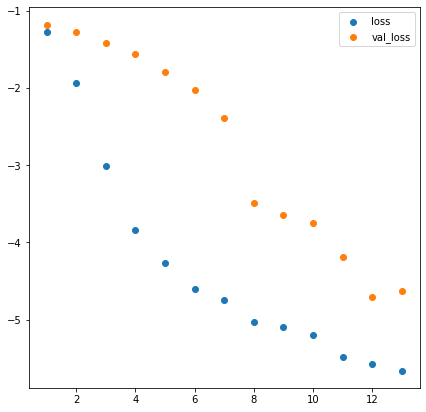

In [42]:
history_min = []
history_min_val = []

for this_history in history_all_13d:
    this_min = np.min(this_history.history['loss'])
    this_min_val = np.min(this_history.history['val_loss'])
    history_min.append(this_min)
    history_min_val.append(this_min_val)
plt.figure(figsize=(7,7))
plt.scatter(np.linspace(1,13,13),np.log(history_min)/np.log(10),label='loss')
plt.scatter(np.linspace(1,13,13),np.log(history_min_val)/np.log(10),label='val_loss')
plt.legend()
plt.show()


In [24]:
history_all_13d_save = []
for i in range(13):
    history_all_13d_save.append(history_all_13d[i].history["loss"])
    
    

In [63]:
history_all_13d_save_val = []
for i in range(13):
    print(i)
    all_autoencoder[i].optimizer.learning_rate = 10**(-3)
    this_autoencoder = all_autoencoder[i]
    
    this_hist  = this_autoencoder.fit(set_train_13d, set_train_13d, epochs = 2000, batch_size=100, shuffle=True, validation_data=(set_test_13d,set_test_13d))
    history_all_13d_save[i] += this_hist.history["loss"]
    history_all_13d_save_val.append(this_hist.history["val_loss"])
    

0
Epoch 1/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0523 - val_loss: 0.0859
Epoch 2/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0528 - val_loss: 0.0855
Epoch 3/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0522 - val_loss: 0.0849
Epoch 4/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0537 - val_loss: 0.0850
Epoch 5/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0538 - val_loss: 0.0844
Epoch 6/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0536 - val_loss: 0.0854
Epoch 7/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0522 - val_loss: 0.0852
Epoch 8/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0522 - val_loss: 0.0860
Epoch 9/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0524 - val_loss: 0.0860
Epoch 10/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0521 - val_loss: 0.0863
Epoch 11/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0528 - val_loss: 0.0858
Epoch 12/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/st

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0535 - val_loss: 0.0848
Epoch 136/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0553 - val_loss: 0.0847
Epoch 137/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0529 - val_loss: 0.0855
Epoch 138/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0534 - val_loss: 0.0841
Epoch 139/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0539 - val_loss: 0.0853
Epoch 140/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0525 - val_loss: 0.0847
Epoch 141/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0534 - val_loss: 0.0842
Epoch 142/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0519 - val_loss: 0.0857
Epoch 143/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0536 - val_loss: 0.0841
Epoch 144/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0536 - val_loss: 0.0848
Epoch 145/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0540 - val_loss: 0.0852
Epoch 146/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5m

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0530 - val_loss: 0.0841
Epoch 270/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0545 - val_loss: 0.0846
Epoch 271/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0521 - val_loss: 0.0856
Epoch 272/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0537 - val_loss: 0.0853
Epoch 273/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0529 - val_loss: 0.0843
Epoch 274/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0539 - val_loss: 0.0853
Epoch 275/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0540 - val_loss: 0.0837
Epoch 276/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0534 - val_loss: 0.0837
Epoch 277/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0529 - val_loss: 0.0847
Epoch 278/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0531 - val_loss: 0.0853
Epoch 279/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0547 - val_loss: 0.0866
Epoch 280/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5m

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0537 - val_loss: 0.0844
Epoch 404/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0535 - val_loss: 0.0849
Epoch 405/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0534 - val_loss: 0.0856
Epoch 406/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0528 - val_loss: 0.0853
Epoch 407/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0535 - val_loss: 0.0859
Epoch 408/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0546 - val_loss: 0.0851
Epoch 409/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0534 - val_loss: 0.0854
Epoch 410/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0527 - val_loss: 0.0860
Epoch 411/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0527 - val_loss: 0.0864
Epoch 412/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0533 - val_loss: 0.0851
Epoch 413/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0534 - val_loss: 0.0845
Epoch 414/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4m

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0530 - val_loss: 0.0844
Epoch 538/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0517 - val_loss: 0.0854
Epoch 539/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0539 - val_loss: 0.0846
Epoch 540/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0538 - val_loss: 0.0855
Epoch 541/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0527 - val_loss: 0.0860
Epoch 542/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0532 - val_loss: 0.0849
Epoch 543/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0533 - val_loss: 0.0854
Epoch 544/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0521 - val_loss: 0.0849
Epoch 545/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0526 - val_loss: 0.0842
Epoch 546/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0526 - val_loss: 0.0858
Epoch 547/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0526 - val_loss: 0.0853
Epoch 548/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4m

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0554 - val_loss: 0.0854
Epoch 672/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0526 - val_loss: 0.0855
Epoch 673/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0536 - val_loss: 0.0851
Epoch 674/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0526 - val_loss: 0.0856
Epoch 675/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0520 - val_loss: 0.0863
Epoch 676/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0533 - val_loss: 0.0852
Epoch 677/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0530 - val_loss: 0.0859
Epoch 678/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0538 - val_loss: 0.0858
Epoch 679/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0543 - val_loss: 0.0857
Epoch 680/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0536 - val_loss: 0.0862
Epoch 681/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0528 - val_loss: 0.0845
Epoch 682/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4m

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0534 - val_loss: 0.0862
Epoch 806/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0514 - val_loss: 0.0853
Epoch 807/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0524 - val_loss: 0.0852
Epoch 808/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0530 - val_loss: 0.0860
Epoch 809/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0543 - val_loss: 0.0848
Epoch 810/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0539 - val_loss: 0.0859
Epoch 811/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0532 - val_loss: 0.0844
Epoch 812/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0523 - val_loss: 0.0862
Epoch 813/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0525 - val_loss: 0.0856
Epoch 814/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0521 - val_loss: 0.0861
Epoch 815/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0528 - val_loss: 0.0856
Epoch 816/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4m

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0530 - val_loss: 0.0860
Epoch 940/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0524 - val_loss: 0.0854
Epoch 941/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0530 - val_loss: 0.0867
Epoch 942/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0530 - val_loss: 0.0859
Epoch 943/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0519 - val_loss: 0.0868
Epoch 944/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0534 - val_loss: 0.0857
Epoch 945/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0515 - val_loss: 0.0863
Epoch 946/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0531 - val_loss: 0.0865
Epoch 947/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0519 - val_loss: 0.0857
Epoch 948/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0526 - val_loss: 0.0864
Epoch 949/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0544 - val_loss: 0.0851
Epoch 950/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5m

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0523 - val_loss: 0.0851
Epoch 1073/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0537 - val_loss: 0.0860
Epoch 1074/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0528 - val_loss: 0.0859
Epoch 1075/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0547 - val_loss: 0.0840
Epoch 1076/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0536 - val_loss: 0.0862
Epoch 1077/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0523 - val_loss: 0.0849
Epoch 1078/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0541 - val_loss: 0.0850
Epoch 1079/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0531 - val_loss: 0.0855
Epoch 1080/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0517 - val_loss: 0.0854
Epoch 1081/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0537 - val_loss: 0.0851
Epoch 1082/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0541 - val_loss: 0.0857
Epoch 1083/2000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0539 - val_loss: 0.0846
Epoch 1205/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0532 - val_loss: 0.0871
Epoch 1206/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0526 - val_loss: 0.0852
Epoch 1207/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0535 - val_loss: 0.0862
Epoch 1208/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0523 - val_loss: 0.0860
Epoch 1209/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0531 - val_loss: 0.0861
Epoch 1210/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0531 - val_loss: 0.0865
Epoch 1211/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0548 - val_loss: 0.0853
Epoch 1212/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0541 - val_loss: 0.0854
Epoch 1213/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0528 - val_loss: 0.0856
Epoch 1214/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0538 - val_loss: 0.0849
Epoch 1215/2000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0537 - val_loss: 0.0855
Epoch 1337/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0522 - val_loss: 0.0859
Epoch 1338/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0549 - val_loss: 0.0844
Epoch 1339/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0532 - val_loss: 0.0853
Epoch 1340/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0539 - val_loss: 0.0847
Epoch 1341/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0527 - val_loss: 0.0857
Epoch 1342/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0510 - val_loss: 0.0847
Epoch 1343/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0534 - val_loss: 0.0861
Epoch 1344/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0536 - val_loss: 0.0873
Epoch 1345/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0542 - val_loss: 0.0850
Epoch 1346/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0530 - val_loss: 0.0853
Epoch 1347/2000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0530 - val_loss: 0.0863
Epoch 1469/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0529 - val_loss: 0.0861
Epoch 1470/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0531 - val_loss: 0.0861
Epoch 1471/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0531 - val_loss: 0.0858
Epoch 1472/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0526 - val_loss: 0.0858
Epoch 1473/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0532 - val_loss: 0.0856
Epoch 1474/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0524 - val_loss: 0.0862
Epoch 1475/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0518 - val_loss: 0.0859
Epoch 1476/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0514 - val_loss: 0.0856
Epoch 1477/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0537 - val_loss: 0.0863
Epoch 1478/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0539 - val_loss: 0.0871
Epoch 1479/2000
38/38 ━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0521 - val_loss: 0.0865
Epoch 1601/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0519 - val_loss: 0.0865
Epoch 1602/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0531 - val_loss: 0.0851
Epoch 1603/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0527 - val_loss: 0.0867
Epoch 1604/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0537 - val_loss: 0.0862
Epoch 1605/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0524 - val_loss: 0.0862
Epoch 1606/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0522 - val_loss: 0.0867
Epoch 1607/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0545 - val_loss: 0.0863
Epoch 1608/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0533 - val_loss: 0.0868
Epoch 1609/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0528 - val_loss: 0.0864
Epoch 1610/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0521 - val_loss: 0.0868
Epoch 1611/2000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0535 - val_loss: 0.0863
Epoch 1733/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0530 - val_loss: 0.0844
Epoch 1734/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0539 - val_loss: 0.0861
Epoch 1735/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0519 - val_loss: 0.0867
Epoch 1736/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0522 - val_loss: 0.0864
Epoch 1737/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0533 - val_loss: 0.0859
Epoch 1738/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0535 - val_loss: 0.0862
Epoch 1739/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0521 - val_loss: 0.0861
Epoch 1740/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0529 - val_loss: 0.0865
Epoch 1741/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0529 - val_loss: 0.0852
Epoch 1742/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0526 - val_loss: 0.0857
Epoch 1743/2000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0525 - val_loss: 0.0859
Epoch 1865/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0533 - val_loss: 0.0866
Epoch 1866/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0530 - val_loss: 0.0873
Epoch 1867/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0545 - val_loss: 0.0866
Epoch 1868/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0523 - val_loss: 0.0856
Epoch 1869/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0514 - val_loss: 0.0864
Epoch 1870/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0536 - val_loss: 0.0852
Epoch 1871/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0533 - val_loss: 0.0878
Epoch 1872/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0534 - val_loss: 0.0866
Epoch 1873/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0522 - val_loss: 0.0857
Epoch 1874/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0531 - val_loss: 0.0860
Epoch 1875/2000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0516 - val_loss: 0.0861
Epoch 1997/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0528 - val_loss: 0.0866
Epoch 1998/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0512 - val_loss: 0.0865
Epoch 1999/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0526 - val_loss: 0.0865
Epoch 2000/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0522 - val_loss: 0.0867
1
Epoch 1/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0118 - val_loss: 0.0889
Epoch 2/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0120 - val_loss: 0.0882
Epoch 3/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0121 - val_loss: 0.0900
Epoch 4/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0121 - val_loss: 0.0906
Epoch 5/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0122 - val_loss: 0.0892
Epoch 6/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0118 - val_loss: 0.0885
Epoch 7/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0116 - val_loss: 0.0890
Epoch 131/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0116 - val_loss: 0.0889
Epoch 132/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0119 - val_loss: 0.0892
Epoch 133/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0118 - val_loss: 0.0898
Epoch 134/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0120 - val_loss: 0.0891
Epoch 135/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0120 - val_loss: 0.0895
Epoch 136/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0118 - val_loss: 0.0897
Epoch 137/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0120 - val_loss: 0.0875
Epoch 138/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0120 - val_loss: 0.0903
Epoch 139/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0123 - val_loss: 0.0897
Epoch 140/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0121 - val_loss: 0.0895
Epoch 141/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4m

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0121 - val_loss: 0.0894
Epoch 265/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0121 - val_loss: 0.0885
Epoch 266/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0116 - val_loss: 0.0892
Epoch 267/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0118 - val_loss: 0.0897
Epoch 268/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0115 - val_loss: 0.0891
Epoch 269/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0117 - val_loss: 0.0904
Epoch 270/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0117 - val_loss: 0.0897
Epoch 271/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0121 - val_loss: 0.0890
Epoch 272/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0123 - val_loss: 0.0893
Epoch 273/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0123 - val_loss: 0.0888
Epoch 274/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0123 - val_loss: 0.0886
Epoch 275/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4m

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0118 - val_loss: 0.0882
Epoch 399/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0118 - val_loss: 0.0883
Epoch 400/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0113 - val_loss: 0.0890
Epoch 401/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0117 - val_loss: 0.0886
Epoch 402/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0121 - val_loss: 0.0891
Epoch 403/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0119 - val_loss: 0.0878
Epoch 404/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0118 - val_loss: 0.0885
Epoch 405/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0115 - val_loss: 0.0879
Epoch 406/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0115 - val_loss: 0.0891
Epoch 407/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0118 - val_loss: 0.0884
Epoch 408/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0116 - val_loss: 0.0893
Epoch 409/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4m

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0119 - val_loss: 0.0893
Epoch 533/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0119 - val_loss: 0.0896
Epoch 534/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0114 - val_loss: 0.0892
Epoch 535/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0119 - val_loss: 0.0884
Epoch 536/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0119 - val_loss: 0.0889
Epoch 537/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0118 - val_loss: 0.0888
Epoch 538/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0116 - val_loss: 0.0900
Epoch 539/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0121 - val_loss: 0.0888
Epoch 540/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0117 - val_loss: 0.0891
Epoch 541/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0124 - val_loss: 0.0887
Epoch 542/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0127 - val_loss: 0.0892
Epoch 543/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4m

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0118 - val_loss: 0.0881
Epoch 667/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0118 - val_loss: 0.0883
Epoch 668/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0121 - val_loss: 0.0897
Epoch 669/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0116 - val_loss: 0.0898
Epoch 670/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0120 - val_loss: 0.0889
Epoch 671/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0118 - val_loss: 0.0895
Epoch 672/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0119 - val_loss: 0.0888
Epoch 673/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0116 - val_loss: 0.0903
Epoch 674/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0119 - val_loss: 0.0885
Epoch 675/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0118 - val_loss: 0.0902
Epoch 676/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0119 - val_loss: 0.0894
Epoch 677/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4m

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0114 - val_loss: 0.0887
Epoch 801/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0119 - val_loss: 0.0891
Epoch 802/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0115 - val_loss: 0.0890
Epoch 803/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0123 - val_loss: 0.0878
Epoch 804/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0120 - val_loss: 0.0894
Epoch 805/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0115 - val_loss: 0.0900
Epoch 806/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0118 - val_loss: 0.0901
Epoch 807/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0117 - val_loss: 0.0908
Epoch 808/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0116 - val_loss: 0.0892
Epoch 809/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0115 - val_loss: 0.0896
Epoch 810/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0115 - val_loss: 0.0888
Epoch 811/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4m

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0113 - val_loss: 0.0890
Epoch 935/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0116 - val_loss: 0.0880
Epoch 936/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0112 - val_loss: 0.0883
Epoch 937/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0111 - val_loss: 0.0888
Epoch 938/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0119 - val_loss: 0.0894
Epoch 939/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0119 - val_loss: 0.0887
Epoch 940/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0117 - val_loss: 0.0891
Epoch 941/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0115 - val_loss: 0.0890
Epoch 942/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0114 - val_loss: 0.0896
Epoch 943/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0114 - val_loss: 0.0895
Epoch 944/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0113 - val_loss: 0.0883
Epoch 945/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4m

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0116 - val_loss: 0.0893
Epoch 1068/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0113 - val_loss: 0.0893
Epoch 1069/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0113 - val_loss: 0.0893
Epoch 1070/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0119 - val_loss: 0.0900
Epoch 1071/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0121 - val_loss: 0.0889
Epoch 1072/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0114 - val_loss: 0.0879
Epoch 1073/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0115 - val_loss: 0.0893
Epoch 1074/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0114 - val_loss: 0.0893
Epoch 1075/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0115 - val_loss: 0.0887
Epoch 1076/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0115 - val_loss: 0.0903
Epoch 1077/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0119 - val_loss: 0.0884
Epoch 1078/2000
38/38 ━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0112 - val_loss: 0.0897
Epoch 1200/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0113 - val_loss: 0.0888
Epoch 1201/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0111 - val_loss: 0.0885
Epoch 1202/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0115 - val_loss: 0.0890
Epoch 1203/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0119 - val_loss: 0.0886
Epoch 1204/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0118 - val_loss: 0.0896
Epoch 1205/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0114 - val_loss: 0.0898
Epoch 1206/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0115 - val_loss: 0.0899
Epoch 1207/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0113 - val_loss: 0.0891
Epoch 1208/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0113 - val_loss: 0.0895
Epoch 1209/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0114 - val_loss: 0.0891
Epoch 1210/2000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0119 - val_loss: 0.0900
Epoch 1332/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0115 - val_loss: 0.0899
Epoch 1333/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0111 - val_loss: 0.0882
Epoch 1334/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0115 - val_loss: 0.0892
Epoch 1335/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0110 - val_loss: 0.0891
Epoch 1336/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0114 - val_loss: 0.0887
Epoch 1337/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0121 - val_loss: 0.0890
Epoch 1338/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0114 - val_loss: 0.0885
Epoch 1339/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0112 - val_loss: 0.0896
Epoch 1340/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0117 - val_loss: 0.0899
Epoch 1341/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0115 - val_loss: 0.0899
Epoch 1342/2000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0118 - val_loss: 0.0894
Epoch 1464/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0112 - val_loss: 0.0897
Epoch 1465/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0115 - val_loss: 0.0891
Epoch 1466/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0110 - val_loss: 0.0882
Epoch 1467/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0112 - val_loss: 0.0888
Epoch 1468/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0112 - val_loss: 0.0886
Epoch 1469/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0113 - val_loss: 0.0885
Epoch 1470/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0107 - val_loss: 0.0900
Epoch 1471/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0113 - val_loss: 0.0897
Epoch 1472/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0114 - val_loss: 0.0893
Epoch 1473/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0113 - val_loss: 0.0890
Epoch 1474/2000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0111 - val_loss: 0.0894
Epoch 1596/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 964us/step - loss: 0.0117 - val_loss: 0.0893
Epoch 1597/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0114 - val_loss: 0.0898
Epoch 1598/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0114 - val_loss: 0.0895
Epoch 1599/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0112 - val_loss: 0.0886
Epoch 1600/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0112 - val_loss: 0.0891
Epoch 1601/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0115 - val_loss: 0.0887
Epoch 1602/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0112 - val_loss: 0.0890
Epoch 1603/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0109 - val_loss: 0.0885
Epoch 1604/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0108 - val_loss: 0.0879
Epoch 1605/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0113 - val_loss: 0.0895
Epoch 1606/2000
38/38 ━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0115 - val_loss: 0.0886
Epoch 1728/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0114 - val_loss: 0.0878
Epoch 1729/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0110 - val_loss: 0.0884
Epoch 1730/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0113 - val_loss: 0.0890
Epoch 1731/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0111 - val_loss: 0.0895
Epoch 1732/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0112 - val_loss: 0.0888
Epoch 1733/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0108 - val_loss: 0.0895
Epoch 1734/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0107 - val_loss: 0.0887
Epoch 1735/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0112 - val_loss: 0.0897
Epoch 1736/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0111 - val_loss: 0.0886
Epoch 1737/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0110 - val_loss: 0.0901
Epoch 1738/2000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0109 - val_loss: 0.0901
Epoch 1860/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0109 - val_loss: 0.0883
Epoch 1861/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0111 - val_loss: 0.0895
Epoch 1862/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0108 - val_loss: 0.0895
Epoch 1863/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0110 - val_loss: 0.0893
Epoch 1864/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0110 - val_loss: 0.0892
Epoch 1865/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0109 - val_loss: 0.0890
Epoch 1866/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0112 - val_loss: 0.0897
Epoch 1867/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0114 - val_loss: 0.0890
Epoch 1868/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0114 - val_loss: 0.0894
Epoch 1869/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0111 - val_loss: 0.0892
Epoch 1870/2000
38/38 ━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0109 - val_loss: 0.0885
Epoch 1992/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0112 - val_loss: 0.0892
Epoch 1993/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0111 - val_loss: 0.0899
Epoch 1994/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0112 - val_loss: 0.0890
Epoch 1995/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0109 - val_loss: 0.0908
Epoch 1996/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0110 - val_loss: 0.0892
Epoch 1997/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0113 - val_loss: 0.0878
Epoch 1998/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0112 - val_loss: 0.0888
Epoch 1999/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0114 - val_loss: 0.0898
Epoch 2000/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0115 - val_loss: 0.0895
2
Epoch 1/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0628
Epoch 2/2000
38/38 ━━━━━━━━━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0631
Epoch 126/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0012 - val_loss: 0.0635
Epoch 127/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0013 - val_loss: 0.0628
Epoch 128/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0013 - val_loss: 0.0633
Epoch 129/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0632
Epoch 130/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0633
Epoch 131/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0630
Epoch 132/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0633
Epoch 133/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0626
Epoch 134/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0627
Epoch 135/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0629
Epoch 136/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4m

Epoch 259/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0010 - val_loss: 0.0631
Epoch 260/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0627
Epoch 261/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0635
Epoch 262/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0012 - val_loss: 0.0632
Epoch 263/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0626
Epoch 264/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0629
Epoch 265/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0628
Epoch 266/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0630
Epoch 267/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0630
Epoch 268/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0632
Epoch 269/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0628
Epoch 270/2000
38/38 ━━━━━━━━━━━

Epoch 326/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1804e-04 - val_loss: 0.0631
Epoch 327/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7487e-04 - val_loss: 0.0633
Epoch 328/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4972e-04 - val_loss: 0.0632
Epoch 329/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5398e-04 - val_loss: 0.0630
Epoch 330/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2222e-04 - val_loss: 0.0631
Epoch 331/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0630
Epoch 332/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0630
Epoch 333/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0626
Epoch 334/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0632
Epoch 335/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0631
Epoch 336/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0012 - val_loss: 0.0632
Epoch 337/20

Epoch 459/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0632
Epoch 460/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0011 - val_loss: 0.0631
Epoch 461/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0010 - val_loss: 0.0625
Epoch 462/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0011 - val_loss: 0.0625
Epoch 463/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0631
Epoch 464/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0629
Epoch 465/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0010 - val_loss: 0.0630
Epoch 466/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0634
Epoch 467/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0012 - val_loss: 0.0627
Epoch 468/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0012 - val_loss: 0.0631
Epoch 469/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0012 - val_loss: 0.0631
Epoch 470/2000
38/38 ━━━━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0631
Epoch 592/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0010 - val_loss: 0.0629
Epoch 593/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0010 - val_loss: 0.0631
Epoch 594/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0630
Epoch 595/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0011 - val_loss: 0.0634
Epoch 596/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0011 - val_loss: 0.0625
Epoch 597/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0011 - val_loss: 0.0632
Epoch 598/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0011 - val_loss: 0.0630
Epoch 599/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0011 - val_loss: 0.0628
Epoch 600/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0630
Epoch 601/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0629
Epoch 602/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4m

Epoch 658/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.9861e-04 - val_loss: 0.0630
Epoch 659/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.8360e-04 - val_loss: 0.0629
Epoch 660/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6766e-04 - val_loss: 0.0629
Epoch 661/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2253e-04 - val_loss: 0.0633
Epoch 662/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.2533e-04 - val_loss: 0.0632
Epoch 663/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.8752e-04 - val_loss: 0.0632
Epoch 664/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.2603e-04 - val_loss: 0.0631
Epoch 665/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.3750e-04 - val_loss: 0.0630
Epoch 666/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.3674e-04 - val_loss: 0.0633
Epoch 667/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0011 - val_loss: 0.0629
Epoch 668/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0629
Epoch 791/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0630
Epoch 792/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0638
Epoch 793/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0635
Epoch 794/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0635
Epoch 795/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0011 - val_loss: 0.0632
Epoch 796/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0011 - val_loss: 0.0631
Epoch 797/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0628
Epoch 798/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0010 - val_loss: 0.0631
Epoch 799/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0010 - val_loss: 0.0629
Epoch 800/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0635
Epoch 801/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4m

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0630
Epoch 923/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6308e-04 - val_loss: 0.0630
Epoch 924/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.5013e-04 - val_loss: 0.0633
Epoch 925/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0010 - val_loss: 0.0631
Epoch 926/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.7428e-04 - val_loss: 0.0632
Epoch 927/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0625
Epoch 928/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8500e-04 - val_loss: 0.0632
Epoch 929/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0010 - val_loss: 0.0630
Epoch 930/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0011 - val_loss: 0.0633
Epoch 931/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0628
Epoch 932/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.7121e-04 - val_loss: 0.0631
Epoch 933/2000
38/38 ━━━━━━

Epoch 1054/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0011 - val_loss: 0.0630
Epoch 1055/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0010 - val_loss: 0.0630
Epoch 1056/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0010 - val_loss: 0.0633
Epoch 1057/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0633
Epoch 1058/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0011 - val_loss: 0.0631
Epoch 1059/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0629
Epoch 1060/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0010 - val_loss: 0.0631
Epoch 1061/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0010 - val_loss: 0.0630
Epoch 1062/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0013 - val_loss: 0.0629
Epoch 1063/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0012 - val_loss: 0.0632
Epoch 1064/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0630
Epoch 1065/2000
38/38

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6181e-04 - val_loss: 0.0630
Epoch 1185/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 9.5404e-04 - val_loss: 0.0629
Epoch 1186/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3950e-04 - val_loss: 0.0633
Epoch 1187/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5561e-04 - val_loss: 0.0629
Epoch 1188/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0010 - val_loss: 0.0628
Epoch 1189/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.8302e-04 - val_loss: 0.0634
Epoch 1190/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0011 - val_loss: 0.0633
Epoch 1191/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0010 - val_loss: 0.0634
Epoch 1192/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.7454e-04 - val_loss: 0.0634
Epoch 1193/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.6133e-04 - val_loss: 0.0635
Epoch 1194/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.2989e-04 - val_loss: 0.0632
Epoch

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.9059e-04 - val_loss: 0.0635
Epoch 1315/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.7864e-04 - val_loss: 0.0630
Epoch 1316/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3296e-04 - val_loss: 0.0627
Epoch 1317/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3743e-04 - val_loss: 0.0632
Epoch 1318/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.3926e-04 - val_loss: 0.0632
Epoch 1319/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.9150e-04 - val_loss: 0.0630
Epoch 1320/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.4806e-04 - val_loss: 0.0631
Epoch 1321/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.7869e-04 - val_loss: 0.0632
Epoch 1322/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.5628e-04 - val_loss: 0.0634
Epoch 1323/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.8826e-04 - val_loss: 0.0634
Epoch 1324/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.06

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1566e-04 - val_loss: 0.0632
Epoch 1445/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.9575e-04 - val_loss: 0.0632
Epoch 1446/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3906e-04 - val_loss: 0.0634
Epoch 1447/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.7745e-04 - val_loss: 0.0635
Epoch 1448/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.5667e-04 - val_loss: 0.0635
Epoch 1449/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.6575e-04 - val_loss: 0.0632
Epoch 1450/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.4416e-04 - val_loss: 0.0634
Epoch 1451/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5519e-04 - val_loss: 0.0633
Epoch 1452/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.0364e-04 - val_loss: 0.0633
Epoch 1453/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5553e-04 - val_loss: 0.0631
Epoch 1454/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.6269e-04 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.3318e-04 - val_loss: 0.0636
Epoch 1575/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.5265e-04 - val_loss: 0.0629
Epoch 1576/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4452e-04 - val_loss: 0.0632
Epoch 1577/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.3513e-04 - val_loss: 0.0633
Epoch 1578/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.7835e-04 - val_loss: 0.0632
Epoch 1579/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.6776e-04 - val_loss: 0.0632
Epoch 1580/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.0213e-04 - val_loss: 0.0630
Epoch 1581/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1857e-04 - val_loss: 0.0632
Epoch 1582/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3262e-04 - val_loss: 0.0630
Epoch 1583/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.4020e-04 - val_loss: 0.0636
Epoch 1584/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4157e-04 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9571e-04 - val_loss: 0.0631
Epoch 1705/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8413e-04 - val_loss: 0.0632
Epoch 1706/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1976e-04 - val_loss: 0.0632
Epoch 1707/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2278e-04 - val_loss: 0.0633
Epoch 1708/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1275e-04 - val_loss: 0.0631
Epoch 1709/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5764e-04 - val_loss: 0.0631
Epoch 1710/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0010 - val_loss: 0.0631
Epoch 1711/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0631
Epoch 1712/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0633
Epoch 1713/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0631
Epoch 1714/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0628
Epoch 1715/20

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.9774e-04 - val_loss: 0.0634
Epoch 1835/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0632
Epoch 1836/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5435e-04 - val_loss: 0.0629
Epoch 1837/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.0564e-04 - val_loss: 0.0637
Epoch 1838/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.7640e-04 - val_loss: 0.0631
Epoch 1839/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0631
Epoch 1840/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.6024e-04 - val_loss: 0.0626
Epoch 1841/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.3188e-04 - val_loss: 0.0631
Epoch 1842/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0637
Epoch 1843/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.9602e-04 - val_loss: 0.0633
Epoch 1844/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.3564e-04 - val_loss: 0.0637
Epoch

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.4605e-04 - val_loss: 0.0632
Epoch 1900/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.9497e-04 - val_loss: 0.0629
Epoch 1901/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.8536e-04 - val_loss: 0.0630
Epoch 1902/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6321e-04 - val_loss: 0.0634
Epoch 1903/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9296e-04 - val_loss: 0.0631
Epoch 1904/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.5983e-04 - val_loss: 0.0628
Epoch 1905/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0011 - val_loss: 0.0634
Epoch 1906/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0629
Epoch 1907/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0011 - val_loss: 0.0628
Epoch 1908/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0010 - val_loss: 0.0627
Epoch 1909/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8697e-04 - val_loss: 0.0632
Epoch 191

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.8509e-04 - val_loss: 0.0630
Epoch 1965/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.7015e-04 - val_loss: 0.0634
Epoch 1966/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.5175e-04 - val_loss: 0.0639
Epoch 1967/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.6127e-04 - val_loss: 0.0632
Epoch 1968/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.5559e-04 - val_loss: 0.0629
Epoch 1969/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0010 - val_loss: 0.0633
Epoch 1970/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.9502e-04 - val_loss: 0.0627
Epoch 1971/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7088e-04 - val_loss: 0.0632
Epoch 1972/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.5621e-04 - val_loss: 0.0633
Epoch 1973/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3065e-04 - val_loss: 0.0624
Epoch 1974/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1792e-04 - val_loss: 0.06

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.8008e-04 - val_loss: 0.0422
Epoch 95/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4890e-04 - val_loss: 0.0421
Epoch 96/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.3604e-04 - val_loss: 0.0422
Epoch 97/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5370e-04 - val_loss: 0.0422
Epoch 98/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4708e-04 - val_loss: 0.0422
Epoch 99/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7579e-04 - val_loss: 0.0423
Epoch 100/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7231e-04 - val_loss: 0.0422
Epoch 101/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7567e-04 - val_loss: 0.0422
Epoch 102/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.8350e-04 - val_loss: 0.0424
Epoch 103/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8966e-04 - val_loss: 0.0424
Epoch 104/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.9207e-04 - val_loss: 0.0425
Epoch 10

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8084e-04 - val_loss: 0.0422
Epoch 225/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6545e-04 - val_loss: 0.0425
Epoch 226/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7651e-04 - val_loss: 0.0421
Epoch 227/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7372e-04 - val_loss: 0.0424
Epoch 228/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7030e-04 - val_loss: 0.0422
Epoch 229/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6131e-04 - val_loss: 0.0422
Epoch 230/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7776e-04 - val_loss: 0.0425
Epoch 231/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8373e-04 - val_loss: 0.0424
Epoch 232/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8529e-04 - val_loss: 0.0423
Epoch 233/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0679e-04 - val_loss: 0.0422
Epoch 234/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9298e-04 - val_loss: 0.0423
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2152e-04 - val_loss: 0.0422
Epoch 355/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3013e-04 - val_loss: 0.0421
Epoch 356/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1668e-04 - val_loss: 0.0424
Epoch 357/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1286e-04 - val_loss: 0.0422
Epoch 358/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1237e-04 - val_loss: 0.0421
Epoch 359/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9141e-04 - val_loss: 0.0424
Epoch 360/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7954e-04 - val_loss: 0.0421
Epoch 361/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6534e-04 - val_loss: 0.0423
Epoch 362/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4757e-04 - val_loss: 0.0421
Epoch 363/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.4224e-04 - val_loss: 0.0423
Epoch 364/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4699e-04 - val_loss: 0.0423
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9343e-04 - val_loss: 0.0423
Epoch 485/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8603e-04 - val_loss: 0.0424
Epoch 486/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 1.8120e-04 - val_loss: 0.0422
Epoch 487/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1.6469e-04 - val_loss: 0.0423
Epoch 488/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.7756e-04 - val_loss: 0.0422
Epoch 489/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7443e-04 - val_loss: 0.0422
Epoch 490/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 1.7998e-04 - val_loss: 0.0421
Epoch 491/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 1.7563e-04 - val_loss: 0.0423
Epoch 492/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7101e-04 - val_loss: 0.0422
Epoch 493/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.6471e-04 - val_loss: 0.0421
Epoch 494/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7804e-04 - val_loss: 0.0421
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4883e-04 - val_loss: 0.0421
Epoch 615/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.6113e-04 - val_loss: 0.0422
Epoch 616/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.6266e-04 - val_loss: 0.0422
Epoch 617/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4758e-04 - val_loss: 0.0423
Epoch 618/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4626e-04 - val_loss: 0.0421
Epoch 619/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.6524e-04 - val_loss: 0.0421
Epoch 620/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.6122e-04 - val_loss: 0.0420
Epoch 621/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.5759e-04 - val_loss: 0.0422
Epoch 622/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.5312e-04 - val_loss: 0.0424
Epoch 623/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.6116e-04 - val_loss: 0.0420
Epoch 624/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.6431e-04 - val_loss: 0.0422
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.6961e-04 - val_loss: 0.0420
Epoch 745/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.5183e-04 - val_loss: 0.0423
Epoch 746/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.5091e-04 - val_loss: 0.0422
Epoch 747/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3201e-04 - val_loss: 0.0421
Epoch 748/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4272e-04 - val_loss: 0.0422
Epoch 749/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4584e-04 - val_loss: 0.0423
Epoch 750/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.5322e-04 - val_loss: 0.0422
Epoch 751/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.5240e-04 - val_loss: 0.0421
Epoch 752/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.5861e-04 - val_loss: 0.0423
Epoch 753/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.6374e-04 - val_loss: 0.0422
Epoch 754/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.5807e-04 - val_loss: 0.0423
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.1257e-04 - val_loss: 0.0420
Epoch 875/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.0566e-04 - val_loss: 0.0421
Epoch 876/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.8135e-04 - val_loss: 0.0420
Epoch 877/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.7502e-04 - val_loss: 0.0426
Epoch 878/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.8125e-04 - val_loss: 0.0422
Epoch 879/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.7005e-04 - val_loss: 0.0422
Epoch 880/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.7566e-04 - val_loss: 0.0422
Epoch 881/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.7290e-04 - val_loss: 0.0421
Epoch 882/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.0835e-04 - val_loss: 0.0420
Epoch 883/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.2101e-04 - val_loss: 0.0424
Epoch 884/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.2352e-04 - val_loss: 0.0421
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7770e-04 - val_loss: 0.0424
Epoch 1005/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7710e-04 - val_loss: 0.0422
Epoch 1006/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6810e-04 - val_loss: 0.0422
Epoch 1007/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.8881e-04 - val_loss: 0.0422
Epoch 1008/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.9867e-04 - val_loss: 0.0424
Epoch 1009/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9754e-04 - val_loss: 0.0423
Epoch 1010/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7855e-04 - val_loss: 0.0425
Epoch 1011/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7343e-04 - val_loss: 0.0422
Epoch 1012/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5400e-04 - val_loss: 0.0422
Epoch 1013/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5125e-04 - val_loss: 0.0421
Epoch 1014/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4620e-04 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9806e-04 - val_loss: 0.0425
Epoch 1133/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8330e-04 - val_loss: 0.0422
Epoch 1134/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6553e-04 - val_loss: 0.0422
Epoch 1135/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6434e-04 - val_loss: 0.0423
Epoch 1136/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7225e-04 - val_loss: 0.0422
Epoch 1137/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7118e-04 - val_loss: 0.0422
Epoch 1138/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7689e-04 - val_loss: 0.0422
Epoch 1139/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.8816e-04 - val_loss: 0.0422
Epoch 1140/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7796e-04 - val_loss: 0.0423
Epoch 1141/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6072e-04 - val_loss: 0.0421
Epoch 1142/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5236e-04 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6325e-04 - val_loss: 0.0422
Epoch 1261/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6246e-04 - val_loss: 0.0423
Epoch 1262/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9467e-04 - val_loss: 0.0421
Epoch 1263/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8429e-04 - val_loss: 0.0424
Epoch 1264/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6243e-04 - val_loss: 0.0422
Epoch 1265/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6652e-04 - val_loss: 0.0423
Epoch 1266/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6821e-04 - val_loss: 0.0421
Epoch 1267/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7714e-04 - val_loss: 0.0422
Epoch 1268/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7426e-04 - val_loss: 0.0422
Epoch 1269/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8069e-04 - val_loss: 0.0421
Epoch 1270/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7918e-04 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 1.7672e-04 - val_loss: 0.0421
Epoch 1389/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7472e-04 - val_loss: 0.0422
Epoch 1390/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7103e-04 - val_loss: 0.0423
Epoch 1391/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8231e-04 - val_loss: 0.0422
Epoch 1392/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8717e-04 - val_loss: 0.0421
Epoch 1393/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9732e-04 - val_loss: 0.0420
Epoch 1394/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9245e-04 - val_loss: 0.0423
Epoch 1395/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8073e-04 - val_loss: 0.0420
Epoch 1396/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6979e-04 - val_loss: 0.0422
Epoch 1397/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5809e-04 - val_loss: 0.0423
Epoch 1398/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5905e-04 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.8644e-04 - val_loss: 0.0422
Epoch 1517/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7394e-04 - val_loss: 0.0422
Epoch 1518/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.8727e-04 - val_loss: 0.0420
Epoch 1519/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7930e-04 - val_loss: 0.0422
Epoch 1520/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8592e-04 - val_loss: 0.0421
Epoch 1521/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7129e-04 - val_loss: 0.0420
Epoch 1522/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6924e-04 - val_loss: 0.0422
Epoch 1523/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5070e-04 - val_loss: 0.0421
Epoch 1524/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4635e-04 - val_loss: 0.0421
Epoch 1525/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4408e-04 - val_loss: 0.0421
Epoch 1526/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3895e-04 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5943e-04 - val_loss: 0.0423
Epoch 1645/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6235e-04 - val_loss: 0.0420
Epoch 1646/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5669e-04 - val_loss: 0.0420
Epoch 1647/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7178e-04 - val_loss: 0.0420
Epoch 1648/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6362e-04 - val_loss: 0.0419
Epoch 1649/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6459e-04 - val_loss: 0.0420
Epoch 1650/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6124e-04 - val_loss: 0.0422
Epoch 1651/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7474e-04 - val_loss: 0.0421
Epoch 1652/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7400e-04 - val_loss: 0.0421
Epoch 1653/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.6271e-04 - val_loss: 0.0420
Epoch 1654/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4887e-04 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5455e-04 - val_loss: 0.0422
Epoch 1773/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6082e-04 - val_loss: 0.0420
Epoch 1774/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7701e-04 - val_loss: 0.0420
Epoch 1775/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8155e-04 - val_loss: 0.0422
Epoch 1776/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8391e-04 - val_loss: 0.0422
Epoch 1777/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6608e-04 - val_loss: 0.0419
Epoch 1778/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6290e-04 - val_loss: 0.0422
Epoch 1779/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4973e-04 - val_loss: 0.0422
Epoch 1780/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4528e-04 - val_loss: 0.0420
Epoch 1781/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3541e-04 - val_loss: 0.0420
Epoch 1782/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.3913e-04 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6678e-04 - val_loss: 0.0422
Epoch 1901/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6678e-04 - val_loss: 0.0421
Epoch 1902/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7822e-04 - val_loss: 0.0421
Epoch 1903/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7058e-04 - val_loss: 0.0422
Epoch 1904/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6004e-04 - val_loss: 0.0420
Epoch 1905/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5026e-04 - val_loss: 0.0422
Epoch 1906/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4438e-04 - val_loss: 0.0421
Epoch 1907/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2773e-04 - val_loss: 0.0420
Epoch 1908/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1826e-04 - val_loss: 0.0422
Epoch 1909/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2516e-04 - val_loss: 0.0420
Epoch 1910/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3736e-04 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4538e-05 - val_loss: 0.0229
Epoch 30/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.6585e-05 - val_loss: 0.0230
Epoch 31/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7232e-05 - val_loss: 0.0229
Epoch 32/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6483e-05 - val_loss: 0.0229
Epoch 33/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5948e-05 - val_loss: 0.0229
Epoch 34/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.4705e-05 - val_loss: 0.0227
Epoch 35/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7521e-05 - val_loss: 0.0228
Epoch 36/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5286e-05 - val_loss: 0.0230
Epoch 37/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.6430e-05 - val_loss: 0.0229
Epoch 38/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0371e-05 - val_loss: 0.0230
Epoch 39/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.9500e-05 - val_loss: 0.0228
Epoch 40/2000

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5928e-05 - val_loss: 0.0230
Epoch 160/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.6843e-05 - val_loss: 0.0228
Epoch 161/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.5973e-05 - val_loss: 0.0229
Epoch 162/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.8430e-05 - val_loss: 0.0229
Epoch 163/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.0125e-04 - val_loss: 0.0229
Epoch 164/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.7709e-05 - val_loss: 0.0229
Epoch 165/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.1087e-05 - val_loss: 0.0229
Epoch 166/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.8391e-05 - val_loss: 0.0229
Epoch 167/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0088e-05 - val_loss: 0.0228
Epoch 168/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.8817e-05 - val_loss: 0.0229
Epoch 169/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7566e-05 - val_loss: 0.0229
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4962e-05 - val_loss: 0.0230
Epoch 290/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.1447e-05 - val_loss: 0.0229
Epoch 291/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.7922e-05 - val_loss: 0.0229
Epoch 292/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9006e-05 - val_loss: 0.0229
Epoch 293/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3831e-05 - val_loss: 0.0229
Epoch 294/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7869e-05 - val_loss: 0.0228
Epoch 295/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.4839e-05 - val_loss: 0.0229
Epoch 296/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.4234e-05 - val_loss: 0.0230
Epoch 297/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.7221e-05 - val_loss: 0.0229
Epoch 298/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.1536e-05 - val_loss: 0.0229
Epoch 299/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8929e-05 - val_loss: 0.0229
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1999e-05 - val_loss: 0.0229
Epoch 420/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5893e-05 - val_loss: 0.0228
Epoch 421/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.7300e-05 - val_loss: 0.0229
Epoch 422/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 7.3366e-05 - val_loss: 0.0228
Epoch 423/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.9657e-05 - val_loss: 0.0228
Epoch 424/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3303e-05 - val_loss: 0.0229
Epoch 425/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3781e-05 - val_loss: 0.0230
Epoch 426/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7871e-05 - val_loss: 0.0229
Epoch 427/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4614e-05 - val_loss: 0.0229
Epoch 428/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8986e-05 - val_loss: 0.0230
Epoch 429/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9285e-05 - val_loss: 0.0229
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.4167e-05 - val_loss: 0.0228
Epoch 550/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.3946e-05 - val_loss: 0.0230
Epoch 551/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.5950e-05 - val_loss: 0.0228
Epoch 552/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.9791e-05 - val_loss: 0.0229
Epoch 553/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.5549e-05 - val_loss: 0.0230
Epoch 554/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7181e-05 - val_loss: 0.0229
Epoch 555/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.5938e-05 - val_loss: 0.0229
Epoch 556/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.5262e-05 - val_loss: 0.0230
Epoch 557/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.4188e-05 - val_loss: 0.0229
Epoch 558/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2321e-05 - val_loss: 0.0230
Epoch 559/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.7822e-05 - val_loss: 0.0228
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2363e-05 - val_loss: 0.0229
Epoch 680/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7888e-05 - val_loss: 0.0228
Epoch 681/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4174e-05 - val_loss: 0.0229
Epoch 682/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7398e-05 - val_loss: 0.0229
Epoch 683/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7214e-05 - val_loss: 0.0229
Epoch 684/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1051e-05 - val_loss: 0.0229
Epoch 685/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1679e-05 - val_loss: 0.0229
Epoch 686/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6494e-05 - val_loss: 0.0229
Epoch 687/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0409e-05 - val_loss: 0.0229
Epoch 688/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3012e-05 - val_loss: 0.0229
Epoch 689/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4348e-05 - val_loss: 0.0230
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0390e-04 - val_loss: 0.0229
Epoch 810/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7726e-05 - val_loss: 0.0228
Epoch 811/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2672e-05 - val_loss: 0.0228
Epoch 812/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9811e-05 - val_loss: 0.0230
Epoch 813/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1743e-05 - val_loss: 0.0228
Epoch 814/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0069e-05 - val_loss: 0.0228
Epoch 815/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.7035e-05 - val_loss: 0.0228
Epoch 816/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.2226e-05 - val_loss: 0.0228
Epoch 817/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9205e-05 - val_loss: 0.0229
Epoch 818/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.7764e-05 - val_loss: 0.0228
Epoch 819/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3325e-05 - val_loss: 0.0228
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7075e-05 - val_loss: 0.0229
Epoch 940/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9717e-05 - val_loss: 0.0229
Epoch 941/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.9709e-05 - val_loss: 0.0229
Epoch 942/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.1607e-05 - val_loss: 0.0230
Epoch 943/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3396e-05 - val_loss: 0.0229
Epoch 944/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.4101e-05 - val_loss: 0.0229
Epoch 945/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2245e-05 - val_loss: 0.0229
Epoch 946/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7145e-05 - val_loss: 0.0229
Epoch 947/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1420e-05 - val_loss: 0.0229
Epoch 948/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7561e-05 - val_loss: 0.0230
Epoch 949/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7868e-05 - val_loss: 0.0229
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9937e-05 - val_loss: 0.0229
Epoch 1005/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.5559e-05 - val_loss: 0.0229
Epoch 1006/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.8788e-05 - val_loss: 0.0229
Epoch 1007/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.9152e-05 - val_loss: 0.0229
Epoch 1008/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1819e-05 - val_loss: 0.0229
Epoch 1009/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7228e-05 - val_loss: 0.0229
Epoch 1010/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6109e-05 - val_loss: 0.0229
Epoch 1011/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4654e-05 - val_loss: 0.0229
Epoch 1012/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3708e-05 - val_loss: 0.0228
Epoch 1013/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.3988e-05 - val_loss: 0.0229
Epoch 1014/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7722e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0616e-04 - val_loss: 0.0228
Epoch 1133/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.0685e-04 - val_loss: 0.0228
Epoch 1134/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.1586e-04 - val_loss: 0.0229
Epoch 1135/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1256e-04 - val_loss: 0.0229
Epoch 1136/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6415e-05 - val_loss: 0.0229
Epoch 1137/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3685e-05 - val_loss: 0.0227
Epoch 1138/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9327e-05 - val_loss: 0.0230
Epoch 1139/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6477e-05 - val_loss: 0.0228
Epoch 1140/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8563e-05 - val_loss: 0.0229
Epoch 1141/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.0044e-05 - val_loss: 0.0228
Epoch 1142/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0674e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3453e-05 - val_loss: 0.0228
Epoch 1261/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.1278e-05 - val_loss: 0.0228
Epoch 1262/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8864e-05 - val_loss: 0.0229
Epoch 1263/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4009e-05 - val_loss: 0.0230
Epoch 1264/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.0906e-05 - val_loss: 0.0228
Epoch 1265/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1909e-05 - val_loss: 0.0228
Epoch 1266/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1767e-05 - val_loss: 0.0230
Epoch 1267/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.0295e-05 - val_loss: 0.0229
Epoch 1268/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6257e-05 - val_loss: 0.0229
Epoch 1269/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.2712e-05 - val_loss: 0.0228
Epoch 1270/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.8551e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.7287e-05 - val_loss: 0.0230
Epoch 1389/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8587e-05 - val_loss: 0.0230
Epoch 1390/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.3949e-05 - val_loss: 0.0230
Epoch 1391/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.9779e-05 - val_loss: 0.0228
Epoch 1392/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.3097e-05 - val_loss: 0.0229
Epoch 1393/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.3819e-05 - val_loss: 0.0229
Epoch 1394/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4532e-05 - val_loss: 0.0228
Epoch 1395/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.8595e-05 - val_loss: 0.0229
Epoch 1396/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.0814e-05 - val_loss: 0.0228
Epoch 1397/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.1940e-05 - val_loss: 0.0228
Epoch 1398/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.6680e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.7111e-05 - val_loss: 0.0228
Epoch 1517/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7.1675e-05 - val_loss: 0.0228
Epoch 1518/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.3368e-05 - val_loss: 0.0229
Epoch 1519/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.5104e-05 - val_loss: 0.0228
Epoch 1520/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.2351e-05 - val_loss: 0.0229
Epoch 1521/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.8976e-05 - val_loss: 0.0229
Epoch 1522/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.1042e-05 - val_loss: 0.0228
Epoch 1523/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.4122e-05 - val_loss: 0.0229
Epoch 1524/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8159e-05 - val_loss: 0.0228
Epoch 1525/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0670e-05 - val_loss: 0.0229
Epoch 1526/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.0503e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7492e-05 - val_loss: 0.0229
Epoch 1645/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.9802e-05 - val_loss: 0.0229
Epoch 1646/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6274e-05 - val_loss: 0.0230
Epoch 1647/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3532e-05 - val_loss: 0.0229
Epoch 1648/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2711e-05 - val_loss: 0.0229
Epoch 1649/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7376e-05 - val_loss: 0.0227
Epoch 1650/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5710e-05 - val_loss: 0.0230
Epoch 1651/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.0863e-05 - val_loss: 0.0228
Epoch 1652/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0155e-05 - val_loss: 0.0228
Epoch 1653/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0646e-05 - val_loss: 0.0228
Epoch 1654/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1611e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.0740e-05 - val_loss: 0.0228
Epoch 1773/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.7483e-05 - val_loss: 0.0230
Epoch 1774/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4809e-05 - val_loss: 0.0229
Epoch 1775/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.7896e-05 - val_loss: 0.0229
Epoch 1776/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5233e-05 - val_loss: 0.0228
Epoch 1777/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.4092e-05 - val_loss: 0.0228
Epoch 1778/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.9060e-05 - val_loss: 0.0229
Epoch 1779/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.6512e-05 - val_loss: 0.0229
Epoch 1780/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.6539e-05 - val_loss: 0.0229
Epoch 1781/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1441e-05 - val_loss: 0.0228
Epoch 1782/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1107e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2954e-05 - val_loss: 0.0229
Epoch 1901/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1292e-05 - val_loss: 0.0229
Epoch 1902/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.9303e-05 - val_loss: 0.0228
Epoch 1903/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.6316e-05 - val_loss: 0.0228
Epoch 1904/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5110e-05 - val_loss: 0.0230
Epoch 1905/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2997e-05 - val_loss: 0.0228
Epoch 1906/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 8.1264e-05 - val_loss: 0.0229
Epoch 1907/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5798e-05 - val_loss: 0.0229
Epoch 1908/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1487e-05 - val_loss: 0.0229
Epoch 1909/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.3553e-05 - val_loss: 0.0229
Epoch 1910/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.5634e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.7219e-05 - val_loss: 0.0112
Epoch 30/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7961e-05 - val_loss: 0.0112
Epoch 31/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.7973e-05 - val_loss: 0.0111
Epoch 32/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3136e-05 - val_loss: 0.0112
Epoch 33/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5979e-05 - val_loss: 0.0112
Epoch 34/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.5513e-05 - val_loss: 0.0112
Epoch 35/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4773e-05 - val_loss: 0.0112
Epoch 36/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.5213e-05 - val_loss: 0.0111
Epoch 37/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.1606e-05 - val_loss: 0.0112
Epoch 38/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5675e-05 - val_loss: 0.0112
Epoch 39/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7449e-05 - val_loss: 0.0112
Epoch 40/2000

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8080e-05 - val_loss: 0.0111
Epoch 160/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5305e-05 - val_loss: 0.0112
Epoch 161/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.8317e-05 - val_loss: 0.0112
Epoch 162/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.3651e-05 - val_loss: 0.0112
Epoch 163/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.0920e-05 - val_loss: 0.0111
Epoch 164/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.0649e-05 - val_loss: 0.0112
Epoch 165/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.9049e-05 - val_loss: 0.0112
Epoch 166/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.3537e-05 - val_loss: 0.0111
Epoch 167/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2059e-05 - val_loss: 0.0112
Epoch 168/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4084e-05 - val_loss: 0.0112
Epoch 169/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.8050e-05 - val_loss: 0.0112
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8868e-05 - val_loss: 0.0112
Epoch 290/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3611e-05 - val_loss: 0.0111
Epoch 291/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6654e-05 - val_loss: 0.0112
Epoch 292/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4301e-05 - val_loss: 0.0111
Epoch 293/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7561e-05 - val_loss: 0.0112
Epoch 294/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0052e-05 - val_loss: 0.0112
Epoch 295/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9574e-05 - val_loss: 0.0112
Epoch 296/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7529e-05 - val_loss: 0.0112
Epoch 297/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4824e-05 - val_loss: 0.0112
Epoch 298/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3197e-05 - val_loss: 0.0112
Epoch 299/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2682e-05 - val_loss: 0.0112
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.8676e-05 - val_loss: 0.0112
Epoch 420/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9936e-05 - val_loss: 0.0112
Epoch 421/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6693e-05 - val_loss: 0.0112
Epoch 422/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.3883e-05 - val_loss: 0.0111
Epoch 423/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.4864e-05 - val_loss: 0.0111
Epoch 424/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.1524e-05 - val_loss: 0.0112
Epoch 425/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.6000e-05 - val_loss: 0.0112
Epoch 426/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8265e-05 - val_loss: 0.0111
Epoch 427/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.7002e-05 - val_loss: 0.0112
Epoch 428/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.0555e-05 - val_loss: 0.0111
Epoch 429/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.6711e-05 - val_loss: 0.0112
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.8867e-05 - val_loss: 0.0112
Epoch 550/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5147e-05 - val_loss: 0.0112
Epoch 551/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.4091e-05 - val_loss: 0.0112
Epoch 552/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4921e-05 - val_loss: 0.0112
Epoch 553/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.7035e-05 - val_loss: 0.0112
Epoch 554/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.7623e-05 - val_loss: 0.0111
Epoch 555/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.9769e-05 - val_loss: 0.0112
Epoch 556/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.5668e-05 - val_loss: 0.0112
Epoch 557/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.7175e-05 - val_loss: 0.0111
Epoch 558/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0820e-05 - val_loss: 0.0112
Epoch 559/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.7141e-05 - val_loss: 0.0111
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6764e-05 - val_loss: 0.0111
Epoch 680/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0051e-05 - val_loss: 0.0112
Epoch 681/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1820e-05 - val_loss: 0.0112
Epoch 682/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7769e-05 - val_loss: 0.0111
Epoch 683/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7098e-05 - val_loss: 0.0111
Epoch 684/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3070e-05 - val_loss: 0.0111
Epoch 685/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5072e-05 - val_loss: 0.0112
Epoch 686/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2618e-05 - val_loss: 0.0112
Epoch 687/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3454e-05 - val_loss: 0.0112
Epoch 688/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5834e-05 - val_loss: 0.0111
Epoch 689/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7441e-05 - val_loss: 0.0111
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.9415e-05 - val_loss: 0.0112
Epoch 810/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.2926e-05 - val_loss: 0.0112
Epoch 811/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.2464e-05 - val_loss: 0.0112
Epoch 812/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9963e-05 - val_loss: 0.0111
Epoch 813/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.2684e-05 - val_loss: 0.0112
Epoch 814/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.7692e-05 - val_loss: 0.0111
Epoch 815/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.2410e-05 - val_loss: 0.0111
Epoch 816/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.2487e-05 - val_loss: 0.0112
Epoch 817/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.7498e-05 - val_loss: 0.0112
Epoch 818/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.0631e-05 - val_loss: 0.0112
Epoch 819/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.6427e-05 - val_loss: 0.0111
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6381e-05 - val_loss: 0.0112
Epoch 940/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.1017e-05 - val_loss: 0.0112
Epoch 941/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.4080e-05 - val_loss: 0.0112
Epoch 942/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9713e-05 - val_loss: 0.0112
Epoch 943/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.7506e-05 - val_loss: 0.0111
Epoch 944/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.4810e-05 - val_loss: 0.0112
Epoch 945/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.6540e-05 - val_loss: 0.0111
Epoch 946/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1011e-05 - val_loss: 0.0111
Epoch 947/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.8491e-05 - val_loss: 0.0112
Epoch 948/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.6384e-05 - val_loss: 0.0112
Epoch 949/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5586e-05 - val_loss: 0.0111
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.9981e-05 - val_loss: 0.0111
Epoch 1005/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2386e-05 - val_loss: 0.0112
Epoch 1006/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7138e-05 - val_loss: 0.0112
Epoch 1007/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.3505e-05 - val_loss: 0.0112
Epoch 1008/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.4526e-05 - val_loss: 0.0111
Epoch 1009/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.0980e-05 - val_loss: 0.0112
Epoch 1010/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.7674e-05 - val_loss: 0.0111
Epoch 1011/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.6769e-05 - val_loss: 0.0111
Epoch 1012/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2782e-05 - val_loss: 0.0112
Epoch 1013/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.9314e-05 - val_loss: 0.0112
Epoch 1014/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.6153e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.4670e-05 - val_loss: 0.0112
Epoch 1133/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5367e-05 - val_loss: 0.0112
Epoch 1134/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8453e-05 - val_loss: 0.0112
Epoch 1135/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.1124e-05 - val_loss: 0.0112
Epoch 1136/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.4638e-05 - val_loss: 0.0112
Epoch 1137/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.2773e-05 - val_loss: 0.0112
Epoch 1138/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.0650e-05 - val_loss: 0.0112
Epoch 1139/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.9586e-05 - val_loss: 0.0112
Epoch 1140/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.8291e-05 - val_loss: 0.0111
Epoch 1141/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.4168e-05 - val_loss: 0.0112
Epoch 1142/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.6388e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4925e-05 - val_loss: 0.0111
Epoch 1261/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2626e-05 - val_loss: 0.0112
Epoch 1262/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3618e-05 - val_loss: 0.0111
Epoch 1263/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.6677e-05 - val_loss: 0.0111
Epoch 1264/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6028e-05 - val_loss: 0.0112
Epoch 1265/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0208e-05 - val_loss: 0.0112
Epoch 1266/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.3750e-05 - val_loss: 0.0112
Epoch 1267/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.0464e-05 - val_loss: 0.0112
Epoch 1268/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7454e-05 - val_loss: 0.0111
Epoch 1269/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.5382e-05 - val_loss: 0.0112
Epoch 1270/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.3455e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.0912e-05 - val_loss: 0.0111
Epoch 1389/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9407e-05 - val_loss: 0.0111
Epoch 1390/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.1620e-05 - val_loss: 0.0111
Epoch 1391/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1265e-05 - val_loss: 0.0112
Epoch 1392/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.0465e-05 - val_loss: 0.0111
Epoch 1393/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.8628e-05 - val_loss: 0.0112
Epoch 1394/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.3927e-05 - val_loss: 0.0111
Epoch 1395/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.1413e-05 - val_loss: 0.0111
Epoch 1396/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.6697e-05 - val_loss: 0.0111
Epoch 1397/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.2378e-05 - val_loss: 0.0111
Epoch 1398/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.8557e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.9060e-05 - val_loss: 0.0111
Epoch 1517/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.6728e-05 - val_loss: 0.0112
Epoch 1518/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.3562e-05 - val_loss: 0.0112
Epoch 1519/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.9582e-05 - val_loss: 0.0112
Epoch 1520/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9174e-05 - val_loss: 0.0111
Epoch 1521/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.8620e-05 - val_loss: 0.0112
Epoch 1522/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.4786e-05 - val_loss: 0.0111
Epoch 1523/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.4003e-05 - val_loss: 0.0111
Epoch 1524/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.5075e-05 - val_loss: 0.0111
Epoch 1525/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1057e-05 - val_loss: 0.0112
Epoch 1526/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.7529e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.2675e-05 - val_loss: 0.0111
Epoch 1645/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5200e-05 - val_loss: 0.0112
Epoch 1646/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7579e-05 - val_loss: 0.0112
Epoch 1647/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.5838e-05 - val_loss: 0.0111
Epoch 1648/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.9122e-05 - val_loss: 0.0111
Epoch 1649/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.3084e-05 - val_loss: 0.0111
Epoch 1650/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.1999e-05 - val_loss: 0.0111
Epoch 1651/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.4827e-05 - val_loss: 0.0111
Epoch 1652/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.7569e-05 - val_loss: 0.0112
Epoch 1653/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.2676e-05 - val_loss: 0.0112
Epoch 1654/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.1764e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.1467e-05 - val_loss: 0.0111
Epoch 1773/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.4203e-05 - val_loss: 0.0112
Epoch 1774/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.3258e-05 - val_loss: 0.0112
Epoch 1775/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.0317e-05 - val_loss: 0.0112
Epoch 1776/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.2340e-05 - val_loss: 0.0112
Epoch 1777/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.1581e-05 - val_loss: 0.0111
Epoch 1778/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.3091e-05 - val_loss: 0.0111
Epoch 1779/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.5779e-05 - val_loss: 0.0112
Epoch 1780/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.6201e-05 - val_loss: 0.0112
Epoch 1781/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.7460e-05 - val_loss: 0.0111
Epoch 1782/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.9418e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4428e-05 - val_loss: 0.0112
Epoch 1901/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7877e-05 - val_loss: 0.0113
Epoch 1902/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9815e-05 - val_loss: 0.0111
Epoch 1903/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.7622e-05 - val_loss: 0.0111
Epoch 1904/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.6132e-05 - val_loss: 0.0111
Epoch 1905/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.5635e-05 - val_loss: 0.0112
Epoch 1906/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.9292e-05 - val_loss: 0.0112
Epoch 1907/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.3134e-05 - val_loss: 0.0111
Epoch 1908/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.5235e-05 - val_loss: 0.0111
Epoch 1909/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.2769e-05 - val_loss: 0.0112
Epoch 1910/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.0232e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9340e-05 - val_loss: 0.0048
Epoch 30/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5179e-05 - val_loss: 0.0048
Epoch 31/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3204e-05 - val_loss: 0.0048
Epoch 32/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3643e-05 - val_loss: 0.0048
Epoch 33/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5855e-05 - val_loss: 0.0048
Epoch 34/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7977e-05 - val_loss: 0.0048
Epoch 35/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7762e-05 - val_loss: 0.0048
Epoch 36/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3607e-05 - val_loss: 0.0048
Epoch 37/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8290e-05 - val_loss: 0.0048
Epoch 38/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2384e-05 - val_loss: 0.0048
Epoch 39/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5677e-05 - val_loss: 0.0048
Epoch 40/2000

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6096e-05 - val_loss: 0.0048
Epoch 160/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5066e-05 - val_loss: 0.0048
Epoch 161/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5395e-05 - val_loss: 0.0048
Epoch 162/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4596e-05 - val_loss: 0.0048
Epoch 163/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1383e-05 - val_loss: 0.0048
Epoch 164/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5742e-05 - val_loss: 0.0048
Epoch 165/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8553e-05 - val_loss: 0.0048
Epoch 166/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3593e-05 - val_loss: 0.0048
Epoch 167/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3746e-05 - val_loss: 0.0048
Epoch 168/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3185e-05 - val_loss: 0.0048
Epoch 169/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6224e-05 - val_loss: 0.0048
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.9252e-05 - val_loss: 0.0048
Epoch 290/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.3931e-05 - val_loss: 0.0048
Epoch 291/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.8166e-05 - val_loss: 0.0048
Epoch 292/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9392e-05 - val_loss: 0.0048
Epoch 293/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3978e-05 - val_loss: 0.0048
Epoch 294/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.9109e-05 - val_loss: 0.0048
Epoch 295/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0034e-05 - val_loss: 0.0048
Epoch 296/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0538e-05 - val_loss: 0.0048
Epoch 297/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.9727e-05 - val_loss: 0.0048
Epoch 298/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7385e-05 - val_loss: 0.0048
Epoch 299/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3737e-05 - val_loss: 0.0048
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.7047e-05 - val_loss: 0.0048
Epoch 420/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.6154e-05 - val_loss: 0.0048
Epoch 421/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.1947e-05 - val_loss: 0.0048
Epoch 422/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.1708e-05 - val_loss: 0.0048
Epoch 423/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.1583e-05 - val_loss: 0.0048
Epoch 424/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.3666e-05 - val_loss: 0.0048
Epoch 425/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.5531e-05 - val_loss: 0.0048
Epoch 426/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.0977e-05 - val_loss: 0.0048
Epoch 427/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.5637e-05 - val_loss: 0.0048
Epoch 428/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0167e-05 - val_loss: 0.0048
Epoch 429/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.1715e-05 - val_loss: 0.0048
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.8285e-05 - val_loss: 0.0048
Epoch 550/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.2465e-05 - val_loss: 0.0048
Epoch 551/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.7889e-05 - val_loss: 0.0048
Epoch 552/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.3889e-05 - val_loss: 0.0048
Epoch 553/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.4053e-05 - val_loss: 0.0048
Epoch 554/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.4879e-05 - val_loss: 0.0048
Epoch 555/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.3466e-05 - val_loss: 0.0048
Epoch 556/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.3987e-05 - val_loss: 0.0048
Epoch 557/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.0232e-05 - val_loss: 0.0048
Epoch 558/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.0023e-05 - val_loss: 0.0048
Epoch 559/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 3.6447e-05 - val_loss: 0.0048
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0200e-05 - val_loss: 0.0048
Epoch 680/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.7677e-05 - val_loss: 0.0048
Epoch 681/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3557e-05 - val_loss: 0.0048
Epoch 682/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.5681e-05 - val_loss: 0.0048
Epoch 683/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4084e-05 - val_loss: 0.0048
Epoch 684/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.6695e-05 - val_loss: 0.0048
Epoch 685/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.9212e-05 - val_loss: 0.0048
Epoch 686/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9666e-05 - val_loss: 0.0048
Epoch 687/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.9309e-05 - val_loss: 0.0049
Epoch 688/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9263e-05 - val_loss: 0.0048
Epoch 689/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.4674e-05 - val_loss: 0.0048
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7581e-05 - val_loss: 0.0048
Epoch 810/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9977e-05 - val_loss: 0.0048
Epoch 811/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7245e-05 - val_loss: 0.0048
Epoch 812/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9564e-05 - val_loss: 0.0048
Epoch 813/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7496e-05 - val_loss: 0.0048
Epoch 814/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0842e-05 - val_loss: 0.0048
Epoch 815/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2574e-05 - val_loss: 0.0048
Epoch 816/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4767e-05 - val_loss: 0.0048
Epoch 817/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5733e-05 - val_loss: 0.0048
Epoch 818/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3108e-05 - val_loss: 0.0048
Epoch 819/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8956e-05 - val_loss: 0.0048
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8355e-05 - val_loss: 0.0048
Epoch 940/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2827e-05 - val_loss: 0.0049
Epoch 941/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0297e-05 - val_loss: 0.0048
Epoch 942/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1792e-05 - val_loss: 0.0048
Epoch 943/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1261e-05 - val_loss: 0.0048
Epoch 944/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6836e-05 - val_loss: 0.0049
Epoch 945/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6309e-05 - val_loss: 0.0048
Epoch 946/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7135e-05 - val_loss: 0.0048
Epoch 947/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3066e-05 - val_loss: 0.0048
Epoch 948/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9460e-05 - val_loss: 0.0049
Epoch 949/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1647e-05 - val_loss: 0.0048
Epo

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8745e-05 - val_loss: 0.0048
Epoch 1005/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3683e-05 - val_loss: 0.0048
Epoch 1006/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8857e-05 - val_loss: 0.0048
Epoch 1007/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0636e-05 - val_loss: 0.0048
Epoch 1008/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8976e-05 - val_loss: 0.0048
Epoch 1009/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7920e-05 - val_loss: 0.0048
Epoch 1010/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7159e-05 - val_loss: 0.0048
Epoch 1011/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3689e-05 - val_loss: 0.0048
Epoch 1012/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2121e-05 - val_loss: 0.0048
Epoch 1013/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3463e-05 - val_loss: 0.0048
Epoch 1014/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3380e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6733e-05 - val_loss: 0.0049
Epoch 1133/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2805e-05 - val_loss: 0.0048
Epoch 1134/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0842e-05 - val_loss: 0.0048
Epoch 1135/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3857e-05 - val_loss: 0.0048
Epoch 1136/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1221e-05 - val_loss: 0.0048
Epoch 1137/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7533e-05 - val_loss: 0.0048
Epoch 1138/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4501e-05 - val_loss: 0.0048
Epoch 1139/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.3412e-05 - val_loss: 0.0049
Epoch 1140/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.2138e-05 - val_loss: 0.0048
Epoch 1141/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8271e-05 - val_loss: 0.0048
Epoch 1142/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.2778e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6019e-05 - val_loss: 0.0049
Epoch 1261/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3630e-05 - val_loss: 0.0049
Epoch 1262/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2125e-05 - val_loss: 0.0049
Epoch 1263/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0513e-05 - val_loss: 0.0049
Epoch 1264/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9766e-05 - val_loss: 0.0049
Epoch 1265/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7243e-05 - val_loss: 0.0048
Epoch 1266/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4561e-05 - val_loss: 0.0048
Epoch 1267/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6454e-05 - val_loss: 0.0048
Epoch 1268/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1143e-05 - val_loss: 0.0048
Epoch 1269/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1986e-05 - val_loss: 0.0048
Epoch 1270/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.4571e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9041e-05 - val_loss: 0.0048
Epoch 1389/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8985e-05 - val_loss: 0.0048
Epoch 1390/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5649e-05 - val_loss: 0.0049
Epoch 1391/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7157e-05 - val_loss: 0.0049
Epoch 1392/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8452e-05 - val_loss: 0.0049
Epoch 1393/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4956e-05 - val_loss: 0.0049
Epoch 1394/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5483e-05 - val_loss: 0.0049
Epoch 1395/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9081e-05 - val_loss: 0.0049
Epoch 1396/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6632e-05 - val_loss: 0.0048
Epoch 1397/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9559e-05 - val_loss: 0.0048
Epoch 1398/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.8156e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0827e-05 - val_loss: 0.0048
Epoch 1517/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7986e-05 - val_loss: 0.0048
Epoch 1518/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 3.5441e-05 - val_loss: 0.0048
Epoch 1519/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2880e-05 - val_loss: 0.0048
Epoch 1520/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1425e-05 - val_loss: 0.0049
Epoch 1521/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3075e-05 - val_loss: 0.0049
Epoch 1522/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5732e-05 - val_loss: 0.0049
Epoch 1523/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1922e-05 - val_loss: 0.0048
Epoch 1524/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5556e-05 - val_loss: 0.0049
Epoch 1525/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0170e-05 - val_loss: 0.0049
Epoch 1526/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9284e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7236e-05 - val_loss: 0.0048
Epoch 1645/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5467e-05 - val_loss: 0.0049
Epoch 1646/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3725e-05 - val_loss: 0.0048
Epoch 1647/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5253e-05 - val_loss: 0.0049
Epoch 1648/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1227e-05 - val_loss: 0.0048
Epoch 1649/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7454e-05 - val_loss: 0.0049
Epoch 1650/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3570e-05 - val_loss: 0.0049
Epoch 1651/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6274e-05 - val_loss: 0.0049
Epoch 1652/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6710e-05 - val_loss: 0.0048
Epoch 1653/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6434e-05 - val_loss: 0.0049
Epoch 1654/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3347e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5615e-05 - val_loss: 0.0048
Epoch 1773/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4314e-05 - val_loss: 0.0049
Epoch 1774/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0424e-05 - val_loss: 0.0049
Epoch 1775/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8846e-05 - val_loss: 0.0048
Epoch 1776/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0591e-05 - val_loss: 0.0048
Epoch 1777/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1702e-05 - val_loss: 0.0048
Epoch 1778/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0256e-05 - val_loss: 0.0048
Epoch 1779/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4191e-05 - val_loss: 0.0048
Epoch 1780/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4586e-05 - val_loss: 0.0048
Epoch 1781/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5073e-05 - val_loss: 0.0049
Epoch 1782/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3998e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6380e-05 - val_loss: 0.0049
Epoch 1901/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6418e-05 - val_loss: 0.0048
Epoch 1902/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5318e-05 - val_loss: 0.0049
Epoch 1903/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7276e-05 - val_loss: 0.0049
Epoch 1904/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3851e-05 - val_loss: 0.0049
Epoch 1905/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.4198e-05 - val_loss: 0.0049
Epoch 1906/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8641e-05 - val_loss: 0.0049
Epoch 1907/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1982e-05 - val_loss: 0.0049
Epoch 1908/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8398e-05 - val_loss: 0.0049
Epoch 1909/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.9659e-05 - val_loss: 0.0048
Epoch 1910/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.5694e-05 - val_loss: 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9655e-05 - val_loss: 5.3037e-04
Epoch 29/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.0470e-05 - val_loss: 5.2189e-04
Epoch 30/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.9823e-05 - val_loss: 5.3004e-04
Epoch 31/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.9759e-05 - val_loss: 5.2829e-04
Epoch 32/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.9274e-05 - val_loss: 5.3504e-04
Epoch 33/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.3557e-05 - val_loss: 5.3147e-04
Epoch 34/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0510e-05 - val_loss: 5.3643e-04
Epoch 35/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.9136e-05 - val_loss: 5.2926e-04
Epoch 36/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3044e-05 - val_loss: 5.4350e-04
Epoch 37/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.2360e-05 - val_loss: 5.3018e-04
Epoch 38/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.1295e-05 - val_loss: 5.3893e-04
Epoch 155/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.9020e-05 - val_loss: 5.3195e-04
Epoch 156/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3608e-05 - val_loss: 5.3771e-04
Epoch 157/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0676e-05 - val_loss: 5.2441e-04
Epoch 158/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6133e-05 - val_loss: 5.2787e-04
Epoch 159/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5509e-05 - val_loss: 5.3273e-04
Epoch 160/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5353e-05 - val_loss: 5.2946e-04
Epoch 161/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5254e-05 - val_loss: 5.1778e-04
Epoch 162/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2459e-05 - val_loss: 5.2656e-04
Epoch 163/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3513e-05 - val_loss: 5.2840e-04
Epoch 164/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3059e-05 - val_loss: 5.2913e-04
Epoch 281/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3452e-05 - val_loss: 5.2510e-04
Epoch 282/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.1037e-05 - val_loss: 5.2322e-04
Epoch 283/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.0797e-05 - val_loss: 5.2896e-04
Epoch 284/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4266e-05 - val_loss: 5.2496e-04
Epoch 285/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2870e-05 - val_loss: 5.2729e-04
Epoch 286/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2623e-05 - val_loss: 5.2894e-04
Epoch 287/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1782e-05 - val_loss: 5.2296e-04
Epoch 288/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.8205e-05 - val_loss: 5.3119e-04
Epoch 289/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7759e-05 - val_loss: 5.3939e-04
Epoch 290/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.5694e-05 - val_loss: 5.4044e-04
Epoch 407/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6578e-05 - val_loss: 5.6194e-04
Epoch 408/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9341e-05 - val_loss: 5.7110e-04
Epoch 409/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4729e-05 - val_loss: 5.5086e-04
Epoch 410/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.0170e-05 - val_loss: 5.4948e-04
Epoch 411/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7645e-05 - val_loss: 5.3980e-04
Epoch 412/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.7641e-05 - val_loss: 5.4289e-04
Epoch 413/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1437e-05 - val_loss: 5.4187e-04
Epoch 414/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1065e-05 - val_loss: 5.2741e-04
Epoch 415/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7852e-05 - val_loss: 5.3176e-04
Epoch 416/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6515e-05 - val_loss: 5.6751e-04
Epoch 533/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.4974e-05 - val_loss: 5.3502e-04
Epoch 534/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2736e-05 - val_loss: 5.4842e-04
Epoch 535/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2847e-05 - val_loss: 5.4669e-04
Epoch 536/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6395e-05 - val_loss: 5.4675e-04
Epoch 537/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7497e-05 - val_loss: 5.5709e-04
Epoch 538/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8745e-05 - val_loss: 5.3765e-04
Epoch 539/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8207e-05 - val_loss: 5.4089e-04
Epoch 540/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5819e-05 - val_loss: 5.4245e-04
Epoch 541/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6621e-05 - val_loss: 5.3349e-04
Epoch 542/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1255e-05 - val_loss: 5.4276e-04
Epoch 659/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0178e-05 - val_loss: 5.5501e-04
Epoch 660/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0752e-05 - val_loss: 5.5528e-04
Epoch 661/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0810e-05 - val_loss: 5.5040e-04
Epoch 662/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.7129e-05 - val_loss: 5.4004e-04
Epoch 663/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6983e-05 - val_loss: 5.3381e-04
Epoch 664/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.0977e-05 - val_loss: 5.3771e-04
Epoch 665/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7465e-05 - val_loss: 5.4049e-04
Epoch 666/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4934e-05 - val_loss: 5.4296e-04
Epoch 667/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8839e-05 - val_loss: 5.3552e-04
Epoch 668/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1943e-05 - val_loss: 5.6056e-04
Epoch 785/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.0191e-05 - val_loss: 5.5498e-04
Epoch 786/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2496e-05 - val_loss: 5.6137e-04
Epoch 787/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.8052e-05 - val_loss: 5.5719e-04
Epoch 788/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.5141e-05 - val_loss: 5.7476e-04
Epoch 789/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5763e-05 - val_loss: 5.4428e-04
Epoch 790/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.9020e-05 - val_loss: 5.4913e-04
Epoch 791/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.7989e-05 - val_loss: 5.4044e-04
Epoch 792/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7917e-05 - val_loss: 5.4592e-04
Epoch 793/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5510e-05 - val_loss: 5.5665e-04
Epoch 794/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3613e-05 - val_loss: 5.6516e-04
Epoch 911/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0512e-05 - val_loss: 5.5055e-04
Epoch 912/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5122e-05 - val_loss: 5.3919e-04
Epoch 913/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7000e-05 - val_loss: 5.3931e-04
Epoch 914/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4242e-05 - val_loss: 5.5067e-04
Epoch 915/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6429e-05 - val_loss: 5.4495e-04
Epoch 916/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7009e-05 - val_loss: 5.4144e-04
Epoch 917/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.8317e-05 - val_loss: 5.3648e-04
Epoch 918/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4890e-05 - val_loss: 5.3921e-04
Epoch 919/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5709e-05 - val_loss: 5.3813e-04
Epoch 920/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

Epoch 1036/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6420e-05 - val_loss: 5.4896e-04
Epoch 1037/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7817e-05 - val_loss: 5.6160e-04
Epoch 1038/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7648e-05 - val_loss: 5.5566e-04
Epoch 1039/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4010e-05 - val_loss: 5.4222e-04
Epoch 1040/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2406e-05 - val_loss: 5.5822e-04
Epoch 1041/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1524e-05 - val_loss: 5.4901e-04
Epoch 1042/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4865e-05 - val_loss: 5.3820e-04
Epoch 1043/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3158e-05 - val_loss: 5.4578e-04
Epoch 1044/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1124e-05 - val_loss: 5.5487e-04
Epoch 1045/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9935e-05 - val_loss: 5.5943e-04
Epoch 1046/2000
38/38 ━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6880e-05 - val_loss: 5.5569e-04
Epoch 1161/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.3570e-05 - val_loss: 5.5583e-04
Epoch 1162/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.0444e-05 - val_loss: 5.5280e-04
Epoch 1163/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8644e-05 - val_loss: 5.5190e-04
Epoch 1164/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7977e-05 - val_loss: 5.5651e-04
Epoch 1165/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9313e-05 - val_loss: 5.6054e-04
Epoch 1166/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1512e-05 - val_loss: 5.5690e-04
Epoch 1167/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9550e-05 - val_loss: 5.5994e-04
Epoch 1168/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.3545e-05 - val_loss: 5.5270e-04
Epoch 1169/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7762e-05 - val_loss: 5.5024e-04
Epoch 1170/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5033e-05 - val_loss: 5.4353e-04
Epoch 1285/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1187e-05 - val_loss: 5.4347e-04
Epoch 1286/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0547e-05 - val_loss: 5.4895e-04
Epoch 1287/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2785e-05 - val_loss: 5.5925e-04
Epoch 1288/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4994e-05 - val_loss: 5.5183e-04
Epoch 1289/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8919e-05 - val_loss: 5.5834e-04
Epoch 1290/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2308e-05 - val_loss: 5.5444e-04
Epoch 1291/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7869e-05 - val_loss: 5.4798e-04
Epoch 1292/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7782e-05 - val_loss: 5.4875e-04
Epoch 1293/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8245e-05 - val_loss: 5.4868e-04
Epoch 1294/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1443e-05 - val_loss: 5.6007e-04
Epoch 1409/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.0841e-05 - val_loss: 5.6627e-04
Epoch 1410/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.2952e-05 - val_loss: 5.5493e-04
Epoch 1411/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.2538e-05 - val_loss: 5.7006e-04
Epoch 1412/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.0185e-05 - val_loss: 5.5007e-04
Epoch 1413/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.8609e-05 - val_loss: 5.5910e-04
Epoch 1414/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4499e-05 - val_loss: 5.5810e-04
Epoch 1415/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9609e-05 - val_loss: 5.5530e-04
Epoch 1416/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.9149e-05 - val_loss: 5.5125e-04
Epoch 1417/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6761e-05 - val_loss: 5.5135e-04
Epoch 1418/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8986e-05 - val_loss: 5.5403e-04
Epoch 1533/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1493e-05 - val_loss: 5.5618e-04
Epoch 1534/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5426e-05 - val_loss: 5.5104e-04
Epoch 1535/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6922e-05 - val_loss: 5.5277e-04
Epoch 1536/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6283e-05 - val_loss: 5.5746e-04
Epoch 1537/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.3196e-05 - val_loss: 5.5107e-04
Epoch 1538/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3613e-05 - val_loss: 5.5291e-04
Epoch 1539/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.2035e-05 - val_loss: 5.7508e-04
Epoch 1540/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5384e-05 - val_loss: 5.6403e-04
Epoch 1541/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.2409e-05 - val_loss: 5.5202e-04
Epoch 1542/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5292e-05 - val_loss: 5.6585e-04
Epoch 1657/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3302e-05 - val_loss: 5.7653e-04
Epoch 1658/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9972e-05 - val_loss: 5.7571e-04
Epoch 1659/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3061e-05 - val_loss: 5.6387e-04
Epoch 1660/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8750e-05 - val_loss: 5.5467e-04
Epoch 1661/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4072e-05 - val_loss: 5.6107e-04
Epoch 1662/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5499e-05 - val_loss: 5.5990e-04
Epoch 1663/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4276e-05 - val_loss: 5.6086e-04
Epoch 1664/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3473e-05 - val_loss: 5.5331e-04
Epoch 1665/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2661e-05 - val_loss: 5.5952e-04
Epoch 1666/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2275e-05 - val_loss: 5.7095e-04
Epoch 1781/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9363e-05 - val_loss: 5.6154e-04
Epoch 1782/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6637e-05 - val_loss: 5.5518e-04
Epoch 1783/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4381e-05 - val_loss: 5.5397e-04
Epoch 1784/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5925e-05 - val_loss: 5.6582e-04
Epoch 1785/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4080e-05 - val_loss: 5.5677e-04
Epoch 1786/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0659e-05 - val_loss: 5.5362e-04
Epoch 1787/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1978e-05 - val_loss: 5.5226e-04
Epoch 1788/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3280e-05 - val_loss: 5.6655e-04
Epoch 1789/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5061e-05 - val_loss: 5.6848e-04
Epoch 1790/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6362e-05 - val_loss: 5.6076e-04
Epoch 1905/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4193e-05 - val_loss: 5.6102e-04
Epoch 1906/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.3371e-05 - val_loss: 5.5328e-04
Epoch 1907/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3491e-05 - val_loss: 5.5603e-04
Epoch 1908/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7662e-05 - val_loss: 5.6033e-04
Epoch 1909/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5944e-05 - val_loss: 5.6853e-04
Epoch 1910/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.0681e-05 - val_loss: 5.7101e-04
Epoch 1911/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0224e-05 - val_loss: 5.6101e-04
Epoch 1912/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.9639e-05 - val_loss: 5.7025e-04
Epoch 1913/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.9119e-05 - val_loss: 5.7990e-04
Epoch 1914/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7070e-05 - val_loss: 4.7193e-04
Epoch 30/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6048e-05 - val_loss: 4.5592e-04
Epoch 31/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.2009e-05 - val_loss: 4.6545e-04
Epoch 32/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.3814e-05 - val_loss: 4.6133e-04
Epoch 33/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4607e-05 - val_loss: 4.7904e-04
Epoch 34/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1543e-05 - val_loss: 4.7872e-04
Epoch 35/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.7550e-05 - val_loss: 4.6863e-04
Epoch 36/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5727e-05 - val_loss: 4.9336e-04
Epoch 37/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2451e-05 - val_loss: 4.7476e-04
Epoch 38/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5612e-05 - val_loss: 4.6892e-04
Epoch 39/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 2.1

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5916e-05 - val_loss: 4.8180e-04
Epoch 156/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3680e-05 - val_loss: 4.7981e-04
Epoch 157/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3173e-05 - val_loss: 4.7649e-04
Epoch 158/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1715e-05 - val_loss: 4.6420e-04
Epoch 159/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0183e-05 - val_loss: 4.7835e-04
Epoch 160/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4595e-05 - val_loss: 4.6876e-04
Epoch 161/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3957e-05 - val_loss: 4.6775e-04
Epoch 162/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3373e-05 - val_loss: 4.6712e-04
Epoch 163/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3373e-05 - val_loss: 4.7069e-04
Epoch 164/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5875e-05 - val_loss: 4.7483e-04
Epoch 165/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7544e-05 - val_loss: 4.7463e-04
Epoch 282/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8849e-05 - val_loss: 4.7267e-04
Epoch 283/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2574e-05 - val_loss: 4.7515e-04
Epoch 284/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.5623e-05 - val_loss: 4.8862e-04
Epoch 285/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0894e-05 - val_loss: 4.8343e-04
Epoch 286/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7122e-05 - val_loss: 4.7060e-04
Epoch 287/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0505e-05 - val_loss: 4.8444e-04
Epoch 288/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1090e-05 - val_loss: 4.8633e-04
Epoch 289/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.4693e-05 - val_loss: 4.7653e-04
Epoch 290/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8433e-05 - val_loss: 4.5965e-04
Epoch 291/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6283e-05 - val_loss: 4.7488e-04
Epoch 408/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0011e-05 - val_loss: 4.8194e-04
Epoch 409/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2399e-05 - val_loss: 4.6444e-04
Epoch 410/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 2.2002e-05 - val_loss: 4.9272e-04
Epoch 411/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0388e-05 - val_loss: 4.6688e-04
Epoch 412/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7687e-05 - val_loss: 4.6326e-04
Epoch 413/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3545e-05 - val_loss: 4.7597e-04
Epoch 414/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5059e-05 - val_loss: 4.7538e-04
Epoch 415/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9916e-05 - val_loss: 4.8192e-04
Epoch 416/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2255e-05 - val_loss: 4.7518e-04
Epoch 417/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6352e-05 - val_loss: 4.7449e-04
Epoch 534/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4157e-05 - val_loss: 4.6630e-04
Epoch 535/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7632e-05 - val_loss: 4.6410e-04
Epoch 536/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6435e-05 - val_loss: 4.7290e-04
Epoch 537/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.8486e-05 - val_loss: 4.8050e-04
Epoch 538/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.3409e-05 - val_loss: 4.8170e-04
Epoch 539/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2797e-05 - val_loss: 4.9375e-04
Epoch 540/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.3135e-05 - val_loss: 4.8023e-04
Epoch 541/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4516e-05 - val_loss: 4.6760e-04
Epoch 542/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.5088e-05 - val_loss: 4.8741e-04
Epoch 543/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5284e-05 - val_loss: 4.7249e-04
Epoch 660/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4213e-05 - val_loss: 4.7489e-04
Epoch 661/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1089e-05 - val_loss: 4.7753e-04
Epoch 662/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1461e-05 - val_loss: 4.7568e-04
Epoch 663/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9005e-05 - val_loss: 4.6980e-04
Epoch 664/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5796e-05 - val_loss: 4.7450e-04
Epoch 665/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7366e-05 - val_loss: 4.8433e-04
Epoch 666/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4882e-05 - val_loss: 4.7503e-04
Epoch 667/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5275e-05 - val_loss: 4.8190e-04
Epoch 668/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6023e-05 - val_loss: 4.6699e-04
Epoch 669/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2662e-05 - val_loss: 4.8471e-04
Epoch 786/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.5133e-05 - val_loss: 4.8839e-04
Epoch 787/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3140e-05 - val_loss: 5.0271e-04
Epoch 788/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.7517e-05 - val_loss: 4.9247e-04
Epoch 789/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1365e-05 - val_loss: 4.8859e-04
Epoch 790/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0335e-05 - val_loss: 4.8649e-04
Epoch 791/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0009e-05 - val_loss: 4.7025e-04
Epoch 792/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5295e-05 - val_loss: 4.7854e-04
Epoch 793/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1766e-05 - val_loss: 4.7657e-04
Epoch 794/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3227e-05 - val_loss: 4.7017e-04
Epoch 795/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1357e-05 - val_loss: 4.7343e-04
Epoch 912/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1583e-05 - val_loss: 4.8263e-04
Epoch 913/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3545e-05 - val_loss: 4.7998e-04
Epoch 914/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5471e-05 - val_loss: 4.7398e-04
Epoch 915/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5685e-05 - val_loss: 4.8085e-04
Epoch 916/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2433e-05 - val_loss: 4.8466e-04
Epoch 917/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5239e-05 - val_loss: 4.8117e-04
Epoch 918/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5707e-05 - val_loss: 4.7543e-04
Epoch 919/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1346e-05 - val_loss: 4.8901e-04
Epoch 920/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3153e-05 - val_loss: 4.9813e-04
Epoch 921/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

Epoch 1037/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7845e-05 - val_loss: 4.8847e-04
Epoch 1038/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.0977e-05 - val_loss: 4.8086e-04
Epoch 1039/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0043e-05 - val_loss: 4.9089e-04
Epoch 1040/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8985e-05 - val_loss: 4.8583e-04
Epoch 1041/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.3698e-05 - val_loss: 4.6799e-04
Epoch 1042/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.0636e-05 - val_loss: 4.8080e-04
Epoch 1043/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5263e-05 - val_loss: 4.7033e-04
Epoch 1044/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6946e-05 - val_loss: 4.7795e-04
Epoch 1045/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7030e-05 - val_loss: 4.8168e-04
Epoch 1046/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7264e-05 - val_loss: 4.7640e-04
Epoch 1047/2000
38/38 ━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9379e-05 - val_loss: 4.9514e-04
Epoch 1162/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1569e-05 - val_loss: 4.8373e-04
Epoch 1163/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7752e-05 - val_loss: 4.7492e-04
Epoch 1164/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1619e-05 - val_loss: 4.8813e-04
Epoch 1165/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1228e-05 - val_loss: 4.8448e-04
Epoch 1166/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6959e-05 - val_loss: 4.7729e-04
Epoch 1167/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.2338e-05 - val_loss: 4.9074e-04
Epoch 1168/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2084e-05 - val_loss: 4.7255e-04
Epoch 1169/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4078e-05 - val_loss: 4.8396e-04
Epoch 1170/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8963e-05 - val_loss: 4.9026e-04
Epoch 1171/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7899e-05 - val_loss: 4.8005e-04
Epoch 1286/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0542e-05 - val_loss: 4.9101e-04
Epoch 1287/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1531e-05 - val_loss: 4.8427e-04
Epoch 1288/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4005e-05 - val_loss: 4.9487e-04
Epoch 1289/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2081e-05 - val_loss: 4.9072e-04
Epoch 1290/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5694e-05 - val_loss: 4.8573e-04
Epoch 1291/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4825e-05 - val_loss: 4.7388e-04
Epoch 1292/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.3684e-05 - val_loss: 4.7753e-04
Epoch 1293/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4700e-05 - val_loss: 4.7548e-04
Epoch 1294/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8194e-05 - val_loss: 4.9387e-04
Epoch 1295/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5000e-05 - val_loss: 4.8754e-04
Epoch 1410/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.3390e-05 - val_loss: 4.8320e-04
Epoch 1411/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3213e-05 - val_loss: 4.7644e-04
Epoch 1412/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1905e-05 - val_loss: 4.7956e-04
Epoch 1413/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5184e-06 - val_loss: 4.7535e-04
Epoch 1414/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5708e-06 - val_loss: 4.8393e-04
Epoch 1415/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7716e-06 - val_loss: 4.8243e-04
Epoch 1416/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0461e-05 - val_loss: 4.8587e-04
Epoch 1417/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2382e-05 - val_loss: 4.8058e-04
Epoch 1418/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4621e-05 - val_loss: 4.9971e-04
Epoch 1419/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1868e-05 - val_loss: 4.9654e-04
Epoch 1534/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6431e-05 - val_loss: 4.9179e-04
Epoch 1535/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3218e-05 - val_loss: 5.0711e-04
Epoch 1536/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1850e-05 - val_loss: 4.8953e-04
Epoch 1537/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.0832e-05 - val_loss: 4.9680e-04
Epoch 1538/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.0764e-05 - val_loss: 5.0030e-04
Epoch 1539/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2902e-05 - val_loss: 4.9578e-04
Epoch 1540/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.0395e-05 - val_loss: 5.3230e-04
Epoch 1541/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.0792e-05 - val_loss: 5.0238e-04
Epoch 1542/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0864e-05 - val_loss: 5.0376e-04
Epoch 1543/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4298e-05 - val_loss: 4.8811e-04
Epoch 1658/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4606e-05 - val_loss: 4.9208e-04
Epoch 1659/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1834e-05 - val_loss: 4.7714e-04
Epoch 1660/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3409e-05 - val_loss: 4.9499e-04
Epoch 1661/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5720e-05 - val_loss: 4.8235e-04
Epoch 1662/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5370e-05 - val_loss: 4.8882e-04
Epoch 1663/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5854e-05 - val_loss: 4.8718e-04
Epoch 1664/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7696e-05 - val_loss: 4.9936e-04
Epoch 1665/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6676e-05 - val_loss: 4.8899e-04
Epoch 1666/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6468e-05 - val_loss: 5.0495e-04
Epoch 1667/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7825e-05 - val_loss: 4.9608e-04
Epoch 1782/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5329e-05 - val_loss: 5.0954e-04
Epoch 1783/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4182e-05 - val_loss: 5.0558e-04
Epoch 1784/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9542e-05 - val_loss: 4.9294e-04
Epoch 1785/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4309e-05 - val_loss: 4.8450e-04
Epoch 1786/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8062e-05 - val_loss: 4.8158e-04
Epoch 1787/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5114e-05 - val_loss: 4.8884e-04
Epoch 1788/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8715e-05 - val_loss: 4.9277e-04
Epoch 1789/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8144e-05 - val_loss: 4.9930e-04
Epoch 1790/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4236e-05 - val_loss: 5.0438e-04
Epoch 1791/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6295e-05 - val_loss: 4.9827e-04
Epoch 1906/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.9225e-05 - val_loss: 4.9719e-04
Epoch 1907/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1348e-05 - val_loss: 4.9331e-04
Epoch 1908/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7145e-05 - val_loss: 4.9737e-04
Epoch 1909/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8541e-05 - val_loss: 5.1908e-04
Epoch 1910/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.8336e-05 - val_loss: 5.1103e-04
Epoch 1911/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9771e-05 - val_loss: 4.9677e-04
Epoch 1912/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7183e-05 - val_loss: 4.9951e-04
Epoch 1913/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4057e-05 - val_loss: 4.9713e-04
Epoch 1914/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1286e-05 - val_loss: 4.8848e-04
Epoch 1915/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4855e-05 - val_loss: 3.2218e-04
Epoch 31/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4848e-05 - val_loss: 3.1143e-04
Epoch 32/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4704e-05 - val_loss: 3.1191e-04
Epoch 33/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1150e-05 - val_loss: 3.1338e-04
Epoch 34/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3199e-05 - val_loss: 3.2359e-04
Epoch 35/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.0305e-05 - val_loss: 3.1989e-04
Epoch 36/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4102e-05 - val_loss: 3.2793e-04
Epoch 37/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6029e-05 - val_loss: 3.3103e-04
Epoch 38/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7550e-05 - val_loss: 3.1169e-04
Epoch 39/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4677e-05 - val_loss: 3.1853e-04
Epoch 40/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4007e-05 - val_loss: 3.2231e-04
Epoch 157/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8252e-05 - val_loss: 3.3014e-04
Epoch 158/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4128e-05 - val_loss: 3.4554e-04
Epoch 159/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.2453e-05 - val_loss: 3.2440e-04
Epoch 160/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6679e-05 - val_loss: 3.2650e-04
Epoch 161/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6139e-05 - val_loss: 3.1964e-04
Epoch 162/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1794e-05 - val_loss: 3.1360e-04
Epoch 163/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.8034e-06 - val_loss: 3.2103e-04
Epoch 164/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2806e-05 - val_loss: 3.2388e-04
Epoch 165/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.2687e-05 - val_loss: 3.2646e-04
Epoch 166/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5987e-05 - val_loss: 3.1852e-04
Epoch 283/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5777e-05 - val_loss: 3.2592e-04
Epoch 284/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4424e-05 - val_loss: 3.2733e-04
Epoch 285/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4217e-05 - val_loss: 3.3019e-04
Epoch 286/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5090e-05 - val_loss: 3.2228e-04
Epoch 287/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1828e-05 - val_loss: 3.1914e-04
Epoch 288/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3470e-05 - val_loss: 3.2674e-04
Epoch 289/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4622e-05 - val_loss: 3.2383e-04
Epoch 290/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7723e-05 - val_loss: 3.2467e-04
Epoch 291/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3492e-05 - val_loss: 3.2518e-04
Epoch 292/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5225e-05 - val_loss: 3.2882e-04
Epoch 409/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7031e-05 - val_loss: 3.1868e-04
Epoch 410/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5314e-05 - val_loss: 3.2717e-04
Epoch 411/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5885e-05 - val_loss: 3.4356e-04
Epoch 412/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.2724e-05 - val_loss: 3.3058e-04
Epoch 413/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2714e-05 - val_loss: 3.3957e-04
Epoch 414/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0953e-05 - val_loss: 3.3606e-04
Epoch 415/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1180e-05 - val_loss: 3.3810e-04
Epoch 416/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.8383e-05 - val_loss: 3.5057e-04
Epoch 417/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1065e-05 - val_loss: 3.3926e-04
Epoch 418/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1443e-05 - val_loss: 3.5872e-04
Epoch 535/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.7182e-05 - val_loss: 3.3141e-04
Epoch 536/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8389e-05 - val_loss: 3.4114e-04
Epoch 537/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7649e-05 - val_loss: 3.3521e-04
Epoch 538/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6825e-05 - val_loss: 3.3601e-04
Epoch 539/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.4758e-05 - val_loss: 3.2544e-04
Epoch 540/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6611e-05 - val_loss: 3.2676e-04
Epoch 541/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.3154e-05 - val_loss: 3.2702e-04
Epoch 542/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1031e-05 - val_loss: 3.1913e-04
Epoch 543/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2787e-05 - val_loss: 3.2419e-04
Epoch 544/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4344e-05 - val_loss: 3.2919e-04
Epoch 661/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4408e-05 - val_loss: 3.2559e-04
Epoch 662/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7664e-05 - val_loss: 3.2766e-04
Epoch 663/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8470e-05 - val_loss: 3.3154e-04
Epoch 664/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5387e-05 - val_loss: 3.2795e-04
Epoch 665/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.8567e-05 - val_loss: 3.2830e-04
Epoch 666/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0275e-05 - val_loss: 3.5371e-04
Epoch 667/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.5772e-05 - val_loss: 3.4398e-04
Epoch 668/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2251e-05 - val_loss: 3.4089e-04
Epoch 669/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5711e-05 - val_loss: 3.3406e-04
Epoch 670/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5002e-05 - val_loss: 3.4243e-04
Epoch 787/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5201e-05 - val_loss: 3.4317e-04
Epoch 788/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 3.0235e-05 - val_loss: 3.3897e-04
Epoch 789/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.7423e-05 - val_loss: 3.3936e-04
Epoch 790/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.9710e-05 - val_loss: 3.3062e-04
Epoch 791/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4997e-05 - val_loss: 3.3415e-04
Epoch 792/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.9943e-05 - val_loss: 3.3597e-04
Epoch 793/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.8159e-05 - val_loss: 3.2173e-04
Epoch 794/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5026e-05 - val_loss: 3.3743e-04
Epoch 795/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 1.5003e-05 - val_loss: 3.3397e-04
Epoch 796/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.8402e-05 - val_loss: 3.3904e-04
Epoch 913/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1506e-05 - val_loss: 3.2952e-04
Epoch 914/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8754e-05 - val_loss: 3.2673e-04
Epoch 915/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.6735e-05 - val_loss: 3.2409e-04
Epoch 916/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5319e-05 - val_loss: 3.2947e-04
Epoch 917/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4306e-05 - val_loss: 3.2919e-04
Epoch 918/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5291e-05 - val_loss: 3.1711e-04
Epoch 919/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4765e-05 - val_loss: 3.2955e-04
Epoch 920/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4528e-05 - val_loss: 3.3252e-04
Epoch 921/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5930e-05 - val_loss: 3.3440e-04
Epoch 922/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

Epoch 1038/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3009e-05 - val_loss: 3.3507e-04
Epoch 1039/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0811e-05 - val_loss: 3.2889e-04
Epoch 1040/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2147e-05 - val_loss: 3.2836e-04
Epoch 1041/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4657e-05 - val_loss: 3.3199e-04
Epoch 1042/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5181e-05 - val_loss: 3.3698e-04
Epoch 1043/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3246e-05 - val_loss: 3.3861e-04
Epoch 1044/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6818e-05 - val_loss: 3.3545e-04
Epoch 1045/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3174e-05 - val_loss: 3.3261e-04
Epoch 1046/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2566e-05 - val_loss: 3.2669e-04
Epoch 1047/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.2693e-05 - val_loss: 3.1989e-04
Epoch 1048/2000
38/38 ━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.6365e-06 - val_loss: 3.3138e-04
Epoch 1163/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 9.7677e-06 - val_loss: 3.2655e-04
Epoch 1164/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4657e-06 - val_loss: 3.2738e-04
Epoch 1165/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.2864e-06 - val_loss: 3.2456e-04
Epoch 1166/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.9857e-06 - val_loss: 3.3338e-04
Epoch 1167/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.0113e-05 - val_loss: 3.2651e-04
Epoch 1168/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.0964e-05 - val_loss: 3.3289e-04
Epoch 1169/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.0842e-05 - val_loss: 3.3045e-04
Epoch 1170/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0142e-05 - val_loss: 3.2415e-04
Epoch 1171/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.1812e-05 - val_loss: 3.3745e-04
Epoch 1172/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2564e-05 - val_loss: 3.3889e-04
Epoch 1287/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4401e-05 - val_loss: 3.3603e-04
Epoch 1288/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6360e-05 - val_loss: 3.3539e-04
Epoch 1289/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5375e-05 - val_loss: 3.6394e-04
Epoch 1290/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.2753e-05 - val_loss: 3.5430e-04
Epoch 1291/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7229e-05 - val_loss: 3.7060e-04
Epoch 1292/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6749e-05 - val_loss: 3.4071e-04
Epoch 1293/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.8225e-05 - val_loss: 3.5963e-04
Epoch 1294/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1385e-05 - val_loss: 3.3506e-04
Epoch 1295/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7416e-05 - val_loss: 3.3459e-04
Epoch 1296/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5432e-05 - val_loss: 3.5724e-04
Epoch 1411/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4407e-05 - val_loss: 3.4232e-04
Epoch 1412/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.6109e-05 - val_loss: 3.4564e-04
Epoch 1413/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0063e-05 - val_loss: 3.4495e-04
Epoch 1414/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8826e-05 - val_loss: 3.4963e-04
Epoch 1415/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9803e-05 - val_loss: 3.3642e-04
Epoch 1416/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 1.7804e-05 - val_loss: 3.4570e-04
Epoch 1417/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2787e-05 - val_loss: 3.4516e-04
Epoch 1418/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7502e-05 - val_loss: 3.3157e-04
Epoch 1419/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2420e-05 - val_loss: 3.3883e-04
Epoch 1420/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7668e-05 - val_loss: 3.3447e-04
Epoch 1535/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3537e-05 - val_loss: 3.5372e-04
Epoch 1536/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1356e-05 - val_loss: 3.3562e-04
Epoch 1537/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.6375e-05 - val_loss: 3.4737e-04
Epoch 1538/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0436e-05 - val_loss: 3.3462e-04
Epoch 1539/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5153e-05 - val_loss: 3.4060e-04
Epoch 1540/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1294e-05 - val_loss: 3.3655e-04
Epoch 1541/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1757e-05 - val_loss: 3.3221e-04
Epoch 1542/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0944e-05 - val_loss: 3.3566e-04
Epoch 1543/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2137e-05 - val_loss: 3.3796e-04
Epoch 1544/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.4434e-05 - val_loss: 3.5395e-04
Epoch 1659/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.9779e-05 - val_loss: 3.3429e-04
Epoch 1660/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6566e-05 - val_loss: 3.3131e-04
Epoch 1661/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.0894e-05 - val_loss: 3.3532e-04
Epoch 1662/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5733e-05 - val_loss: 3.3721e-04
Epoch 1663/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.8703e-05 - val_loss: 3.4047e-04
Epoch 1664/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3096e-05 - val_loss: 3.4443e-04
Epoch 1665/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7783e-05 - val_loss: 3.3545e-04
Epoch 1666/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9205e-05 - val_loss: 3.4650e-04
Epoch 1667/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.2272e-05 - val_loss: 3.3584e-04
Epoch 1668/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.1662e-05 - val_loss: 3.3196e-04
Epoch 1783/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.8784e-05 - val_loss: 3.4392e-04
Epoch 1784/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7804e-05 - val_loss: 3.4409e-04
Epoch 1785/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2288e-05 - val_loss: 3.4358e-04
Epoch 1786/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6296e-05 - val_loss: 3.4123e-04
Epoch 1787/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.1939e-05 - val_loss: 3.2996e-04
Epoch 1788/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.2075e-05 - val_loss: 3.3669e-04
Epoch 1789/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.3385e-05 - val_loss: 3.3743e-04
Epoch 1790/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1655e-06 - val_loss: 3.3373e-04
Epoch 1791/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.0827e-06 - val_loss: 3.3866e-04
Epoch 1792/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.5598e-05 - val_loss: 3.3003e-04
Epoch 1907/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4106e-05 - val_loss: 3.4197e-04
Epoch 1908/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4916e-05 - val_loss: 3.3587e-04
Epoch 1909/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4638e-05 - val_loss: 3.4377e-04
Epoch 1910/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4281e-05 - val_loss: 3.4339e-04
Epoch 1911/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.3758e-05 - val_loss: 3.5076e-04
Epoch 1912/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5117e-05 - val_loss: 3.3665e-04
Epoch 1913/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4590e-05 - val_loss: 3.3809e-04
Epoch 1914/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.3109e-05 - val_loss: 3.3891e-04
Epoch 1915/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6121e-05 - val_loss: 3.6013e-04
Epoch 1916/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5530e-05 - val_loss: 1.3404e-04
Epoch 32/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0626e-05 - val_loss: 1.3103e-04
Epoch 33/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1837e-05 - val_loss: 1.3694e-04
Epoch 34/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.2687e-05 - val_loss: 1.3463e-04
Epoch 35/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7020e-05 - val_loss: 1.3409e-04
Epoch 36/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3289e-05 - val_loss: 1.2701e-04
Epoch 37/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1305e-06 - val_loss: 1.2625e-04
Epoch 38/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.6005e-06 - val_loss: 1.2769e-04
Epoch 39/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.5384e-06 - val_loss: 1.3235e-04
Epoch 40/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1557e-05 - val_loss: 1.3378e-04
Epoch 41/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2489e-06 - val_loss: 1.2703e-04
Epoch 158/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1759e-06 - val_loss: 1.3109e-04
Epoch 159/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.3791e-06 - val_loss: 1.2404e-04
Epoch 160/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.0634e-06 - val_loss: 1.2730e-04
Epoch 161/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.3324e-06 - val_loss: 1.3582e-04
Epoch 162/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.3525e-05 - val_loss: 1.4237e-04
Epoch 163/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7822e-05 - val_loss: 1.3202e-04
Epoch 164/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4433e-05 - val_loss: 1.3325e-04
Epoch 165/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2440e-05 - val_loss: 1.3167e-04
Epoch 166/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5836e-06 - val_loss: 1.2833e-04
Epoch 167/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4728e-06 - val_loss: 1.3183e-04
Epoch 284/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1890e-06 - val_loss: 1.2880e-04
Epoch 285/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9365e-06 - val_loss: 1.3070e-04
Epoch 286/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.7763e-06 - val_loss: 1.3822e-04
Epoch 287/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2661e-06 - val_loss: 1.2820e-04
Epoch 288/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.2615e-06 - val_loss: 1.3287e-04
Epoch 289/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.7133e-06 - val_loss: 1.2943e-04
Epoch 290/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.6799e-06 - val_loss: 1.3324e-04
Epoch 291/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3073e-06 - val_loss: 1.3136e-04
Epoch 292/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8247e-06 - val_loss: 1.3255e-04
Epoch 293/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5638e-06 - val_loss: 1.3152e-04
Epoch 410/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0076e-06 - val_loss: 1.2897e-04
Epoch 411/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0940e-05 - val_loss: 1.3495e-04
Epoch 412/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1949e-05 - val_loss: 1.3663e-04
Epoch 413/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5719e-05 - val_loss: 1.3637e-04
Epoch 414/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4386e-05 - val_loss: 1.4281e-04
Epoch 415/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7723e-05 - val_loss: 1.3141e-04
Epoch 416/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1279e-05 - val_loss: 1.3566e-04
Epoch 417/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1176e-05 - val_loss: 1.3493e-04
Epoch 418/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0757e-06 - val_loss: 1.3107e-04
Epoch 419/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1353e-05 - val_loss: 1.2635e-04
Epoch 536/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0844e-06 - val_loss: 1.3884e-04
Epoch 537/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0708e-05 - val_loss: 1.3666e-04
Epoch 538/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.1131e-05 - val_loss: 1.3891e-04
Epoch 539/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.2542e-05 - val_loss: 1.4074e-04
Epoch 540/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7221e-05 - val_loss: 1.3934e-04
Epoch 541/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3609e-05 - val_loss: 1.4031e-04
Epoch 542/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7429e-05 - val_loss: 1.5569e-04
Epoch 543/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.9691e-05 - val_loss: 1.4828e-04
Epoch 544/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.6390e-05 - val_loss: 1.5032e-04
Epoch 545/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4271e-06 - val_loss: 1.3045e-04
Epoch 662/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2912e-06 - val_loss: 1.3340e-04
Epoch 663/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3633e-05 - val_loss: 1.3210e-04
Epoch 664/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7762e-05 - val_loss: 1.3925e-04
Epoch 665/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4871e-05 - val_loss: 1.3812e-04
Epoch 666/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6175e-05 - val_loss: 1.3550e-04
Epoch 667/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3969e-05 - val_loss: 1.3663e-04
Epoch 668/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3836e-05 - val_loss: 1.3607e-04
Epoch 669/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0213e-05 - val_loss: 1.3201e-04
Epoch 670/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8053e-06 - val_loss: 1.2432e-04
Epoch 671/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.3535e-05 - val_loss: 1.3629e-04
Epoch 788/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1577e-05 - val_loss: 1.3367e-04
Epoch 789/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7108e-06 - val_loss: 1.3260e-04
Epoch 790/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.0604e-05 - val_loss: 1.3542e-04
Epoch 791/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2249e-05 - val_loss: 1.3125e-04
Epoch 792/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8328e-06 - val_loss: 1.2951e-04
Epoch 793/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6638e-06 - val_loss: 1.3364e-04
Epoch 794/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0661e-05 - val_loss: 1.3523e-04
Epoch 795/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.7227e-06 - val_loss: 1.3812e-04
Epoch 796/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1260e-05 - val_loss: 1.3278e-04
Epoch 797/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7.3335e-06 - val_loss: 1.3160e-04
Epoch 914/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8699e-06 - val_loss: 1.3294e-04
Epoch 915/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.1113e-06 - val_loss: 1.3183e-04
Epoch 916/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4714e-06 - val_loss: 1.3467e-04
Epoch 917/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.8993e-06 - val_loss: 1.4173e-04
Epoch 918/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.1188e-05 - val_loss: 1.3455e-04
Epoch 919/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4365e-06 - val_loss: 1.3808e-04
Epoch 920/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0031e-05 - val_loss: 1.3039e-04
Epoch 921/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.9268e-06 - val_loss: 1.2865e-04
Epoch 922/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5584e-06 - val_loss: 1.3134e-04
Epoch 923/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

Epoch 1039/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4420e-05 - val_loss: 1.3695e-04
Epoch 1040/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2150e-05 - val_loss: 1.3344e-04
Epoch 1041/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2951e-06 - val_loss: 1.3479e-04
Epoch 1042/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0012e-06 - val_loss: 1.3153e-04
Epoch 1043/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0579e-06 - val_loss: 1.3320e-04
Epoch 1044/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9329e-06 - val_loss: 1.3168e-04
Epoch 1045/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2094e-06 - val_loss: 1.3587e-04
Epoch 1046/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1645e-06 - val_loss: 1.3148e-04
Epoch 1047/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0019e-06 - val_loss: 1.3260e-04
Epoch 1048/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0630e-06 - val_loss: 1.4142e-04
Epoch 1049/2000
38/38 ━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.3779e-05 - val_loss: 1.4268e-04
Epoch 1164/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6346e-05 - val_loss: 1.3957e-04
Epoch 1165/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6719e-05 - val_loss: 1.4386e-04
Epoch 1166/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6015e-05 - val_loss: 1.3930e-04
Epoch 1167/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6375e-05 - val_loss: 1.4174e-04
Epoch 1168/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7367e-05 - val_loss: 1.3947e-04
Epoch 1169/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2375e-05 - val_loss: 1.3382e-04
Epoch 1170/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.2511e-06 - val_loss: 1.3482e-04
Epoch 1171/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4790e-05 - val_loss: 1.5074e-04
Epoch 1172/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4959e-05 - val_loss: 1.5321e-04
Epoch 1173/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2065e-06 - val_loss: 1.3447e-04
Epoch 1288/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1252e-06 - val_loss: 1.3204e-04
Epoch 1289/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1513e-06 - val_loss: 1.3406e-04
Epoch 1290/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.1040e-06 - val_loss: 1.3262e-04
Epoch 1291/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1250e-06 - val_loss: 1.3330e-04
Epoch 1292/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3574e-06 - val_loss: 1.3358e-04
Epoch 1293/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.2838e-06 - val_loss: 1.3484e-04
Epoch 1294/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1229e-06 - val_loss: 1.3608e-04
Epoch 1295/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5941e-06 - val_loss: 1.4043e-04
Epoch 1296/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8507e-05 - val_loss: 1.4187e-04
Epoch 1297/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9665e-05 - val_loss: 1.4658e-04
Epoch 1412/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7539e-05 - val_loss: 1.4041e-04
Epoch 1413/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6510e-05 - val_loss: 1.3736e-04
Epoch 1414/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4163e-05 - val_loss: 1.3294e-04
Epoch 1415/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.4911e-06 - val_loss: 1.3676e-04
Epoch 1416/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.0458e-05 - val_loss: 1.4119e-04
Epoch 1417/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.2739e-06 - val_loss: 1.3295e-04
Epoch 1418/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0640e-06 - val_loss: 1.3687e-04
Epoch 1419/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.4066e-06 - val_loss: 1.3310e-04
Epoch 1420/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.6553e-06 - val_loss: 1.2988e-04
Epoch 1421/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0662e-05 - val_loss: 1.4405e-04
Epoch 1536/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3853e-05 - val_loss: 1.3579e-04
Epoch 1537/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7934e-06 - val_loss: 1.3448e-04
Epoch 1538/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.2720e-06 - val_loss: 1.3516e-04
Epoch 1539/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1353e-06 - val_loss: 1.3778e-04
Epoch 1540/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1101e-05 - val_loss: 1.3493e-04
Epoch 1541/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1741e-05 - val_loss: 1.3706e-04
Epoch 1542/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.1779e-05 - val_loss: 1.4005e-04
Epoch 1543/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.7289e-06 - val_loss: 1.3668e-04
Epoch 1544/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0107e-05 - val_loss: 1.4272e-04
Epoch 1545/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6492e-06 - val_loss: 1.3299e-04
Epoch 1660/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8866e-06 - val_loss: 1.3347e-04
Epoch 1661/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7999e-06 - val_loss: 1.3445e-04
Epoch 1662/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9615e-06 - val_loss: 1.3494e-04
Epoch 1663/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8735e-06 - val_loss: 1.3532e-04
Epoch 1664/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2707e-06 - val_loss: 1.3439e-04
Epoch 1665/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4099e-06 - val_loss: 1.3742e-04
Epoch 1666/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8655e-06 - val_loss: 1.4239e-04
Epoch 1667/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2111e-05 - val_loss: 1.3840e-04
Epoch 1668/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0291e-05 - val_loss: 1.4144e-04
Epoch 1669/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0813e-05 - val_loss: 1.4876e-04
Epoch 1784/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0283e-05 - val_loss: 1.4536e-04
Epoch 1785/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5435e-05 - val_loss: 1.4568e-04
Epoch 1786/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7658e-05 - val_loss: 1.3819e-04
Epoch 1787/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5944e-05 - val_loss: 1.4030e-04
Epoch 1788/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9575e-05 - val_loss: 1.6553e-04
Epoch 1789/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8418e-05 - val_loss: 1.4586e-04
Epoch 1790/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.4111e-05 - val_loss: 1.4526e-04
Epoch 1791/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5481e-05 - val_loss: 1.3655e-04
Epoch 1792/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7582e-06 - val_loss: 1.4081e-04
Epoch 1793/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9394e-05 - val_loss: 1.5516e-04
Epoch 1908/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7258e-05 - val_loss: 1.4705e-04
Epoch 1909/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7601e-05 - val_loss: 1.4656e-04
Epoch 1910/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6999e-05 - val_loss: 1.3701e-04
Epoch 1911/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1026e-05 - val_loss: 1.3896e-04
Epoch 1912/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.0563e-05 - val_loss: 1.4642e-04
Epoch 1913/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.3218e-05 - val_loss: 1.4320e-04
Epoch 1914/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3232e-05 - val_loss: 1.3710e-04
Epoch 1915/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2607e-06 - val_loss: 1.3384e-04
Epoch 1916/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.5799e-06 - val_loss: 1.4397e-04
Epoch 1917/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5804e-06 - val_loss: 5.9533e-05
Epoch 33/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8820e-06 - val_loss: 5.5951e-05
Epoch 34/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5948e-06 - val_loss: 5.3796e-05
Epoch 35/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1517e-06 - val_loss: 5.2431e-05
Epoch 36/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2944e-06 - val_loss: 4.9568e-05
Epoch 37/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8695e-06 - val_loss: 5.1077e-05
Epoch 38/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8268e-06 - val_loss: 5.0283e-05
Epoch 39/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1781e-06 - val_loss: 5.2085e-05
Epoch 40/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1965e-06 - val_loss: 5.0901e-05
Epoch 41/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.2998e-06 - val_loss: 5.5118e-05
Epoch 42/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.0

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.2978e-05 - val_loss: 6.1551e-05
Epoch 159/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5810e-05 - val_loss: 5.8813e-05
Epoch 160/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9082e-06 - val_loss: 5.6049e-05
Epoch 161/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.7448e-06 - val_loss: 5.3022e-05
Epoch 162/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.3200e-06 - val_loss: 5.3910e-05
Epoch 163/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5102e-06 - val_loss: 5.5094e-05
Epoch 164/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.2835e-06 - val_loss: 5.3685e-05
Epoch 165/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4224e-06 - val_loss: 5.4314e-05
Epoch 166/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6297e-06 - val_loss: 5.4733e-05
Epoch 167/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.4170e-06 - val_loss: 5.8785e-05
Epoch 168/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.2511e-05 - val_loss: 6.0549e-05
Epoch 285/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.4536e-05 - val_loss: 5.9828e-05
Epoch 286/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.8851e-06 - val_loss: 6.6257e-05
Epoch 287/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.6000e-05 - val_loss: 6.4048e-05
Epoch 288/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.2510e-05 - val_loss: 5.7525e-05
Epoch 289/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1788e-06 - val_loss: 5.4593e-05
Epoch 290/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6204e-06 - val_loss: 5.5541e-05
Epoch 291/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.4003e-06 - val_loss: 5.4961e-05
Epoch 292/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.1585e-06 - val_loss: 5.2865e-05
Epoch 293/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.1269e-06 - val_loss: 5.4524e-05
Epoch 294/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.5310e-05 - val_loss: 6.7182e-05
Epoch 411/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.8951e-05 - val_loss: 6.4261e-05
Epoch 412/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.1811e-05 - val_loss: 5.9248e-05
Epoch 413/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.1692e-06 - val_loss: 5.2816e-05
Epoch 414/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.3095e-06 - val_loss: 5.3910e-05
Epoch 415/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.5950e-06 - val_loss: 5.7896e-05
Epoch 416/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.9347e-06 - val_loss: 5.4380e-05
Epoch 417/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8777e-06 - val_loss: 5.8583e-05
Epoch 418/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.2926e-06 - val_loss: 5.3188e-05
Epoch 419/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.7887e-06 - val_loss: 5.3930e-05
Epoch 420/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.7980e-06 - val_loss: 5.6335e-05
Epoch 537/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6689e-06 - val_loss: 5.4744e-05
Epoch 538/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.3754e-06 - val_loss: 5.7010e-05
Epoch 539/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.9606e-06 - val_loss: 5.5717e-05
Epoch 540/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.6798e-06 - val_loss: 5.7261e-05
Epoch 541/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.0937e-06 - val_loss: 5.5015e-05
Epoch 542/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8459e-06 - val_loss: 6.1369e-05
Epoch 543/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9734e-05 - val_loss: 6.3276e-05
Epoch 544/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6269e-05 - val_loss: 6.6499e-05
Epoch 545/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.3753e-05 - val_loss: 5.6688e-05
Epoch 546/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.9163e-06 - val_loss: 5.5684e-05
Epoch 663/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7193e-06 - val_loss: 5.9285e-05
Epoch 664/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3776e-06 - val_loss: 6.2050e-05
Epoch 665/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2152e-05 - val_loss: 5.9666e-05
Epoch 666/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0389e-05 - val_loss: 6.1927e-05
Epoch 667/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1801e-05 - val_loss: 6.0156e-05
Epoch 668/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7488e-06 - val_loss: 6.0946e-05
Epoch 669/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4413e-06 - val_loss: 5.4818e-05
Epoch 670/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8591e-06 - val_loss: 5.5154e-05
Epoch 671/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9644e-06 - val_loss: 5.5803e-05
Epoch 672/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.5969e-06 - val_loss: 5.3369e-05
Epoch 789/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.9277e-06 - val_loss: 5.5157e-05
Epoch 790/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.3856e-06 - val_loss: 6.0903e-05
Epoch 791/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2184e-05 - val_loss: 6.1025e-05
Epoch 792/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5236e-06 - val_loss: 5.6606e-05
Epoch 793/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.6181e-06 - val_loss: 5.6422e-05
Epoch 794/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.4735e-06 - val_loss: 5.5097e-05
Epoch 795/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.3605e-06 - val_loss: 5.5591e-05
Epoch 796/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.3317e-06 - val_loss: 5.5205e-05
Epoch 797/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.4586e-06 - val_loss: 5.2687e-05
Epoch 798/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.8336e-06 - val_loss: 6.0670e-05
Epoch 915/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1939e-05 - val_loss: 6.6312e-05
Epoch 916/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4269e-05 - val_loss: 5.8231e-05
Epoch 917/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0253e-05 - val_loss: 6.0507e-05
Epoch 918/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0838e-06 - val_loss: 6.2612e-05
Epoch 919/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5104e-05 - val_loss: 6.3417e-05
Epoch 920/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8148e-06 - val_loss: 5.7971e-05
Epoch 921/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.2358e-06 - val_loss: 5.5388e-05
Epoch 922/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2191e-06 - val_loss: 5.7946e-05
Epoch 923/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1229e-06 - val_loss: 5.7405e-05
Epoch 924/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

Epoch 1040/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.4713e-06 - val_loss: 5.3629e-05
Epoch 1041/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.3581e-06 - val_loss: 5.6261e-05
Epoch 1042/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.3350e-06 - val_loss: 5.4383e-05
Epoch 1043/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6241e-06 - val_loss: 5.4766e-05
Epoch 1044/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.1437e-06 - val_loss: 6.0771e-05
Epoch 1045/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2964e-05 - val_loss: 6.0697e-05
Epoch 1046/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.2276e-05 - val_loss: 6.3206e-05
Epoch 1047/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6354e-05 - val_loss: 6.3788e-05
Epoch 1048/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6729e-05 - val_loss: 7.6892e-05
Epoch 1049/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.7815e-05 - val_loss: 6.6805e-05
Epoch 1050/2000
38/38 ━━━━━━━━

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3086e-06 - val_loss: 5.5904e-05
Epoch 1165/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.6896e-06 - val_loss: 5.9394e-05
Epoch 1166/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9368e-06 - val_loss: 5.8186e-05
Epoch 1167/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.4146e-06 - val_loss: 5.5765e-05
Epoch 1168/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.7427e-06 - val_loss: 6.2904e-05
Epoch 1169/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3245e-06 - val_loss: 5.5006e-05
Epoch 1170/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4822e-06 - val_loss: 6.1901e-05
Epoch 1171/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.5017e-05 - val_loss: 7.7669e-05
Epoch 1172/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.9752e-05 - val_loss: 7.2914e-05
Epoch 1173/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.9562e-05 - val_loss: 6.1929e-05
Epoch 1174/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9558e-06 - val_loss: 5.4248e-05
Epoch 1289/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.5408e-06 - val_loss: 5.4649e-05
Epoch 1290/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.5770e-06 - val_loss: 5.4642e-05
Epoch 1291/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.7073e-06 - val_loss: 5.5689e-05
Epoch 1292/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.3051e-06 - val_loss: 5.8092e-05
Epoch 1293/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.2675e-06 - val_loss: 5.6540e-05
Epoch 1294/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.7857e-06 - val_loss: 6.1189e-05
Epoch 1295/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 7.7344e-06 - val_loss: 6.2945e-05
Epoch 1296/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3856e-05 - val_loss: 6.2454e-05
Epoch 1297/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7532e-05 - val_loss: 7.6472e-05
Epoch 1298/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3289e-05 - val_loss: 6.3349e-05
Epoch 1413/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6280e-05 - val_loss: 6.1816e-05
Epoch 1414/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2673e-05 - val_loss: 6.7089e-05
Epoch 1415/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.1441e-05 - val_loss: 6.1919e-05
Epoch 1416/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.0028e-05 - val_loss: 6.1084e-05
Epoch 1417/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.0581e-06 - val_loss: 5.7312e-05
Epoch 1418/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0039e-05 - val_loss: 6.1306e-05
Epoch 1419/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.9557e-06 - val_loss: 5.9565e-05
Epoch 1420/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8189e-06 - val_loss: 5.6900e-05
Epoch 1421/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9681e-06 - val_loss: 5.7916e-05
Epoch 1422/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2244e-06 - val_loss: 5.8682e-05
Epoch 1537/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.6127e-06 - val_loss: 6.4308e-05
Epoch 1538/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5163e-05 - val_loss: 6.2870e-05
Epoch 1539/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3454e-05 - val_loss: 6.3446e-05
Epoch 1540/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2799e-05 - val_loss: 5.8778e-05
Epoch 1541/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.9258e-06 - val_loss: 5.7043e-05
Epoch 1542/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2897e-06 - val_loss: 5.5249e-05
Epoch 1543/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.9643e-06 - val_loss: 5.6384e-05
Epoch 1544/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6650e-06 - val_loss: 5.4882e-05
Epoch 1545/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3340e-06 - val_loss: 5.9371e-05
Epoch 1546/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.1181e-06 - val_loss: 5.5246e-05
Epoch 1661/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5102e-06 - val_loss: 5.6861e-05
Epoch 1662/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.5475e-06 - val_loss: 5.5170e-05
Epoch 1663/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.4739e-06 - val_loss: 5.5157e-05
Epoch 1664/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 4.3043e-06 - val_loss: 5.5722e-05
Epoch 1665/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.9993e-06 - val_loss: 5.6795e-05
Epoch 1666/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2160e-06 - val_loss: 5.6553e-05
Epoch 1667/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.3651e-06 - val_loss: 6.0721e-05
Epoch 1668/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.4506e-06 - val_loss: 5.6537e-05
Epoch 1669/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9777e-06 - val_loss: 5.8581e-05
Epoch 1670/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2628e-05 - val_loss: 5.9270e-05
Epoch 1785/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7942e-06 - val_loss: 5.8289e-05
Epoch 1786/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8614e-06 - val_loss: 6.0580e-05
Epoch 1787/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.6875e-05 - val_loss: 6.8264e-05
Epoch 1788/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4241e-05 - val_loss: 6.1228e-05
Epoch 1789/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3261e-05 - val_loss: 5.6177e-05
Epoch 1790/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.9098e-06 - val_loss: 5.8454e-05
Epoch 1791/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.8575e-06 - val_loss: 5.9132e-05
Epoch 1792/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5605e-06 - val_loss: 5.6424e-05
Epoch 1793/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 6.3261e-06 - val_loss: 5.7930e-05
Epoch 1794/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3808e-05 - val_loss: 6.7467e-05
Epoch 1909/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3563e-05 - val_loss: 5.8044e-05
Epoch 1910/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4555e-06 - val_loss: 5.4518e-05
Epoch 1911/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1215e-05 - val_loss: 6.0139e-05
Epoch 1912/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.9739e-06 - val_loss: 6.3501e-05
Epoch 1913/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0770e-05 - val_loss: 6.1444e-05
Epoch 1914/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 8.4418e-06 - val_loss: 5.6789e-05
Epoch 1915/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9464e-06 - val_loss: 6.4243e-05
Epoch 1916/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.2670e-05 - val_loss: 6.2505e-05
Epoch 1917/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.0478e-05 - val_loss: 5.9150e-05
Epoch 1918/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.3081e-06 - val_loss: 5.1232e-05
Epoch 34/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6786e-06 - val_loss: 4.6512e-05
Epoch 35/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.7396e-06 - val_loss: 4.6533e-05
Epoch 36/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.1063e-06 - val_loss: 4.8329e-05
Epoch 37/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.1335e-06 - val_loss: 4.6507e-05
Epoch 38/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.8262e-06 - val_loss: 4.6191e-05
Epoch 39/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.1375e-06 - val_loss: 4.6794e-05
Epoch 40/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2705e-06 - val_loss: 4.7811e-05
Epoch 41/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.1459e-06 - val_loss: 4.9907e-05
Epoch 42/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5255e-06 - val_loss: 5.1264e-05
Epoch 43/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4503e-06 - val_loss: 4.9847e-05
Epoch 160/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2061e-06 - val_loss: 5.4179e-05
Epoch 161/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3858e-06 - val_loss: 5.1504e-05
Epoch 162/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0470e-05 - val_loss: 5.2719e-05
Epoch 163/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9383e-06 - val_loss: 4.9035e-05
Epoch 164/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.6640e-06 - val_loss: 4.8960e-05
Epoch 165/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.6876e-06 - val_loss: 4.8668e-05
Epoch 166/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.5521e-06 - val_loss: 4.9634e-05
Epoch 167/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7553e-06 - val_loss: 5.4290e-05
Epoch 168/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3395e-05 - val_loss: 7.8893e-05
Epoch 169/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.1262e-06 - val_loss: 5.0435e-05
Epoch 286/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.5441e-06 - val_loss: 5.0376e-05
Epoch 287/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.1582e-06 - val_loss: 5.1740e-05
Epoch 288/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.7753e-06 - val_loss: 5.3260e-05
Epoch 289/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.3329e-06 - val_loss: 5.4963e-05
Epoch 290/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.4073e-06 - val_loss: 5.1741e-05
Epoch 291/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.5074e-06 - val_loss: 5.4727e-05
Epoch 292/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1138e-05 - val_loss: 4.8453e-05
Epoch 293/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7553e-06 - val_loss: 5.3126e-05
Epoch 294/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6401e-06 - val_loss: 5.1050e-05
Epoch 295/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7852e-06 - val_loss: 5.2734e-05
Epoch 412/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0796e-05 - val_loss: 5.1078e-05
Epoch 413/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2394e-06 - val_loss: 5.2387e-05
Epoch 414/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.6474e-06 - val_loss: 5.9403e-05
Epoch 415/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7649e-06 - val_loss: 4.8569e-05
Epoch 416/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9561e-06 - val_loss: 4.7048e-05
Epoch 417/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 3.3243e-06 - val_loss: 4.8619e-05
Epoch 418/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 4.8880e-06 - val_loss: 4.7629e-05
Epoch 419/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.3989e-06 - val_loss: 4.7019e-05
Epoch 420/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.7117e-06 - val_loss: 4.8499e-05
Epoch 421/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.2380e-06 - val_loss: 4.8314e-05
Epoch 538/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7502e-06 - val_loss: 5.1538e-05
Epoch 539/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.2126e-06 - val_loss: 5.4011e-05
Epoch 540/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.9091e-06 - val_loss: 6.0672e-05
Epoch 541/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1836e-05 - val_loss: 5.3247e-05
Epoch 542/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.9345e-06 - val_loss: 5.0655e-05
Epoch 543/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7925e-06 - val_loss: 5.2756e-05
Epoch 544/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0332e-05 - val_loss: 5.4590e-05
Epoch 545/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1646e-05 - val_loss: 5.5741e-05
Epoch 546/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8594e-06 - val_loss: 5.2714e-05
Epoch 547/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.0792e-05 - val_loss: 5.2512e-05
Epoch 664/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4555e-05 - val_loss: 5.7010e-05
Epoch 665/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.4296e-05 - val_loss: 5.3666e-05
Epoch 666/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2602e-05 - val_loss: 4.8348e-05
Epoch 667/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.7001e-06 - val_loss: 5.5551e-05
Epoch 668/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2148e-05 - val_loss: 5.2798e-05
Epoch 669/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1956e-05 - val_loss: 5.4137e-05
Epoch 670/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0306e-05 - val_loss: 4.8933e-05
Epoch 671/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9982e-06 - val_loss: 4.7071e-05
Epoch 672/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.5413e-05 - val_loss: 6.4601e-05
Epoch 673/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 9.8677e-06 - val_loss: 5.1739e-05
Epoch 790/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.0700e-06 - val_loss: 4.9378e-05
Epoch 791/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.9578e-06 - val_loss: 4.9762e-05
Epoch 792/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.4044e-06 - val_loss: 4.7867e-05
Epoch 793/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 3.5554e-06 - val_loss: 4.6386e-05
Epoch 794/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 2.9863e-06 - val_loss: 4.7147e-05
Epoch 795/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 2.2293e-06 - val_loss: 4.6099e-05
Epoch 796/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.2540e-06 - val_loss: 4.6047e-05
Epoch 797/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 6.8577e-06 - val_loss: 4.8489e-05
Epoch 798/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.4650e-06 - val_loss: 4.9204e-05
Epoch 799/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.0753e-06 - val_loss: 5.3190e-05
Epoch 916/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.5810e-06 - val_loss: 5.1264e-05
Epoch 917/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.2136e-06 - val_loss: 5.0271e-05
Epoch 918/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.2646e-06 - val_loss: 4.7945e-05
Epoch 919/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.7975e-06 - val_loss: 4.8430e-05
Epoch 920/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8927e-06 - val_loss: 4.9788e-05
Epoch 921/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.0502e-06 - val_loss: 4.9098e-05
Epoch 922/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.6331e-06 - val_loss: 4.7526e-05
Epoch 923/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3194e-06 - val_loss: 4.8053e-05
Epoch 924/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0715e-06 - val_loss: 4.8143e-05
Epoch 925/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step -

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3257e-05 - val_loss: 5.4381e-05
Epoch 1041/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0512e-05 - val_loss: 5.1925e-05
Epoch 1042/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.6558e-06 - val_loss: 5.1017e-05
Epoch 1043/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3753e-06 - val_loss: 4.4299e-05
Epoch 1044/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.3918e-06 - val_loss: 4.5719e-05
Epoch 1045/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.4801e-06 - val_loss: 4.6929e-05
Epoch 1046/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.3772e-06 - val_loss: 4.6678e-05
Epoch 1047/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0654e-06 - val_loss: 4.6405e-05
Epoch 1048/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.0417e-06 - val_loss: 4.6680e-05
Epoch 1049/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.2131e-06 - val_loss: 4.5349e-05
Epoch 1050/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3449e-05 - val_loss: 5.4051e-05
Epoch 1165/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.7315e-05 - val_loss: 7.7872e-05
Epoch 1166/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.0770e-05 - val_loss: 5.3794e-05
Epoch 1167/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5955e-05 - val_loss: 5.9983e-05
Epoch 1168/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4357e-05 - val_loss: 5.3499e-05
Epoch 1169/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.1581e-05 - val_loss: 5.5985e-05
Epoch 1170/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.5565e-06 - val_loss: 5.3335e-05
Epoch 1171/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.1684e-06 - val_loss: 4.8485e-05
Epoch 1172/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.3592e-06 - val_loss: 4.8794e-05
Epoch 1173/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.4052e-06 - val_loss: 4.8356e-05
Epoch 1174/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5054e-05 - val_loss: 5.7227e-05
Epoch 1289/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3435e-05 - val_loss: 6.0388e-05
Epoch 1290/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4793e-05 - val_loss: 6.6365e-05
Epoch 1291/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 2.0633e-05 - val_loss: 5.4048e-05
Epoch 1292/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.5016e-05 - val_loss: 5.5256e-05
Epoch 1293/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 1.7068e-05 - val_loss: 5.2777e-05
Epoch 1294/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.2311e-05 - val_loss: 4.8087e-05
Epoch 1295/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.5074e-06 - val_loss: 4.8223e-05
Epoch 1296/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.4536e-06 - val_loss: 5.0347e-05
Epoch 1297/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1658e-06 - val_loss: 4.8642e-05
Epoch 1298/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.0682e-06 - val_loss: 4.7545e-05
Epoch 1413/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 3.7357e-06 - val_loss: 4.7771e-05
Epoch 1414/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 4.1563e-06 - val_loss: 5.0807e-05
Epoch 1415/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 5.4804e-06 - val_loss: 4.7153e-05
Epoch 1416/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.1461e-06 - val_loss: 5.1259e-05
Epoch 1417/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.8948e-06 - val_loss: 5.1192e-05
Epoch 1418/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.1784e-06 - val_loss: 5.3617e-05
Epoch 1419/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.2484e-06 - val_loss: 5.0598e-05
Epoch 1420/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.8759e-06 - val_loss: 5.6128e-05
Epoch 1421/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0496e-05 - val_loss: 5.7878e-05
Epoch 1422/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.4835e-05 - val_loss: 6.1373e-05
Epoch 1537/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.7839e-05 - val_loss: 5.6464e-05
Epoch 1538/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 9.5970e-06 - val_loss: 5.2355e-05
Epoch 1539/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.5400e-06 - val_loss: 5.2168e-05
Epoch 1540/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.4460e-06 - val_loss: 4.9521e-05
Epoch 1541/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 5.3298e-06 - val_loss: 4.9502e-05
Epoch 1542/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.5160e-06 - val_loss: 4.8503e-05
Epoch 1543/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.0855e-06 - val_loss: 4.6270e-05
Epoch 1544/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 3.9246e-06 - val_loss: 5.2135e-05
Epoch 1545/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.6337e-06 - val_loss: 5.0544e-05
Epoch 1546/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 2.8528e-06 - val_loss: 4.5707e-05
Epoch 1661/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.9283e-06 - val_loss: 5.0987e-05
Epoch 1662/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.0096e-06 - val_loss: 5.4626e-05
Epoch 1663/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 8.3233e-06 - val_loss: 5.2134e-05
Epoch 1664/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3971e-05 - val_loss: 6.1976e-05
Epoch 1665/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.2168e-05 - val_loss: 5.1367e-05
Epoch 1666/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.0267e-05 - val_loss: 5.5956e-05
Epoch 1667/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.1328e-06 - val_loss: 5.1577e-05
Epoch 1668/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.2940e-06 - val_loss: 4.9804e-05
Epoch 1669/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6.7662e-06 - val_loss: 5.3407e-05
Epoch 1670/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 4.8869e-06 - val_loss: 5.2583e-05
Epoch 1785/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.7661e-06 - val_loss: 5.6164e-05
Epoch 1786/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 8.8023e-06 - val_loss: 5.7759e-05
Epoch 1787/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8589e-06 - val_loss: 5.6893e-05
Epoch 1788/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.0636e-05 - val_loss: 5.2679e-05
Epoch 1789/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 6.9901e-06 - val_loss: 5.6835e-05
Epoch 1790/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3802e-05 - val_loss: 6.2335e-05
Epoch 1791/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 1.3938e-05 - val_loss: 5.3765e-05
Epoch 1792/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.1511e-06 - val_loss: 6.1639e-05
Epoch 1793/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 9.8064e-06 - val_loss: 5.3922e-05
Epoch 1794/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.9922e-06 - val_loss: 5.5638e-05
Epoch 1909/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.8087e-06 - val_loss: 4.9955e-05
Epoch 1910/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.2943e-06 - val_loss: 4.8706e-05
Epoch 1911/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.5923e-06 - val_loss: 5.1035e-05
Epoch 1912/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.3395e-06 - val_loss: 5.3339e-05
Epoch 1913/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 5.8763e-06 - val_loss: 5.3424e-05
Epoch 1914/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 9.5708e-06 - val_loss: 5.6179e-05
Epoch 1915/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.7686e-06 - val_loss: 5.1129e-05
Epoch 1916/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 7.7830e-06 - val_loss: 5.1194e-05
Epoch 1917/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 6.5902e-06 - val_loss: 5.0302e-05
Epoch 1918/2000
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 

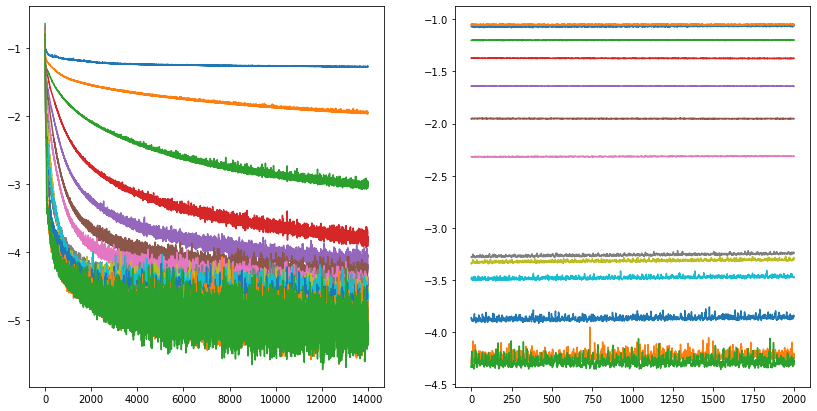

In [64]:
history_min = []
history_min_val = []
fig = plt.figure(figsize=(14,7))
ax1 = fig.add_subplot(1,2,1)
ax2 = fig.add_subplot(1,2,2)
#for this_history in history_all_13d: 
for i in range(13):
    this_history = history_all_13d_save[i]
    this_history_val = history_all_13d_save_val[i]
    ax1.plot(np.log(this_history)/np.log(10))
    ax2.plot(np.log(this_history_val)/np.log(10))
    this_min = np.min(this_history)
    this_min_val = np.min(this_history_val)
    history_min.append(this_min)
    history_min_val.append(this_min_val)
plt.show()
        


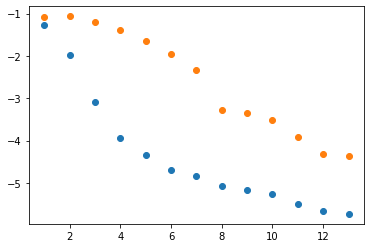

In [65]:
plt.figure()
plt.scatter(np.linspace(1,13,13),np.log(history_min)/np.log(10))
plt.scatter(np.linspace(1,13,13),np.log(history_min_val)/np.log(10))
plt.show()


0
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0537 - val_loss: 0.0813
1
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0120 - val_loss: 0.0876
2
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0011 - val_loss: 0.0629
3
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.9929e-04 - val_loss: 0.0424
4
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.2950e-05 - val_loss: 0.0229
5
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 7.3294e-05 - val_loss: 0.0112
6
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 2.0397e-05 - val_loss: 0.0048
7
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.3381e-05 - val_loss: 5.2030e-04
8
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.2227e-05 - val_loss: 4.6270e-04
9
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.9563e-05 - val_loss: 3.2810e-04
10
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 1.2573e-05 - val_loss: 1.3351e-04
11
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 3.5039e-06 - val_loss: 5.1467e-05
12
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 

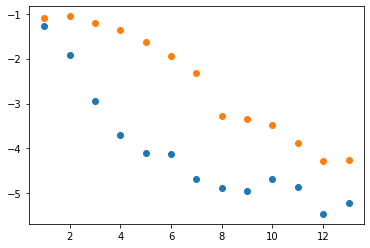

In [51]:
losses = []
val_losses = []
for i in range(13):
    print(i)
    all_autoencoder[i].optimizer.learning_rate = 10**(-3)
    this_autoencoder = all_autoencoder[i]
    
    this_point = this_autoencoder.fit(set_train_13d, set_train_13d, epochs = 1, batch_size=100, shuffle=True, validation_data=(set_test_13d,set_test_13d))
    this_loss = this_point.history["loss"]
    this_val_loss = this_point.history["val_loss"]
    losses.append(this_loss)
    val_losses.append(this_val_loss)

plt.figure()
plt.scatter(np.linspace(1,13,13),np.log(losses)/np.log(10))
plt.scatter(np.linspace(1,13,13),np.log(val_losses)/np.log(10))
plt.show()


In [ ]:
#with phycalc 

In [168]:
hist_loss_13d_phycalc_1700 = [0.0560,0.0224,0.0049,6.9884e-04,2.2151e-04,1.4963e-04,1.2232e-04,4.6465e-05,5.5988e-05,4.8191e-05,2.8760e-05,2.8050e-05] 
hist_loss_val_13d_phycalc_1700 =[0.0616,0.0605,0.0505,0.0301,0.0148,0.0070,0.0037,5.2987e-04,4.3342e-04,3.5123e-04,2.3167e-04,2.0050e-04]
hist_loss_13d_phycalc_2300 = [0.0557,0.0186, 0.0029,4.2928e-04,1.6232e-04,1.0910e-04,8.3418e-05,5.6099e-05,3.9835e-05,2.7499e-05,2.5557e-05,2.9920e-05]
hist_loss_val_13d_phycalc_2300 = [0.0619,0.0647,0.0510,0.0299,0.0151,0.0073,0.0038,6.0092e-04,4.4344e-04,3.5899e-04,2.5320e-04,1.9415e-04]
hist_loss_13d_phycalc_3200 = [0.0550,0.0149,0.0019,4.7490e-04,1.5358e-04,1.3824e-04,8.7452e-05,3.2823e-05,3.6552e-05,3.7039e-05,2.0653e-05,1.5656e-05]
hist_loss_val_13d_phycalc_3200 = [0.0640, 0.0708,0.0523,0.0300,0.0151,0.0075,0.0040,6.8441e-04,5.0881e-04,4.0821e-04,2.6771e-04,2.0579e-04]
hist_loss_13d_phycalc_3600 = [0.0521,0.0134,0.0015,3.0281e-04,1.2712e-04,1.0865e-04,7.3930e-05, 4.7703e-05,4.3773e-05,3.4098e-05,2.9393e-05, 1.9631e-05]
hist_loss_val_13d_phycalc_3600 = [0.0608,0.0725,0.0518,0.0300,0.0152,0.0076,0.0041,7.5576e-04,5.5168e-04,4.3286e-04,2.8689e-04,2.0871e-04]
hist_loss_13d_phycalc_8000 = [0.0518,0.0086,7.0883e-04,1.5575e-04,7.1078e-05,7.5931e-05,3.9156e-05,3.1926e-05,2.5219e-05,1.4439e-05,9.7389e-06,1.0319e-05]
hist_loss_val_13d_phycalc_8000 = [0.0595,0.0791,0.0537,0.0301,0.0159,0.0084,0.0048,0.0010,7.3411e-04,4.8974e-04,2.7014e-04,1.9079e-04]
    

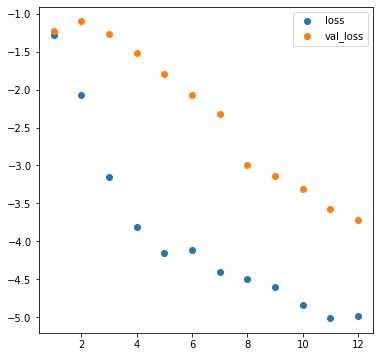

In [169]:
plt.figure(figsize=(6,6))
plt.scatter(np.linspace(1,12,12),np.log(hist_loss_13d_phycalc_8000)/np.log(10),label = 'loss')
plt.scatter(np.linspace(1,12,12),np.log(hist_loss_val_13d_phycalc_8000)/np.log(10),label = 'val_loss')
plt.legend()
plt.show()

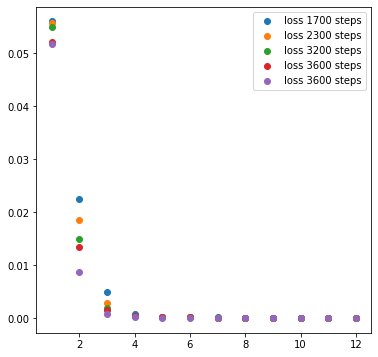

In [171]:
plt.figure(figsize=(6,6))
plt.scatter(np.linspace(1,12,12),hist_loss_13d_phycalc_1700,label='loss 1700 steps')
plt.scatter(np.linspace(1,12,12),hist_loss_13d_phycalc_2300,label='loss 2300 steps')
plt.scatter(np.linspace(1,12,12),hist_loss_13d_phycalc_3200,label='loss 3200 steps')
plt.scatter(np.linspace(1,12,12),hist_loss_13d_phycalc_3600,label='loss 3600 steps')
plt.scatter(np.linspace(1,12,12),hist_loss_13d_phycalc_8000,label='loss 8000 steps')
plt.legend()
plt.show()

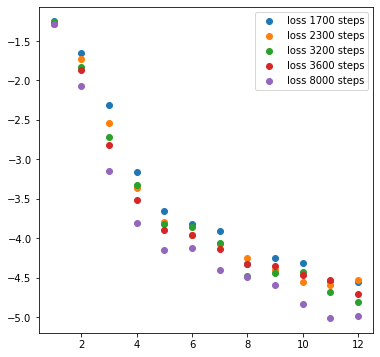

In [172]:
plt.figure(figsize=(6,6))
plt.scatter(np.linspace(1,12,12),np.log(hist_loss_13d_phycalc_1700)/np.log(10),label='loss 1700 steps')
plt.scatter(np.linspace(1,12,12),np.log(hist_loss_13d_phycalc_2300)/np.log(10),label='loss 2300 steps')
plt.scatter(np.linspace(1,12,12),np.log(hist_loss_13d_phycalc_3200)/np.log(10),label='loss 3200 steps')
plt.scatter(np.linspace(1,12,12),np.log(hist_loss_13d_phycalc_3600)/np.log(10),label='loss 3600 steps')
plt.scatter(np.linspace(1,12,12),np.log(hist_loss_13d_phycalc_8000)/np.log(10),label='loss 8000 steps')
plt.legend()
plt.show()


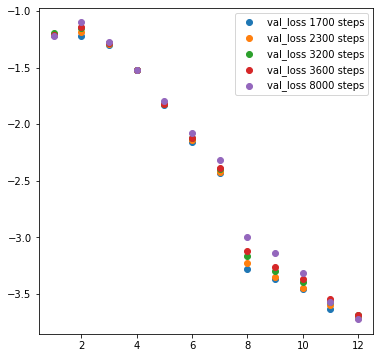

In [173]:
plt.figure(figsize=(6,6))
plt.scatter(np.linspace(1,12,12),np.log(hist_loss_val_13d_phycalc_1700)/np.log(10),label='val_loss 1700 steps')
plt.scatter(np.linspace(1,12,12),np.log(hist_loss_val_13d_phycalc_2300)/np.log(10),label='val_loss 2300 steps')
plt.scatter(np.linspace(1,12,12),np.log(hist_loss_val_13d_phycalc_3200)/np.log(10),label='val_loss 3200 steps')
plt.scatter(np.linspace(1,12,12),np.log(hist_loss_val_13d_phycalc_3600)/np.log(10),label='val_loss 3600 steps')
plt.scatter(np.linspace(1,12,12),np.log(hist_loss_val_13d_phycalc_8000)/np.log(10),label='val_loss 8000 steps')

plt.legend()
plt.show()


In [38]:
#####


In [89]:
import grad_descent_module as gdm


In [90]:
def V4d(x):
    x1,x2,x3,x4=tf.split(x, 4, axis=1)
    return (x1 + x2)**2 + (x1**2 + x2**2)*(x3**2 + x4**2) + (x3 + x4)**2 + (x3**2 + x4**2)*(x1**2 + x2**2)


In [95]:
x4d = tf.Variable(2*np.random.rand(100000,4)-1)


In [96]:
history_4d = []


In [110]:
gdm.grad_descent_potential(V4d, 
                           x4d,
                           history_loss = history_4d,
                           n_steps = 200,
                           n_steps_opt = 200,
                           step_stop_opt = 400,
                           update_opt = False,
                           alpha=10**(-4))


Step 0: ||∇V||^2 = 25.269601218274587 with learning rate 9.999999747378752e-05
Step 10: ||∇V||^2 = 7.9750424780912 with learning rate 9.999999747378752e-05
Step 20: ||∇V||^2 = 1.6280361604977218 with learning rate 9.999999747378752e-05
Step 30: ||∇V||^2 = 0.31365482794300176 with learning rate 9.999999747378752e-05
Step 40: ||∇V||^2 = 0.1637379322002096 with learning rate 9.999999747378752e-05
Step 50: ||∇V||^2 = 0.0867721929166453 with learning rate 9.999999747378752e-05
Step 60: ||∇V||^2 = 0.030360531321818457 with learning rate 9.999999747378752e-05
Step 70: ||∇V||^2 = 0.009025240625108632 with learning rate 9.999999747378752e-05


KeyboardInterrupt: 

In [ ]:
plt.figure()
plt.plot([np.log(i.numpy())/np.log(10) for i in history_4d])
plt.show()


In [ ]:
triangular_plot(x4d.numpy(),fig_size=10)


In [103]:
x4dnp = x4d.numpy()


In [104]:
mask_x0x1_line = abs(x4dnp[:,1]/x4dnp[:,0]+1)<10**(-4)


In [105]:
x4d_x0x1_line = np.array([list(np.extract(mask_x0x1_line,x4dnp[:,i])) for i in range(4)]).T


In [106]:
set_train_4d, set_test_4d = train_test_split(x4d.numpy(), test_size=0.1, random_state=1)


In [107]:
history_all_4d = []

for i in range(4):
    
    this_latent_dim = i + 1
    input_dim = 4
    
    print(this_latent_dim)

    inputs = layers.Input(shape=(input_dim,))
    encoded = layers.Dense(128, activation='sigmoid')(inputs)
    encoded = layers.Dense(128, activation='sigmoid')(encoded)
    encoded = layers.Dense(this_latent_dim)(encoded)  

    decoded = layers.Dense(128, activation='sigmoid')(encoded)
    decoded = layers.Dense(128, activation='sigmoid')(decoded)
    decoded = layers.Dense(input_dim)(decoded)  

    this_autoencoder = keras.Model(inputs, decoded)
    this_autoencoder.compile(optimizer='adam', loss='mse')
    
    history_all_4d.append(this_autoencoder.fit(set_train_4d, set_train_4d, epochs=50, batch_size=100, shuffle=True, validation_data=(set_test_4d,set_test_4d)))


1
Epoch 1/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - loss: 0.0338 - val_loss: 0.0173
Epoch 2/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0178 - val_loss: 0.0171
Epoch 3/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0177 - val_loss: 0.0175
Epoch 4/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0177 - val_loss: 0.0168
Epoch 5/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0147 - val_loss: 0.0080
Epoch 6/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0075 - val_loss: 0.0078
Epoch 7/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0071 - val_loss: 0.0066
Epoch 8/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0066 - val_loss: 0.0063
Epoch 9/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0060 - val_loss: 0.0057
Epoch 10/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0058 - val_loss: 0.0054
Epoch 11/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.0057 - val_loss: 0.0053
Epoch 12/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/st

900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.8851e-05 - val_loss: 1.3464e-05
Epoch 31/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.8650e-05 - val_loss: 1.7591e-05
Epoch 32/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.9301e-05 - val_loss: 5.0885e-05
Epoch 33/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.7884e-05 - val_loss: 6.6929e-06
Epoch 34/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.5041e-05 - val_loss: 1.4148e-05
Epoch 35/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 1.6801e-05 - val_loss: 6.2503e-06
Epoch 36/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 1.6219e-05 - val_loss: 5.1305e-06
Epoch 37/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.5585e-05 - val_loss: 7.0126e-06
Epoch 38/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.5086e-05 - val_loss: 5.4415e-05
Epoch 39/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.4677e-05 - val_loss: 4.5627e-06
Epoch 40/50
900/900 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1

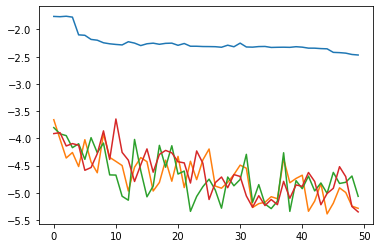

In [111]:
history_min = []
history_min_val = []

plt.figure()
for this_history in history_all_4d: 
    plt.plot(np.log(this_history.history['val_loss'])/np.log(10))
    this_min = np.min(this_history.history['loss'])
    this_min_val = np.min(this_history.history['val_loss'])
    history_min.append(this_min)
    history_min_val.append(this_min_val)
plt.show()


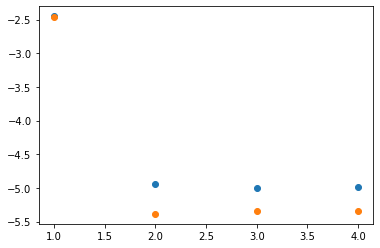

In [112]:
plt.figure()
plt.scatter(np.linspace(1,4,4),np.log(history_min)/np.log(10))
plt.scatter(np.linspace(1,4,4),np.log(history_min_val)/np.log(10))

plt.show()


In [126]:
##########

In [128]:
xtemp = np.load("x_V13d_x13eq0_hist.npy")

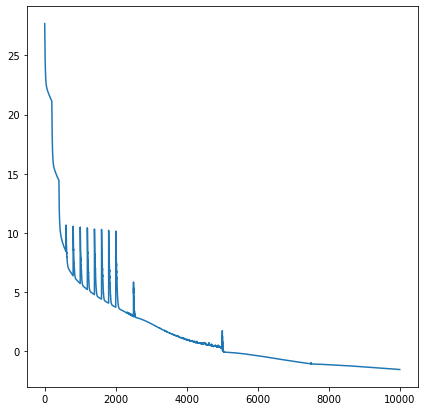

In [132]:
plt.figure(figsize = (7,7))
plt.plot(np.log(xtemp))
plt.show()

In [134]:
xtemp.shape

(10000,)